In [1]:
# Operation
import pandas as pd
import numpy as np
import pickle as pkl
from sklearn.pipeline import Pipeline
import joblib
import warnings

# PLotting
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

## Connection to SQL
import pyodbc

# Preprocessing
from sklearn.feature_selection import VarianceThreshold
from sklearn.feature_selection import chi2

from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import learning_curve
from sklearn.model_selection import permutation_test_score
from sklearn.feature_selection import SelectKBest


# Feature Selection
from sklearn.feature_selection import SelectFromModel

# Models
from sklearn.decomposition import PCA


# Approximation
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import NearestNeighbors

# Regression Based
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV
from sklearn.svm import LinearSVC
from sklearn.svm import SVC

# Tree Based
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import VotingClassifier

from sklearn.neighbors import KNeighborsClassifier



# Gradient Boosting
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier

# Neural Network

from sklearn.neural_network import MLPClassifier
from sklearn.neural_network import MLPRegressor

# Ensemble
from sklearn.ensemble import VotingClassifier


## Evaluation Metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import auc
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score


import io
from sklearn.tree import export_graphviz
import pydotplus

In [2]:
def header(algo, hyperparameter,hyperparameters):
    print("- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - ")
    Bold = "\033[1m"
    Underline = "\033[4m"
    end = "\033[0;0m"
    print("\n",Bold,Underline,"{}".format(algo), end )
    print(Bold,"\n Hyperparamter :", end, "\n {} \n {}" .format(hyperparameter,   hyperparameters) )
    Model_Parameter_list.append(hyperparameters)

def train_model(model):
    clf = model
    clf.fit(X_train,y_train)
    return clf
    
def metric_calculation(clf):
    y_accuracy_train = clf.score(X_train, y_train) * 100
    y_accuracy_test = clf.score(X_test, y_test) * 100
    
    y_train_score_classifier = clf.predict_proba(X_train)
    y_test_score_classifier = clf.predict_proba(X_test)

    yfit_train = clf.predict(X_train)
    yfit_test = clf.predict(X_test)
    
    mat_train = confusion_matrix(y_train, yfit_train)
    mat_test = confusion_matrix(y_test, yfit_test)

    Precision_train = precision_score(y_train,yfit_train) * 100
    Precision_test =  precision_score(y_test,yfit_test) * 100

    Recall_train = recall_score(y_train,yfit_train) * 100
    Recall_test = recall_score(y_test,yfit_test) * 100

    f1_score_train = f1_score(y_train,yfit_train)
    f1_score_test = f1_score(y_test,yfit_test)

    AUC_Train = roc_auc_score(y_train,y_train_score_classifier[:,1])
    AUC_Test = roc_auc_score(y_test,y_test_score_classifier[:,1])
    
    Prevalance_Train = y_train.value_counts()[1]
    Prevalance_Test = y_test.value_counts()[1]
    
    Prevalance_Train_Pct = (Prevalance_Train / len(y_train)) * 100
    Prevalance_Test_Pct  = (Prevalance_Test  / len(y_test))  * 100
     
    lift_train = (Precision_train ) / Prevalance_Train_Pct 
    lift_test =  (Precision_test  ) / Prevalance_Test_Pct
    
    target_size_train = np.sum(mat_train[:,1])
    target_size_test = np.sum(mat_test[:,1])
    
    target_size_train_pct = target_size_train / len(y_train) * 100
    target_size_test_pct  = target_size_test  / len(y_test) * 100
    
    Specivity_train = mat_train[0,0] / np.sum(mat_train[0,:]) * 100
    Specivity_test  = mat_test[0,0]  / np.sum(mat_test[0,:]) * 100
    
    NPV_train = mat_train[0,0] / np.sum(mat_train[:,0]) * 100
    NPV_test  = mat_test[0,0]  / np.sum(mat_test[:,0]) * 100
    return locals()


def metric_display(var): 
    Bold = "\033[1m"
    Underline = "\033[4m"
    end = "\033[0;0m"
    
    print("__________________________________________________________________")
    print() 
    print('Accuracy - Training: {:6.2f}%' .format(var['y_accuracy_train']))
    print('Accuracy - test    : {:6.2f}%' .format(var['y_accuracy_test']))

    print()
    print("AUC Performance")
    print('AUC - Training     : {:6.4f}' .format(var['AUC_Train']))
    print('AUC - Test         : {:6.4f}' .format(var['AUC_Test'] ))
    print()
    
    print("\n",Underline,"Classification Report Train",end)
    print(classification_report(y_train,var['yfit_train']))

    print("\n",Underline,"Classification Report Test",end)
    print(classification_report(y_test,var['yfit_test']))
    
    print("\n",  Underline, "Confusion Matrix - Train", end)
    print(var['mat_train'].T)
    print()

    print("\n",  Underline, "Confusion Matrix - Test", end)
    print(var['mat_test'].T)
    print()
    
    print("\n",Underline,"Train - Metrics",end)
    print("Prevalence (Num) :    {:d}"       .format( var['Prevalance_Train']     ))
    print("Prevalence       : {:6.2f} %"     .format( var['Prevalance_Train_Pct'] ))
    print("PPV              : {:6.2f} %"     .format( var['Precision_train']      ))
    print("NPV              : {:6.2f} %"     .format( var['NPV_train']            ))
    print("Sensitivity      : {:6.2f} %"     .format( var['Recall_train']         ))
    print("Specivity        : {:6.2f} %"     .format( var['Specivity_train']      ))
    print("Lift             : {:6.2f} times" .format( var['lift_train']           ))
    print("Target_PCT       : {:6.2f} %"     .format( var['target_size_train_pct']))
    
    print("\n",Underline,"Test - Metrics",end)
    print("Prevalence (Num) :    {:d}"       .format( var['Prevalance_Test']     ))
    print("Prevalence       : {:6.2f} %"     .format( var['Prevalance_Test_Pct'] ))
    print("PPV              : {:6.2f} %"     .format( var['Precision_test']      ))
    print("NPV              : {:6.2f} %"     .format( var['NPV_test']            ))
    print("Sensitivity      : {:6.2f} %"     .format( var['Recall_test']         ))
    print("Specivity        : {:6.2f} %"     .format( var['Specivity_test']      ))
    print("Lift             : {:6.2f} times" .format( var['lift_test']           ))
    print("Target_PCT       : {:6.2f} %"     .format( var['target_size_test_pct']))

    
def append_metrics(var):
    NPV_test_list.append(var['NPV_test'])
    NPV_train_list.append(var['NPV_train'])
    Specivity_test_list.append(var['Specivity_test'])
    Specivity_train_list.append(var['Specivity_train'])
    target_size_test_pct_list.append(var['target_size_test_pct'])
    target_size_train_pct_list.append(var['target_size_train_pct'])
    target_size_test_list.append(var['target_size_test'])
    target_size_train_list.append(var['target_size_train'])
    lift_test_list.append(var['lift_test'])
    lift_train_list.append(var['lift_train'])
    Prevalance_Test_Pct_list.append(var['Prevalance_Test_Pct'])
    Prevalance_Train_Pct_list.append(var['Prevalance_Train_Pct'])
    Prevalance_Test_list.append(var['Prevalance_Test'])
    Prevalance_Train_list.append(var['Prevalance_Train'])
    AUC_Test_list.append(var['AUC_Test'])
    AUC_Train_list.append(var['AUC_Train'])
    f1_score_test_list.append(var['f1_score_test'])
    f1_score_train_list.append(var['f1_score_train'])
    Recall_test_list.append(var['Recall_test'])
    Recall_train_list.append(var['Recall_train'])
    Precision_test_list.append(var['Precision_test'])
    Precision_train_list.append(var['Precision_train'])
    mat_test_list.append(var['mat_test'].T)
    mat_train_list.append(var['mat_train'].T)
    y_accuracy_test_list.append(var['y_accuracy_test'])
    y_accuracy_train_list.append(var['y_accuracy_train'])
    
def model_parameter_append(m):
    Model_Parameter_list.append(m)
    
    
def tabulate_grid_search():
    Summary_Performance = pd.DataFrame({
        '0_Model Hyperparameters' : Model_Parameter_list,
        
        '1_1_Accuracy_train' :  y_accuracy_train_list,
        '1_2_Accuracy_test'  :  y_accuracy_test_list,
        
        '2_1_AUC_train' :  AUC_Train_list,
        '2_2_AUC_test'  :  AUC_Test_list,
        
        '3_1_Conf_Mat_train' :  mat_train_list,
        '3_2_Conf_Mat_test'  :  mat_test_list,
        
        '4_1_Actual_Prevalance_train' :  Prevalance_Train_list,
        '4_2_Actual_Prevalance_test'  :  Prevalance_Test_list,
        
        '5_1_Prevalance_PCT_train' :  Prevalance_Train_Pct_list,
        '5_2_Prevalance_PCT_test'  :  Prevalance_Test_Pct_list,

        '6_1_PPV_train' :  Precision_train_list,
        '6_2_PPV_test'  :  Precision_test_list,
        
        '7_1_NPV_train' :  NPV_train_list,
        '7_2_NPV_test'  :  NPV_test_list,

        '8_1_Sensitivty_train' :  Recall_train_list,
        '8_2_Sensitivty_test'  :  Recall_test_list,
        
        '9_1_Specivity_train' :  Specivity_train_list,
        '9_2_Specivity_test'  :  Specivity_test_list,
        
        '9_10_1_F1_Score_train' :  f1_score_train_list,
        '9_10_2_F1_Score_test'  :  f1_score_test_list,
        
        '9_11_1_Target_size_train_PCT' :  target_size_train_pct_list,
        '9_11_2_Target_size_test_PCT'  :  target_size_test_pct_list,
        
        '9_12_1_Actual_target_size_train' :  target_size_train_list,
        '9_12_2_Actual_target_size_test'  :  target_size_test_list,

        '9_13_1_Lift_train' :  lift_train_list,
        '9_13_2_Lift_test'  :  lift_test_list})
    return Summary_Performance


def main_function(model):
    clf = train_model(model)
    var_dict = metric_calculation(clf)
    metric_display(var_dict)
    append_metrics(var_dict)
    tabualte_grid_search()
    

In [3]:
def auc_curve_plot(y_actual, y_score):
    fpr, tpr, thresholds = roc_curve(y_actual, y_score)
    roc_auc = roc_auc_score(y_actual, y_score)

    plt.figure(figsize=(10,10))
    lw = 0.5
    plt.plot(fpr, tpr, color='darkorange',
             lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate\n (1-Specificity)')

    # X_labels = np.arange(0.0,1.0)
    # X_labels_place_holders = np.arange(1,11)
    # plt.xticks( X_labels_place_holders , X_labels)
    plt.ylabel('True Positive Rate\n (Sensitivity)')
    plt.title('Receiver Operating Characteristic (ROC)' , fontsize=20)
    plt.legend(loc="lower right")
#     plt.savefig('Model Performance/train_roc.png')   # save the figure to file
    plt.show()


In [4]:
def precission_recall_curve_plot(y_actual, y_score):
    
    precision, recall, _ = precision_recall_curve(y_actual, y_score)
    plt.figure(figsize=(8,8))
    plt.step(recall, precision, color='b', alpha=0.2, where='post')
    plt.fill_between(recall, precision, step='post', alpha=0.5, color='b')
    average_precision = average_precision_score(y_actual, y_score)
    print('Average precision-recall score: {0:0.2f}'.format(average_precision))
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0, 1.05])
    plt.xlim([0.0, 1.0])
    plt.title('2-class Precision-Recall curve: AUC={0:0.2f}'.format(average_precision), fontsize=20)
    plt.show()

In [ ]:
## Model Template

Model_Parameter_list = []
NPV_test_list =[]
NPV_train_list =[]
Specivity_test_list =[]
Specivity_train_list =[]
target_size_test_pct_list =[]
target_size_train_pct_list =[]
target_size_test_list =[]
target_size_train_list =[]
lift_test_list =[]
lift_train_list =[]
Prevalance_Test_Pct_list =[]
Prevalance_Train_Pct_list =[]
Prevalance_Test_list =[]
Prevalance_Train_list =[]
AUC_Test_list =[]
AUC_Train_list =[]
f1_score_test_list =[]
f1_score_train_list =[]
Recall_test_list =[]
Recall_train_list =[]
Precision_test_list =[]
Precision_train_list =[]
mat_test_list =[]
mat_train_list =[]
y_accuracy_test_list =[]
y_accuracy_train_list =[]

clf = train_model(clf_random_forest)
var_dict = metric_calculation(clf)
metric_display(var_dict)
append_metrics(var_dict)
df = tabulate_grid_search()
AUC_CURVE_PLOT(y_test,var_dict['y_test_score_classifier'][:,1])
df.T

In [5]:
def show_tree(tree, features, path):
    f=io.StringIO()
    export_graphviz(tree, out_file=f, feature_names=features)
    pydotplus.graph_from_dot_data(f.getvalue()).write_png(path)
    img = misc.imread(path)
    plt.rcParams["figure.figsize"] = (20,20)
    plt.imshow(img)

In [6]:
data_cat = pd.read_pickle('saved_corr_treated_scaled_dummy_data_controlled')

In [13]:
data_cat.to_csv('Control Cleaned Data Power bi.csv')

In [7]:
y_select = pd.read_pickle('Targets')

In [8]:
## Load Data into X, y
X = data_cat
y = y_select.iloc[:,-1]

In [9]:
print("X:",X.shape)
print("y:",y.shape)

X: (27853, 262)
y: (27853,)


## Feature Selection (Bagging)

In [11]:
fsel = ExtraTreesClassifier().fit(X, y)
model = SelectFromModel(fsel, prefit=True)
X_new = model.transform(X)
nb_features = X_new.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X_new, y ,test_size=0.2,random_state=0)

features = []

print('%i features identified as important:' % nb_features)
print()
indices = np.argsort(fsel.feature_importances_)[::-1][:nb_features]
for f in range(nb_features):
    print("%d. feature %s (%f)" % (f + 1, X.columns[indices[f]], fsel.feature_importances_[indices[f]]))
    
# XXX : take care of the feature order
for f in sorted(np.argsort(fsel.feature_importances_)[::-1][:nb_features]):
    features.append(X.columns[f])

139 features identified as important:

1. feature CREDIT_BALANCE (0.009749)
2. feature DATA_VOL_3G_MONTH_MINUS_2 (0.009262)
3. feature NUM_OUT_CALL_OFFNET_PCT_CHG_M_0_VS_1 (0.008855)
4. feature DATA_VOL_2G_MONTH_0 (0.008586)
5. feature AMT_LAST_RELOAD_PCT_CHG_M_1_VS_2 (0.008411)
6. feature AMT_LAST_RELOAD_PCT_CHG_M_0_VS_1 (0.007455)
7. feature AMT_REVENUE_PCT_CHG_M_0_VS_1 (0.007437)
8. feature NUM_IN_SMS_OFFNET_PCT_CHG_M_1_VS_2 (0.007426)
9. feature AMT_OUT_CALL_ONNET_PCT_CHG_M_0_VS_1 (0.007263)
10. feature VOICE_INCOMING_ACTIVE_30_DAYS_PCT_CHG_M_1_VS_2 (0.007201)
11. feature NON_RECURRING_REVENUE_MONTH_MINUS_1 (0.007159)
12. feature NUM_IN_CALL_ONNET_PCT_CHG_M_1_VS_2 (0.006953)
13. feature PCT_NUM_OUT_SMS_ONNET_MONTH_MINUS_2 (0.006872)
14. feature AMT_OUT_SMS_MONTH_0 (0.006770)
15. feature MOU_OUT_CALL_PCT_CHG_M_0_VS_1 (0.006707)
16. feature AMT_OUT_SMS_OFFNET_MONTH_MINUS_2 (0.006631)
17. feature MOU_OUT_CALL_ADJ_MONTH_MINUS_2 (0.006601)
18. feature NUM_IN_CALL_ONNET_PCT_CHG_M_0_VS_1 

In [12]:
X.to_csv('Control Cleaned Data Power bi.csv')

In [ ]:
filename = 'classifier/features_controlled.pkl'
pkl.dump(features, open(filename, 'wb'))
print('Features Saved')

In [10]:
filename = 'classifier/features_controlled.pkl'
features = pkl.load(open(filename, 'rb'))
print('Features Loaded')

Features Loaded


In [13]:
features

['CREDIT_BALANCE',
 'AGE',
 'LAST_DEVICE_CHANGE_DAYS',
 'LOS',
 'NON_RECURRING_REVENUE_MONTH_0',
 'NUM_RELOAD_MONTH_0',
 'AMT_LAST_RELOAD_MONTH_0',
 'AMT_OUT_CALL_ADJ_MONTH_0',
 'AMT_OUT_CALL_DIGI_MONTH_0',
 'AMT_OUT_CALL_FIXED_MONTH_0',
 'AMT_OUT_CALL_MAXIS_MONTH_0',
 'AMT_OUT_CALL_NADJ_MONTH_0',
 'AMT_OUT_CALL_UMOBILE_MONTH_0',
 'AMT_OUT_SMS_MONTH_0',
 'AMT_OUT_SMS_OFFNET_MONTH_0',
 'DATA_VOL_2G_MONTH_0',
 'DATA_VOL_3G_MONTH_0',
 'MOU_IN_CALL_MONTH_0',
 'MOU_IN_CALL_FIXED_MONTH_0',
 'MOU_IN_CALL_OFFNET_MONTH_0',
 'MOU_OUT_CALL_MONTH_0',
 'MOU_OUT_CALL_ADJ_MONTH_0',
 'NUM_IN_CALL_MONTH_0',
 'NUM_IN_CALL_FIXED_MONTH_0',
 'NUM_IN_SMS_MONTH_0',
 'NUM_OUT_CALL_MONTH_0',
 'NUM_OUT_CALL_ADJ_MONTH_0',
 'PCT_VOICE_AND_SMS_REVENUE_MONTH_0',
 'PCT_AMT_OUT_CALL_ONNET_MONTH_0',
 'PCT_AMT_OUT_CALL_OFFNET_MONTH_0',
 'PCT_MOU_IN_CALL_ONNET_MONTH_0',
 'PCT_MOU_IN_CALL_OFFNET_MONTH_0',
 'PCT_NUM_OUT_CALL_ONNET_MONTH_0',
 'PCT_NUM_OUT_CALL_OFFNET_MONTH_0',
 'PCT_NUM_OUT_CALL_DIGI_MONTH_0',
 'PCT_NUM_OU

In [11]:
X = X.loc[:,features]

In [12]:
print("X:",X.shape)
print("y:",y.shape)

X: (27853, 141)
y: (27853,)


## Split Data

In [20]:
# Split Data
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=12345)

## Model Evaluation Function

## Algorithm Evaluation

In [13]:

algorithms = {
    "GNB": GaussianNB(),    
    "DecisionTree": DecisionTreeClassifier(max_depth=10, class_weight='balanced'),
    "Logistic"    : LogisticRegressionCV(cv=20, class_weight='balanced'),
#   "KNN" : KNeighborsClassifier(n_neighbors=5), (takes too long to run)
    "GradientBoosting": GradientBoostingClassifier(n_estimators=50),
    "AdaBoost": AdaBoostClassifier(n_estimators=100),
    'Neural Network' : MLPClassifier(hidden_layer_sizes=[100,100]),
    "RandomForest": RandomForestClassifier(n_estimators=50, class_weight='balanced')
    }

results = {}
results_auc = {}
print("\nNow testing algorithms")

Bold = "\033[1m"
Underline = "\033[4m"
end = "\033[0;0m"

for algo in algorithms:
    clf = algorithms[algo]
    clf.fit(X_train, y_train)
    score = clf.score(X_test, y_test)
    print("____________________________________________________________________")
    print("\n",Bold,Underline,"{} -".format(algo) ,"Overall Accuracy", end )
    print("%s : %f %%" % (algo, score*100))
    results[algo] = score

    y_train_score_classifier = clf.predict_proba(X_train)
    y_test_score_classifier = clf.predict_proba(X_test)
    
    auc = roc_auc_score(y_test, y_test_score_classifier[:,1])
    results_auc[algo] = auc

    print()
    print(Underline,"AUC Performance",end)
    print('AUC - Training: ' , roc_auc_score(y_train, y_train_score_classifier[:,1]))
    print('AUC - Test    : ', roc_auc_score(y_test, y_test_score_classifier[:,1]))
    
    yfit_test = clf.predict(X_test)
    yfit_train = clf.predict(X_train)
    
    ## Confusion Matrix
    mat_test = confusion_matrix(y_test, yfit_test)
        
    FP = mat_test.T[1][0] 
    FN = mat_test.T[0][1]
    TP = mat_test.T[1][1]
    TN = mat_test.T[0][0]

    # Sensitivity, hit rate, recall, or true positive rate
    TPR = TP/(TP+FN)
    # Specificity or true negative rate
    TNR = TN/(TN+FP) 
    # Precision or positive predictive value
    PPV = TP/(TP+FP)
    # Negative predictive value
    NPV = TN/(TN+FN)
    # Fall out or false positive rate
    FPR = FP/(FP+TN)
    # False negative rate
    FNR = FN/(TP+FN)
    # False discovery rate
    FDR = FP/(TP+FP)

    # Overall accuracy
    ACC = (TP+TN)/(TP+FP+FN+TN)

    # prev = y.value_counts()
    # prev[1]/sum(prev[:])*100
    Prevalance = (TP + FN) / (TP+FP+FN+TN)

    lift = PPV/Prevalance

    Target_PCT = (FP + TP) / (TP+FP+FN+TN)
    
    
    print("\n",Underline,"Classification Report",end)
    print(classification_report(y_test,yfit_test))
    
    
    print("\n",Underline,"Confusion Matrix",end)
    print(mat_test.T)
    print()
    
    print("TN - [ {} , {} ] - FN".format(TN,FN))
    print("FP - [ {} , {} ] - TP".format(FP,TP))
    print()
    
    print("Prevalence (Num) :", (TP + FN))
    print("Prevalance       : {} %" .format( np.round(Prevalance*100,3)))
    
    print("PPV              : {} %" .format( np.round(PPV*100,3) ))
    print("NPV              : {} %".format( np.round(NPV*100,3) ))
    
    print("Sensitivity      : {} %".format( np.round(TPR*100,3)) )
    print("Specivity        : {} %".format( np.round(TNR*100,3)) )
    print("Lift             : {} times" .format( np.round(lift,3)))
    print("Target_PCT       : {} %".format( np.round(Target_PCT*100,3) ))
    
winner = max(results_auc, key=results_auc.get)
print('\nWinner algorithm is %s with a %f %% success' % (winner, results[winner]*100))
print('\nWinner algorithm is %s with an auc of %f %% success' % (winner, results_auc[winner]*100))





Now testing algorithms
____________________________________________________________________

   GNB - Overall Accuracy 
GNB : 82.711086 %

 AUC Performance 
AUC - Training:  0.658419873519
AUC - Test    :  0.59755130074

  Classification Report 
             precision    recall  f1-score   support

          0       0.99      0.84      0.90      6860
          1       0.02      0.27      0.04       104

avg / total       0.97      0.83      0.89      6964


  Confusion Matrix 
[[5732   76]
 [1128   28]]

TN - [ 5732 , 76 ] - FN
FP - [ 1128 , 28 ] - TP

Prevalence (Num) : 104
Prevalance       : 1.493 %
PPV              : 2.422 %
NPV              : 98.691 %
Sensitivity      : 26.923 %
Specivity        : 83.557 %
Lift             : 1.622 times
Target_PCT       : 16.6 %
____________________________________________________________________

   DecisionTree - Overall Accuracy 
DecisionTree : 79.106835 %

 AUC Performance 
AUC - Training:  0.945567795937
AUC - Test    :  0.544565065037

  Cla

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:60: RuntimeWarning: invalid value encountered in long_scalars
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:68: RuntimeWarning: invalid value encountered in long_scalars
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1113: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


### Random Forest

 
Iteration : 1 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 25, [10, 5]]
__________________________________________________________________

Accuracy - Training:  85.71%
Accuracy - test    :  85.53%

AUC Performance
AUC - Training     : 0.8140
AUC - Test         : 0.6676


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.51      0.09       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.03      0.27      0.05       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17766   136]
 [ 2848   139]]


  Confusion Matrix - Test 
[[5928   76]
 [ 932

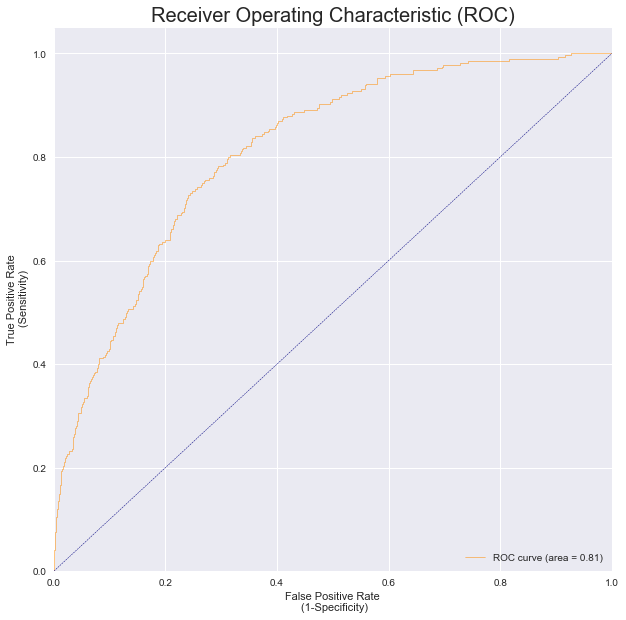


  Test AUC 


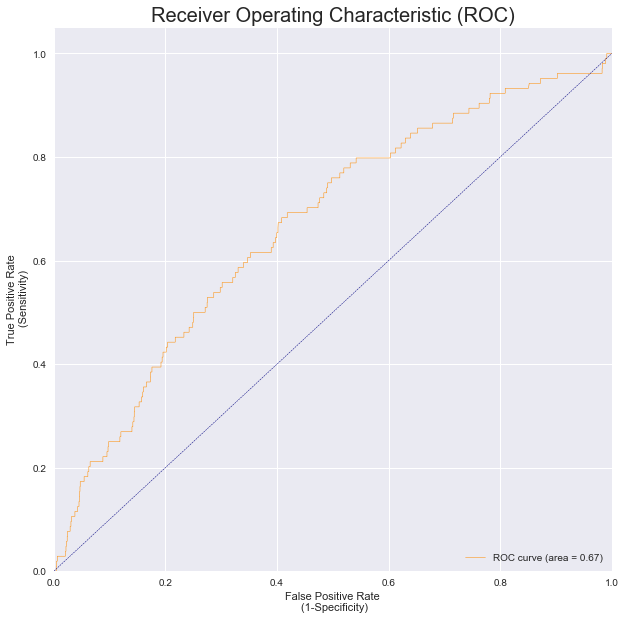


  Train Precission - Recall Curve 
Average precision-recall score: 0.09


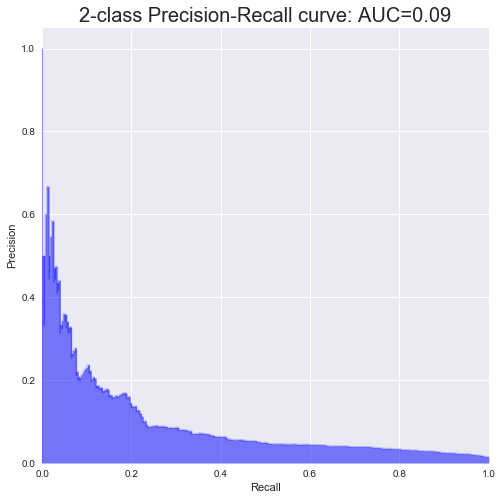


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


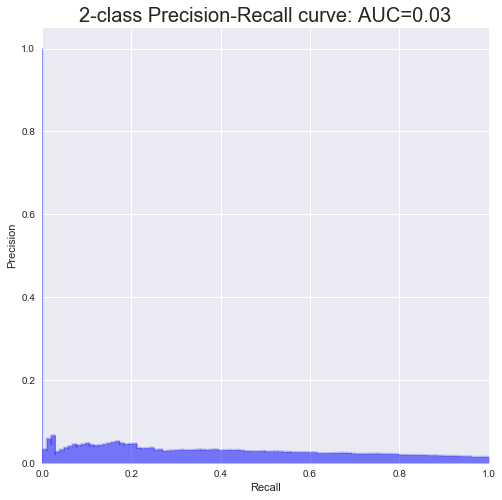

 
Iteration : 2 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 25, [50, 25]]
__________________________________________________________________

Accuracy - Training:  85.70%
Accuracy - test    :  85.50%

AUC Performance
AUC - Training     : 0.8138
AUC - Test         : 0.6674


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.51      0.09       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.03      0.27      0.05       104

avg / total       0.97      0.85      0.91      6964


  Confusion Matrix - Train 
[[17763   136]
 [ 2851   139]]


  Confusion Matrix - Test 
[[5926   76]
 [ 93

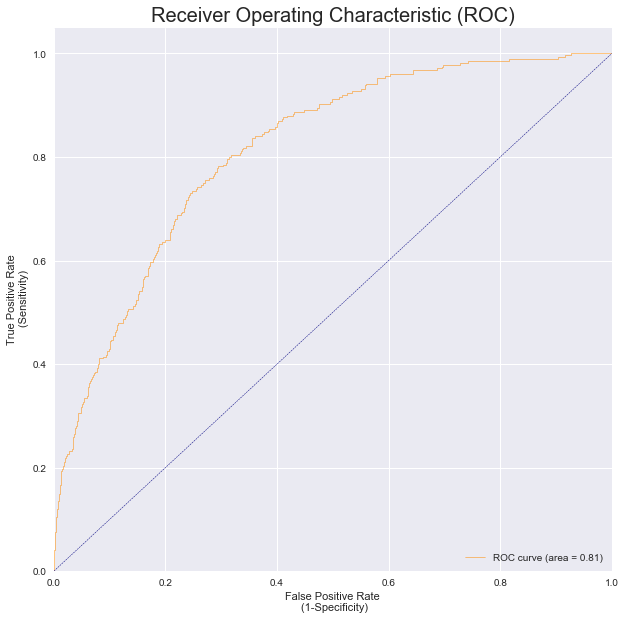


  Test AUC 


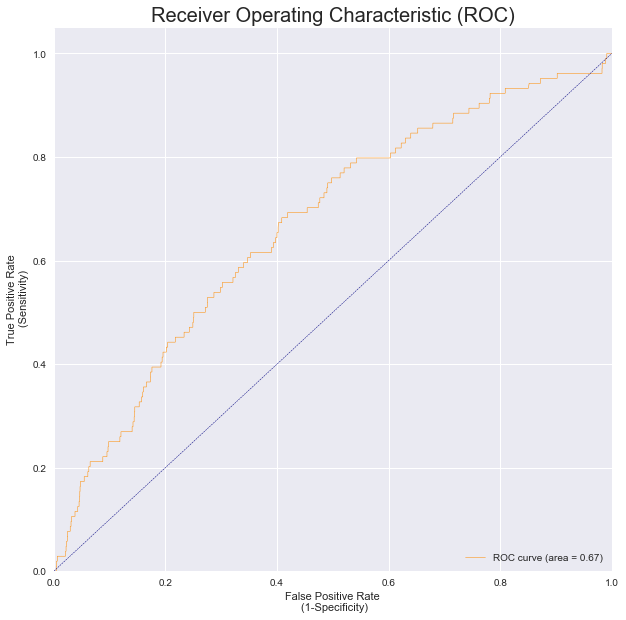


  Train Precission - Recall Curve 
Average precision-recall score: 0.09


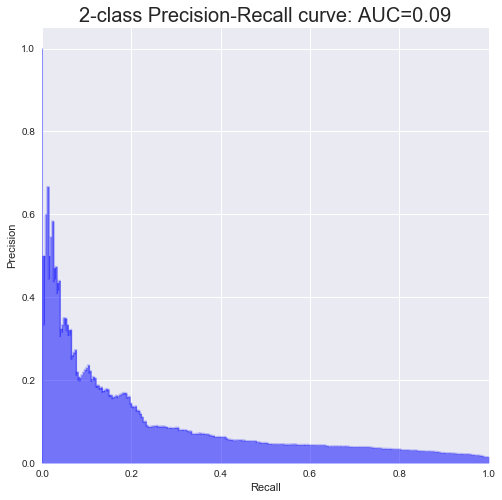


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


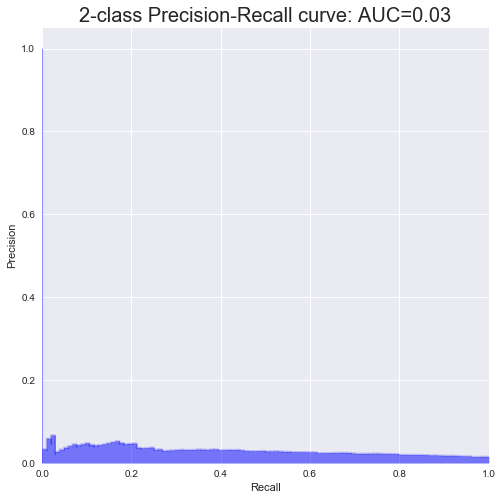

 
Iteration : 3 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 25, [100, 50]]
__________________________________________________________________

Accuracy - Training:  85.59%
Accuracy - test    :  85.25%

AUC Performance
AUC - Training     : 0.8120
AUC - Test         : 0.6664


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.50      0.08       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.03      0.27      0.05       104

avg / total       0.97      0.85      0.91      6964


  Confusion Matrix - Train 
[[17740   137]
 [ 2874   138]]


  Confusion Matrix - Test 
[[5909   76]
 [ 9

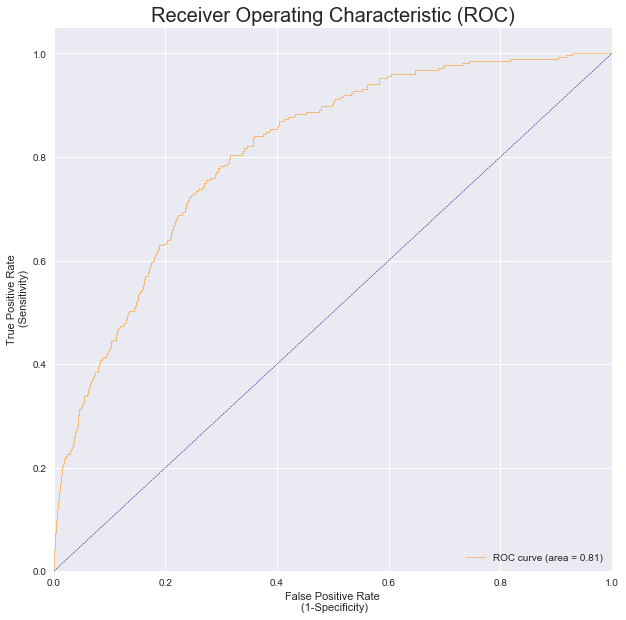


  Test AUC 


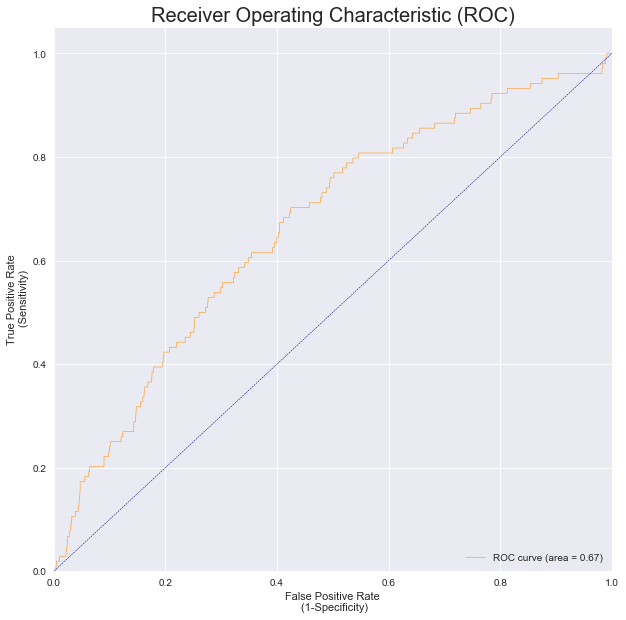


  Train Precission - Recall Curve 
Average precision-recall score: 0.09


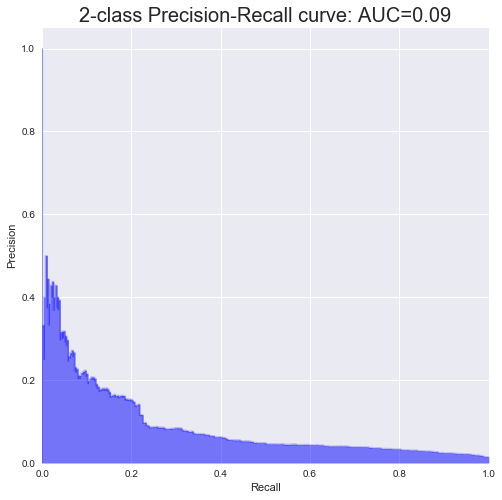


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


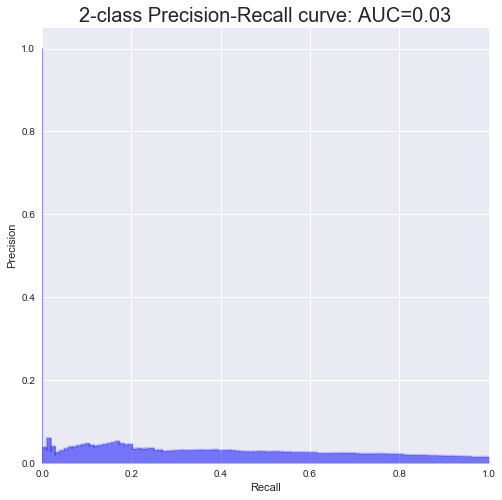

 
Iteration : 4 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 25, [200, 100]]
__________________________________________________________________

Accuracy - Training:  85.63%
Accuracy - test    :  85.02%

AUC Performance
AUC - Training     : 0.8105
AUC - Test         : 0.6606


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.51      0.08       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.03      0.27      0.05       104

avg / total       0.97      0.85      0.91      6964


  Confusion Matrix - Train 
[[17749   136]
 [ 2865   139]]


  Confusion Matrix - Test 
[[5893   76]
 [ 

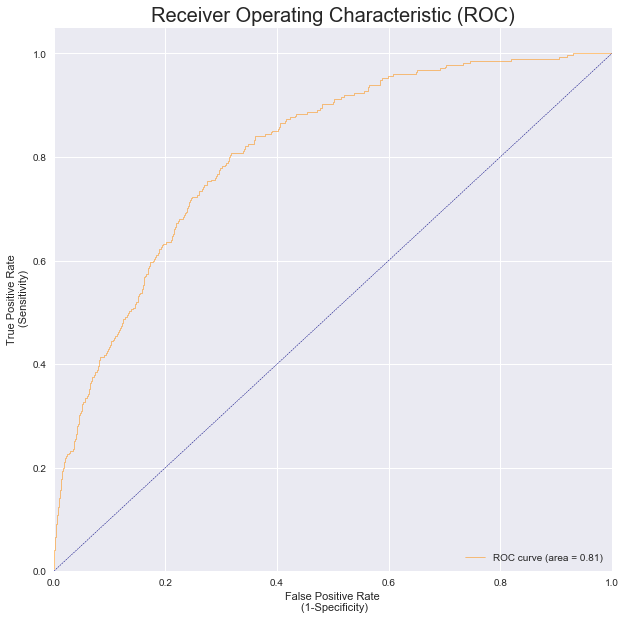


  Test AUC 


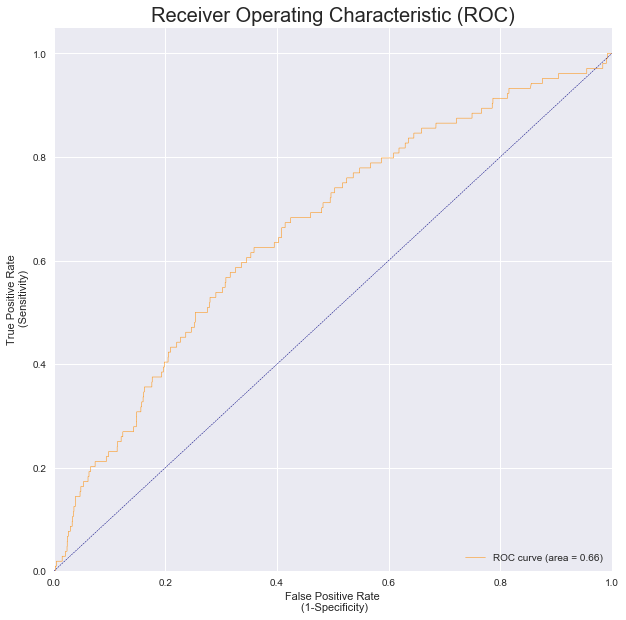


  Train Precission - Recall Curve 
Average precision-recall score: 0.09


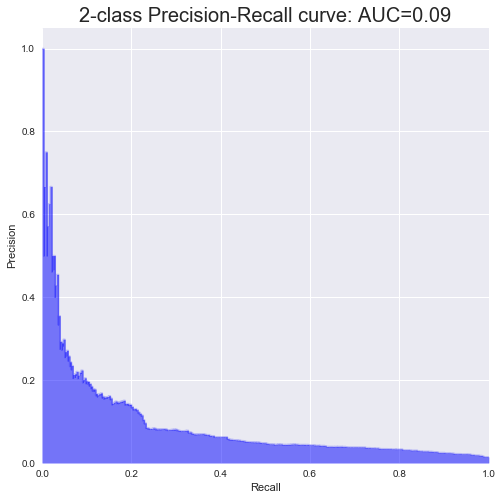


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


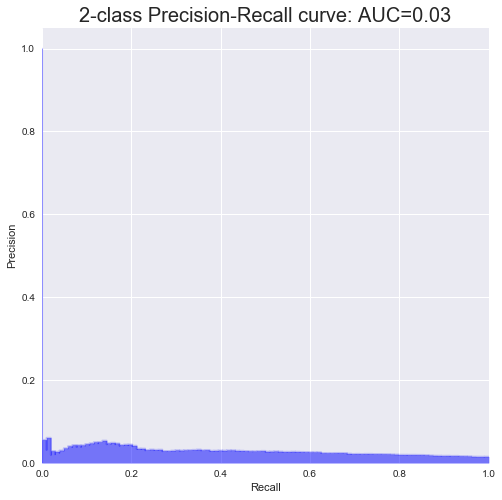

 
Iteration : 5 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 25, [400, 200]]
__________________________________________________________________

Accuracy - Training:  84.89%
Accuracy - test    :  84.19%

AUC Performance
AUC - Training     : 0.8022
AUC - Test         : 0.6542


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.85      0.92     20614
          1       0.04      0.51      0.08       275

avg / total       0.98      0.85      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.85      0.91      6860
          1       0.02      0.25      0.05       104

avg / total       0.97      0.84      0.90      6964


  Confusion Matrix - Train 
[[17593   135]
 [ 3021   140]]


  Confusion Matrix - Test 
[[5837   78]
 [1

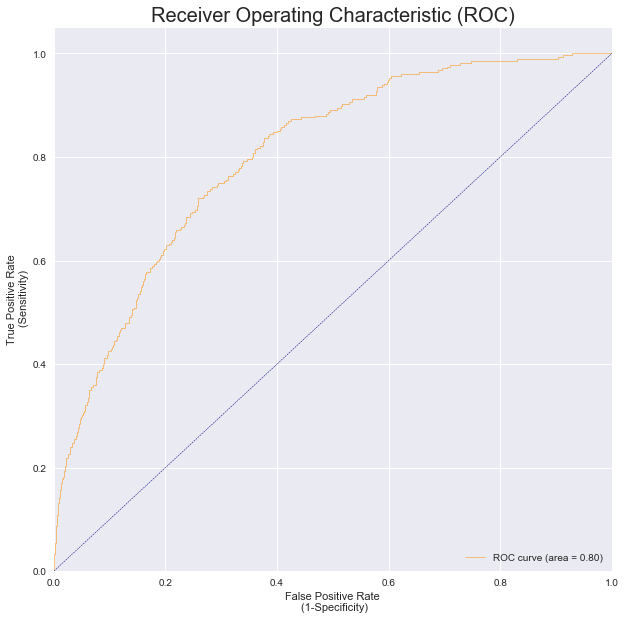


  Test AUC 


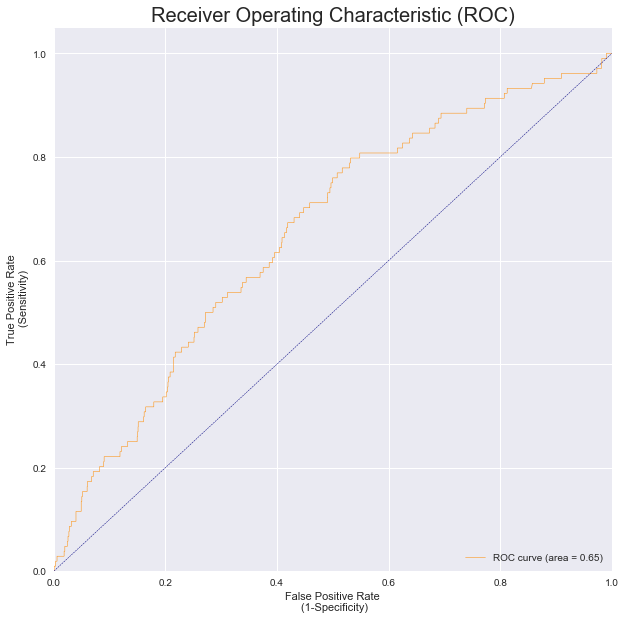


  Train Precission - Recall Curve 
Average precision-recall score: 0.08


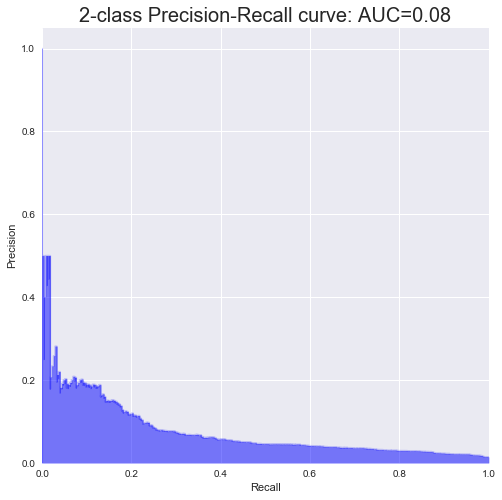


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


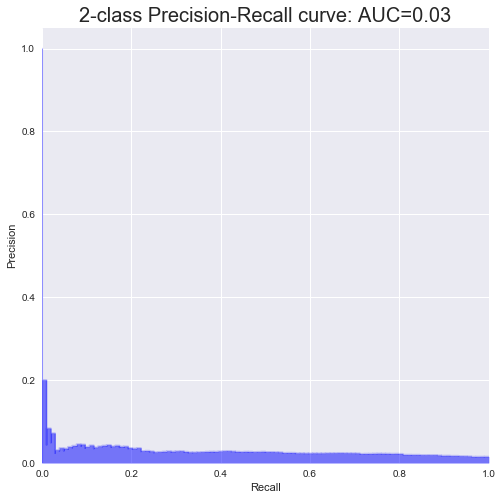

 
Iteration : 6 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 25, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  82.52%
Accuracy - test    :  82.08%

AUC Performance
AUC - Training     : 0.7850
AUC - Test         : 0.6407


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.83      0.90     20614
          1       0.04      0.52      0.07       275

avg / total       0.98      0.83      0.89     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.83      0.90      6860
          1       0.02      0.29      0.05       104

avg / total       0.97      0.82      0.89      6964


  Confusion Matrix - Train 
[[17093   131]
 [ 3521   144]]


  Confusion Matrix - Test 
[[5686   74]
 [

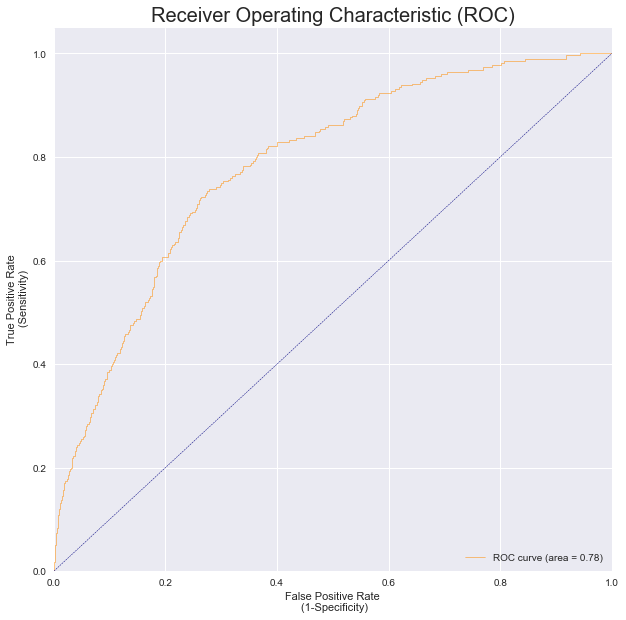


  Test AUC 


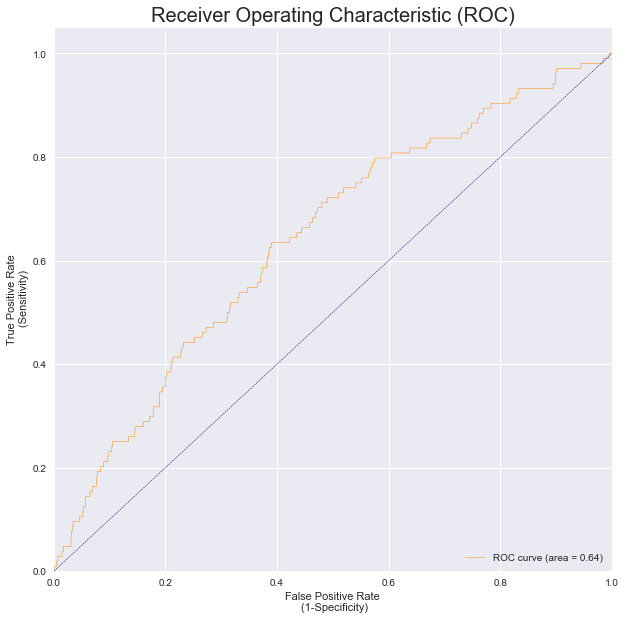


  Train Precission - Recall Curve 
Average precision-recall score: 0.06


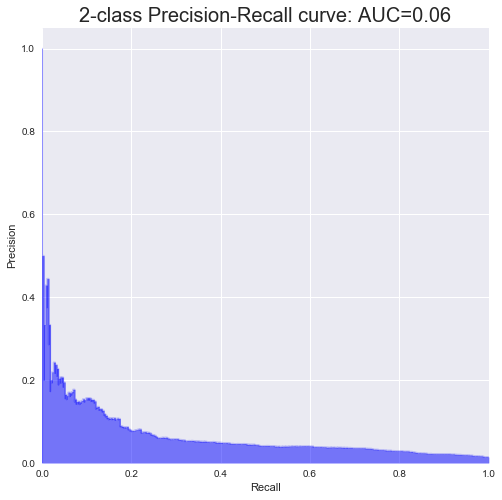


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


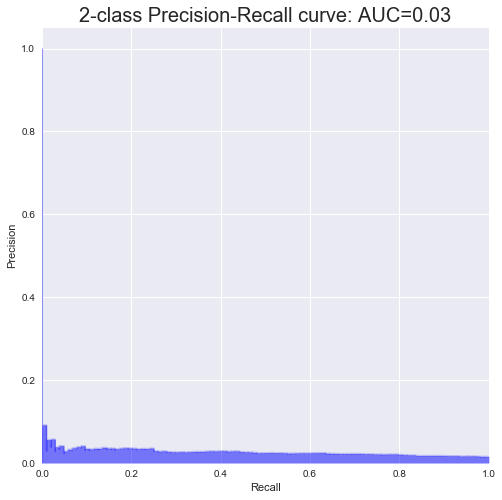

 
Iteration : 7 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 50, [10, 5]]
__________________________________________________________________

Accuracy - Training:  86.87%
Accuracy - test    :  86.30%

AUC Performance
AUC - Training     : 0.8341
AUC - Test         : 0.6659


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.56      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.04      0.35      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17993   121]
 [ 2621   154]]


  Confusion Matrix - Test 
[[5974   68]
 [ 886

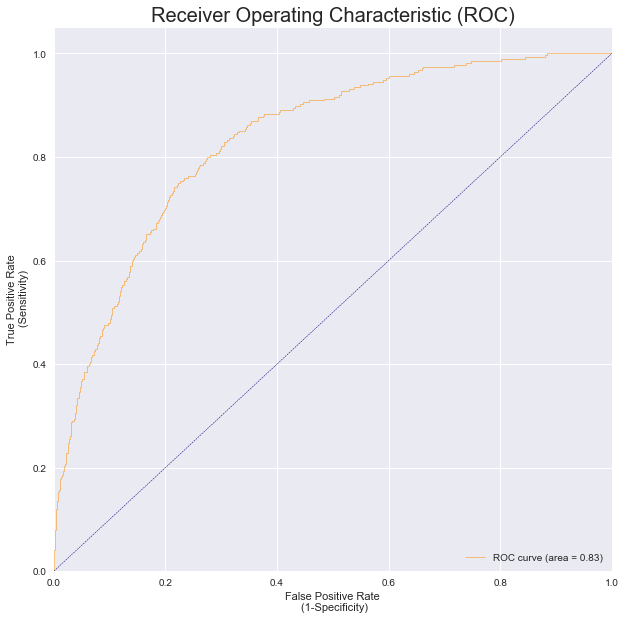


  Test AUC 


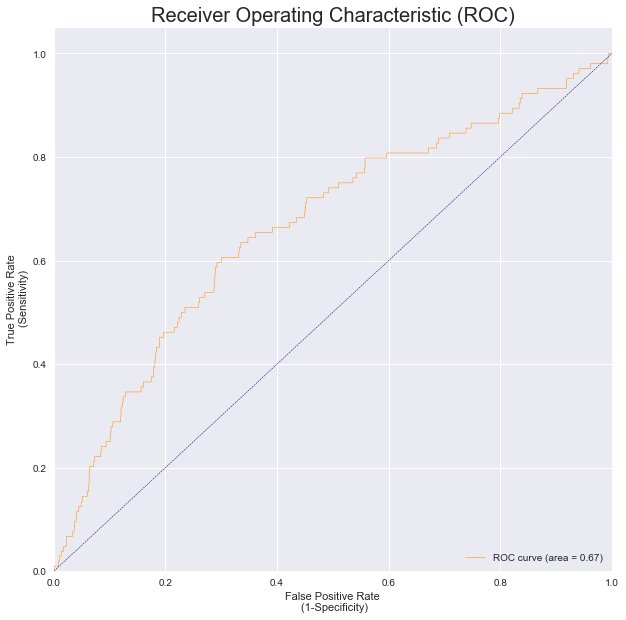


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


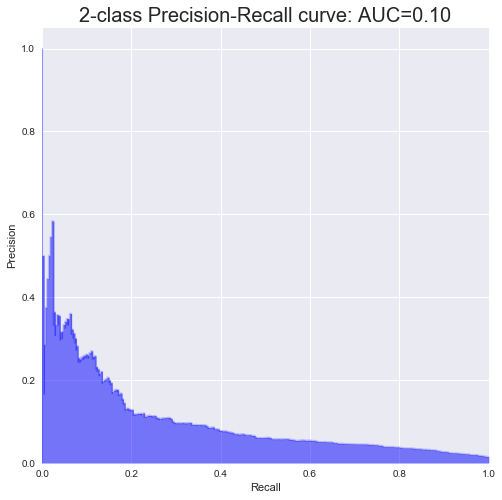


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


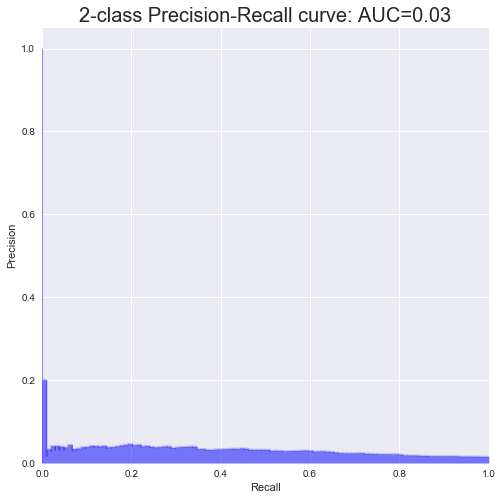

 
Iteration : 8 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 50, [50, 25]]
__________________________________________________________________

Accuracy - Training:  86.86%
Accuracy - test    :  86.29%

AUC Performance
AUC - Training     : 0.8336
AUC - Test         : 0.6653


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.56      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.04      0.34      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17991   121]
 [ 2623   154]]


  Confusion Matrix - Test 
[[5974   69]
 [ 88

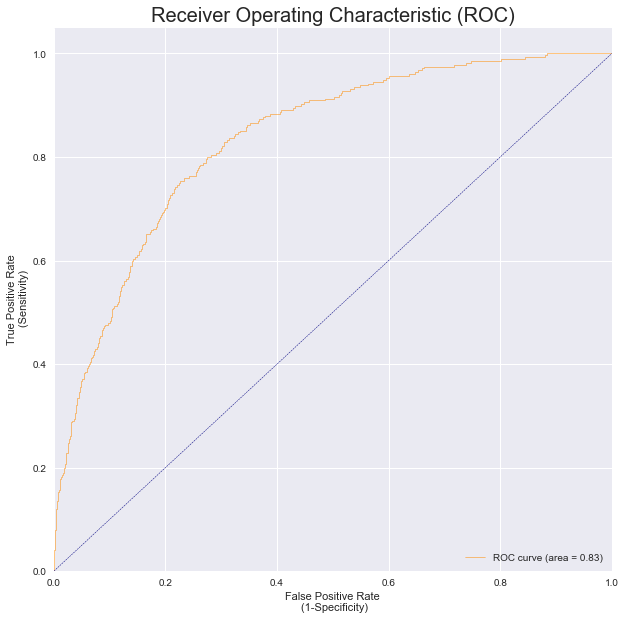


  Test AUC 


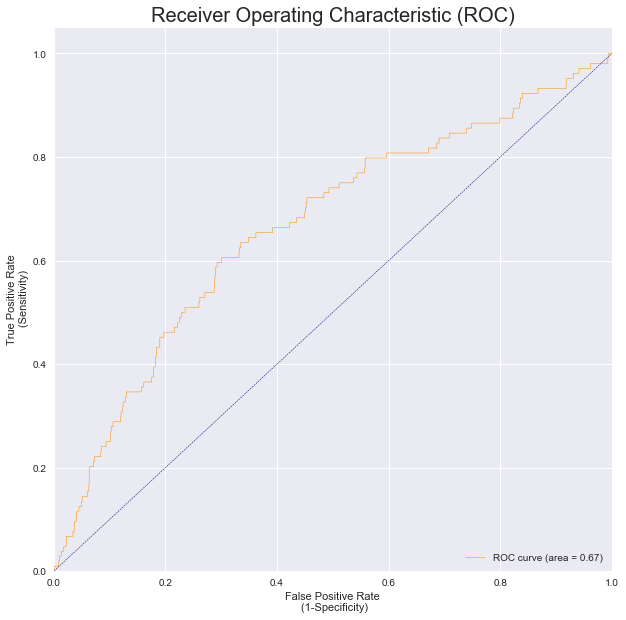


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


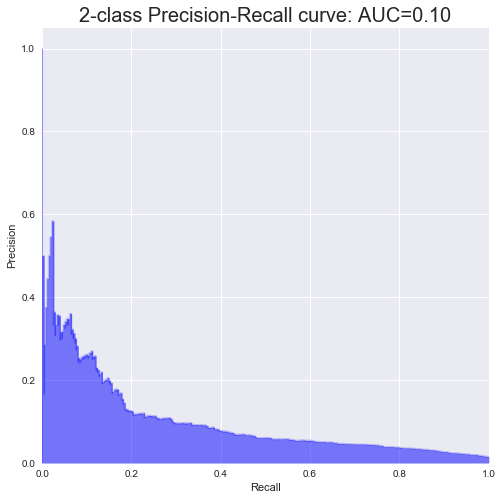


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


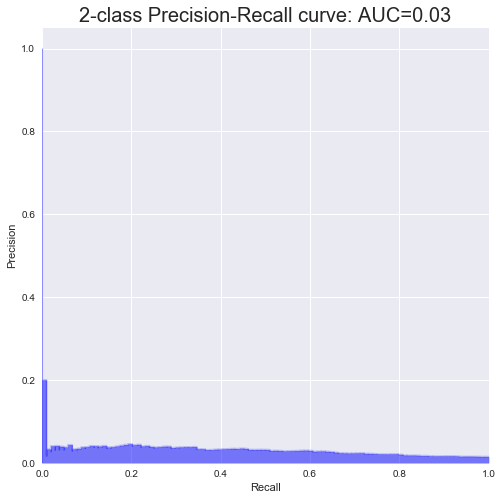

 
Iteration : 9 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 50, [100, 50]]
__________________________________________________________________

Accuracy - Training:  86.72%
Accuracy - test    :  86.20%

AUC Performance
AUC - Training     : 0.8325
AUC - Test         : 0.6660


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.05      0.56      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.04      0.34      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17961   122]
 [ 2653   153]]


  Confusion Matrix - Test 
[[5968   69]
 [ 8

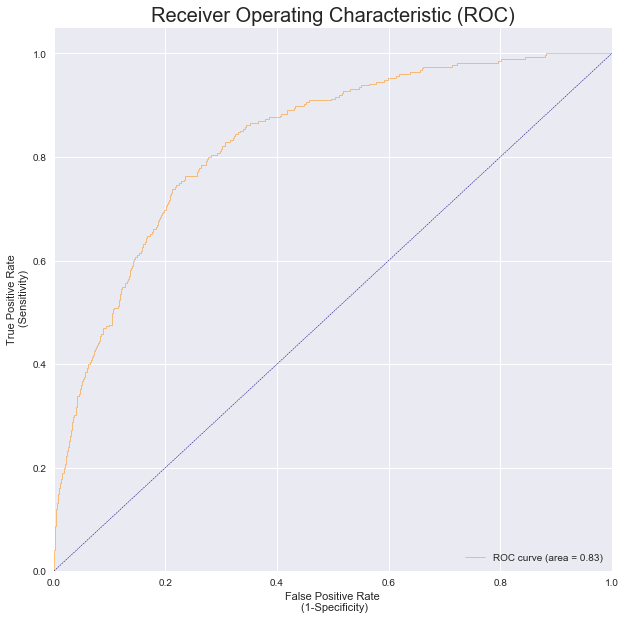


  Test AUC 


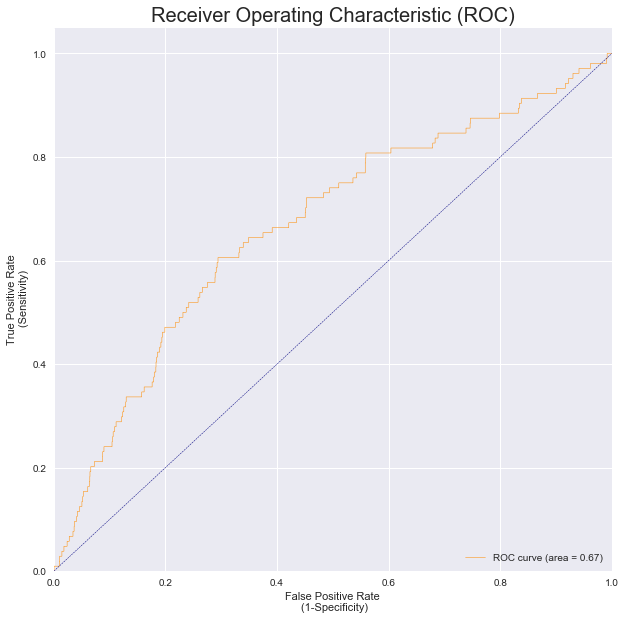


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


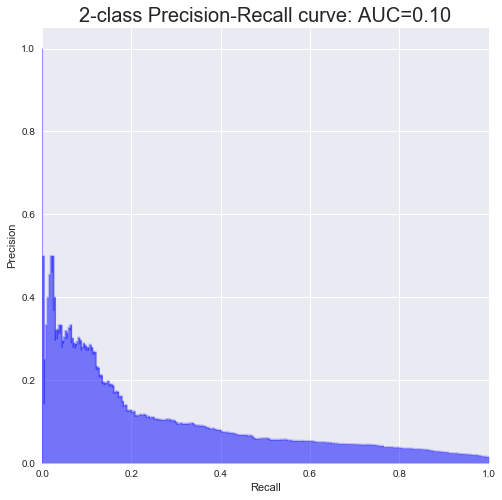


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


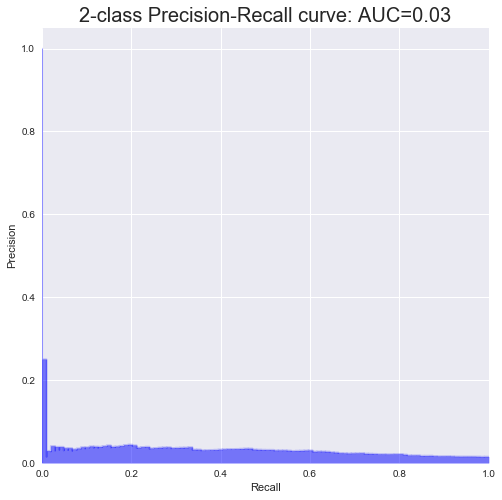

 
Iteration : 10 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 50, [200, 100]]
__________________________________________________________________

Accuracy - Training:  86.65%
Accuracy - test    :  85.97%

AUC Performance
AUC - Training     : 0.8303
AUC - Test         : 0.6645


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.05      0.56      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.92      6860
          1       0.03      0.31      0.06       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17946   120]
 [ 2668   155]]


  Confusion Matrix - Test 
[[5955   72]
 [

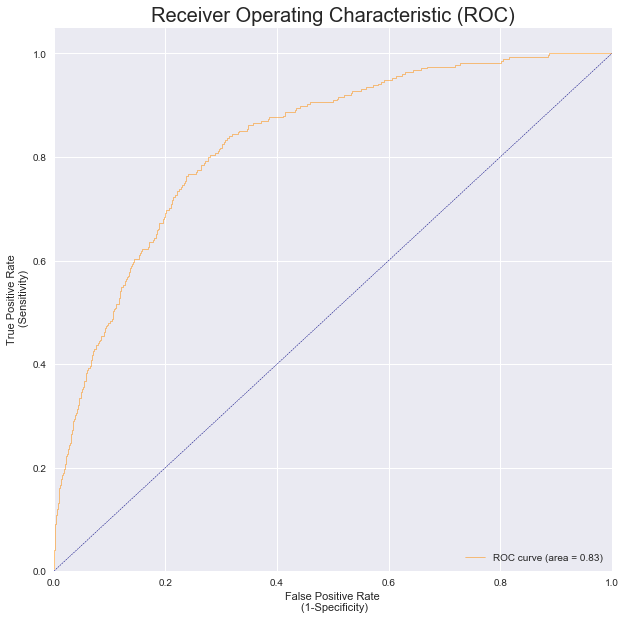


  Test AUC 


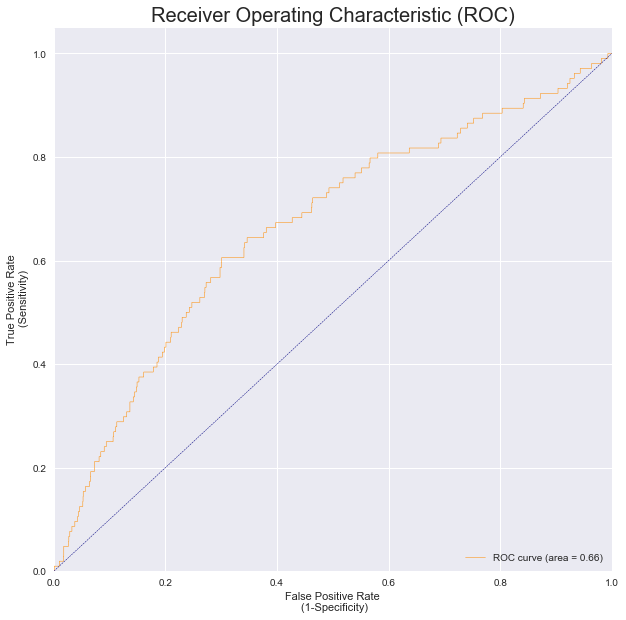


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


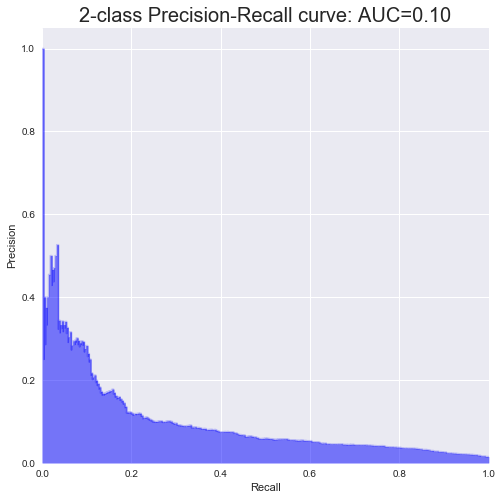


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


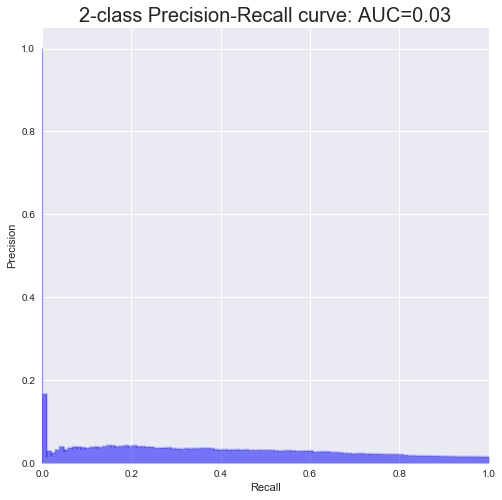

 
Iteration : 11 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 50, [400, 200]]
__________________________________________________________________

Accuracy - Training:  85.83%
Accuracy - test    :  85.58%

AUC Performance
AUC - Training     : 0.8252
AUC - Test         : 0.6604


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.55      0.09       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.03      0.29      0.06       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17778   125]
 [ 2836   150]]


  Confusion Matrix - Test 
[[5930   74]
 [

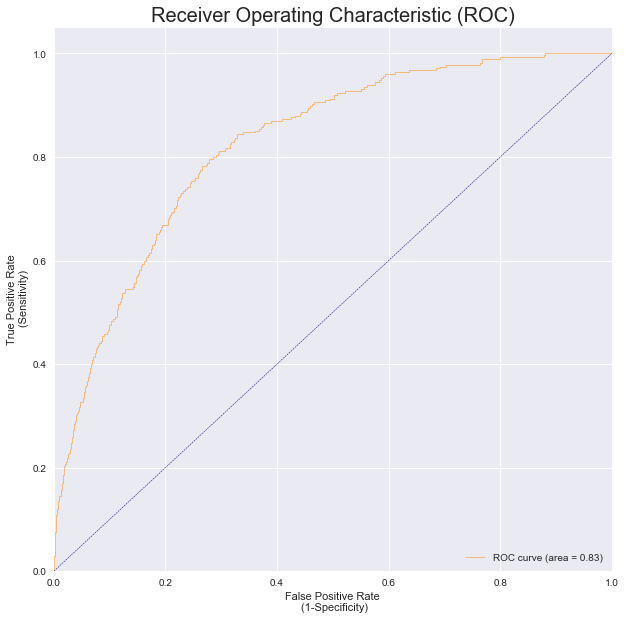


  Test AUC 


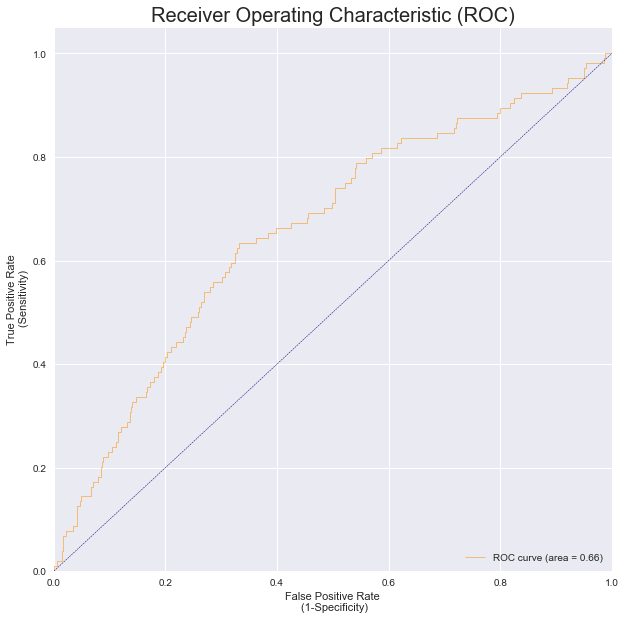


  Train Precission - Recall Curve 
Average precision-recall score: 0.09


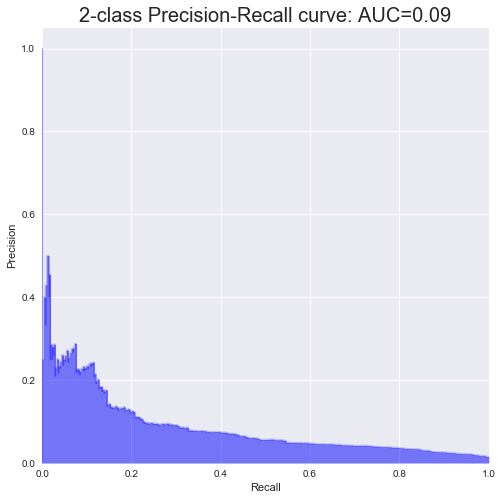


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


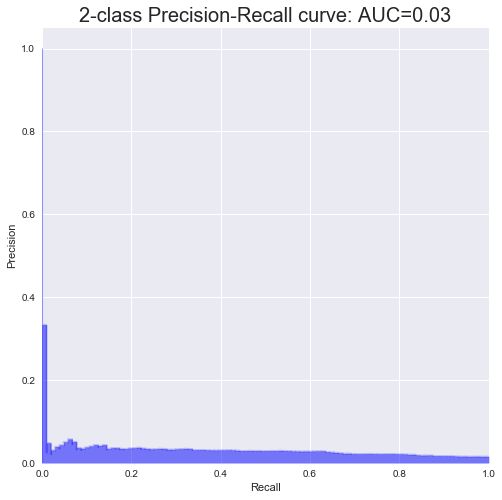

 
Iteration : 12 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 50, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  82.78%
Accuracy - test    :  82.18%

AUC Performance
AUC - Training     : 0.8036
AUC - Test         : 0.6514


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.83      0.90     20614
          1       0.05      0.60      0.08       275

avg / total       0.98      0.83      0.89     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.83      0.90      6860
          1       0.03      0.36      0.06       104

avg / total       0.97      0.82      0.89      6964


  Confusion Matrix - Train 
[[17127   110]
 [ 3487   165]]


  Confusion Matrix - Test 
[[5686   67]
 

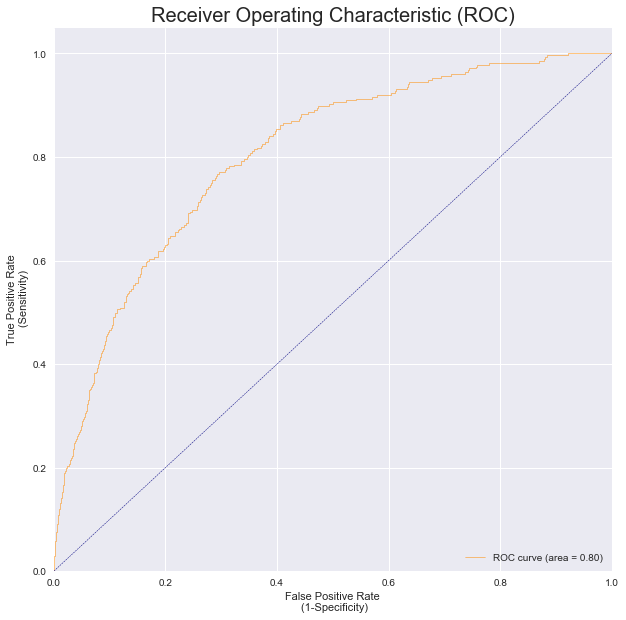


  Test AUC 


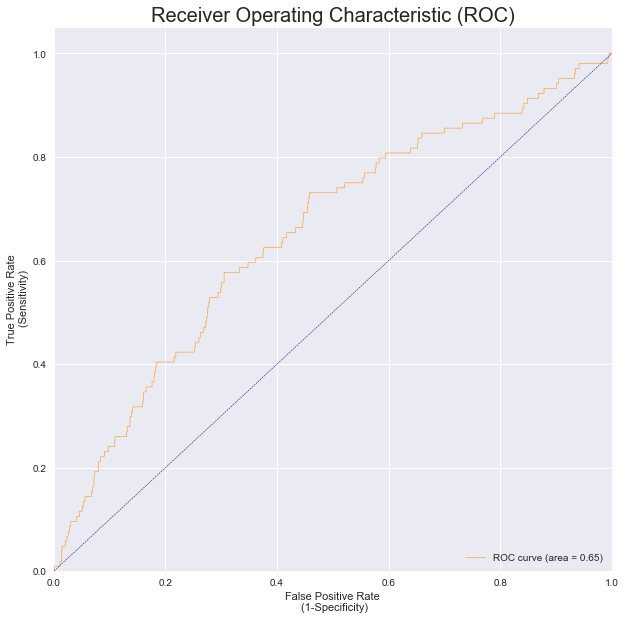


  Train Precission - Recall Curve 
Average precision-recall score: 0.07


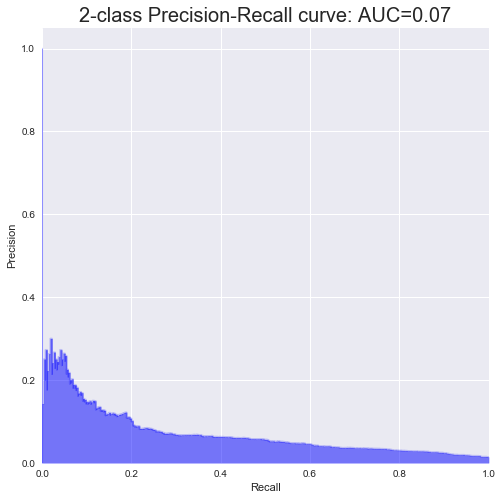


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


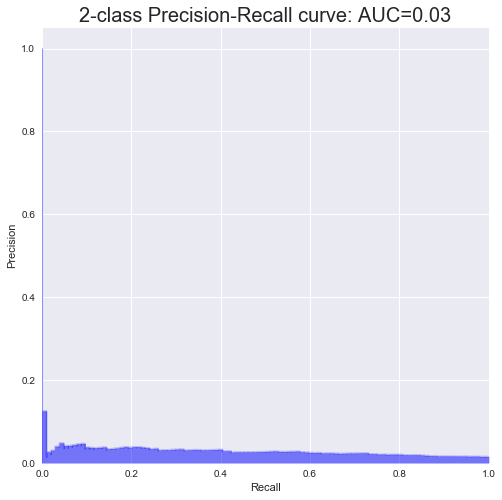

 
Iteration : 13 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 100, [10, 5]]
__________________________________________________________________

Accuracy - Training:  86.54%
Accuracy - test    :  86.14%

AUC Performance
AUC - Training     : 0.8308
AUC - Test         : 0.6728


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.58      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.04      0.33      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17918   115]
 [ 2696   160]]


  Confusion Matrix - Test 
[[5965   70]
 [ 8

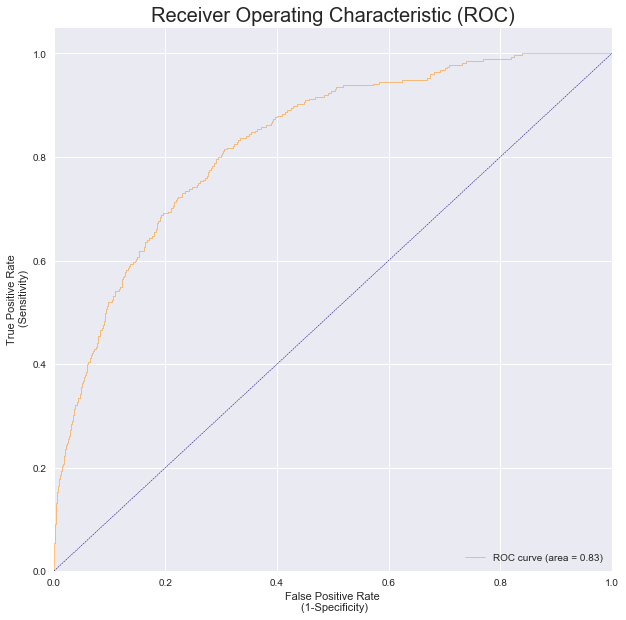


  Test AUC 


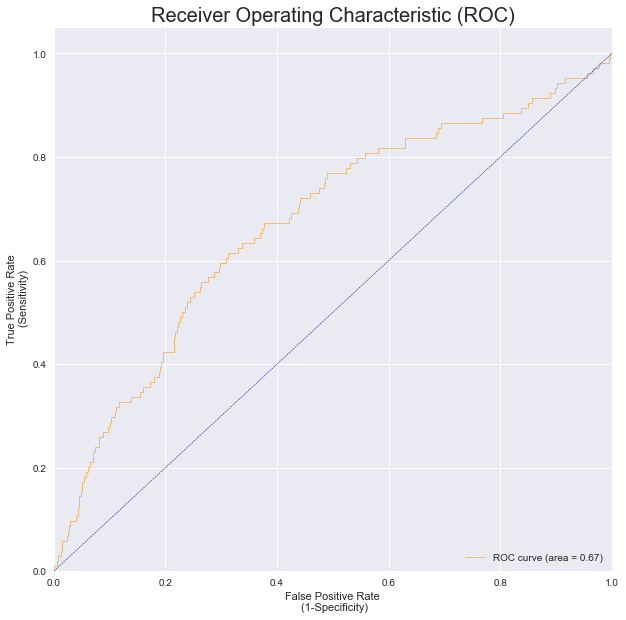


  Train Precission - Recall Curve 
Average precision-recall score: 0.11


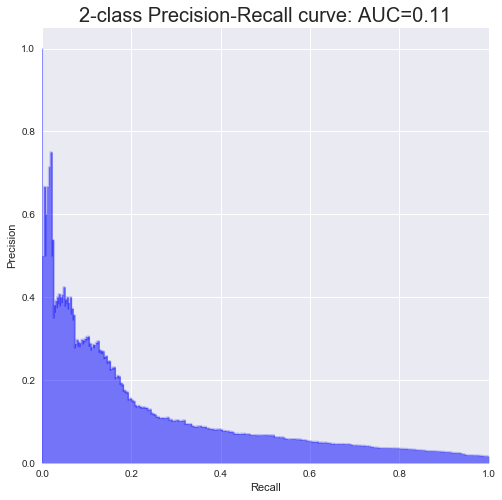


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


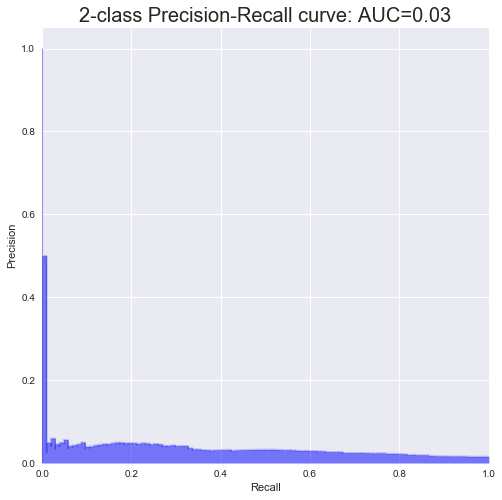

 
Iteration : 14 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 100, [50, 25]]
__________________________________________________________________

Accuracy - Training:  86.54%
Accuracy - test    :  86.03%

AUC Performance
AUC - Training     : 0.8305
AUC - Test         : 0.6713


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.58      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.92      6860
          1       0.04      0.33      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17918   116]
 [ 2696   159]]


  Confusion Matrix - Test 
[[5957   70]
 [ 

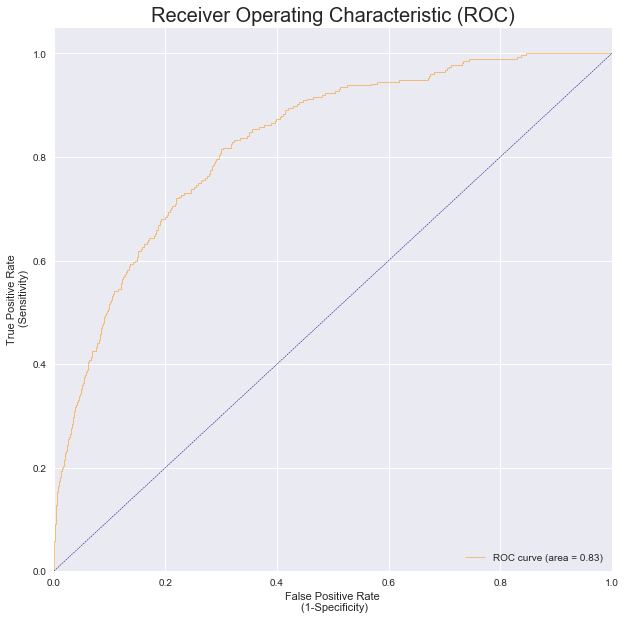


  Test AUC 


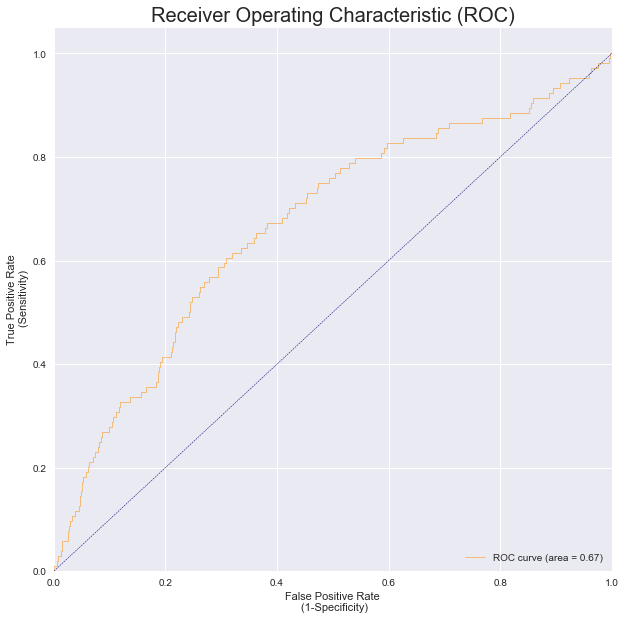


  Train Precission - Recall Curve 
Average precision-recall score: 0.11


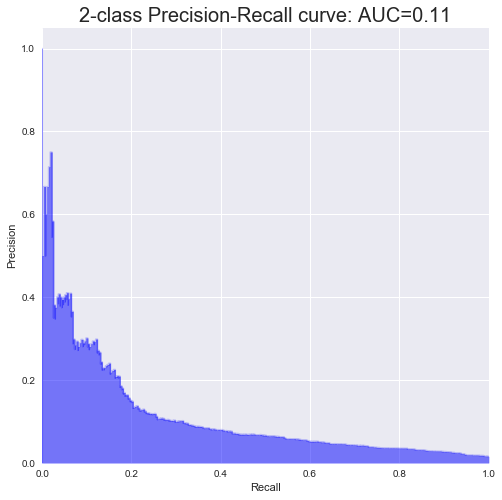


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


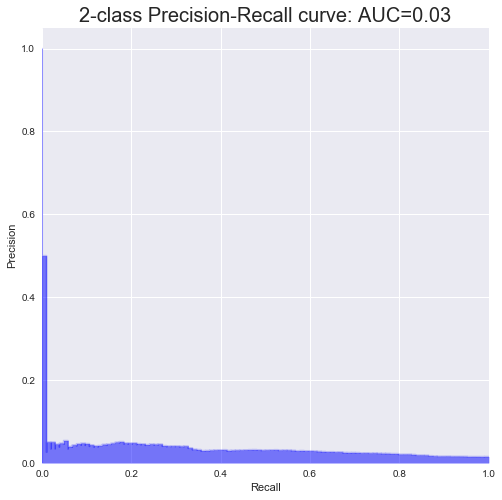

 
Iteration : 15 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 100, [100, 50]]
__________________________________________________________________

Accuracy - Training:  86.34%
Accuracy - test    :  85.68%

AUC Performance
AUC - Training     : 0.8294
AUC - Test         : 0.6721


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.59      0.10       275

avg / total       0.98      0.86      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.04      0.33      0.06       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17873   113]
 [ 2741   162]]


  Confusion Matrix - Test 
[[5933   70]
 [

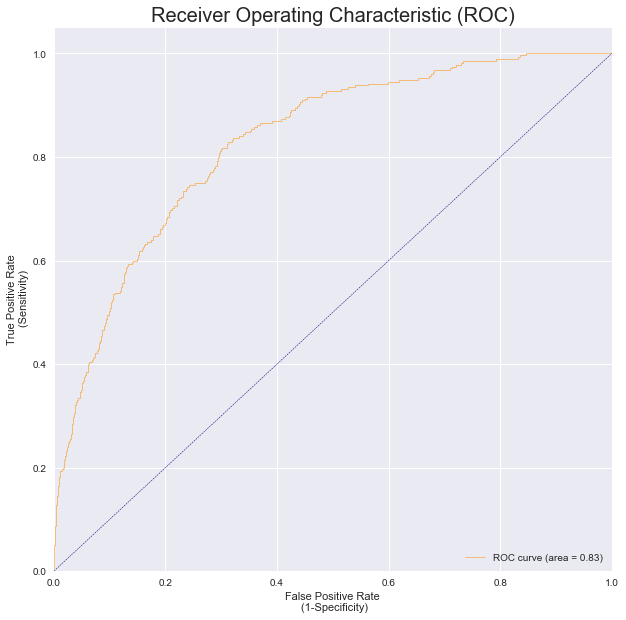


  Test AUC 


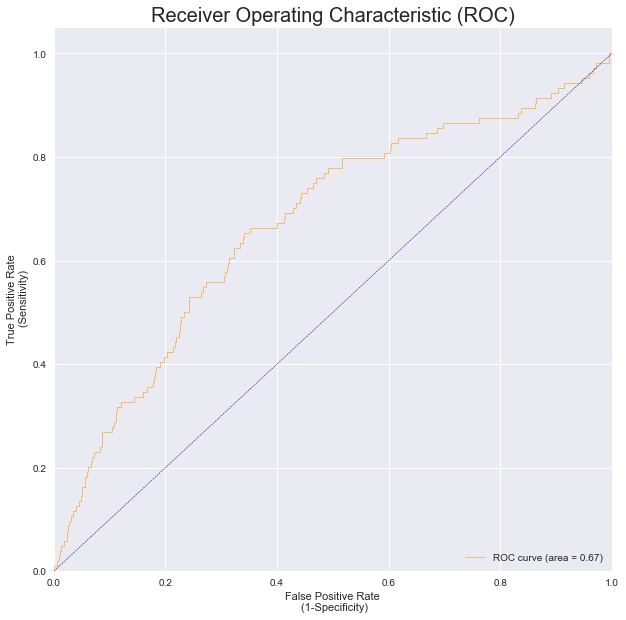


  Train Precission - Recall Curve 
Average precision-recall score: 0.11


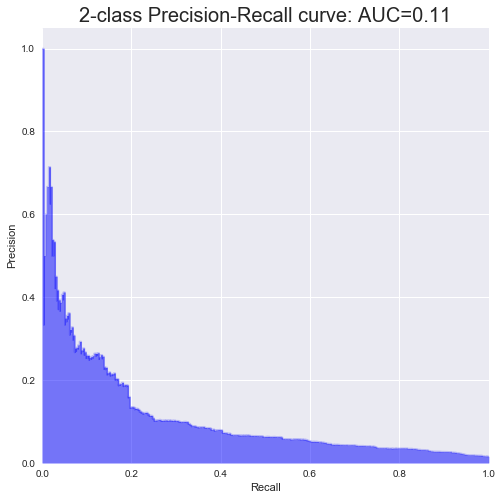


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


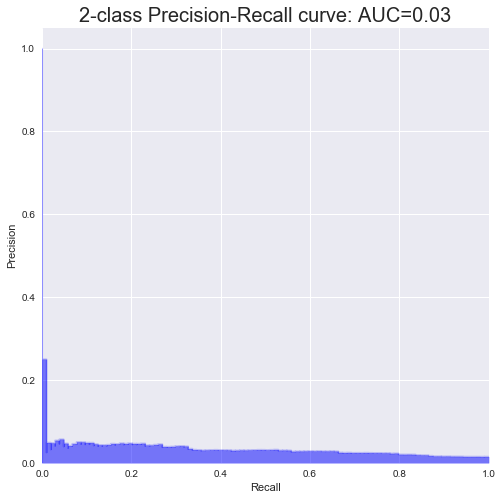

 
Iteration : 16 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 100, [200, 100]]
__________________________________________________________________

Accuracy - Training:  86.05%
Accuracy - test    :  85.47%

AUC Performance
AUC - Training     : 0.8276
AUC - Test         : 0.6711


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.59      0.10       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.03      0.33      0.06       104

avg / total       0.97      0.85      0.91      6964


  Confusion Matrix - Train 
[[17813   113]
 [ 2801   162]]


  Confusion Matrix - Test 
[[5918   70]
 

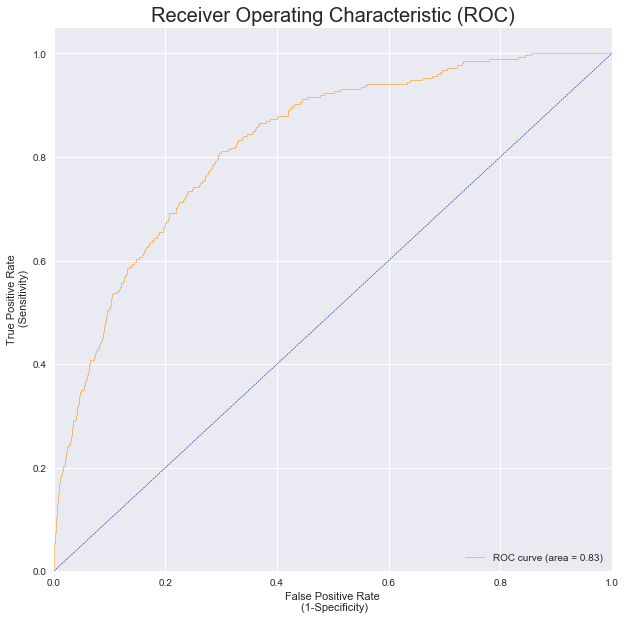


  Test AUC 


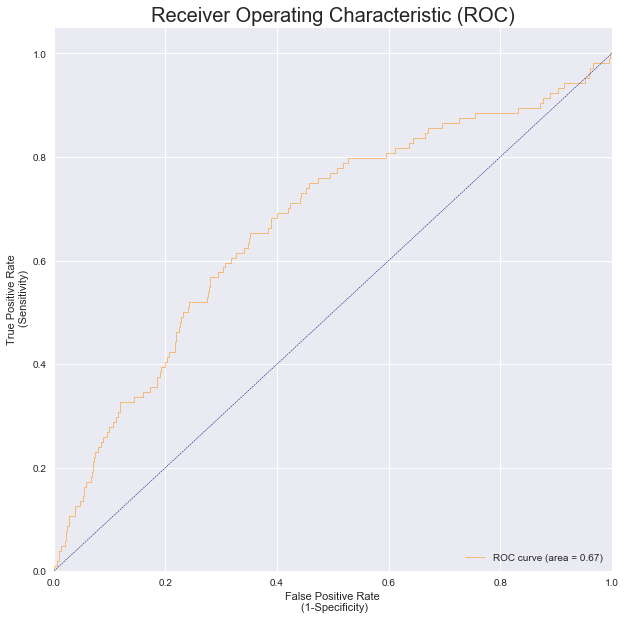


  Train Precission - Recall Curve 
Average precision-recall score: 0.11


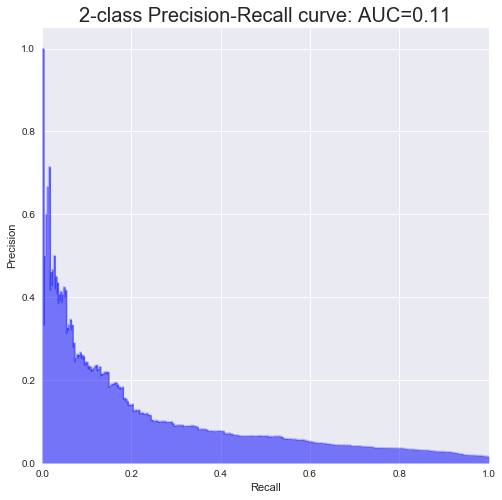


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


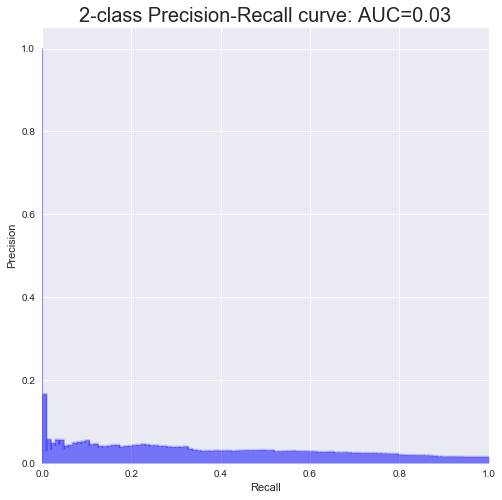

 
Iteration : 17 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 100, [400, 200]]
__________________________________________________________________

Accuracy - Training:  85.34%
Accuracy - test    :  84.62%

AUC Performance
AUC - Training     : 0.8220
AUC - Test         : 0.6694


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.58      0.09       275

avg / total       0.98      0.85      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.85      0.92      6860
          1       0.03      0.31      0.06       104

avg / total       0.97      0.85      0.90      6964


  Confusion Matrix - Train 
[[17666   115]
 [ 2948   160]]


  Confusion Matrix - Test 
[[5861   72]
 

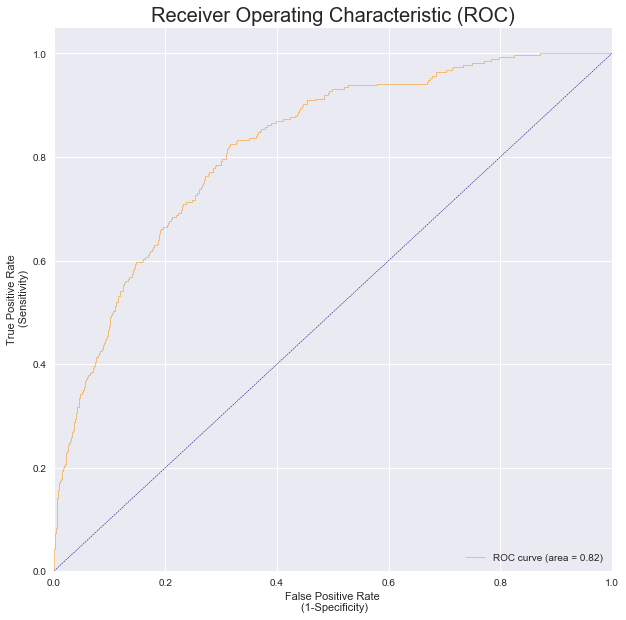


  Test AUC 


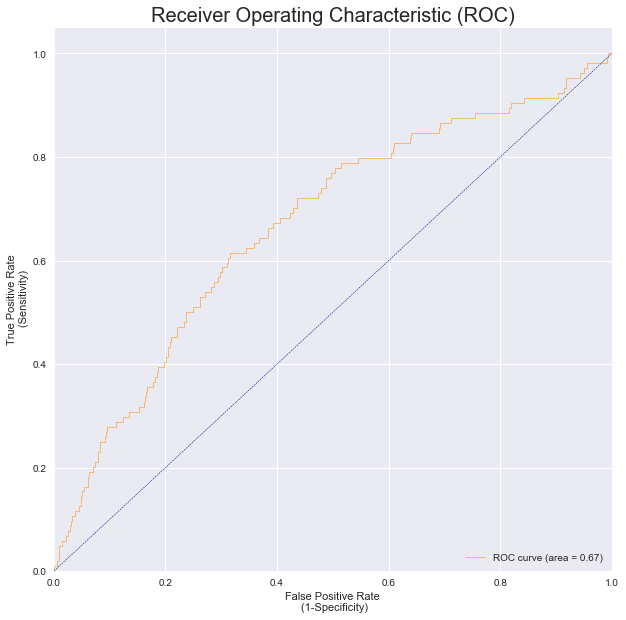


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


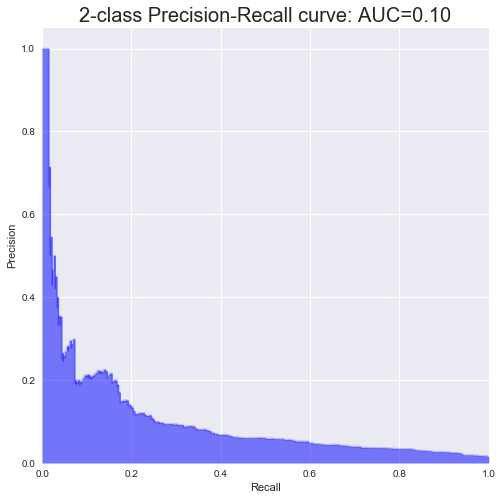


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


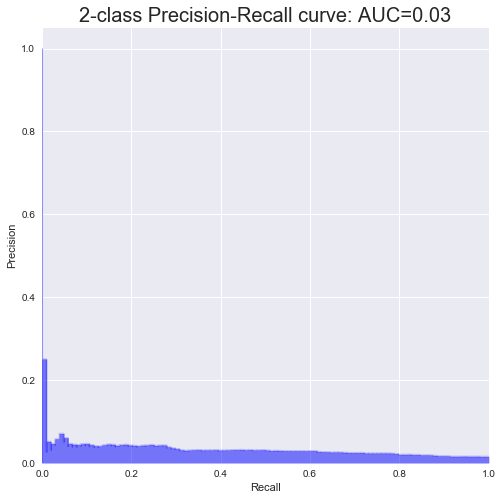

 
Iteration : 18 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 100, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  82.89%
Accuracy - test    :  81.98%

AUC Performance
AUC - Training     : 0.8058
AUC - Test         : 0.6665


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.83      0.91     20614
          1       0.04      0.58      0.08       275

avg / total       0.98      0.83      0.89     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.83      0.90      6860
          1       0.03      0.37      0.06       104

avg / total       0.97      0.82      0.89      6964


  Confusion Matrix - Train 
[[17155   115]
 [ 3459   160]]


  Confusion Matrix - Test 
[[5671   66]


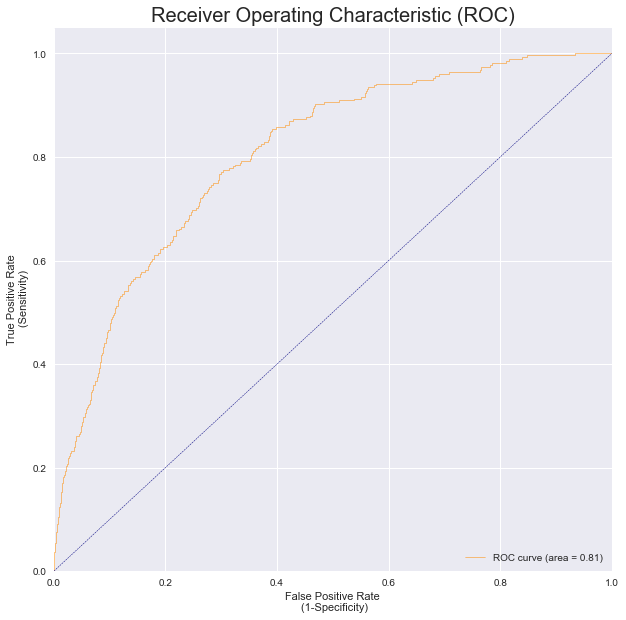


  Test AUC 


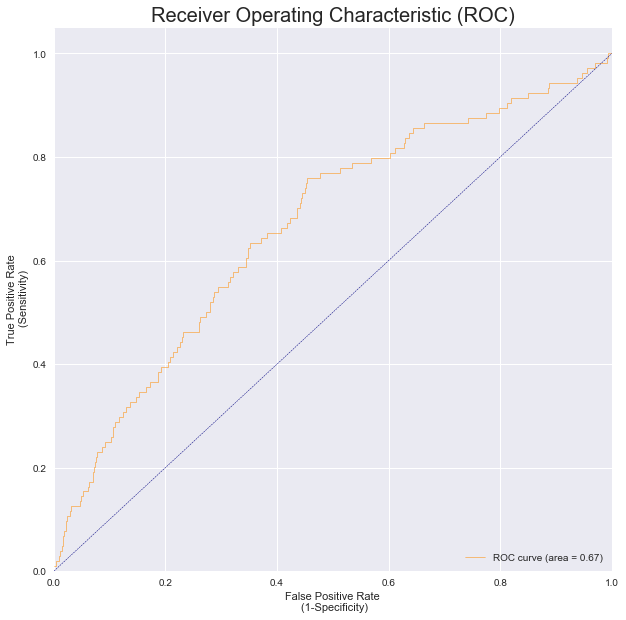


  Train Precission - Recall Curve 
Average precision-recall score: 0.07


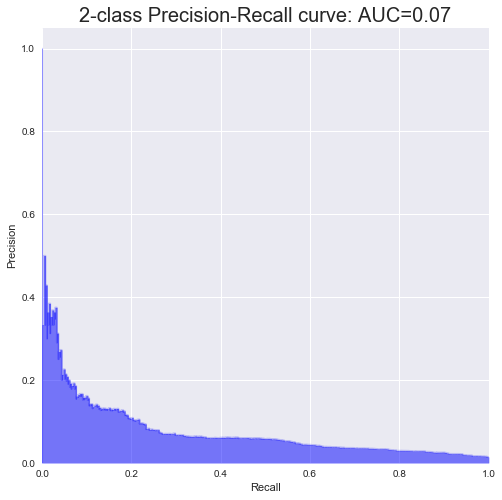


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


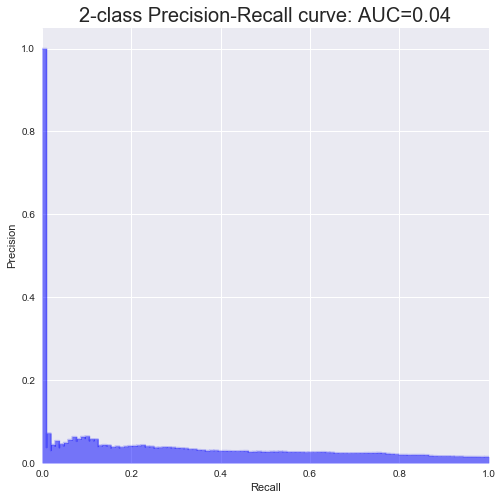

 
Iteration : 19 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 200, [10, 5]]
__________________________________________________________________

Accuracy - Training:  86.76%
Accuracy - test    :  86.52%

AUC Performance
AUC - Training     : 0.8359
AUC - Test         : 0.6753


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.58      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.04      0.35      0.07       104

avg / total       0.97      0.87      0.91      6964


  Confusion Matrix - Train 
[[17964   115]
 [ 2650   160]]


  Confusion Matrix - Test 
[[5989   68]
 [ 8

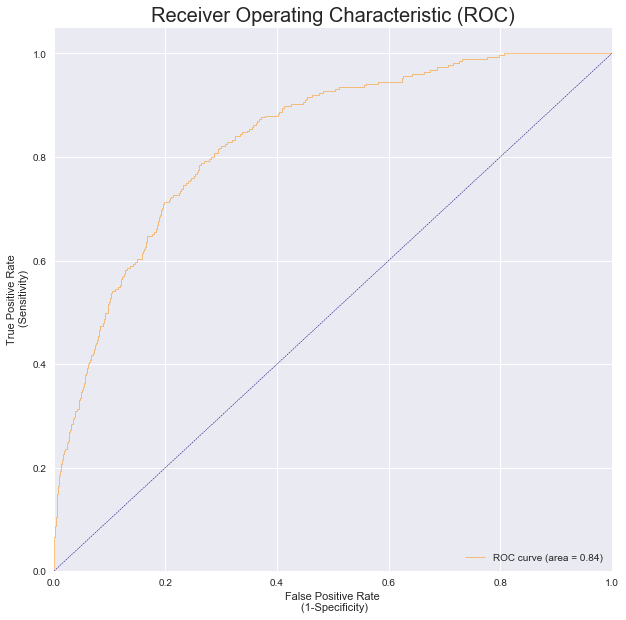


  Test AUC 


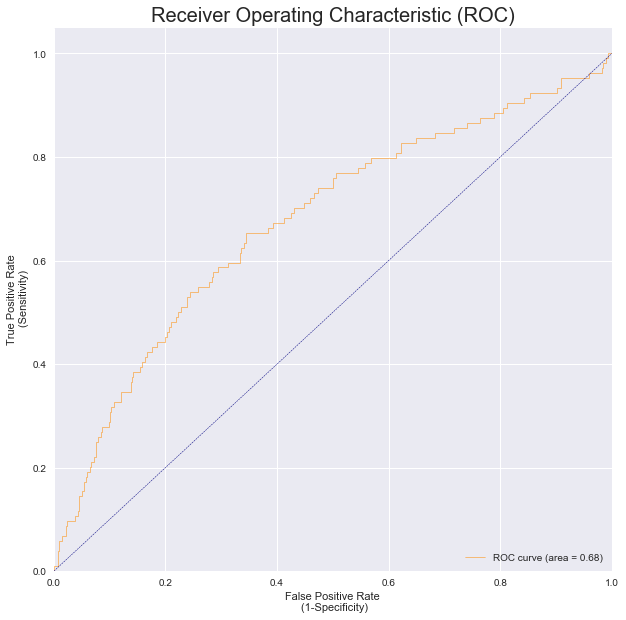


  Train Precission - Recall Curve 
Average precision-recall score: 0.12


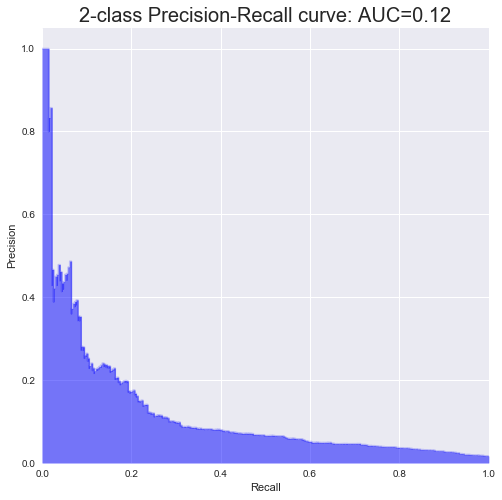


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


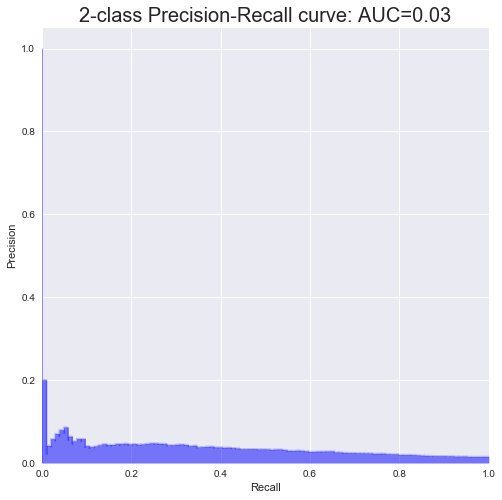

 
Iteration : 20 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 200, [50, 25]]
__________________________________________________________________

Accuracy - Training:  86.70%
Accuracy - test    :  86.46%

AUC Performance
AUC - Training     : 0.8355
AUC - Test         : 0.6749


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.58      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.04      0.35      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17952   116]
 [ 2662   159]]


  Confusion Matrix - Test 
[[5985   68]
 [ 

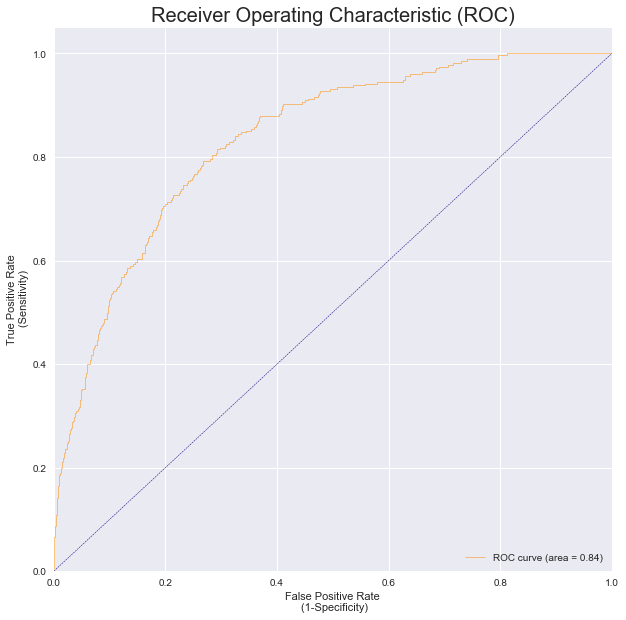


  Test AUC 


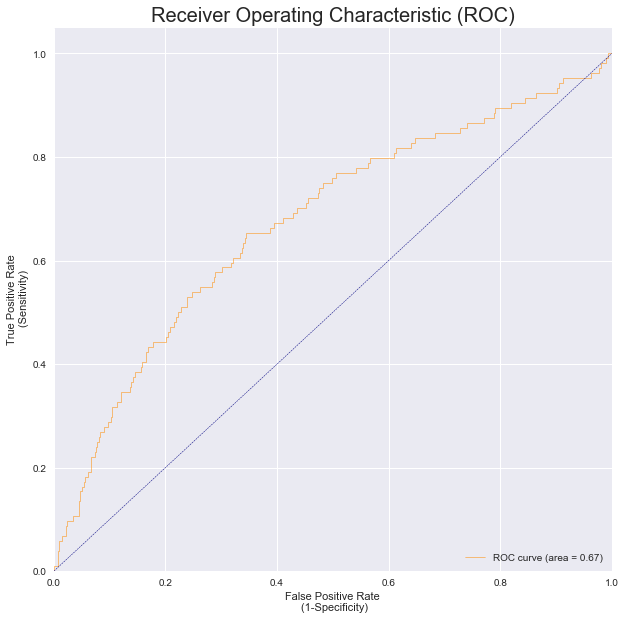


  Train Precission - Recall Curve 
Average precision-recall score: 0.12


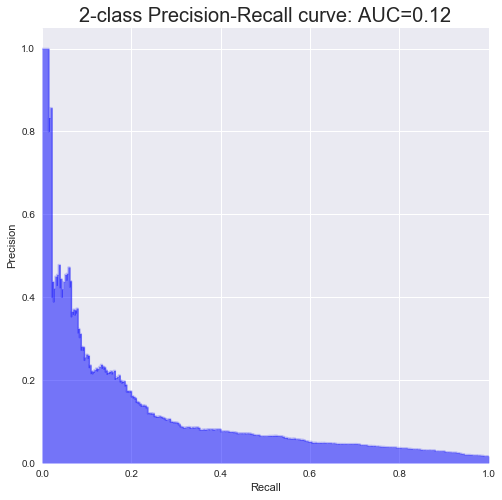


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


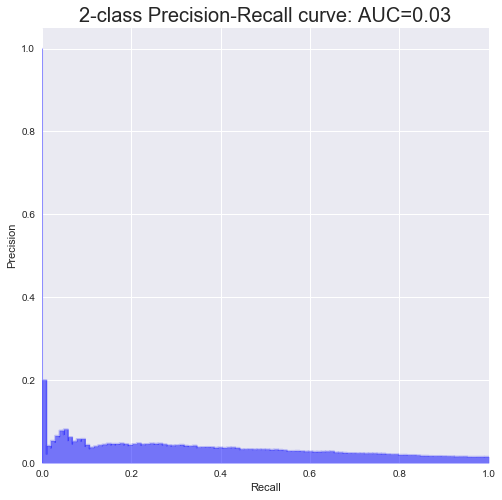

 
Iteration : 21 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 200, [100, 50]]
__________________________________________________________________

Accuracy - Training:  86.54%
Accuracy - test    :  86.29%

AUC Performance
AUC - Training     : 0.8337
AUC - Test         : 0.6760


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.58      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.04      0.35      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17918   115]
 [ 2696   160]]


  Confusion Matrix - Test 
[[5973   68]
 [

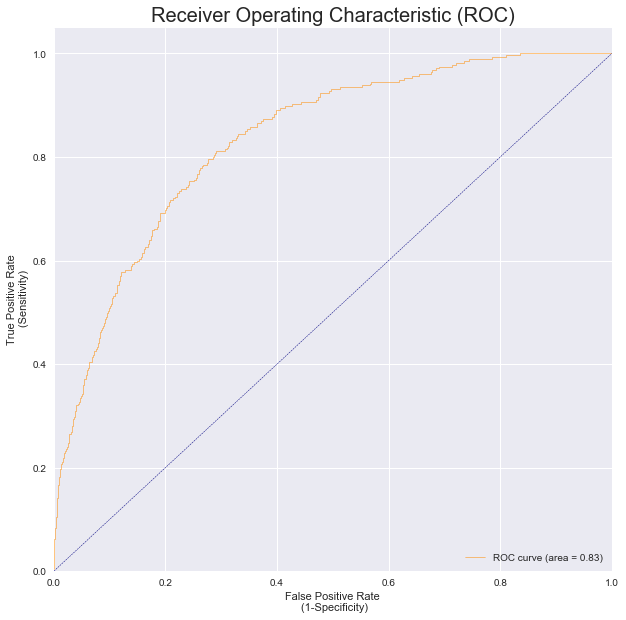


  Test AUC 


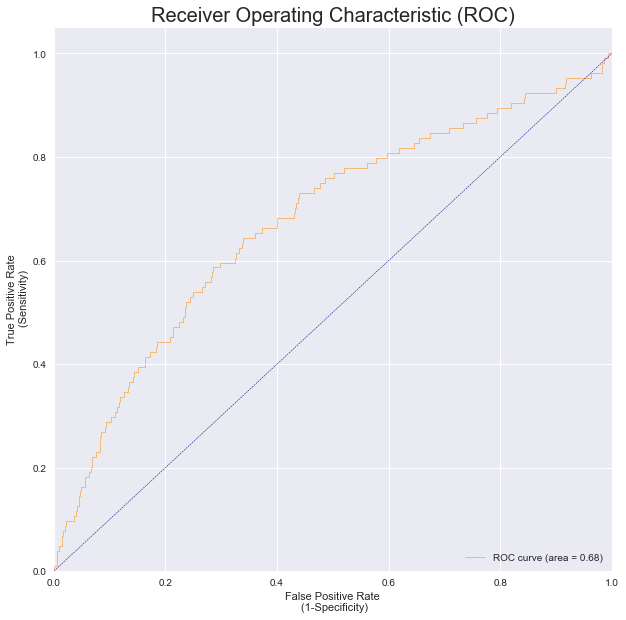


  Train Precission - Recall Curve 
Average precision-recall score: 0.12


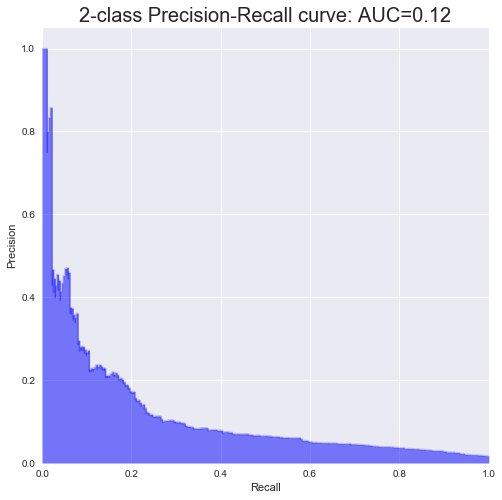


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


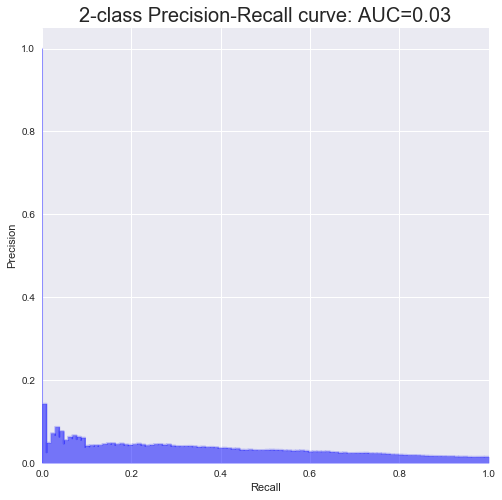

 
Iteration : 22 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 200, [200, 100]]
__________________________________________________________________

Accuracy - Training:  86.29%
Accuracy - test    :  86.04%

AUC Performance
AUC - Training     : 0.8309
AUC - Test         : 0.6740


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.59      0.10       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.92      6860
          1       0.04      0.35      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17865   114]
 [ 2749   161]]


  Confusion Matrix - Test 
[[5956   68]
 

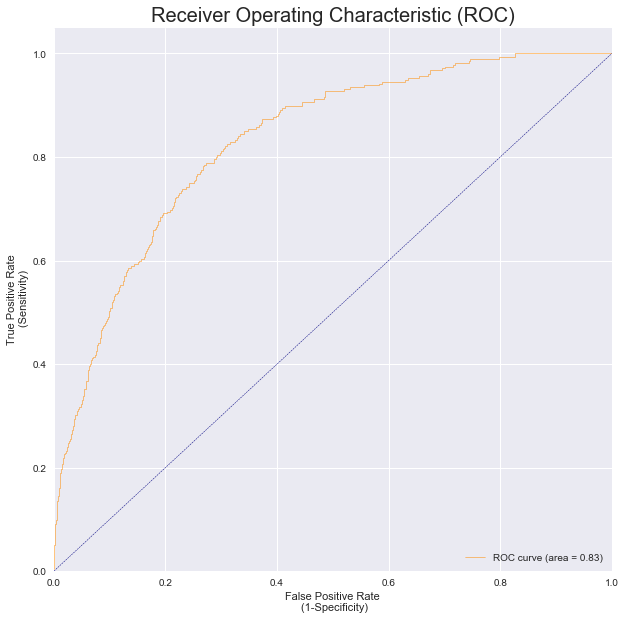


  Test AUC 


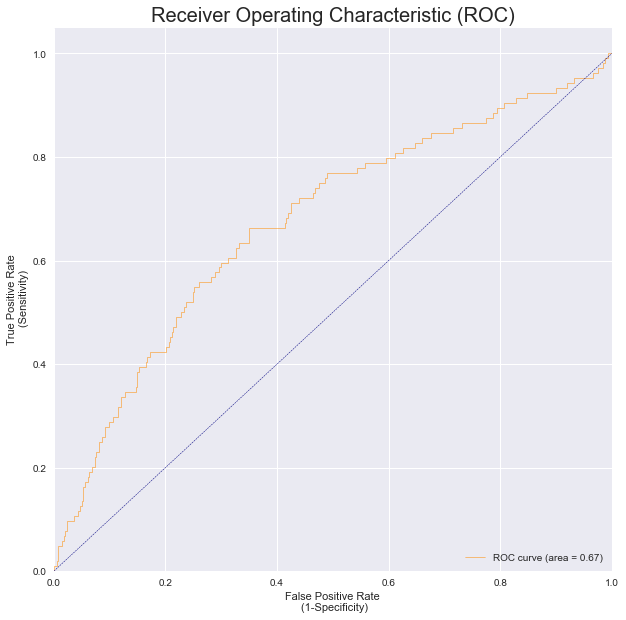


  Train Precission - Recall Curve 
Average precision-recall score: 0.11


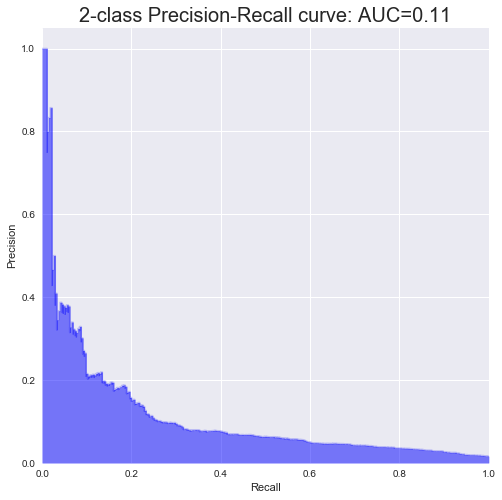


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


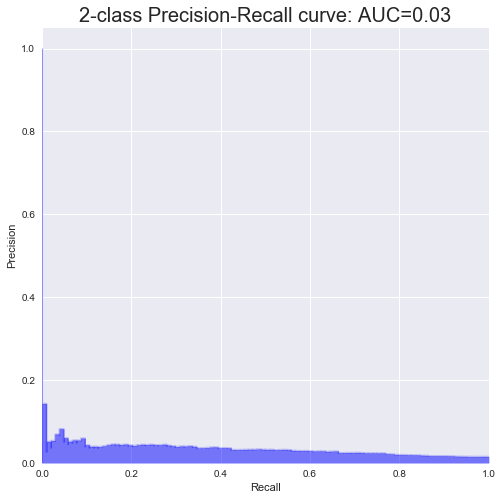

 
Iteration : 23 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 200, [400, 200]]
__________________________________________________________________

Accuracy - Training:  85.90%
Accuracy - test    :  85.09%

AUC Performance
AUC - Training     : 0.8263
AUC - Test         : 0.6737


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.57      0.10       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.03      0.34      0.06       104

avg / total       0.97      0.85      0.91      6964


  Confusion Matrix - Train 
[[17786   117]
 [ 2828   158]]


  Confusion Matrix - Test 
[[5891   69]
 

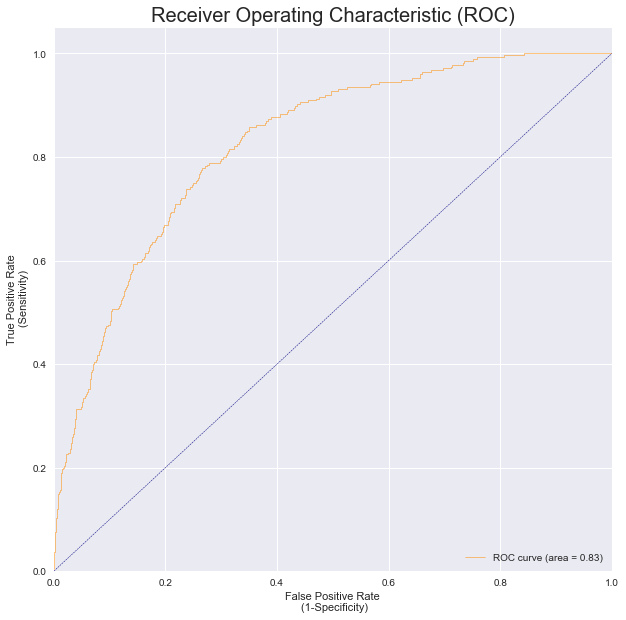


  Test AUC 


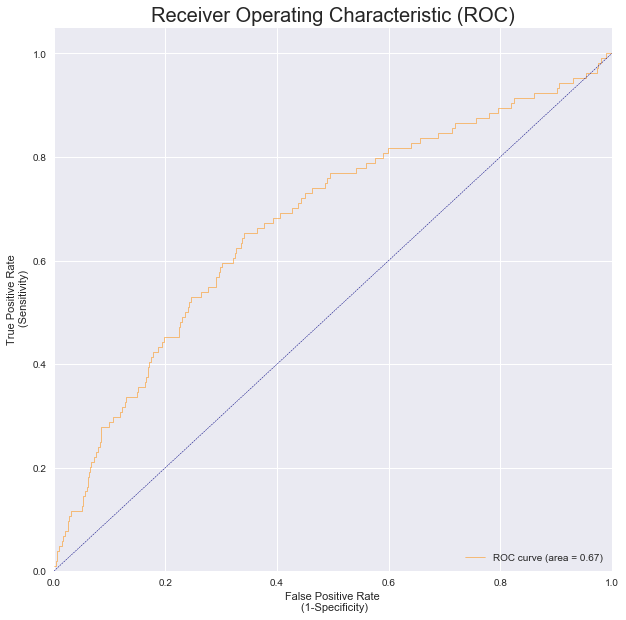


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


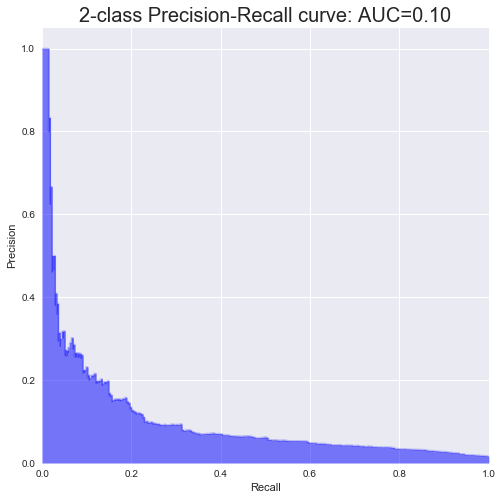


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


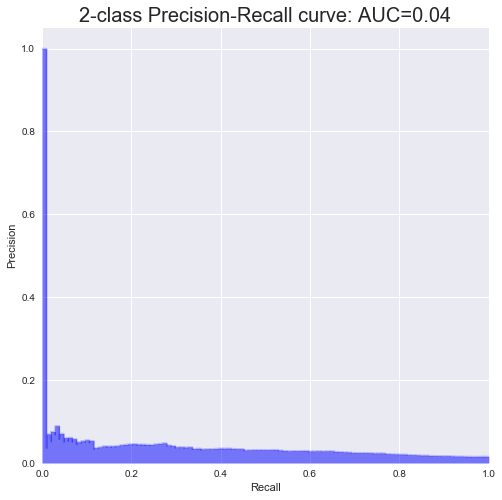

 
Iteration : 24 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [3, 200, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  83.56%
Accuracy - test    :  82.88%

AUC Performance
AUC - Training     : 0.8090
AUC - Test         : 0.6666


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.84      0.91     20614
          1       0.05      0.59      0.09       275

avg / total       0.98      0.84      0.90     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.84      0.91      6860
          1       0.03      0.38      0.06       104

avg / total       0.97      0.83      0.89      6964


  Confusion Matrix - Train 
[[17292   113]
 [ 3322   162]]


  Confusion Matrix - Test 
[[5733   65]


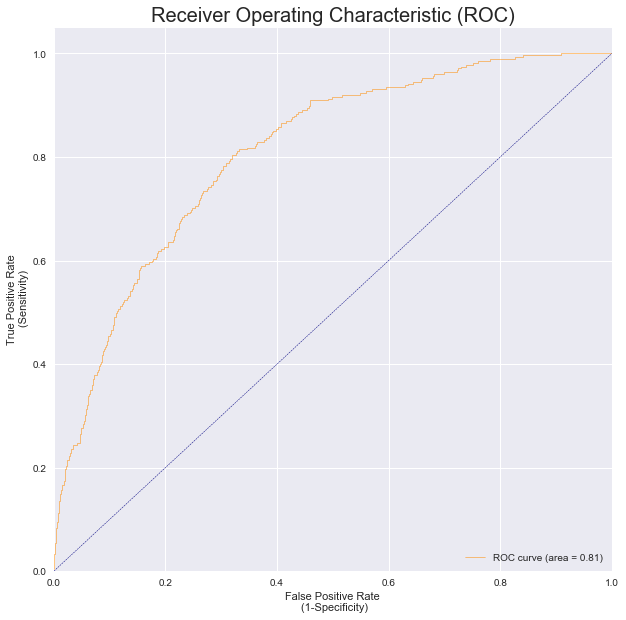


  Test AUC 


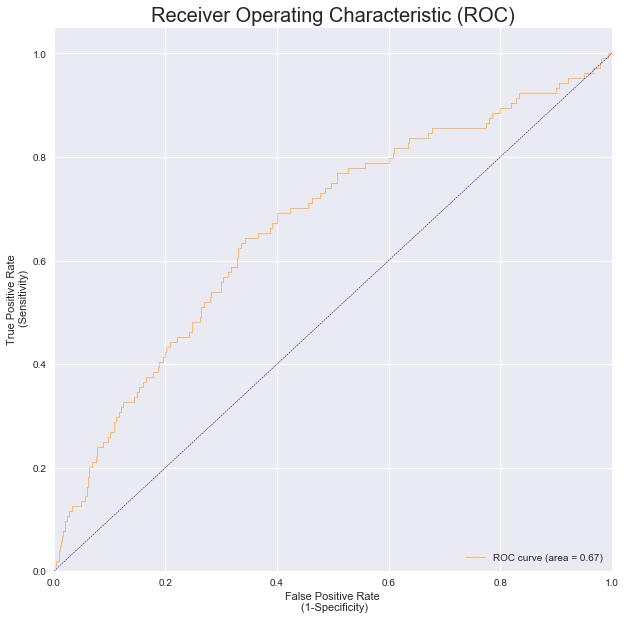


  Train Precission - Recall Curve 
Average precision-recall score: 0.09


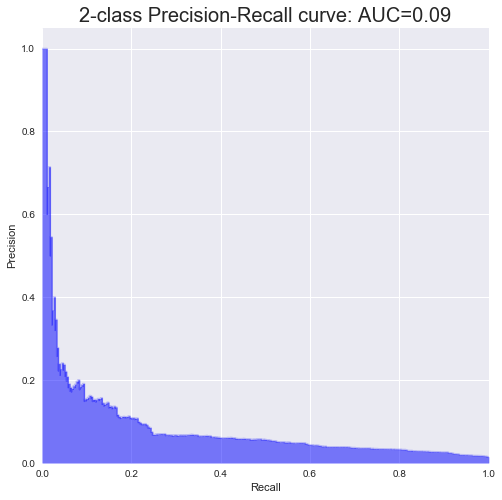


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


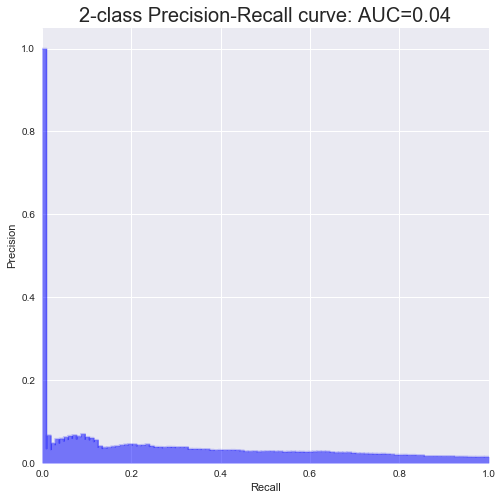

 
Iteration : 25 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 25, [10, 5]]
__________________________________________________________________

Accuracy - Training:  90.35%
Accuracy - test    :  89.27%

AUC Performance
AUC - Training     : 0.8667
AUC - Test         : 0.6435


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95     20614
          1       0.08      0.58      0.14       275

avg / total       0.98      0.90      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.90      0.94      6860
          1       0.04      0.24      0.06       104

avg / total       0.97      0.89      0.93      6964


  Confusion Matrix - Train 
[[18713   115]
 [ 1901   160]]


  Confusion Matrix - Test 
[[6192   79]
 [ 66

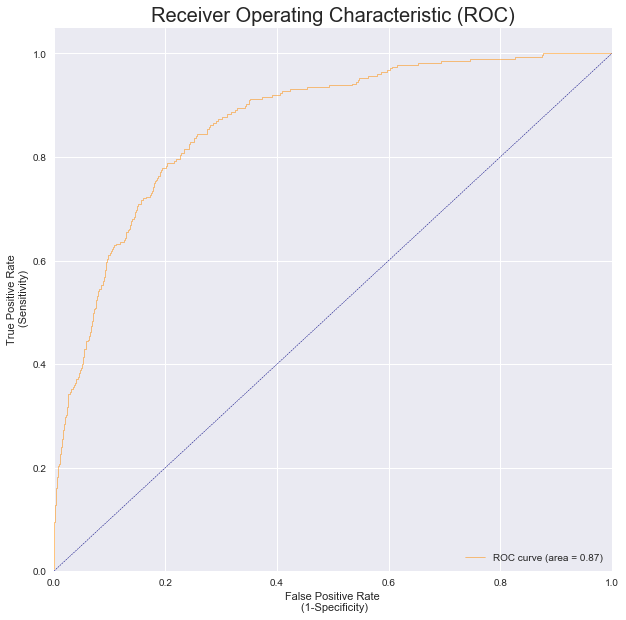


  Test AUC 


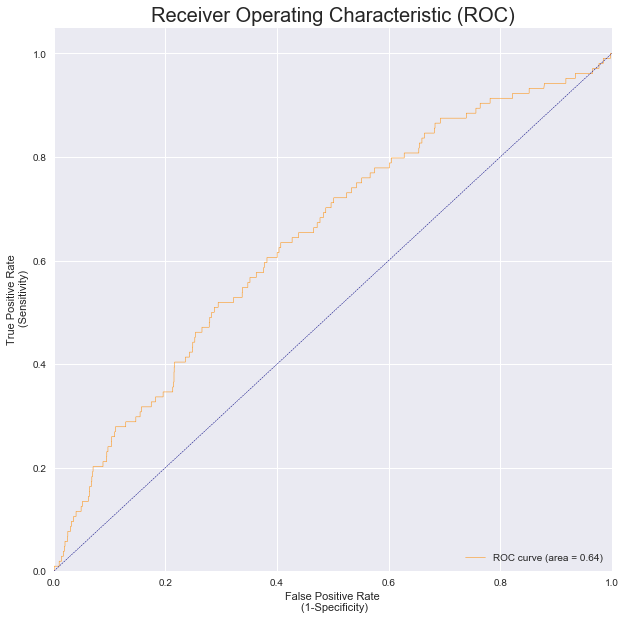


  Train Precission - Recall Curve 
Average precision-recall score: 0.19


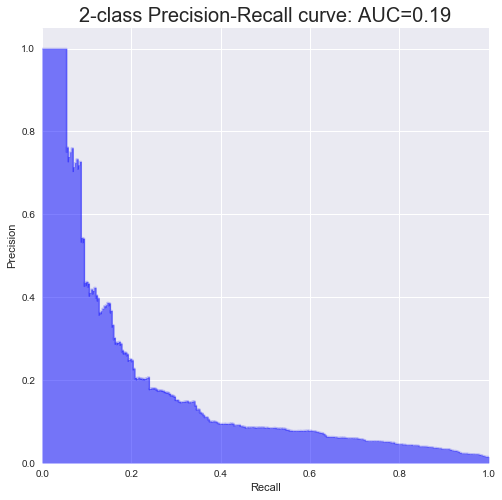


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


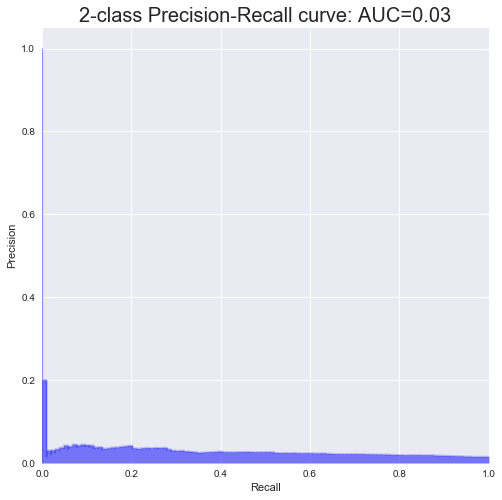

 
Iteration : 26 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 25, [50, 25]]
__________________________________________________________________

Accuracy - Training:  90.03%
Accuracy - test    :  89.10%

AUC Performance
AUC - Training     : 0.8640
AUC - Test         : 0.6453


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.90      0.95     20614
          1       0.08      0.59      0.14       275

avg / total       0.98      0.90      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.90      0.94      6860
          1       0.03      0.23      0.06       104

avg / total       0.97      0.89      0.93      6964


  Confusion Matrix - Train 
[[18643   112]
 [ 1971   163]]


  Confusion Matrix - Test 
[[6181   80]
 [ 6

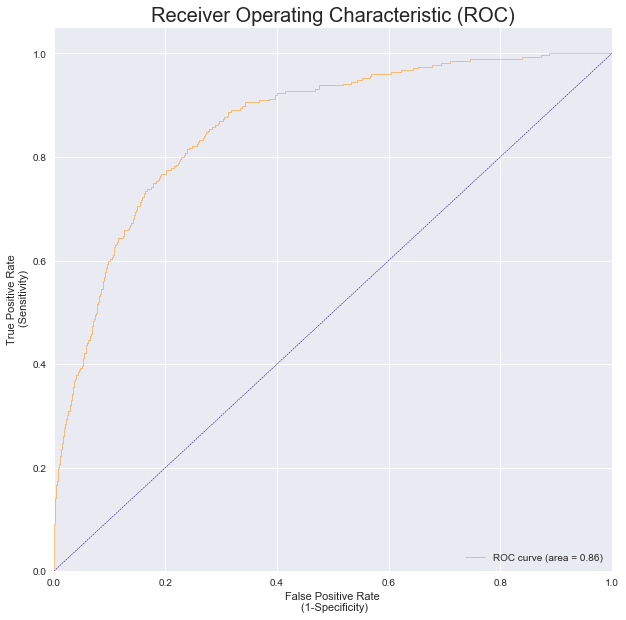


  Test AUC 


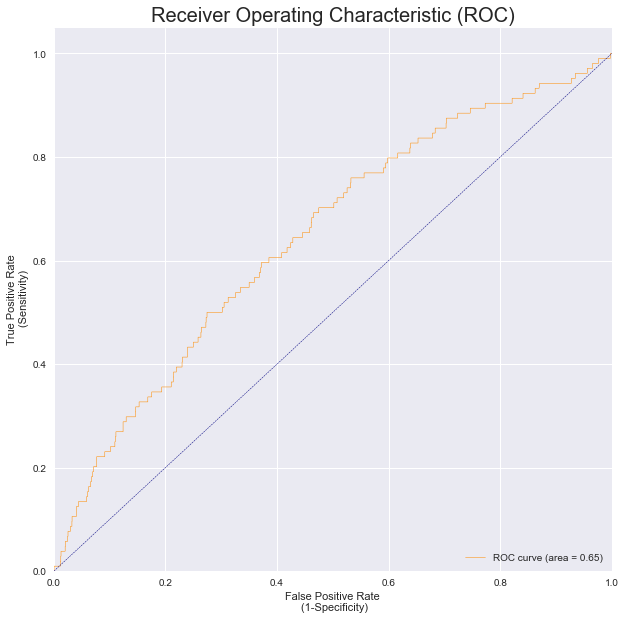


  Train Precission - Recall Curve 
Average precision-recall score: 0.18


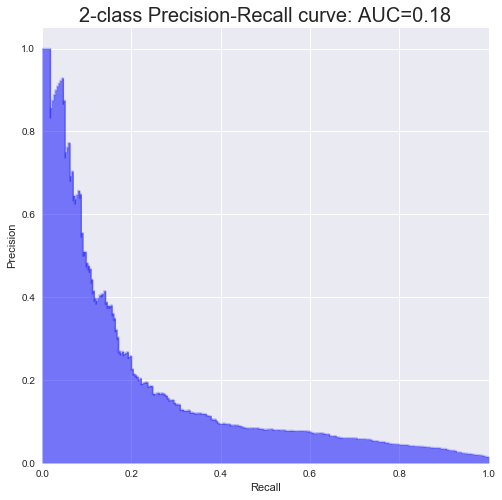


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


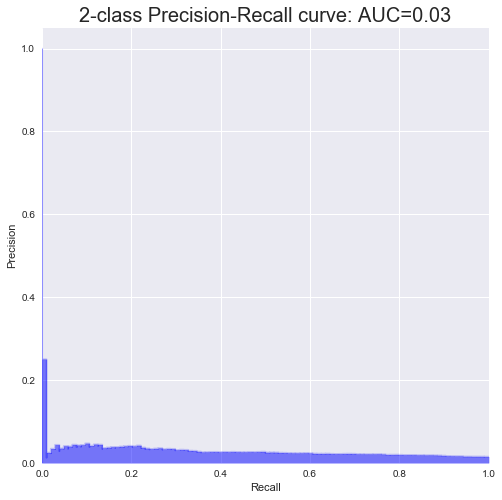

 
Iteration : 27 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 25, [100, 50]]
__________________________________________________________________

Accuracy - Training:  89.73%
Accuracy - test    :  88.91%

AUC Performance
AUC - Training     : 0.8610
AUC - Test         : 0.6414


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.90      0.95     20614
          1       0.07      0.58      0.13       275

avg / total       0.98      0.90      0.93     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.90      0.94      6860
          1       0.03      0.22      0.06       104

avg / total       0.97      0.89      0.93      6964


  Confusion Matrix - Train 
[[18584   115]
 [ 2030   160]]


  Confusion Matrix - Test 
[[6169   81]
 [ 

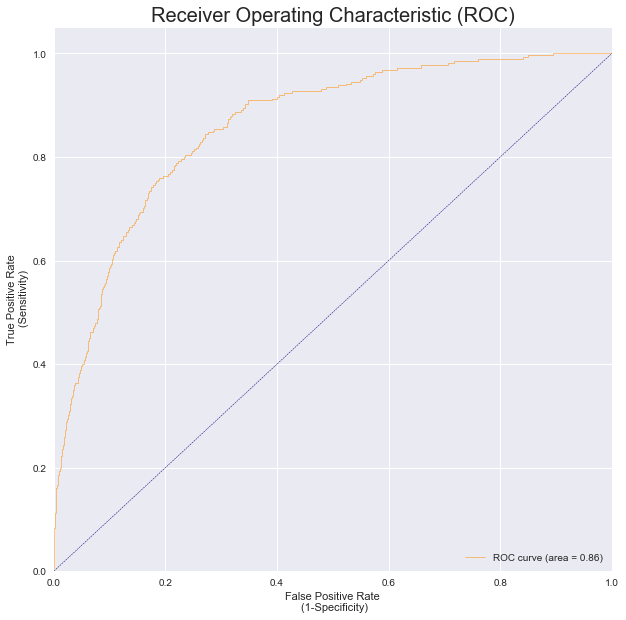


  Test AUC 


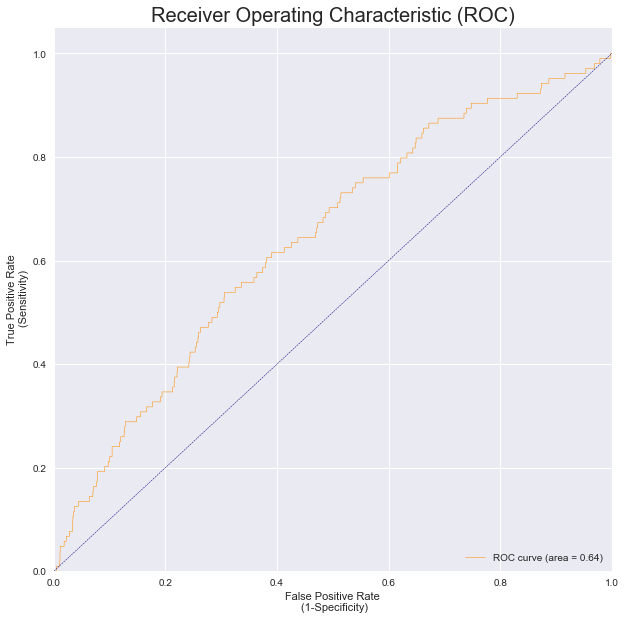


  Train Precission - Recall Curve 
Average precision-recall score: 0.17


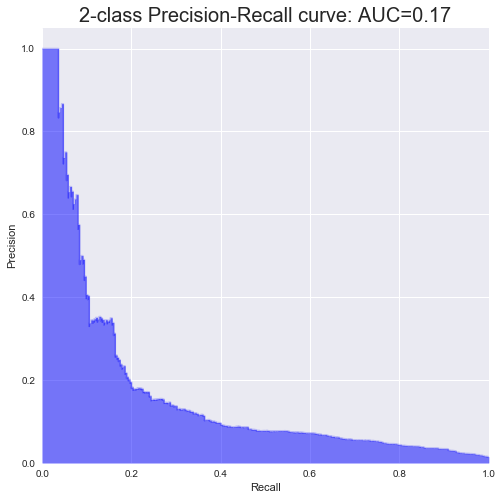


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


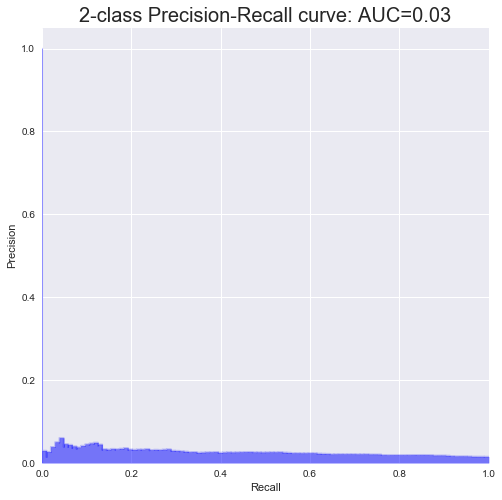

 
Iteration : 28 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 25, [200, 100]]
__________________________________________________________________

Accuracy - Training:  89.15%
Accuracy - test    :  88.41%

AUC Performance
AUC - Training     : 0.8571
AUC - Test         : 0.6524


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.90      0.94     20614
          1       0.07      0.58      0.12       275

avg / total       0.98      0.89      0.93     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.89      0.94      6860
          1       0.03      0.25      0.06       104

avg / total       0.97      0.88      0.93      6964


  Confusion Matrix - Train 
[[18463   116]
 [ 2151   159]]


  Confusion Matrix - Test 
[[6131   78]
 [

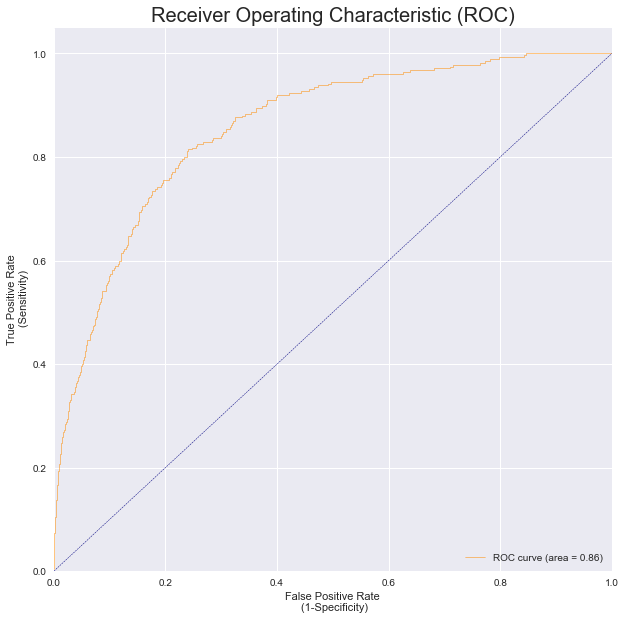


  Test AUC 


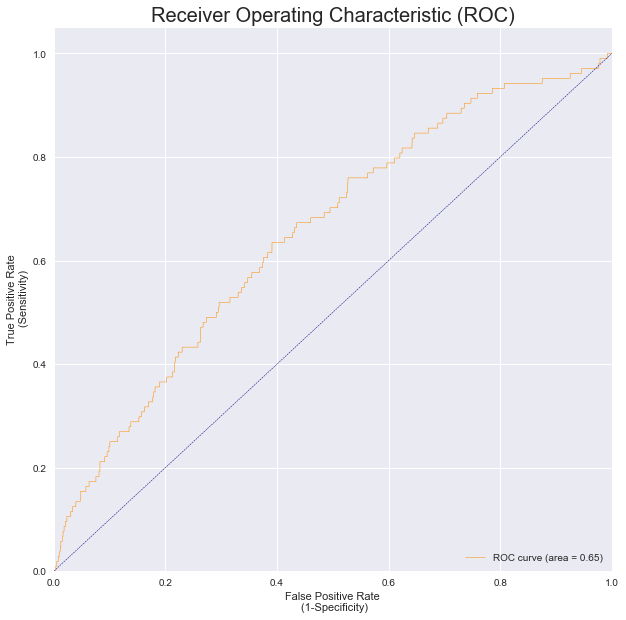


  Train Precission - Recall Curve 
Average precision-recall score: 0.15


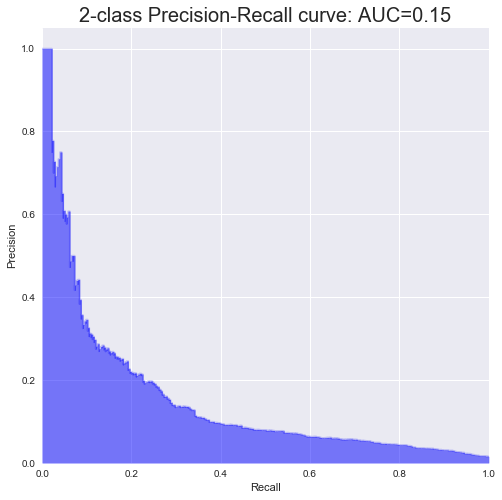


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


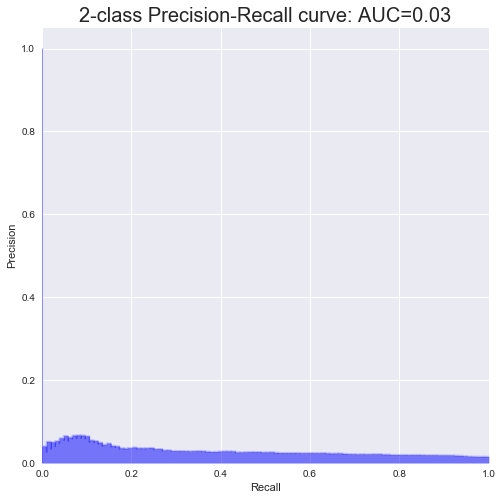

 
Iteration : 29 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 25, [400, 200]]
__________________________________________________________________

Accuracy - Training:  87.29%
Accuracy - test    :  86.42%

AUC Performance
AUC - Training     : 0.8410
AUC - Test         : 0.6585


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.88      0.93     20614
          1       0.06      0.55      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.03      0.25      0.05       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[18082   124]
 [ 2532   151]]


  Confusion Matrix - Test 
[[5992   78]
 [

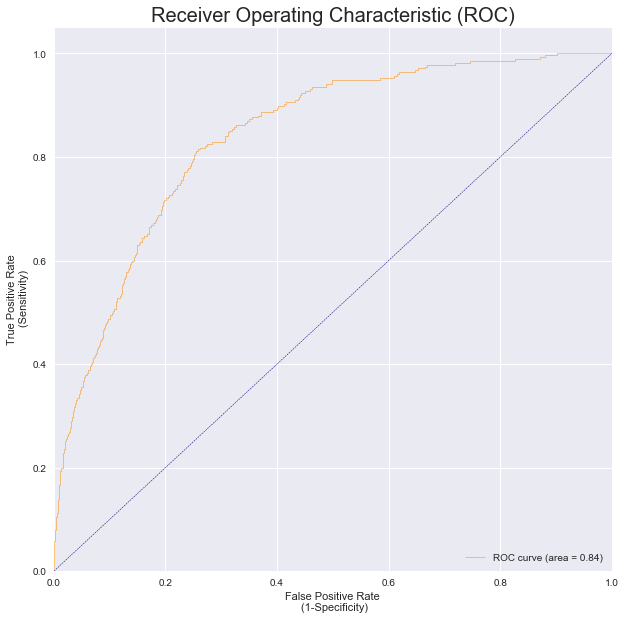


  Test AUC 


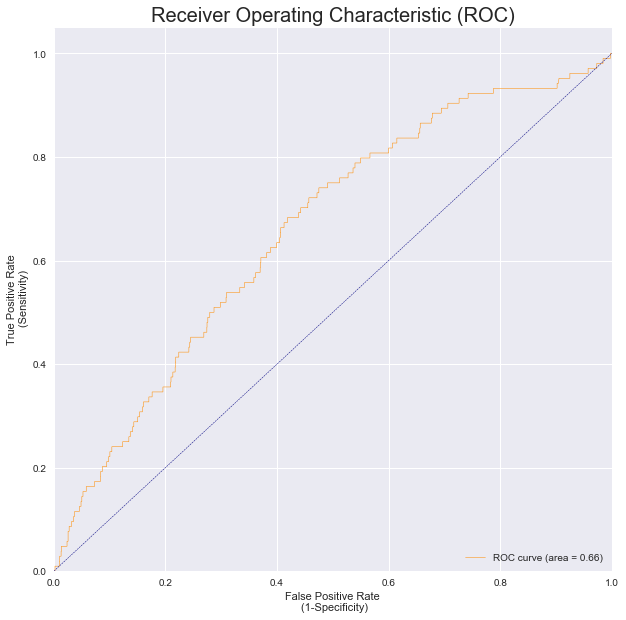


  Train Precission - Recall Curve 
Average precision-recall score: 0.11


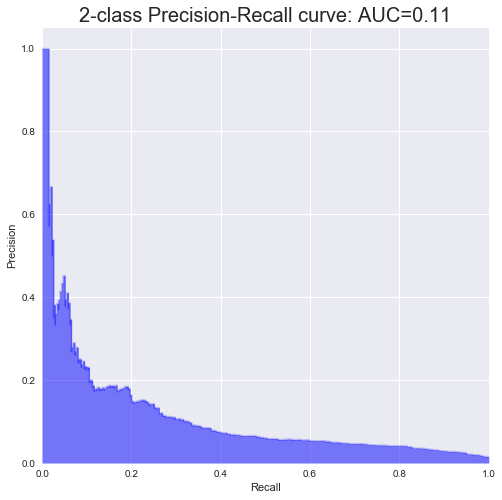


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


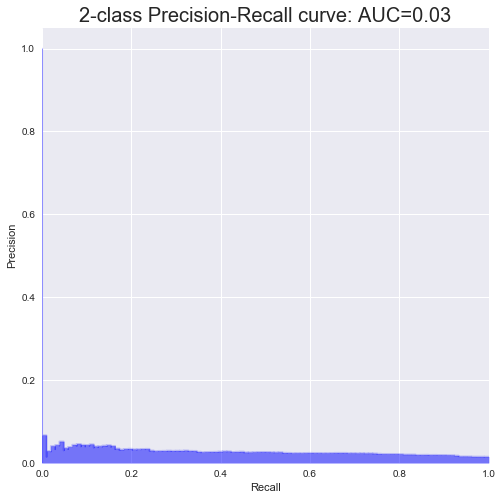

 
Iteration : 30 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 25, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  83.08%
Accuracy - test    :  81.81%

AUC Performance
AUC - Training     : 0.8138
AUC - Test         : 0.6635


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.83      0.91     20614
          1       0.05      0.61      0.09       275

avg / total       0.98      0.83      0.90     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.83      0.90      6860
          1       0.03      0.34      0.05       104

avg / total       0.97      0.82      0.89      6964


  Confusion Matrix - Train 
[[17188   108]
 [ 3426   167]]


  Confusion Matrix - Test 
[[5662   69]
 

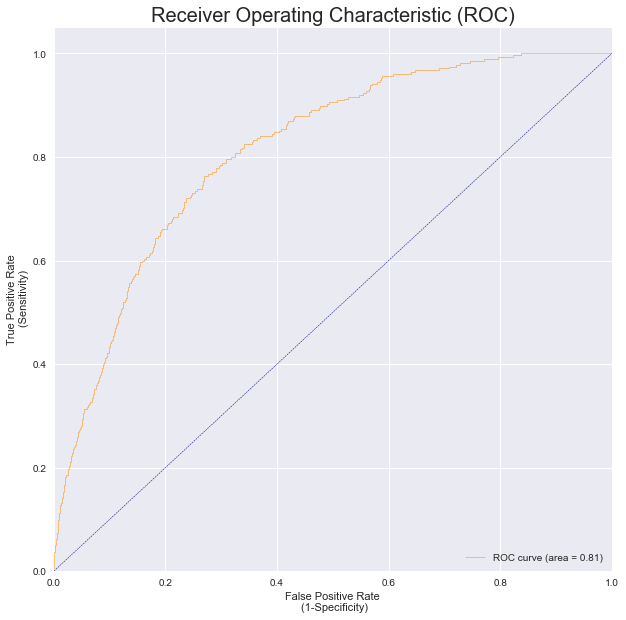


  Test AUC 


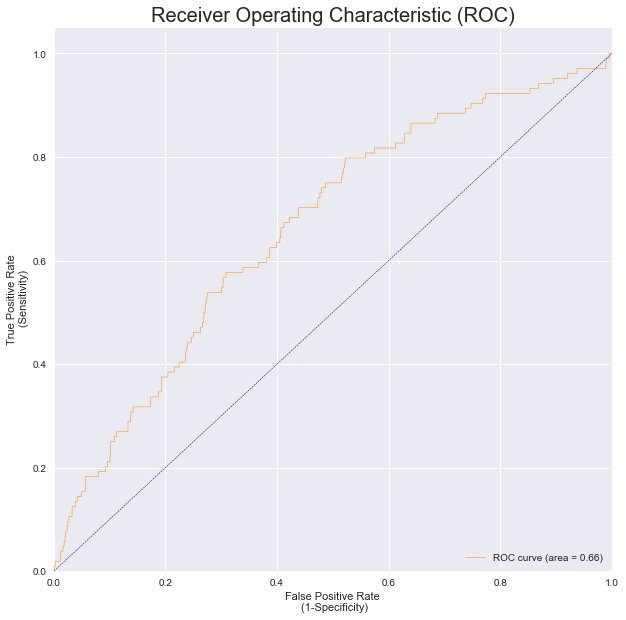


  Train Precission - Recall Curve 
Average precision-recall score: 0.08


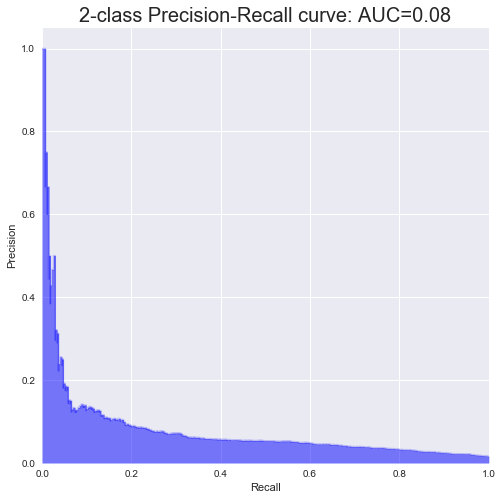


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


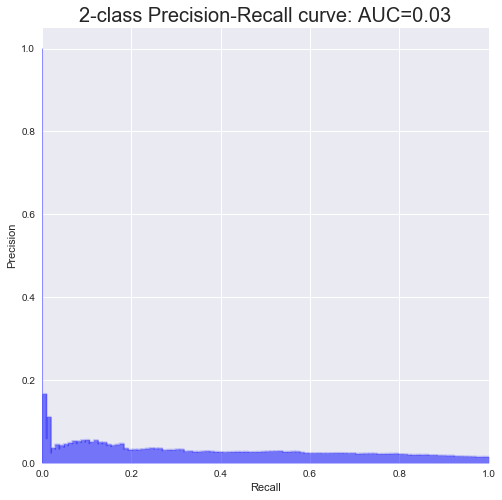

 
Iteration : 31 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 50, [10, 5]]
__________________________________________________________________

Accuracy - Training:  91.43%
Accuracy - test    :  90.64%

AUC Performance
AUC - Training     : 0.8927
AUC - Test         : 0.6568


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95     20614
          1       0.09      0.60      0.16       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95      6860
          1       0.03      0.18      0.06       104

avg / total       0.97      0.91      0.94      6964


  Confusion Matrix - Train 
[[18933   109]
 [ 1681   166]]


  Confusion Matrix - Test 
[[6293   85]
 [ 56

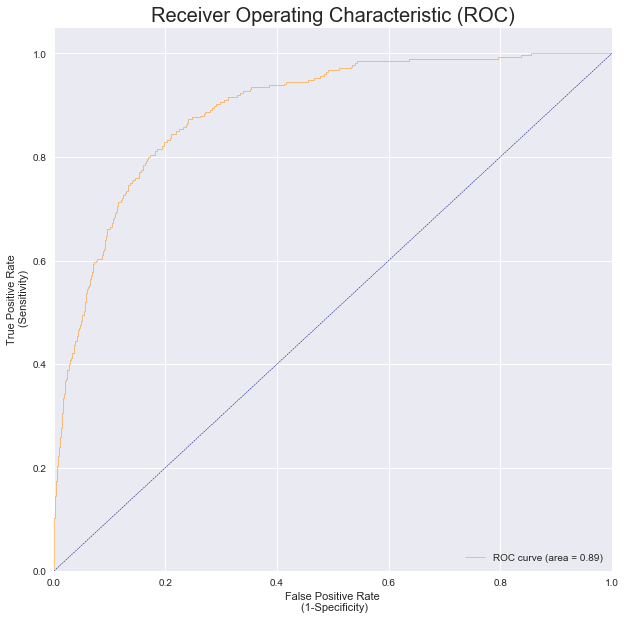


  Test AUC 


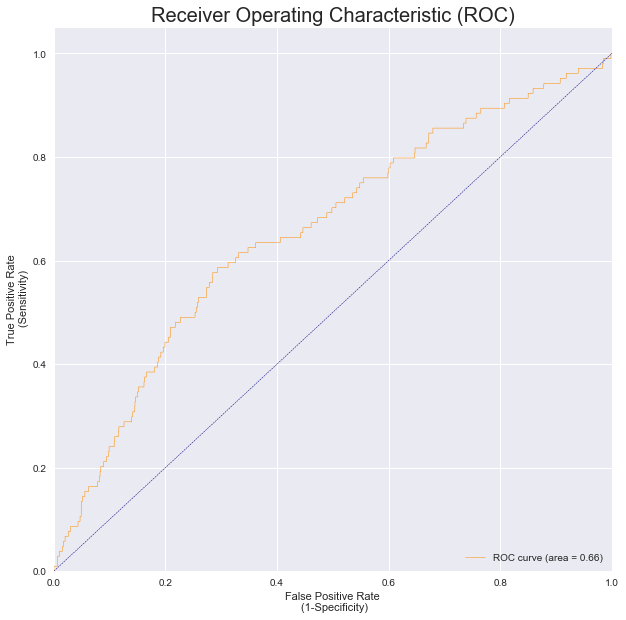


  Train Precission - Recall Curve 
Average precision-recall score: 0.21


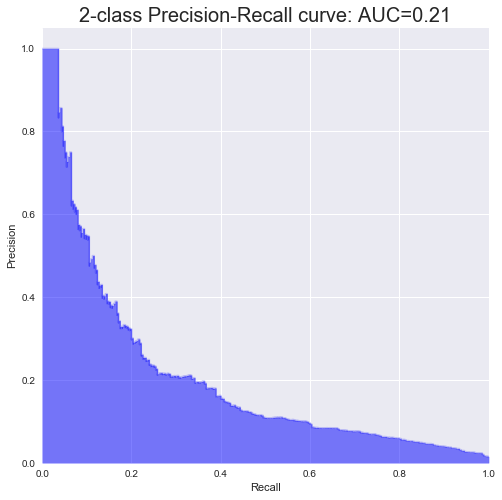


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


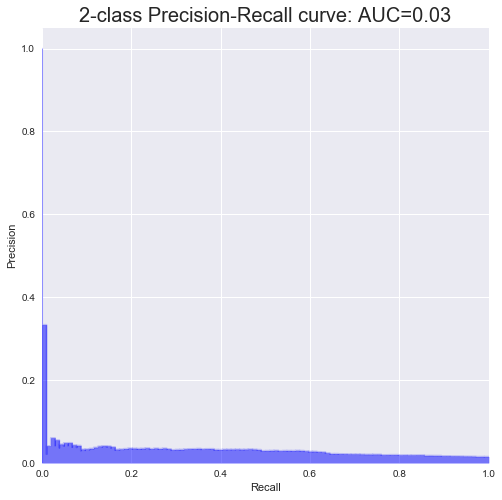

 
Iteration : 32 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 50, [50, 25]]
__________________________________________________________________

Accuracy - Training:  91.31%
Accuracy - test    :  90.32%

AUC Performance
AUC - Training     : 0.8908
AUC - Test         : 0.6609


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95     20614
          1       0.09      0.61      0.16       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95      6860
          1       0.03      0.20      0.06       104

avg / total       0.97      0.90      0.94      6964


  Confusion Matrix - Train 
[[18906   107]
 [ 1708   168]]


  Confusion Matrix - Test 
[[6269   83]
 [ 5

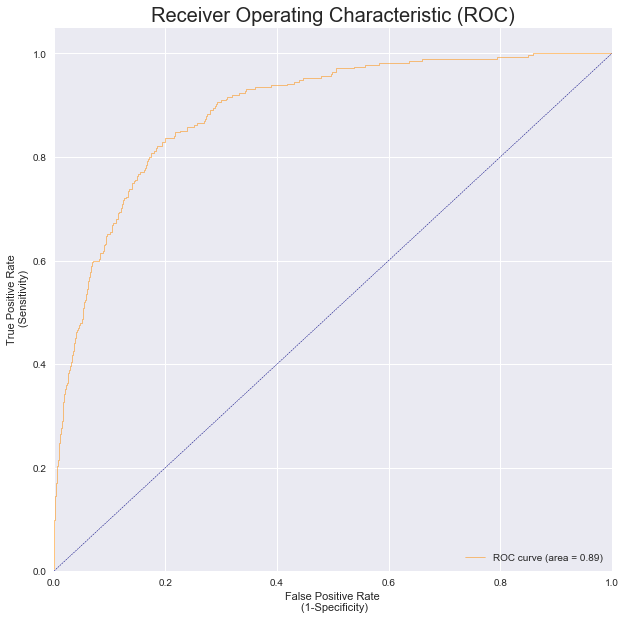


  Test AUC 


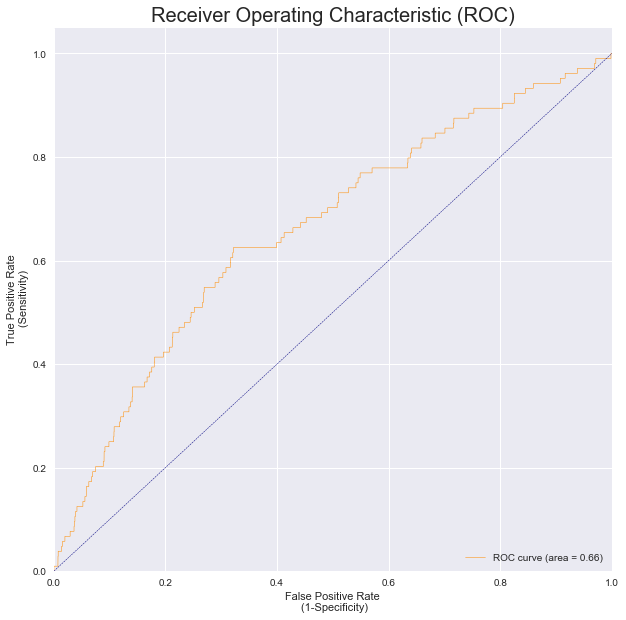


  Train Precission - Recall Curve 
Average precision-recall score: 0.20


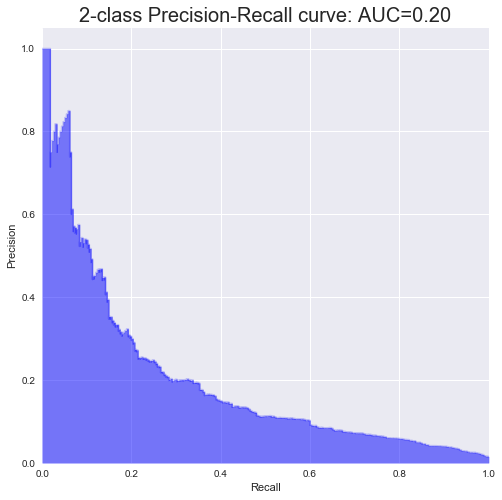


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


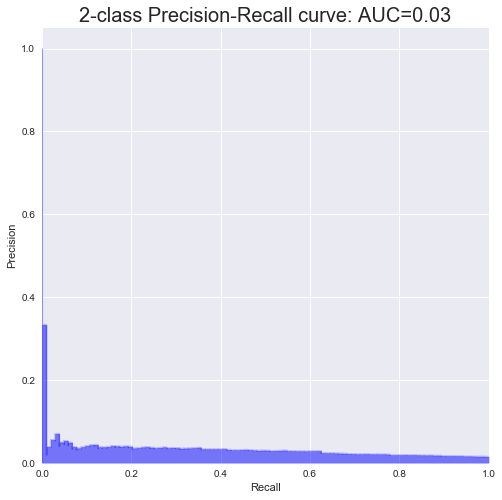

 
Iteration : 33 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 50, [100, 50]]
__________________________________________________________________

Accuracy - Training:  91.18%
Accuracy - test    :  90.38%

AUC Performance
AUC - Training     : 0.8879
AUC - Test         : 0.6541


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95     20614
          1       0.09      0.59      0.15       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95      6860
          1       0.03      0.17      0.05       104

avg / total       0.97      0.90      0.94      6964


  Confusion Matrix - Train 
[[18884   113]
 [ 1730   162]]


  Confusion Matrix - Test 
[[6276   86]
 [ 

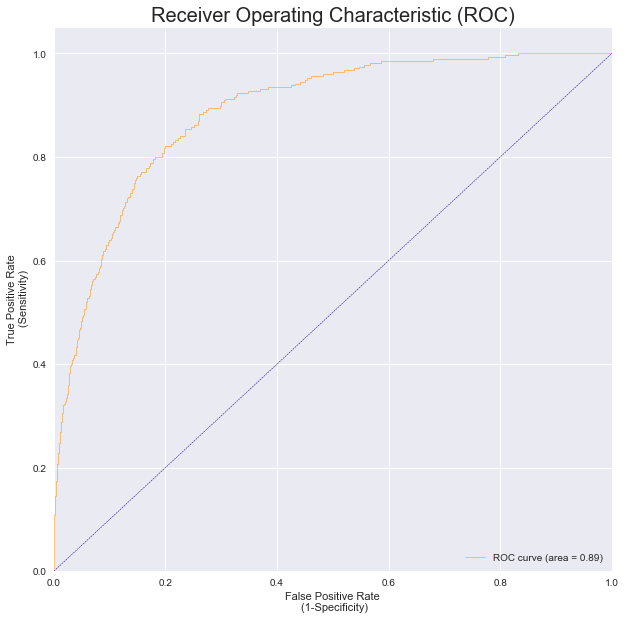


  Test AUC 


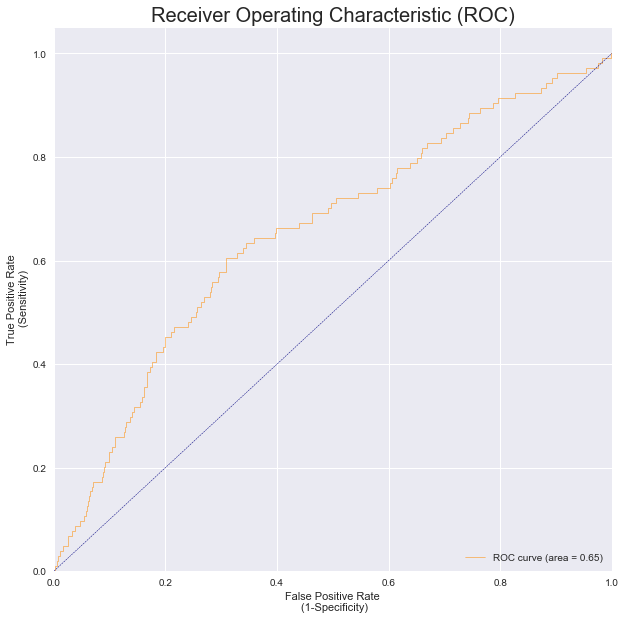


  Train Precission - Recall Curve 
Average precision-recall score: 0.20


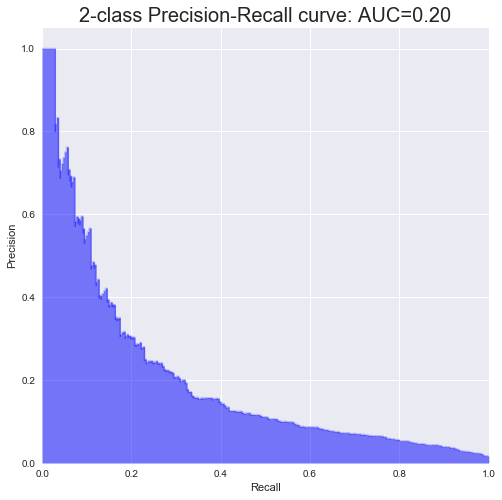


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


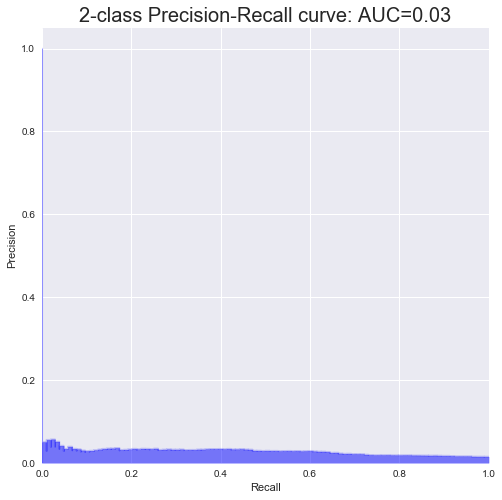

 
Iteration : 34 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 50, [200, 100]]
__________________________________________________________________

Accuracy - Training:  90.39%
Accuracy - test    :  89.56%

AUC Performance
AUC - Training     : 0.8805
AUC - Test         : 0.6635


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95     20614
          1       0.08      0.61      0.14       275

avg / total       0.98      0.90      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.91      0.94      6860
          1       0.04      0.23      0.06       104

avg / total       0.97      0.90      0.93      6964


  Confusion Matrix - Train 
[[18714   108]
 [ 1900   167]]


  Confusion Matrix - Test 
[[6213   80]
 [

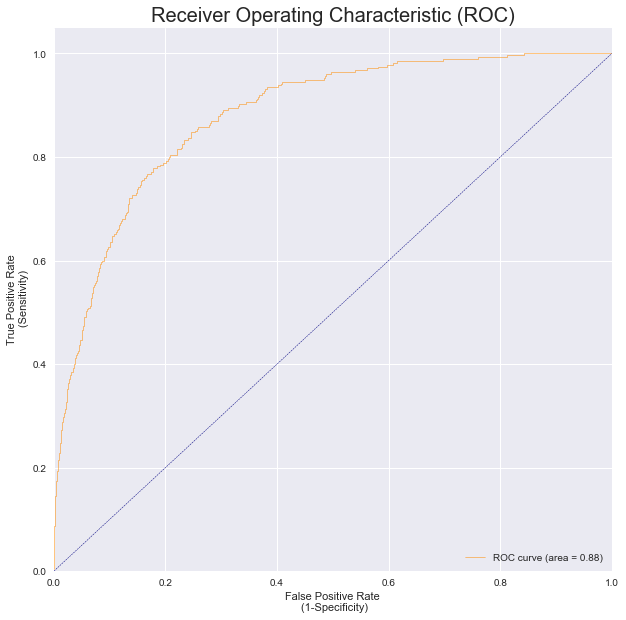


  Test AUC 


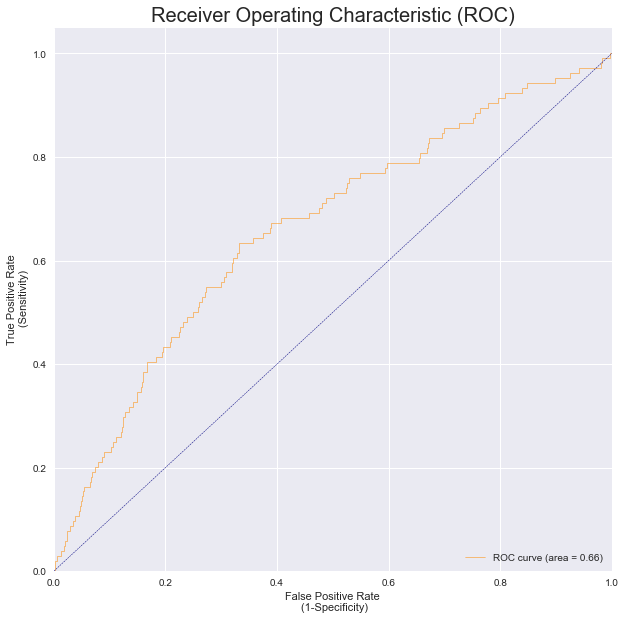


  Train Precission - Recall Curve 
Average precision-recall score: 0.20


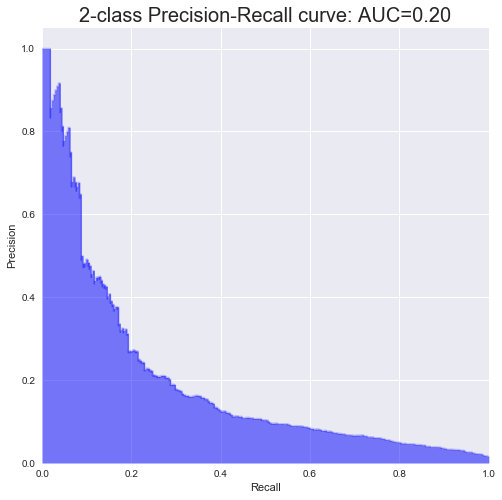


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


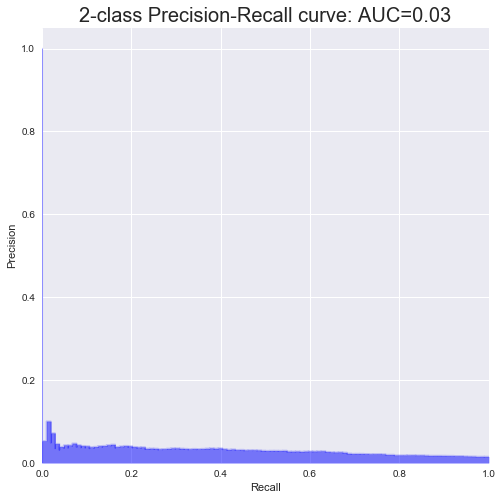

 
Iteration : 35 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 50, [400, 200]]
__________________________________________________________________

Accuracy - Training:  89.33%
Accuracy - test    :  88.56%

AUC Performance
AUC - Training     : 0.8730
AUC - Test         : 0.6703


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.90      0.94     20614
          1       0.07      0.61      0.13       275

avg / total       0.98      0.89      0.93     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.90      0.94      6860
          1       0.03      0.24      0.06       104

avg / total       0.97      0.89      0.93      6964


  Confusion Matrix - Train 
[[18493   107]
 [ 2121   168]]


  Confusion Matrix - Test 
[[6142   79]
 [

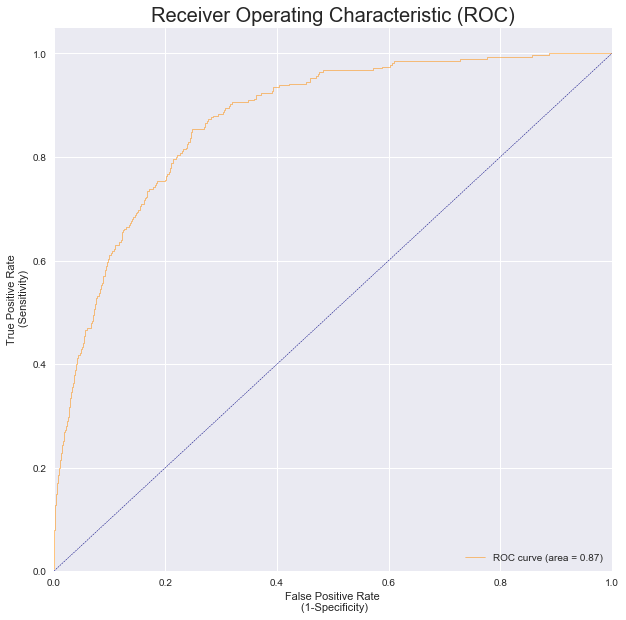


  Test AUC 


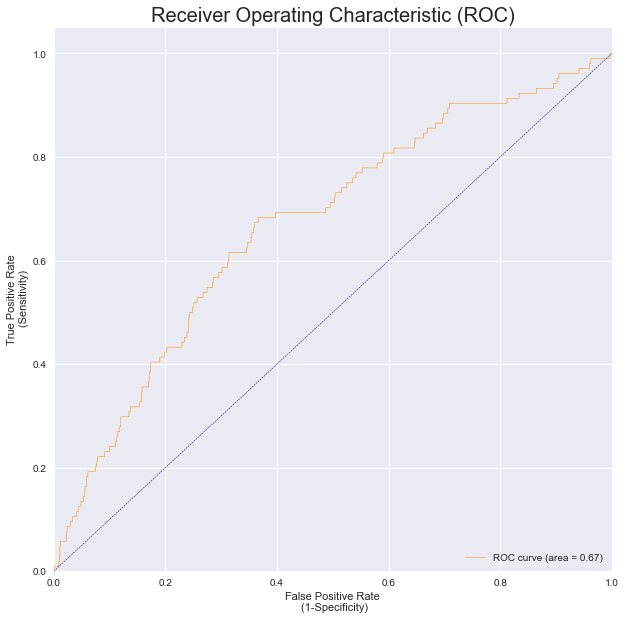


  Train Precission - Recall Curve 
Average precision-recall score: 0.16


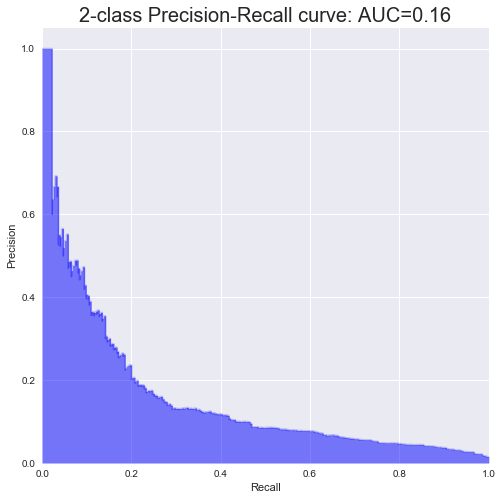


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


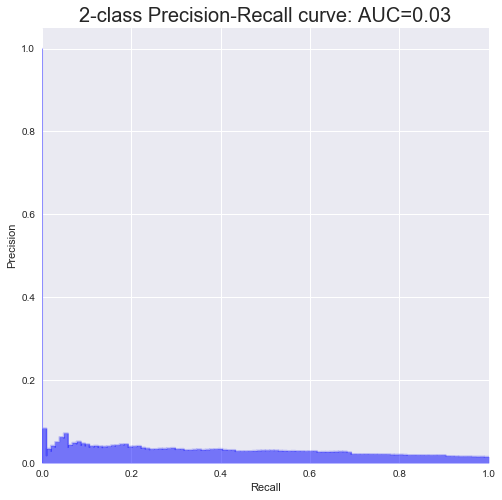

 
Iteration : 36 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 50, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  84.36%
Accuracy - test    :  83.47%

AUC Performance
AUC - Training     : 0.8357
AUC - Test         : 0.6743


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.85      0.91     20614
          1       0.05      0.61      0.09       275

avg / total       0.98      0.84      0.90     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.84      0.91      6860
          1       0.03      0.34      0.06       104

avg / total       0.97      0.83      0.90      6964


  Confusion Matrix - Train 
[[17454   106]
 [ 3160   169]]


  Confusion Matrix - Test 
[[5778   69]
 

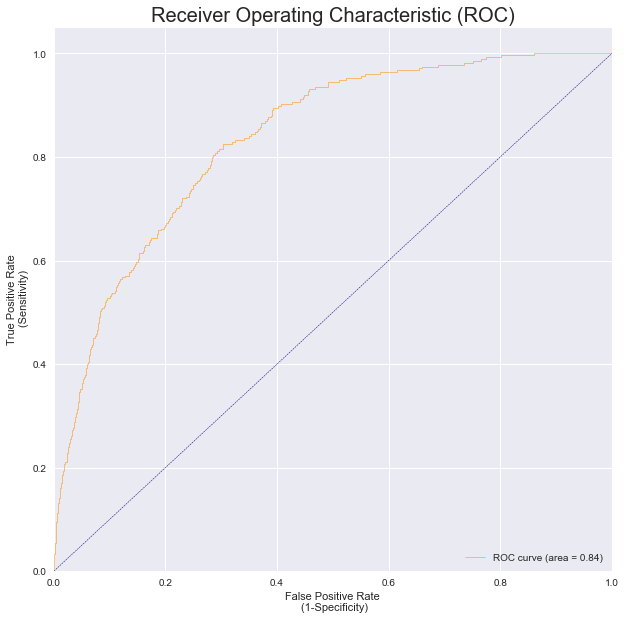


  Test AUC 


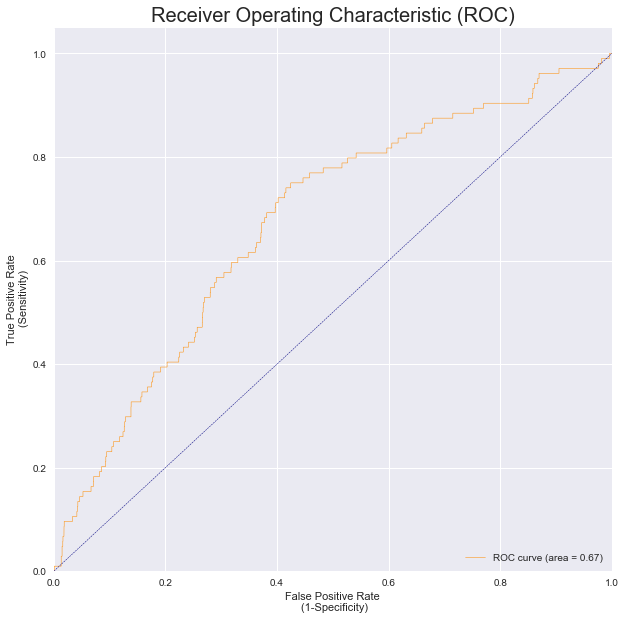


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


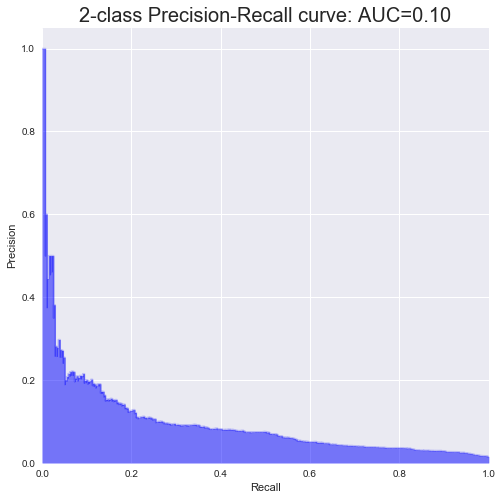


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


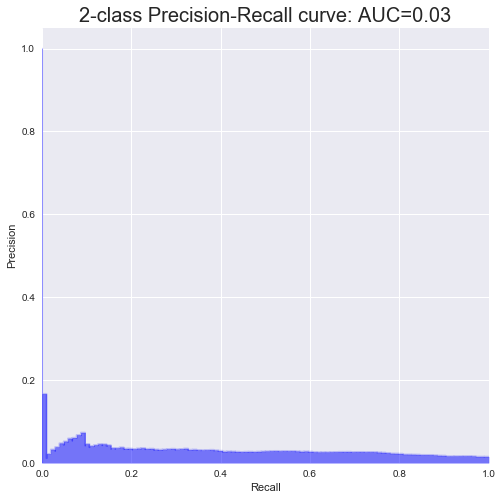

 
Iteration : 37 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 100, [10, 5]]
__________________________________________________________________

Accuracy - Training:  91.21%
Accuracy - test    :  90.44%

AUC Performance
AUC - Training     : 0.8928
AUC - Test         : 0.6629


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95     20614
          1       0.09      0.62      0.16       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95      6860
          1       0.04      0.24      0.07       104

avg / total       0.97      0.90      0.94      6964


  Confusion Matrix - Train 
[[18882   104]
 [ 1732   171]]


  Confusion Matrix - Test 
[[6273   79]
 [ 5

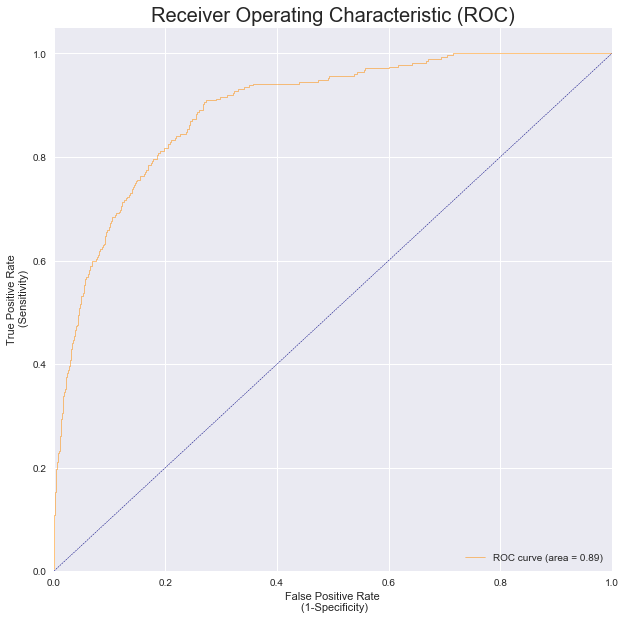


  Test AUC 


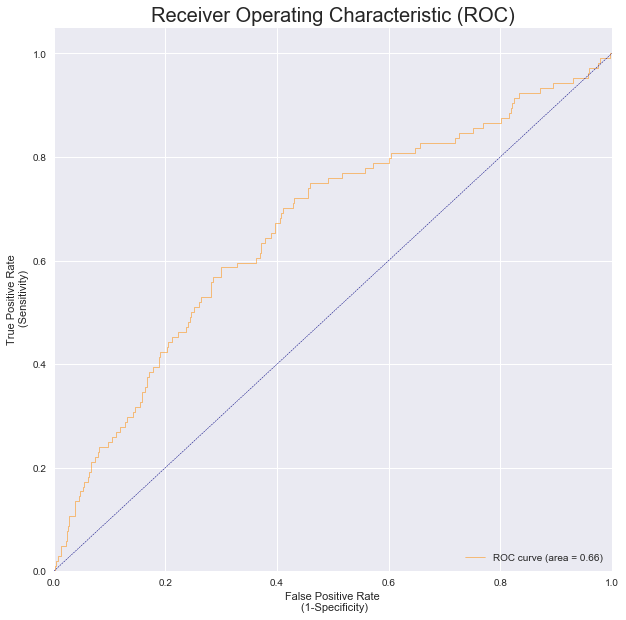


  Train Precission - Recall Curve 
Average precision-recall score: 0.23


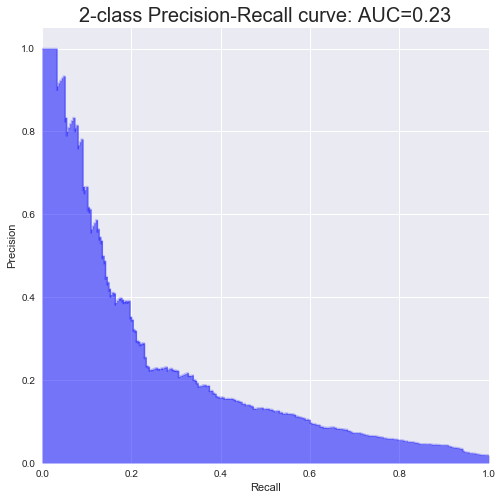


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


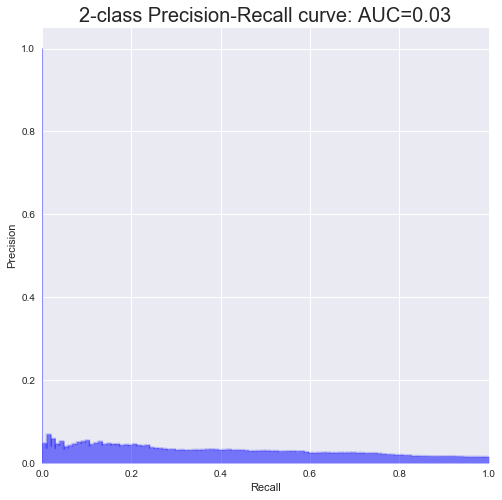

 
Iteration : 38 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 100, [50, 25]]
__________________________________________________________________

Accuracy - Training:  91.13%
Accuracy - test    :  90.28%

AUC Performance
AUC - Training     : 0.8909
AUC - Test         : 0.6635


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95     20614
          1       0.09      0.62      0.16       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95      6860
          1       0.04      0.23      0.07       104

avg / total       0.97      0.90      0.94      6964


  Confusion Matrix - Train 
[[18867   105]
 [ 1747   170]]


  Confusion Matrix - Test 
[[6263   80]
 [ 

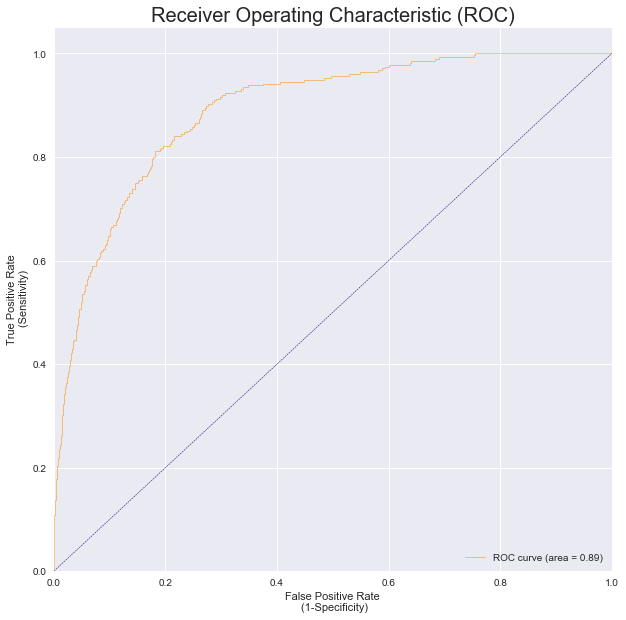


  Test AUC 


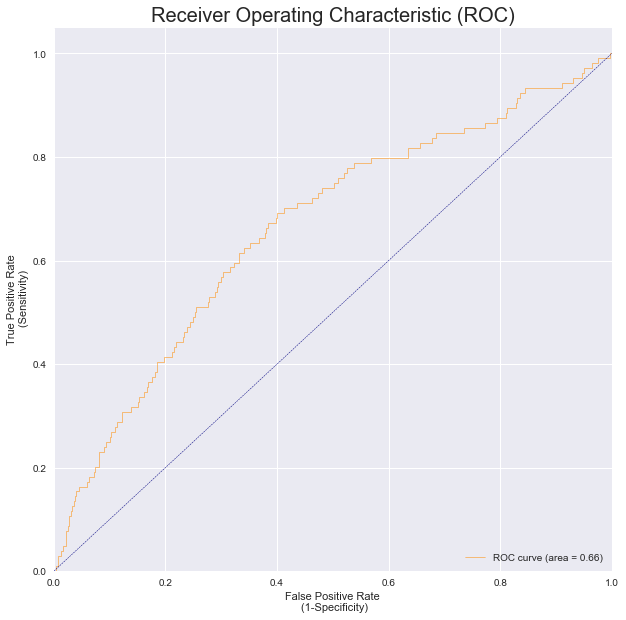


  Train Precission - Recall Curve 
Average precision-recall score: 0.21


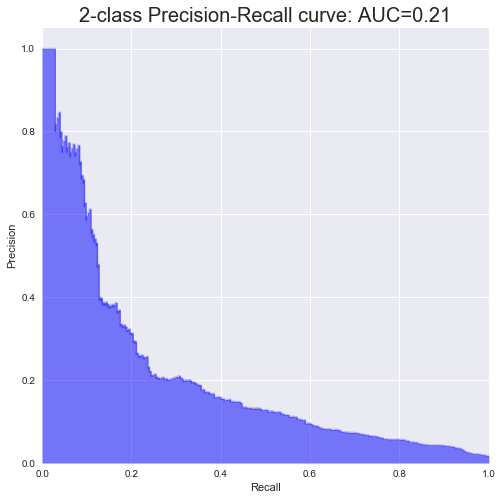


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


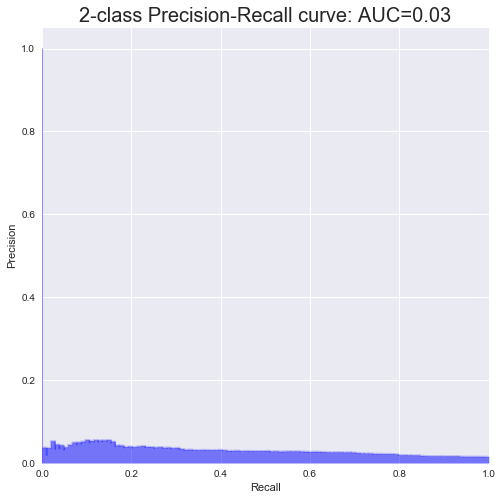

 
Iteration : 39 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 100, [100, 50]]
__________________________________________________________________

Accuracy - Training:  90.64%
Accuracy - test    :  89.93%

AUC Performance
AUC - Training     : 0.8872
AUC - Test         : 0.6670


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95     20614
          1       0.08      0.61      0.15       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95      6860
          1       0.04      0.24      0.07       104

avg / total       0.97      0.90      0.93      6964


  Confusion Matrix - Train 
[[18765   106]
 [ 1849   169]]


  Confusion Matrix - Test 
[[6238   79]
 [

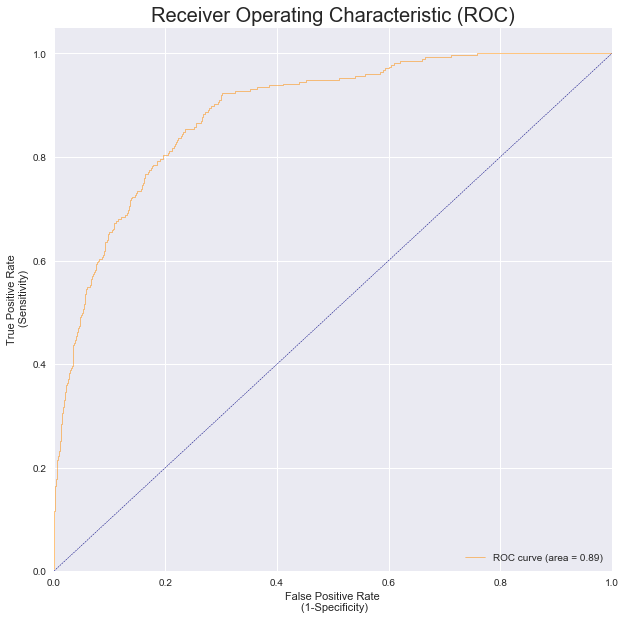


  Test AUC 


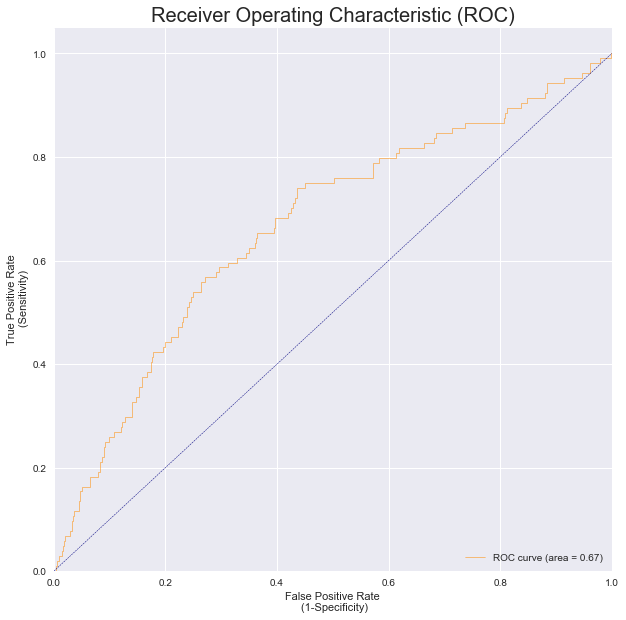


  Train Precission - Recall Curve 
Average precision-recall score: 0.21


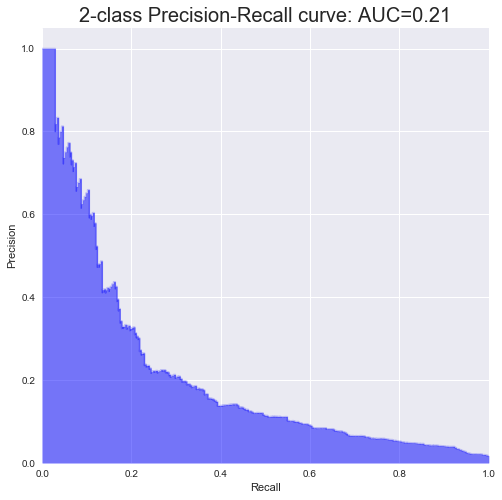


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


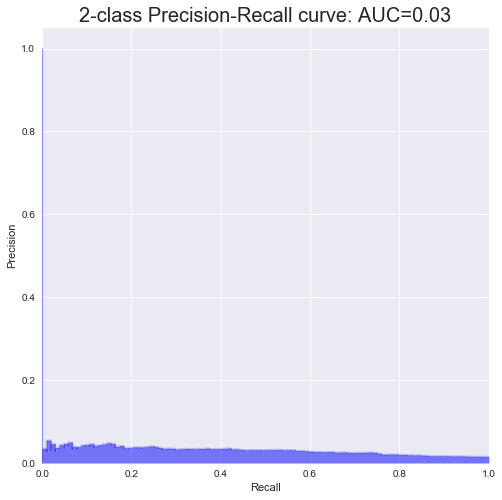

 
Iteration : 40 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 100, [200, 100]]
__________________________________________________________________

Accuracy - Training:  89.78%
Accuracy - test    :  89.04%

AUC Performance
AUC - Training     : 0.8799
AUC - Test         : 0.6679


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.90      0.95     20614
          1       0.08      0.62      0.14       275

avg / total       0.98      0.90      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.90      0.94      6860
          1       0.04      0.24      0.06       104

avg / total       0.97      0.89      0.93      6964


  Confusion Matrix - Train 
[[18585   105]
 [ 2029   170]]


  Confusion Matrix - Test 
[[6176   79]
 

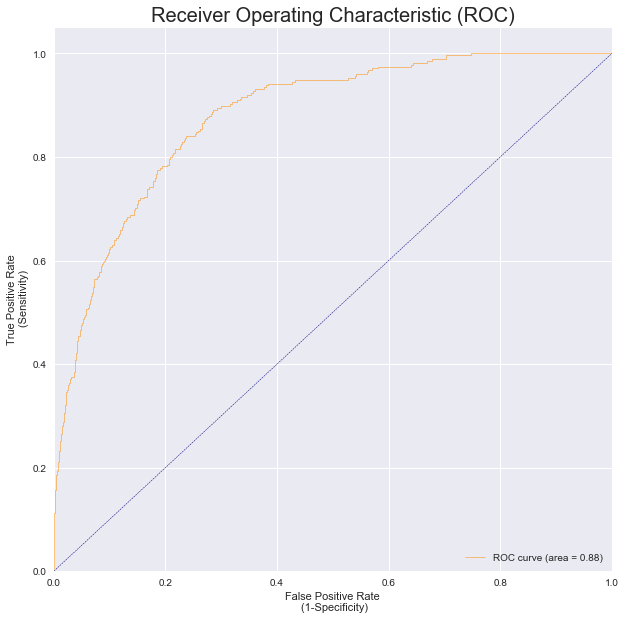


  Test AUC 


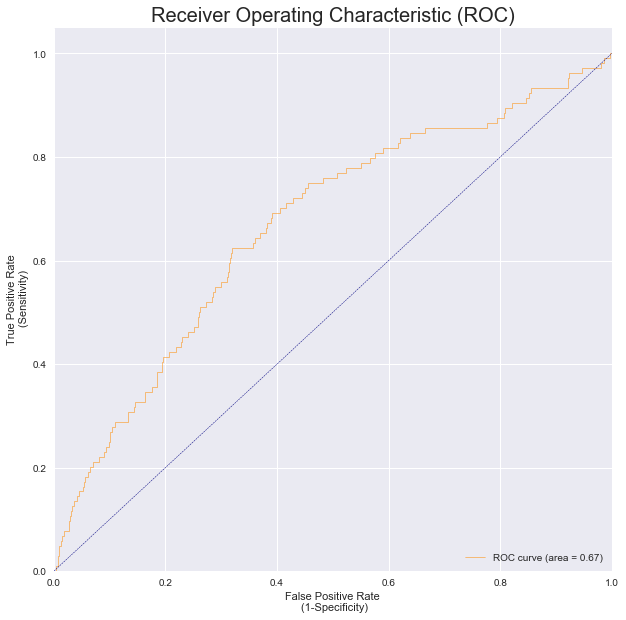


  Train Precission - Recall Curve 
Average precision-recall score: 0.20


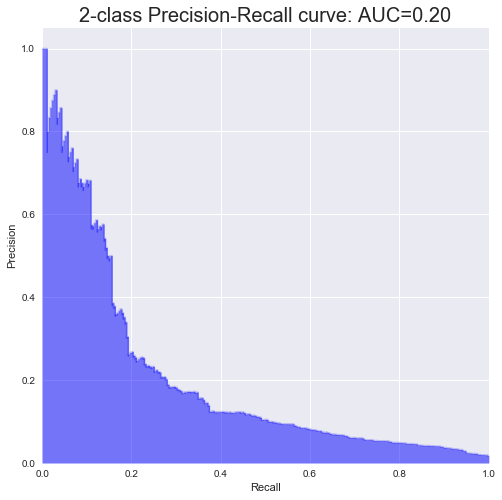


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


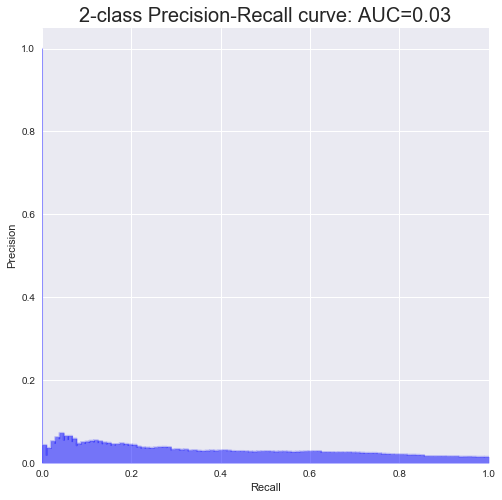

 
Iteration : 41 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 100, [400, 200]]
__________________________________________________________________

Accuracy - Training:  88.49%
Accuracy - test    :  87.89%

AUC Performance
AUC - Training     : 0.8690
AUC - Test         : 0.6755


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.89      0.94     20614
          1       0.07      0.61      0.12       275

avg / total       0.98      0.88      0.93     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.89      0.94      6860
          1       0.03      0.25      0.06       104

avg / total       0.97      0.88      0.92      6964


  Confusion Matrix - Train 
[[18318   108]
 [ 2296   167]]


  Confusion Matrix - Test 
[[6095   78]
 

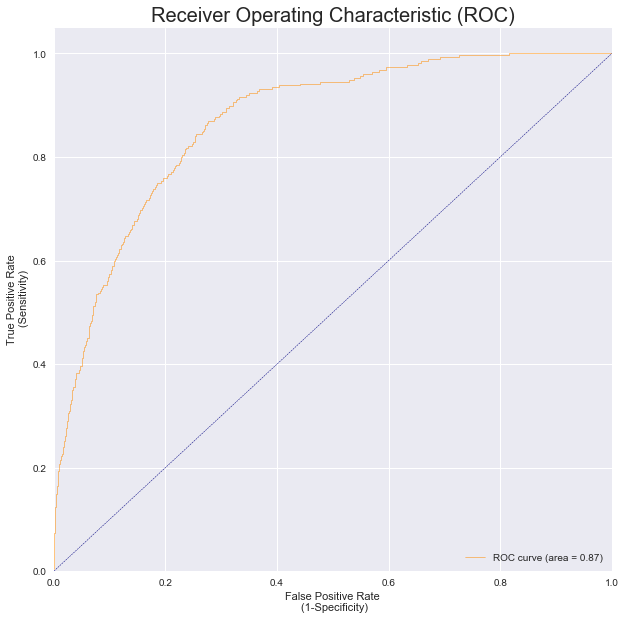


  Test AUC 


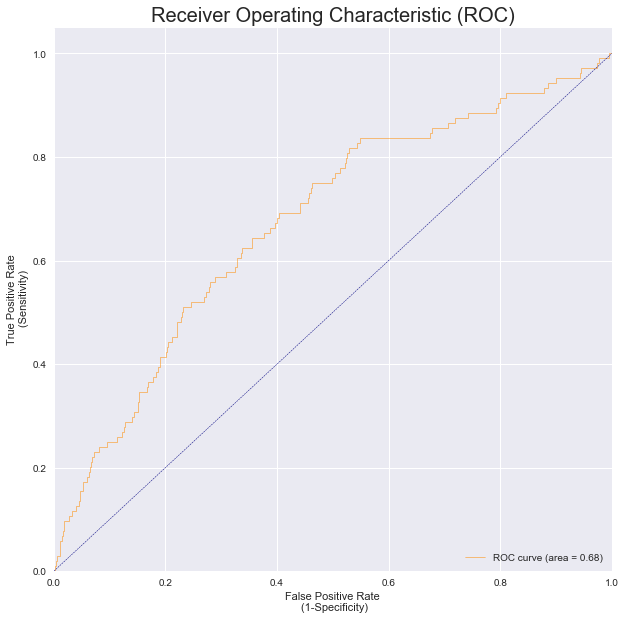


  Train Precission - Recall Curve 
Average precision-recall score: 0.16


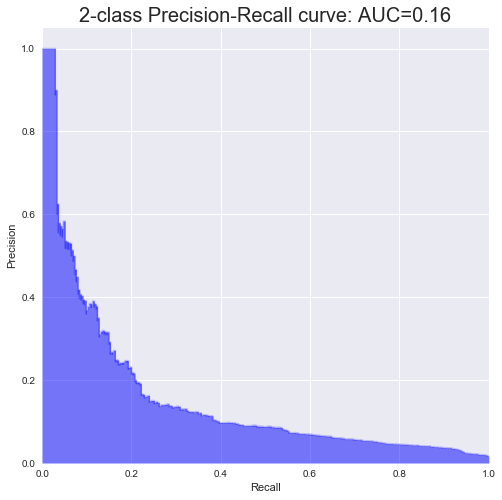


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


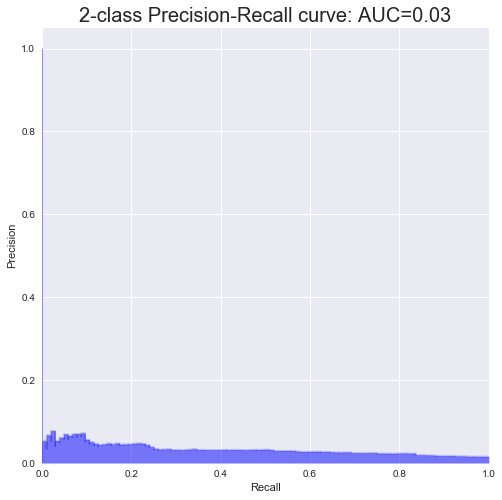

 
Iteration : 42 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 100, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  84.85%
Accuracy - test    :  84.06%

AUC Performance
AUC - Training     : 0.8391
AUC - Test         : 0.6745


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.85      0.92     20614
          1       0.05      0.62      0.10       275

avg / total       0.98      0.85      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.85      0.91      6860
          1       0.03      0.36      0.06       104

avg / total       0.97      0.84      0.90      6964


  Confusion Matrix - Train 
[[17554   105]
 [ 3060   170]]


  Confusion Matrix - Test 
[[5817   67]


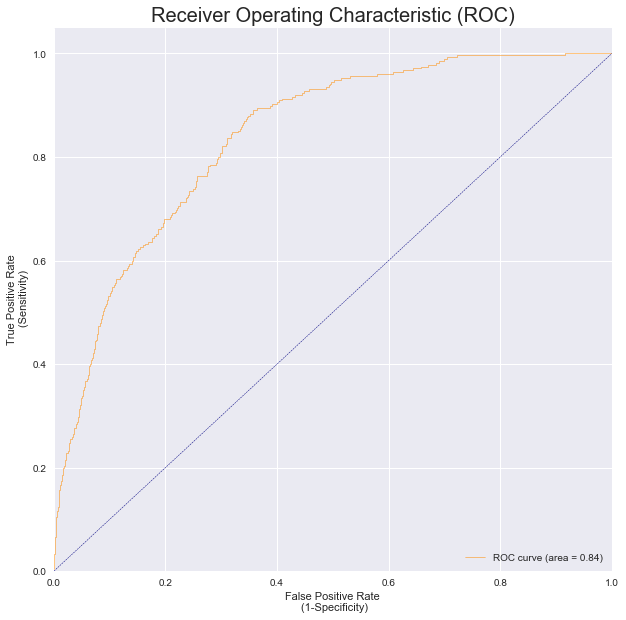


  Test AUC 


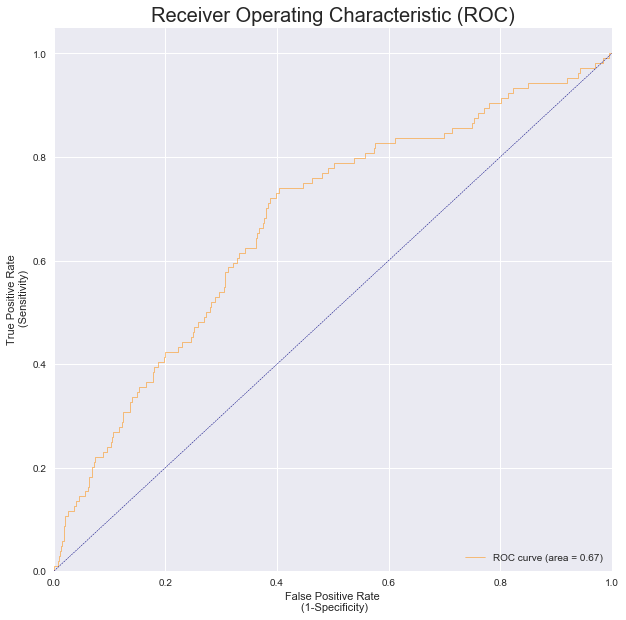


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


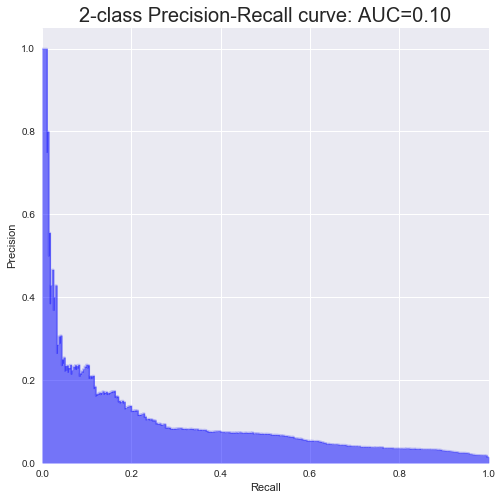


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


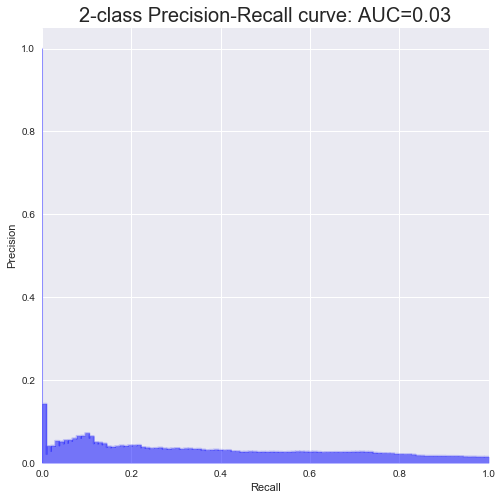

 
Iteration : 43 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 200, [10, 5]]
__________________________________________________________________

Accuracy - Training:  91.62%
Accuracy - test    :  91.27%

AUC Performance
AUC - Training     : 0.8978
AUC - Test         : 0.6688


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.96     20614
          1       0.09      0.61      0.16       275

avg / total       0.98      0.92      0.95     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95      6860
          1       0.04      0.23      0.07       104

avg / total       0.97      0.91      0.94      6964


  Confusion Matrix - Train 
[[18969   106]
 [ 1645   169]]


  Confusion Matrix - Test 
[[6332   80]
 [ 5

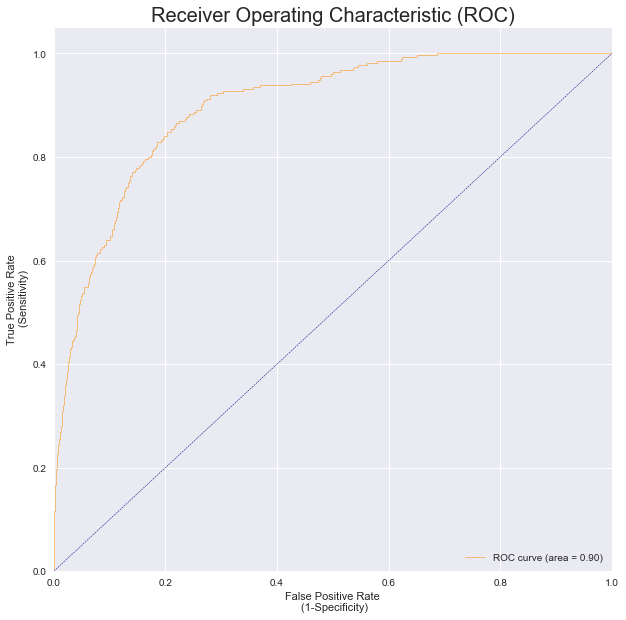


  Test AUC 


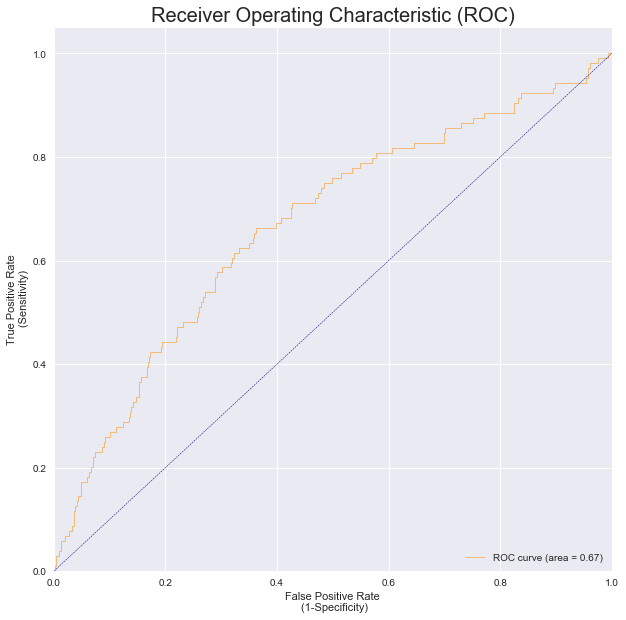


  Train Precission - Recall Curve 
Average precision-recall score: 0.23


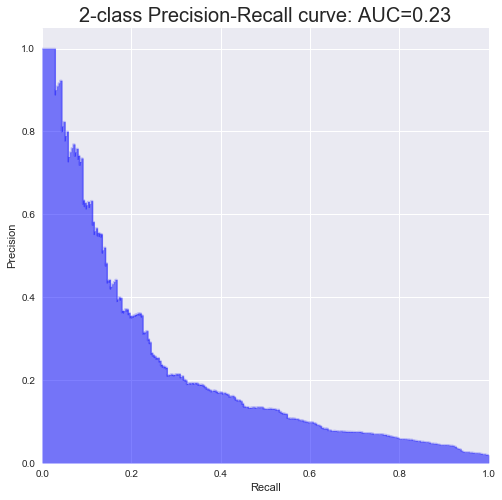


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


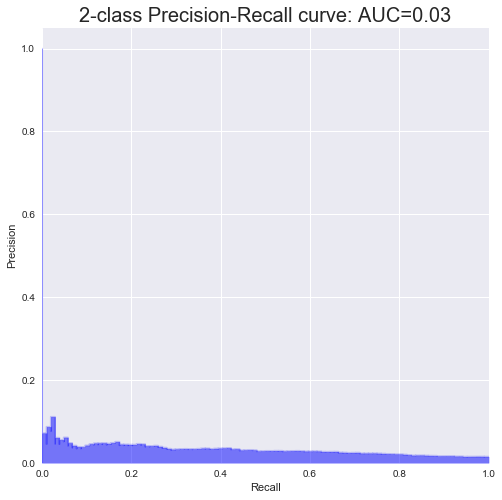

 
Iteration : 44 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 200, [50, 25]]
__________________________________________________________________

Accuracy - Training:  91.51%
Accuracy - test    :  91.01%

AUC Performance
AUC - Training     : 0.8960
AUC - Test         : 0.6710


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.96     20614
          1       0.09      0.61      0.16       275

avg / total       0.98      0.92      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95      6860
          1       0.04      0.23      0.07       104

avg / total       0.97      0.91      0.94      6964


  Confusion Matrix - Train 
[[18947   107]
 [ 1667   168]]


  Confusion Matrix - Test 
[[6314   80]
 [ 

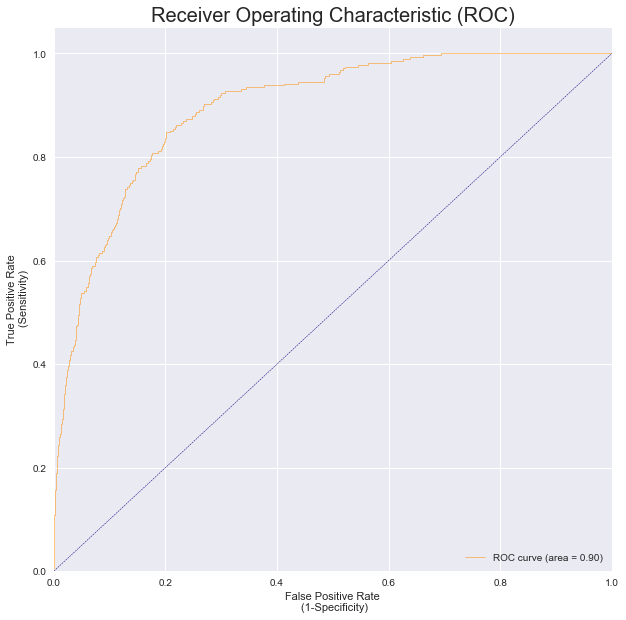


  Test AUC 


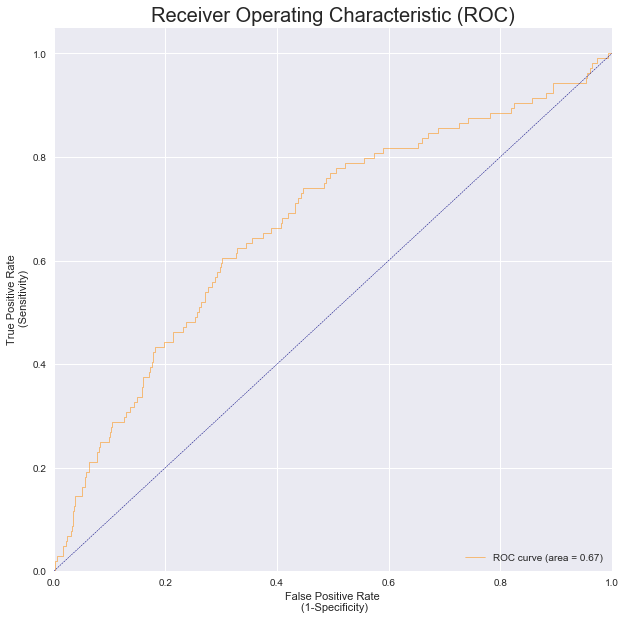


  Train Precission - Recall Curve 
Average precision-recall score: 0.22


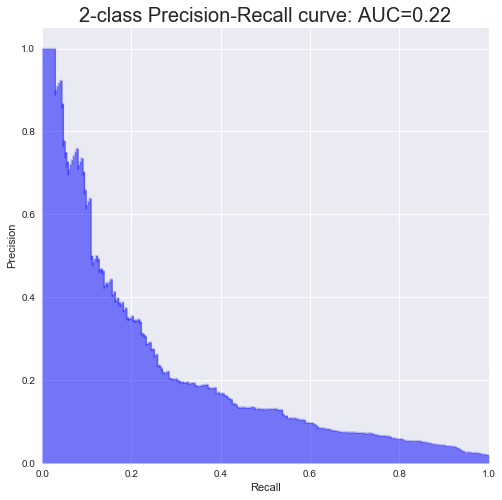


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


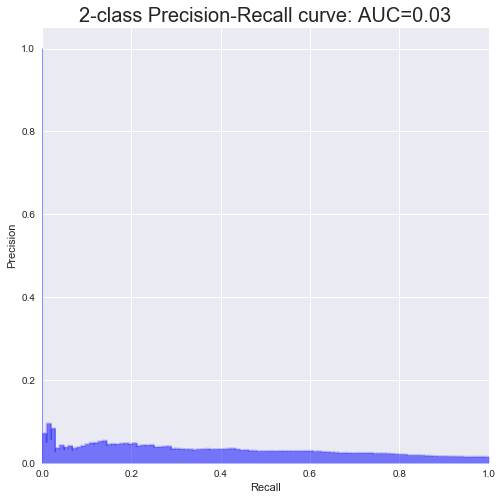

 
Iteration : 45 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 200, [100, 50]]
__________________________________________________________________

Accuracy - Training:  91.08%
Accuracy - test    :  90.58%

AUC Performance
AUC - Training     : 0.8935
AUC - Test         : 0.6738


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95     20614
          1       0.09      0.60      0.15       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95      6860
          1       0.04      0.24      0.07       104

avg / total       0.97      0.91      0.94      6964


  Confusion Matrix - Train 
[[18860   109]
 [ 1754   166]]


  Confusion Matrix - Test 
[[6283   79]
 [

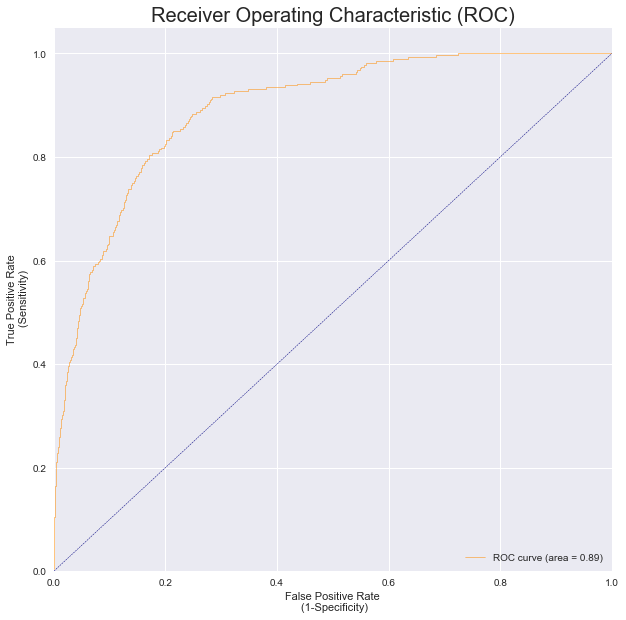


  Test AUC 


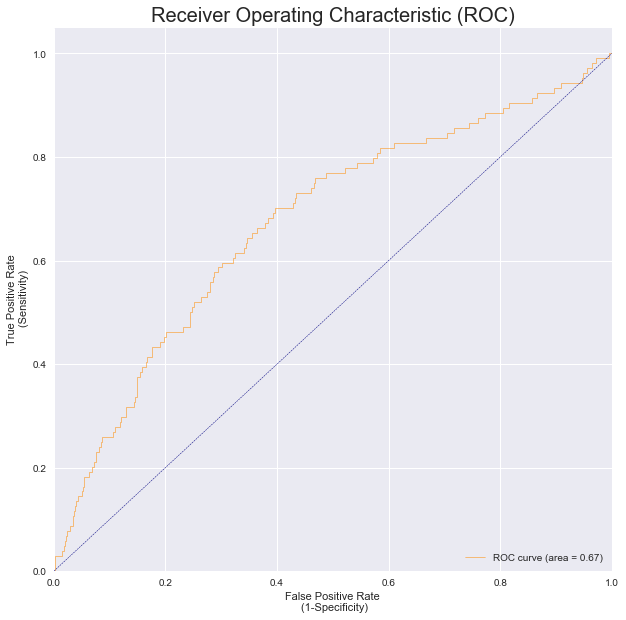


  Train Precission - Recall Curve 
Average precision-recall score: 0.22


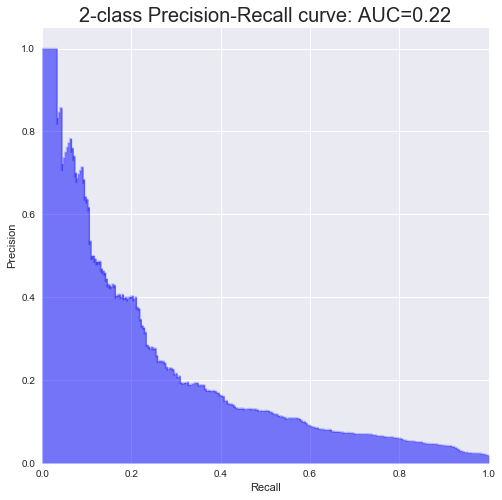


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


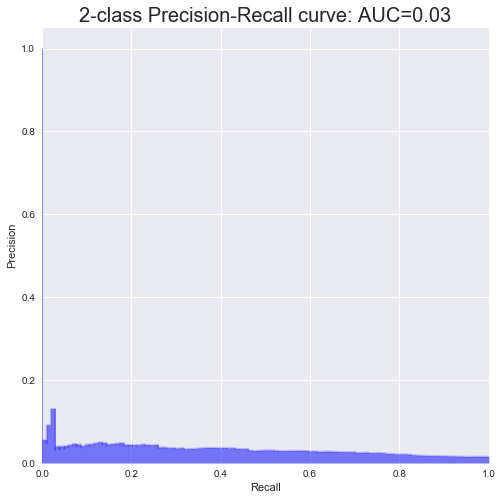

 
Iteration : 46 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 200, [200, 100]]
__________________________________________________________________

Accuracy - Training:  90.19%
Accuracy - test    :  89.69%

AUC Performance
AUC - Training     : 0.8852
AUC - Test         : 0.6717


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95     20614
          1       0.08      0.60      0.14       275

avg / total       0.98      0.90      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.91      0.95      6860
          1       0.04      0.26      0.07       104

avg / total       0.97      0.90      0.93      6964


  Confusion Matrix - Train 
[[18675   110]
 [ 1939   165]]


  Confusion Matrix - Test 
[[6219   77]
 

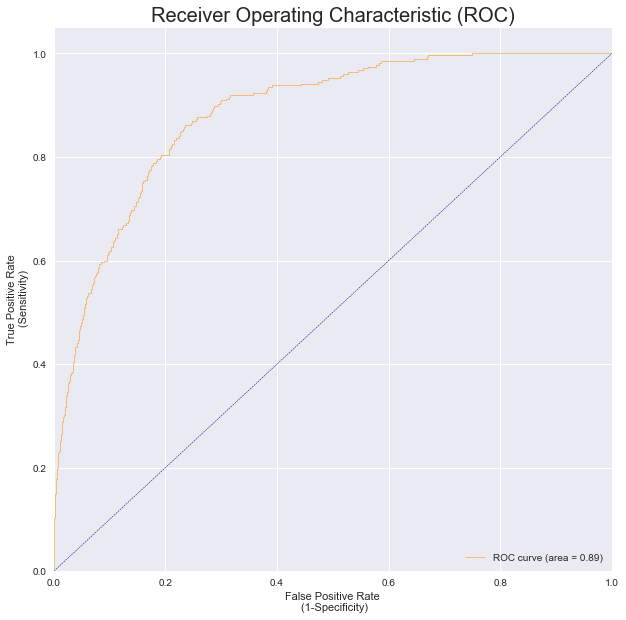


  Test AUC 


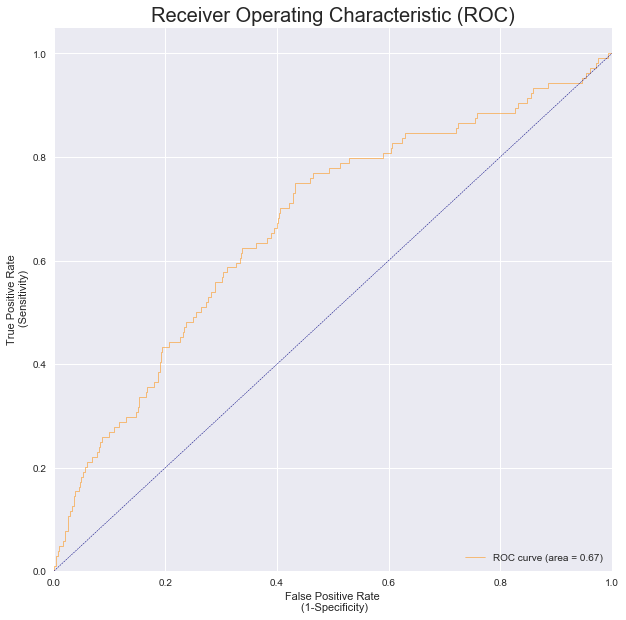


  Train Precission - Recall Curve 
Average precision-recall score: 0.20


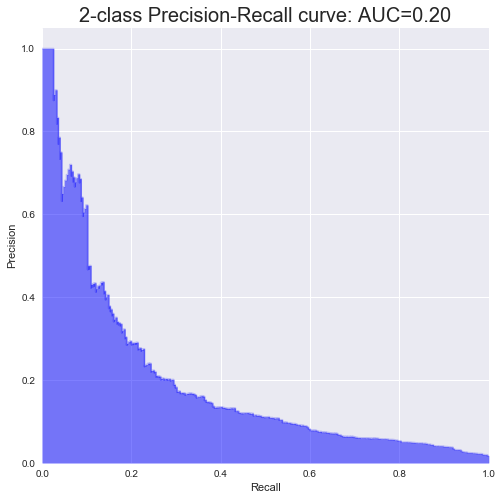


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


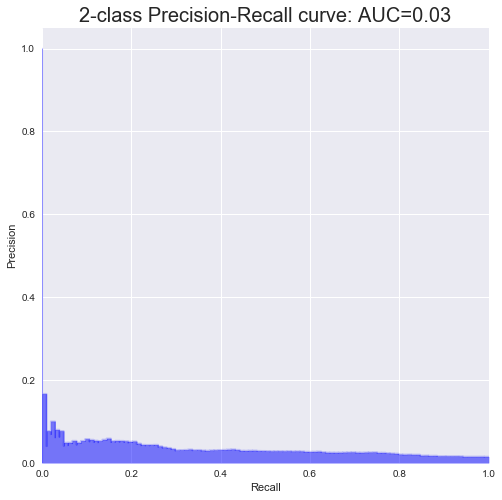

 
Iteration : 47 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 200, [400, 200]]
__________________________________________________________________

Accuracy - Training:  89.05%
Accuracy - test    :  88.64%

AUC Performance
AUC - Training     : 0.8752
AUC - Test         : 0.6754


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.89      0.94     20614
          1       0.07      0.59      0.12       275

avg / total       0.98      0.89      0.93     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.90      0.94      6860
          1       0.04      0.26      0.06       104

avg / total       0.97      0.89      0.93      6964


  Confusion Matrix - Train 
[[18438   112]
 [ 2176   163]]


  Confusion Matrix - Test 
[[6146   77]
 

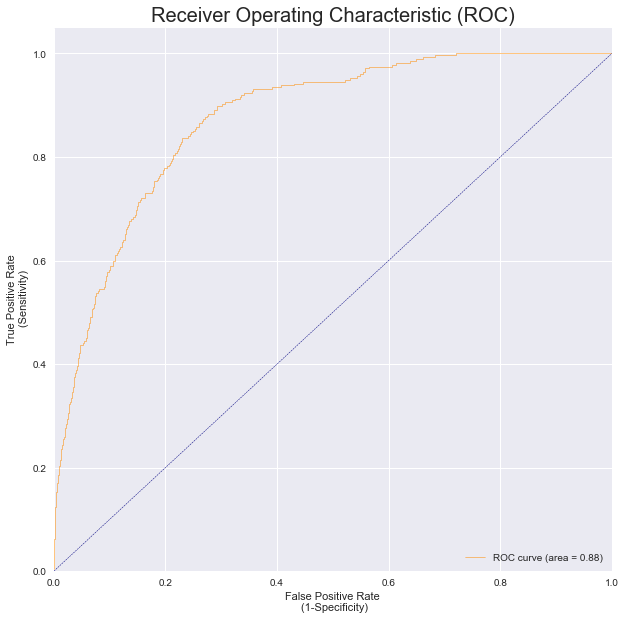


  Test AUC 


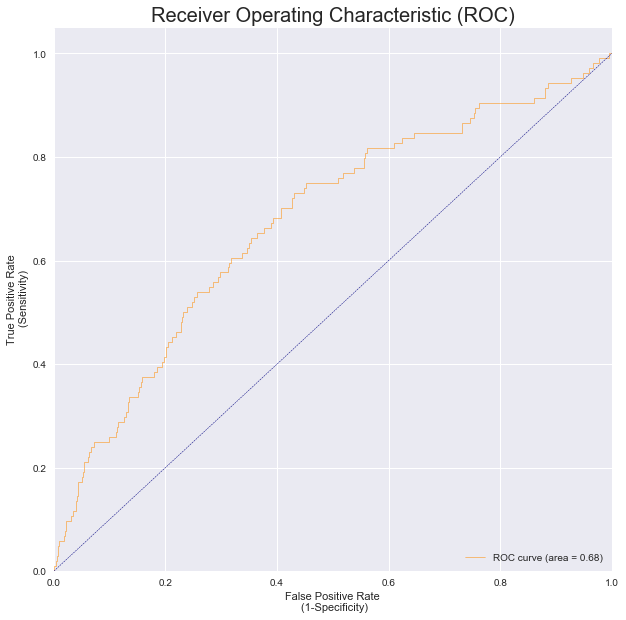


  Train Precission - Recall Curve 
Average precision-recall score: 0.16


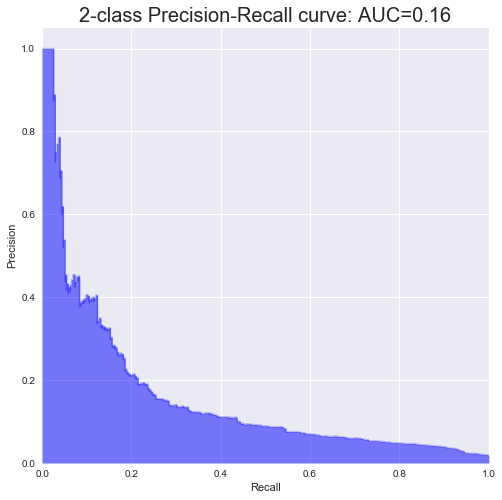


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


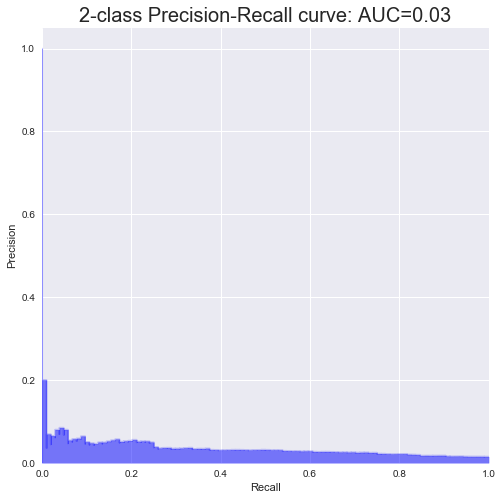

 
Iteration : 48 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [4, 200, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  85.33%
Accuracy - test    :  84.62%

AUC Performance
AUC - Training     : 0.8430
AUC - Test         : 0.6719


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.05      0.61      0.10       275

avg / total       0.98      0.85      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.85      0.92      6860
          1       0.03      0.34      0.06       104

avg / total       0.97      0.85      0.90      6964


  Confusion Matrix - Train 
[[17655   106]
 [ 2959   169]]


  Confusion Matrix - Test 
[[5858   69]


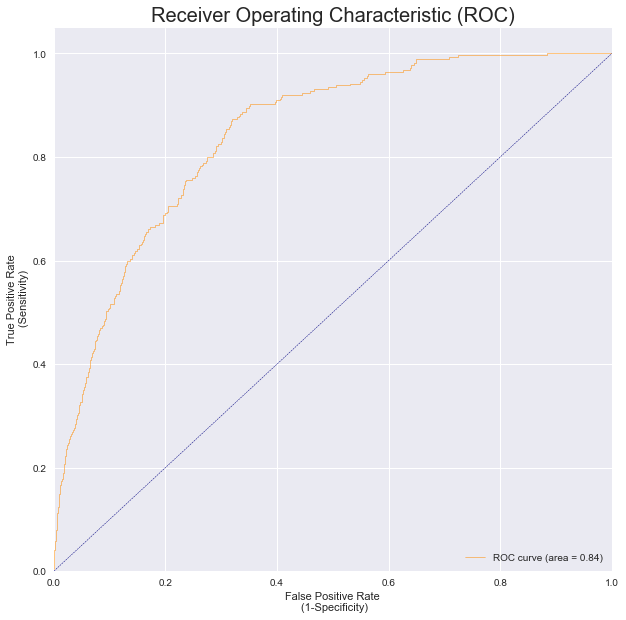


  Test AUC 


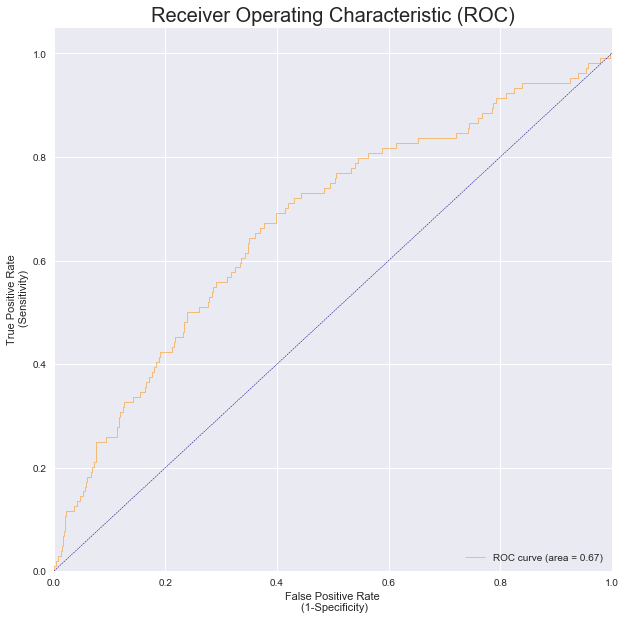


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


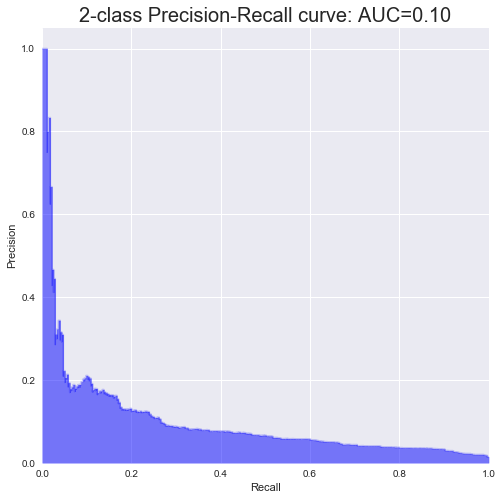


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


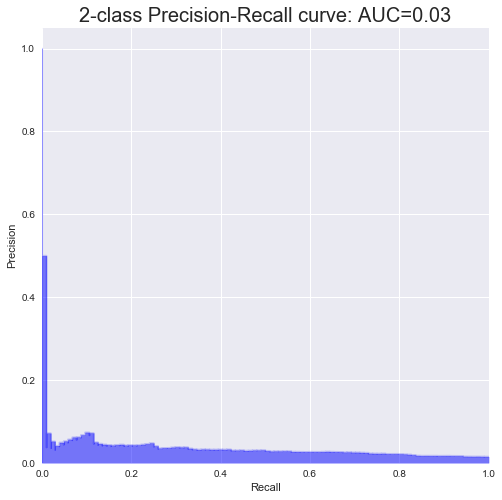

 
Iteration : 49 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 25, [10, 5]]
__________________________________________________________________

Accuracy - Training:  94.36%
Accuracy - test    :  93.64%

AUC Performance
AUC - Training     : 0.9210
AUC - Test         : 0.6481


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.95      0.97     20614
          1       0.14      0.64      0.23       275

avg / total       0.98      0.94      0.96     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.95      0.97      6860
          1       0.04      0.12      0.06       104

avg / total       0.97      0.94      0.95      6964


  Confusion Matrix - Train 
[[19536   100]
 [ 1078   175]]


  Confusion Matrix - Test 
[[6508   91]
 [ 35

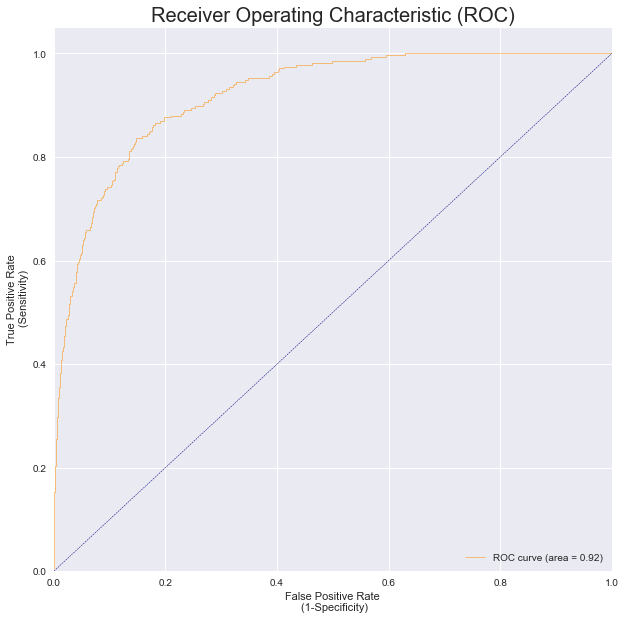


  Test AUC 


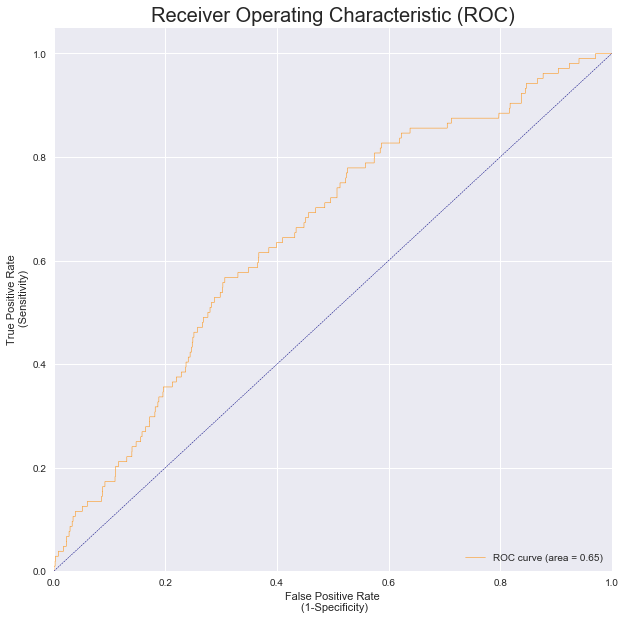


  Train Precission - Recall Curve 
Average precision-recall score: 0.30


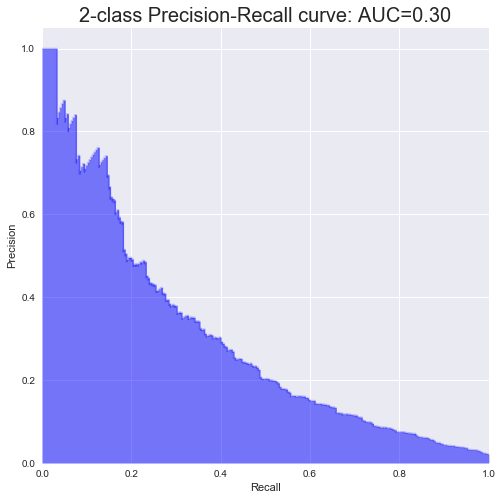


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


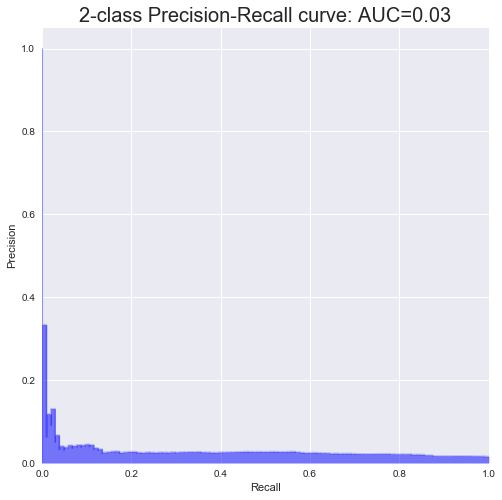

 
Iteration : 50 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 25, [50, 25]]
__________________________________________________________________

Accuracy - Training:  94.04%
Accuracy - test    :  93.42%

AUC Performance
AUC - Training     : 0.9185
AUC - Test         : 0.6406


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.94      0.97     20614
          1       0.13      0.64      0.22       275

avg / total       0.98      0.94      0.96     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.95      0.97      6860
          1       0.03      0.11      0.05       104

avg / total       0.97      0.93      0.95      6964


  Confusion Matrix - Train 
[[19470   100]
 [ 1144   175]]


  Confusion Matrix - Test 
[[6495   93]
 [ 3

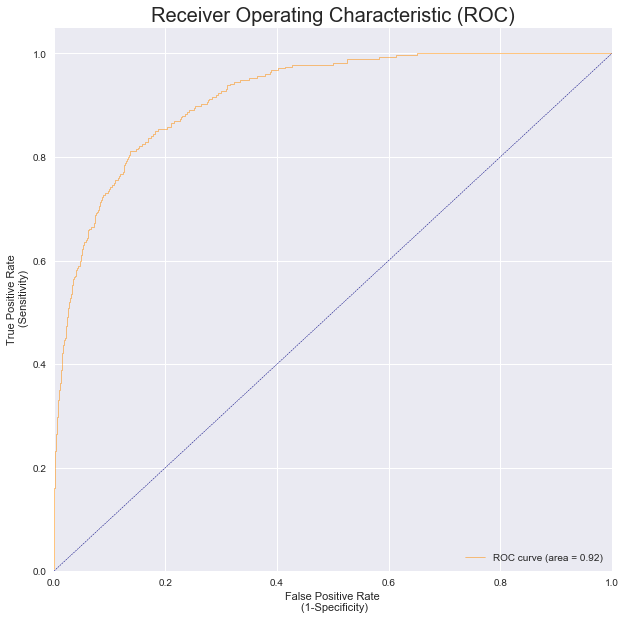


  Test AUC 


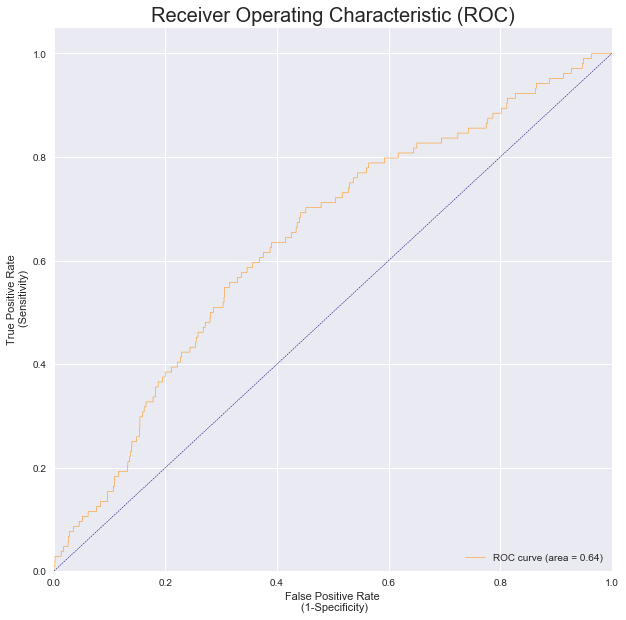


  Train Precission - Recall Curve 
Average precision-recall score: 0.31


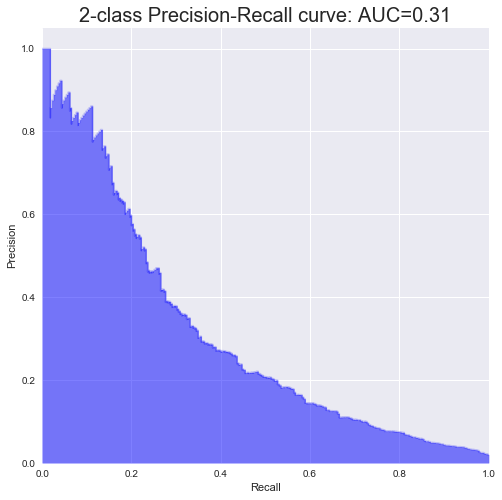


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


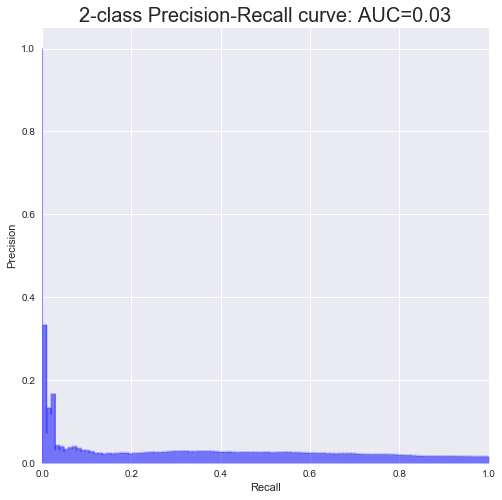

 
Iteration : 51 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 25, [100, 50]]
__________________________________________________________________

Accuracy - Training:  93.49%
Accuracy - test    :  92.65%

AUC Performance
AUC - Training     : 0.9102
AUC - Test         : 0.6329


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.94      0.97     20614
          1       0.12      0.62      0.20       275

avg / total       0.98      0.93      0.96     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.94      0.96      6860
          1       0.03      0.12      0.04       104

avg / total       0.97      0.93      0.95      6964


  Confusion Matrix - Train 
[[19359   105]
 [ 1255   170]]


  Confusion Matrix - Test 
[[6440   92]
 [ 

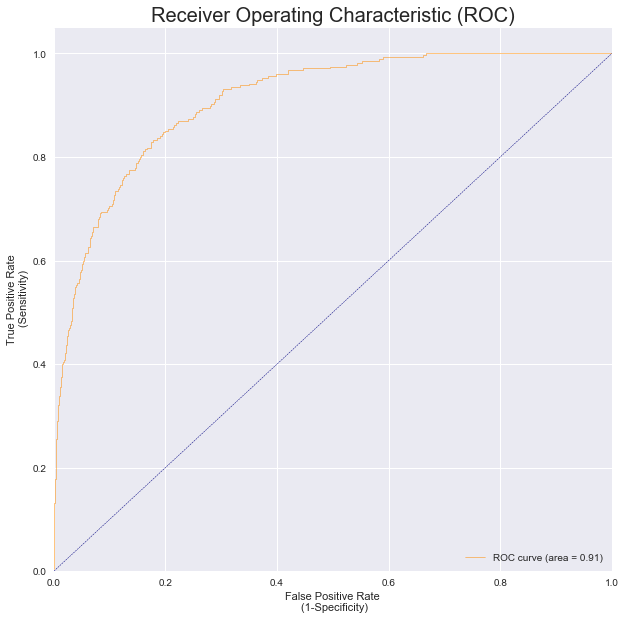


  Test AUC 


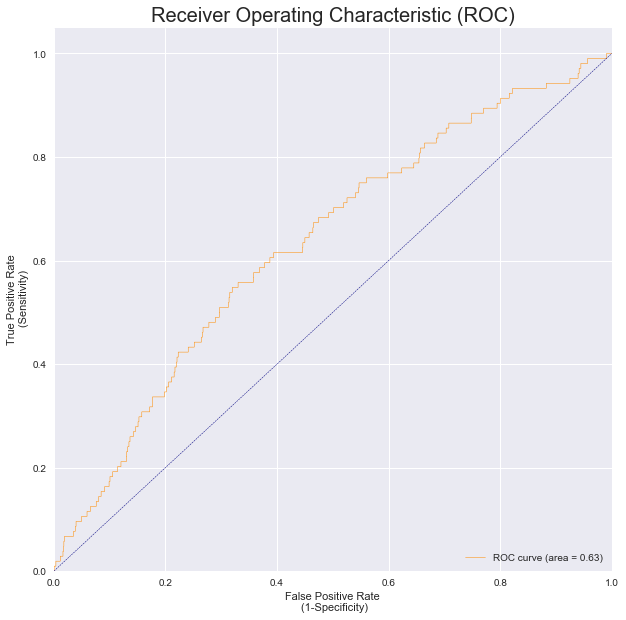


  Train Precission - Recall Curve 
Average precision-recall score: 0.28


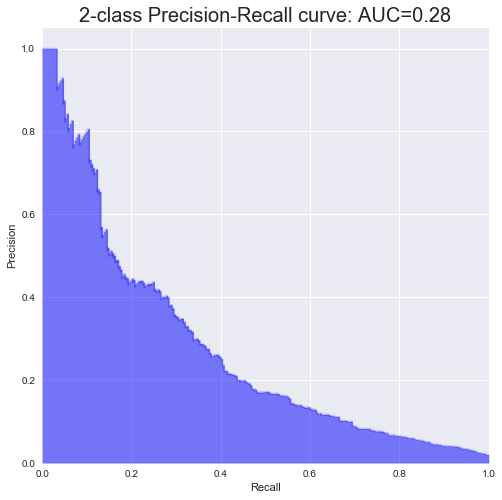


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


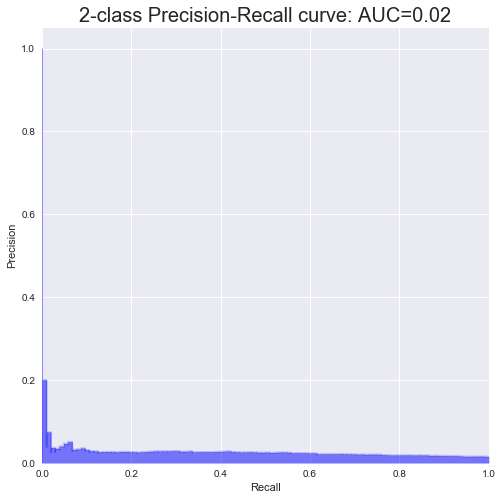

 
Iteration : 52 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 25, [200, 100]]
__________________________________________________________________

Accuracy - Training:  91.61%
Accuracy - test    :  91.00%

AUC Performance
AUC - Training     : 0.8963
AUC - Test         : 0.6611


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.96     20614
          1       0.09      0.61      0.16       275

avg / total       0.98      0.92      0.95     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95      6860
          1       0.04      0.22      0.07       104

avg / total       0.97      0.91      0.94      6964


  Confusion Matrix - Train 
[[18968   107]
 [ 1646   168]]


  Confusion Matrix - Test 
[[6314   81]
 [

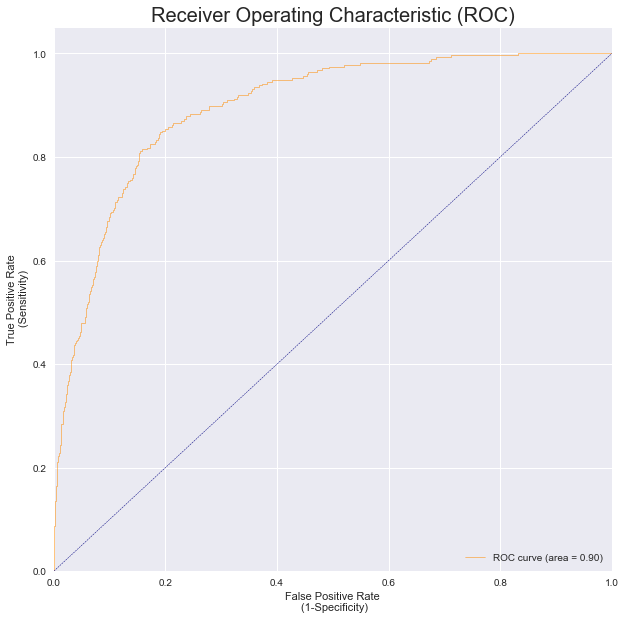


  Test AUC 


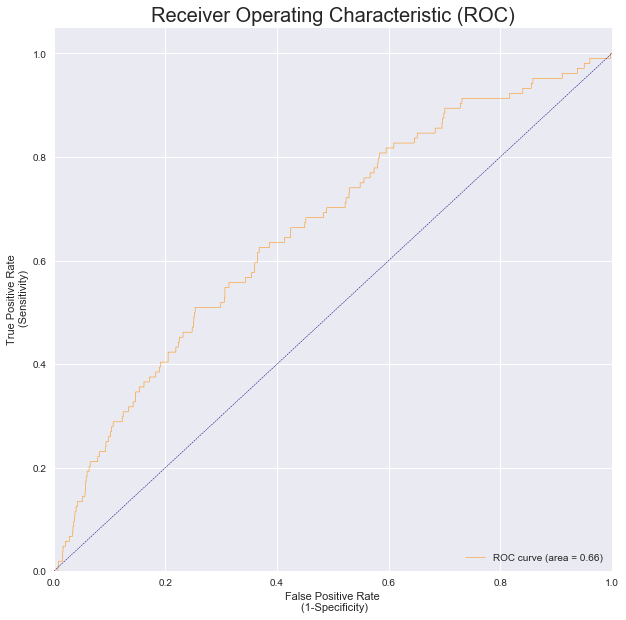


  Train Precission - Recall Curve 
Average precision-recall score: 0.17


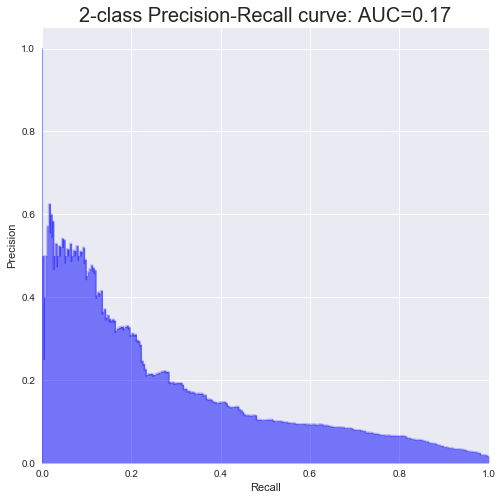


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


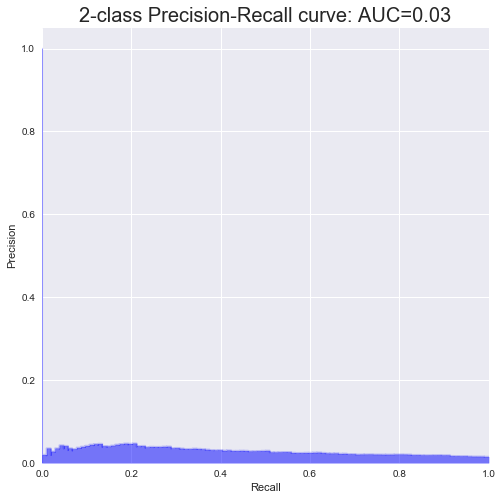

 
Iteration : 53 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 25, [400, 200]]
__________________________________________________________________

Accuracy - Training:  89.85%
Accuracy - test    :  89.57%

AUC Performance
AUC - Training     : 0.8827
AUC - Test         : 0.6649


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.90      0.95     20614
          1       0.08      0.60      0.14       275

avg / total       0.98      0.90      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.91      0.94      6860
          1       0.04      0.26      0.07       104

avg / total       0.97      0.90      0.93      6964


  Confusion Matrix - Train 
[[18603   109]
 [ 2011   166]]


  Confusion Matrix - Test 
[[6211   77]
 [

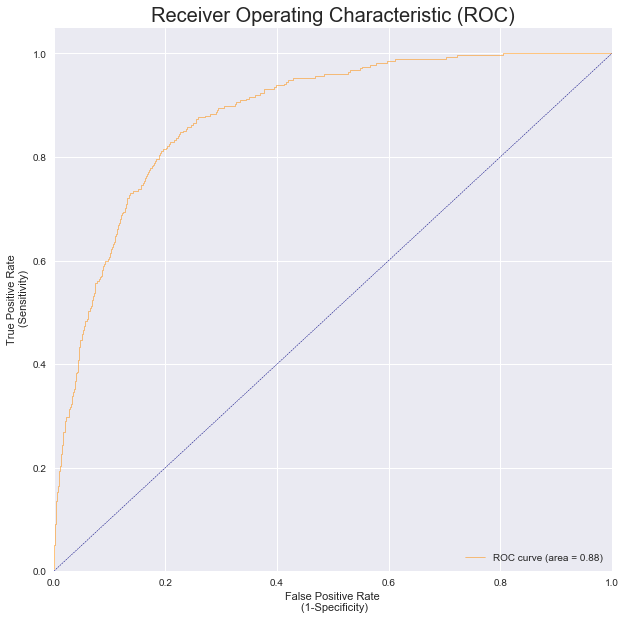


  Test AUC 


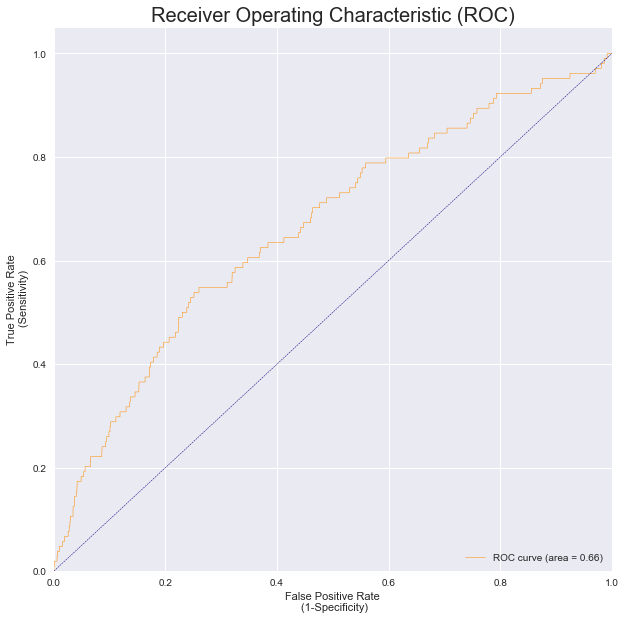


  Train Precission - Recall Curve 
Average precision-recall score: 0.14


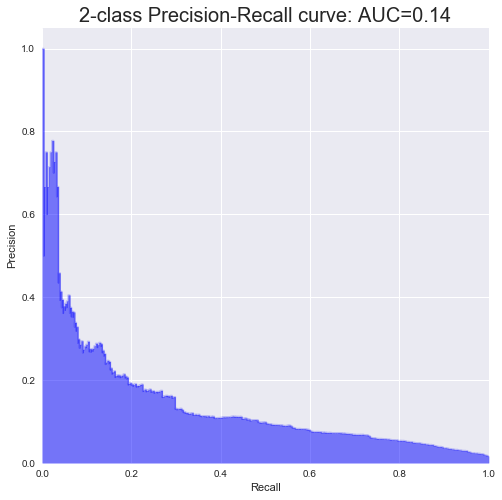


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


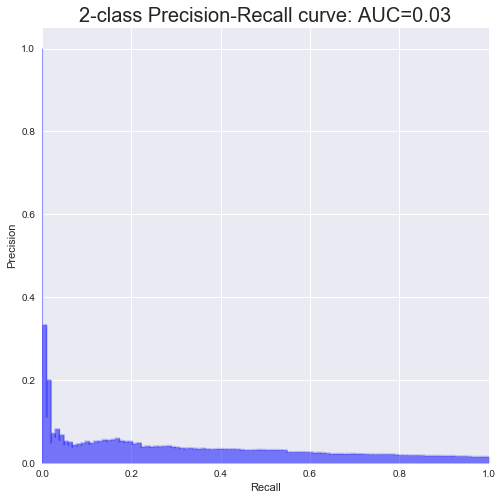

 
Iteration : 54 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 25, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  84.01%
Accuracy - test    :  83.40%

AUC Performance
AUC - Training     : 0.8312
AUC - Test         : 0.6623


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.84      0.91     20614
          1       0.05      0.63      0.09       275

avg / total       0.98      0.84      0.90     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.84      0.91      6860
          1       0.03      0.33      0.06       104

avg / total       0.97      0.83      0.90      6964


  Confusion Matrix - Train 
[[17374   101]
 [ 3240   174]]


  Confusion Matrix - Test 
[[5774   70]
 

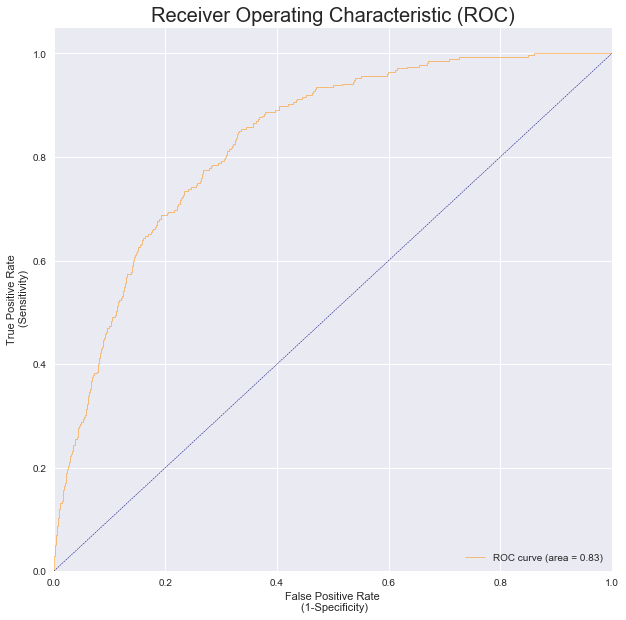


  Test AUC 


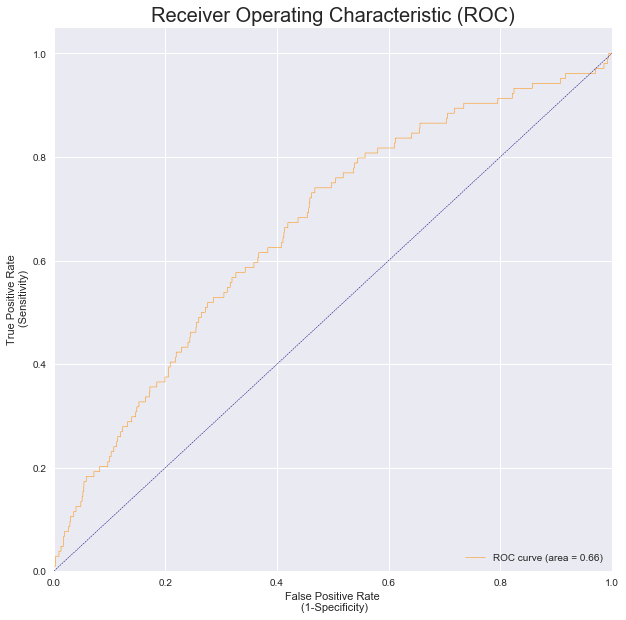


  Train Precission - Recall Curve 
Average precision-recall score: 0.07


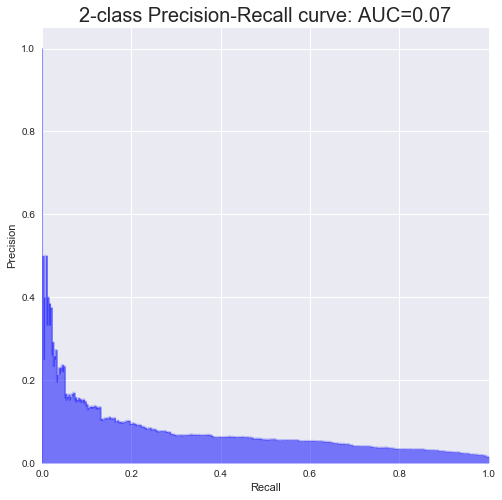


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


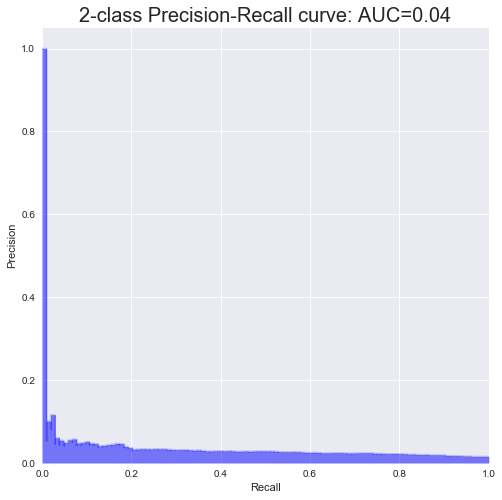

 
Iteration : 55 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 50, [10, 5]]
__________________________________________________________________

Accuracy - Training:  95.94%
Accuracy - test    :  94.96%

AUC Performance
AUC - Training     : 0.9413
AUC - Test         : 0.6581


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.96      0.98     20614
          1       0.19      0.65      0.30       275

avg / total       0.98      0.96      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.96      0.97      6860
          1       0.03      0.07      0.04       104

avg / total       0.97      0.95      0.96      6964


  Confusion Matrix - Train 
[[19860    95]
 [  754   180]]


  Confusion Matrix - Test 
[[6606   97]
 [ 25

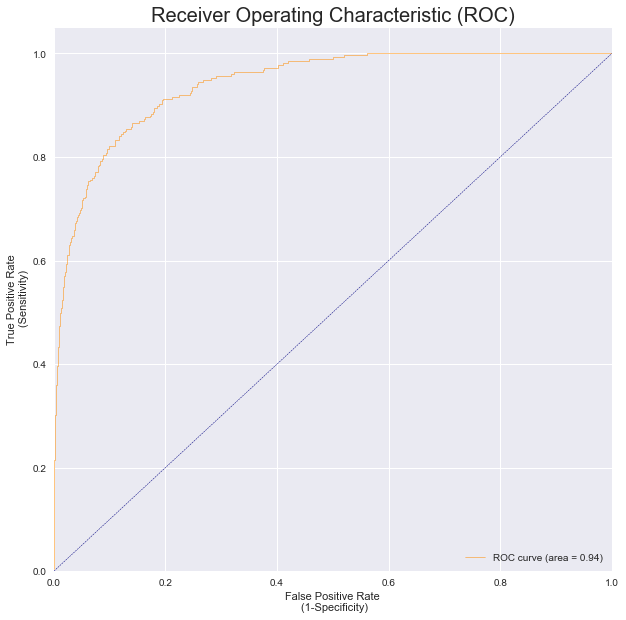


  Test AUC 


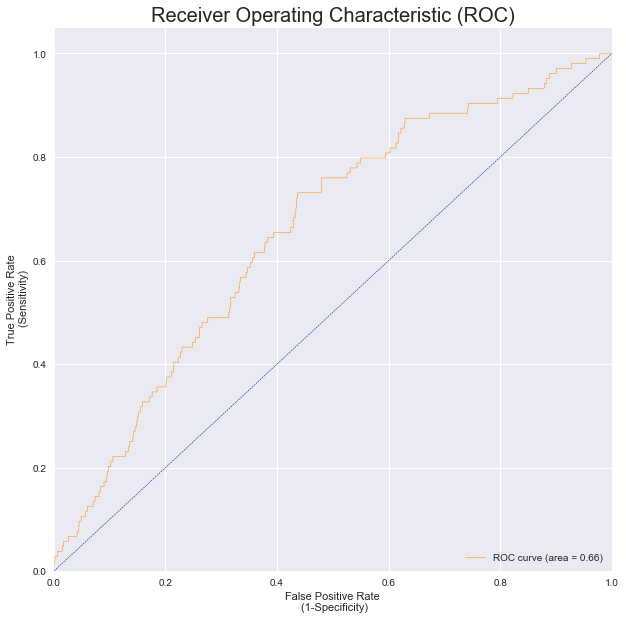


  Train Precission - Recall Curve 
Average precision-recall score: 0.41


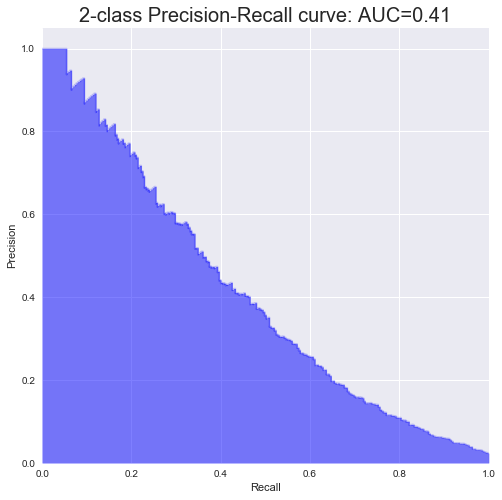


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


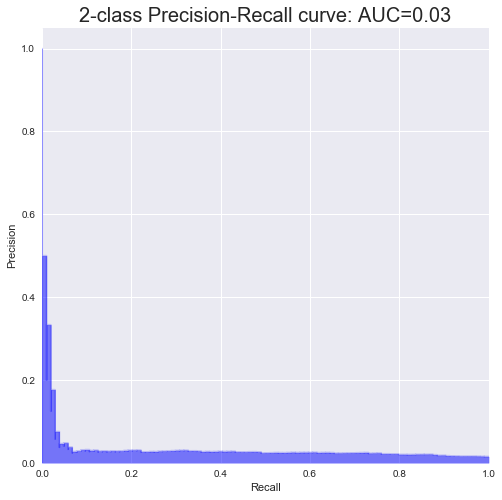

 
Iteration : 56 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 50, [50, 25]]
__________________________________________________________________

Accuracy - Training:  95.74%
Accuracy - test    :  94.84%

AUC Performance
AUC - Training     : 0.9415
AUC - Test         : 0.6465


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.96      0.98     20614
          1       0.19      0.67      0.29       275

avg / total       0.98      0.96      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.96      0.97      6860
          1       0.03      0.08      0.04       104

avg / total       0.97      0.95      0.96      6964


  Confusion Matrix - Train 
[[19816    91]
 [  798   184]]


  Confusion Matrix - Test 
[[6597   96]
 [ 2

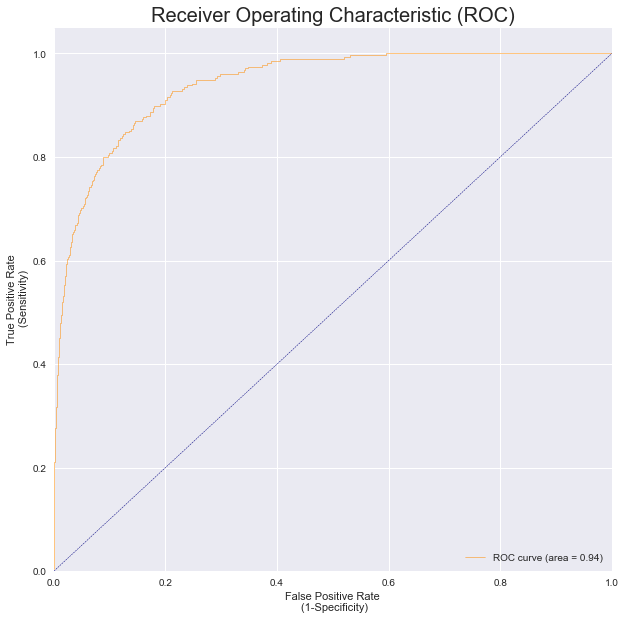


  Test AUC 


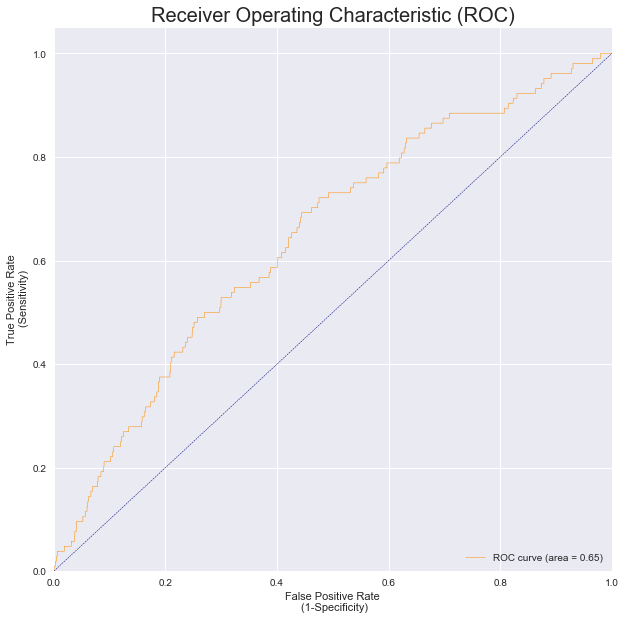


  Train Precission - Recall Curve 
Average precision-recall score: 0.40


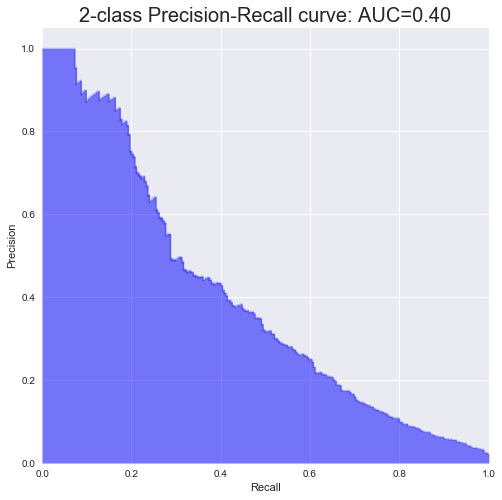


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


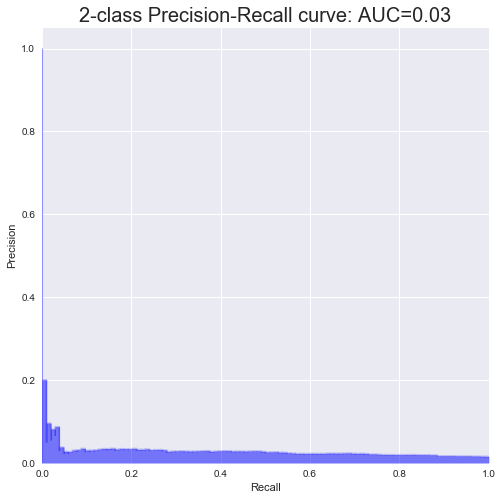

 
Iteration : 57 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 50, [100, 50]]
__________________________________________________________________

Accuracy - Training:  95.32%
Accuracy - test    :  94.33%

AUC Performance
AUC - Training     : 0.9366
AUC - Test         : 0.6545


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.96      0.98     20614
          1       0.17      0.66      0.27       275

avg / total       0.98      0.95      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.96      0.97      6860
          1       0.03      0.09      0.04       104

avg / total       0.97      0.94      0.96      6964


  Confusion Matrix - Train 
[[19731    94]
 [  883   181]]


  Confusion Matrix - Test 
[[6560   95]
 [ 

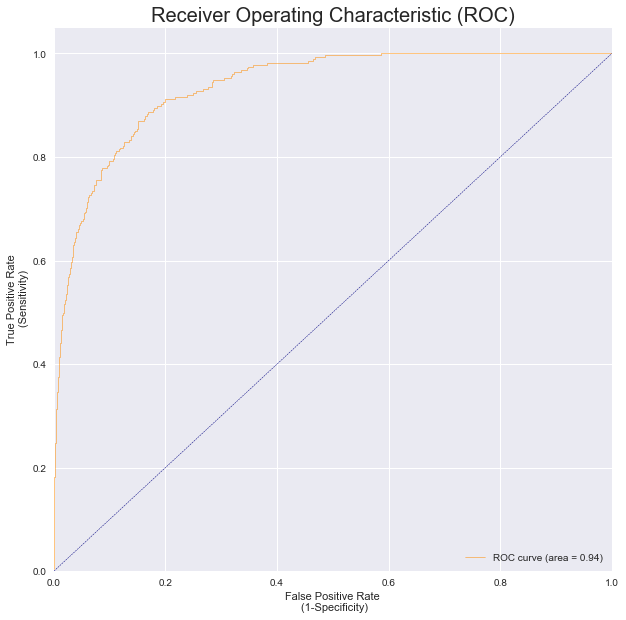


  Test AUC 


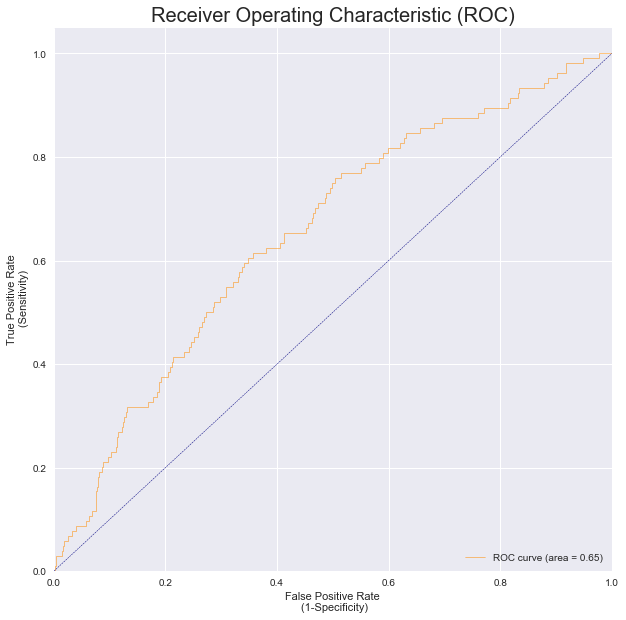


  Train Precission - Recall Curve 
Average precision-recall score: 0.36


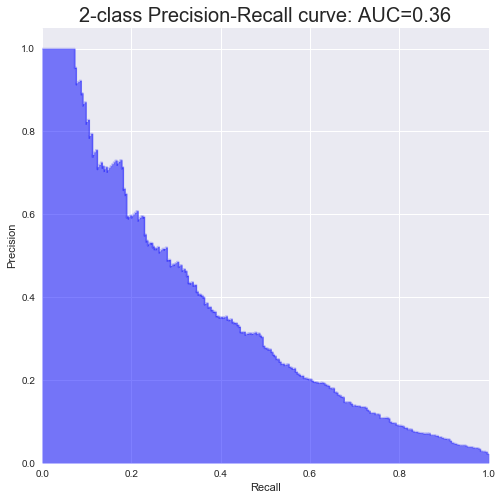


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


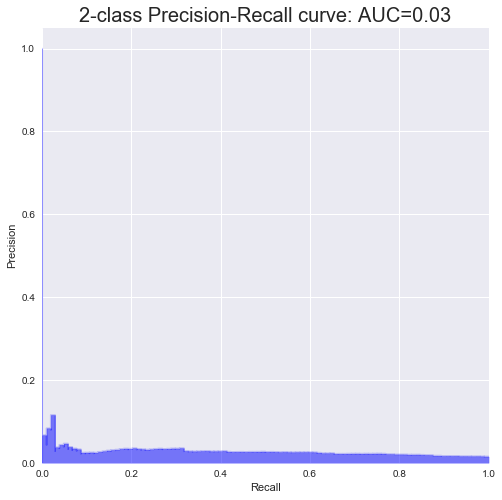

 
Iteration : 58 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 50, [200, 100]]
__________________________________________________________________

Accuracy - Training:  93.35%
Accuracy - test    :  92.42%

AUC Performance
AUC - Training     : 0.9191
AUC - Test         : 0.6715


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.94      0.97     20614
          1       0.12      0.63      0.20       275

avg / total       0.98      0.93      0.96     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.94      0.96      6860
          1       0.04      0.19      0.07       104

avg / total       0.97      0.92      0.95      6964


  Confusion Matrix - Train 
[[19325   101]
 [ 1289   174]]


  Confusion Matrix - Test 
[[6416   84]
 [

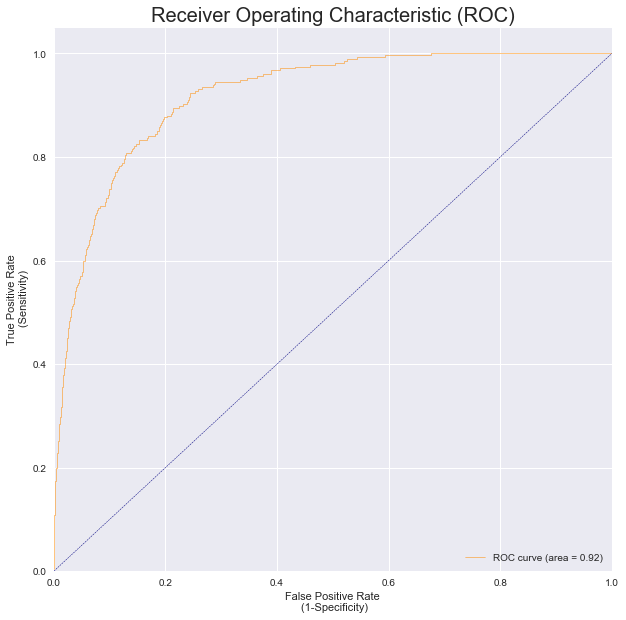


  Test AUC 


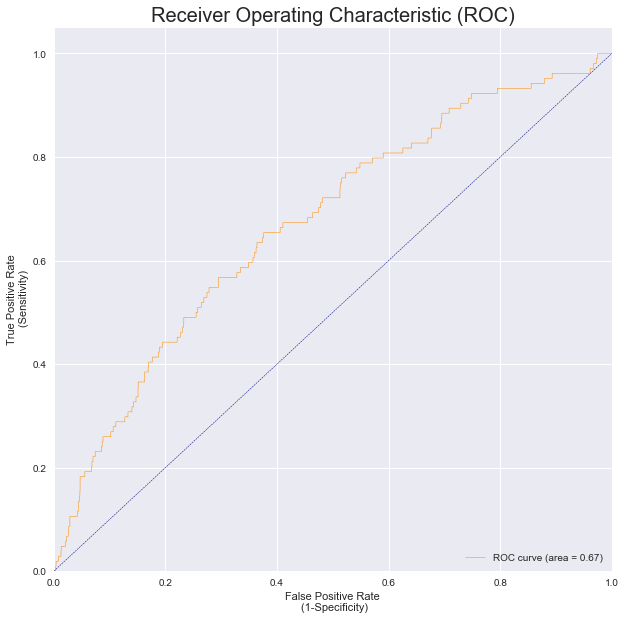


  Train Precission - Recall Curve 
Average precision-recall score: 0.24


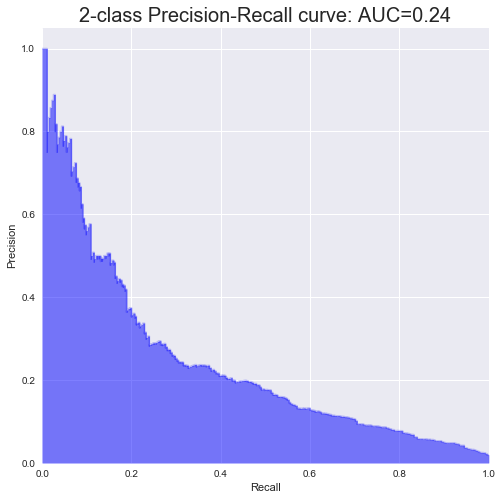


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


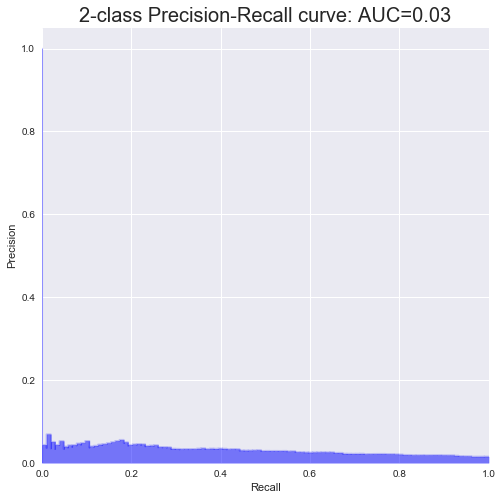

 
Iteration : 59 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 50, [400, 200]]
__________________________________________________________________

Accuracy - Training:  91.44%
Accuracy - test    :  90.92%

AUC Performance
AUC - Training     : 0.9062
AUC - Test         : 0.6774


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.92      0.95     20614
          1       0.10      0.65      0.17       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95      6860
          1       0.04      0.19      0.06       104

avg / total       0.97      0.91      0.94      6964


  Confusion Matrix - Train 
[[18921    95]
 [ 1693   180]]


  Confusion Matrix - Test 
[[6312   84]
 [

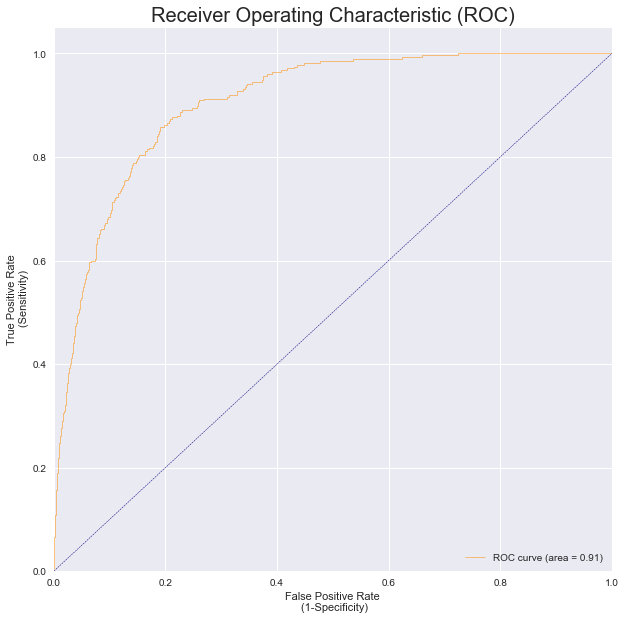


  Test AUC 


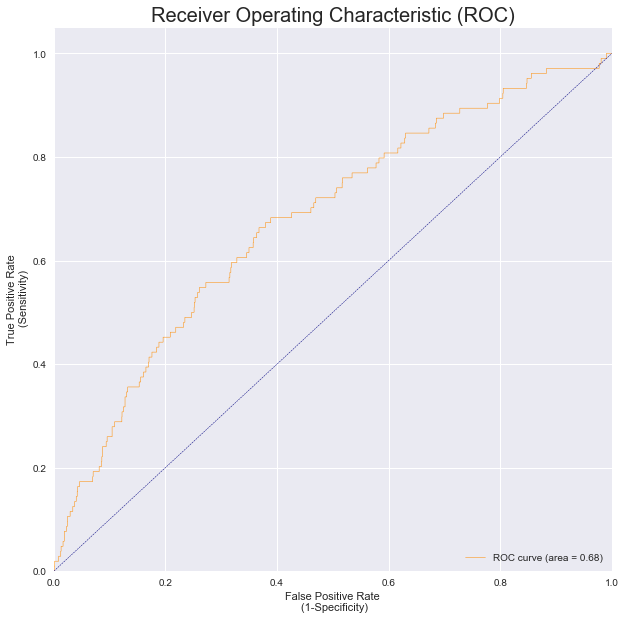


  Train Precission - Recall Curve 
Average precision-recall score: 0.18


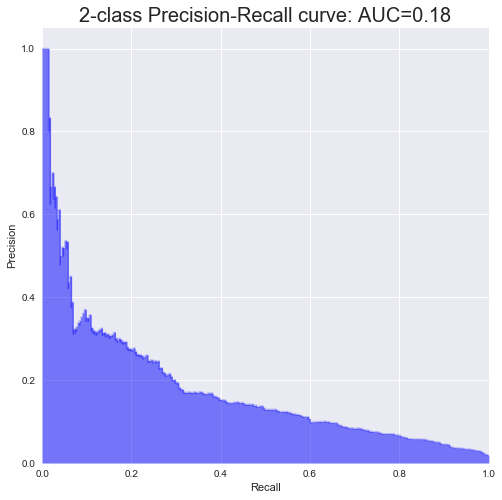


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


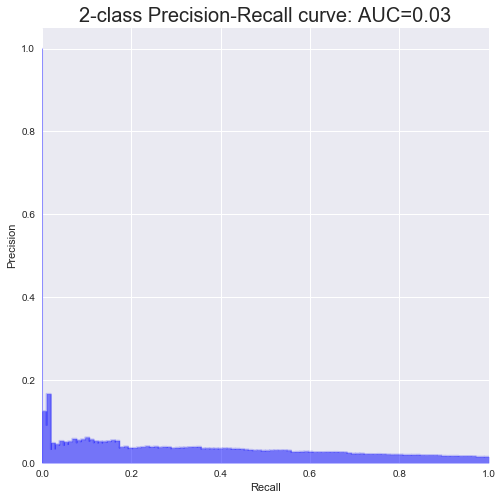

 
Iteration : 60 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 50, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  86.25%
Accuracy - test    :  85.73%

AUC Performance
AUC - Training     : 0.8594
AUC - Test         : 0.6680


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.63      0.11       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.92      6860
          1       0.03      0.30      0.06       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17844   102]
 [ 2770   173]]


  Confusion Matrix - Test 
[[5939   73]
 

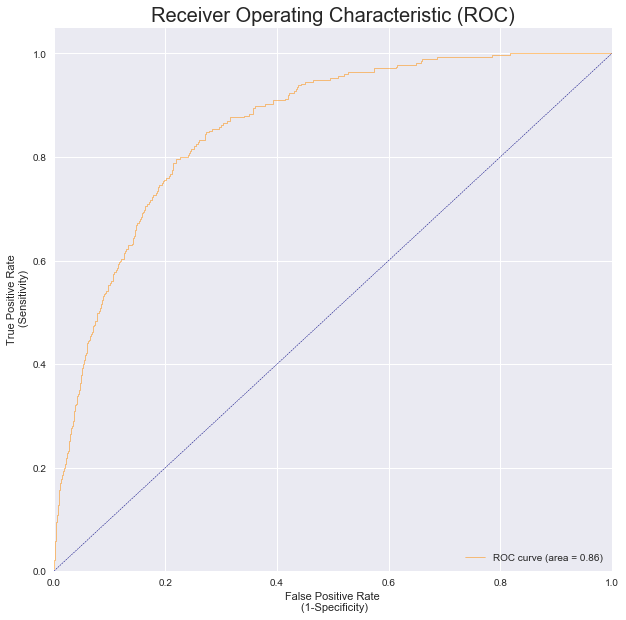


  Test AUC 


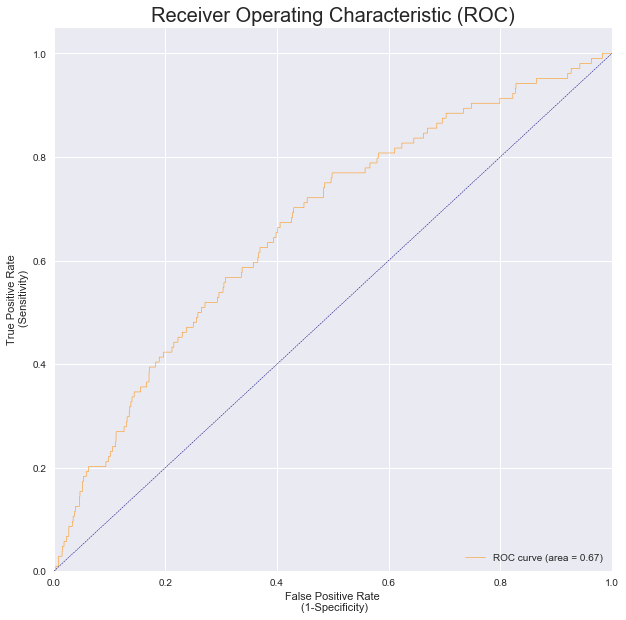


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


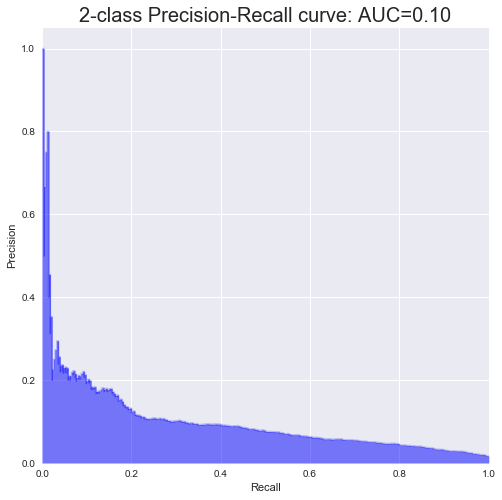


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


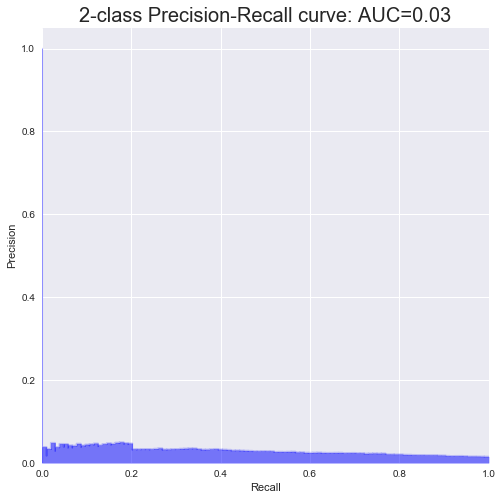

 
Iteration : 61 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 100, [10, 5]]
__________________________________________________________________

Accuracy - Training:  95.82%
Accuracy - test    :  94.70%

AUC Performance
AUC - Training     : 0.9457
AUC - Test         : 0.6789


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.96      0.98     20614
          1       0.19      0.66      0.29       275

avg / total       0.98      0.96      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.96      0.97      6860
          1       0.04      0.11      0.06       104

avg / total       0.97      0.95      0.96      6964


  Confusion Matrix - Train 
[[19834    94]
 [  780   181]]


  Confusion Matrix - Test 
[[6584   93]
 [ 2

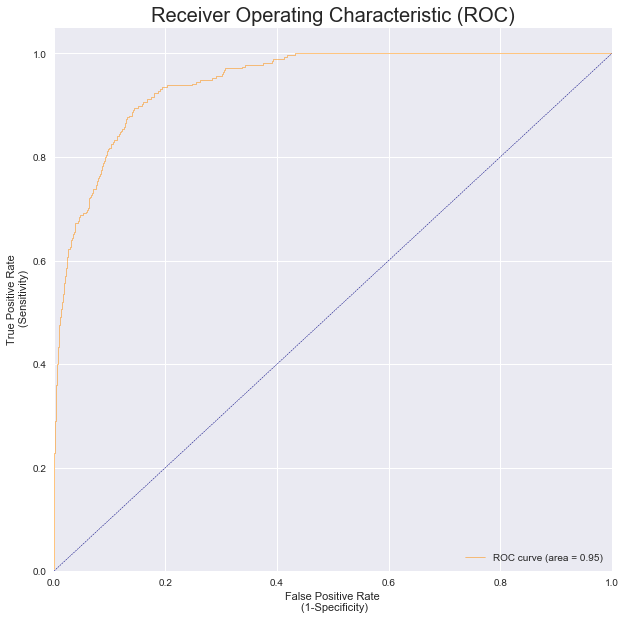


  Test AUC 


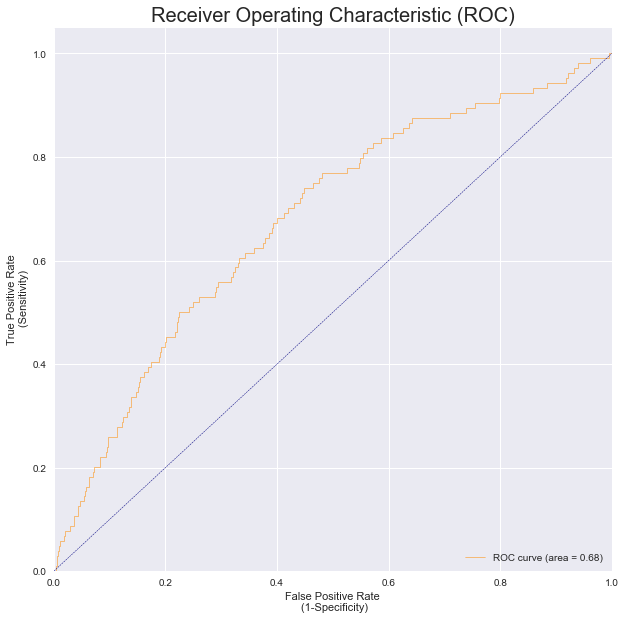


  Train Precission - Recall Curve 
Average precision-recall score: 0.41


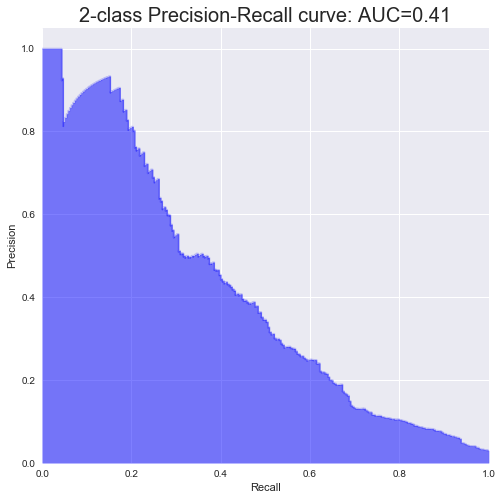


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


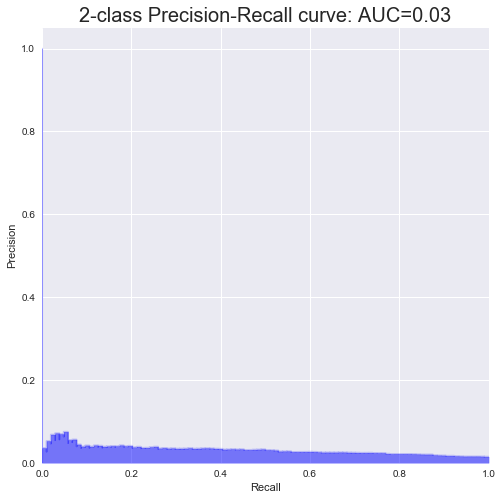

 
Iteration : 62 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 100, [50, 25]]
__________________________________________________________________

Accuracy - Training:  95.73%
Accuracy - test    :  94.70%

AUC Performance
AUC - Training     : 0.9445
AUC - Test         : 0.6746


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.96      0.98     20614
          1       0.18      0.65      0.29       275

avg / total       0.98      0.96      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.96      0.97      6860
          1       0.04      0.12      0.07       104

avg / total       0.97      0.95      0.96      6964


  Confusion Matrix - Train 
[[19818    97]
 [  796   178]]


  Confusion Matrix - Test 
[[6582   91]
 [ 

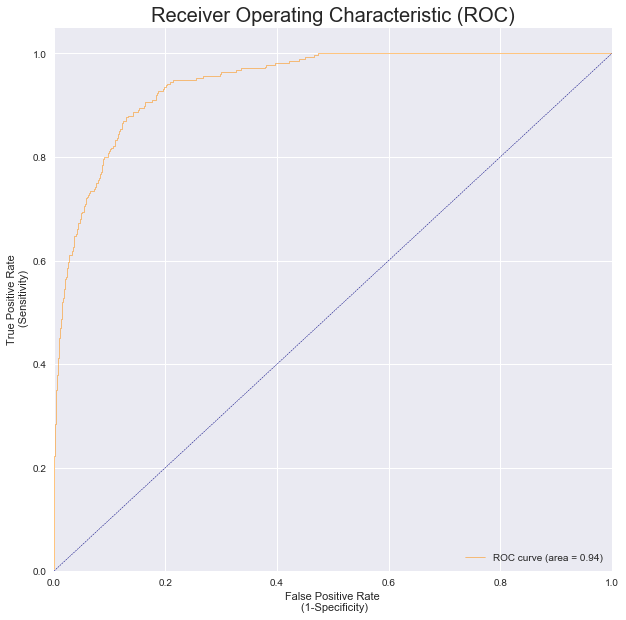


  Test AUC 


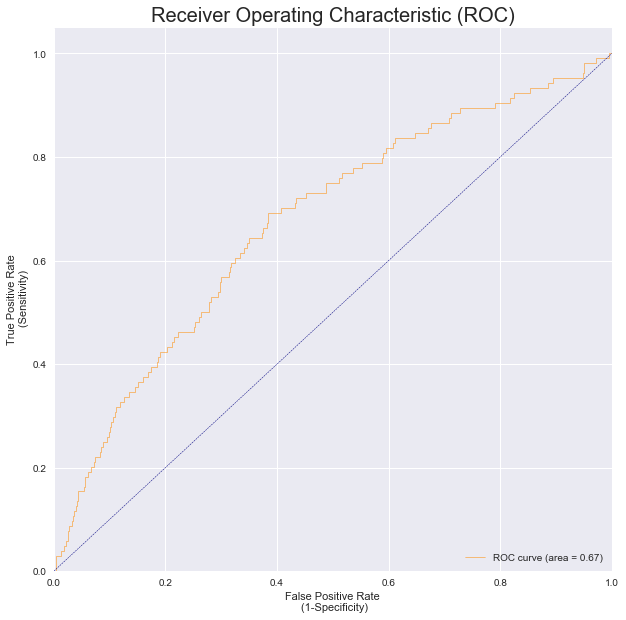


  Train Precission - Recall Curve 
Average precision-recall score: 0.40


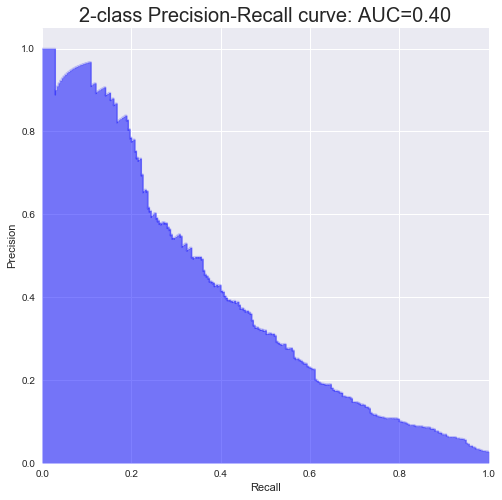


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


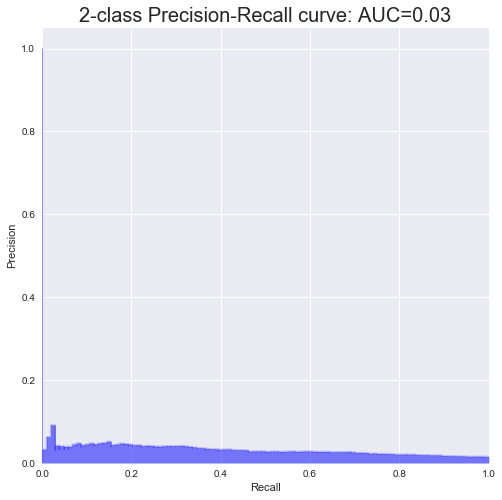

 
Iteration : 63 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 100, [100, 50]]
__________________________________________________________________

Accuracy - Training:  95.20%
Accuracy - test    :  94.14%

AUC Performance
AUC - Training     : 0.9379
AUC - Test         : 0.6843


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.96      0.98     20614
          1       0.17      0.65      0.26       275

avg / total       0.98      0.95      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.95      0.97      6860
          1       0.04      0.14      0.07       104

avg / total       0.97      0.94      0.96      6964


  Confusion Matrix - Train 
[[19707    95]
 [  907   180]]


  Confusion Matrix - Test 
[[6541   89]
 [

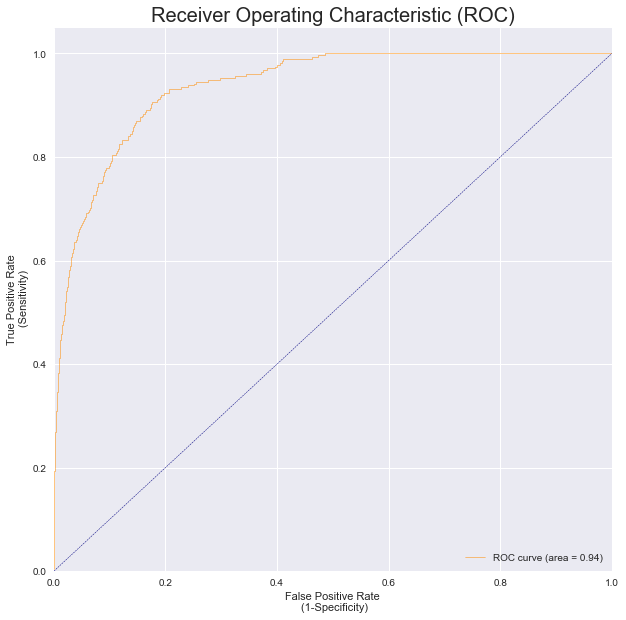


  Test AUC 


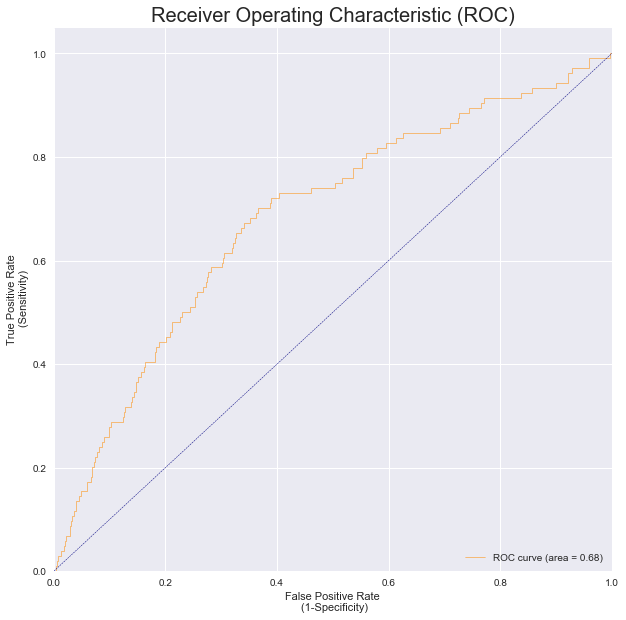


  Train Precission - Recall Curve 
Average precision-recall score: 0.37


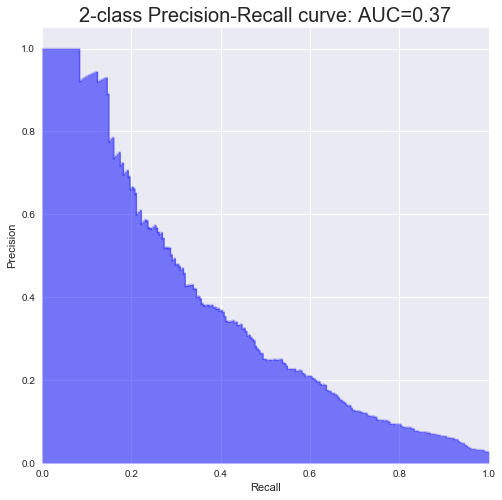


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


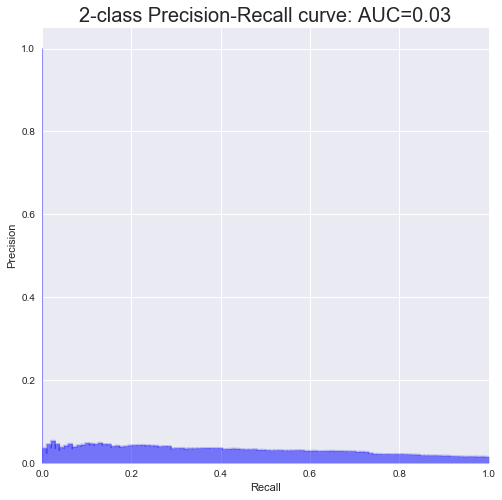

 
Iteration : 64 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 100, [200, 100]]
__________________________________________________________________

Accuracy - Training:  93.50%
Accuracy - test    :  92.72%

AUC Performance
AUC - Training     : 0.9229
AUC - Test         : 0.6884


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.94      0.97     20614
          1       0.12      0.62      0.20       275

avg / total       0.98      0.93      0.96     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.94      0.96      6860
          1       0.04      0.17      0.07       104

avg / total       0.97      0.93      0.95      6964


  Confusion Matrix - Train 
[[19360   104]
 [ 1254   171]]


  Confusion Matrix - Test 
[[6439   86]
 

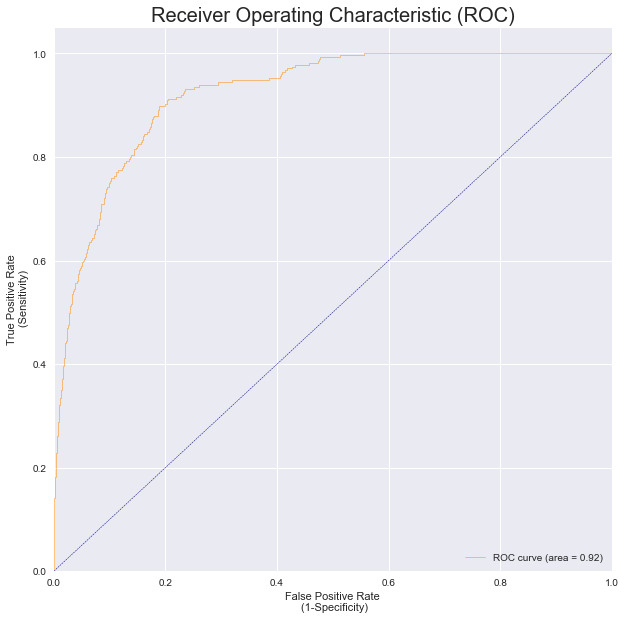


  Test AUC 


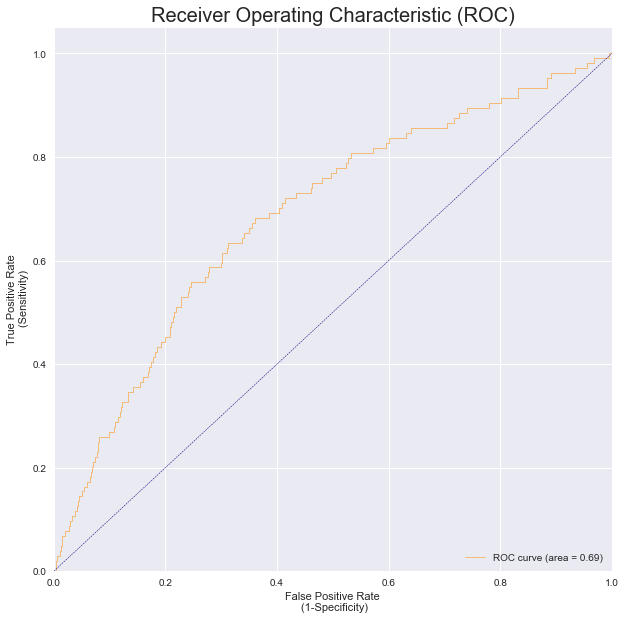


  Train Precission - Recall Curve 
Average precision-recall score: 0.28


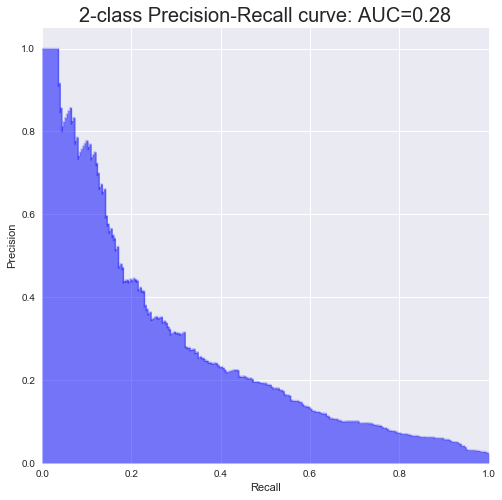


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


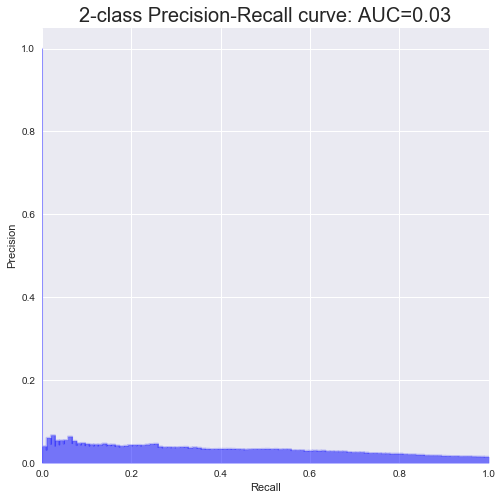

 
Iteration : 65 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 100, [400, 200]]
__________________________________________________________________

Accuracy - Training:  91.46%
Accuracy - test    :  90.85%

AUC Performance
AUC - Training     : 0.9060
AUC - Test         : 0.6754


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.96     20614
          1       0.09      0.63      0.16       275

avg / total       0.98      0.91      0.94     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95      6860
          1       0.04      0.24      0.07       104

avg / total       0.97      0.91      0.94      6964


  Confusion Matrix - Train 
[[18933   102]
 [ 1681   173]]


  Confusion Matrix - Test 
[[6302   79]
 

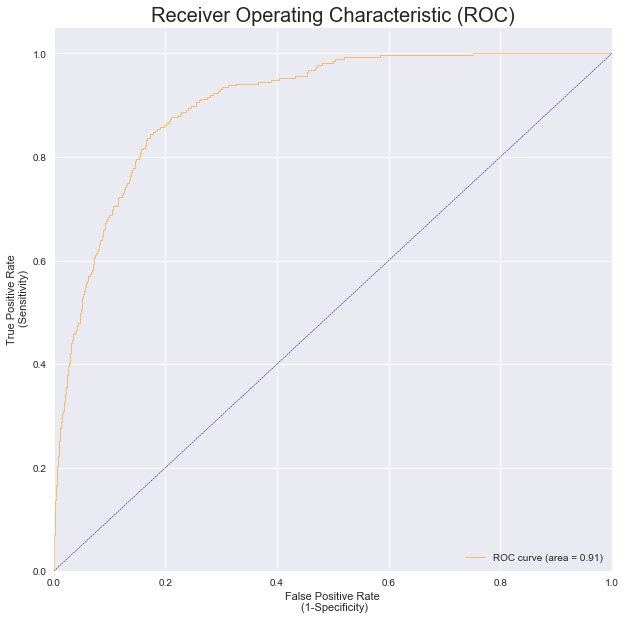


  Test AUC 


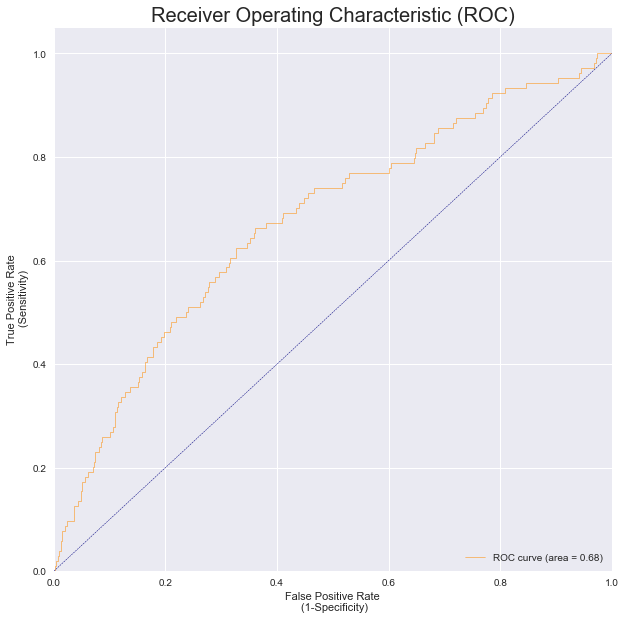


  Train Precission - Recall Curve 
Average precision-recall score: 0.19


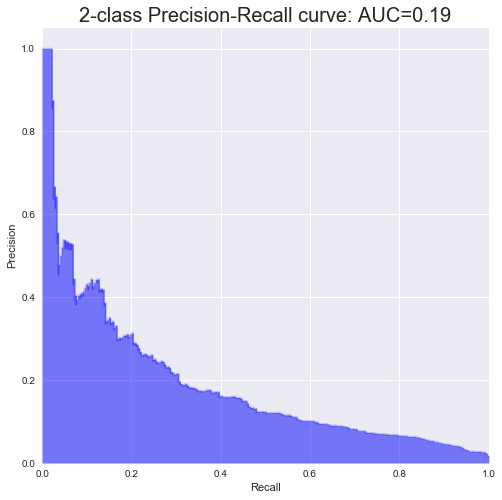


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


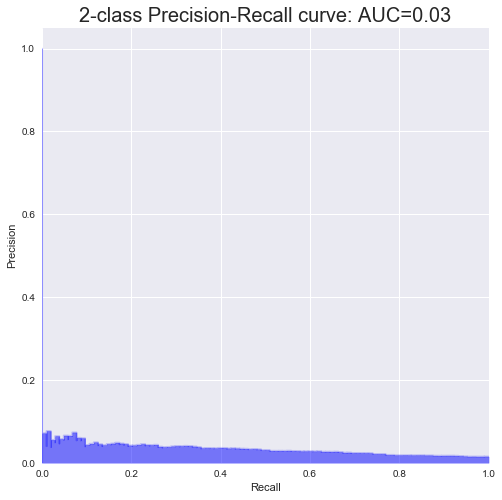

 
Iteration : 66 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 100, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  85.99%
Accuracy - test    :  85.44%

AUC Performance
AUC - Training     : 0.8608
AUC - Test         : 0.6706


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92     20614
          1       0.06      0.62      0.10       275

avg / total       0.98      0.86      0.91     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.86      0.92      6860
          1       0.04      0.35      0.07       104

avg / total       0.97      0.85      0.91      6964


  Confusion Matrix - Train 
[[17792   104]
 [ 2822   171]]


  Confusion Matrix - Test 
[[5914   68]


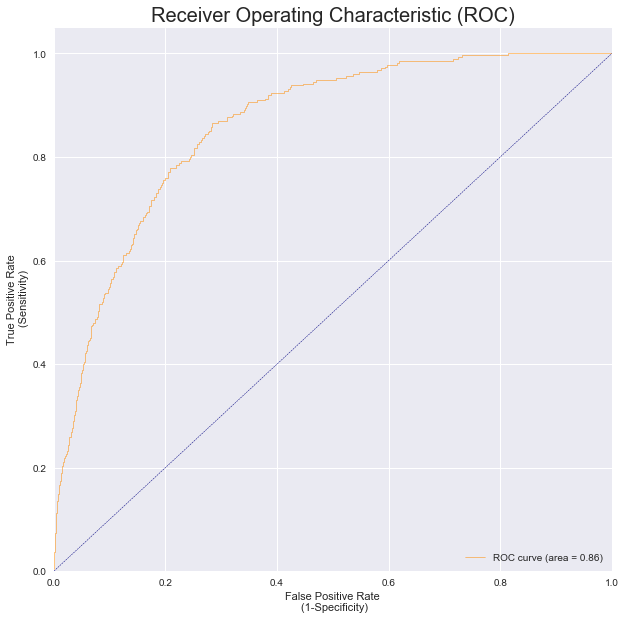


  Test AUC 


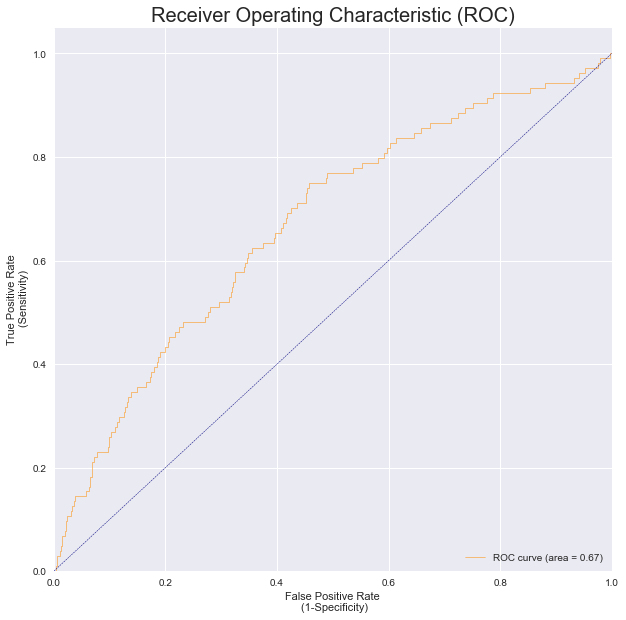


  Train Precission - Recall Curve 
Average precision-recall score: 0.11


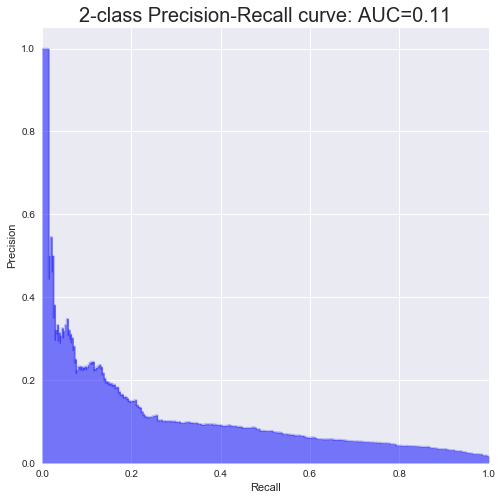


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


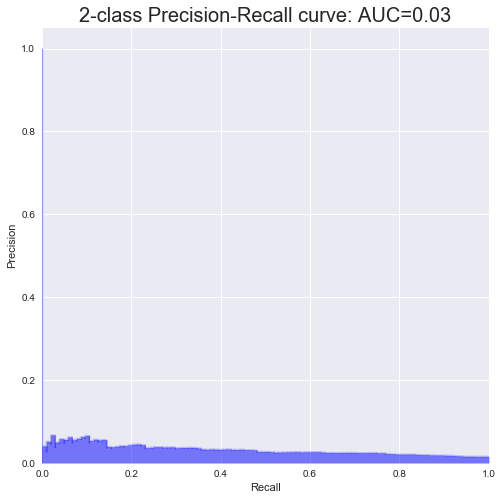

 
Iteration : 67 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 200, [10, 5]]
__________________________________________________________________

Accuracy - Training:  96.05%
Accuracy - test    :  94.84%

AUC Performance
AUC - Training     : 0.9514
AUC - Test         : 0.6810


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.96      0.98     20614
          1       0.19      0.64      0.30       275

avg / total       0.98      0.96      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.96      0.97      6860
          1       0.04      0.10      0.05       104

avg / total       0.97      0.95      0.96      6964


  Confusion Matrix - Train 
[[19888   100]
 [  726   175]]


  Confusion Matrix - Test 
[[6595   94]
 [ 2

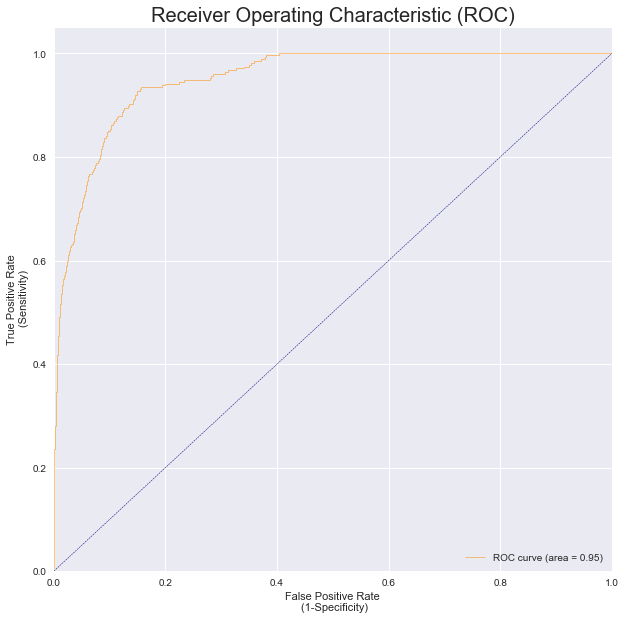


  Test AUC 


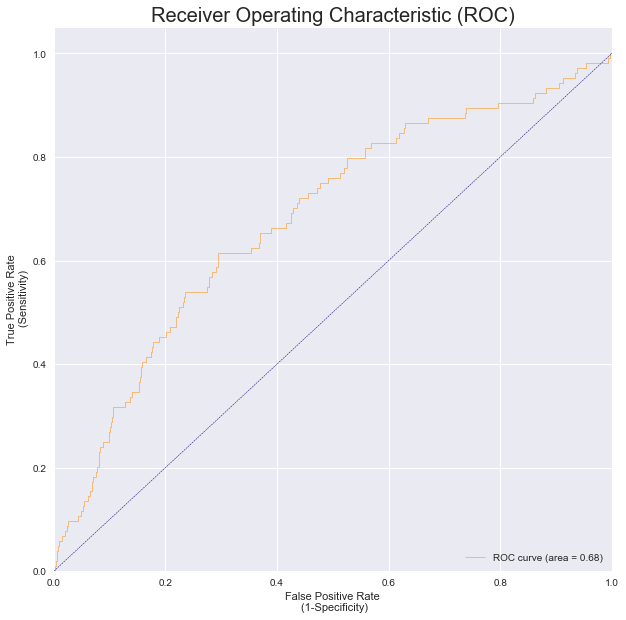


  Train Precission - Recall Curve 
Average precision-recall score: 0.43


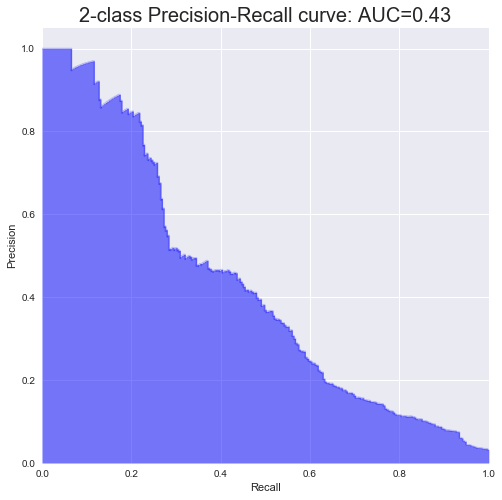


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


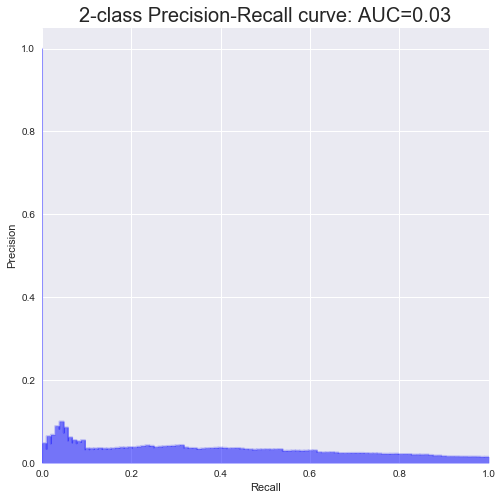

 
Iteration : 68 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 200, [50, 25]]
__________________________________________________________________

Accuracy - Training:  95.77%
Accuracy - test    :  94.66%

AUC Performance
AUC - Training     : 0.9472
AUC - Test         : 0.6747


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.96      0.98     20614
          1       0.18      0.64      0.29       275

avg / total       0.98      0.96      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.96      0.97      6860
          1       0.04      0.12      0.07       104

avg / total       0.97      0.95      0.96      6964


  Confusion Matrix - Train 
[[19830    99]
 [  784   176]]


  Confusion Matrix - Test 
[[6579   91]
 [ 

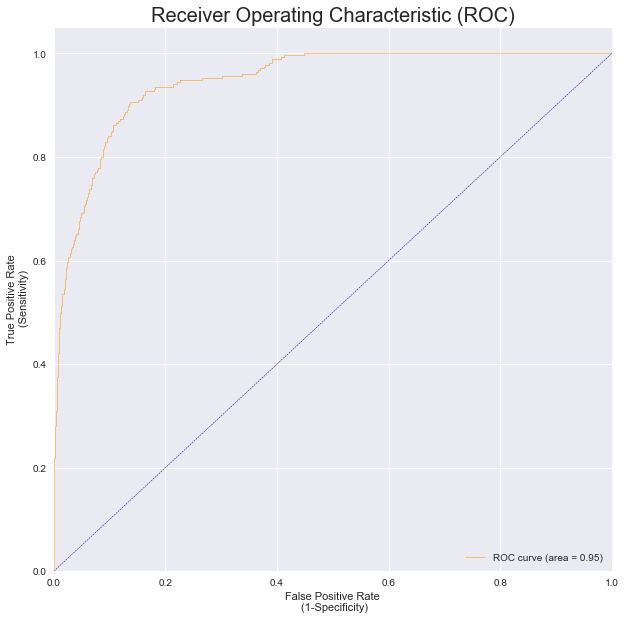


  Test AUC 


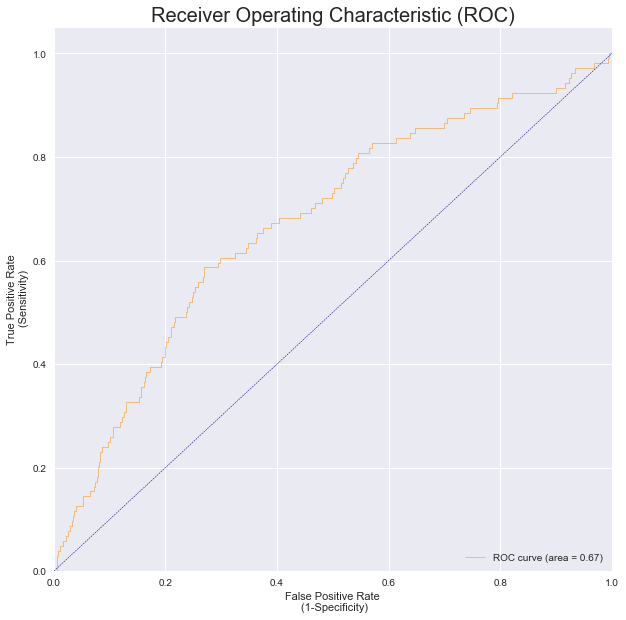


  Train Precission - Recall Curve 
Average precision-recall score: 0.41


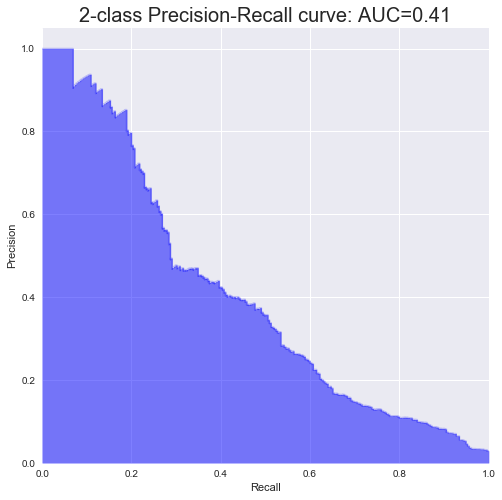


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


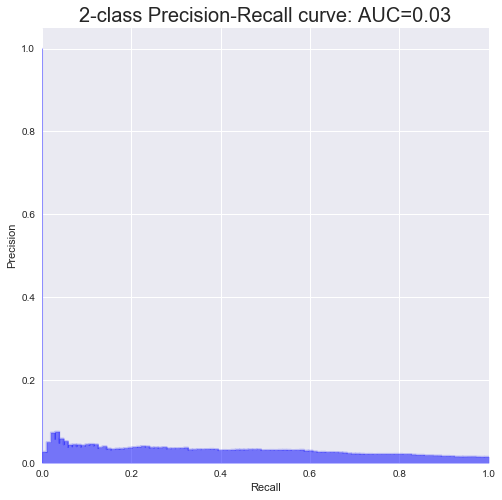

 
Iteration : 69 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 200, [100, 50]]
__________________________________________________________________

Accuracy - Training:  95.24%
Accuracy - test    :  94.20%

AUC Performance
AUC - Training     : 0.9409
AUC - Test         : 0.6778


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.96      0.98     20614
          1       0.17      0.65      0.26       275

avg / total       0.98      0.95      0.97     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.95      0.97      6860
          1       0.04      0.12      0.06       104

avg / total       0.97      0.94      0.96      6964


  Confusion Matrix - Train 
[[19716    97]
 [  898   178]]


  Confusion Matrix - Test 
[[6547   91]
 [

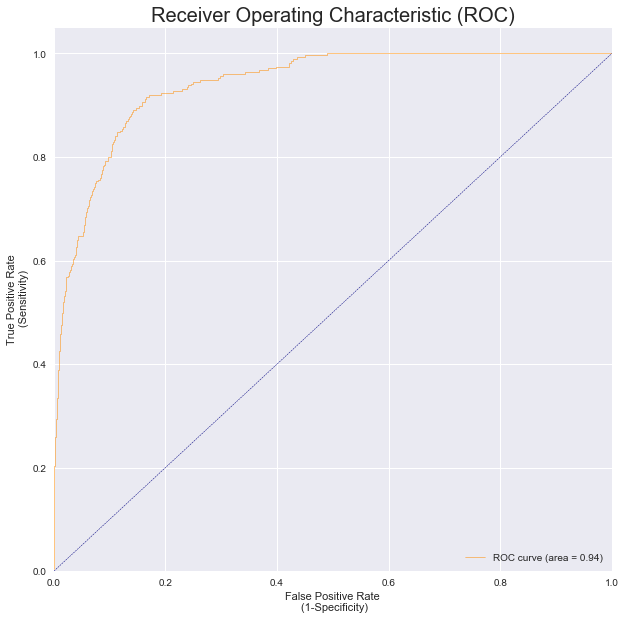


  Test AUC 


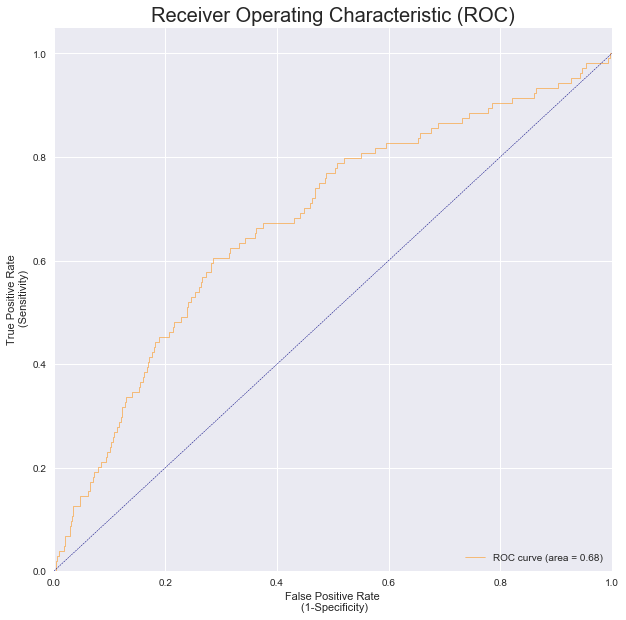


  Train Precission - Recall Curve 
Average precision-recall score: 0.38


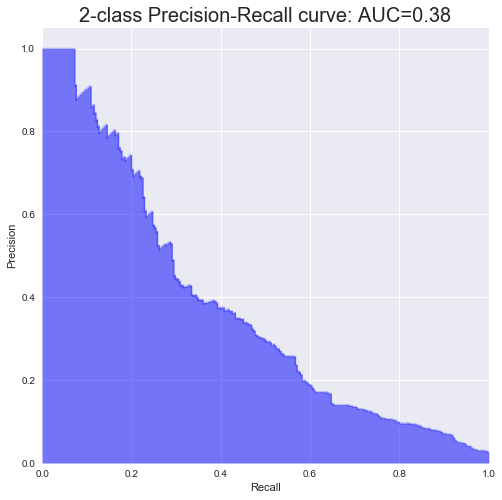


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


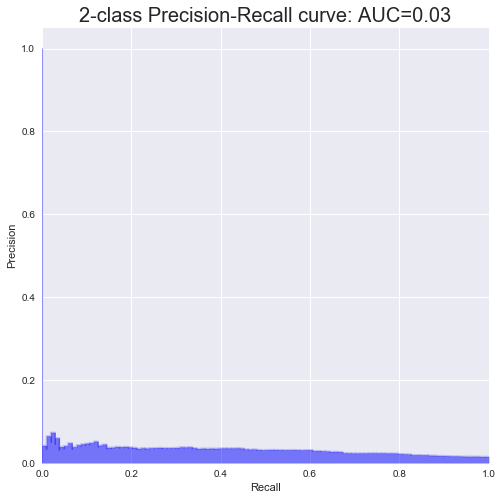

 
Iteration : 70 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 200, [200, 100]]
__________________________________________________________________

Accuracy - Training:  93.91%
Accuracy - test    :  92.89%

AUC Performance
AUC - Training     : 0.9279
AUC - Test         : 0.6789


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.94      0.97     20614
          1       0.13      0.63      0.21       275

avg / total       0.98      0.94      0.96     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.94      0.96      6860
          1       0.04      0.14      0.06       104

avg / total       0.97      0.93      0.95      6964


  Confusion Matrix - Train 
[[19444   103]
 [ 1170   172]]


  Confusion Matrix - Test 
[[6454   89]
 

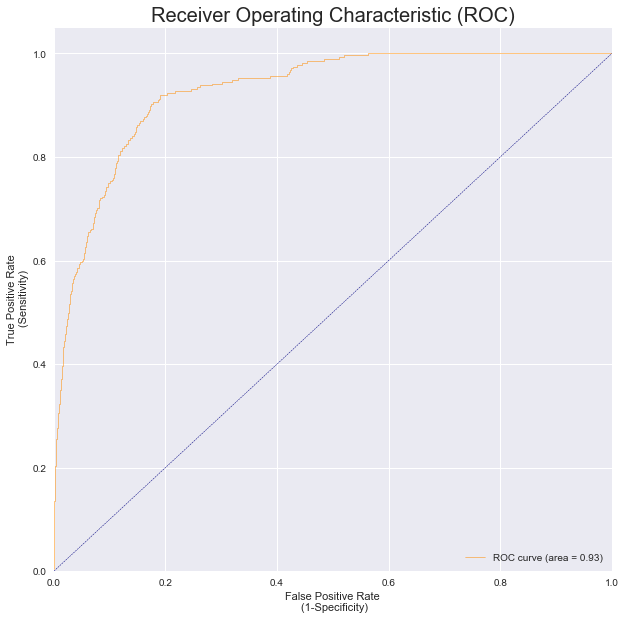


  Test AUC 


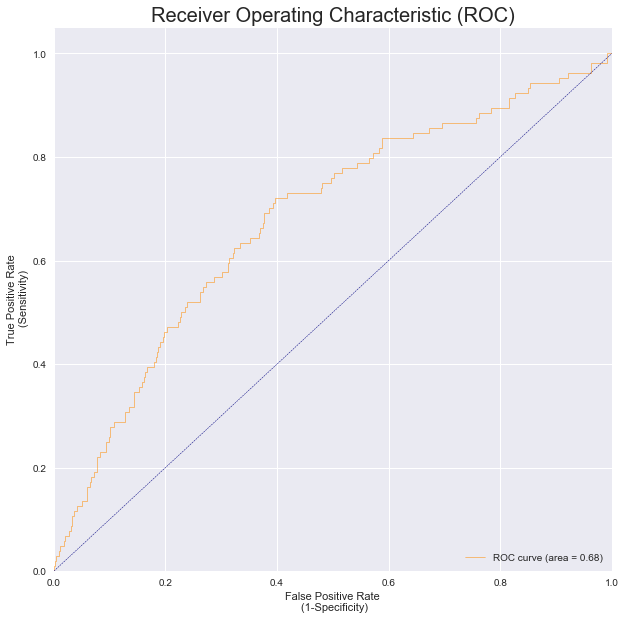


  Train Precission - Recall Curve 
Average precision-recall score: 0.29


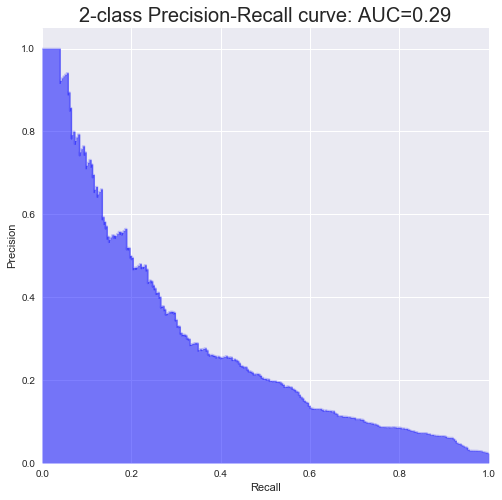


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


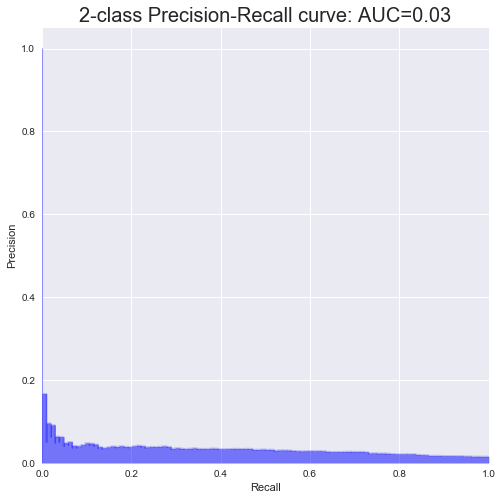

 
Iteration : 71 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 200, [400, 200]]
__________________________________________________________________

Accuracy - Training:  91.66%
Accuracy - test    :  90.70%

AUC Performance
AUC - Training     : 0.9090
AUC - Test         : 0.6769


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.92      0.96     20614
          1       0.09      0.61      0.16       275

avg / total       0.98      0.92      0.95     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.92      0.95      6860
          1       0.04      0.22      0.07       104

avg / total       0.97      0.91      0.94      6964


  Confusion Matrix - Train 
[[18979   107]
 [ 1635   168]]


  Confusion Matrix - Test 
[[6293   81]
 

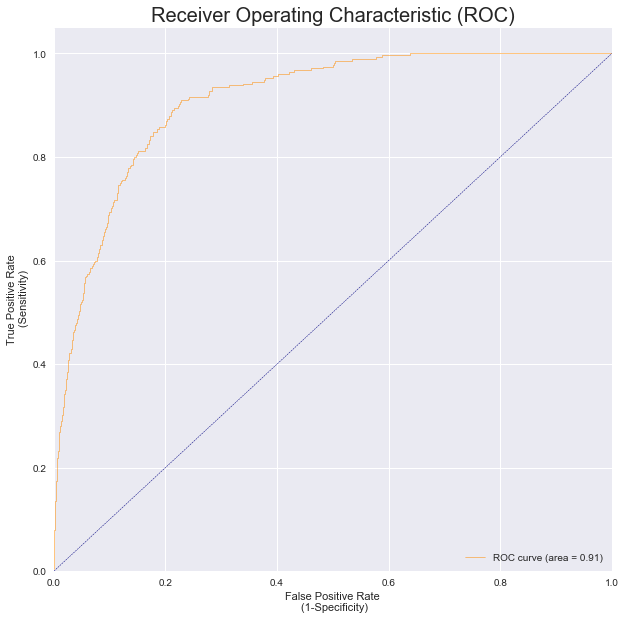


  Test AUC 


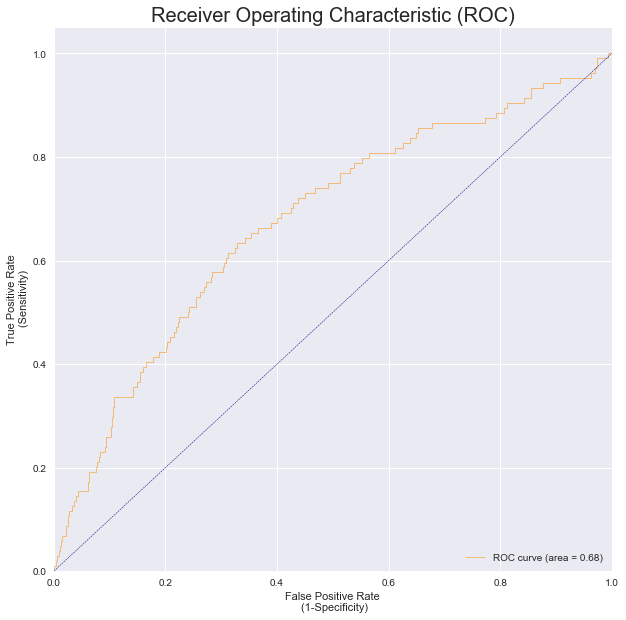


  Train Precission - Recall Curve 
Average precision-recall score: 0.20


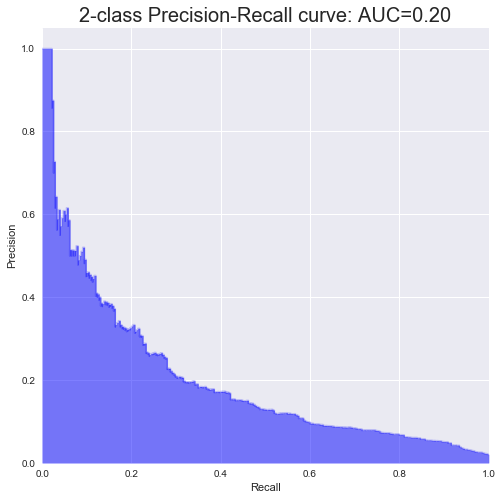


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


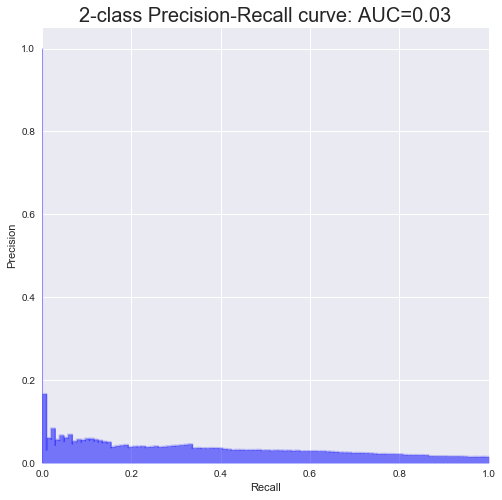

 
Iteration : 72 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 max depth : num trees : split & leaf 
 [5, 200, [1000, 500]]
__________________________________________________________________

Accuracy - Training:  86.54%
Accuracy - test    :  86.06%

AUC Performance
AUC - Training     : 0.8651
AUC - Test         : 0.6708


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.62      0.11       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.92      6860
          1       0.04      0.36      0.07       104

avg / total       0.97      0.86      0.91      6964


  Confusion Matrix - Train 
[[17908   105]
 [ 2706   170]]


  Confusion Matrix - Test 
[[5956   67]


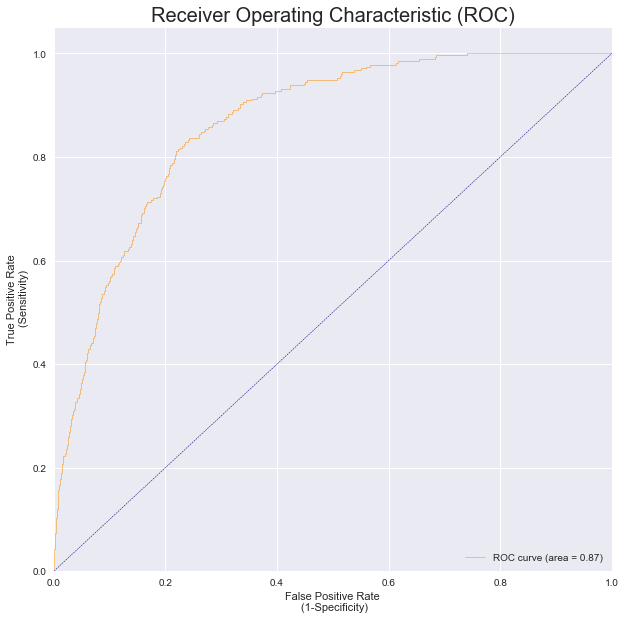


  Test AUC 


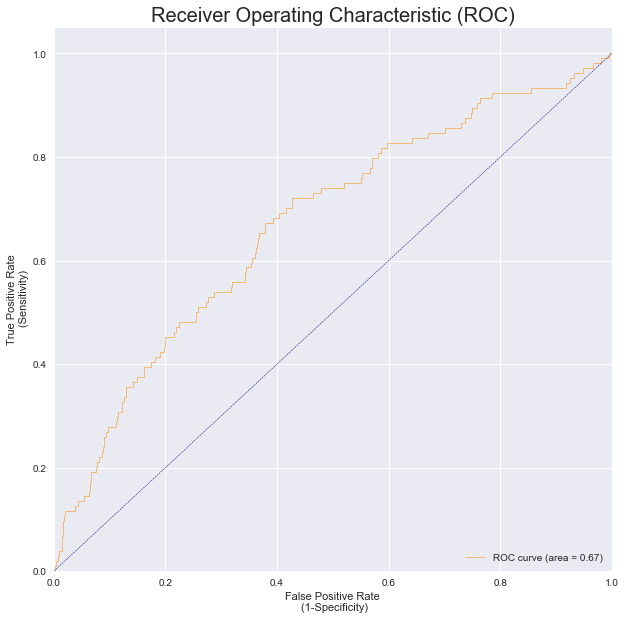


  Train Precission - Recall Curve 
Average precision-recall score: 0.12


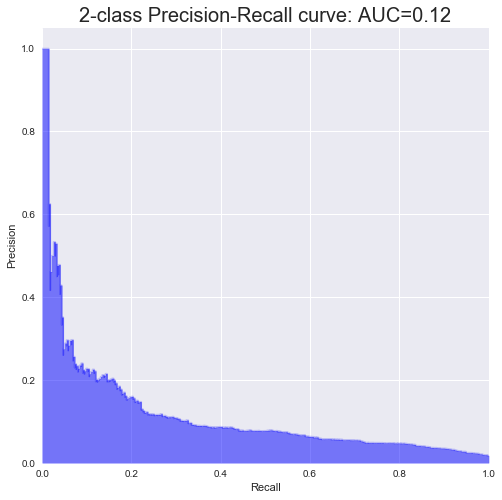


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


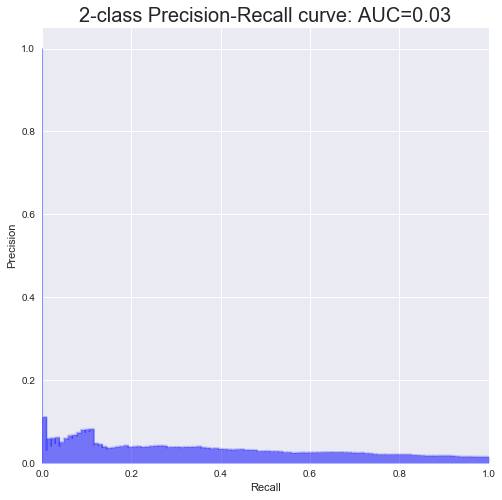

In [76]:
warnings.filterwarnings("ignore")

Model_Parameter_list = []
NPV_test_list =[]
NPV_train_list =[]
Specivity_test_list =[]
Specivity_train_list =[]
target_size_test_pct_list =[]
target_size_train_pct_list =[]
target_size_test_list =[]
target_size_train_list =[]
lift_test_list =[]
lift_train_list =[]
Prevalance_Test_Pct_list =[]
Prevalance_Train_Pct_list =[]
Prevalance_Test_list =[]
Prevalance_Train_list =[]
AUC_Test_list =[]
AUC_Train_list =[]
f1_score_test_list =[]
f1_score_train_list =[]
Recall_test_list =[]
Recall_train_list =[]
Precision_test_list =[]
Precision_train_list =[]
mat_test_list =[]
mat_train_list =[]
y_accuracy_test_list =[]
y_accuracy_train_list =[]

# clf = train_model(clf_random_forest)
# var_dict = metric_calculation(clf)
# metric_display(var_dict)
# append_metrics(var_dict)
# df = tabualte_grid_search()
# # AUC_CURVE_PLOT(y_train,var_dict['y_train_score_classifier'][:,1])
# AUC_CURVE_PLOT(y_test,var_dict['y_test_score_classifier'][:,1])
# df.T

# AUC= {}
algo = 'Random Forest'
n_trees = [25,50,100,200]
max_depth = np.arange(3,6,1)
split_leaf = [[10,5],[50,25],[100,50],[200,100],[400,200],[1000,500]]
hyperparameter = "max depth : num trees : split & leaf"
iteration = 0
for i in max_depth:
    for j in n_trees:
        for k in split_leaf:
            iteration += 1
            
            Bold = "\033[1m"
            Underline = "\033[4m"
            end = "\033[0;0m"
            
            print(Bold,"\nIteration : {}" .format(iteration), end )
            split, leaf = k
            m = [i,j,k]
            model = RandomForestClassifier(n_estimators=j,
                                           class_weight='balanced',
#                                          {0: 1, 1: 5},
                                           min_samples_split=split,
                                           min_samples_leaf=leaf,
                                           random_state=12345,
                                           max_depth=i,n_jobs=-1)
            header(algo, hyperparameter,m)
            clf = train_model(model)
            var_dict = metric_calculation(clf)
            metric_display(var_dict)
            append_metrics(var_dict)
            
            print()
            print(Bold,Underline,"Train AUC", end )
            auc_curve_plot(y_train,var_dict['y_train_score_classifier'][:,1])  
            
            print()
            print(Bold,Underline,"Test AUC", end )
            auc_curve_plot(y_test,var_dict['y_test_score_classifier'][:,1])
            
            print()
            print(Bold,Underline,"Train Precission - Recall Curve", end )
            precission_recall_curve_plot(y_train, var_dict['y_train_score_classifier'][:,1])
            
            print()
            print(Bold,Underline,"Test Precission - Recall Curve", end )
            precission_recall_curve_plot(y_test, var_dict['y_test_score_classifier'][:,1])

In [127]:
df = tabualte_grid_search()
df.T.to_csv('Model Performance/Random Forest Controlled.csv')

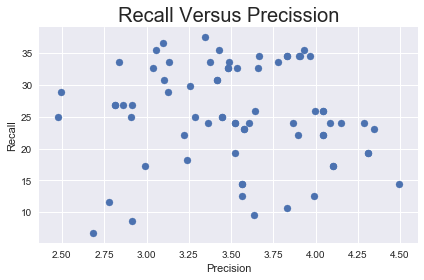

In [72]:
z = Summary_Performance_RF['7_Sensitivity']
y = Summary_Performance_RF['5_PPV']

plt.scatter(y,z)
# plt.ylim(30,60)
# plt.xlim(2,5)
plt.ylabel('Recall')
plt.xlabel('Precision')
plt.title('Recall Versus Precission', fontsize=20)
plt.tight_layout()



### Random Forest - Final model

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Random Forest 
 
 Hyperparamter :  
 Trees = 200 :  Depth = 3 : split =  10 : leaf = 5 
 Final Model
__________________________________________________________________

Accuracy - Training:  86.76%
Accuracy - test    :  86.52%

AUC Performance
AUC - Training     : 0.8359
AUC - Test         : 0.6753


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93     20614
          1       0.06      0.58      0.10       275

avg / total       0.98      0.87      0.92     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.87      0.93      6860
          1       0.04      0.35      0.07       104

avg / total       0.97      0.87      0.91      6964


  Confusion Matrix - Train 
[[17964   115]
 [ 2650   160]]


  Confusion Matrix - Test 
[[5989   68]
 [ 871   36]]



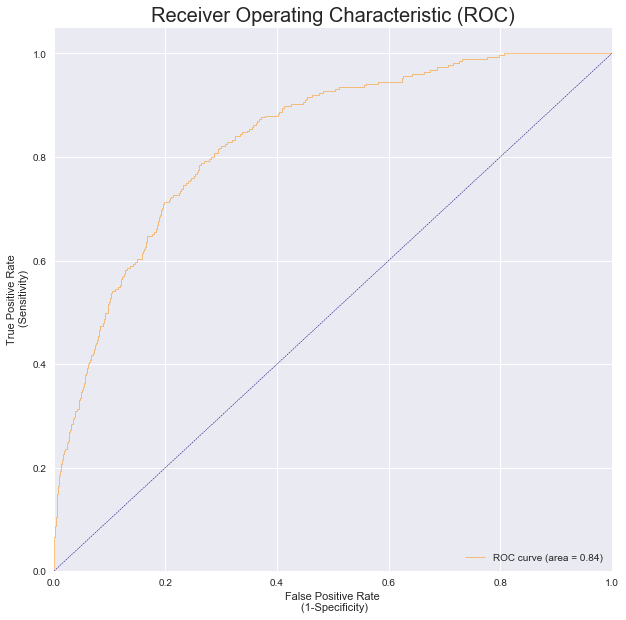


  Test AUC 


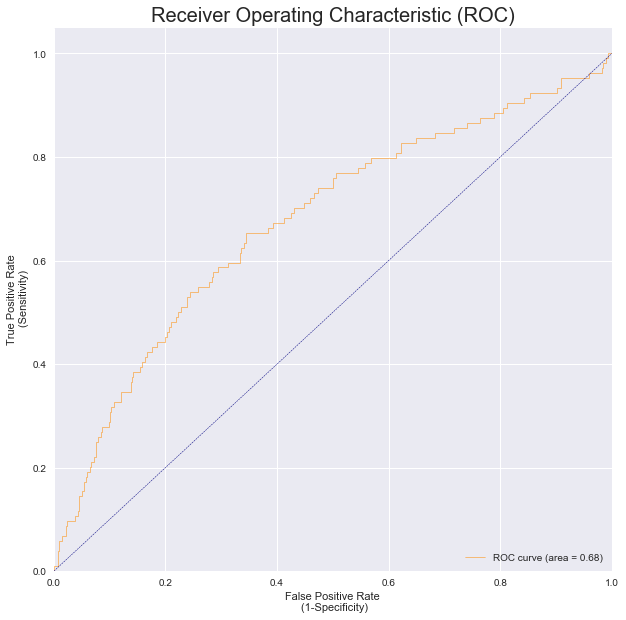


  Train Precission - Recall Curve 
Average precision-recall score: 0.12


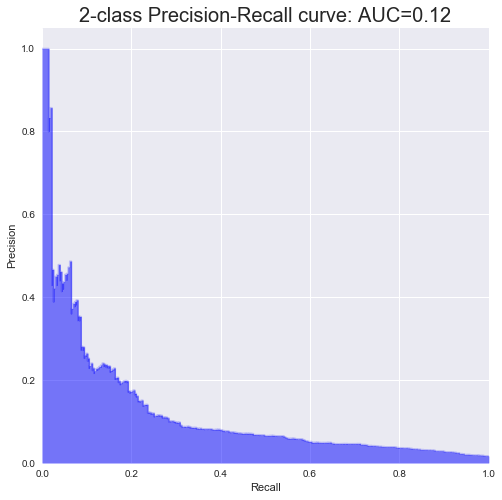


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


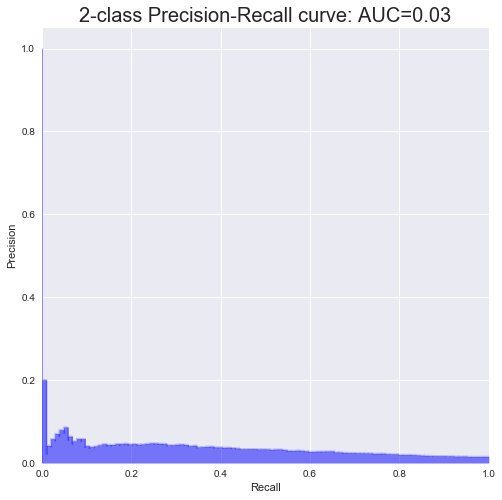

In [77]:
warnings.filterwarnings("ignore")

Model_Parameter_list = ['']
NPV_test_list =[]
NPV_train_list =[]
Specivity_test_list =[]
Specivity_train_list =[]
target_size_test_pct_list =[]
target_size_train_pct_list =[]
target_size_test_list =[]
target_size_train_list =[]
lift_test_list =[]
lift_train_list =[]
Prevalance_Test_Pct_list =[]
Prevalance_Train_Pct_list =[]
Prevalance_Test_list =[]
Prevalance_Train_list =[]
AUC_Test_list =[]
AUC_Train_list =[]
f1_score_test_list =[]
f1_score_train_list =[]
Recall_test_list =[]
Recall_train_list =[]
Precision_test_list =[]
Precision_train_list =[]
mat_test_list =[]
mat_train_list =[]
y_accuracy_test_list =[]
y_accuracy_train_list =[]

algo ='Random Forest'
m = "Final Model"
hyperparameter = "Trees = 200 :  Depth = 3 : split =  10 : leaf = 5"

clf_random_forest = RandomForestClassifier(max_depth=3,
                               n_estimators=200,
                               min_samples_split=10,
                               min_samples_leaf=5,
                               class_weight='balanced',
#                                            {0: 1, 1: 5},
                               random_state=12345,
                               n_jobs=-1)
header(algo, hyperparameter,m)
clf = train_model(clf_random_forest)
var_dict = metric_calculation(clf)
metric_display(var_dict)
print()
print(Bold,Underline,"Train AUC", end )
auc_curve_plot(y_train,var_dict['y_train_score_classifier'][:,1])  

print()
print(Bold,Underline,"Test AUC", end )
auc_curve_plot(y_test,var_dict['y_test_score_classifier'][:,1])

print()
print(Bold,Underline,"Train Precission - Recall Curve", end )
precission_recall_curve_plot(y_train, var_dict['y_train_score_classifier'][:,1])

print()
print(Bold,Underline,"Test Precission - Recall Curve", end )
precission_recall_curve_plot(y_test, var_dict['y_test_score_classifier'][:,1])

In [136]:
clf_random_forest

RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=3, max_features='auto',
            max_leaf_nodes=None, min_impurity_split=1e-07,
            min_samples_leaf=5, min_samples_split=10,
            min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=-1,
            oob_score=False, random_state=12345, verbose=0,
            warm_start=False)

### Neural Network

 
Iteration : 1 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[10, 10, 10], 0.001]
__________________________________________________________________

Accuracy - Training:  99.46%
Accuracy - test    :  97.47%

AUC Performance
AUC - Training     : 0.9921
AUC - Test         : 0.6014


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      1.00     20614
          1       0.97      0.61      0.75       275

avg / total       0.99      0.99      0.99     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.99      0.99      6860
          1       0.04      0.03      0.03       104

avg / total       0.97      0.97      0.97      6964


  Confusion Matrix - Train 
[[20609   107]
 [    5   168]]


  Confusion Matrix - Test 
[[6785  101]
 [  75    3]]



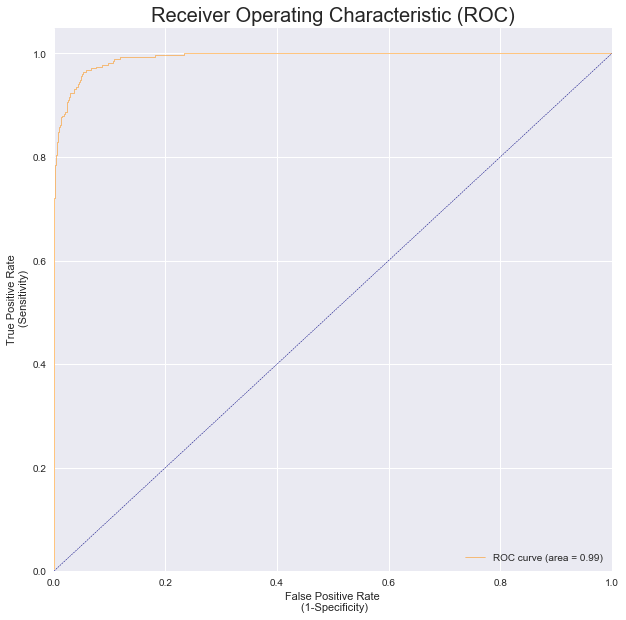


  Test AUC 


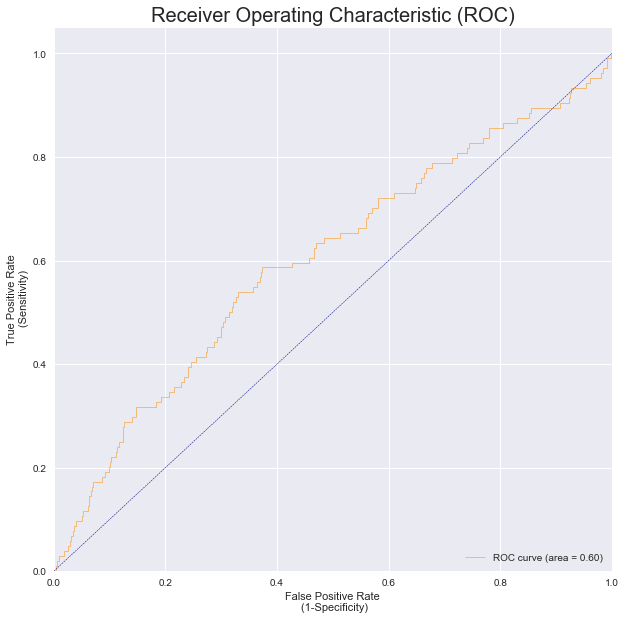


  Train Precission - Recall Curve 
Average precision-recall score: 0.85


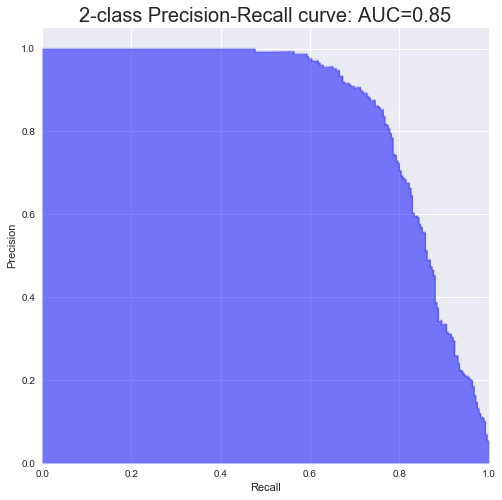


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


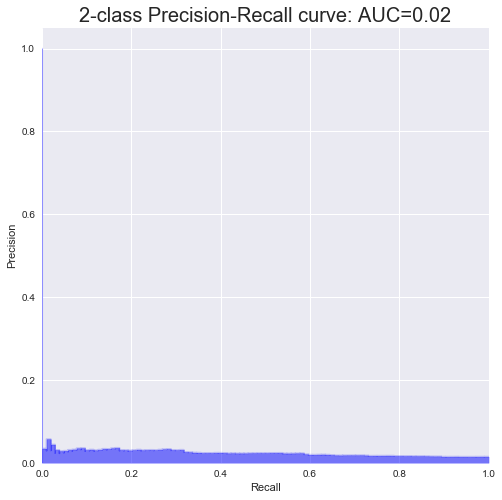

 
Iteration : 2 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[10, 10, 10], 0.01]
__________________________________________________________________

Accuracy - Training:  99.47%
Accuracy - test    :  97.70%

AUC Performance
AUC - Training     : 0.9894
AUC - Test         : 0.5923


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      1.00     20614
          1       0.97      0.62      0.75       275

avg / total       0.99      0.99      0.99     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.99      0.99      6860
          1       0.08      0.05      0.06       104

avg / total       0.97      0.98      0.97      6964


  Confusion Matrix - Train 
[[20608   105]
 [    6   170]]


  Confusion Matrix - Test 
[[6799   99]
 [  61    5]]




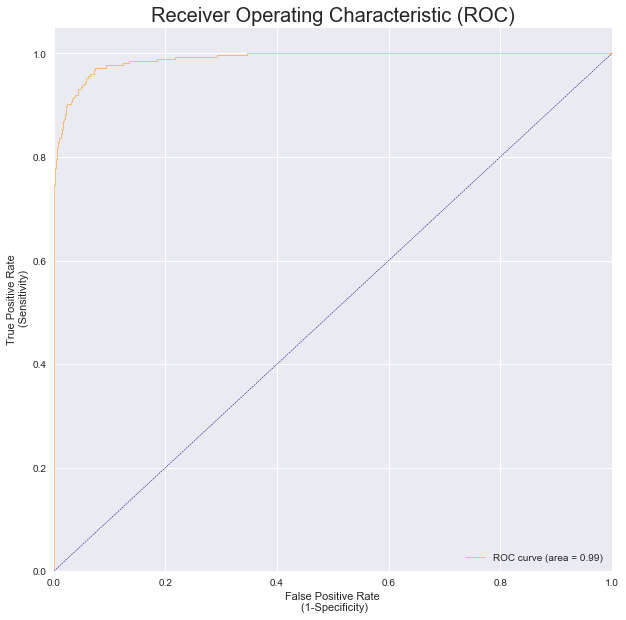


  Test AUC 


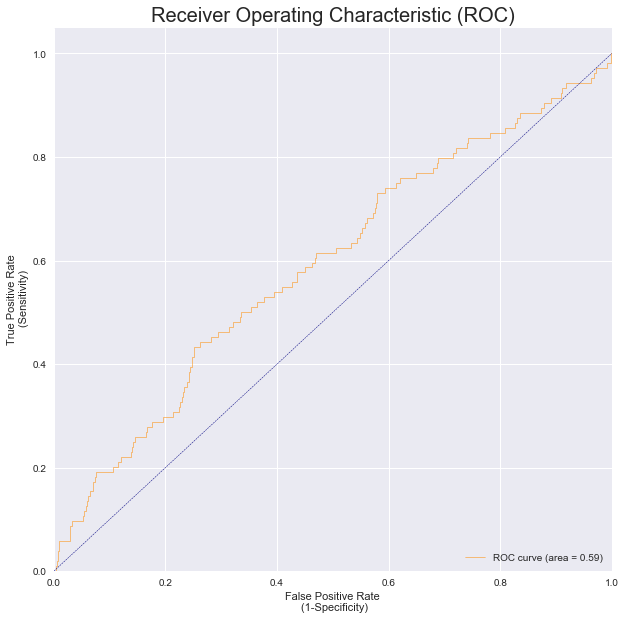


  Train Precission - Recall Curve 
Average precision-recall score: 0.84


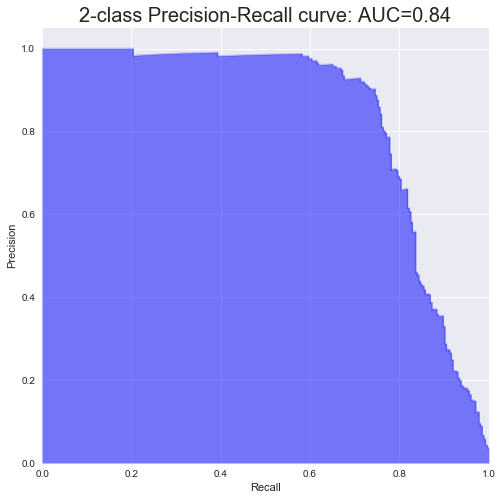


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


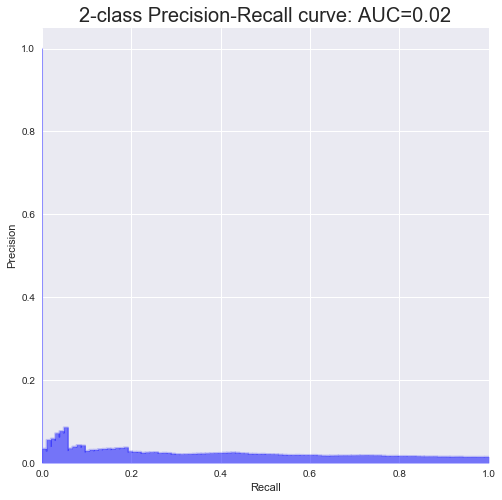

 
Iteration : 3 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[10, 10, 10], 1]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.7842
AUC - Test         : 0.6875


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  T

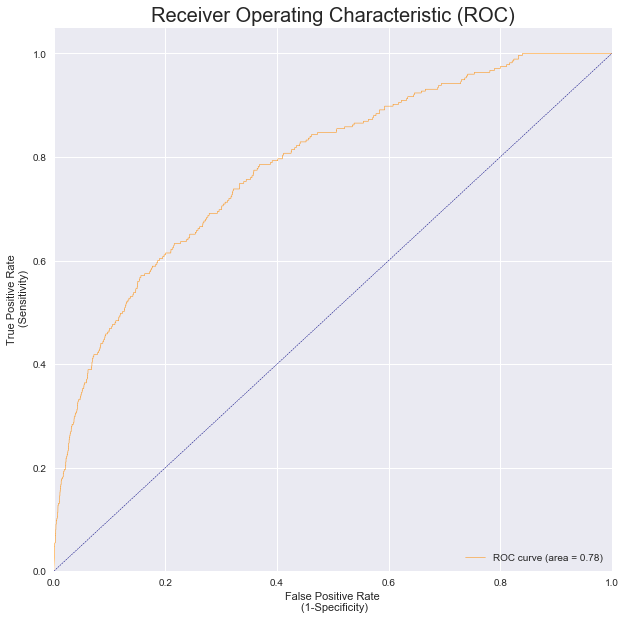


  Test AUC 


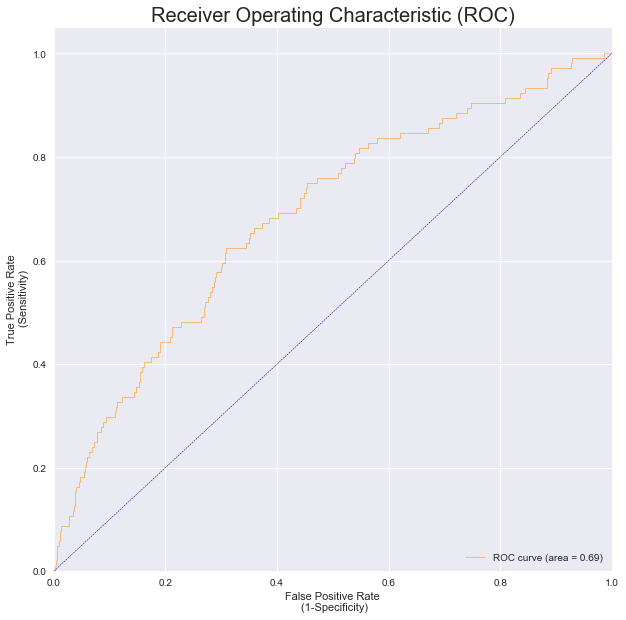


  Train Precission - Recall Curve 
Average precision-recall score: 0.10


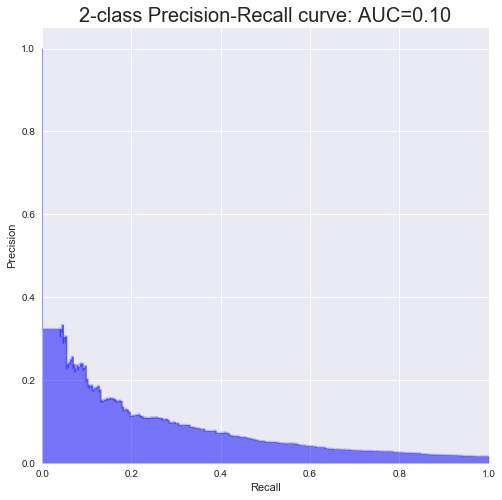


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


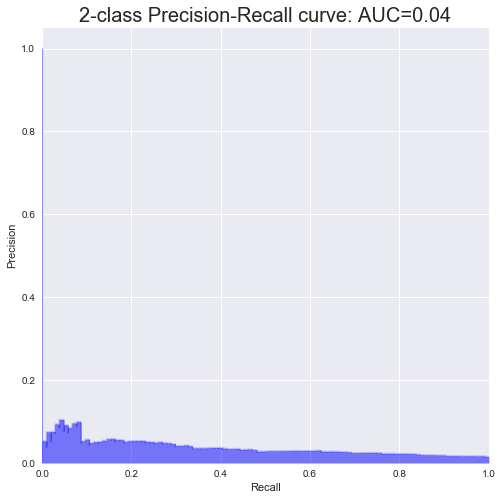

 
Iteration : 4 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[10, 10, 10], 2]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.6818
AUC - Test         : 0.6258


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  T

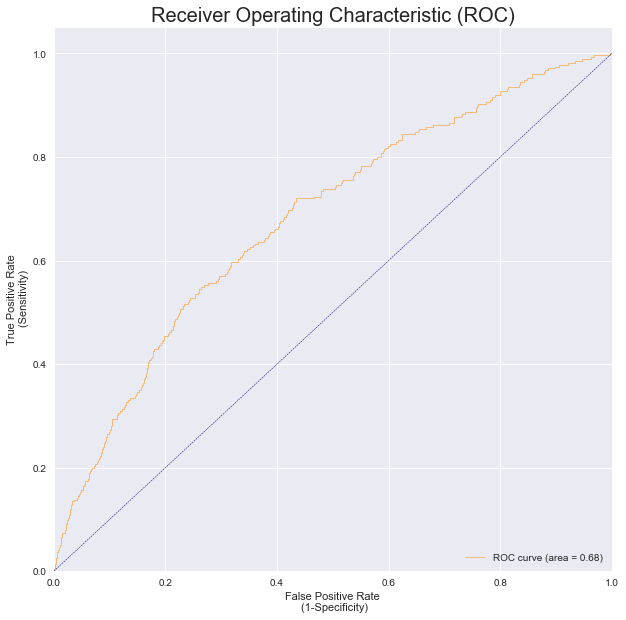


  Test AUC 


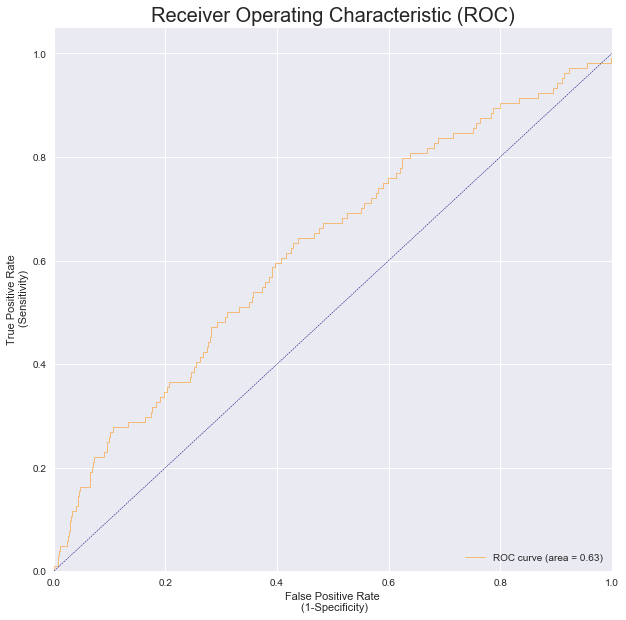


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


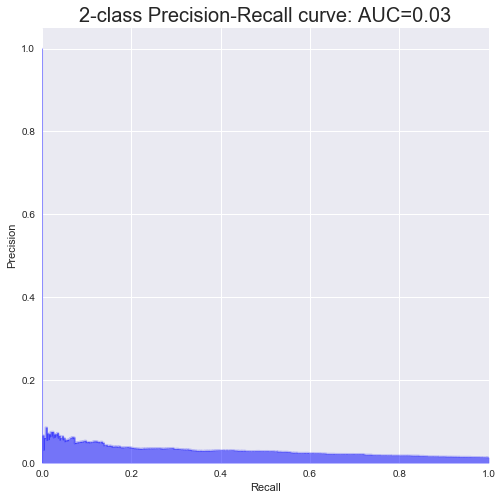


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


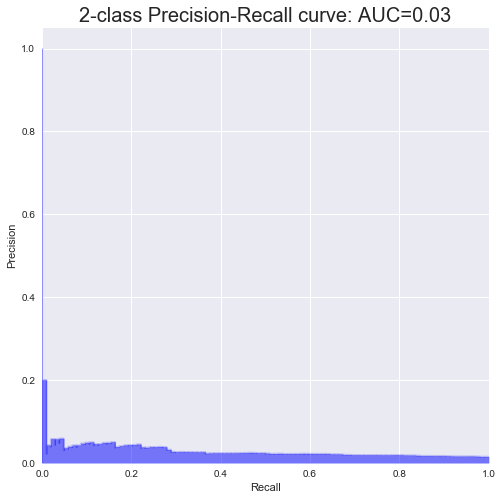

 
Iteration : 5 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[10, 10, 10], 3]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.6623
AUC - Test         : 0.6124


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  T

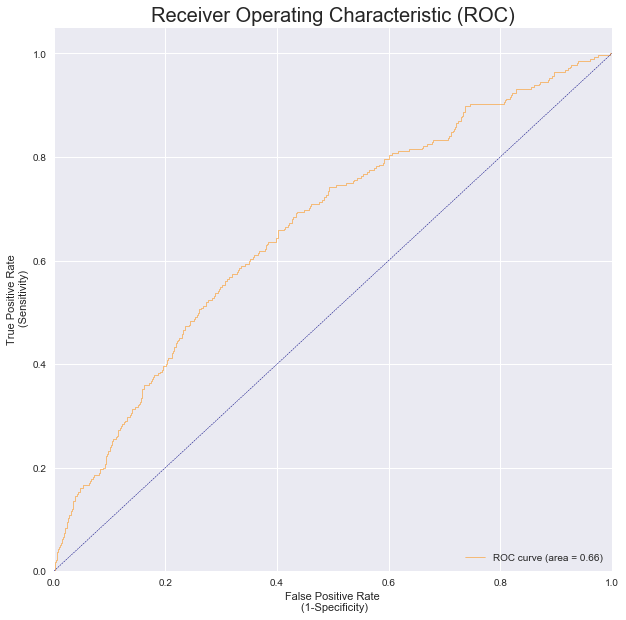


  Test AUC 


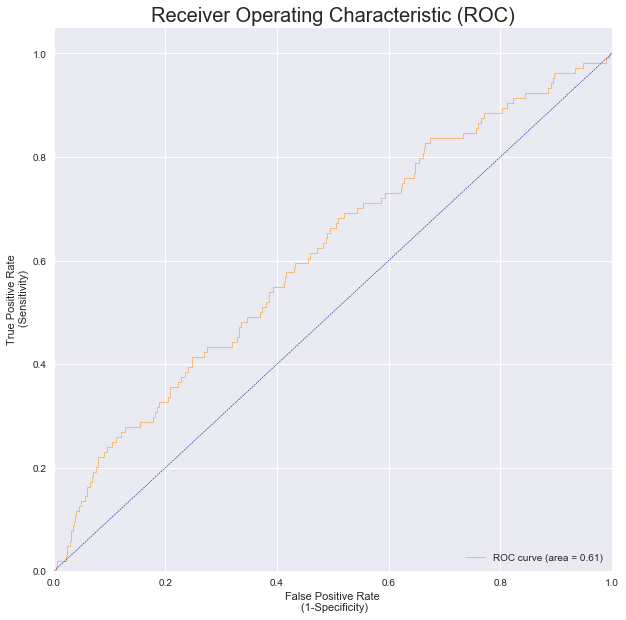


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


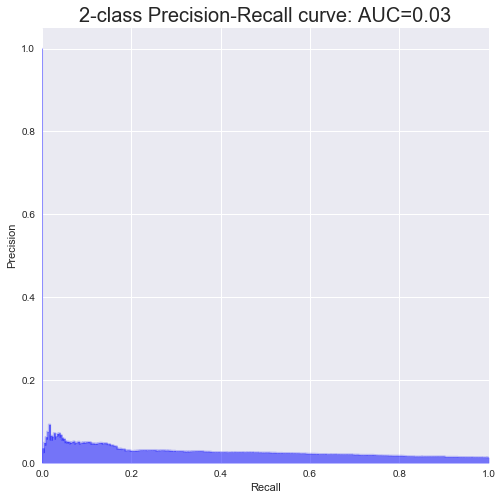


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


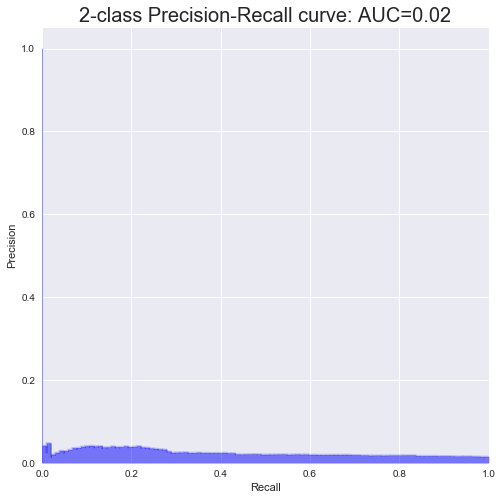

 
Iteration : 6 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[25, 25, 25], 0.001]
__________________________________________________________________

Accuracy - Training:  99.83%
Accuracy - test    :  98.05%

AUC Performance
AUC - Training     : 0.9999
AUC - Test         : 0.5593


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      1.00      1.00     20614
          1       0.99      0.88      0.93       275

avg / total       1.00      1.00      1.00     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.98      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.98      0.98      6964


  Confusion Matrix - Train 
[[20612    33]
 [    2   242]]


  Confusion Matrix - Test 
[[6828  104]
 [  32    0]]



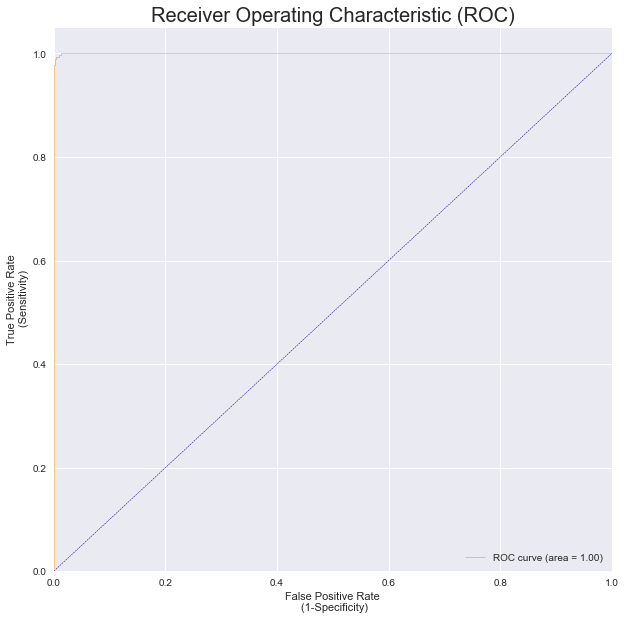


  Test AUC 


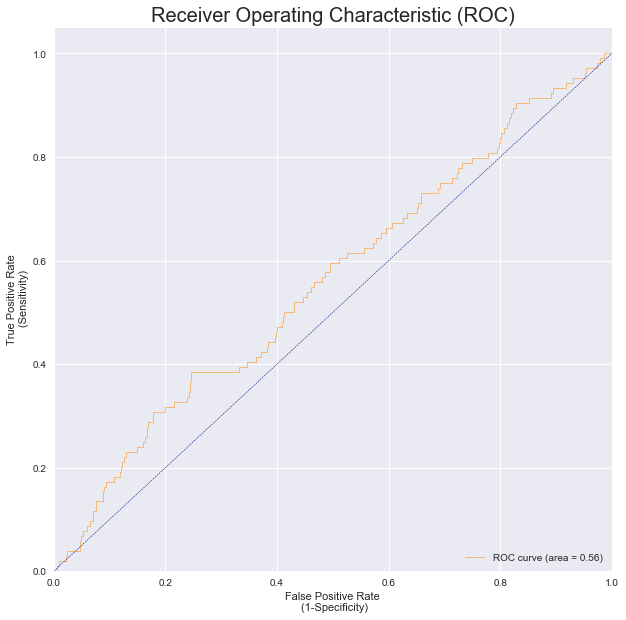


  Train Precission - Recall Curve 
Average precision-recall score: 0.99


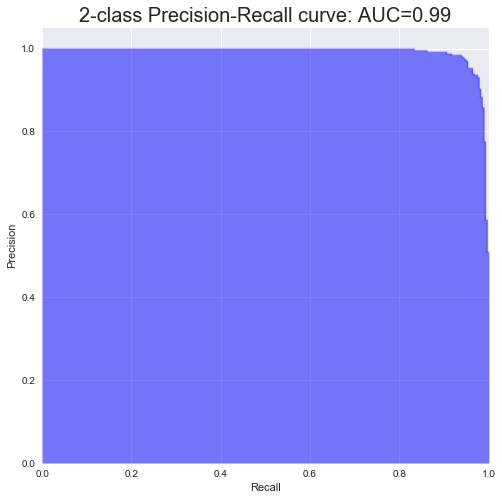


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


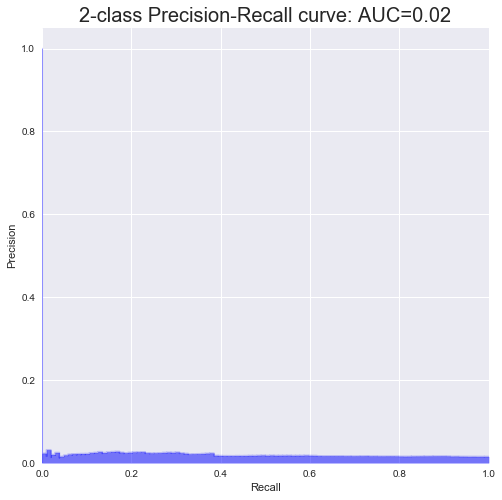

 
Iteration : 7 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[25, 25, 25], 0.01]
__________________________________________________________________

Accuracy - Training:  99.92%
Accuracy - test    :  97.69%

AUC Performance
AUC - Training     : 0.9997
AUC - Test         : 0.5414


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      1.00      1.00     20614
          1       0.99      0.95      0.97       275

avg / total       1.00      1.00      1.00     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.98      0.99      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.98      0.97      6964


  Confusion Matrix - Train 
[[20612    14]
 [    2   261]]


  Confusion Matrix - Test 
[[6803  104]
 [  57    0]]




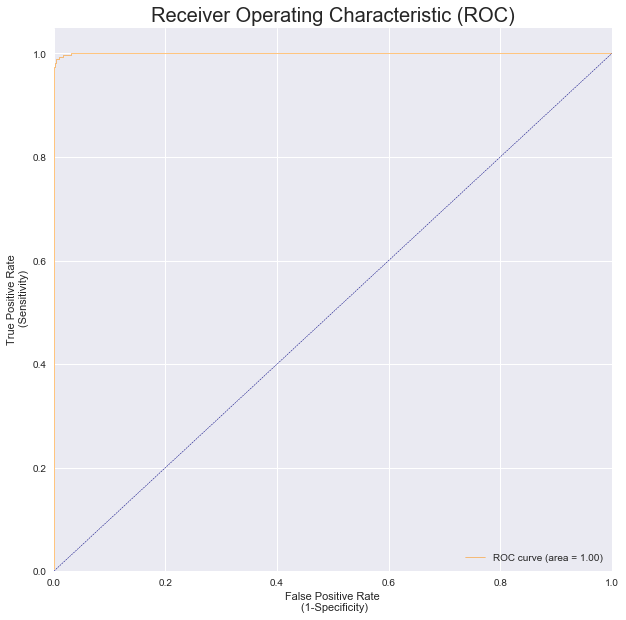


  Test AUC 


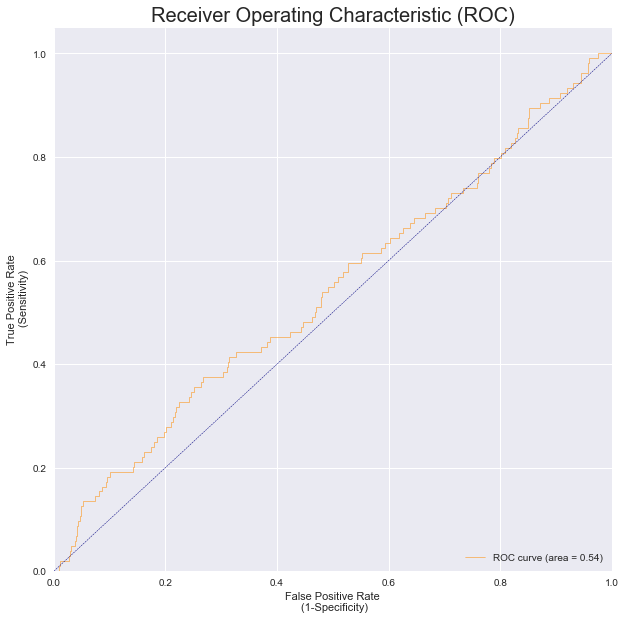


  Train Precission - Recall Curve 
Average precision-recall score: 0.99


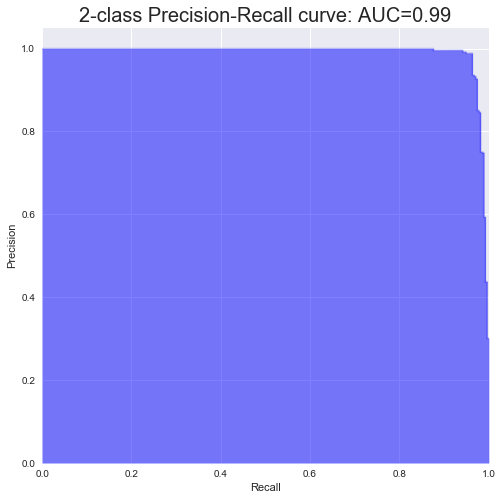


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


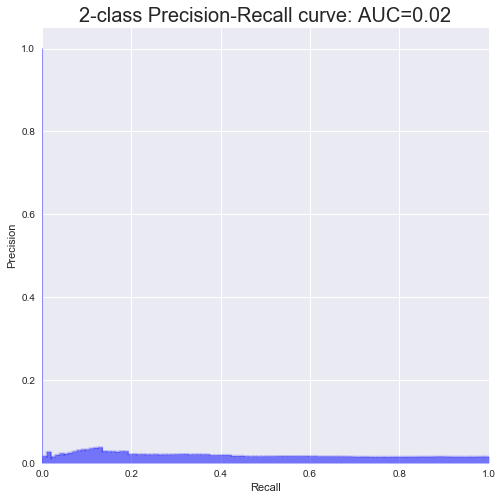

 
Iteration : 8 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[25, 25, 25], 1]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.7638
AUC - Test         : 0.6862


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  T

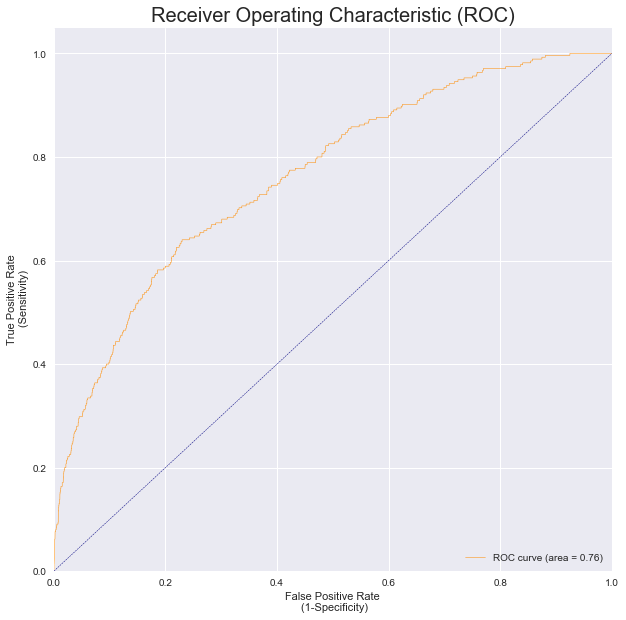


  Test AUC 


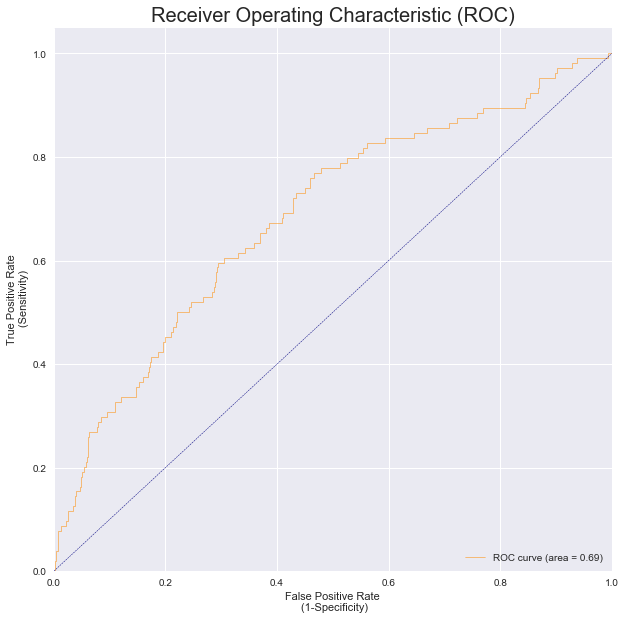


  Train Precission - Recall Curve 
Average precision-recall score: 0.08


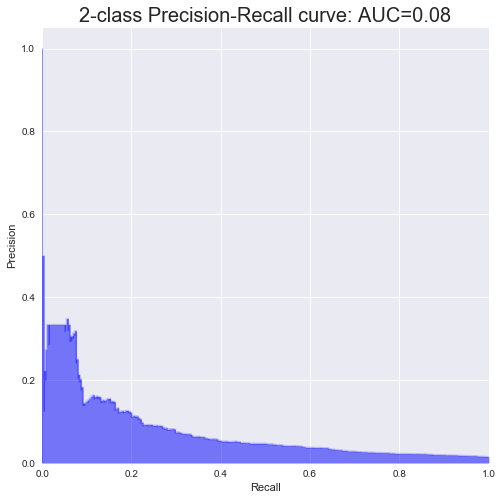


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


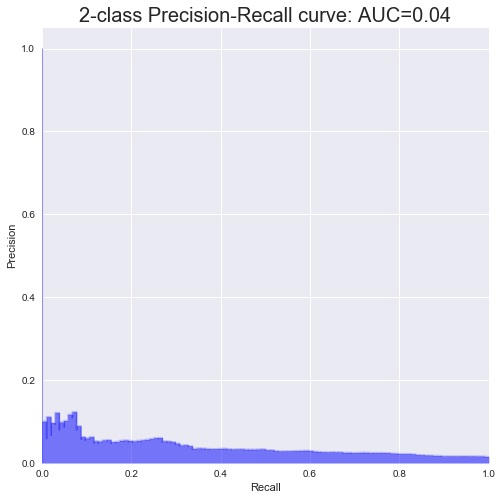

 
Iteration : 9 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[25, 25, 25], 2]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.6580
AUC - Test         : 0.5799


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  T

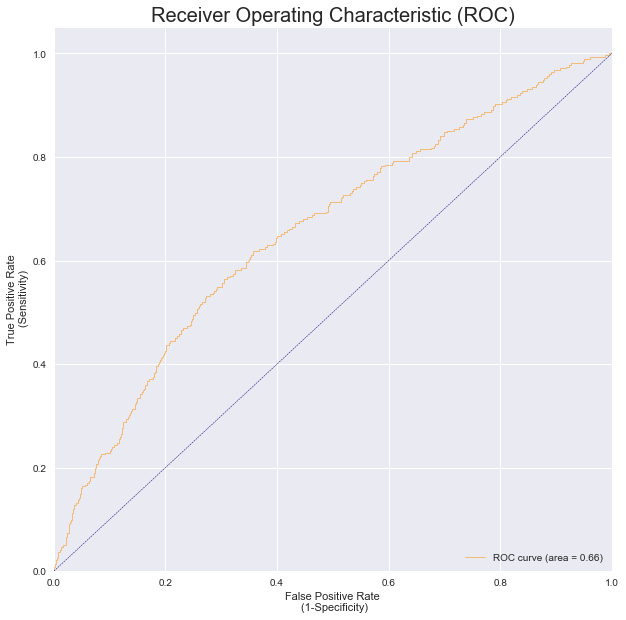


  Test AUC 


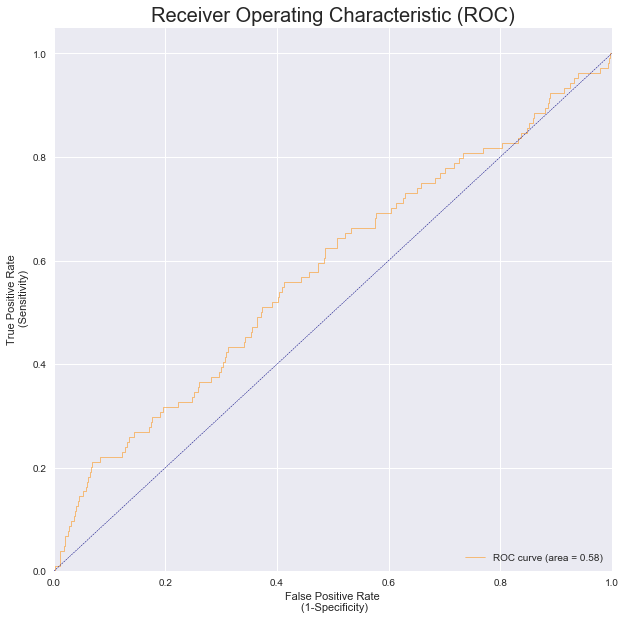


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


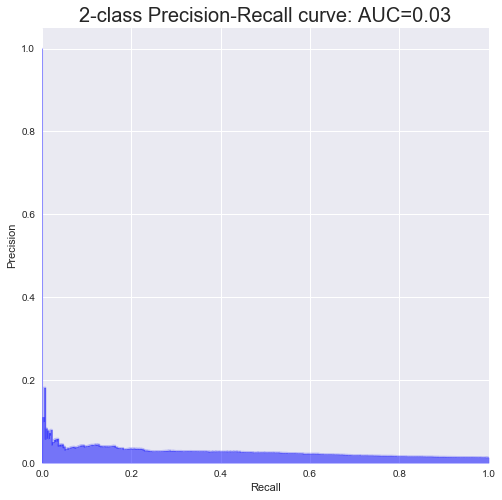


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


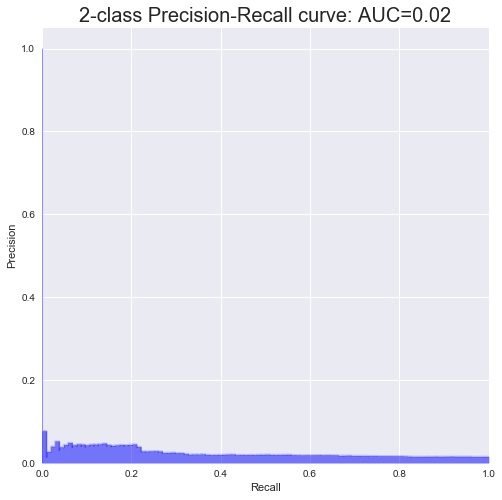

 
Iteration : 10 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[25, 25, 25], 3]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.6241
AUC - Test         : 0.5450


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  

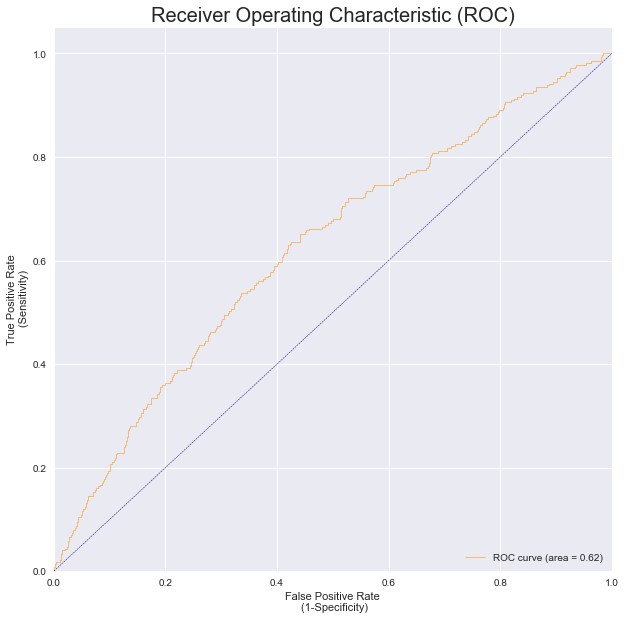


  Test AUC 


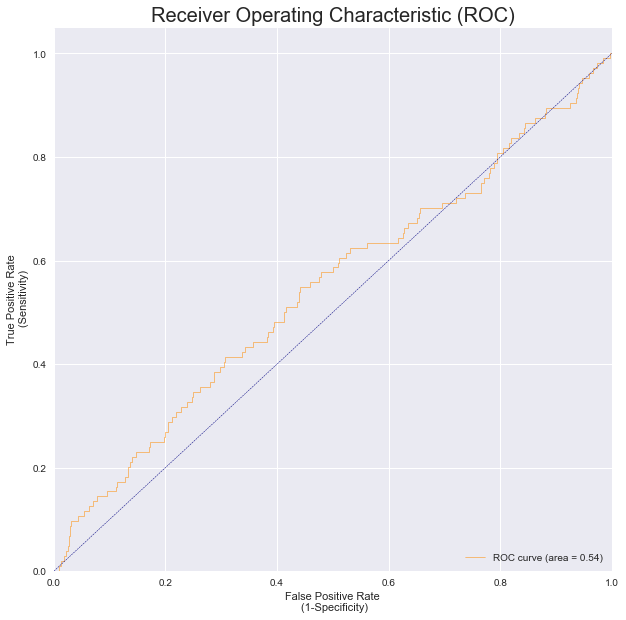


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


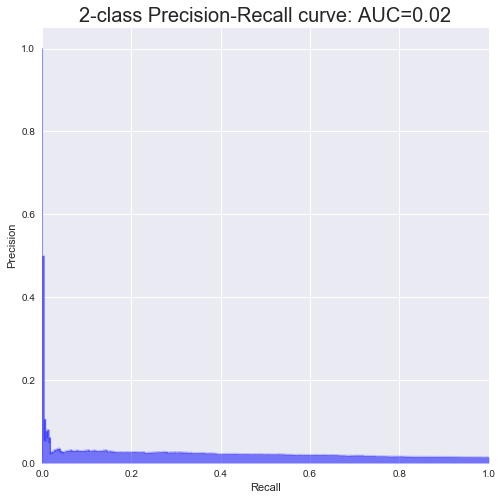


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


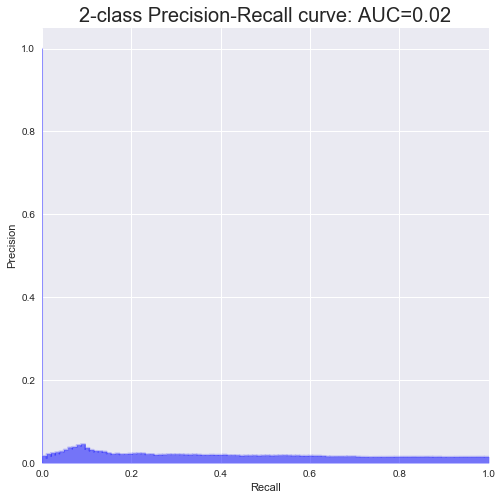

 
Iteration : 11 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[50, 50, 50], 0.001]
__________________________________________________________________

Accuracy - Training:  99.95%
Accuracy - test    :  97.96%

AUC Performance
AUC - Training     : 0.9999
AUC - Test         : 0.6004


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      1.00      1.00     20614
          1       0.99      0.97      0.98       275

avg / total       1.00      1.00      1.00     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.98      0.99      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.98      0.97      6964


  Confusion Matrix - Train 
[[20612     8]
 [    2   267]]


  Confusion Matrix - Test 
[[6822  104]
 [  38    0]]


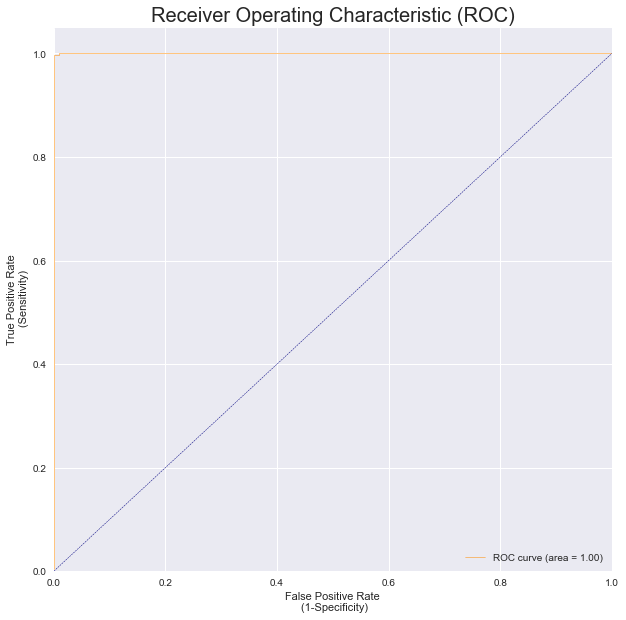


  Test AUC 


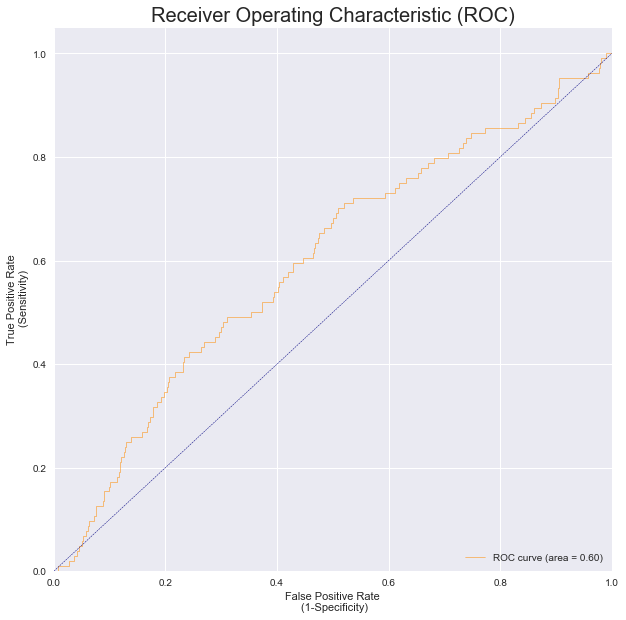


  Train Precission - Recall Curve 
Average precision-recall score: 1.00


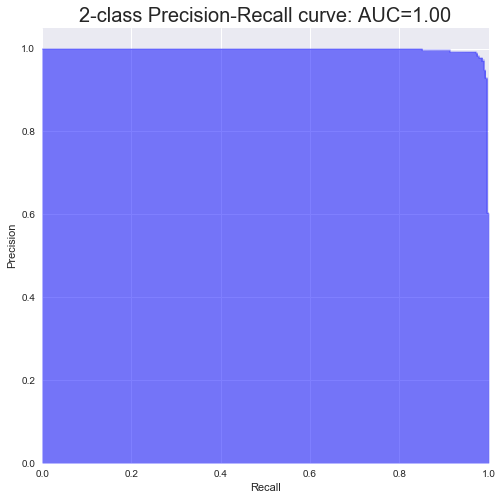


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


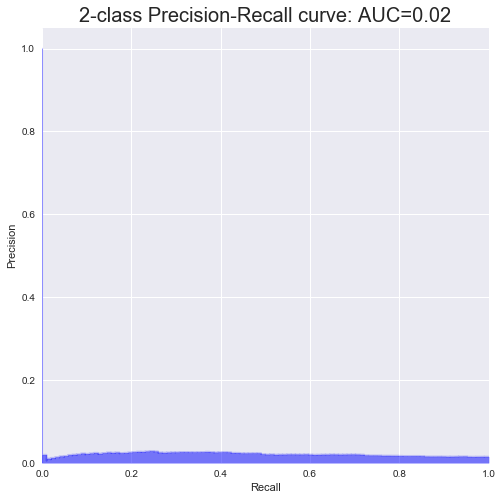

 
Iteration : 12 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[50, 50, 50], 0.01]
__________________________________________________________________

Accuracy - Training: 100.00%
Accuracy - test    :  98.15%

AUC Performance
AUC - Training     : 1.0000
AUC - Test         : 0.5906


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      1.00      1.00     20614
          1       1.00      1.00      1.00       275

avg / total       1.00      1.00      1.00     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.98      0.98      6964


  Confusion Matrix - Train 
[[20614     0]
 [    0   275]]


  Confusion Matrix - Test 
[[6835  104]
 [  25    0]]



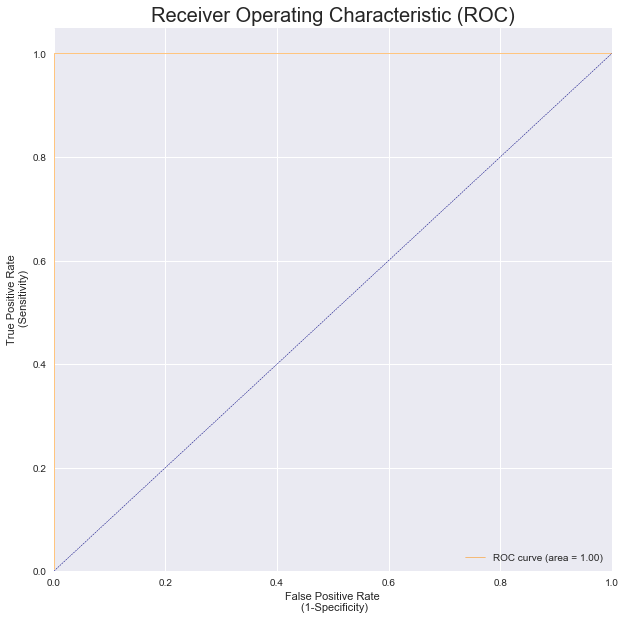


  Test AUC 


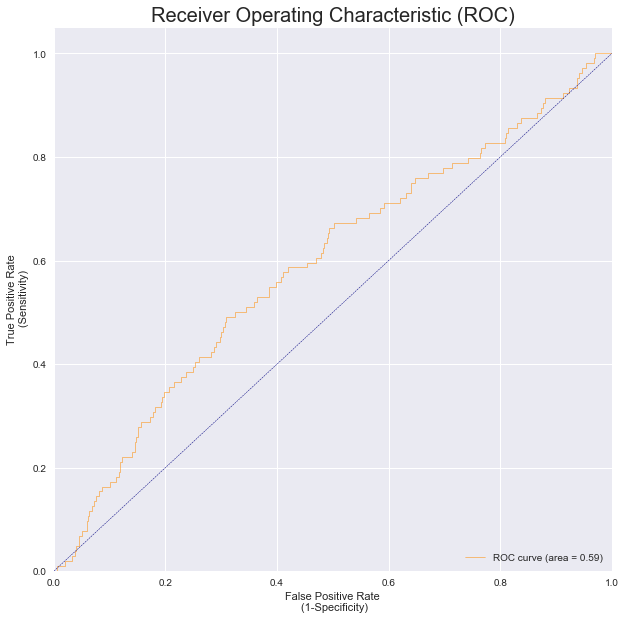


  Train Precission - Recall Curve 
Average precision-recall score: 1.00


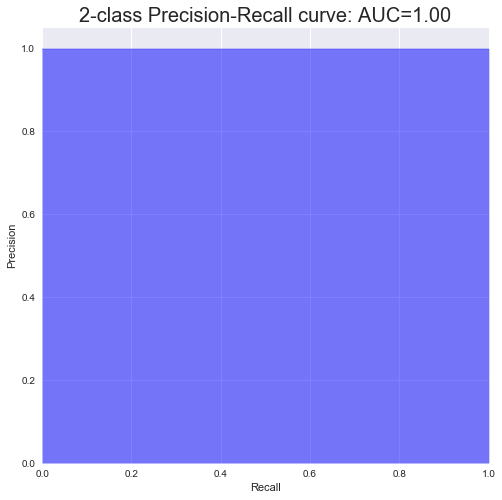


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


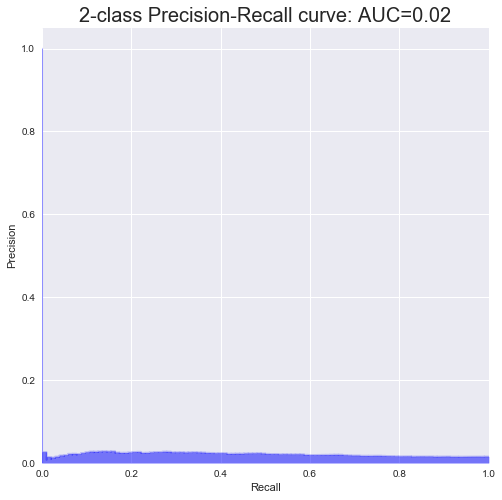

 
Iteration : 13 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[50, 50, 50], 1]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.7596
AUC - Test         : 0.6945


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  

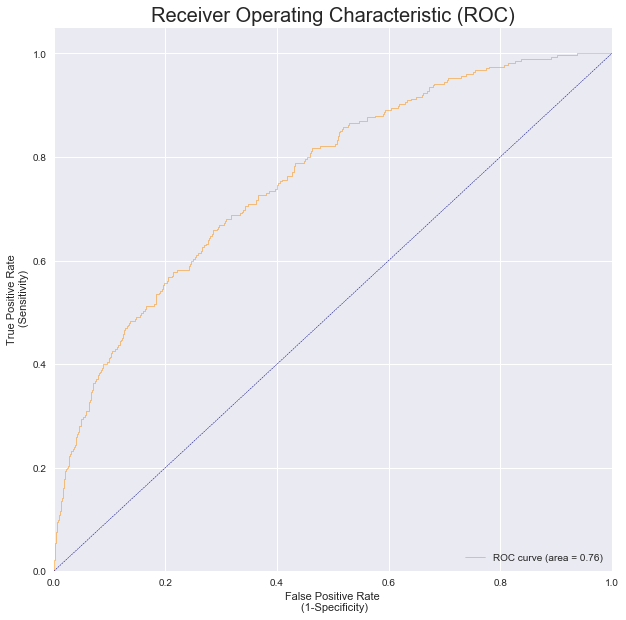


  Test AUC 


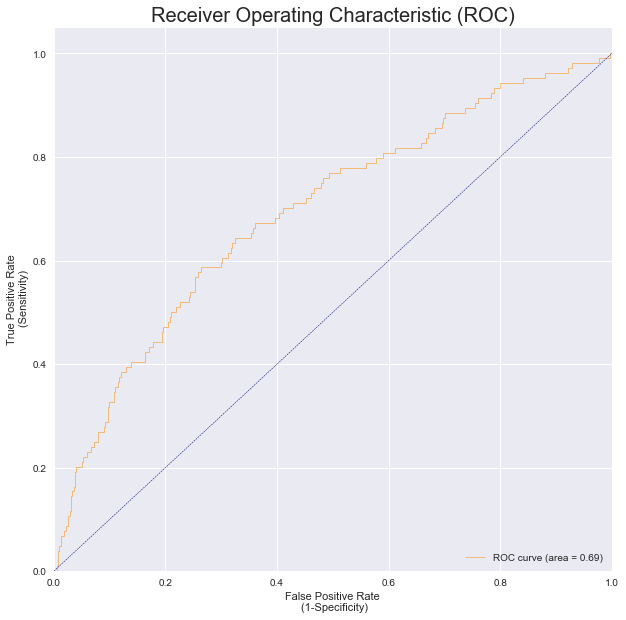


  Train Precission - Recall Curve 
Average precision-recall score: 0.06


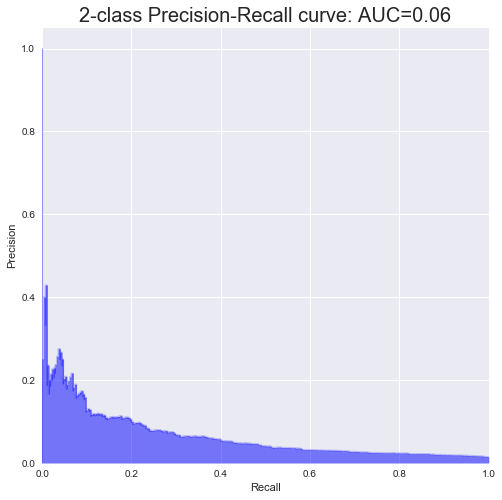


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


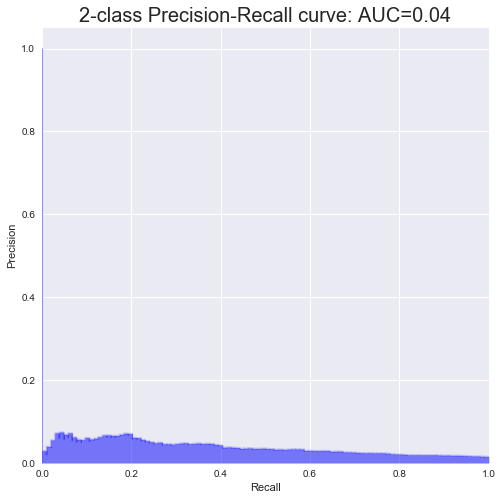

 
Iteration : 14 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[50, 50, 50], 2]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.6732
AUC - Test         : 0.6507


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  

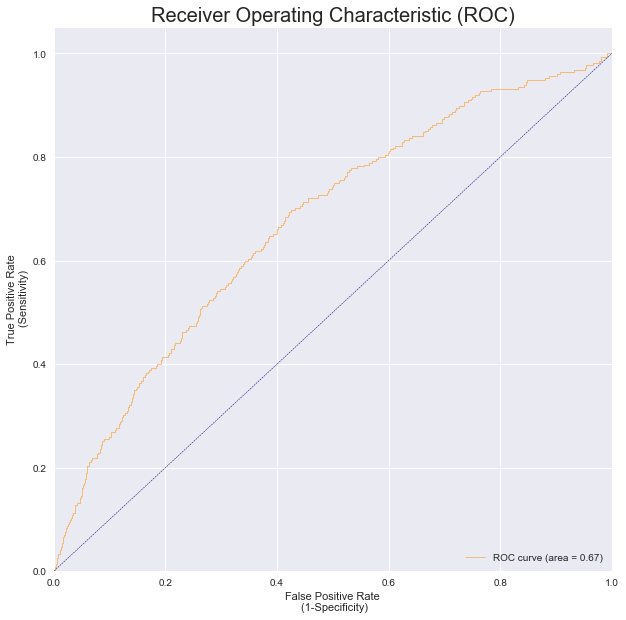


  Test AUC 


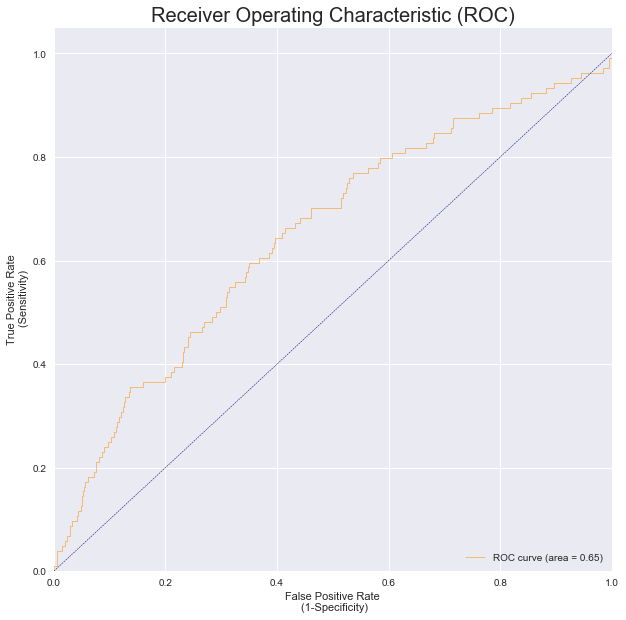


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


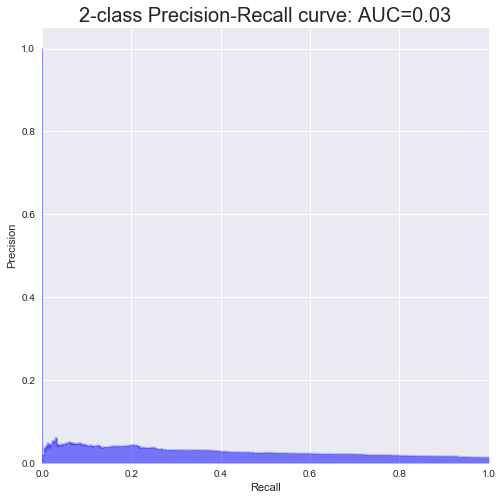


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


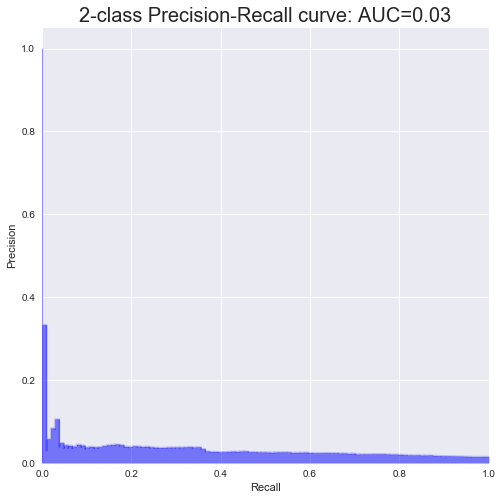

 
Iteration : 15 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[50, 50, 50], 3]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.6333
AUC - Test         : 0.6509


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]


  

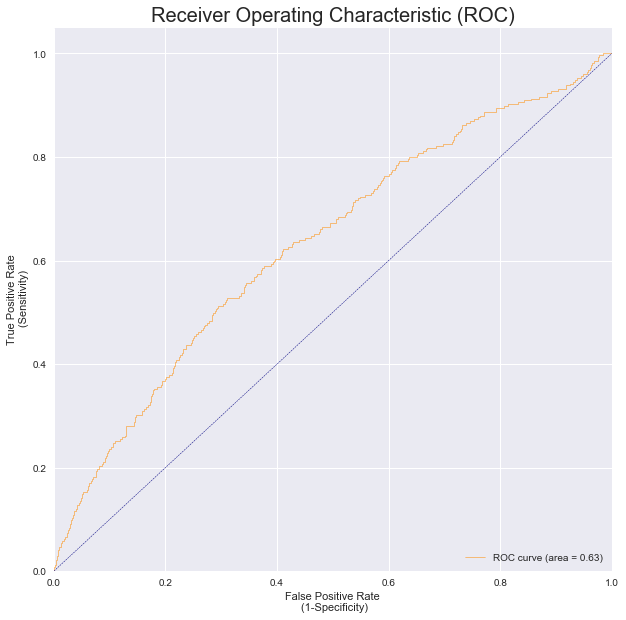


  Test AUC 


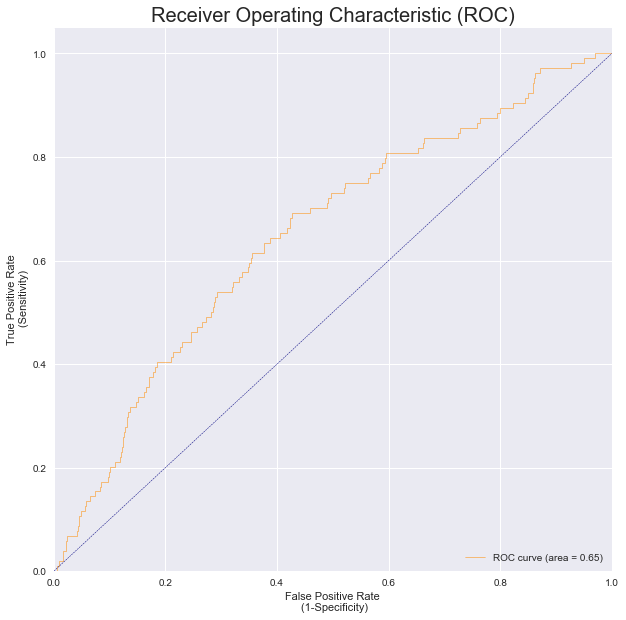


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


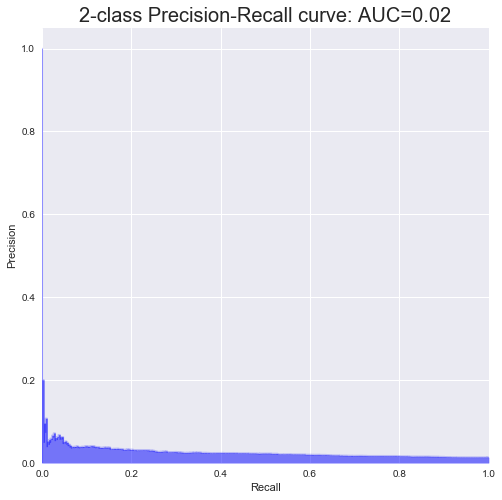


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


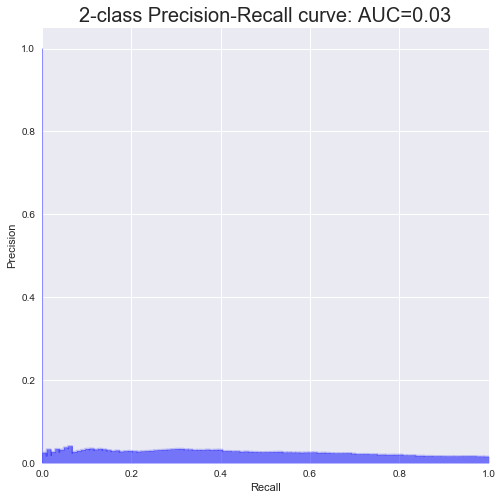

 
Iteration : 16 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[100, 100, 100], 0.001]
__________________________________________________________________

Accuracy - Training:  99.90%
Accuracy - test    :  97.87%

AUC Performance
AUC - Training     : 0.9999
AUC - Test         : 0.5372


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      1.00      1.00     20614
          1       0.93      0.99      0.96       275

avg / total       1.00      1.00      1.00     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.98      0.99      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.98      0.97      6964


  Confusion Matrix - Train 
[[20595     2]
 [   19   273]]


  Confusion Matrix - Test 
[[6816  104]
 [  44    0

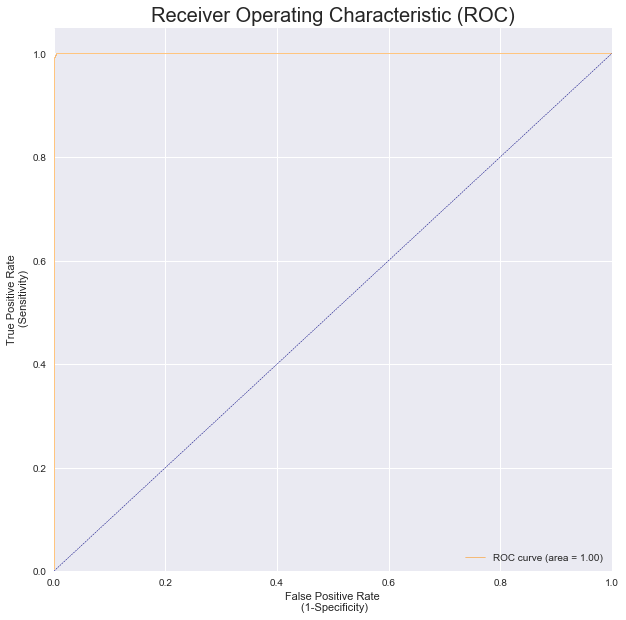


  Test AUC 


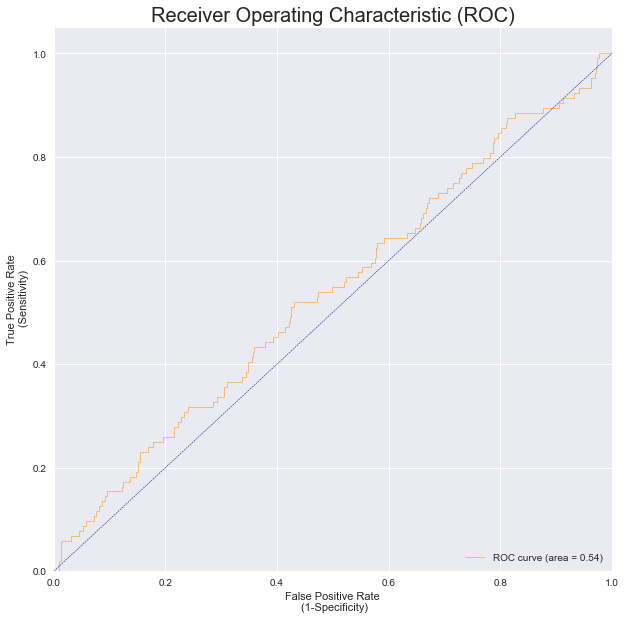


  Train Precission - Recall Curve 
Average precision-recall score: 1.00


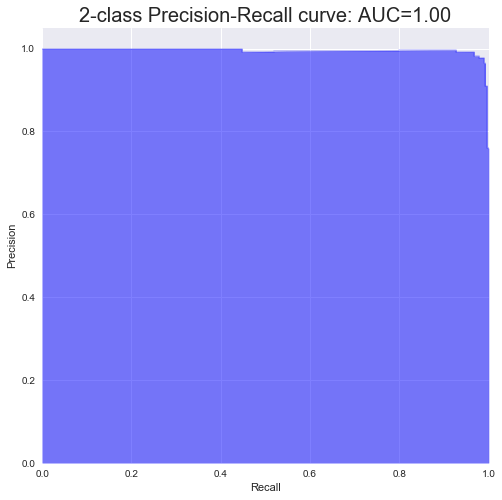


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


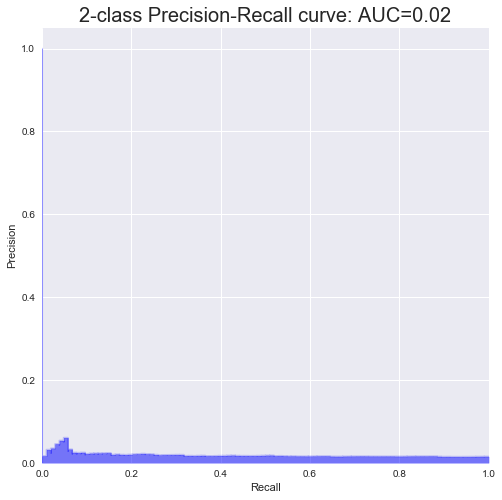

 
Iteration : 17 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[100, 100, 100], 0.01]
__________________________________________________________________

Accuracy - Training:  99.98%
Accuracy - test    :  98.32%

AUC Performance
AUC - Training     : 1.0000
AUC - Test         : 0.5565


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      1.00      1.00     20614
          1       1.00      0.99      0.99       275

avg / total       1.00      1.00      1.00     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.98      0.98      6964


  Confusion Matrix - Train 
[[20613     4]
 [    1   271]]


  Confusion Matrix - Test 
[[6847  104]
 [  13    0]

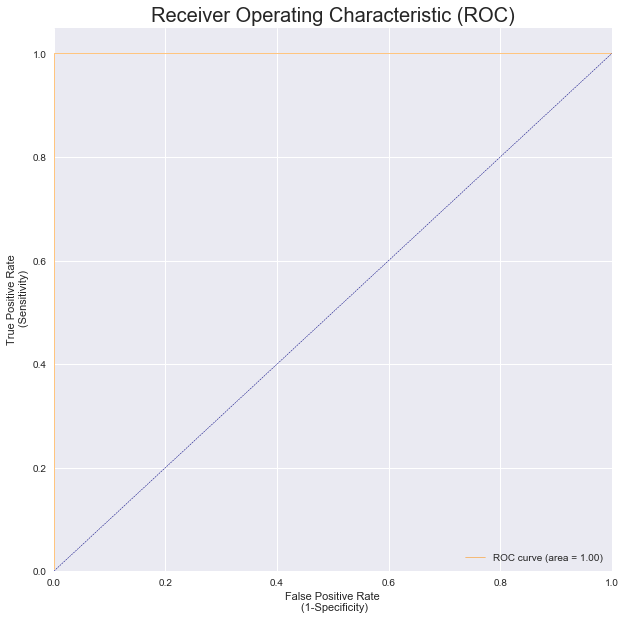


  Test AUC 


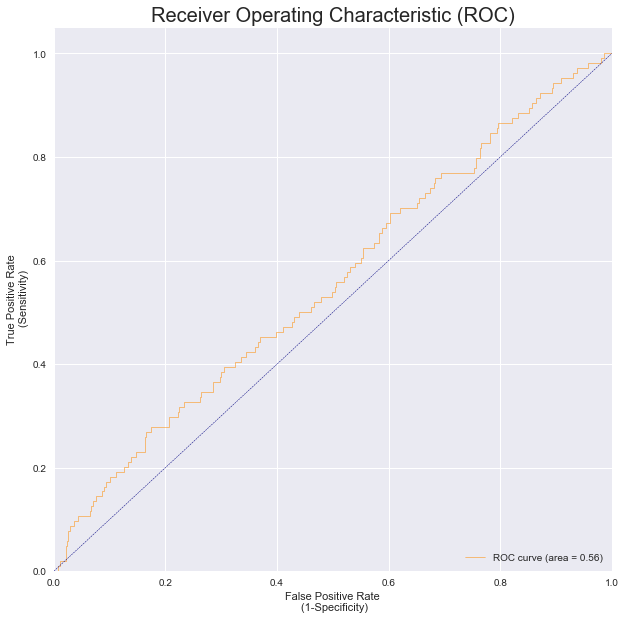


  Train Precission - Recall Curve 
Average precision-recall score: 1.00


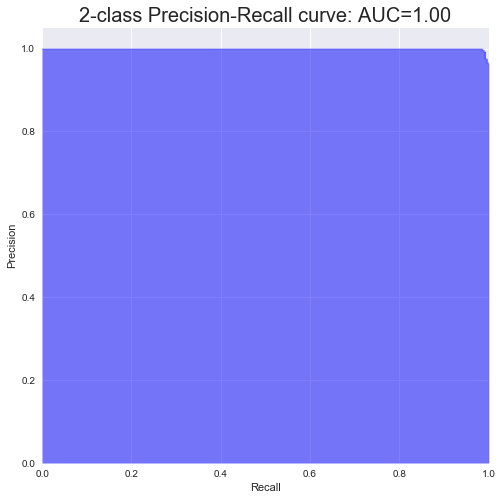


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


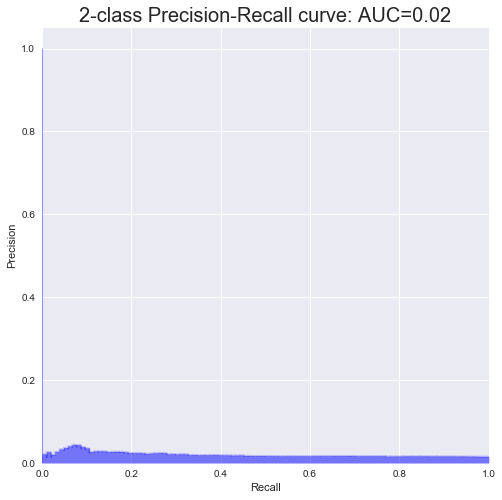

 
Iteration : 18 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[100, 100, 100], 1]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.7392
AUC - Test         : 0.6920


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]



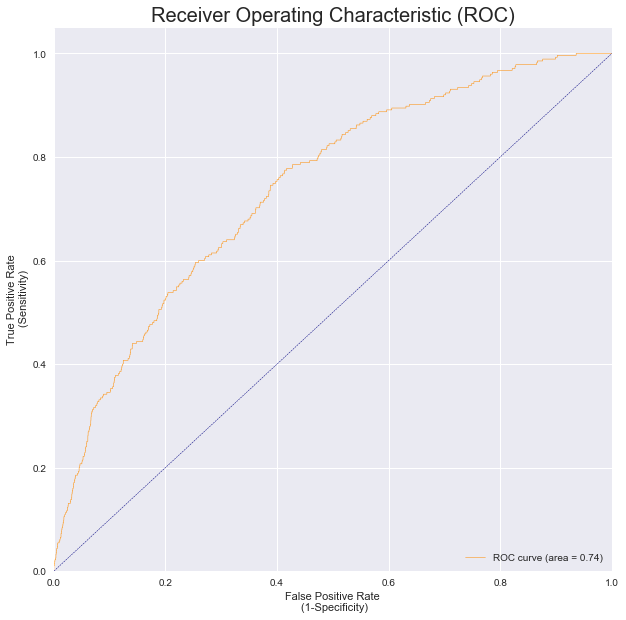


  Test AUC 


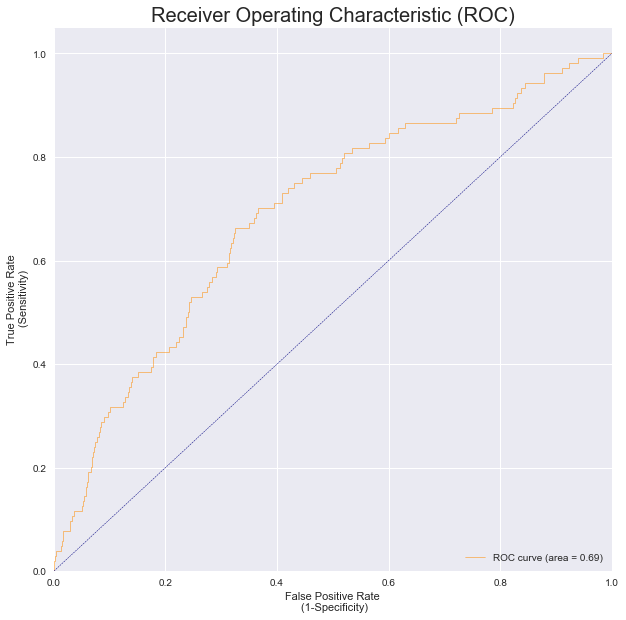


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


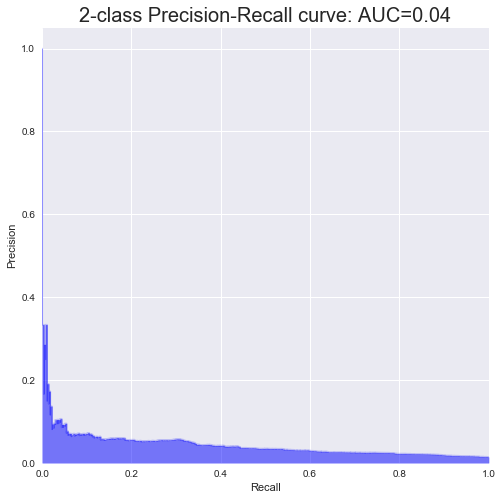


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


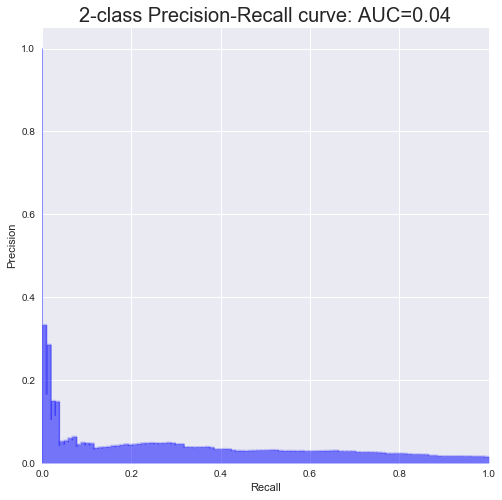

 
Iteration : 19 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[100, 100, 100], 2]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.6622
AUC - Test         : 0.5975


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]



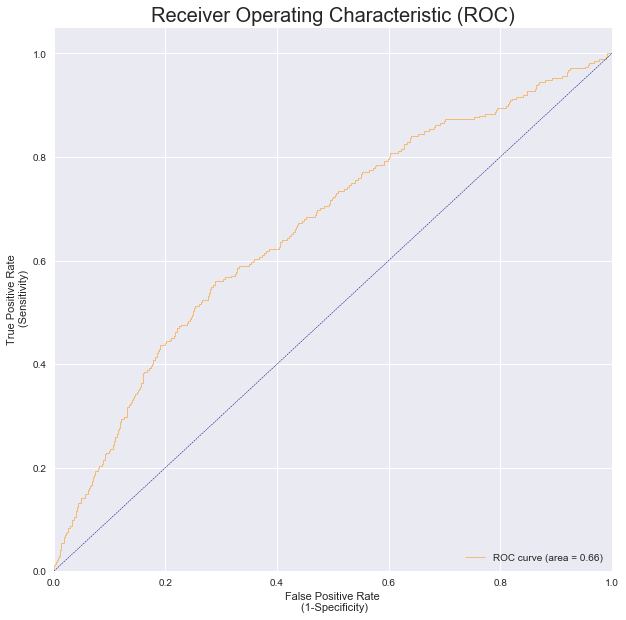


  Test AUC 


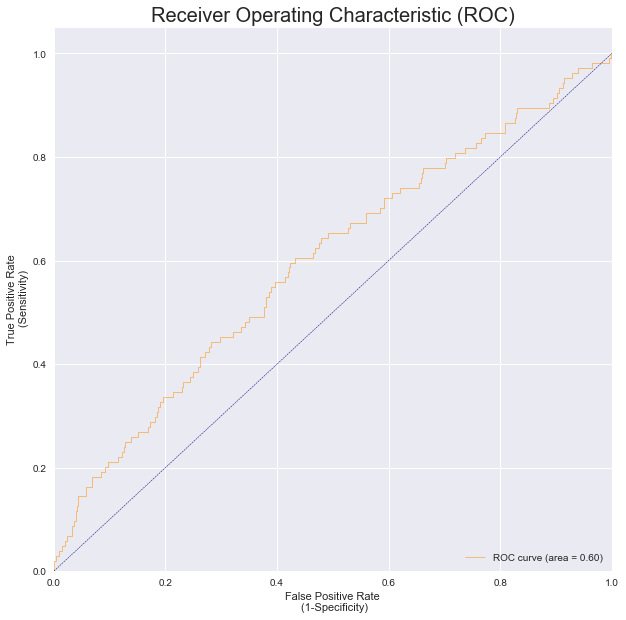


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


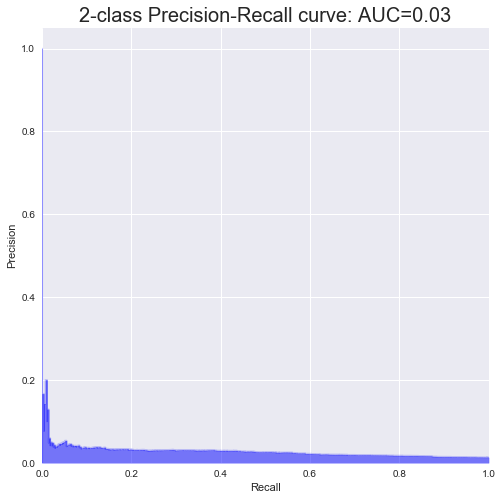


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


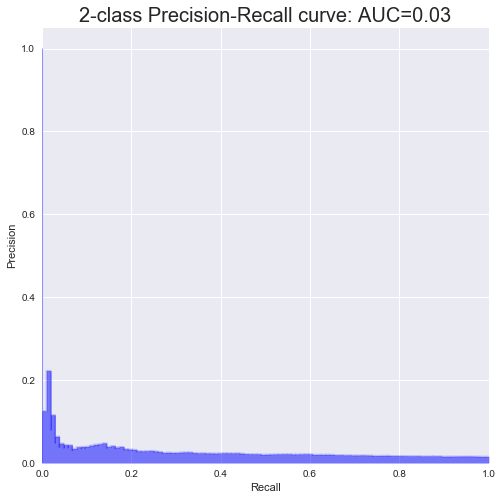

 
Iteration : 20 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Neural Network 
 
 Hyperparamter :  
 hidden layers - alpha 
 [[100, 100, 100], 3]
__________________________________________________________________

Accuracy - Training:  98.68%
Accuracy - test    :  98.51%

AUC Performance
AUC - Training     : 0.4178
AUC - Test         : 0.4856


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99     20614
          1       0.00      0.00      0.00       275

avg / total       0.97      0.99      0.98     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      1.00      0.99      6860
          1       0.00      0.00      0.00       104

avg / total       0.97      0.99      0.98      6964


  Confusion Matrix - Train 
[[20614   275]
 [    0     0]]


  Confusion Matrix - Test 
[[6860  104]
 [   0    0]]



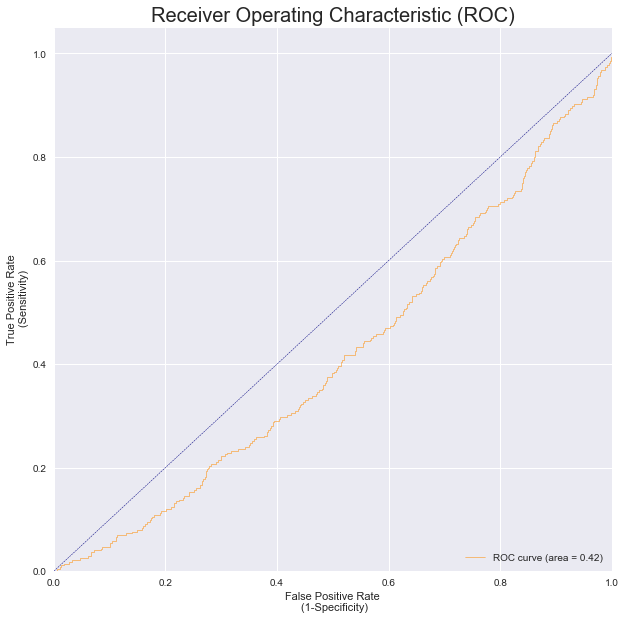


  Test AUC 


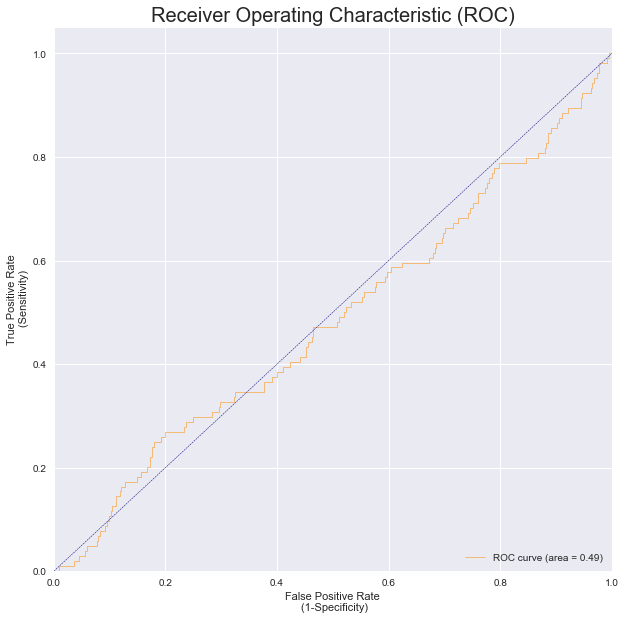


  Train Precission - Recall Curve 
Average precision-recall score: 0.01


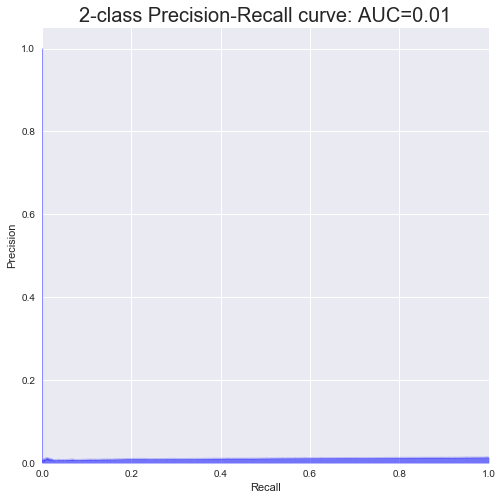


  Test Precission - Recall Curve 
Average precision-recall score: 0.01


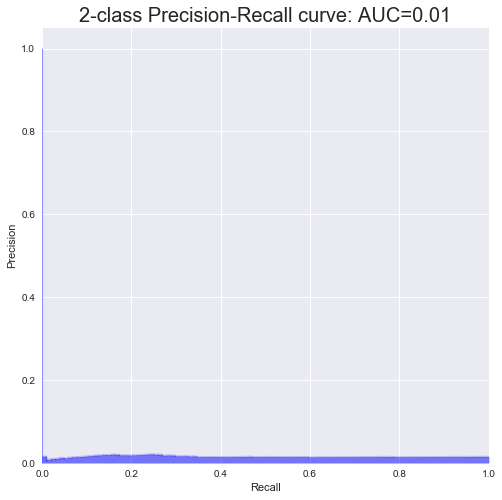

In [121]:
warnings.filterwarnings("ignore")

Model_Parameter_list = []
NPV_test_list =[]
NPV_train_list =[]
Specivity_test_list =[]
Specivity_train_list =[]
target_size_test_pct_list =[]
target_size_train_pct_list =[]
target_size_test_list =[]
target_size_train_list =[]
lift_test_list =[]
lift_train_list =[]
Prevalance_Test_Pct_list =[]
Prevalance_Train_Pct_list =[]
Prevalance_Test_list =[]
Prevalance_Train_list =[]
AUC_Test_list =[]
AUC_Train_list =[]
f1_score_test_list =[]
f1_score_train_list =[]
Recall_test_list =[]
Recall_train_list =[]
Precision_test_list =[]
Precision_train_list =[]
mat_test_list =[]
mat_train_list =[]
y_accuracy_test_list =[]
y_accuracy_train_list =[]

double = [[10,10],
          [25,25],
          [50,50],
          [100,100]]

triple = [[10,10,10],
          [25,25,25],
          [50,50,50],
          [100,100,100]]

hidden_layer_sizes = triple
# activation = ['relu','tanh','logistic']
alpha = [0.001,0.01,1,2,3]
algo = 'Neural Network'
hyperparameter = 'hidden layers - alpha'

iteration = 0
for i in hidden_layer_sizes:
    for j in alpha:
        iteration += 1

        Bold = "\033[1m"
        Underline = "\033[4m"
        end = "\033[0;0m"

        print(Bold,"\nIteration : {}" .format(iteration), end )
        m = [i,j]
        model = MLPClassifier(hidden_layer_sizes=i, activation='relu', alpha=j,  random_state=12345, max_iter=300)
        header(algo, hyperparameter,m)
        clf = train_model(model)
        var_dict = metric_calculation(clf)
        metric_display(var_dict)
        append_metrics(var_dict)
        print()
        print(Bold,Underline,"Train AUC", end )
        auc_curve_plot(y_train,var_dict['y_train_score_classifier'][:,1])  

        print()
        print(Bold,Underline,"Test AUC", end )
        auc_curve_plot(y_test,var_dict['y_test_score_classifier'][:,1])

        print()
        print(Bold,Underline,"Train Precission - Recall Curve", end )
        precission_recall_curve_plot(y_train, var_dict['y_train_score_classifier'][:,1])

        print()
        print(Bold,Underline,"Test Precission - Recall Curve", end )
        precission_recall_curve_plot(y_test, var_dict['y_test_score_classifier'][:,1])

In [122]:
df_NN = tabulate_grid_search()
df_NN.T.to_csv('Model Performance/Neural Network Controlled.csv')

In [ ]:
model = MLPClassifier(hidden_layer_sizes=i, 
                      activation='relu', 
                      alpha=j,  
                      random_state=12345, 
                      max_iter=300)

### Logistic Regression

 
Iteration : 1 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.0001, 0.0001]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15039   112]
 [ 5575   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897

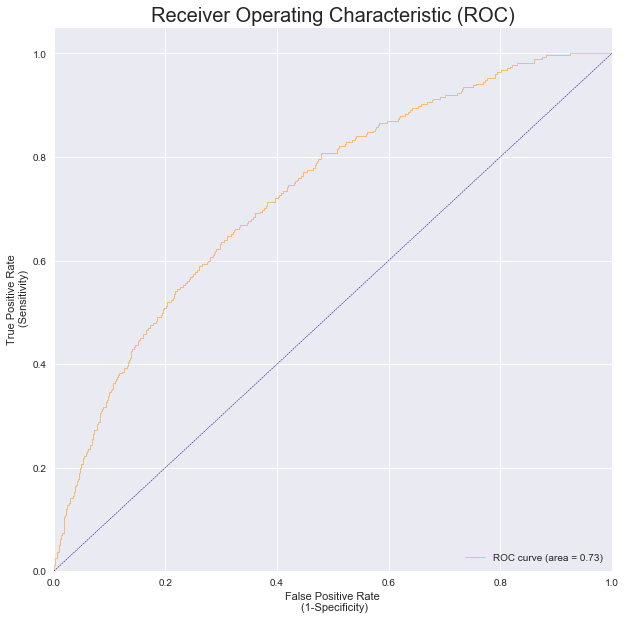


  Test AUC 


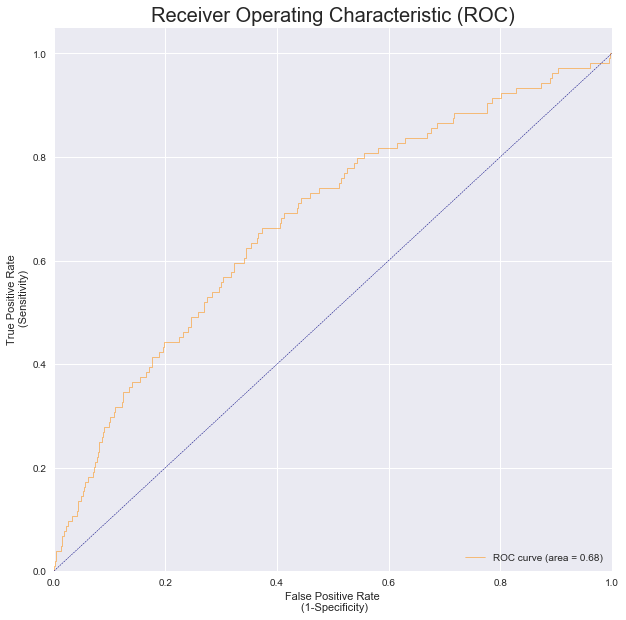


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


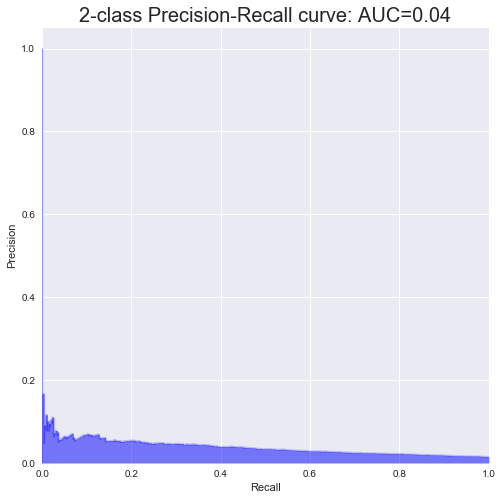


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


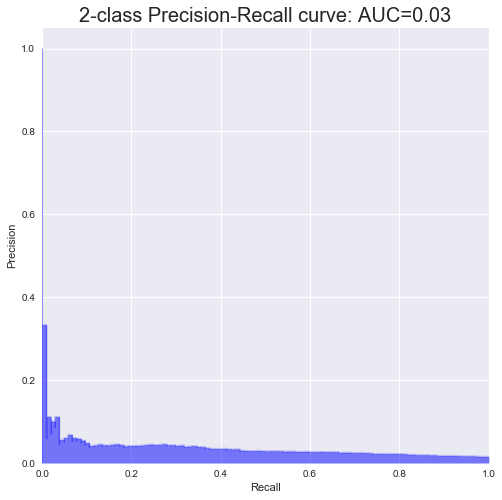

 
Iteration : 2 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.0001, 0.001]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15039   112]
 [ 5575   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897 

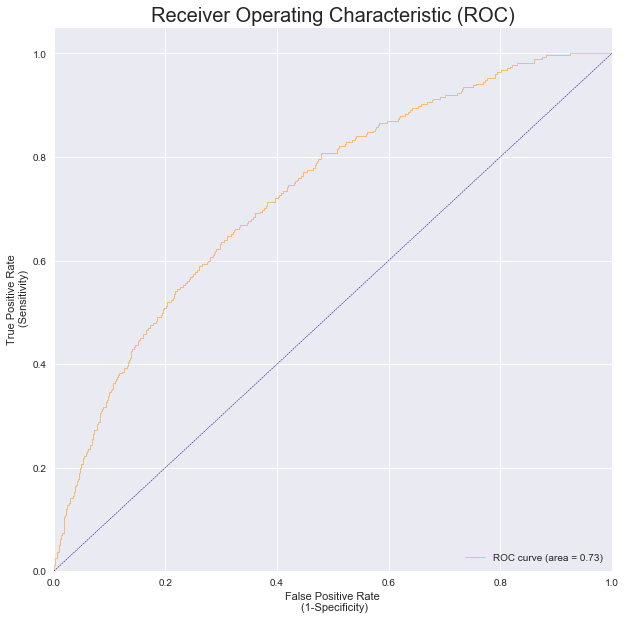


  Test AUC 


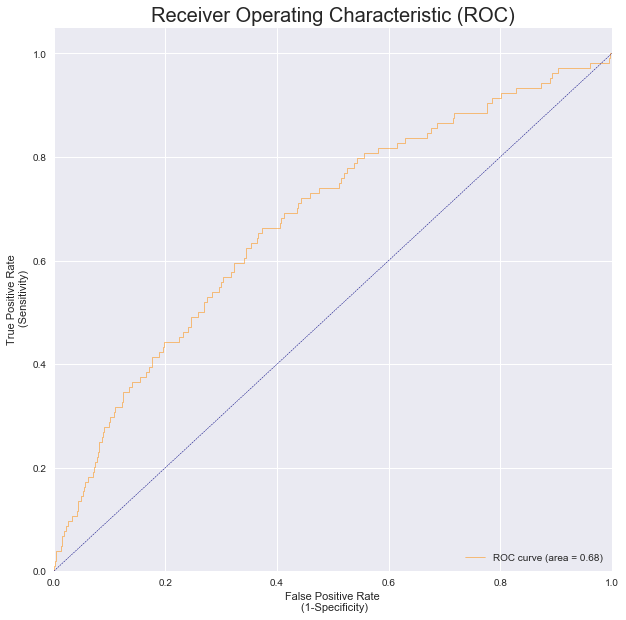


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


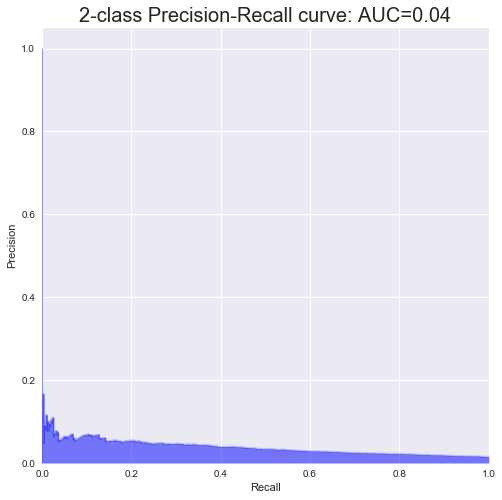


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


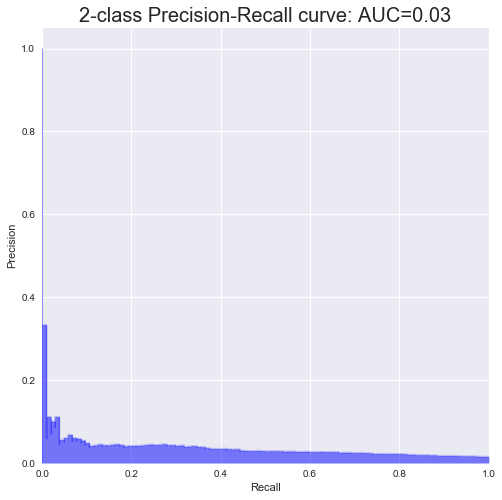

 
Iteration : 3 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.0001, 0.01]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15039   112]
 [ 5575   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897  

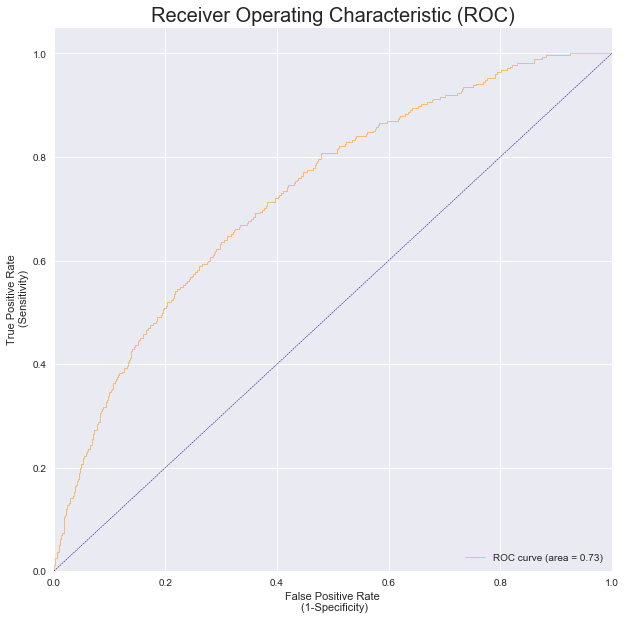


  Test AUC 


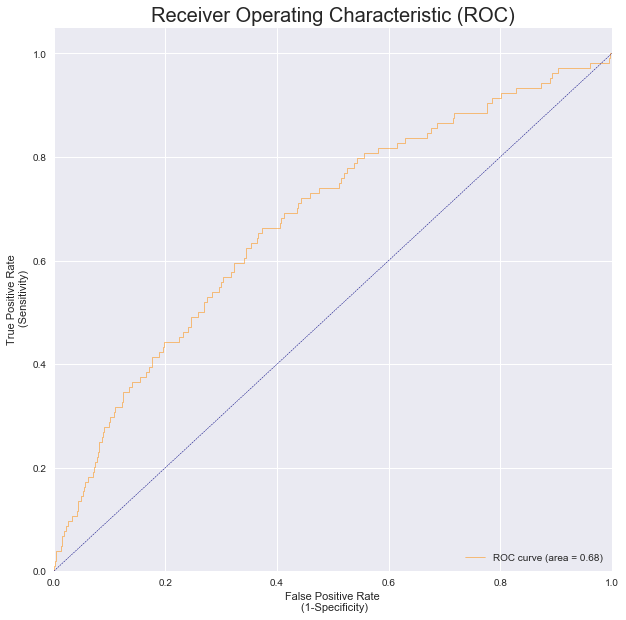


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


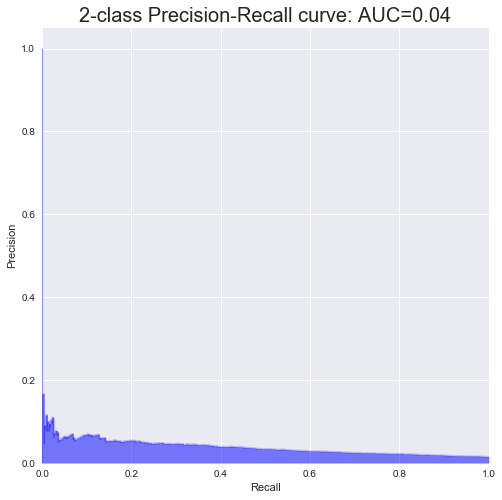


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


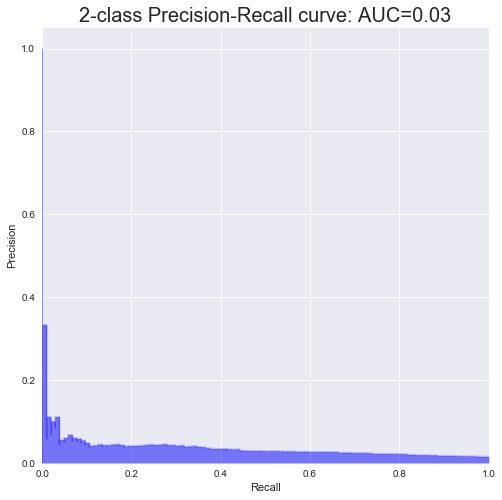

 
Iteration : 4 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.0001, 0.1]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15039   112]
 [ 5575   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897   

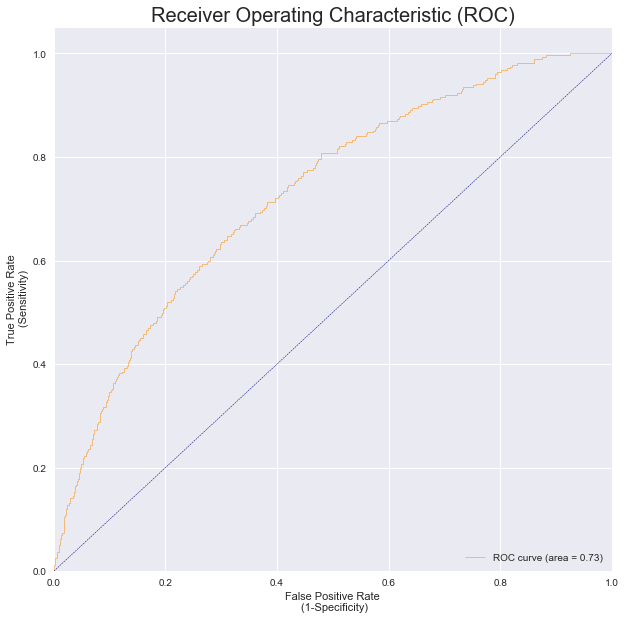


  Test AUC 


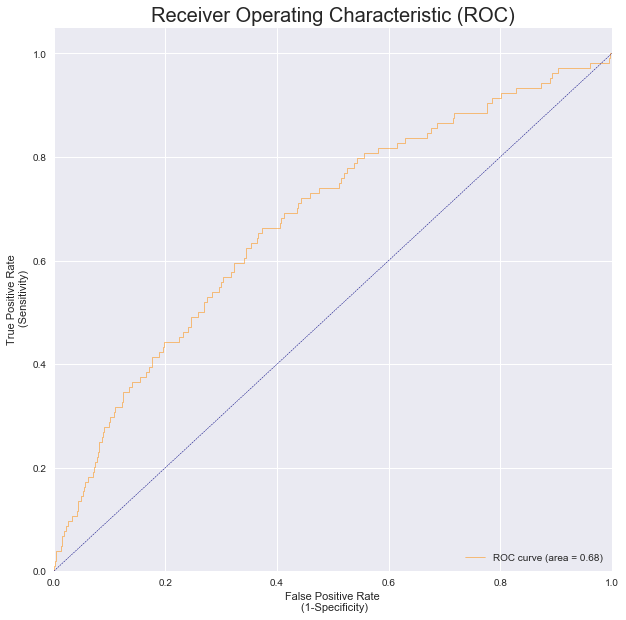


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


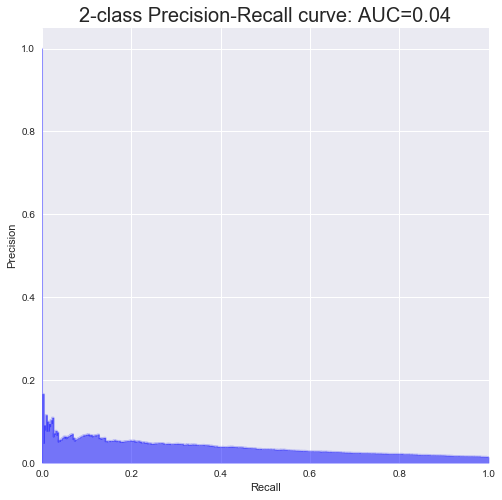


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


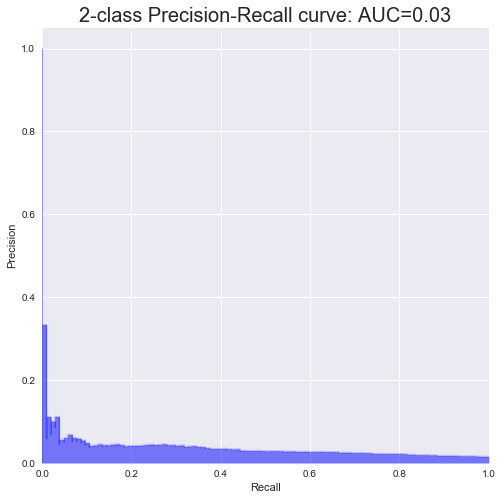

 
Iteration : 5 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.001, 0.0001]
__________________________________________________________________

Accuracy - Training:  71.77%
Accuracy - test    :  71.22%

AUC Performance
AUC - Training     : 0.7654
AUC - Test         : 0.6932


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.72      0.83     20614
          1       0.03      0.66      0.06       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[14811    94]
 [ 5803   181]]


  Confusion Matrix - Test 
[[4898   42]
 [1962 

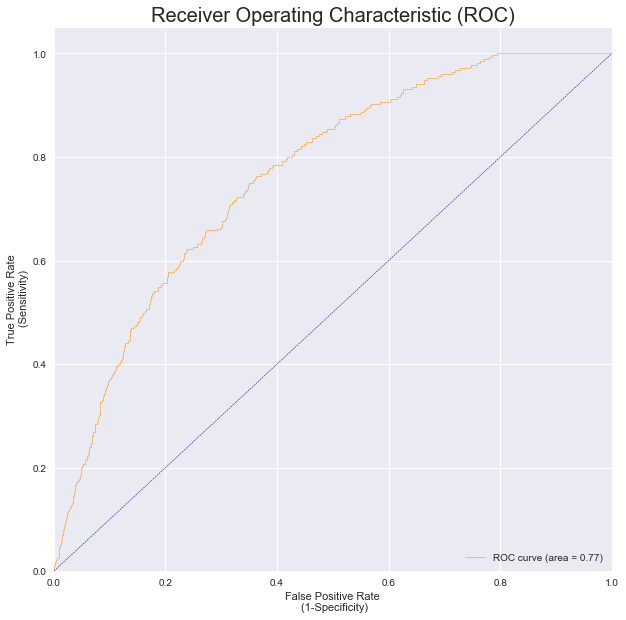


  Test AUC 


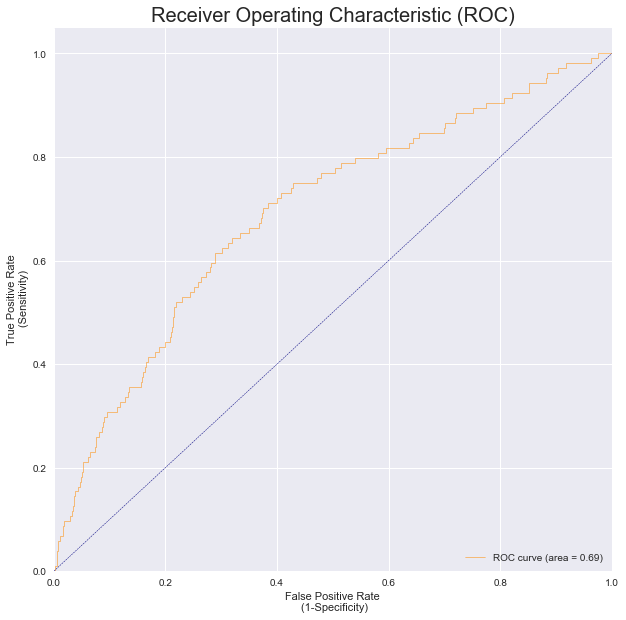


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


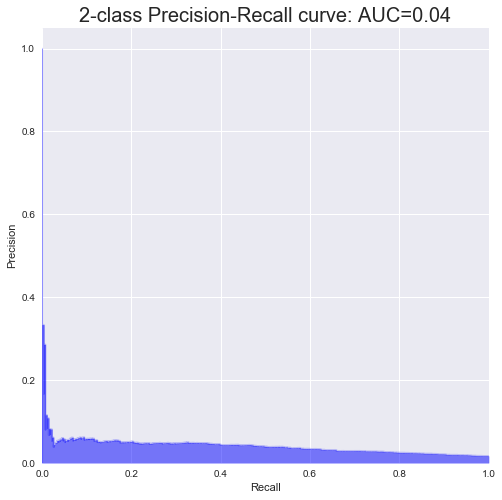


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


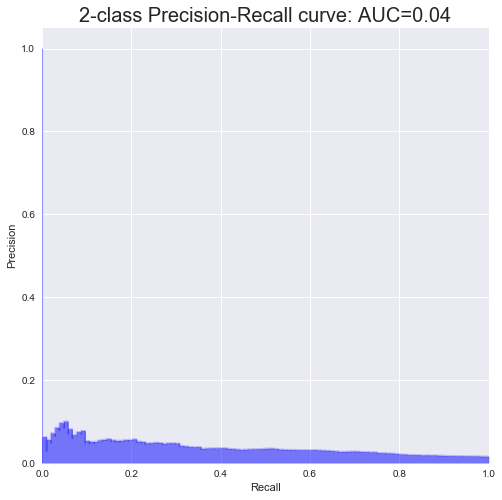

 
Iteration : 6 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.001, 0.001]
__________________________________________________________________

Accuracy - Training:  71.77%
Accuracy - test    :  71.22%

AUC Performance
AUC - Training     : 0.7654
AUC - Test         : 0.6932


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.72      0.83     20614
          1       0.03      0.66      0.06       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[14811    94]
 [ 5803   181]]


  Confusion Matrix - Test 
[[4898   42]
 [1962  

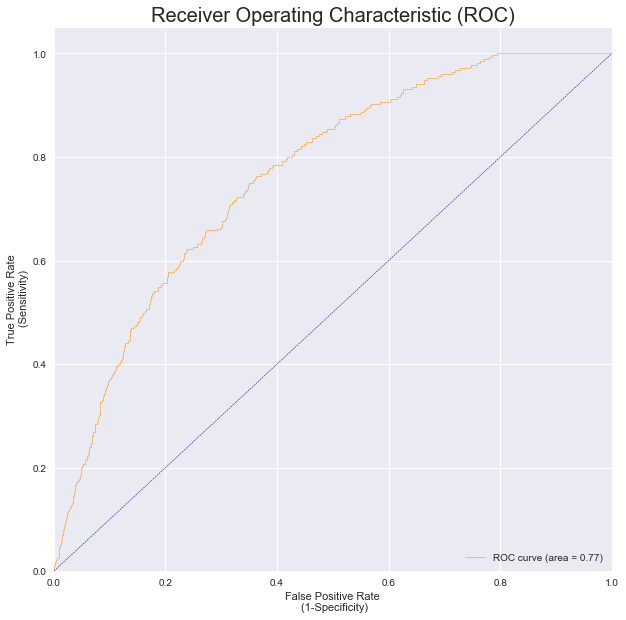


  Test AUC 


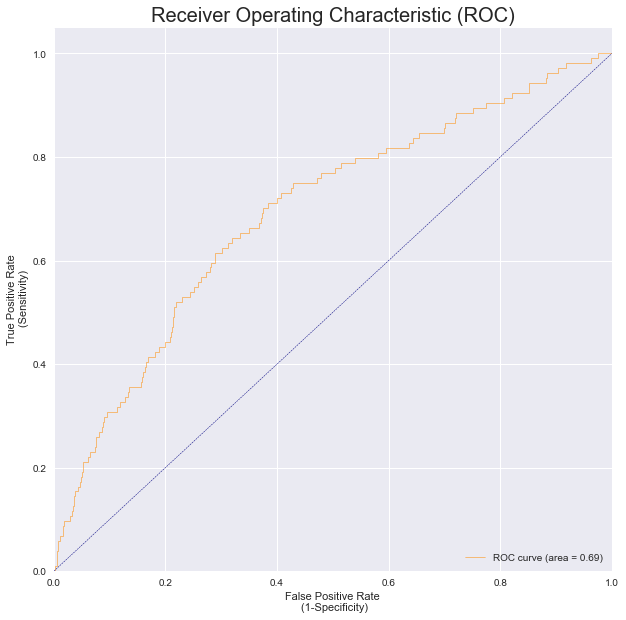


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


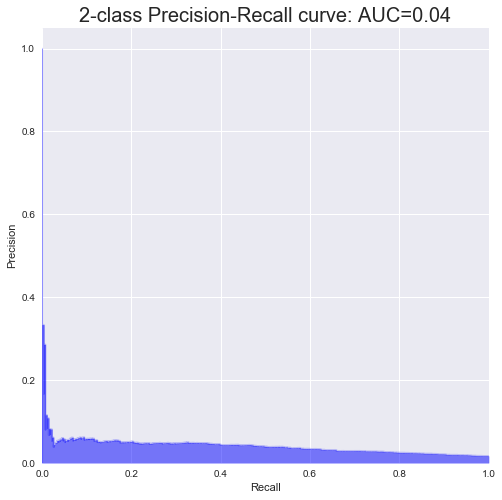


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


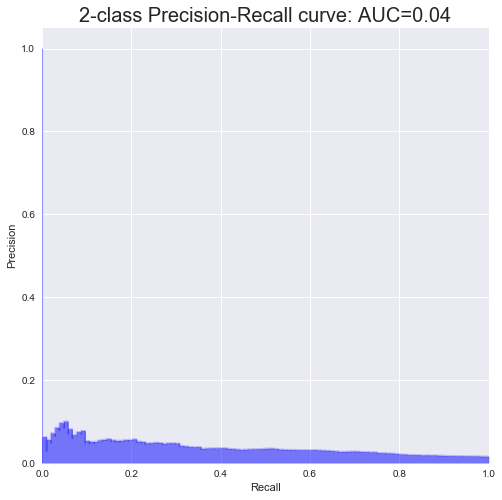

 
Iteration : 7 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.001, 0.01]
__________________________________________________________________

Accuracy - Training:  71.77%
Accuracy - test    :  71.22%

AUC Performance
AUC - Training     : 0.7654
AUC - Test         : 0.6932


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.72      0.83     20614
          1       0.03      0.66      0.06       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[14811    94]
 [ 5803   181]]


  Confusion Matrix - Test 
[[4898   42]
 [1962   

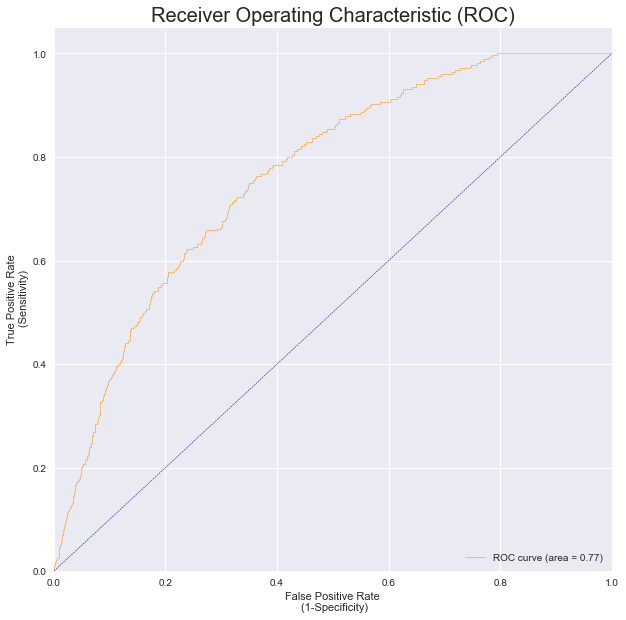


  Test AUC 


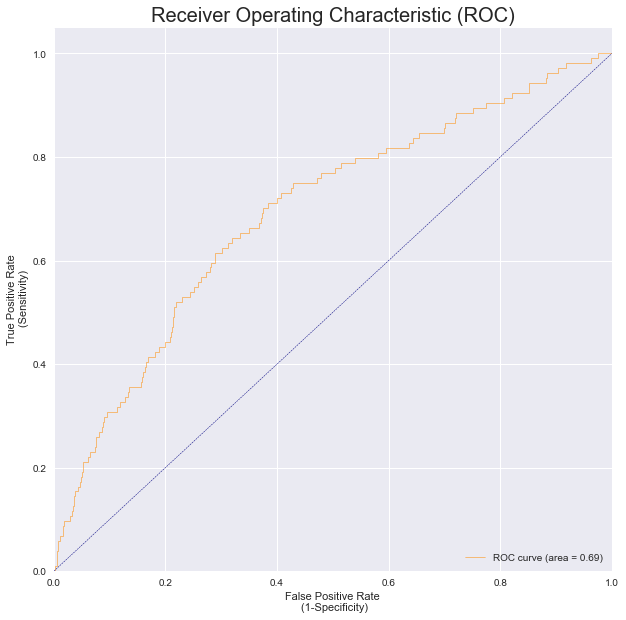


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


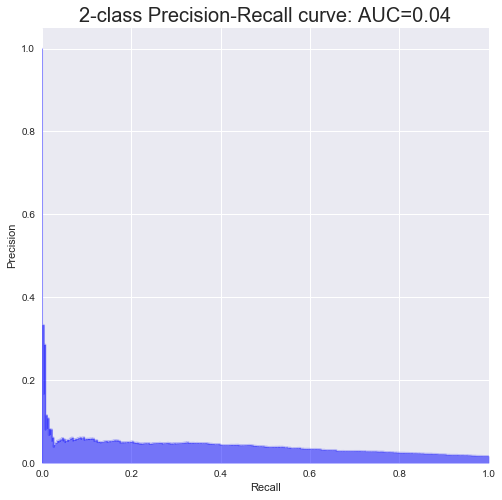


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


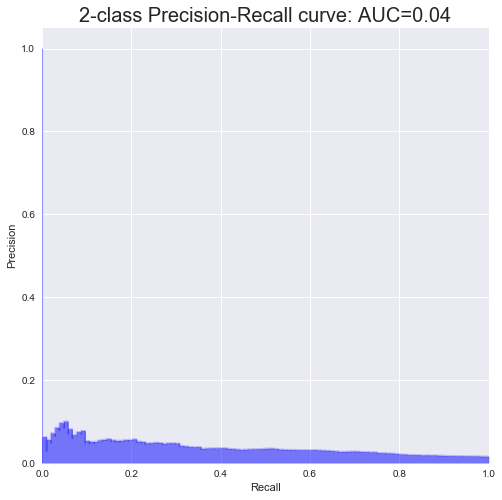

 
Iteration : 8 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.001, 0.1]
__________________________________________________________________

Accuracy - Training:  71.77%
Accuracy - test    :  71.22%

AUC Performance
AUC - Training     : 0.7654
AUC - Test         : 0.6932


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.72      0.83     20614
          1       0.03      0.66      0.06       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[14812    94]
 [ 5802   181]]


  Confusion Matrix - Test 
[[4898   42]
 [1962   6

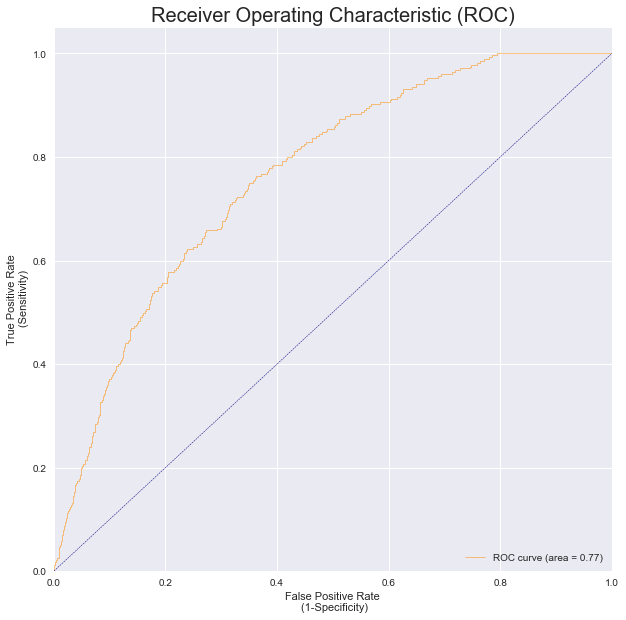


  Test AUC 


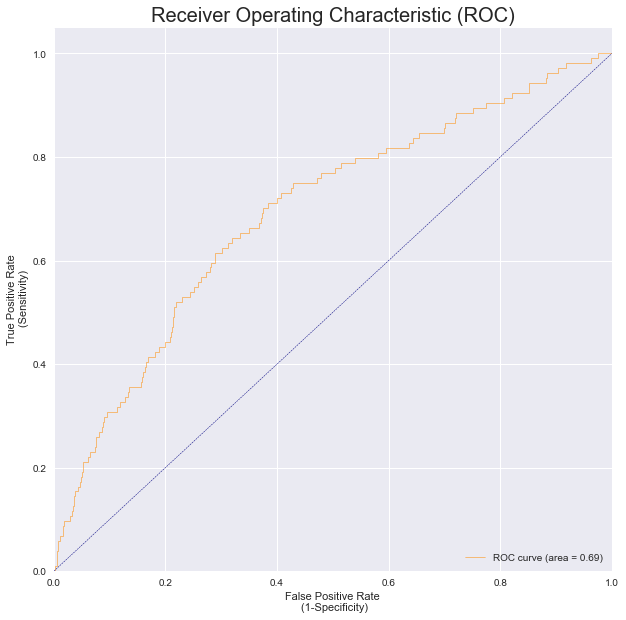


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


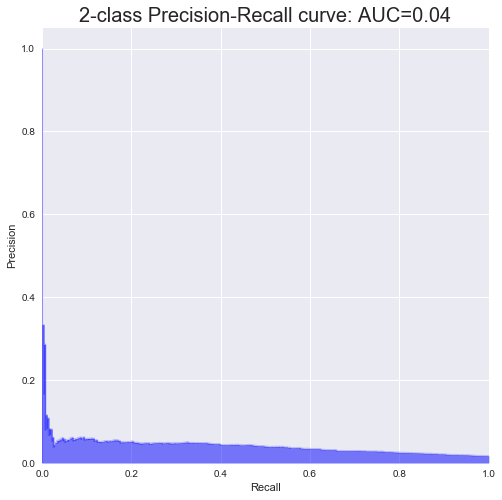


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


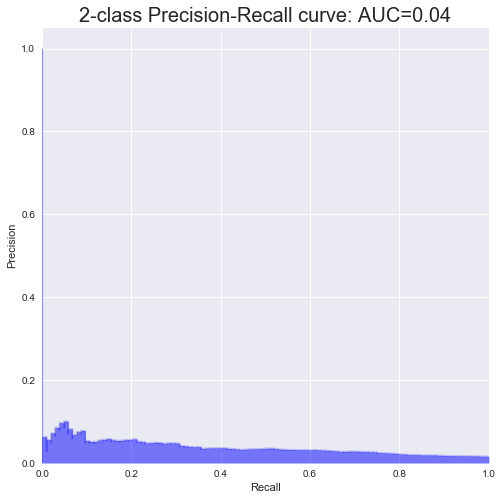

 
Iteration : 9 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.01, 0.0001]
__________________________________________________________________

Accuracy - Training:  71.02%
Accuracy - test    :  70.38%

AUC Performance
AUC - Training     : 0.7768
AUC - Test         : 0.6906


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14641    81]
 [ 5973   194]]


  Confusion Matrix - Test 
[[4839   42]
 [2021  

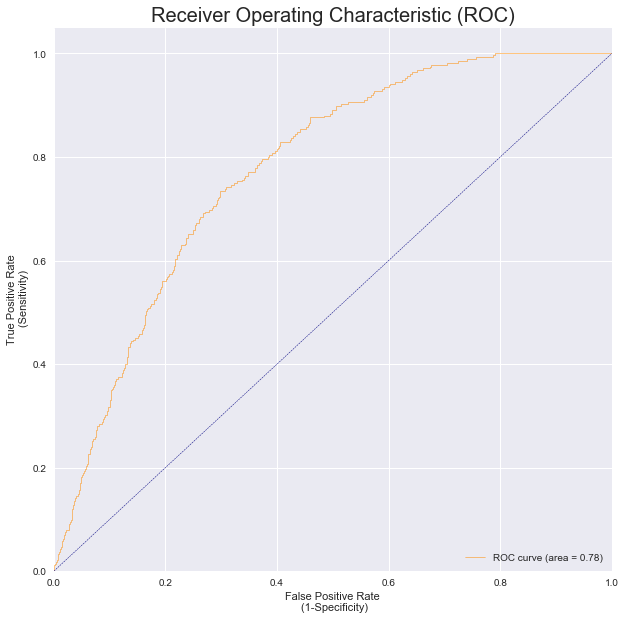


  Test AUC 


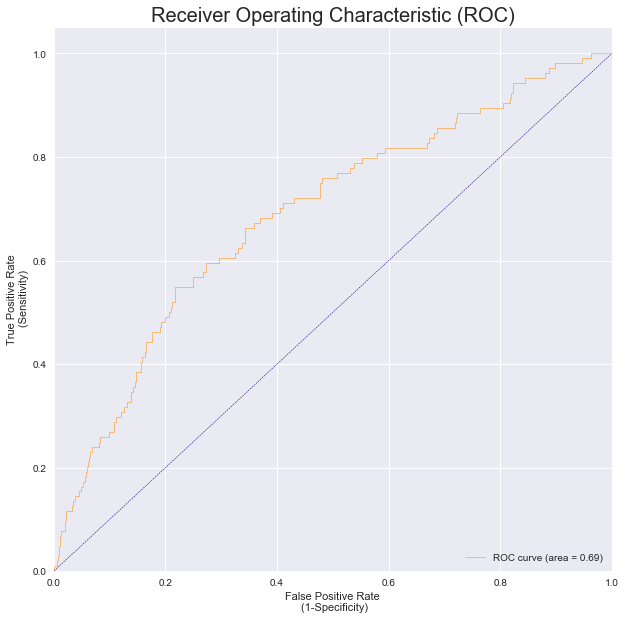


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


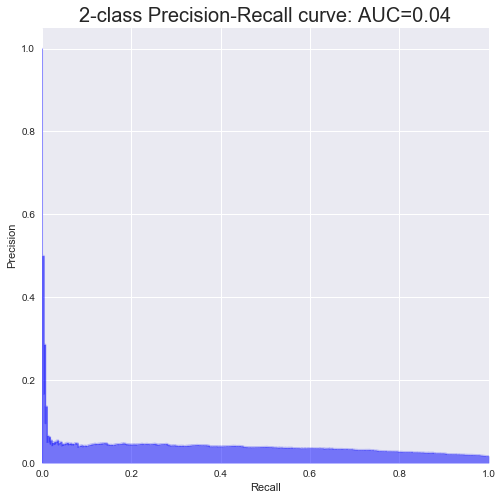


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


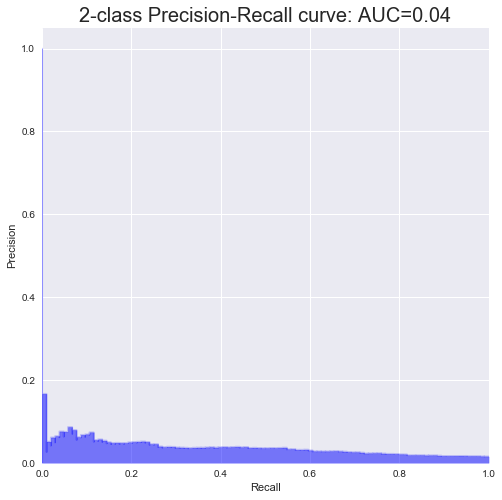

 
Iteration : 10 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.01, 0.001]
__________________________________________________________________

Accuracy - Training:  71.02%
Accuracy - test    :  70.38%

AUC Performance
AUC - Training     : 0.7768
AUC - Test         : 0.6906


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14641    81]
 [ 5973   194]]


  Confusion Matrix - Test 
[[4839   42]
 [2021  

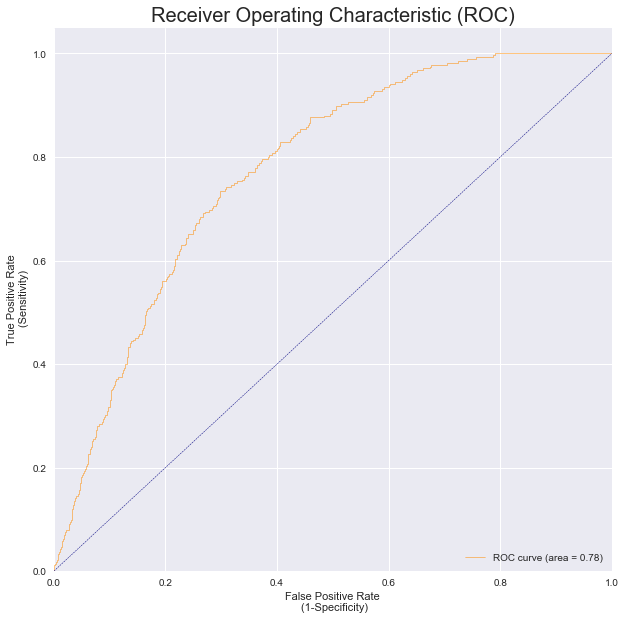


  Test AUC 


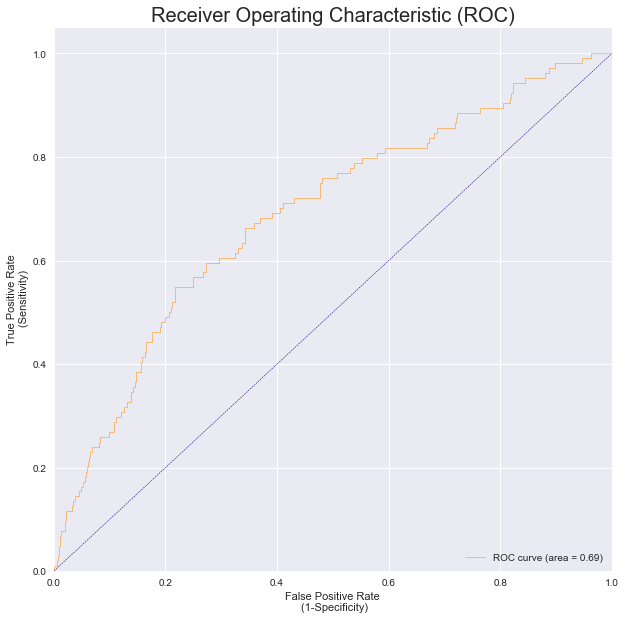


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


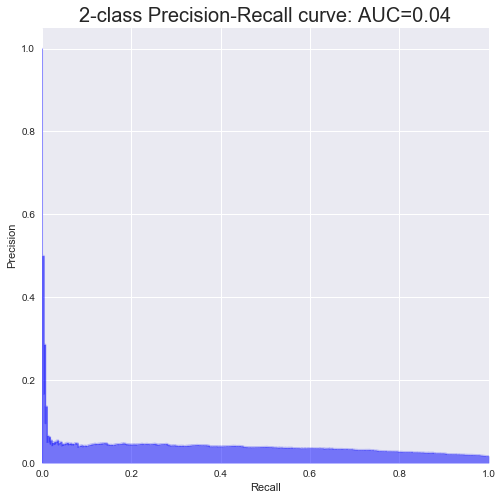


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


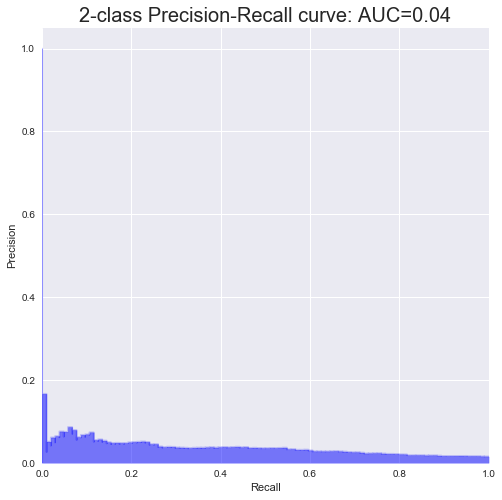

 
Iteration : 11 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.01, 0.01]
__________________________________________________________________

Accuracy - Training:  71.02%
Accuracy - test    :  70.38%

AUC Performance
AUC - Training     : 0.7768
AUC - Test         : 0.6906


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14641    81]
 [ 5973   194]]


  Confusion Matrix - Test 
[[4839   42]
 [2021   

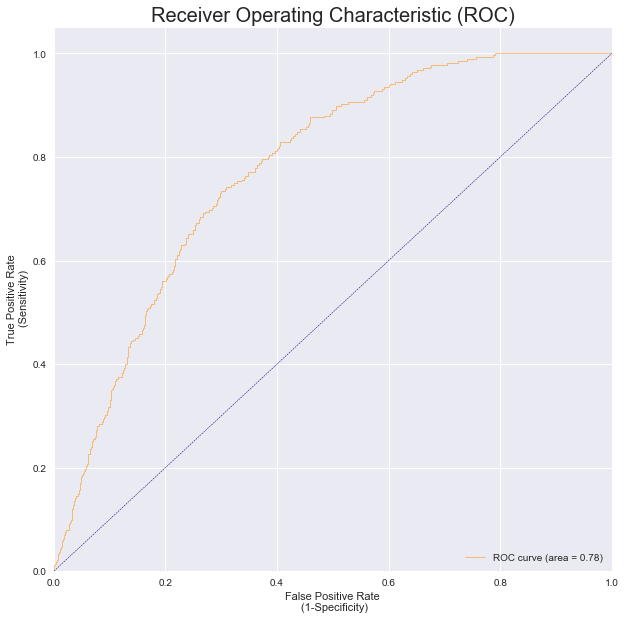


  Test AUC 


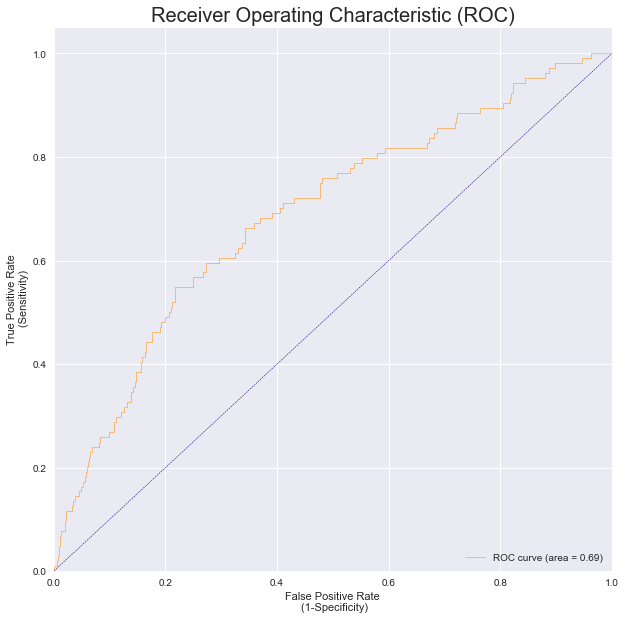


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


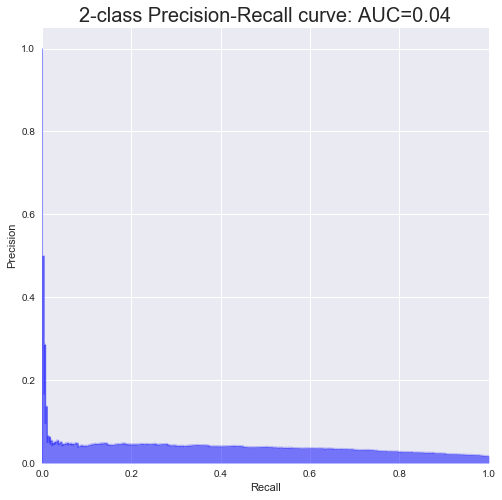


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


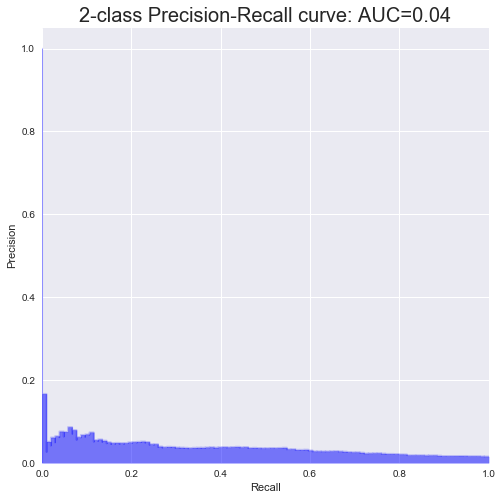

 
Iteration : 12 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.01, 0.1]
__________________________________________________________________

Accuracy - Training:  71.01%
Accuracy - test    :  70.38%

AUC Performance
AUC - Training     : 0.7768
AUC - Test         : 0.6906


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14640    81]
 [ 5974   194]]


  Confusion Matrix - Test 
[[4839   42]
 [2021   6

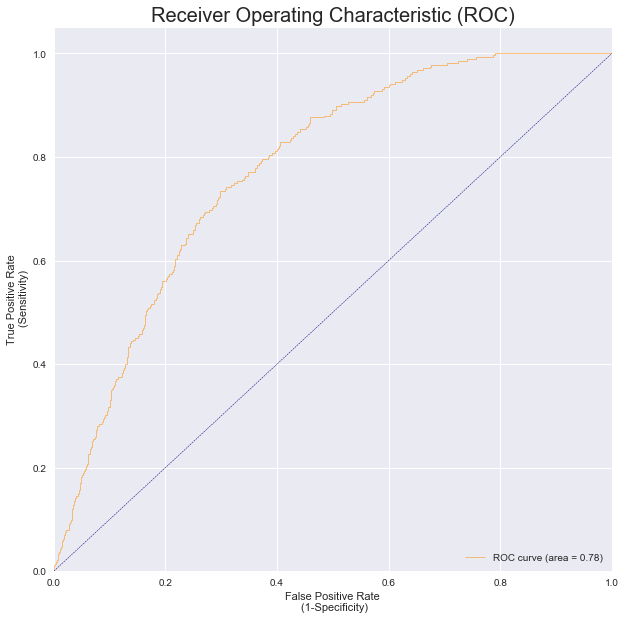


  Test AUC 


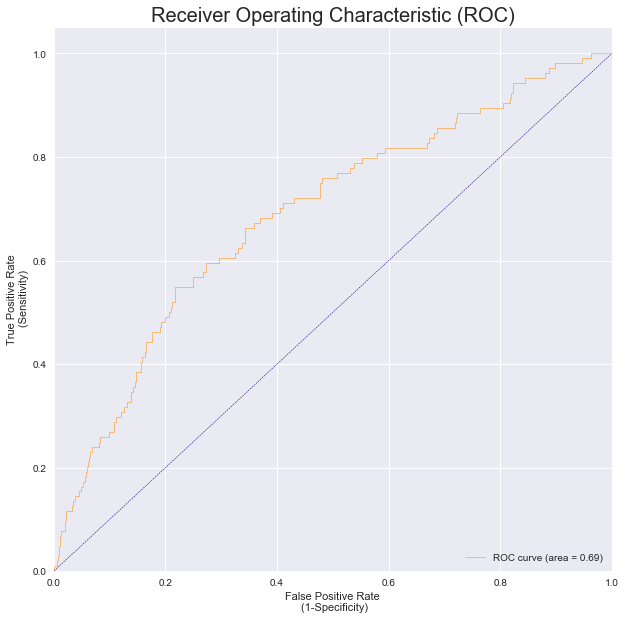


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


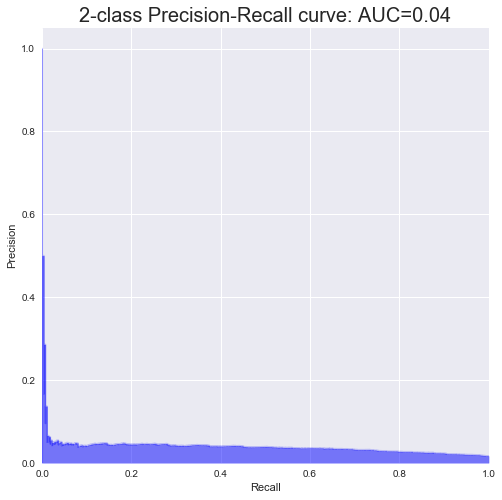


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


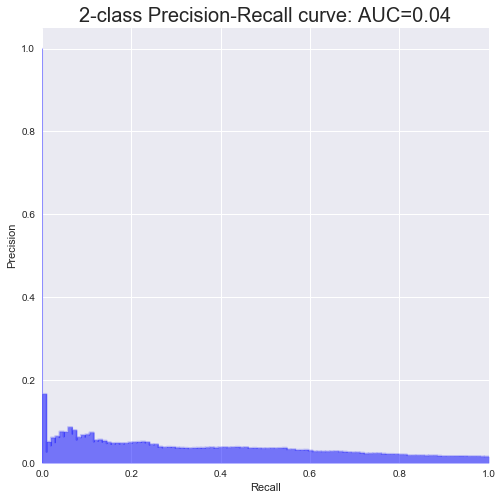

 
Iteration : 13 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.1, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.60%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14548    75]
 [ 6066   200]]


  Confusion Matrix - Test 
[[4832   42]
 [2028  

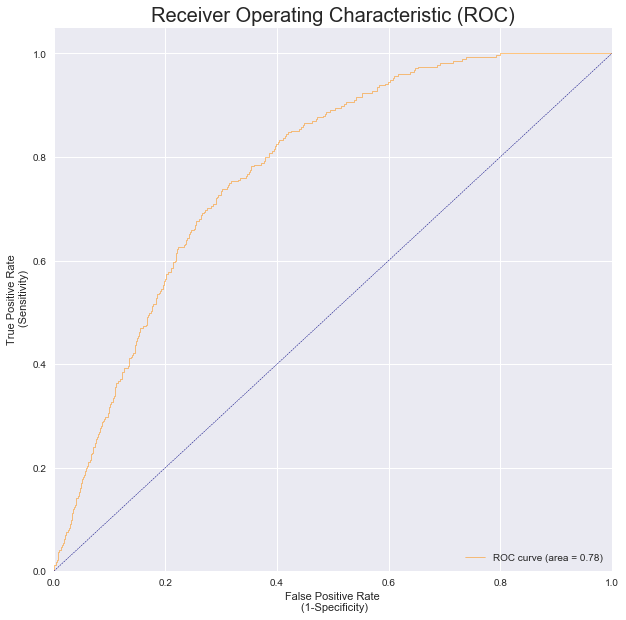


  Test AUC 


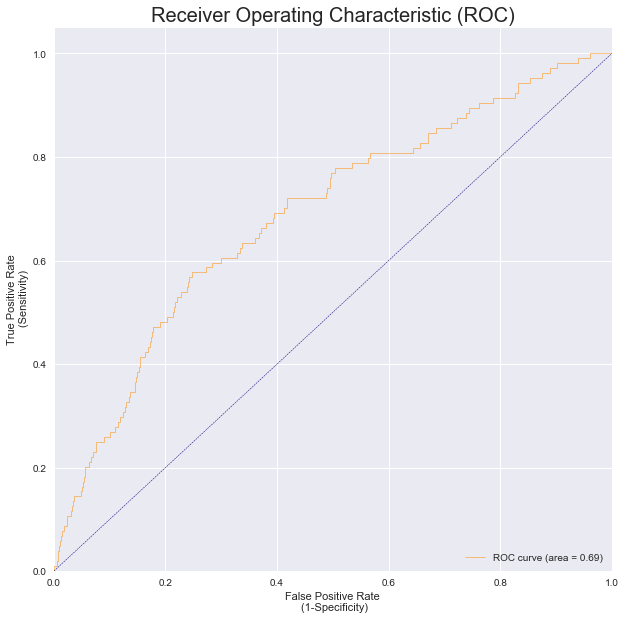


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


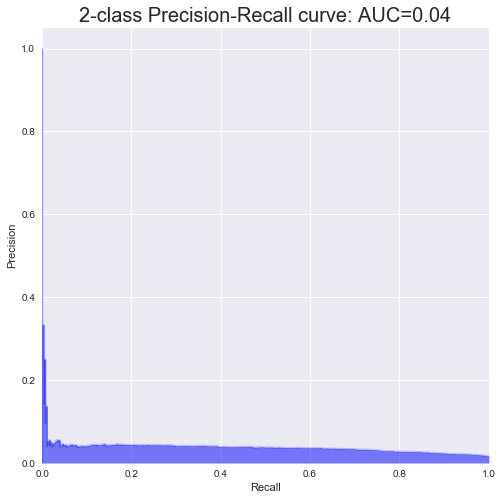


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


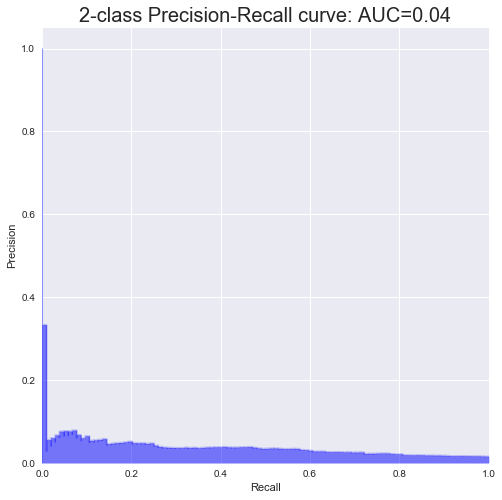

 
Iteration : 14 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.1, 0.001]
__________________________________________________________________

Accuracy - Training:  70.60%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14548    75]
 [ 6066   200]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   

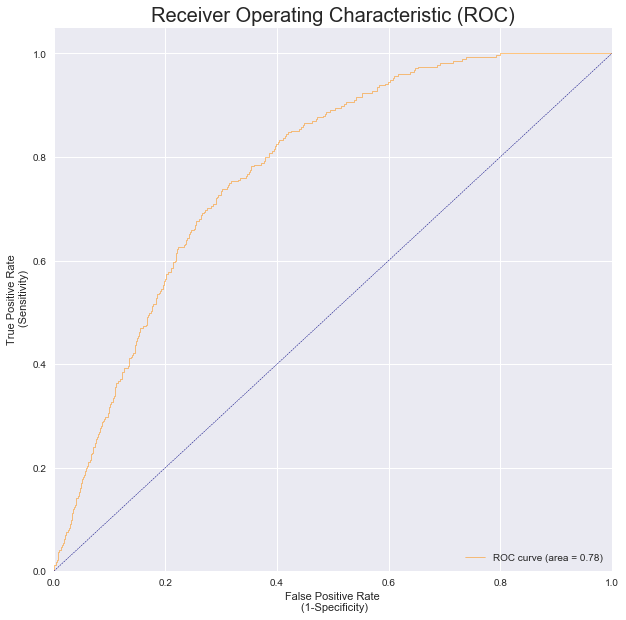


  Test AUC 


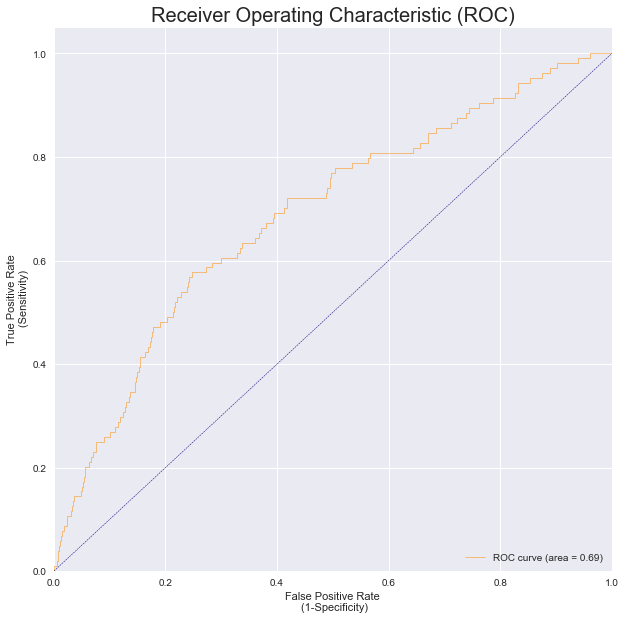


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


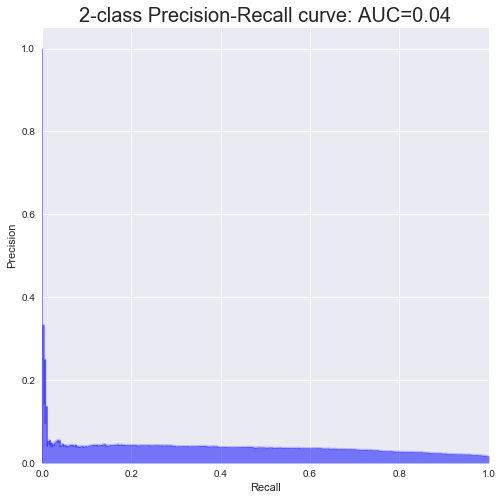


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


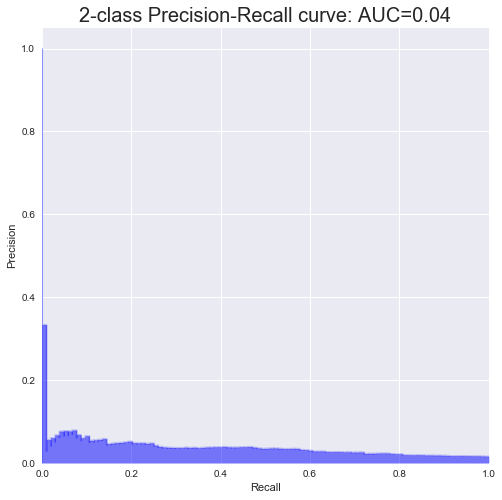

 
Iteration : 15 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.1, 0.01]
__________________________________________________________________

Accuracy - Training:  70.60%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14548    75]
 [ 6066   200]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   6

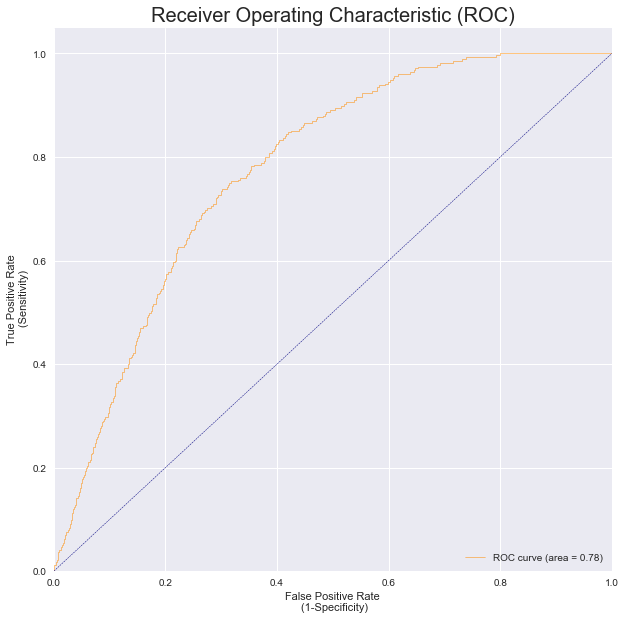


  Test AUC 


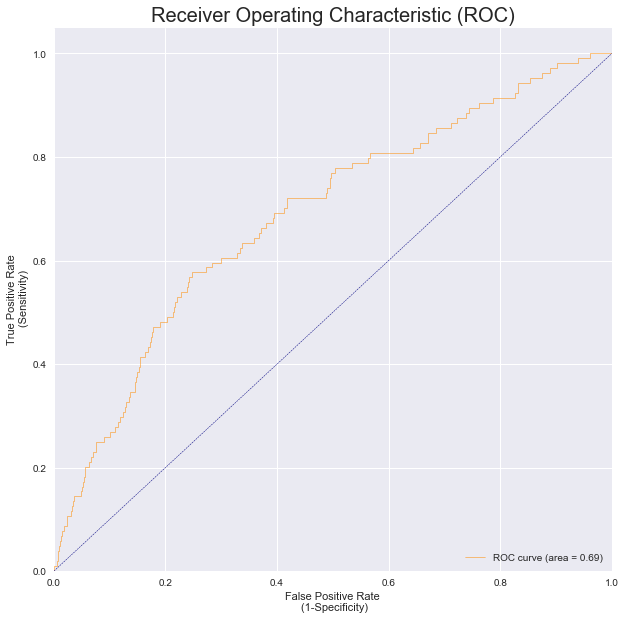


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


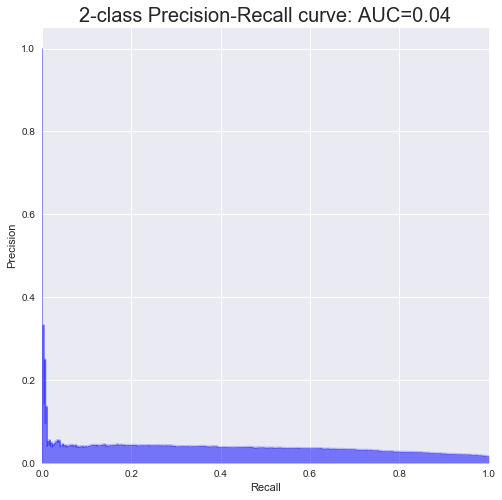


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


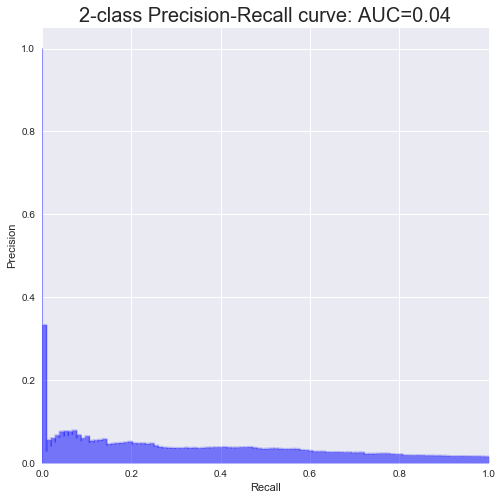

 
Iteration : 16 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 0.1, 0.1]
__________________________________________________________________

Accuracy - Training:  70.61%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14549    75]
 [ 6065   200]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62

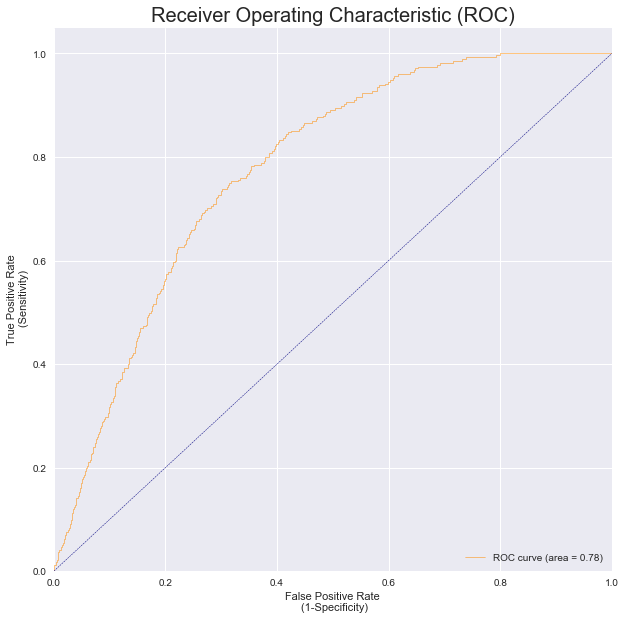


  Test AUC 


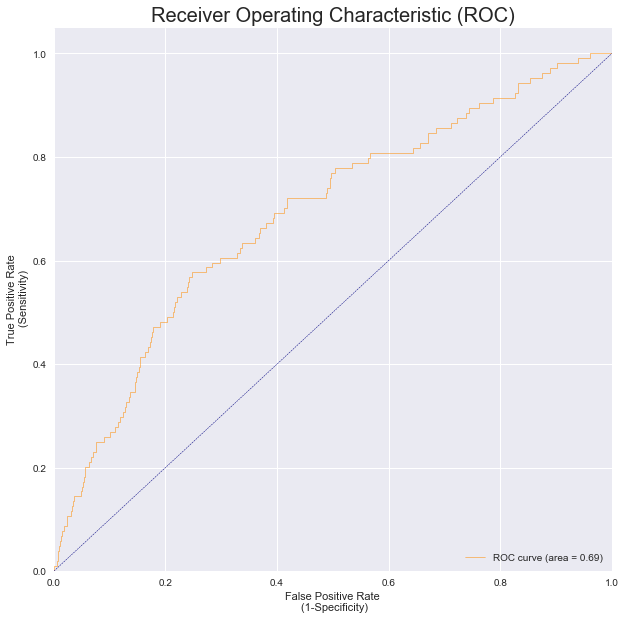


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


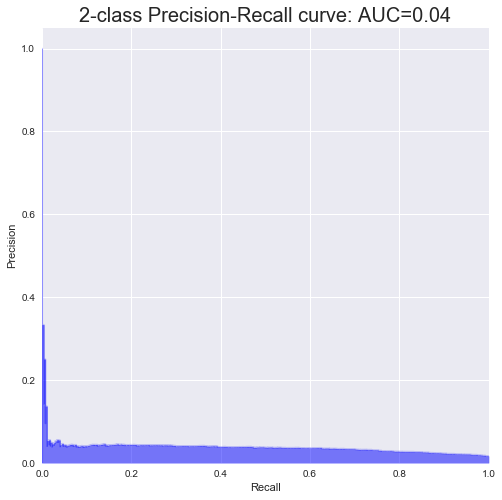


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


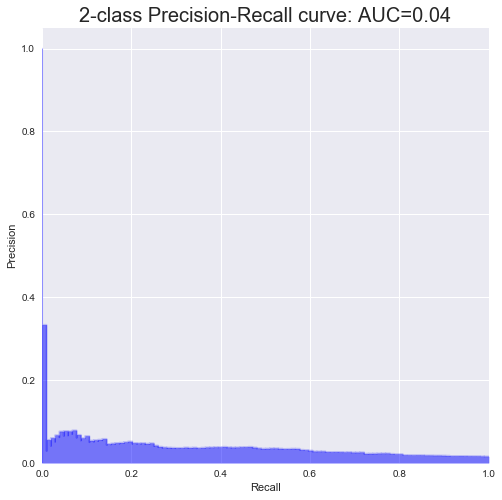

 
Iteration : 17 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 1, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.29%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6888


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14546    76]
 [ 6068   199]]


  Confusion Matrix - Test 
[[4833   42]
 [2027   6

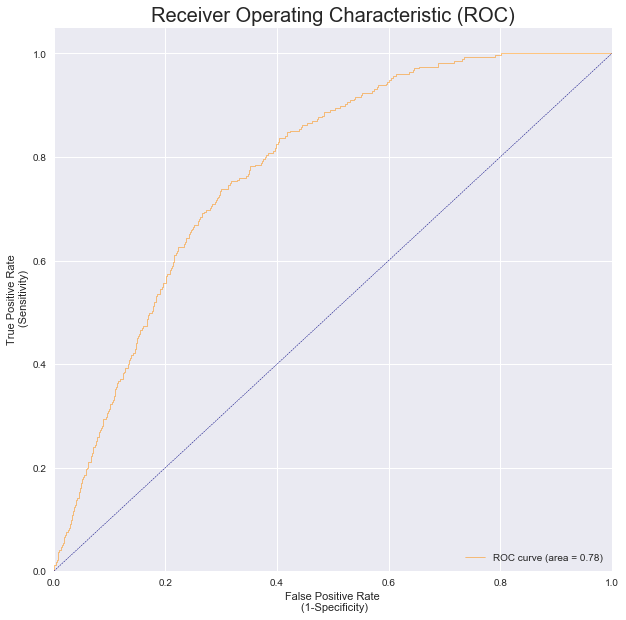


  Test AUC 


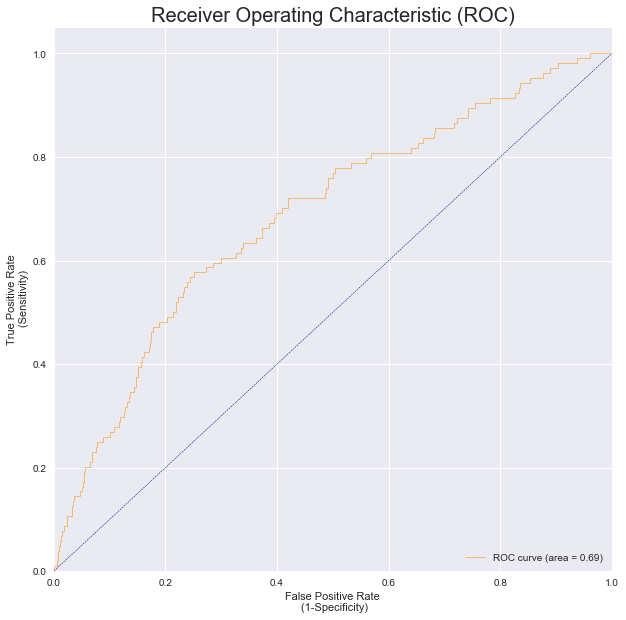


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


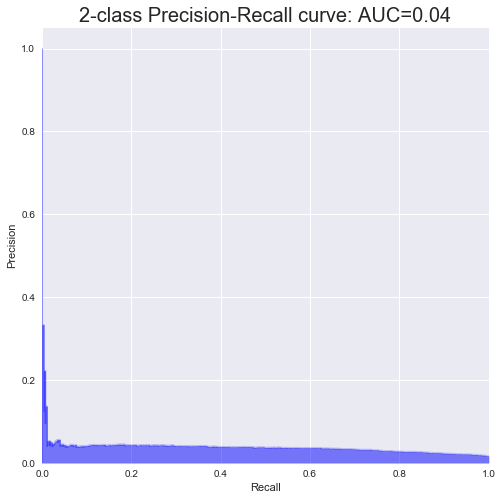


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


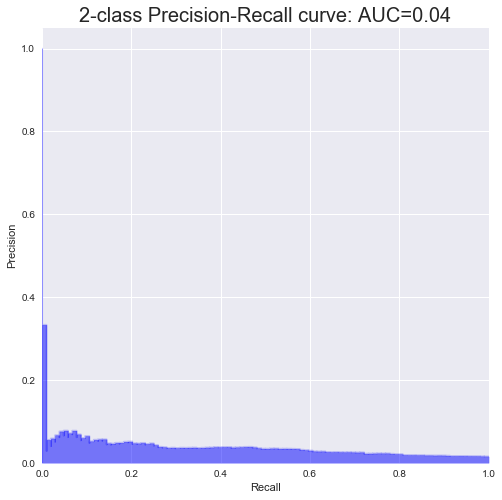

 
Iteration : 18 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 1, 0.001]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.29%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6888


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14546    76]
 [ 6068   199]]


  Confusion Matrix - Test 
[[4833   42]
 [2027   62

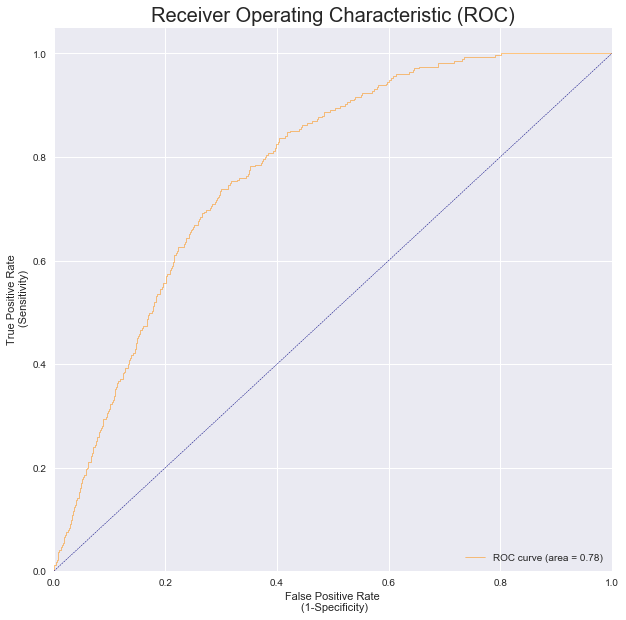


  Test AUC 


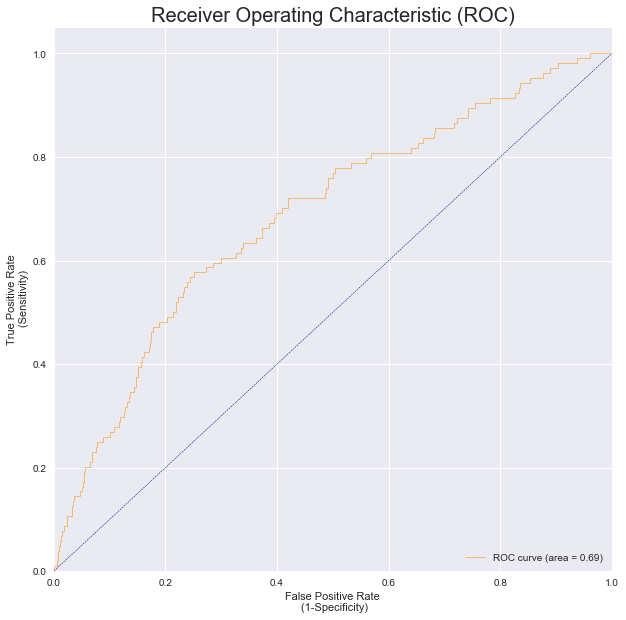


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


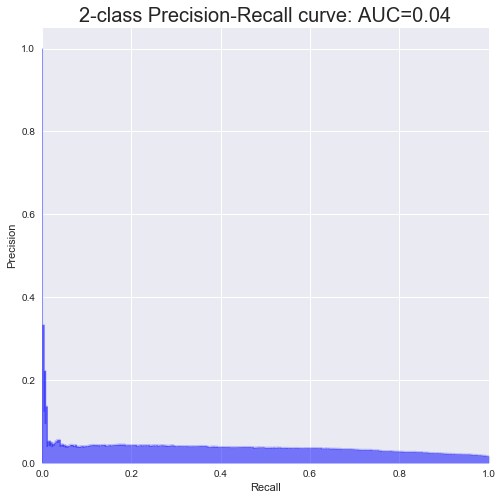


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


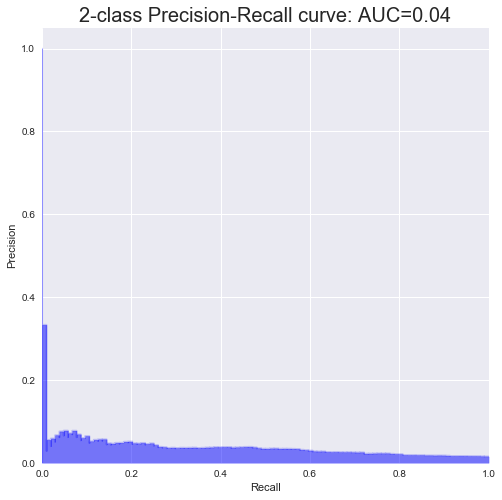

 
Iteration : 19 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 1, 0.01]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.29%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6888


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14546    76]
 [ 6068   199]]


  Confusion Matrix - Test 
[[4833   42]
 [2027   62]

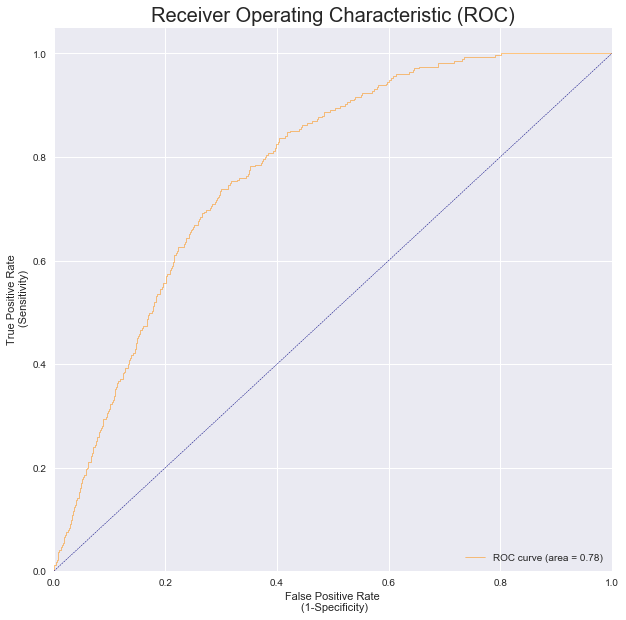


  Test AUC 


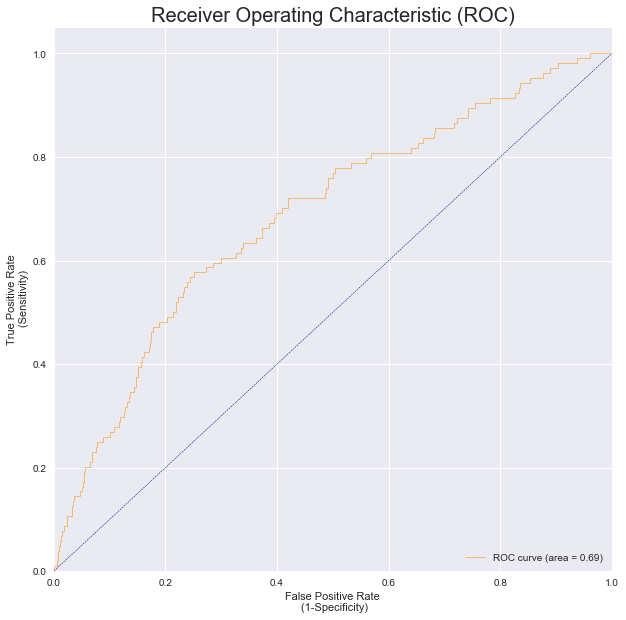


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


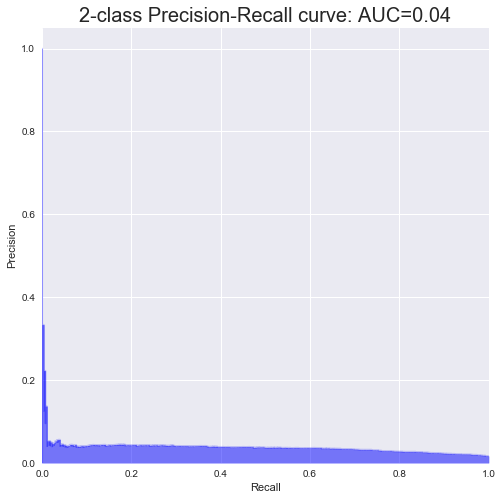


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


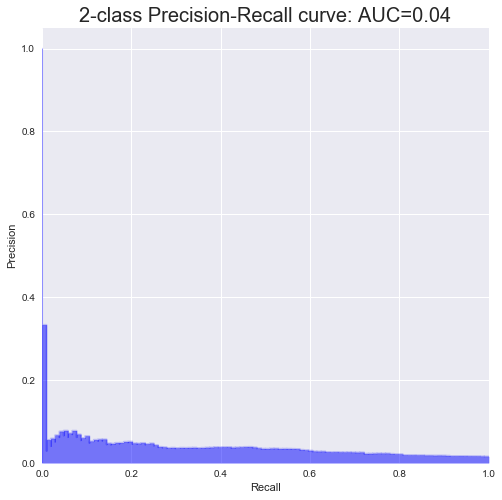

 
Iteration : 20 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 1, 0.1]
__________________________________________________________________

Accuracy - Training:  70.60%
Accuracy - test    :  70.30%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6888


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14548    76]
 [ 6066   199]]


  Confusion Matrix - Test 
[[4834   42]
 [2026   62]]

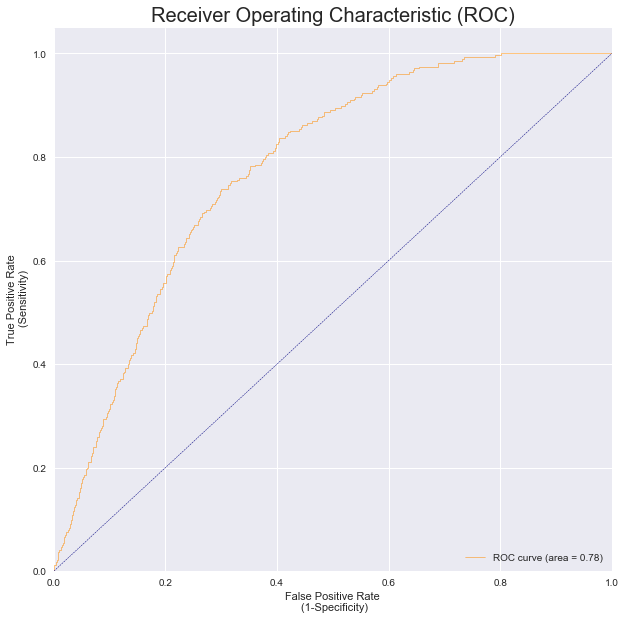


  Test AUC 


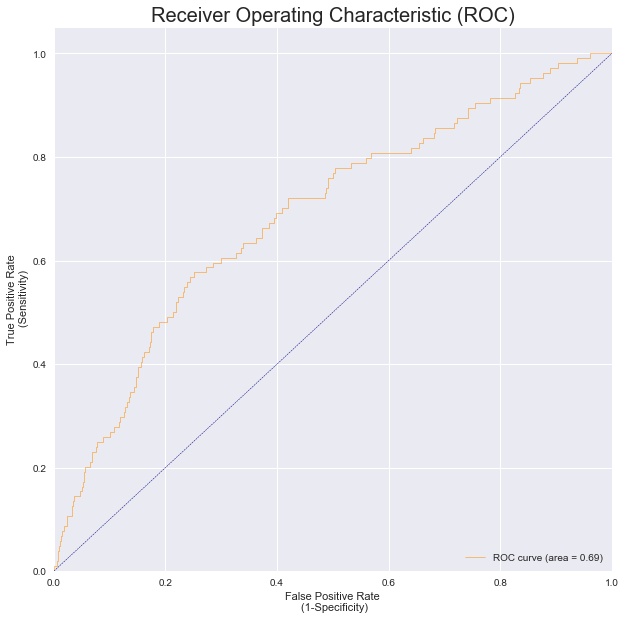


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


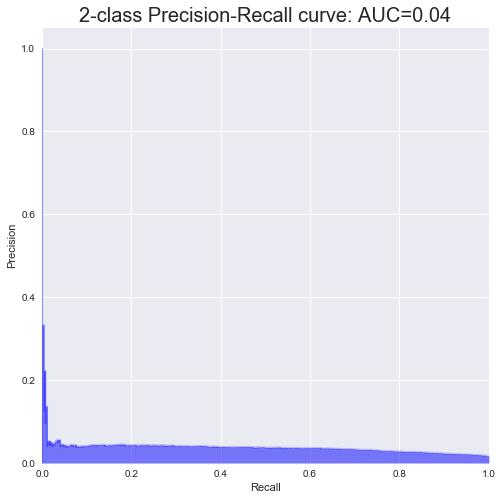


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


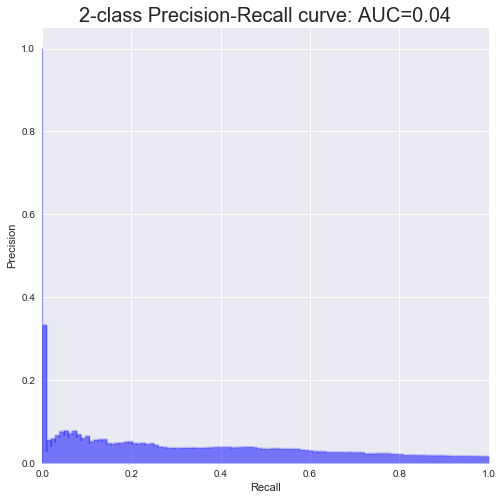

 
Iteration : 21 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 10, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.56%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14541    76]
 [ 6073   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   

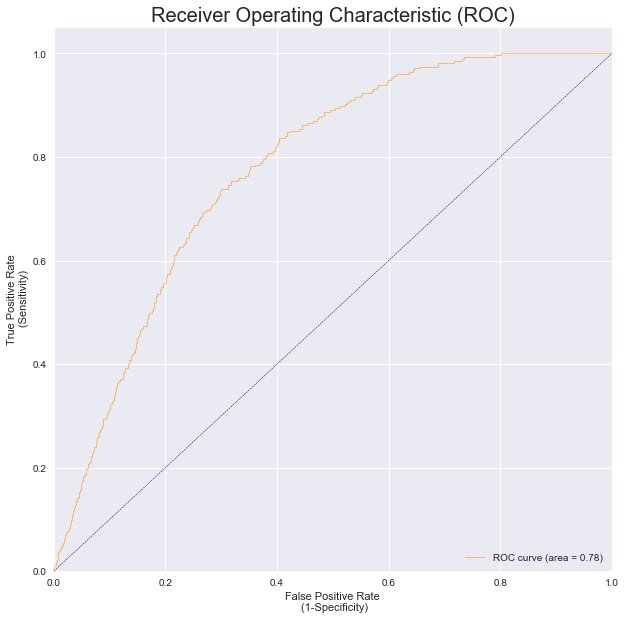


  Test AUC 


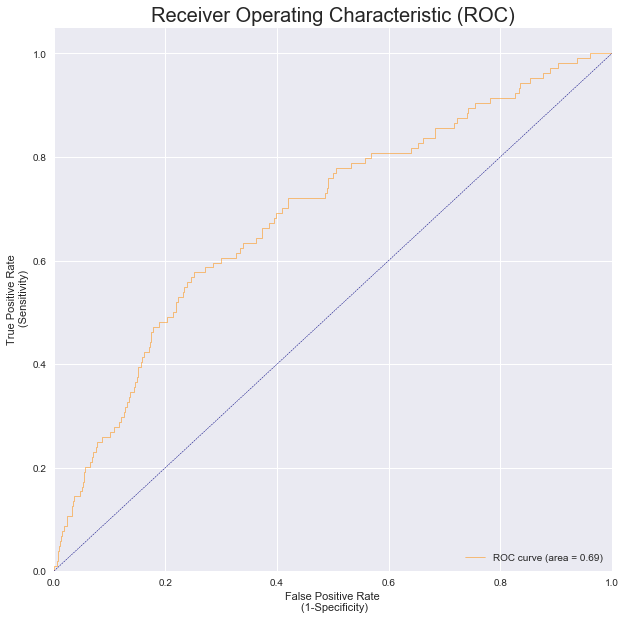


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


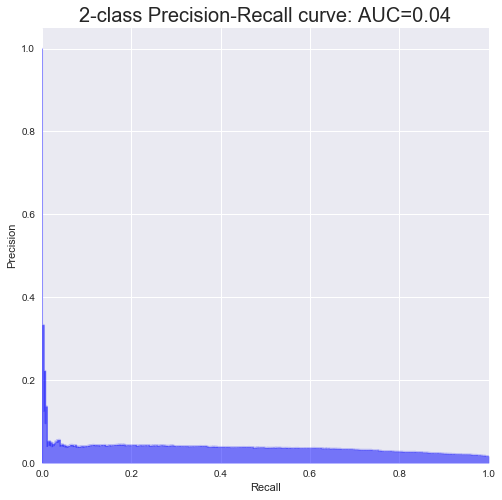


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


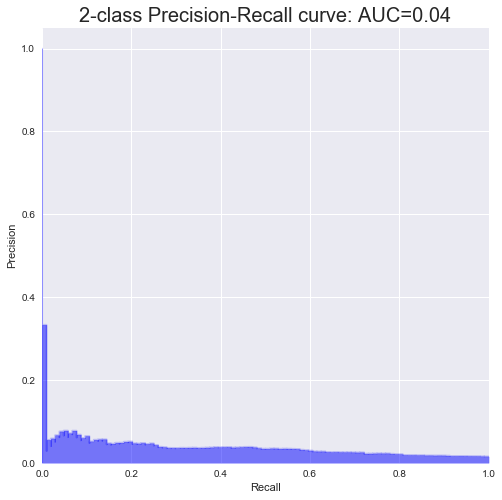

 
Iteration : 22 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 10, 0.001]
__________________________________________________________________

Accuracy - Training:  70.56%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14541    76]
 [ 6073   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   6

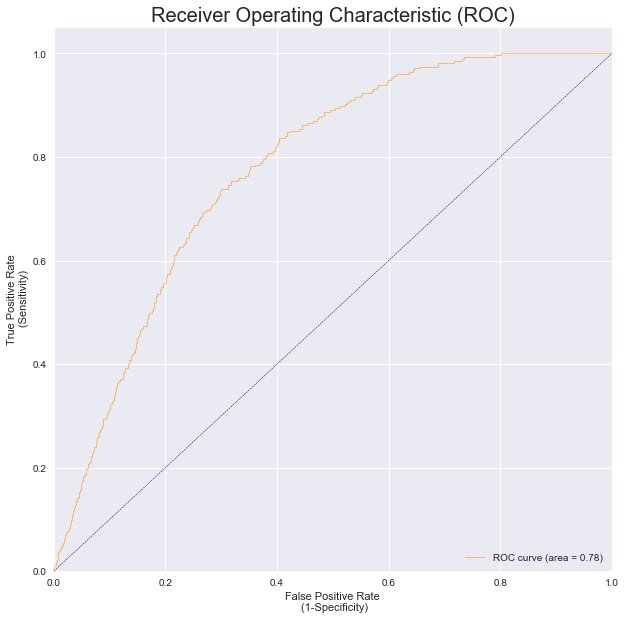


  Test AUC 


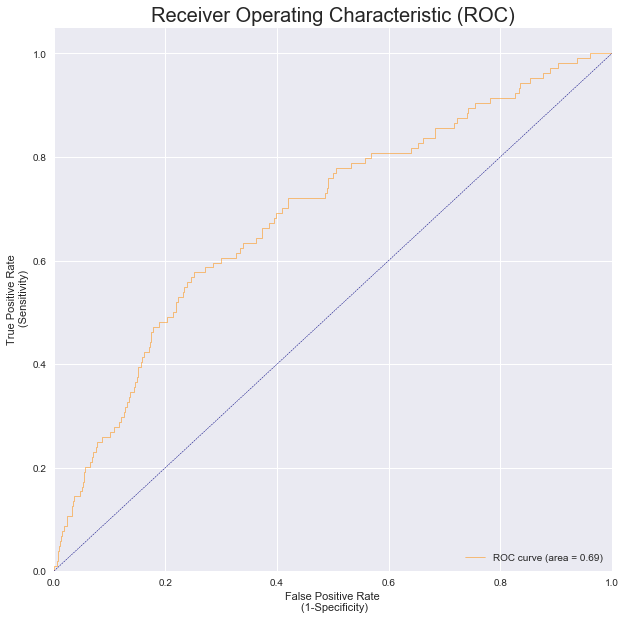


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


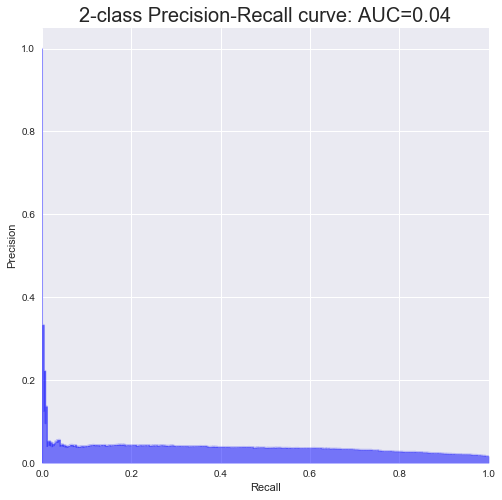


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


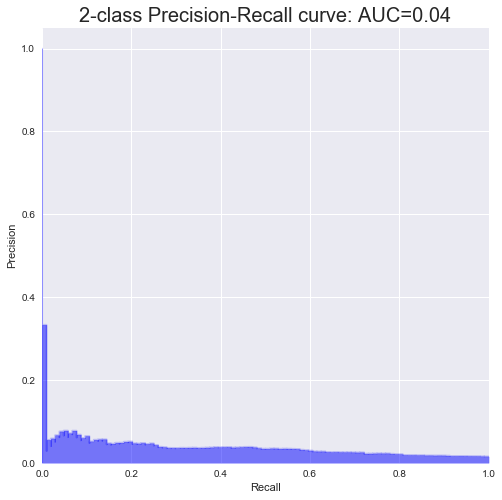

 
Iteration : 23 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 10, 0.01]
__________________________________________________________________

Accuracy - Training:  70.56%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14541    76]
 [ 6073   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62

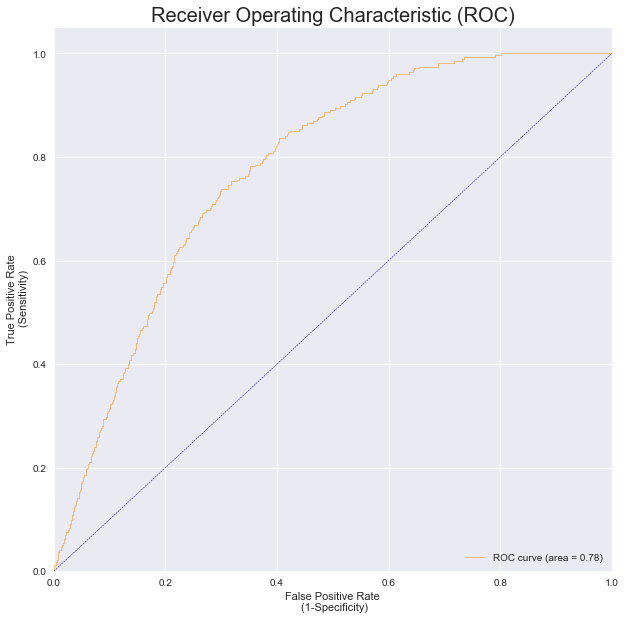


  Test AUC 


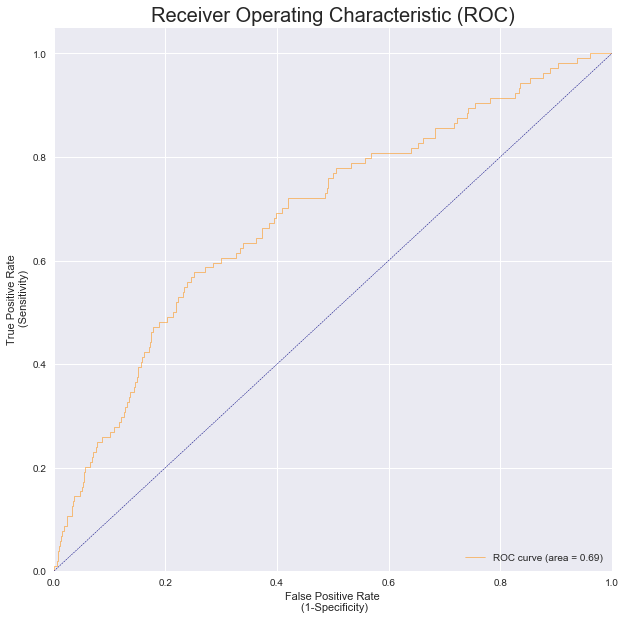


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


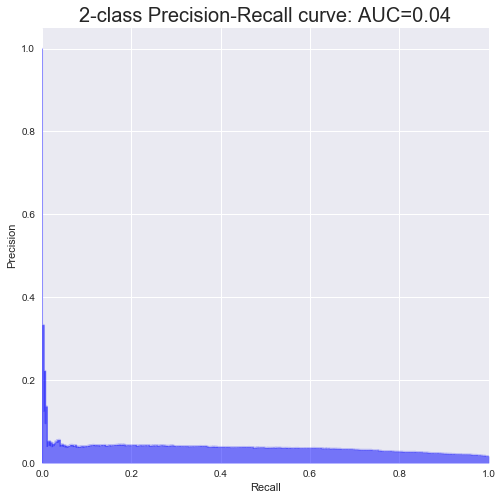


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


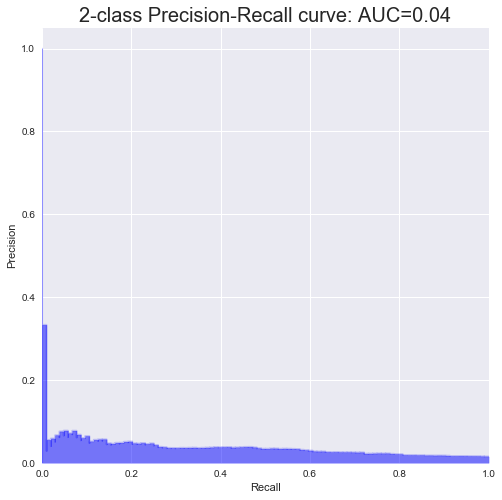

 
Iteration : 24 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['newton-cg', 10, 0.1]
__________________________________________________________________

Accuracy - Training:  70.56%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14541    76]
 [ 6073   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]

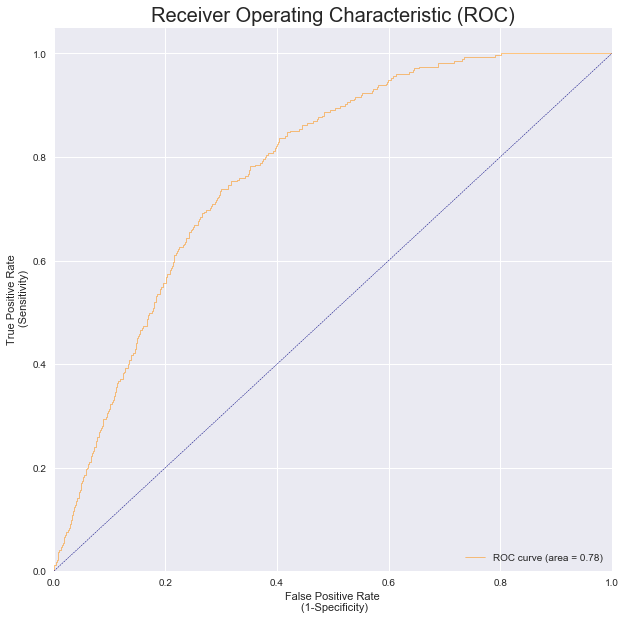


  Test AUC 


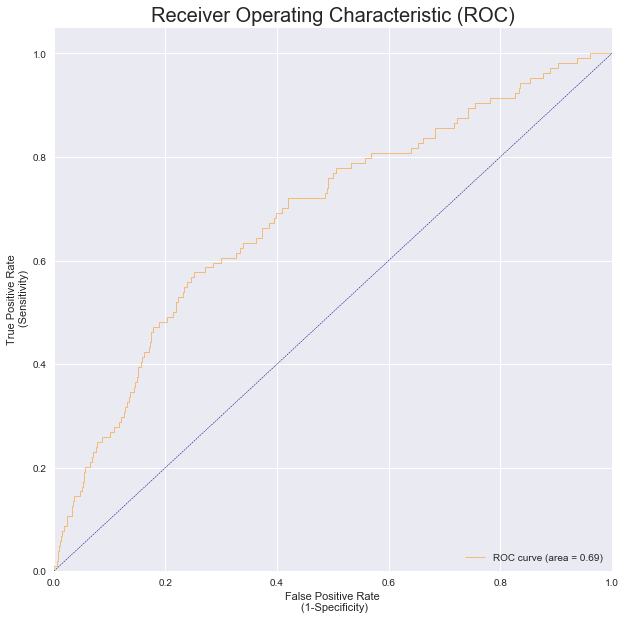


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


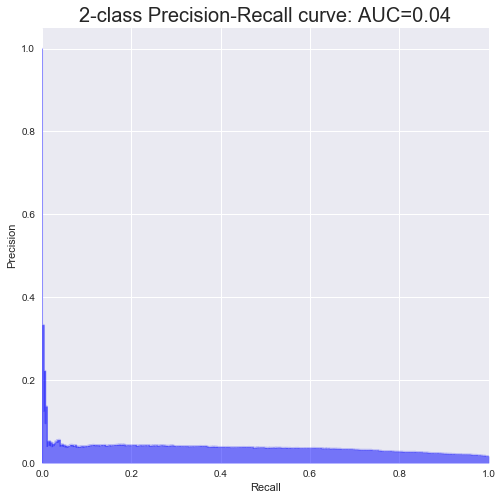


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


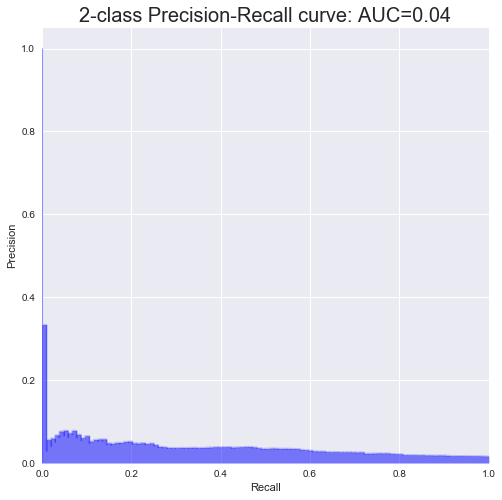

 
Iteration : 25 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.0001, 0.0001]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15039   112]
 [ 5575   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897   

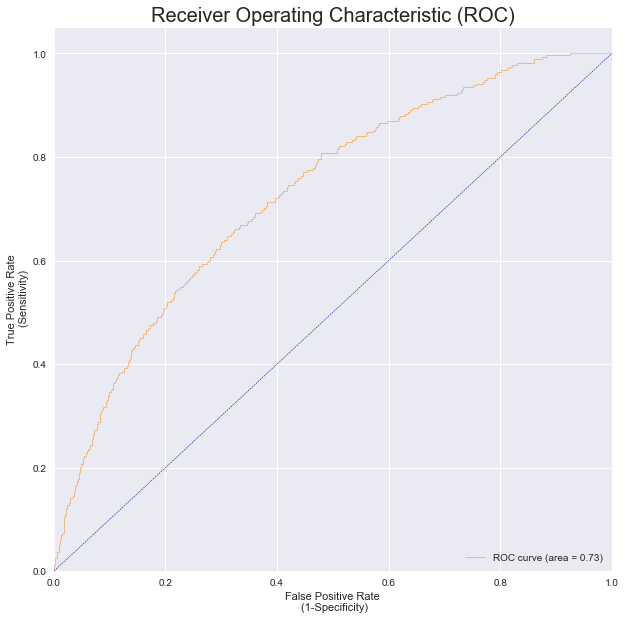


  Test AUC 


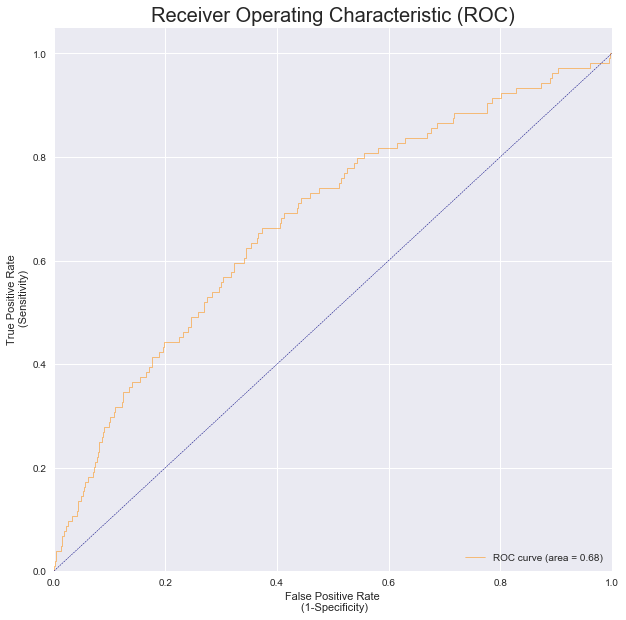


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


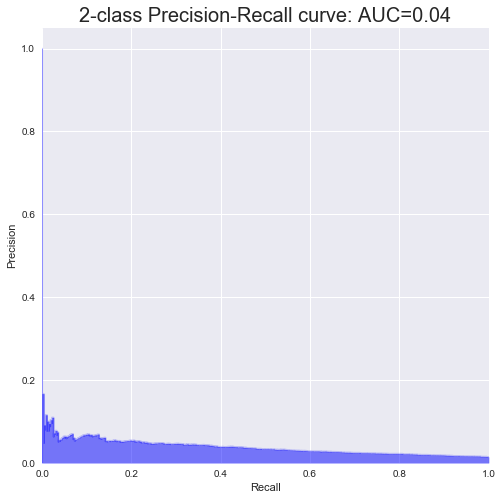


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


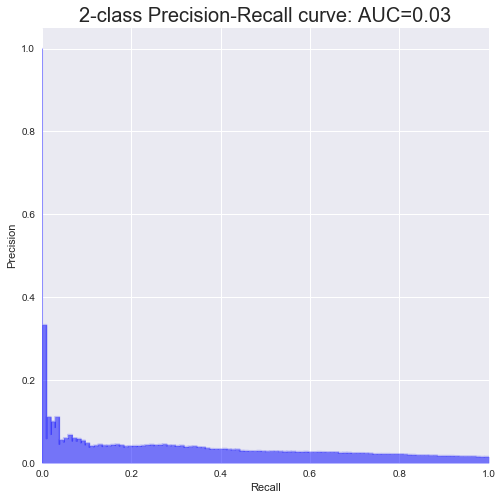

 
Iteration : 26 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.0001, 0.001]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15039   112]
 [ 5575   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897   5

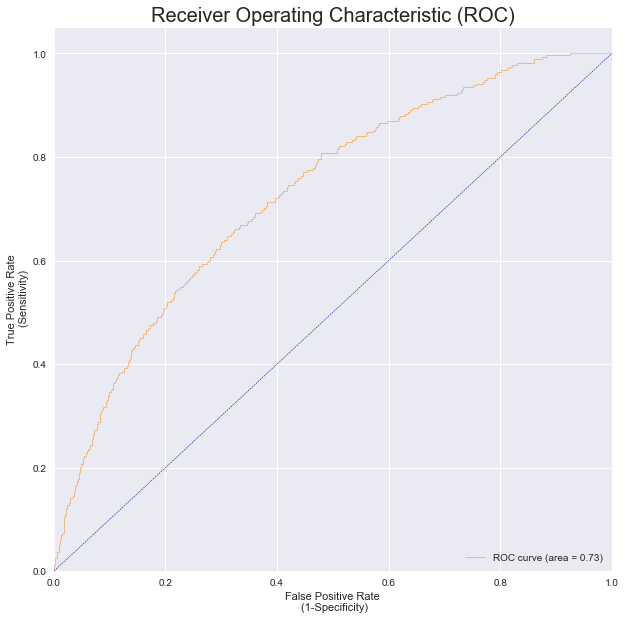


  Test AUC 


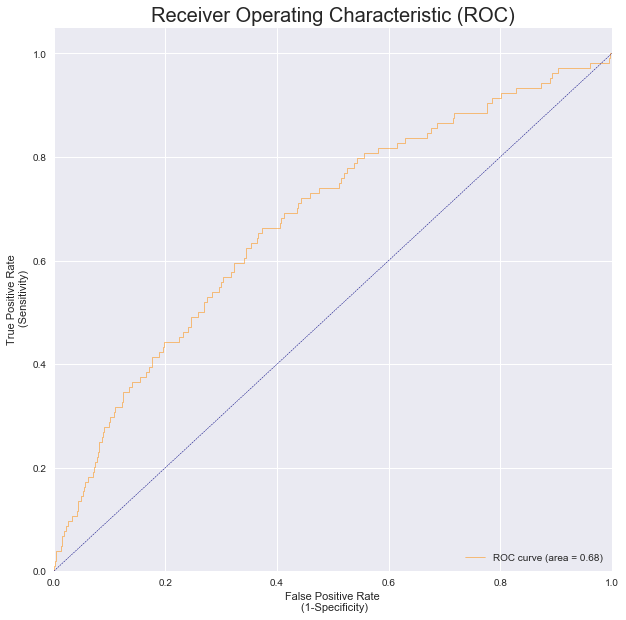


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


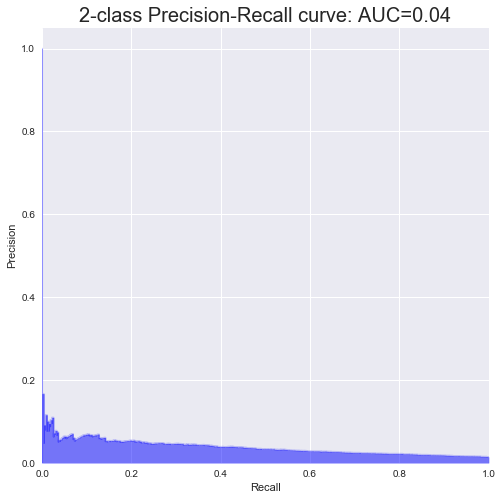


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


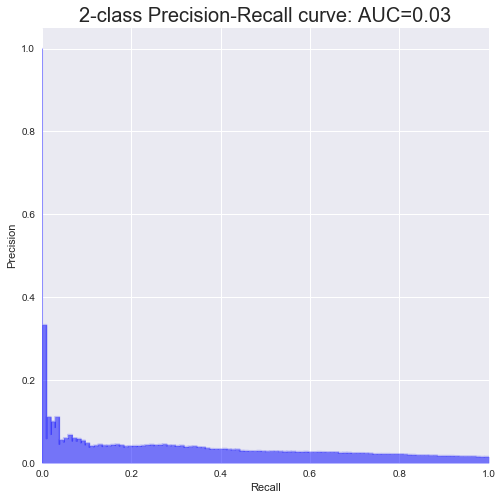

 
Iteration : 27 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.0001, 0.01]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15039   112]
 [ 5575   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897   55

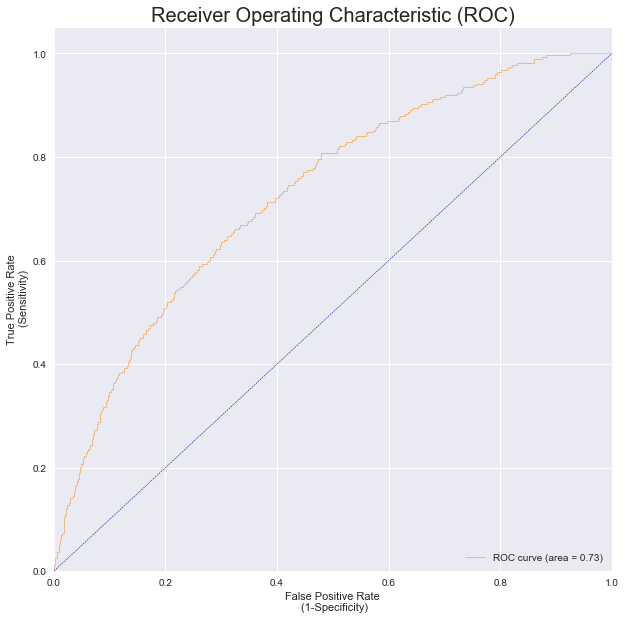


  Test AUC 


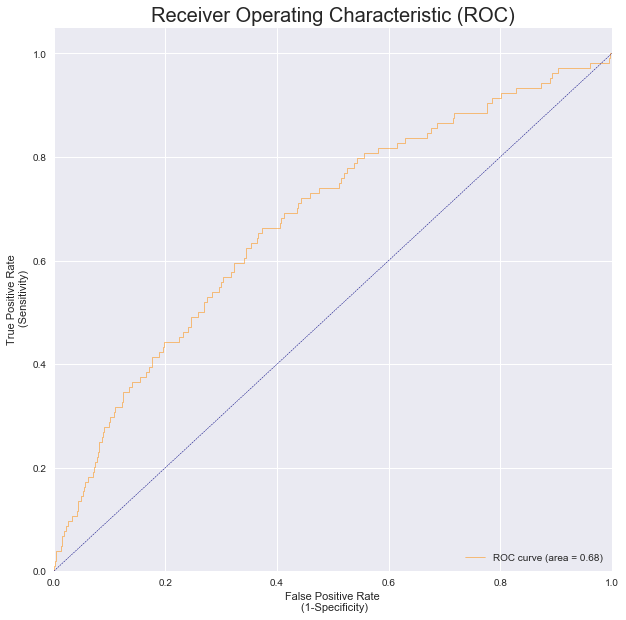


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


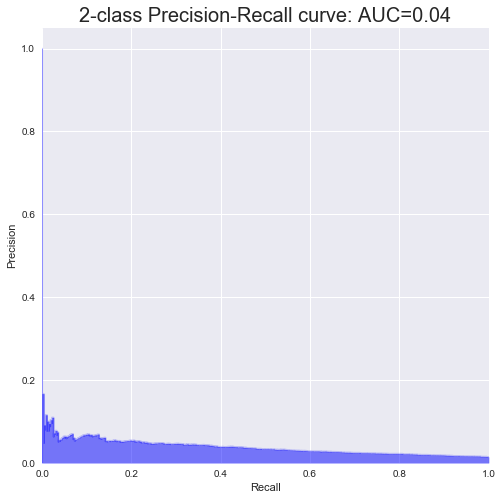


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


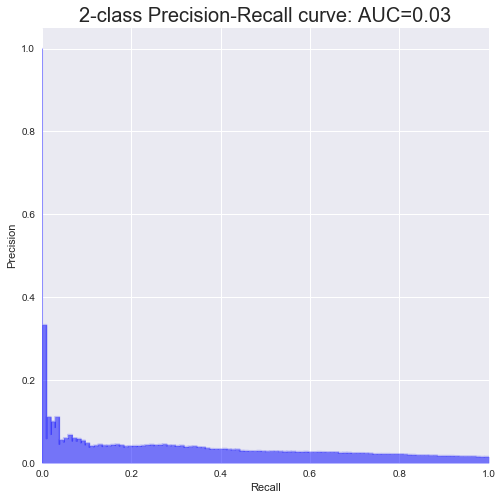

 
Iteration : 28 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.0001, 0.1]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15039   112]
 [ 5575   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897   55]

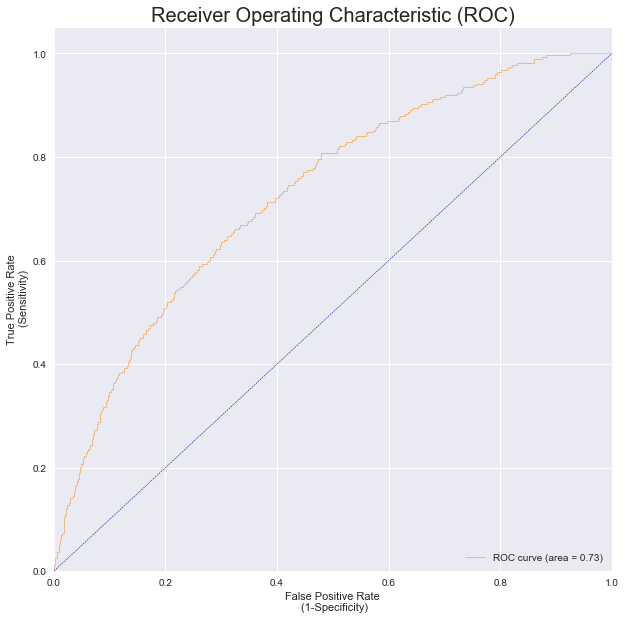


  Test AUC 


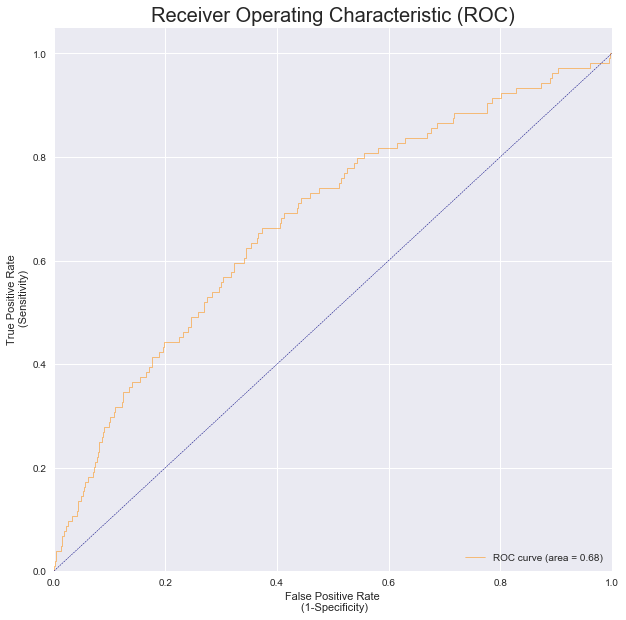


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


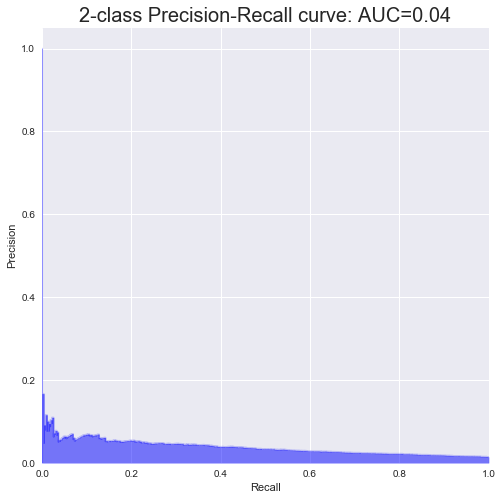


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


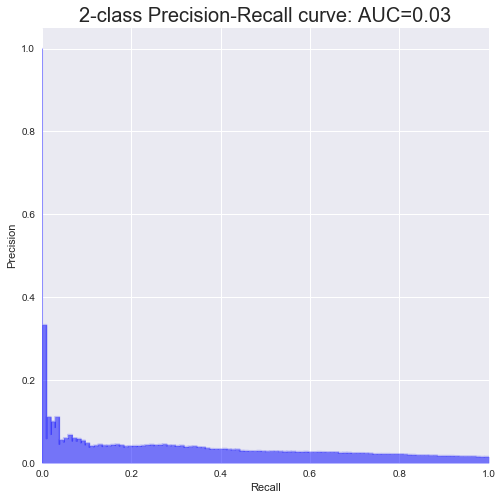

 
Iteration : 29 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.001, 0.0001]
__________________________________________________________________

Accuracy - Training:  71.77%
Accuracy - test    :  71.24%

AUC Performance
AUC - Training     : 0.7654
AUC - Test         : 0.6932


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.72      0.83     20614
          1       0.03      0.66      0.06       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[14810    94]
 [ 5804   181]]


  Confusion Matrix - Test 
[[4899   42]
 [1961   6

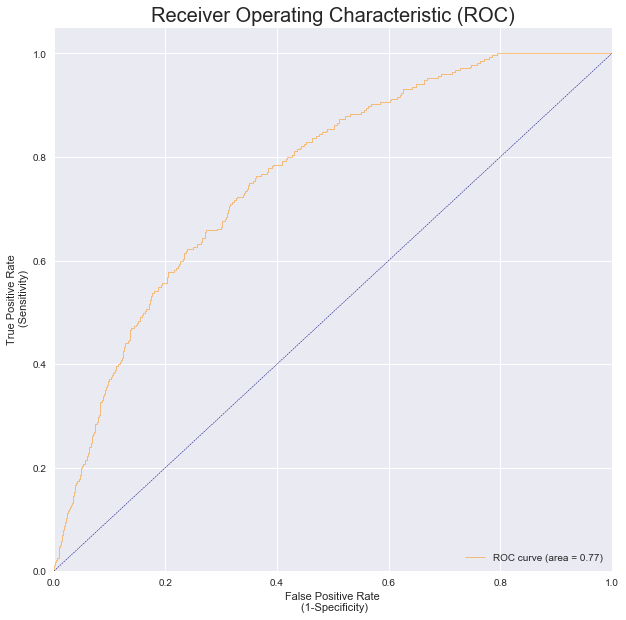


  Test AUC 


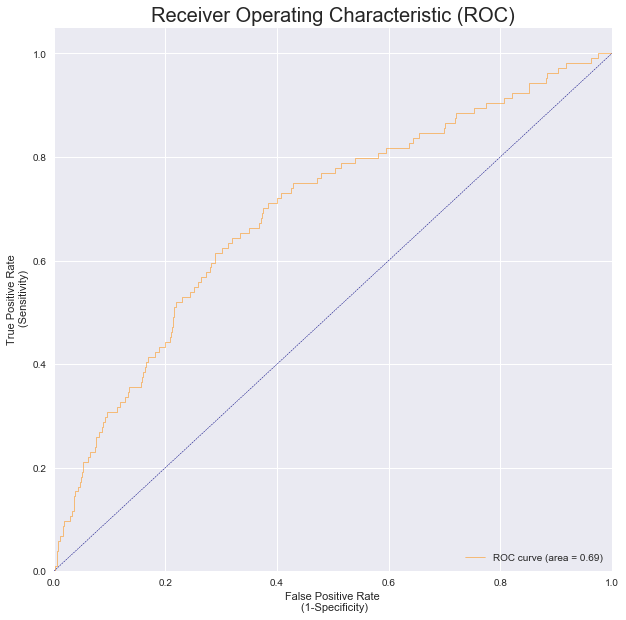


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


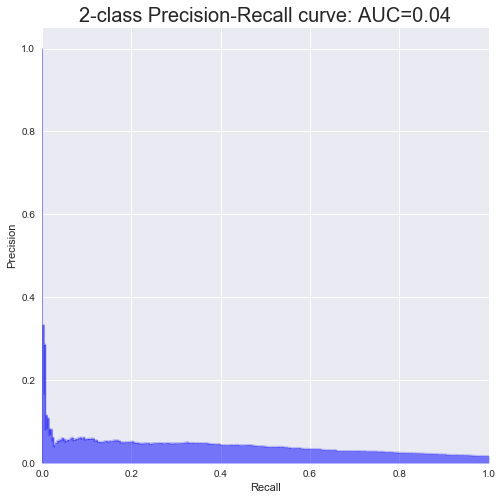


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


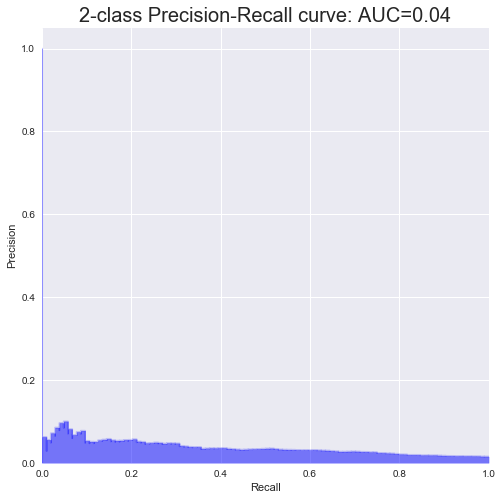

 
Iteration : 30 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.001, 0.001]
__________________________________________________________________

Accuracy - Training:  71.77%
Accuracy - test    :  71.24%

AUC Performance
AUC - Training     : 0.7654
AUC - Test         : 0.6932


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.72      0.83     20614
          1       0.03      0.66      0.06       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[14810    94]
 [ 5804   181]]


  Confusion Matrix - Test 
[[4899   42]
 [1961   62

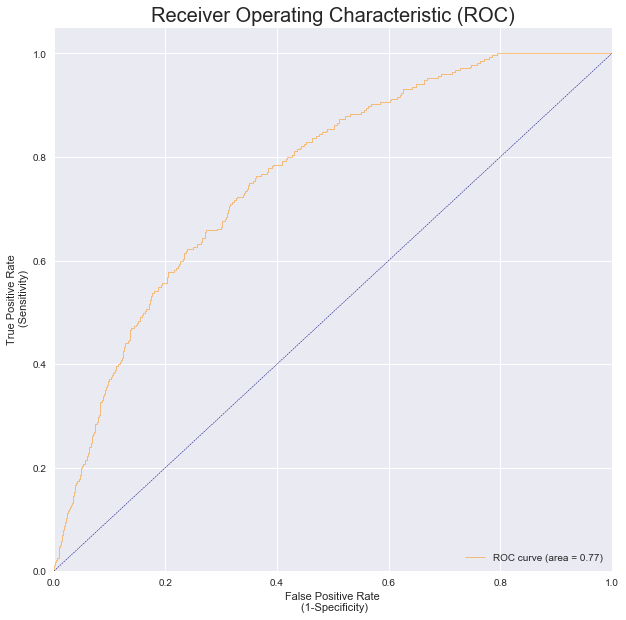


  Test AUC 


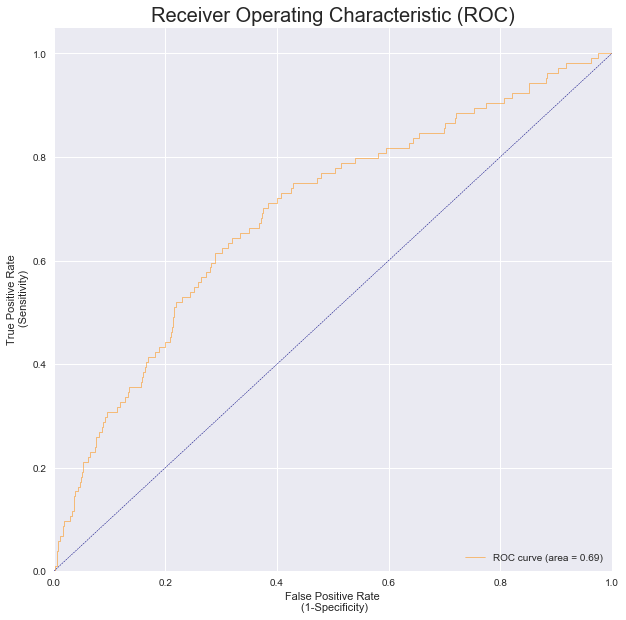


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


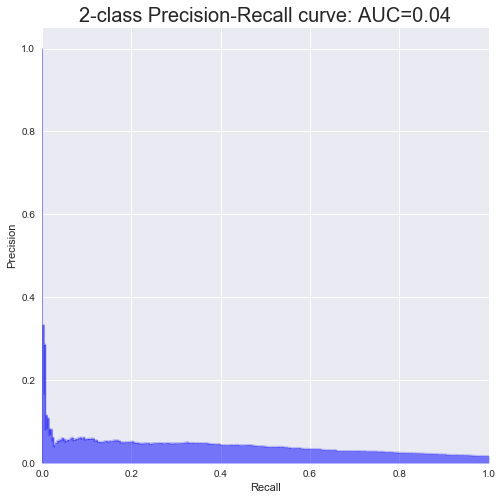


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


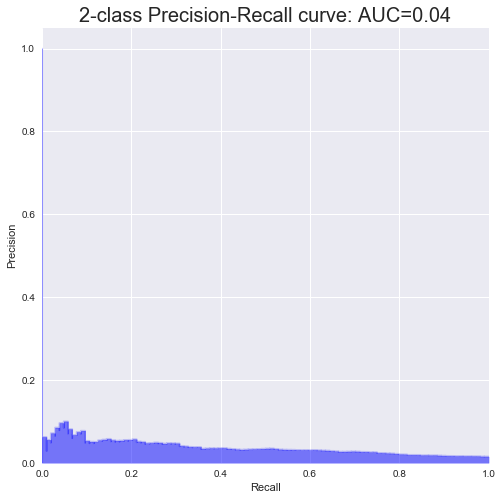

 
Iteration : 31 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.001, 0.01]
__________________________________________________________________

Accuracy - Training:  71.77%
Accuracy - test    :  71.24%

AUC Performance
AUC - Training     : 0.7654
AUC - Test         : 0.6932


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.72      0.83     20614
          1       0.03      0.66      0.06       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[14810    94]
 [ 5804   181]]


  Confusion Matrix - Test 
[[4899   42]
 [1961   62]

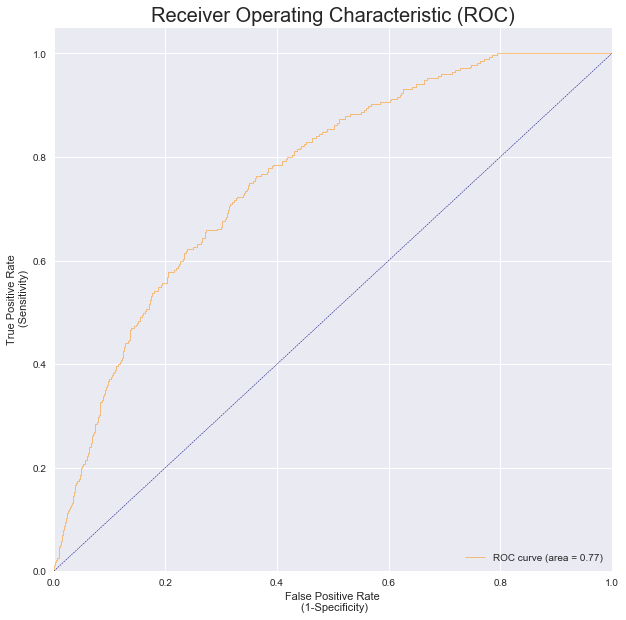


  Test AUC 


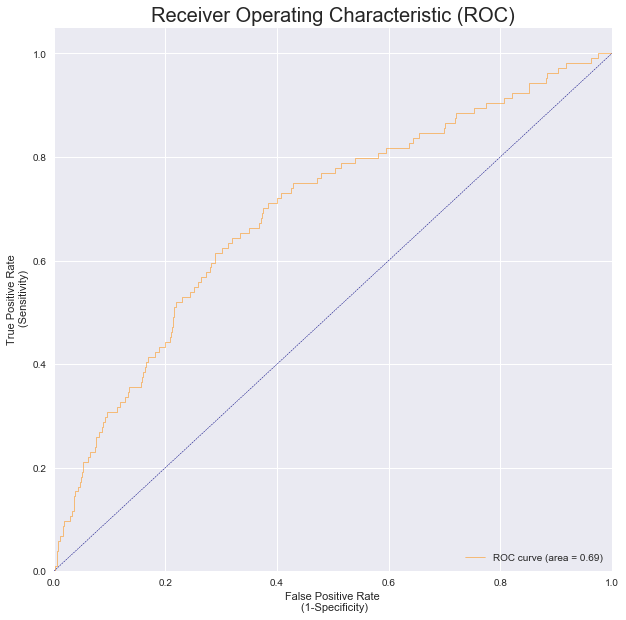


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


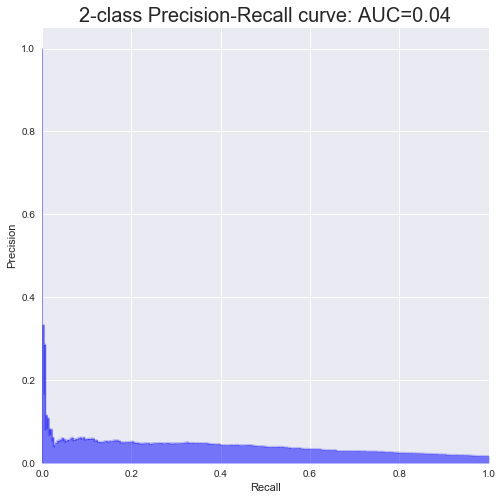


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


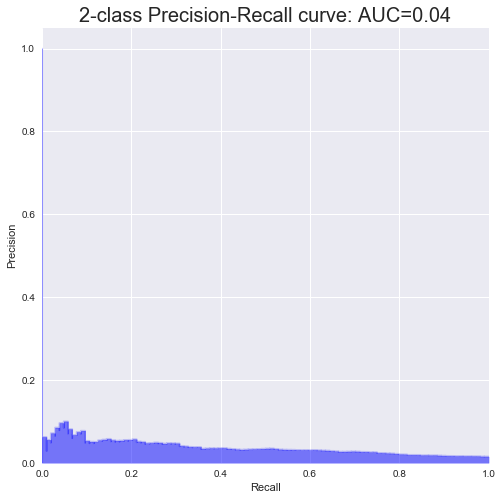

 
Iteration : 32 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.001, 0.1]
__________________________________________________________________

Accuracy - Training:  71.77%
Accuracy - test    :  71.24%

AUC Performance
AUC - Training     : 0.7654
AUC - Test         : 0.6932


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.72      0.83     20614
          1       0.03      0.66      0.06       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[14810    94]
 [ 5804   181]]


  Confusion Matrix - Test 
[[4899   42]
 [1961   62]]

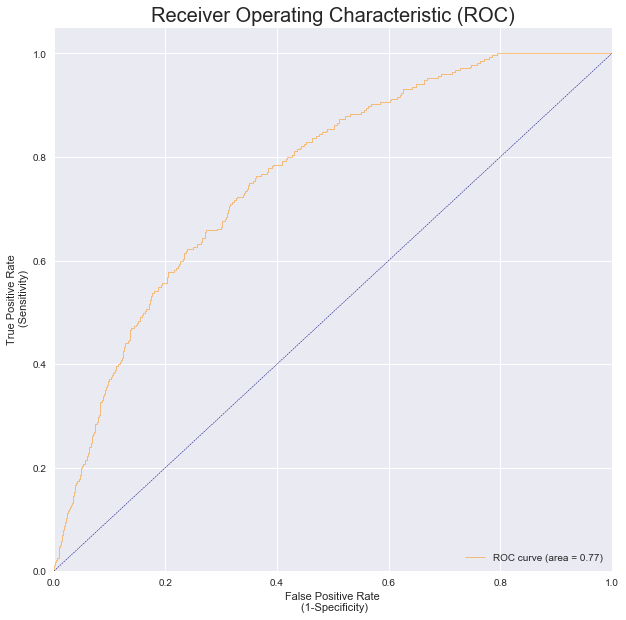


  Test AUC 


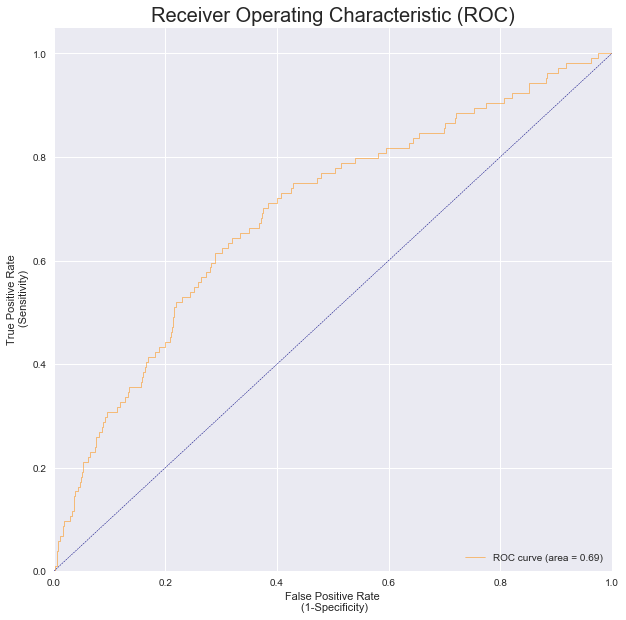


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


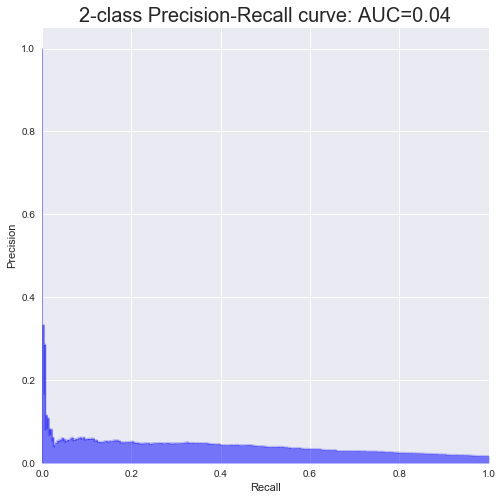


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


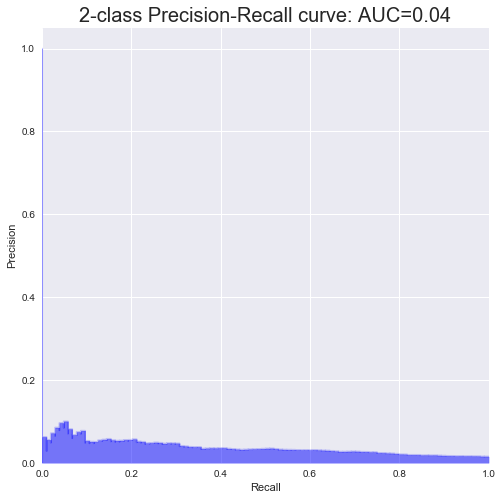

 
Iteration : 33 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.01, 0.0001]
__________________________________________________________________

Accuracy - Training:  71.02%
Accuracy - test    :  70.38%

AUC Performance
AUC - Training     : 0.7768
AUC - Test         : 0.6906


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14641    81]
 [ 5973   194]]


  Confusion Matrix - Test 
[[4839   42]
 [2021   62

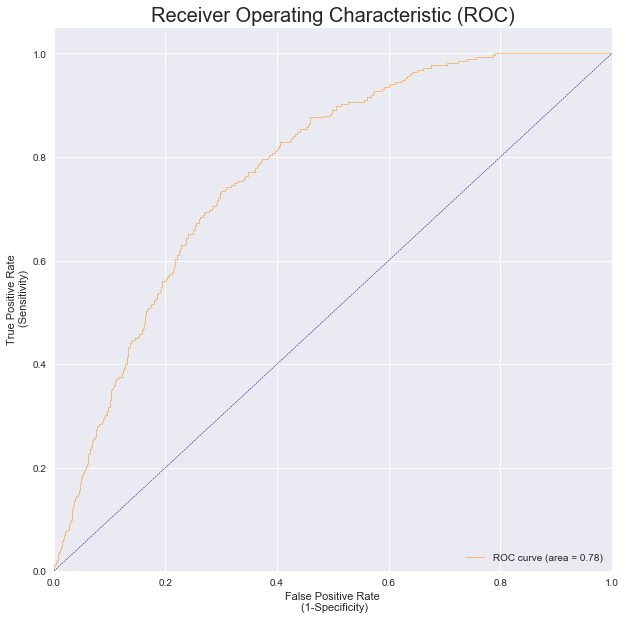


  Test AUC 


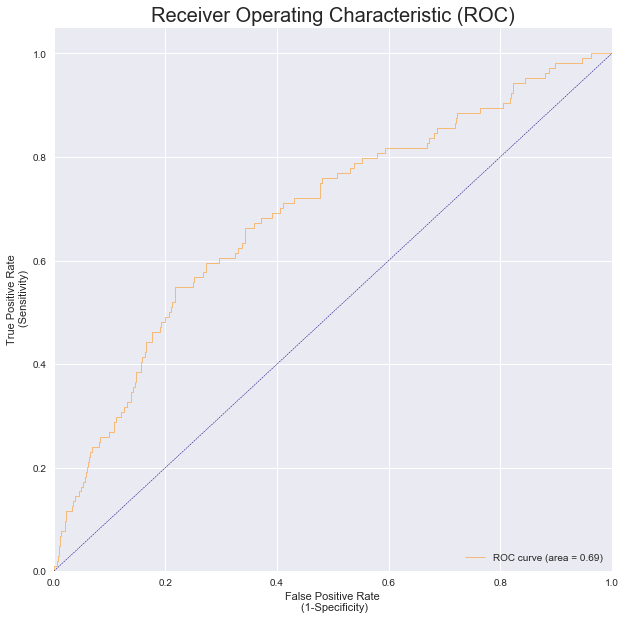


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


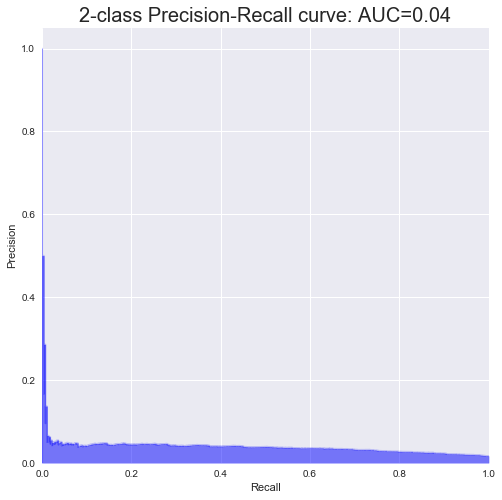


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


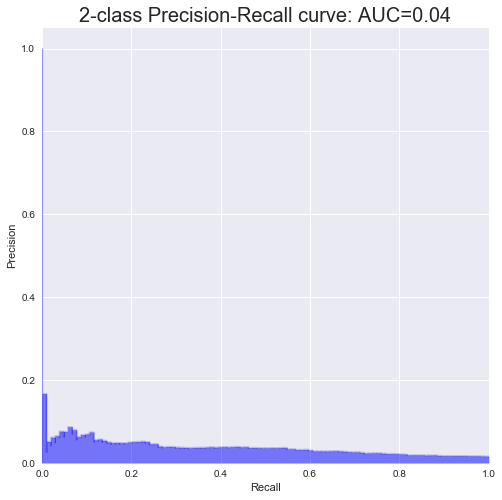

 
Iteration : 34 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.01, 0.001]
__________________________________________________________________

Accuracy - Training:  71.02%
Accuracy - test    :  70.38%

AUC Performance
AUC - Training     : 0.7768
AUC - Test         : 0.6906


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14641    81]
 [ 5973   194]]


  Confusion Matrix - Test 
[[4839   42]
 [2021   62]

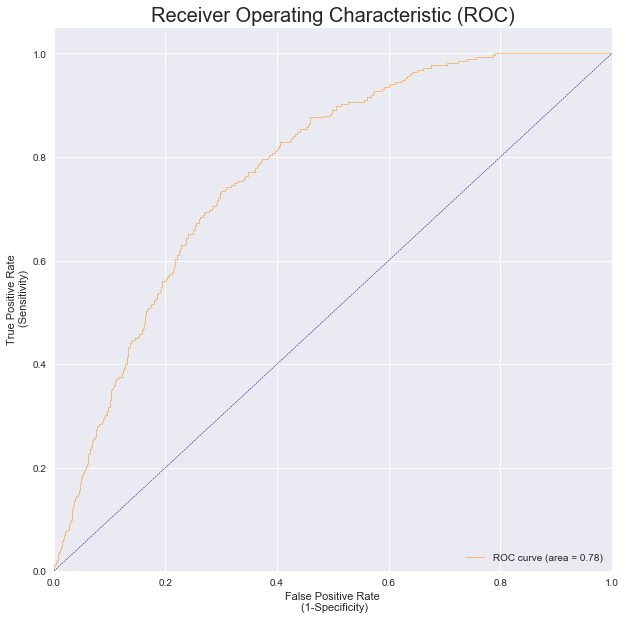


  Test AUC 


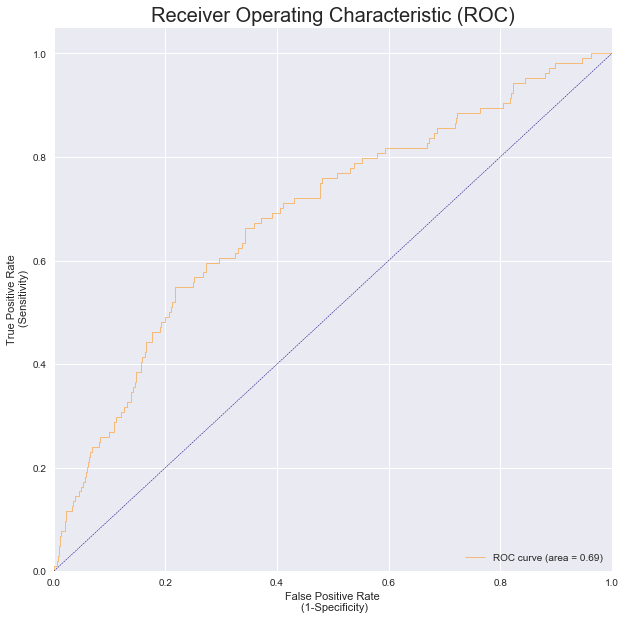


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


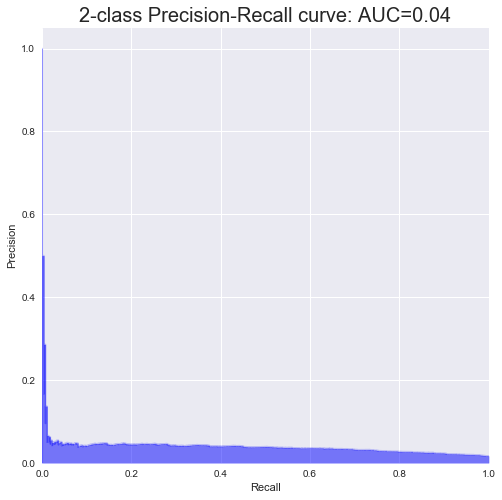


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


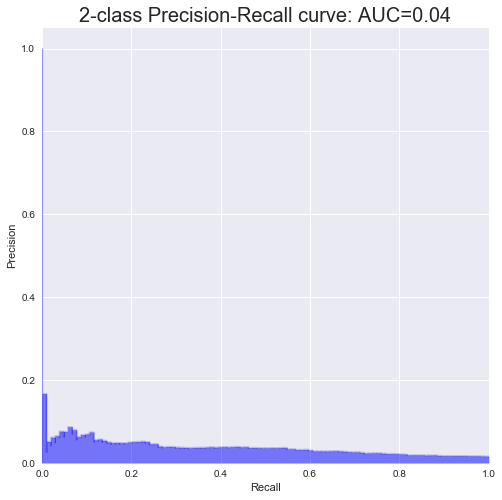

 
Iteration : 35 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.01, 0.01]
__________________________________________________________________

Accuracy - Training:  71.02%
Accuracy - test    :  70.38%

AUC Performance
AUC - Training     : 0.7768
AUC - Test         : 0.6906


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14641    81]
 [ 5973   194]]


  Confusion Matrix - Test 
[[4839   42]
 [2021   62]]

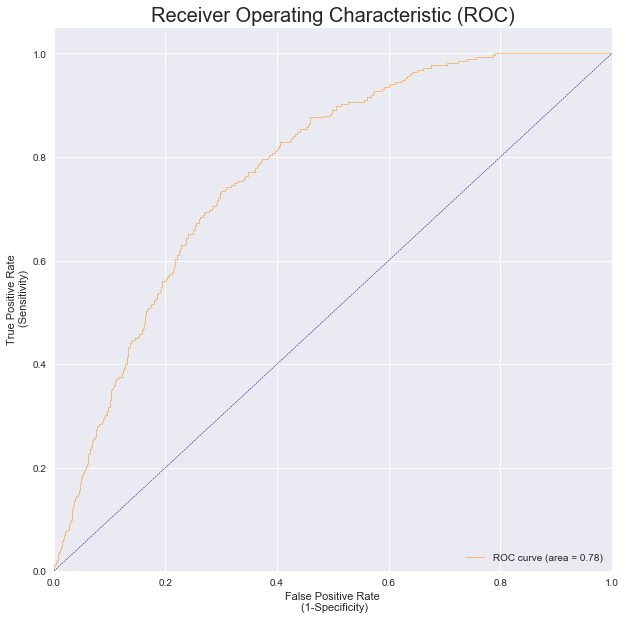


  Test AUC 


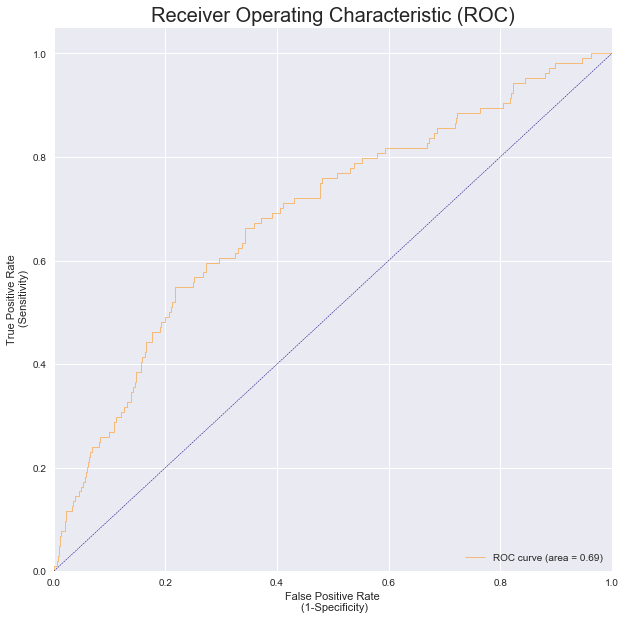


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


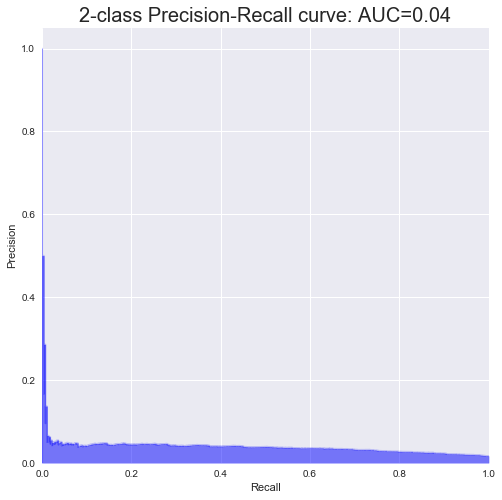


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


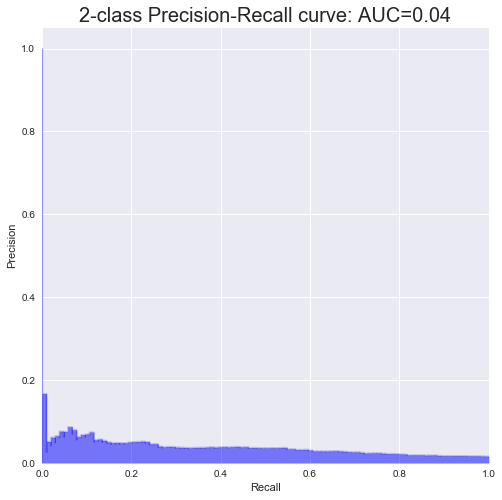

 
Iteration : 36 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.01, 0.1]
__________________________________________________________________

Accuracy - Training:  71.02%
Accuracy - test    :  70.38%

AUC Performance
AUC - Training     : 0.7768
AUC - Test         : 0.6906


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14641    81]
 [ 5973   194]]


  Confusion Matrix - Test 
[[4839   42]
 [2021   62]]


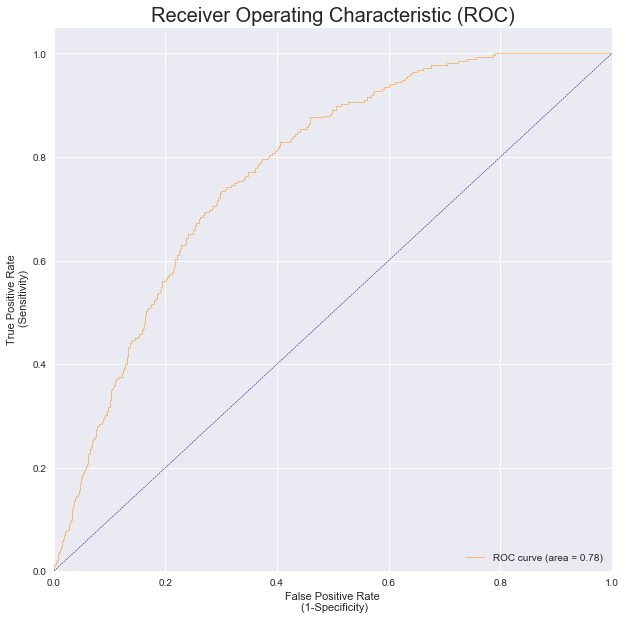


  Test AUC 


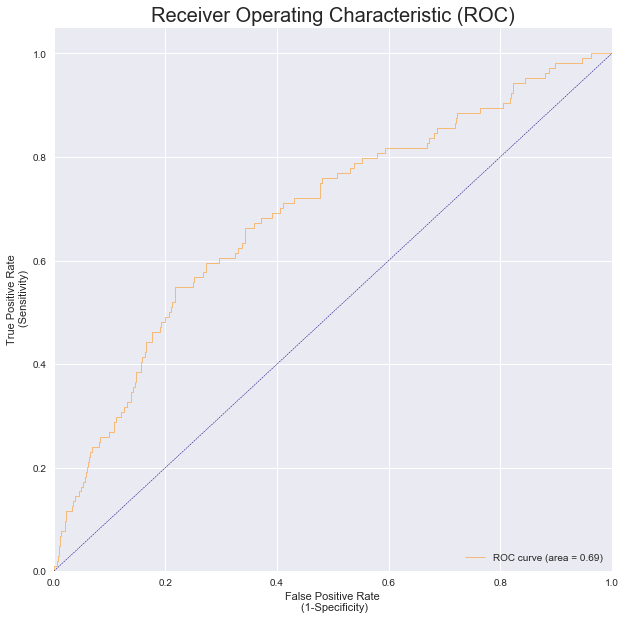


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


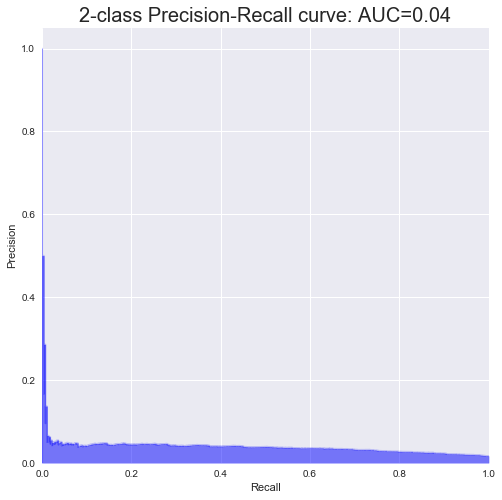


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


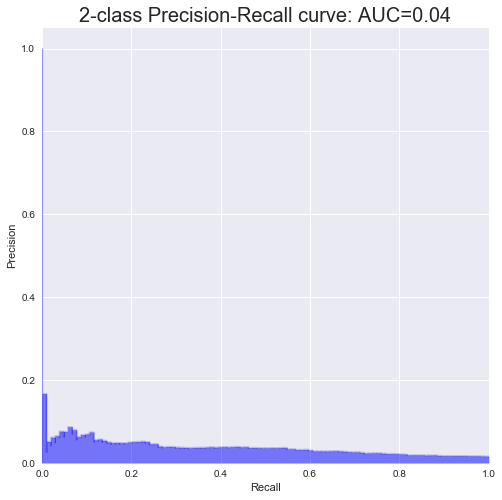

 
Iteration : 37 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.1, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.60%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14548    75]
 [ 6066   200]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]

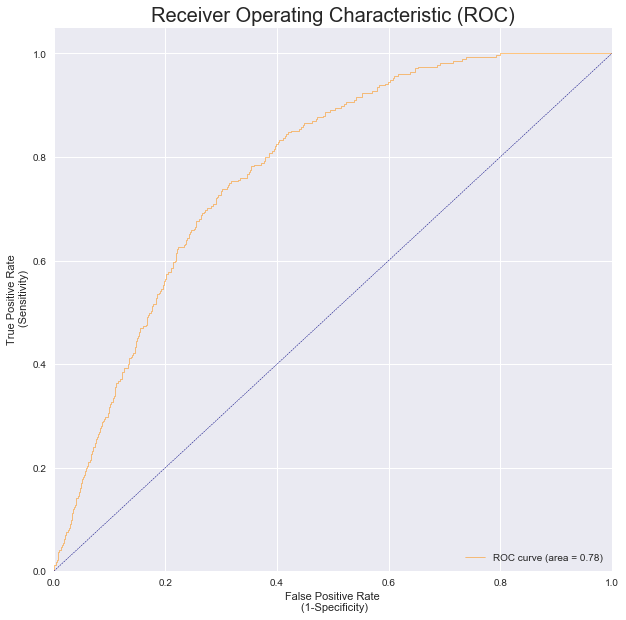


  Test AUC 


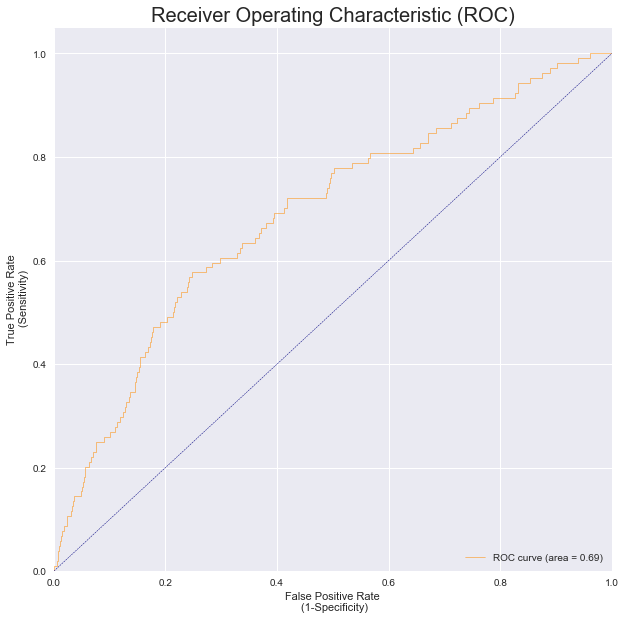


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


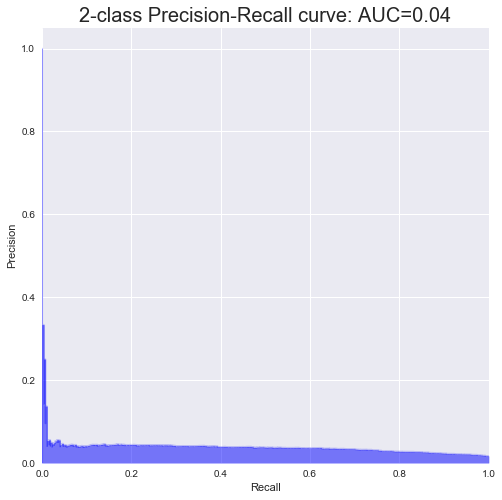


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


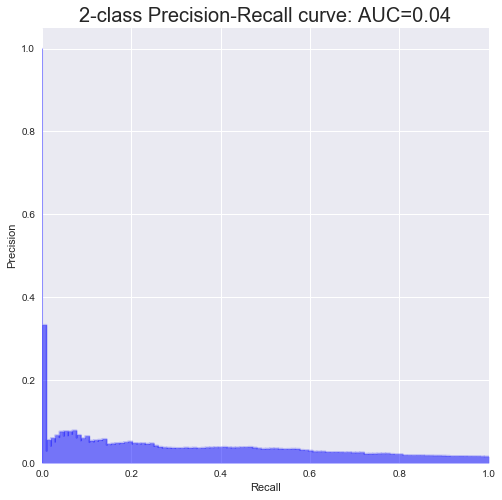

 
Iteration : 38 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.1, 0.001]
__________________________________________________________________

Accuracy - Training:  70.60%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14548    75]
 [ 6066   200]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]]

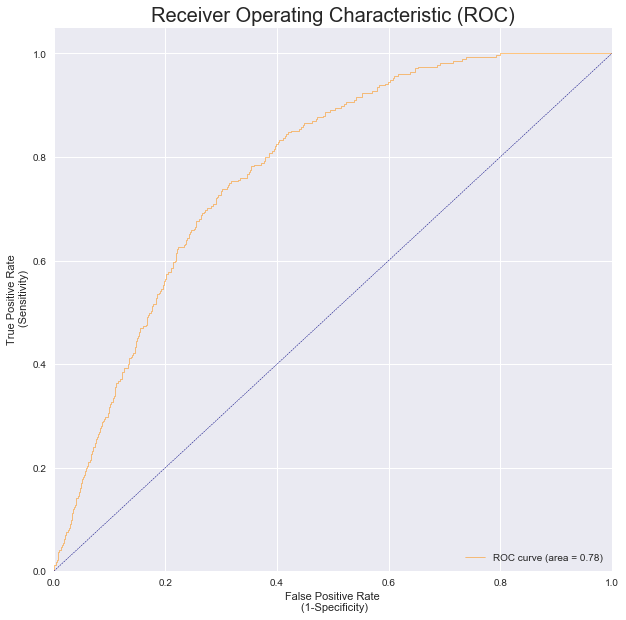


  Test AUC 


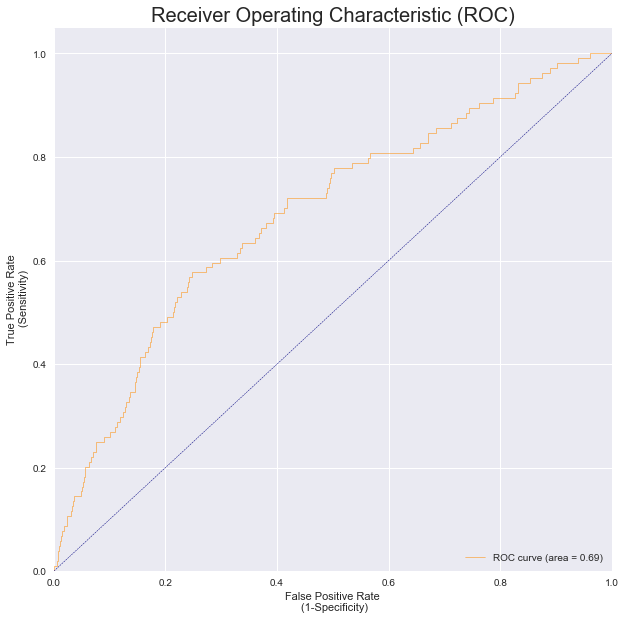


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


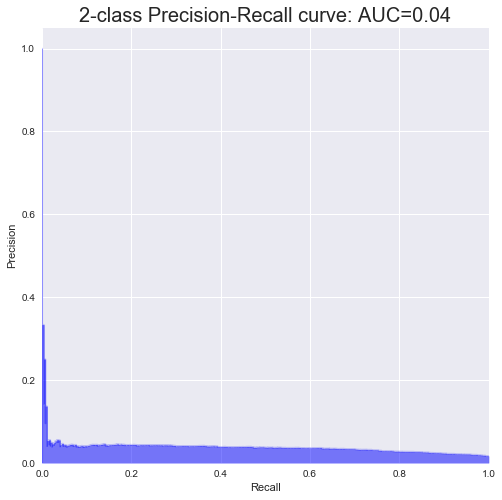


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


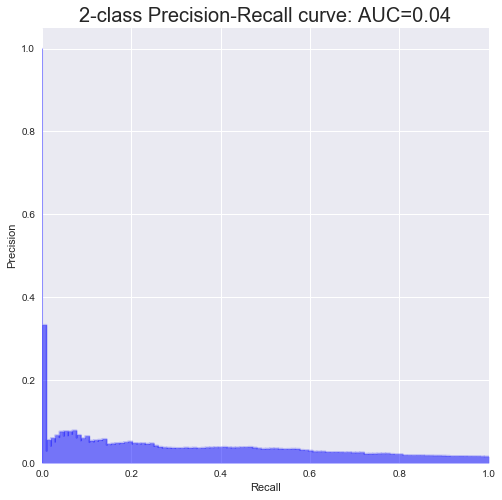

 
Iteration : 39 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.1, 0.01]
__________________________________________________________________

Accuracy - Training:  70.60%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14548    75]
 [ 6066   200]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]]


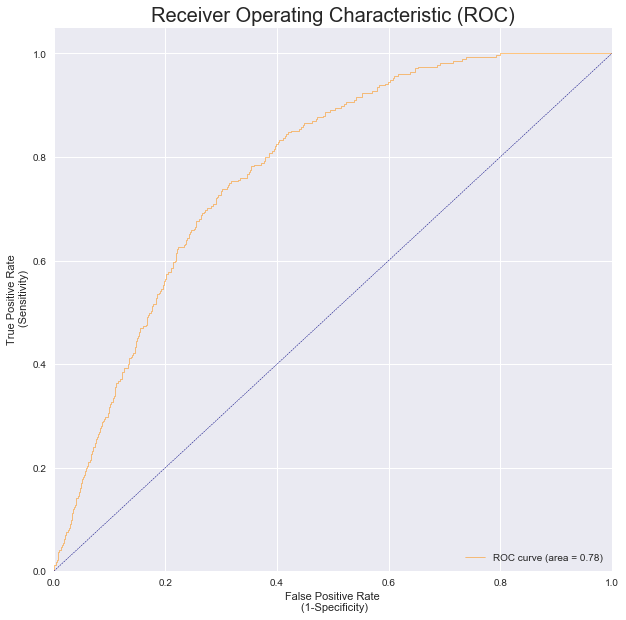


  Test AUC 


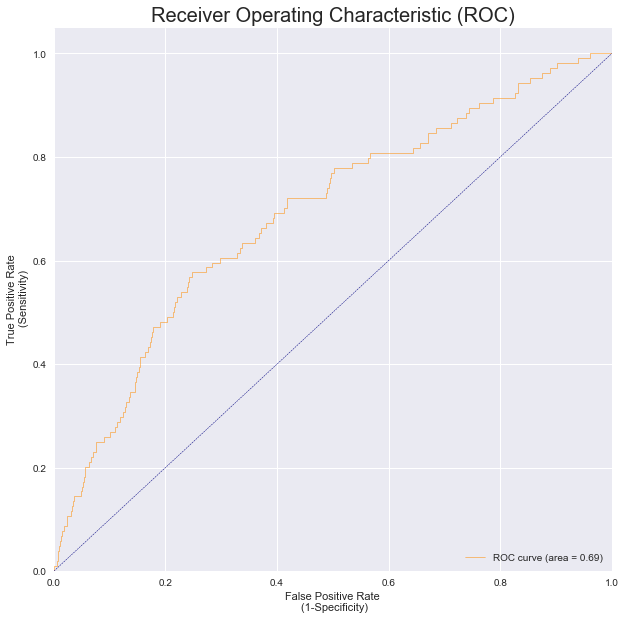


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


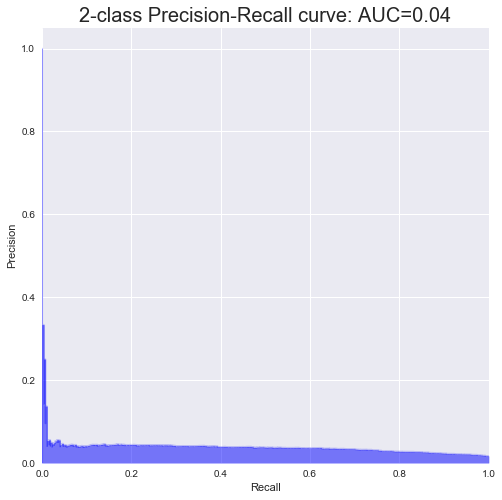


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


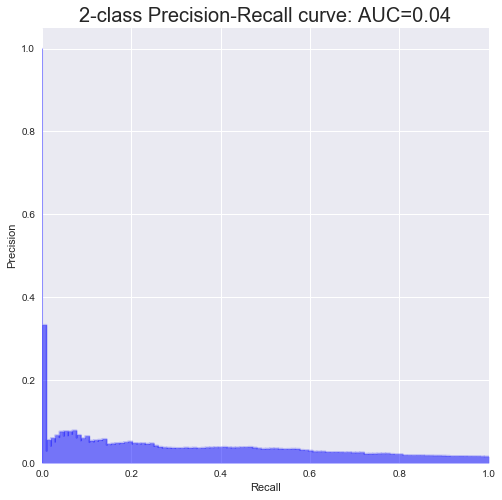

 
Iteration : 40 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 0.1, 0.1]
__________________________________________________________________

Accuracy - Training:  70.60%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14548    75]
 [ 6066   200]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]]



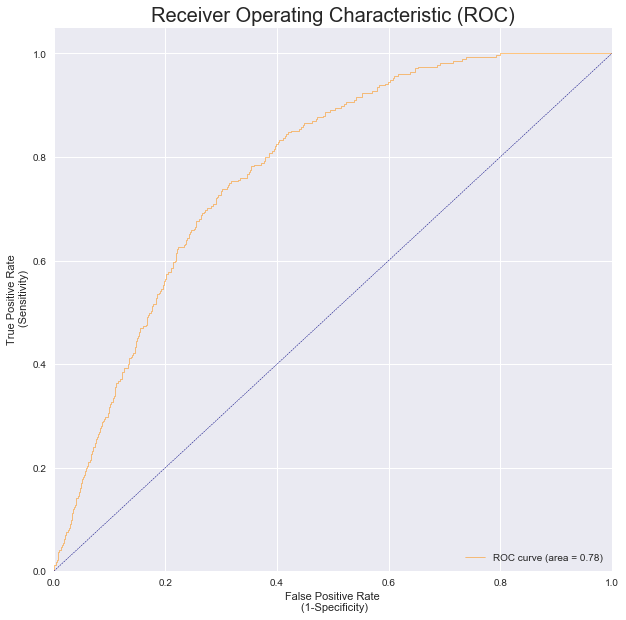


  Test AUC 


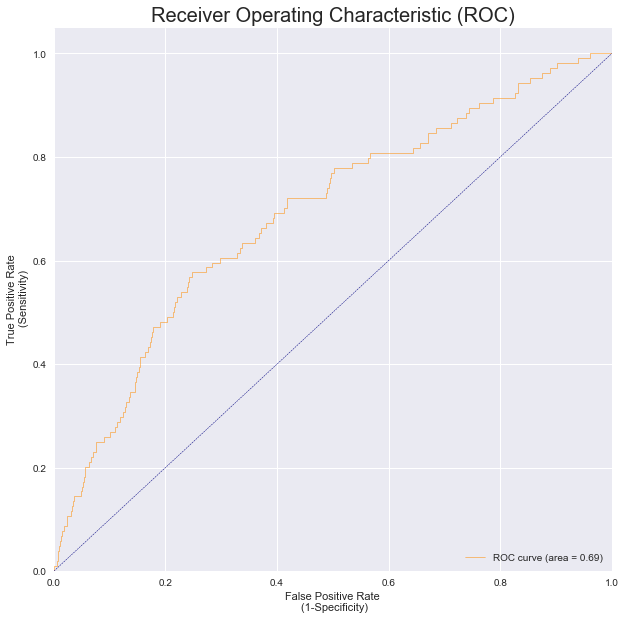


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


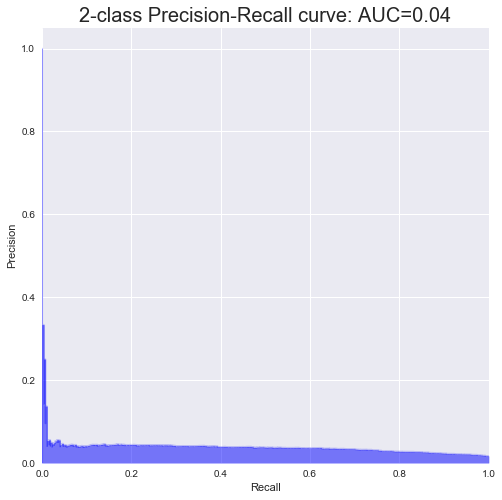


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


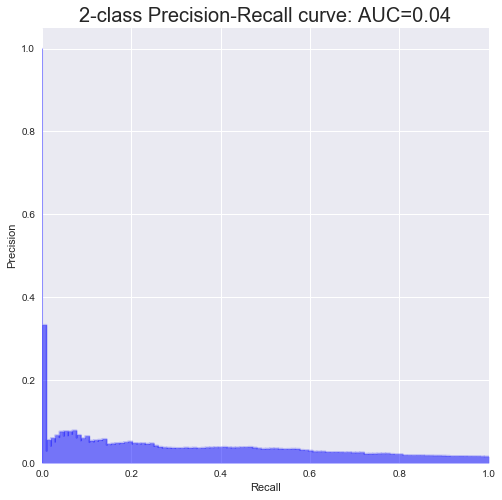

 
Iteration : 41 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 1, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.29%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14547    76]
 [ 6067   199]]


  Confusion Matrix - Test 
[[4833   42]
 [2027   62]]


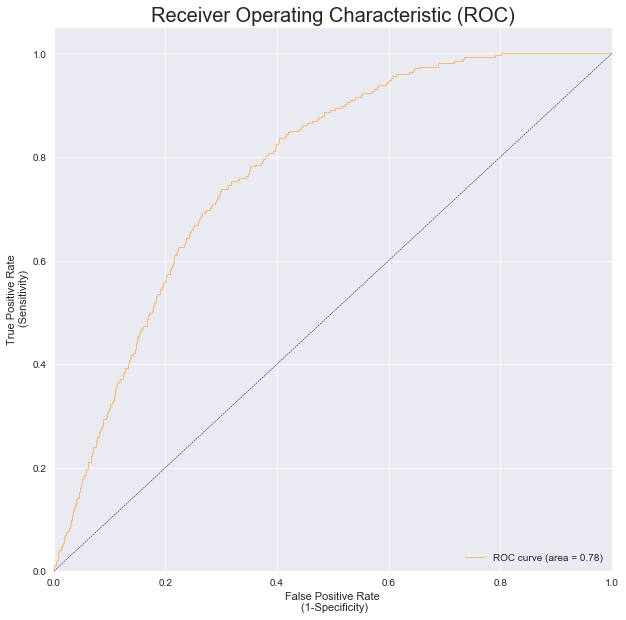


  Test AUC 


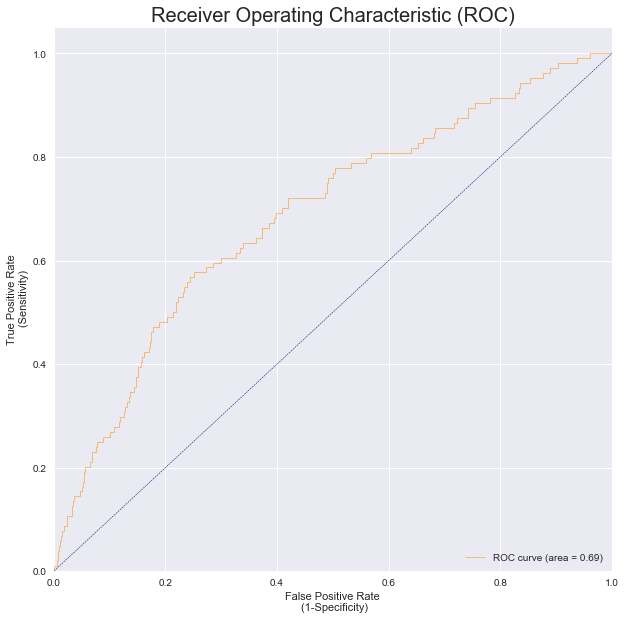


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


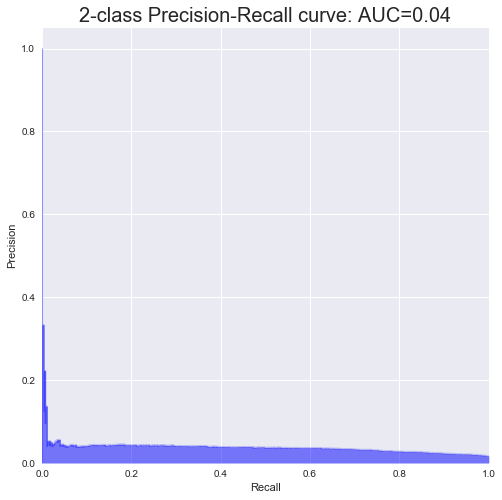


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


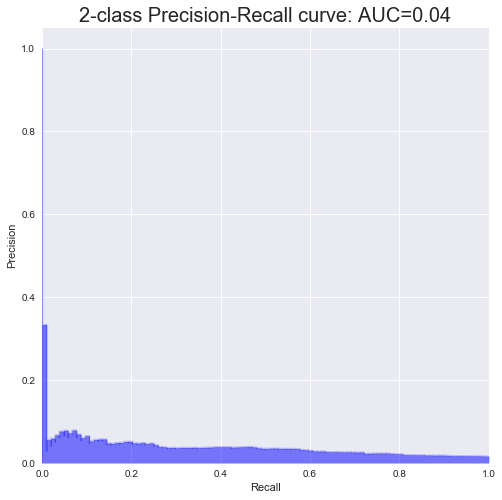

 
Iteration : 42 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 1, 0.001]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.29%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14547    76]
 [ 6067   199]]


  Confusion Matrix - Test 
[[4833   42]
 [2027   62]]



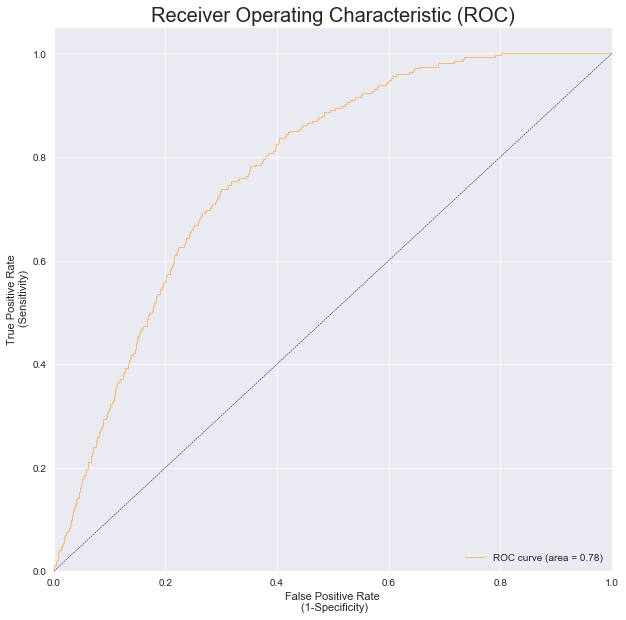


  Test AUC 


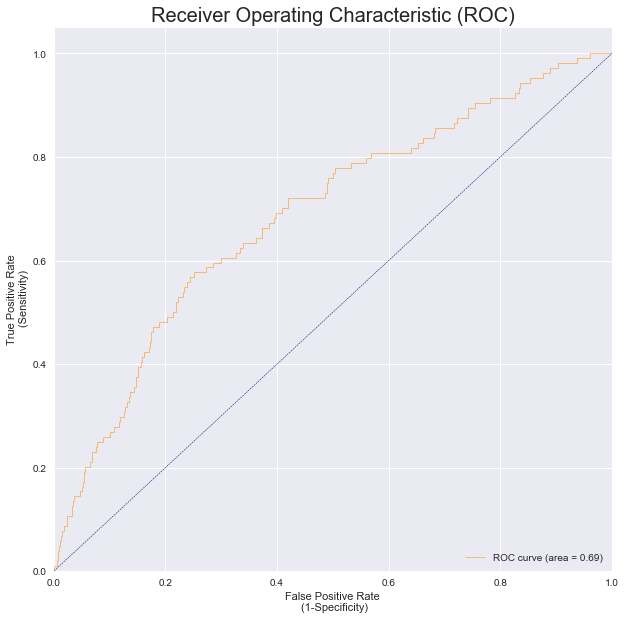


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


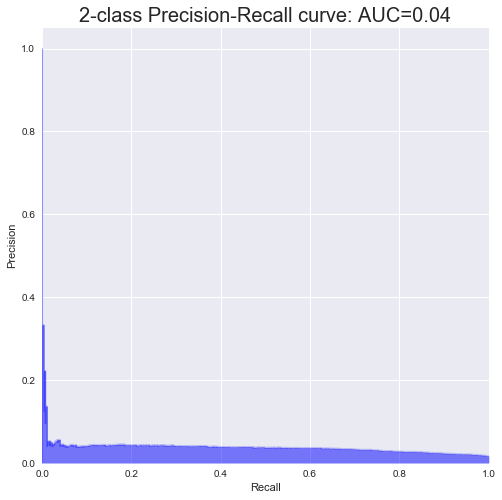


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


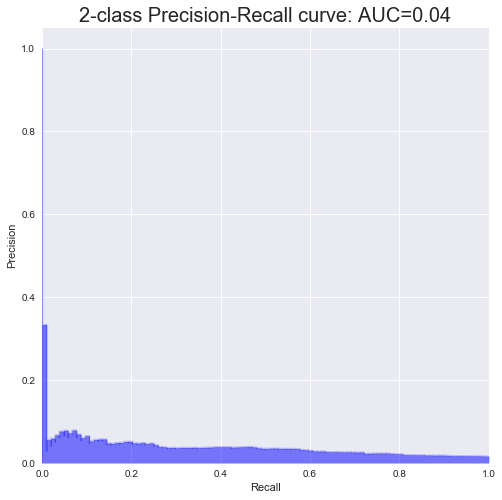

 
Iteration : 43 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 1, 0.01]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.29%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14547    76]
 [ 6067   199]]


  Confusion Matrix - Test 
[[4833   42]
 [2027   62]]




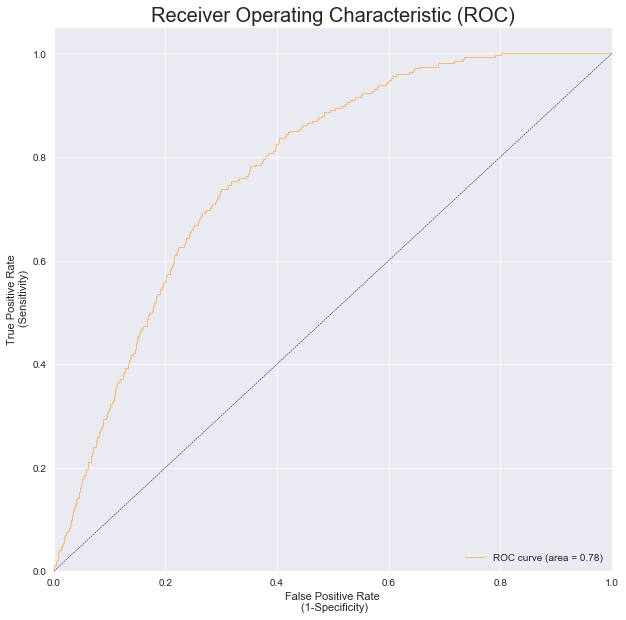


  Test AUC 


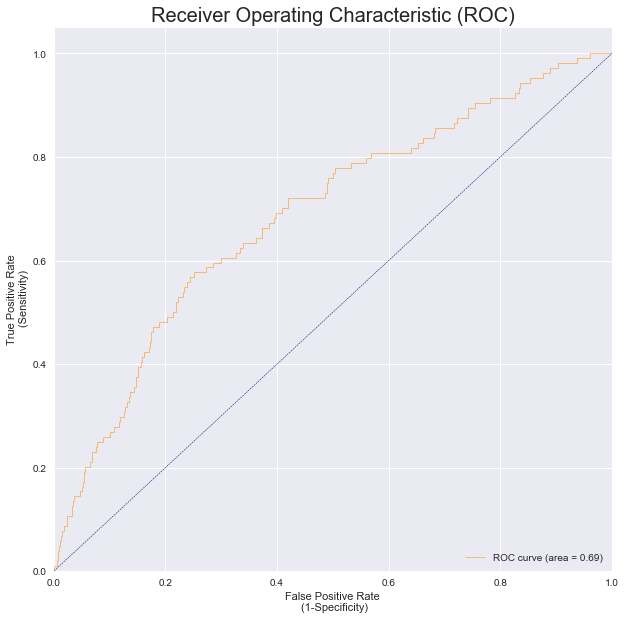


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


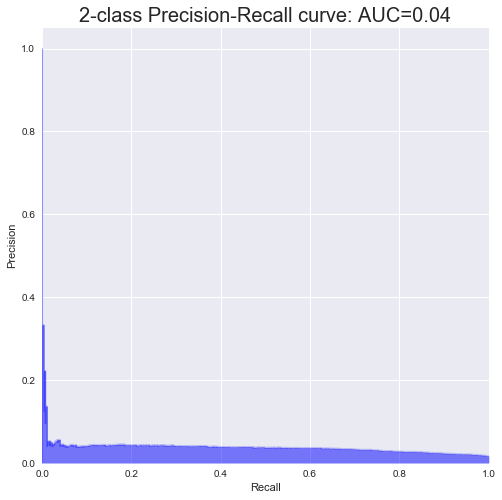


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


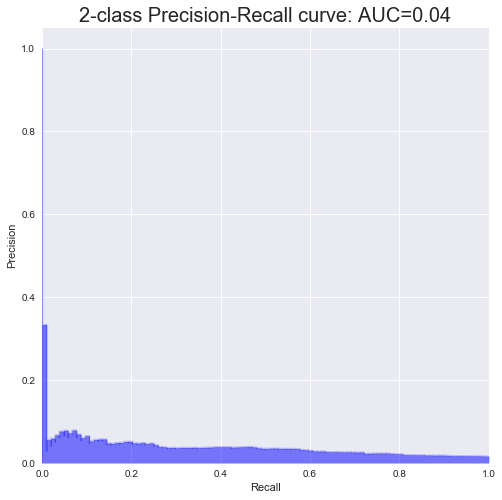

 
Iteration : 44 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 1, 0.1]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.29%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14547    76]
 [ 6067   199]]


  Confusion Matrix - Test 
[[4833   42]
 [2027   62]]


 

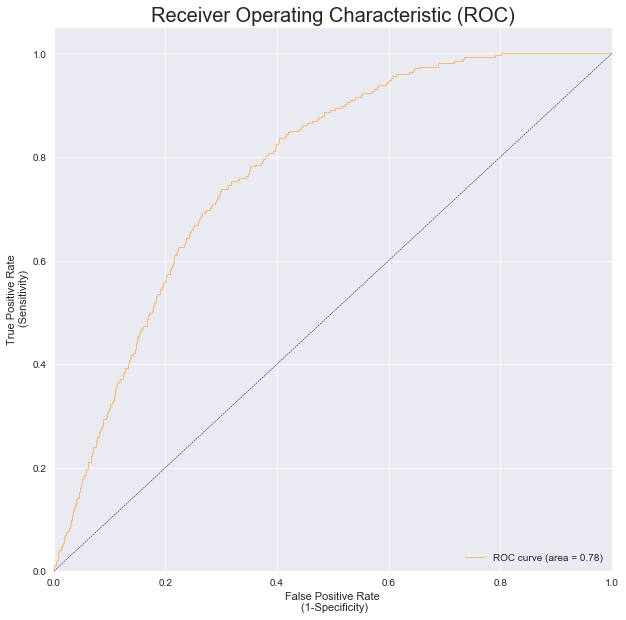


  Test AUC 


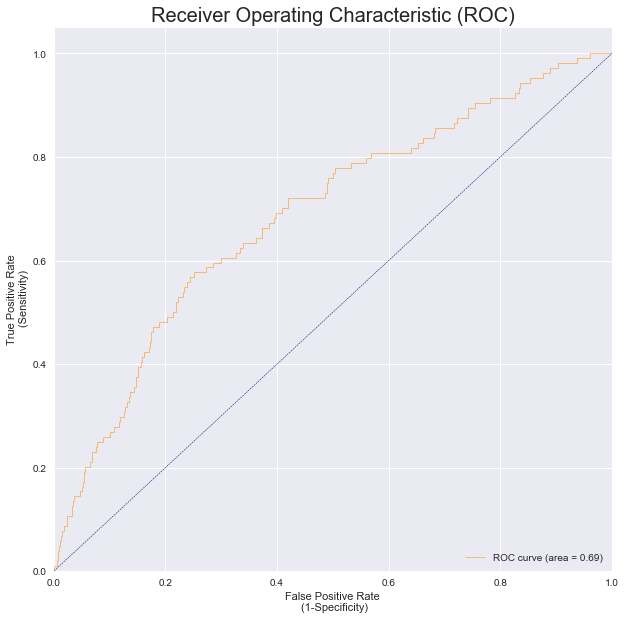


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


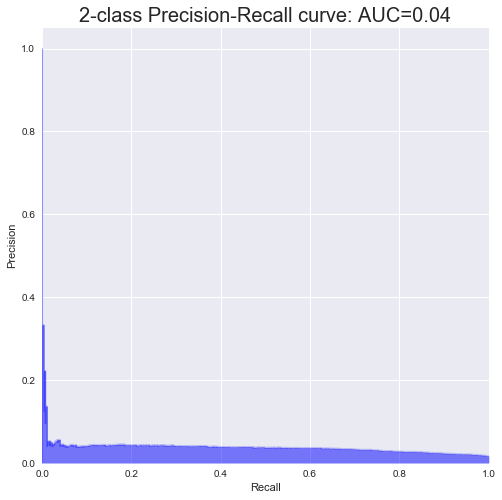


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


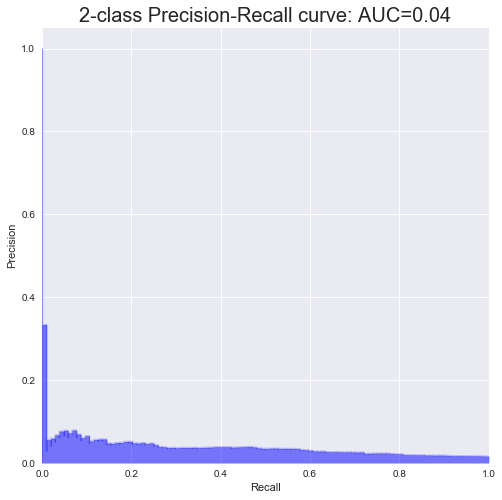

 
Iteration : 45 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 10, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.57%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14542    76]
 [ 6072   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]]

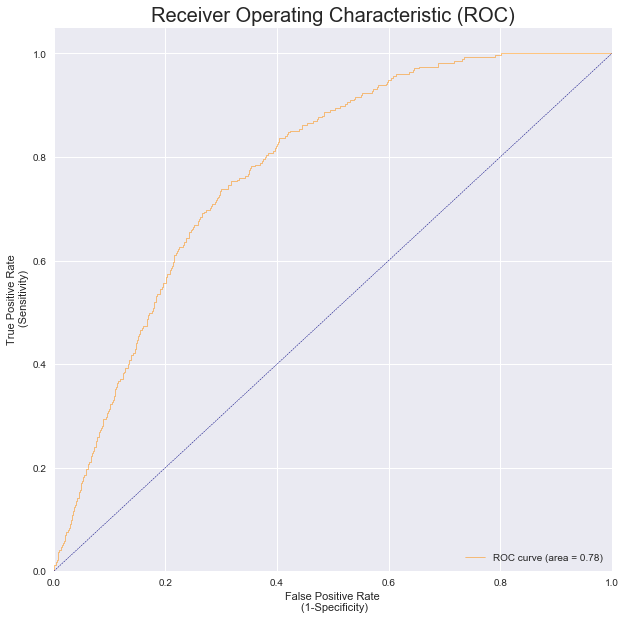


  Test AUC 


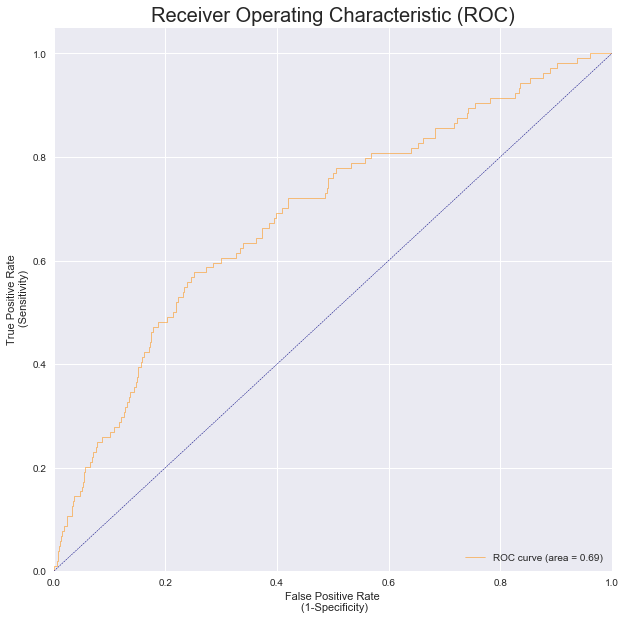


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


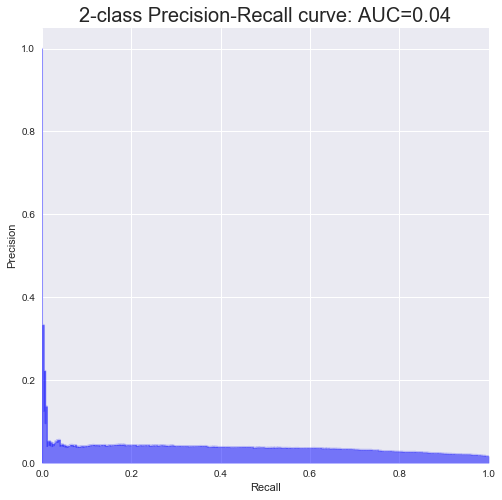


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


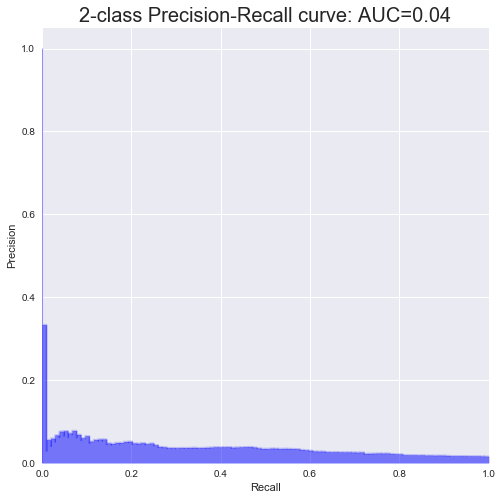

 
Iteration : 46 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 10, 0.001]
__________________________________________________________________

Accuracy - Training:  70.57%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14542    76]
 [ 6072   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]]


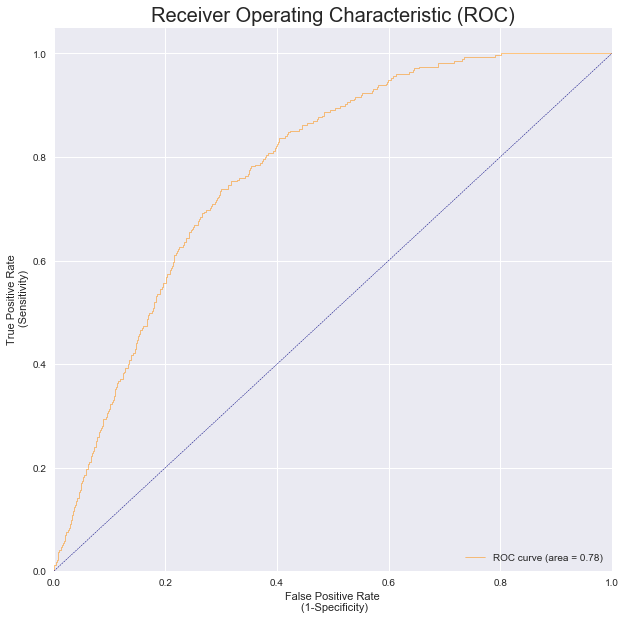


  Test AUC 


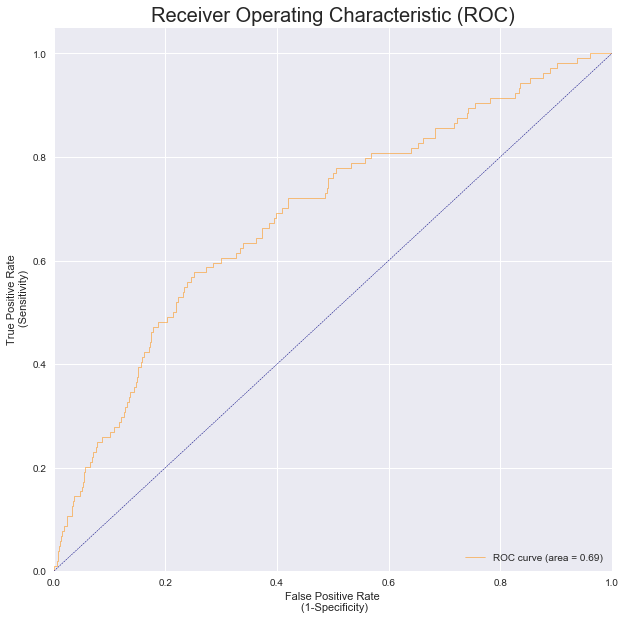


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


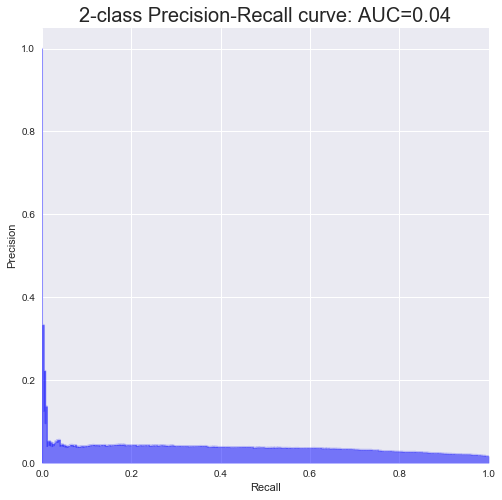


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


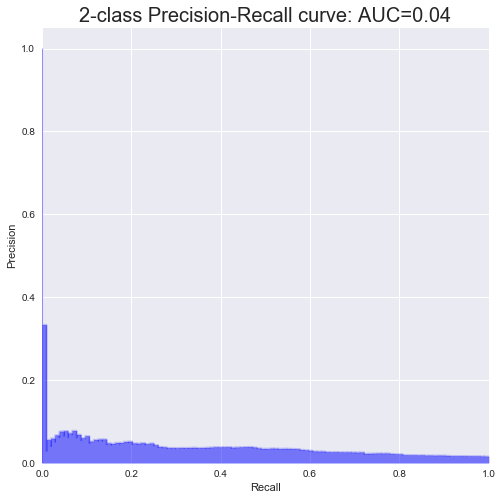

 
Iteration : 47 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 10, 0.01]
__________________________________________________________________

Accuracy - Training:  70.57%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14542    76]
 [ 6072   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]]



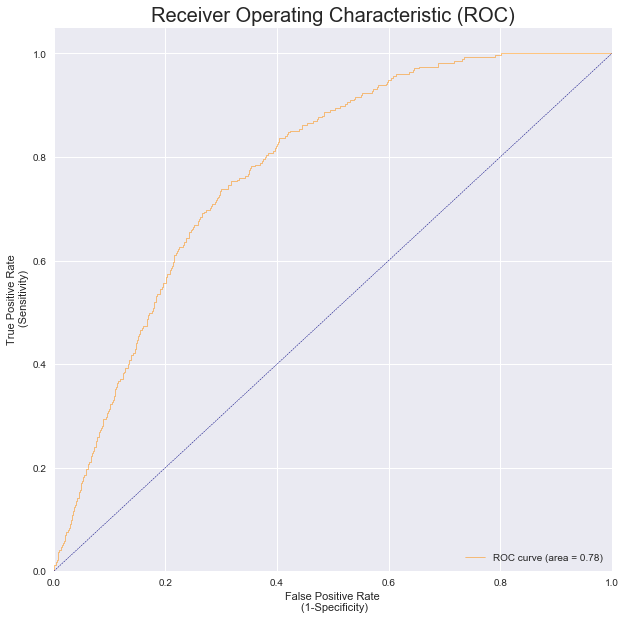


  Test AUC 


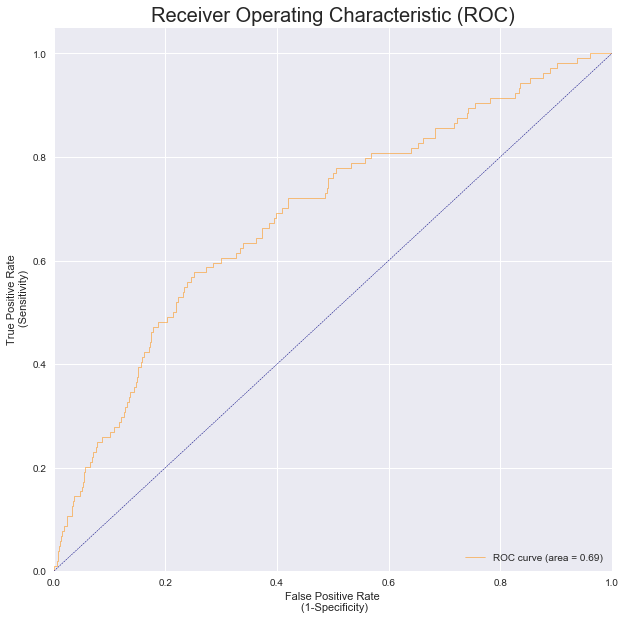


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


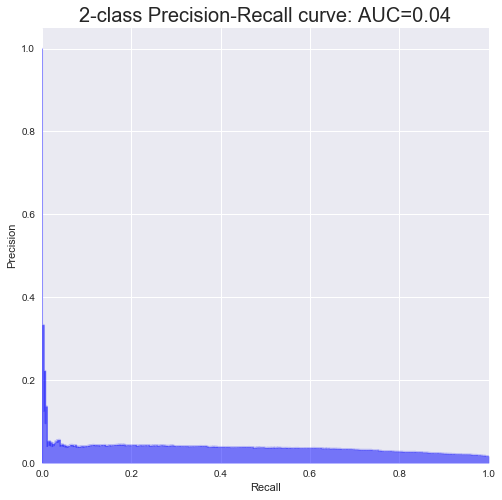


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


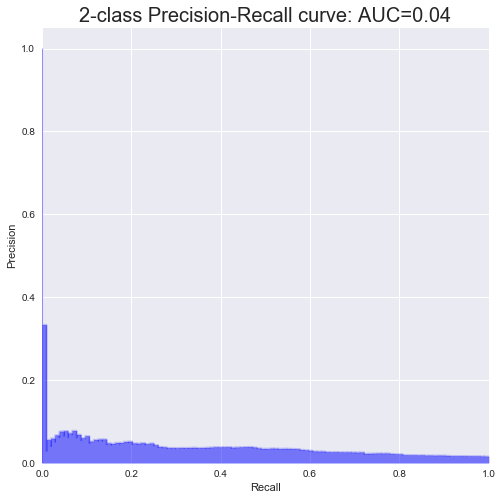

 
Iteration : 48 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['lbfgs', 10, 0.1]
__________________________________________________________________

Accuracy - Training:  70.57%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14542    76]
 [ 6072   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]]




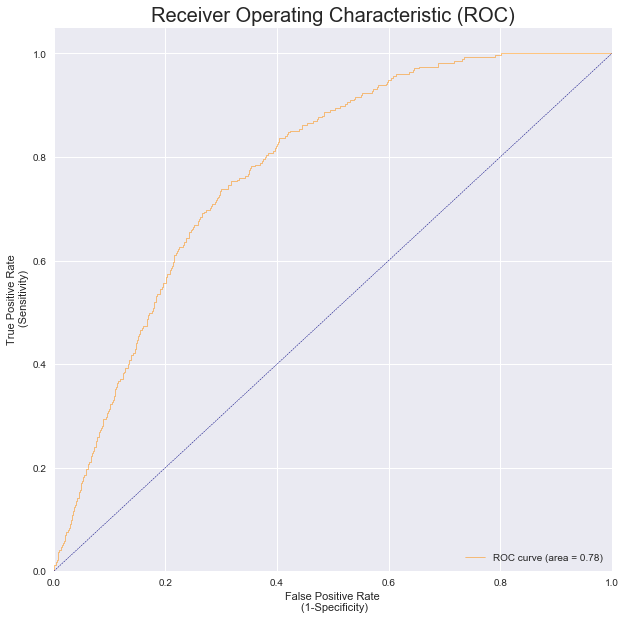


  Test AUC 


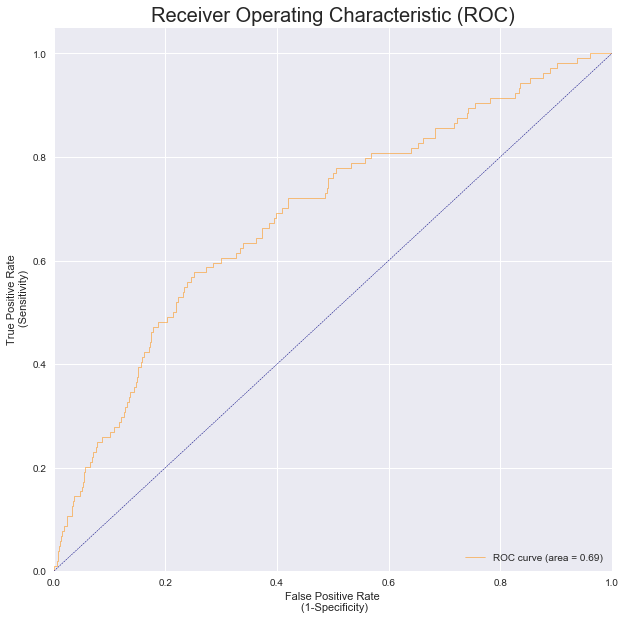


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


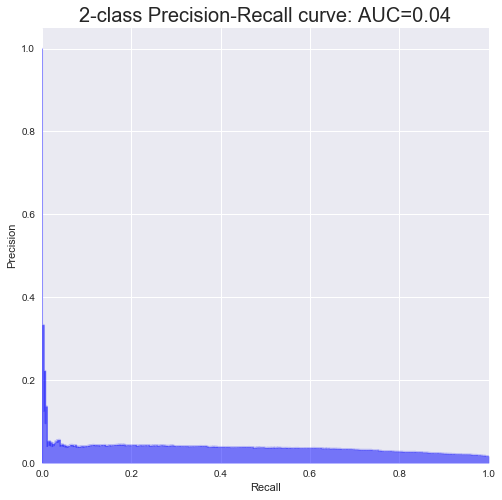


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


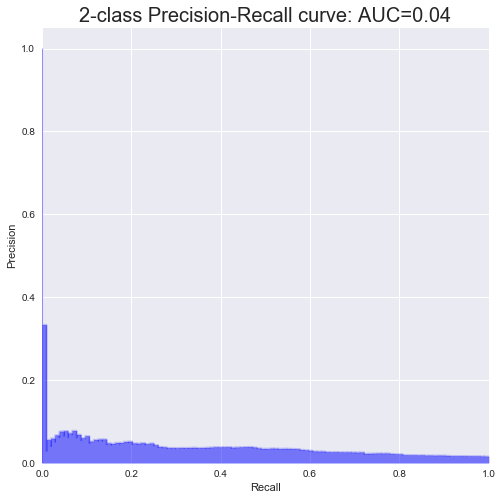

 
Iteration : 49 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.0001, 0.0001]
__________________________________________________________________

Accuracy - Training:  64.96%
Accuracy - test    :  64.07%

AUC Performance
AUC - Training     : 0.7296
AUC - Test         : 0.6757


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.65      0.79     20614
          1       0.03      0.68      0.05       275

avg / total       0.98      0.65      0.78     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.64      0.78      6860
          1       0.03      0.64      0.05       104

avg / total       0.98      0.64      0.77      6964


  Confusion Matrix - Train 
[[13382    87]
 [ 7232   188]]


  Confusion Matrix - Test 
[[4395   37]
 [246

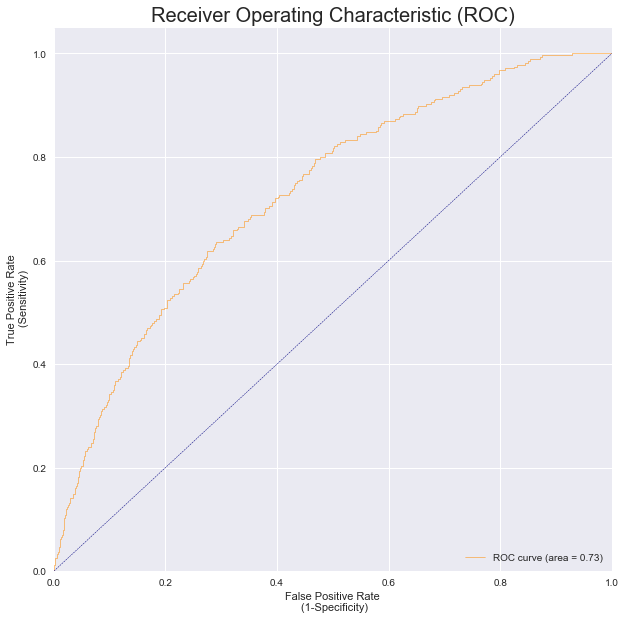


  Test AUC 


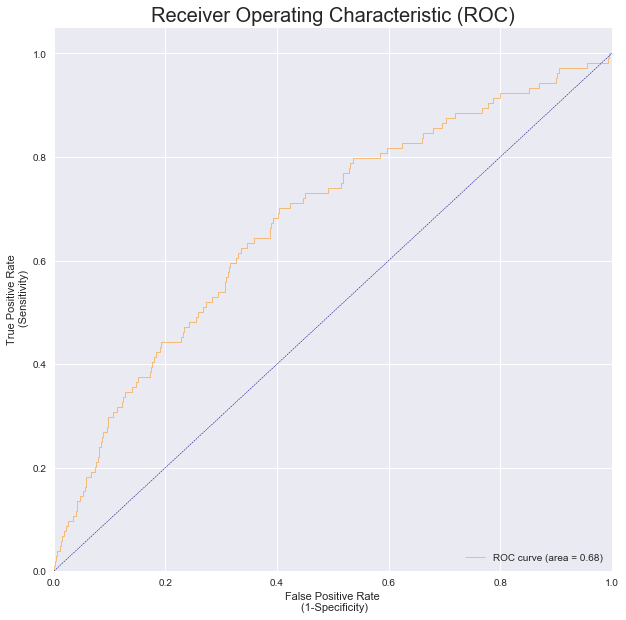


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


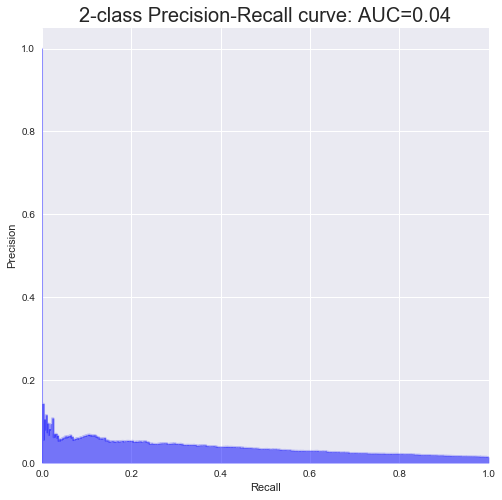


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


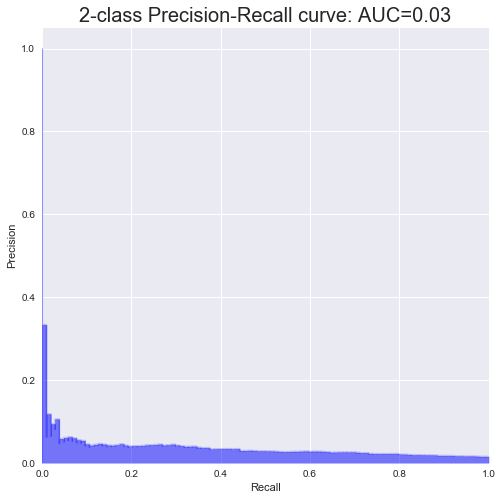

 
Iteration : 50 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.0001, 0.001]
__________________________________________________________________

Accuracy - Training:  64.96%
Accuracy - test    :  64.07%

AUC Performance
AUC - Training     : 0.7296
AUC - Test         : 0.6757


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.65      0.79     20614
          1       0.03      0.68      0.05       275

avg / total       0.98      0.65      0.78     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.64      0.78      6860
          1       0.03      0.64      0.05       104

avg / total       0.98      0.64      0.77      6964


  Confusion Matrix - Train 
[[13382    87]
 [ 7232   188]]


  Confusion Matrix - Test 
[[4395   37]
 [2465

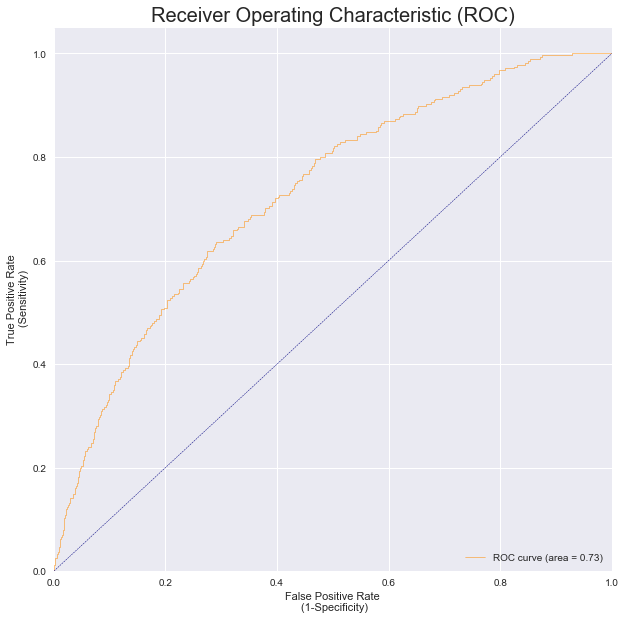


  Test AUC 


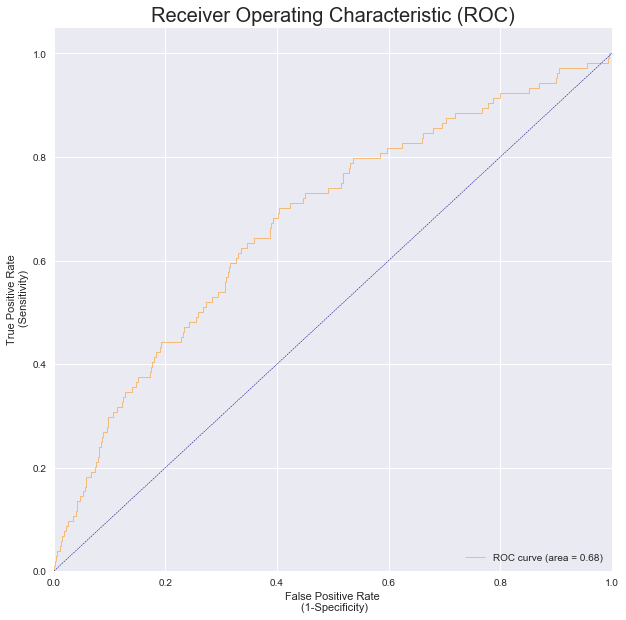


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


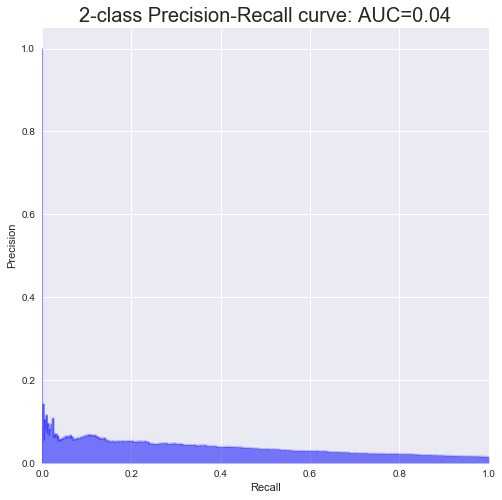


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


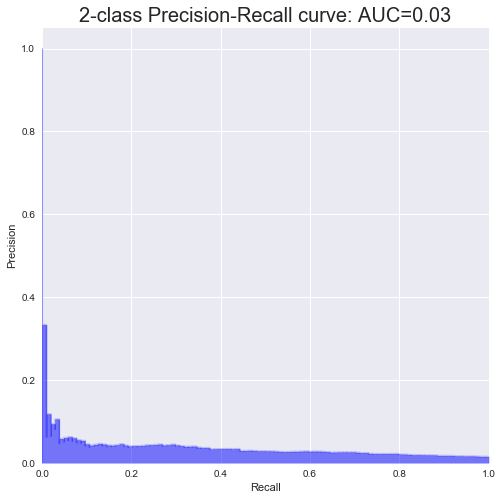

 
Iteration : 51 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.0001, 0.01]
__________________________________________________________________

Accuracy - Training:  64.96%
Accuracy - test    :  64.07%

AUC Performance
AUC - Training     : 0.7296
AUC - Test         : 0.6757


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.65      0.79     20614
          1       0.03      0.68      0.05       275

avg / total       0.98      0.65      0.78     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.64      0.78      6860
          1       0.03      0.64      0.05       104

avg / total       0.98      0.64      0.77      6964


  Confusion Matrix - Train 
[[13382    87]
 [ 7232   188]]


  Confusion Matrix - Test 
[[4395   37]
 [2465 

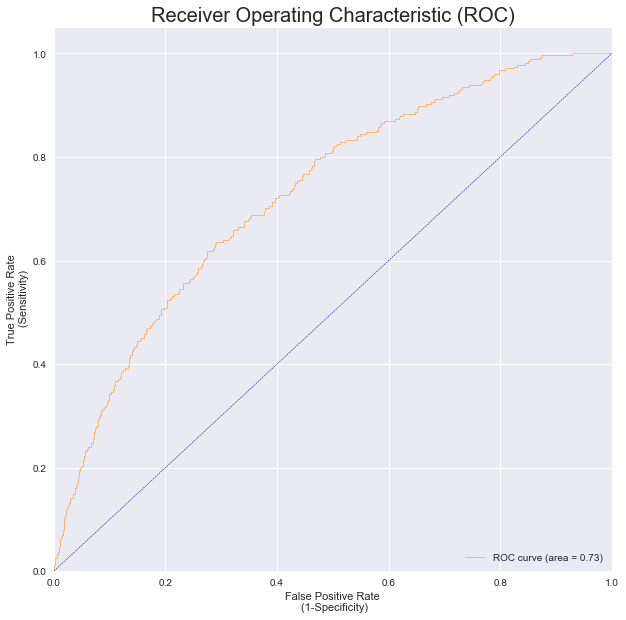


  Test AUC 


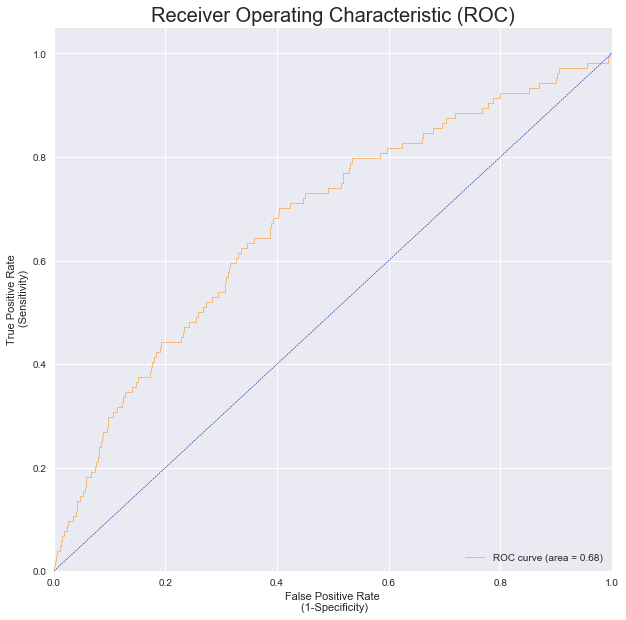


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


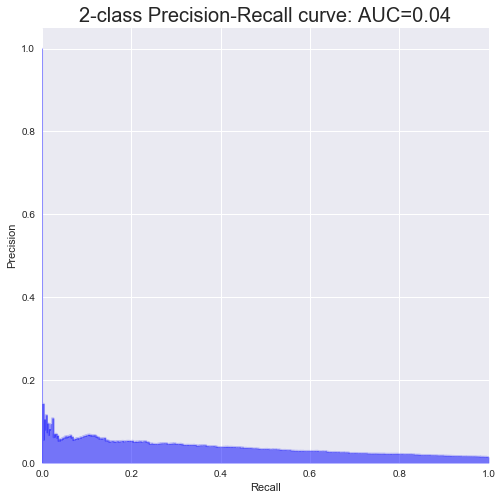


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


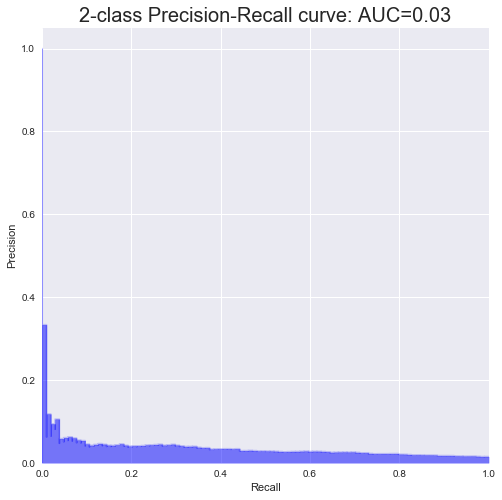

 
Iteration : 52 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.0001, 0.1]
__________________________________________________________________

Accuracy - Training:  64.96%
Accuracy - test    :  64.07%

AUC Performance
AUC - Training     : 0.7296
AUC - Test         : 0.6757


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.65      0.79     20614
          1       0.03      0.68      0.05       275

avg / total       0.98      0.65      0.78     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.64      0.78      6860
          1       0.03      0.64      0.05       104

avg / total       0.98      0.64      0.77      6964


  Confusion Matrix - Train 
[[13382    87]
 [ 7232   188]]


  Confusion Matrix - Test 
[[4395   37]
 [2465  

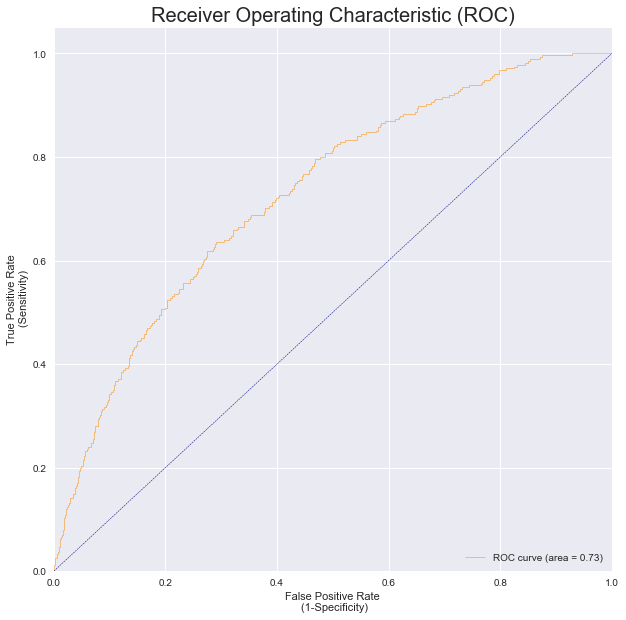


  Test AUC 


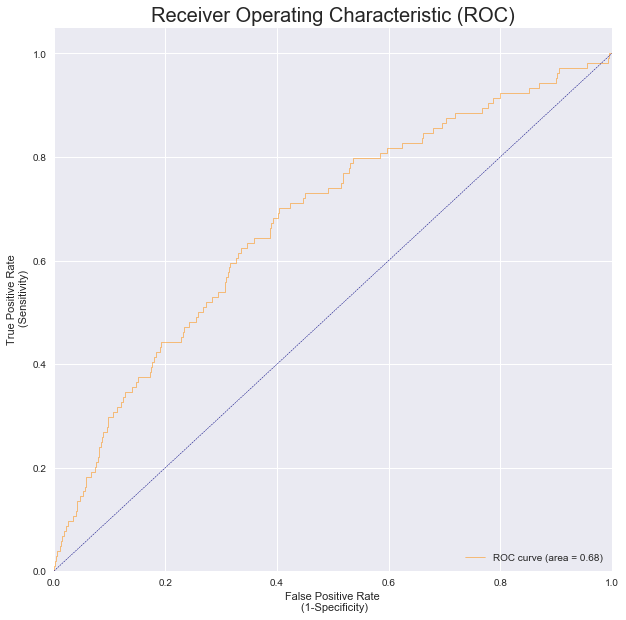


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


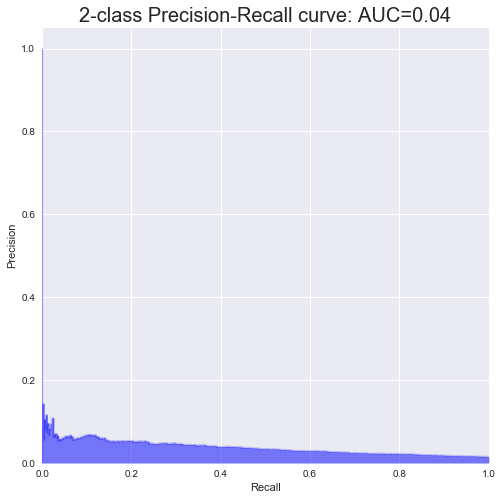


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


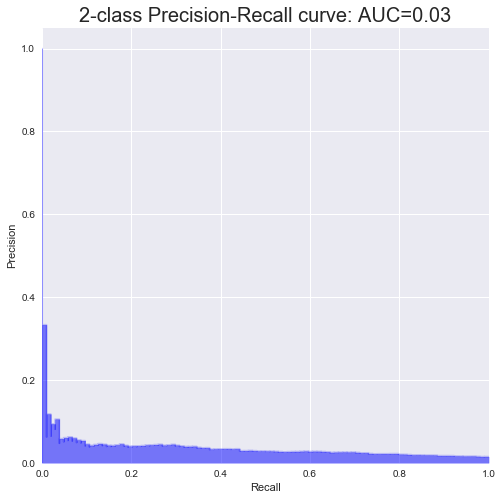

 
Iteration : 53 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.001, 0.0001]
__________________________________________________________________

Accuracy - Training:  69.60%
Accuracy - test    :  68.80%

AUC Performance
AUC - Training     : 0.7645
AUC - Test         : 0.6922


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.68      0.06       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.63      0.06       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14353    89]
 [ 6261   186]]


  Confusion Matrix - Test 
[[4725   38]
 [2135

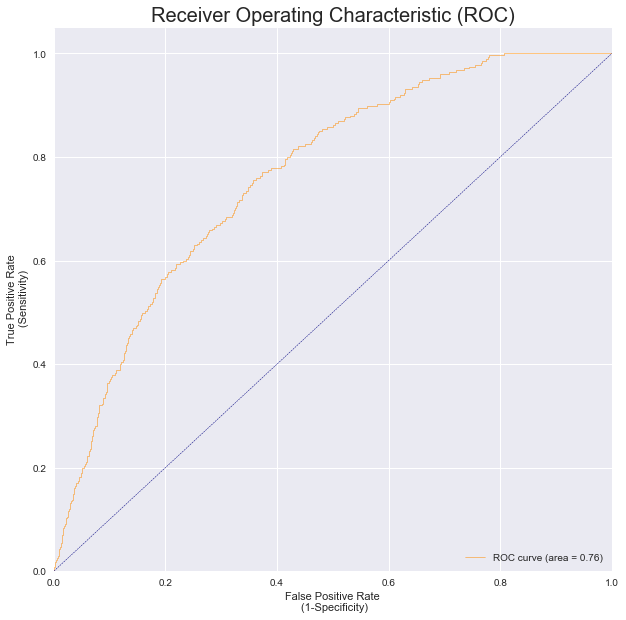


  Test AUC 


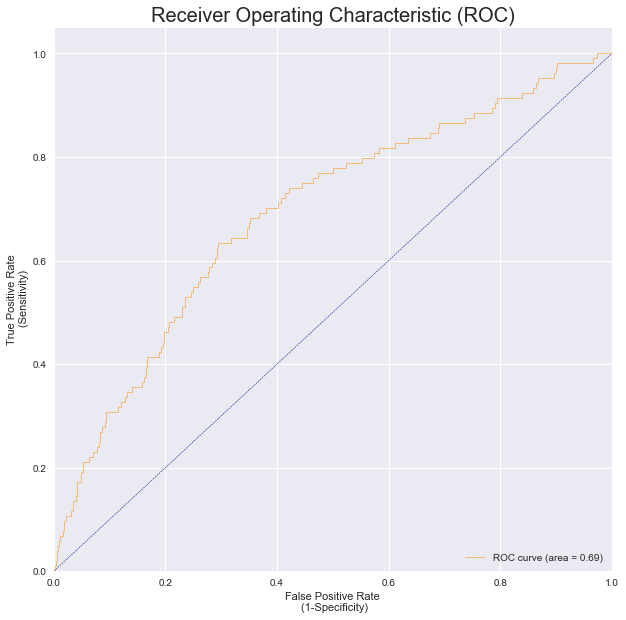


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


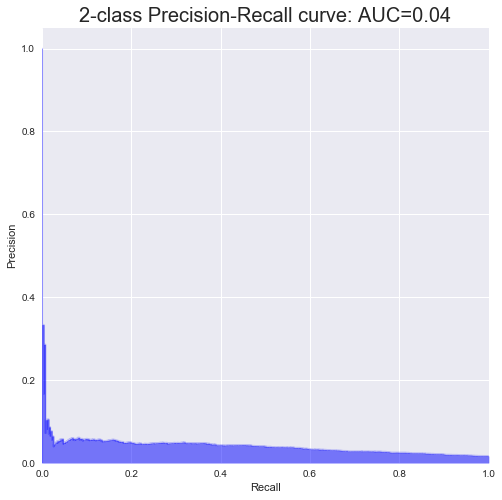


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


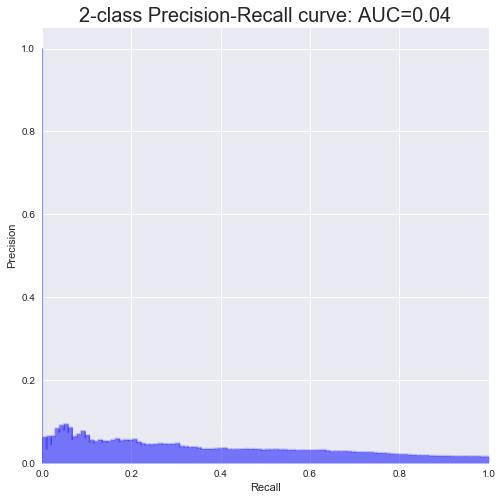

 
Iteration : 54 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.001, 0.001]
__________________________________________________________________

Accuracy - Training:  69.60%
Accuracy - test    :  68.80%

AUC Performance
AUC - Training     : 0.7645
AUC - Test         : 0.6922


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.68      0.06       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.63      0.06       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14353    89]
 [ 6261   186]]


  Confusion Matrix - Test 
[[4725   38]
 [2135 

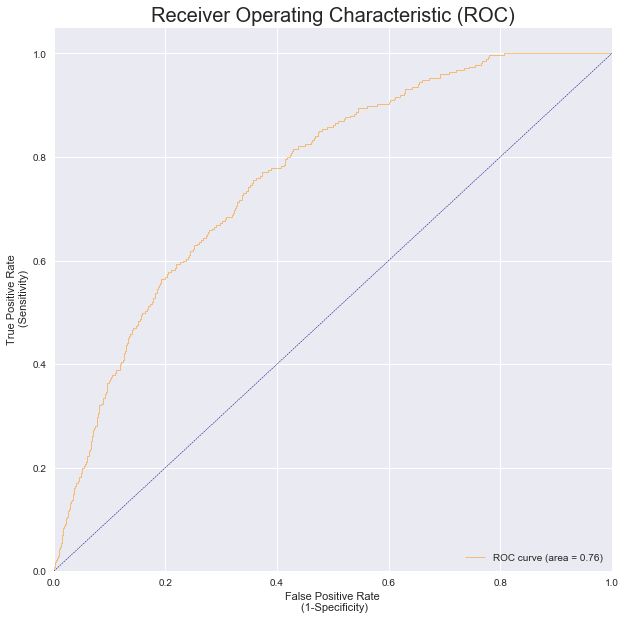


  Test AUC 


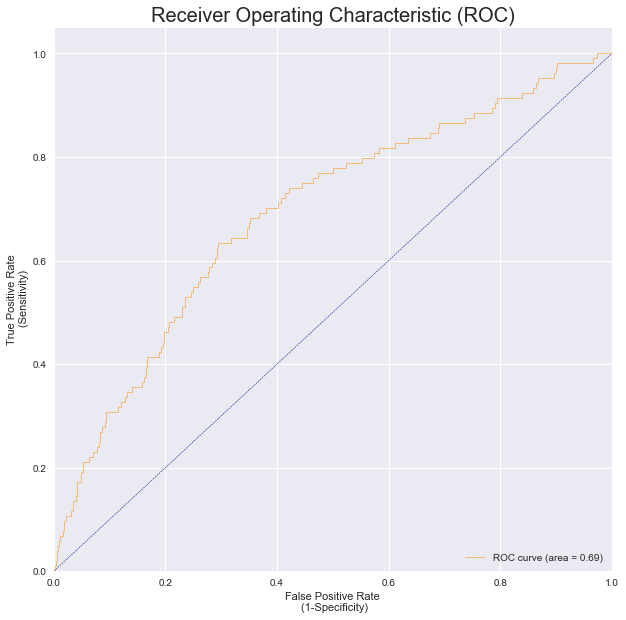


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


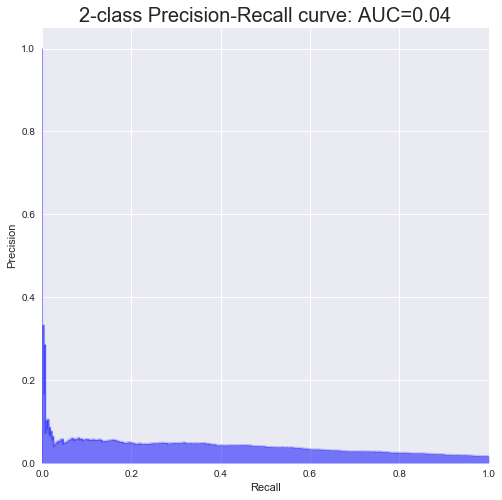


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


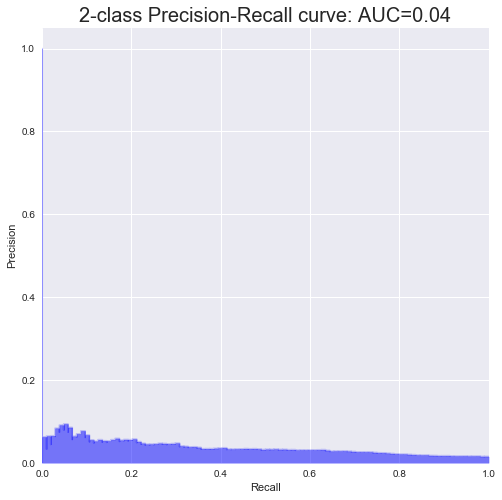

 
Iteration : 55 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.001, 0.01]
__________________________________________________________________

Accuracy - Training:  69.59%
Accuracy - test    :  68.80%

AUC Performance
AUC - Training     : 0.7645
AUC - Test         : 0.6922


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.68      0.06       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.63      0.06       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14351    89]
 [ 6263   186]]


  Confusion Matrix - Test 
[[4725   38]
 [2135  

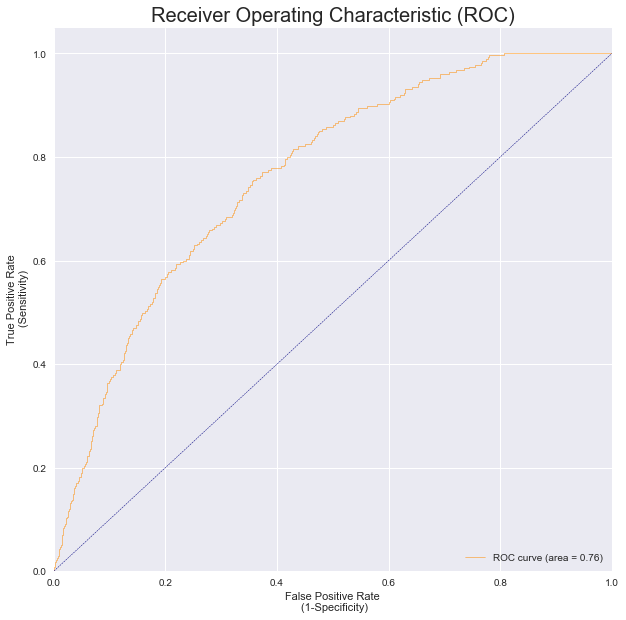


  Test AUC 


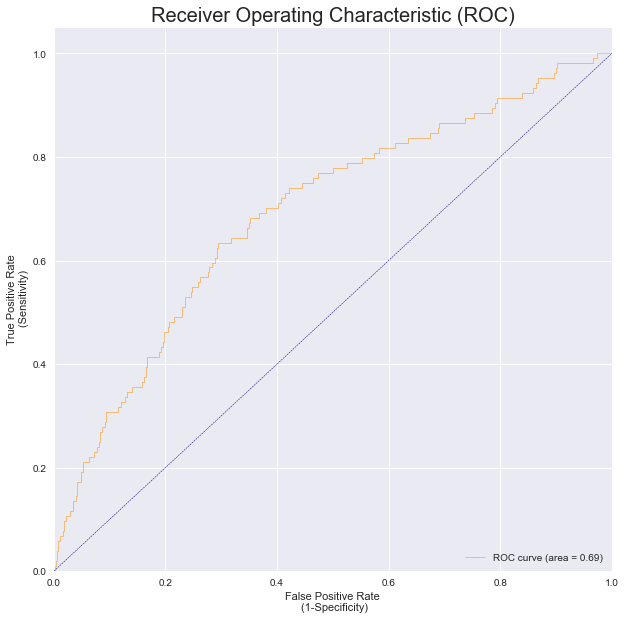


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


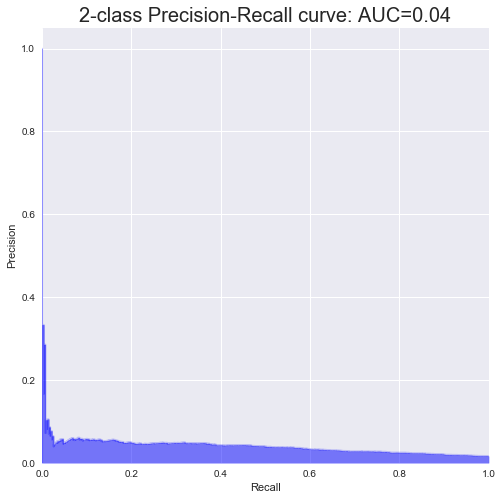


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


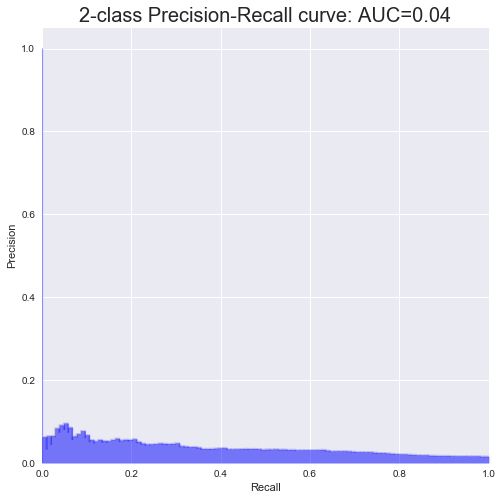

 
Iteration : 56 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.001, 0.1]
__________________________________________________________________

Accuracy - Training:  69.60%
Accuracy - test    :  68.81%

AUC Performance
AUC - Training     : 0.7644
AUC - Test         : 0.6922


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.68      0.06       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.63      0.06       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14353    89]
 [ 6261   186]]


  Confusion Matrix - Test 
[[4726   38]
 [2134   

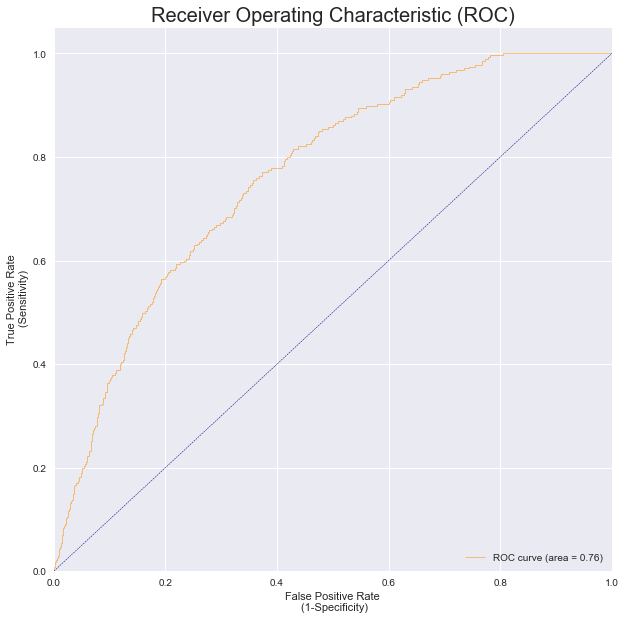


  Test AUC 


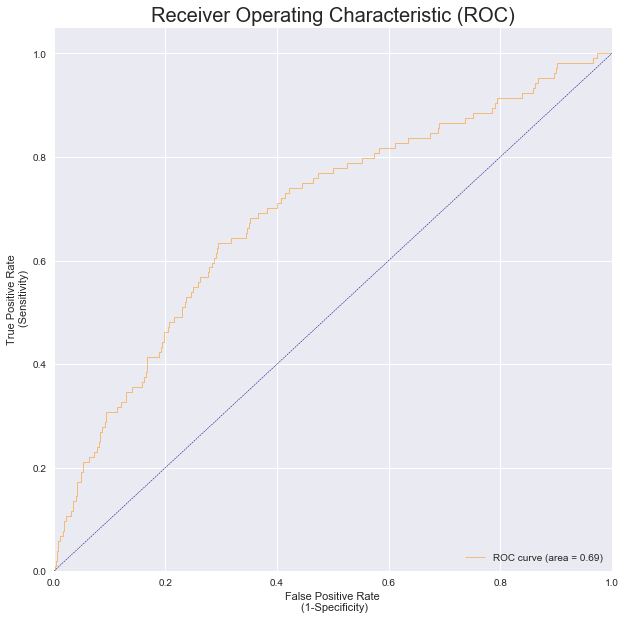


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


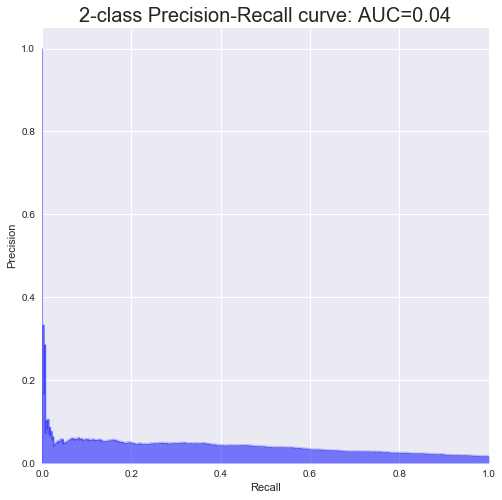


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


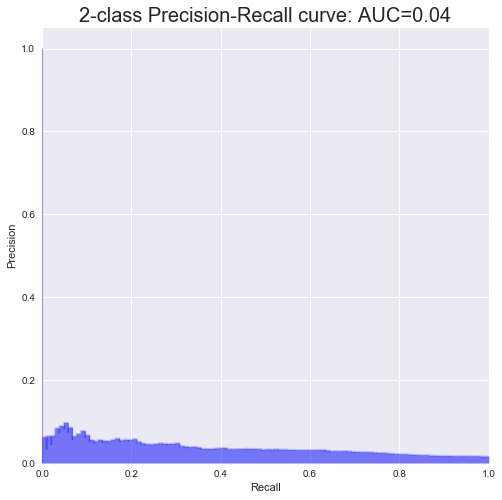

 
Iteration : 57 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.01, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.53%
Accuracy - test    :  70.00%

AUC Performance
AUC - Training     : 0.7766
AUC - Test         : 0.6903


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.61      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14538    79]
 [ 6076   196]]


  Confusion Matrix - Test 
[[4812   41]
 [2048 

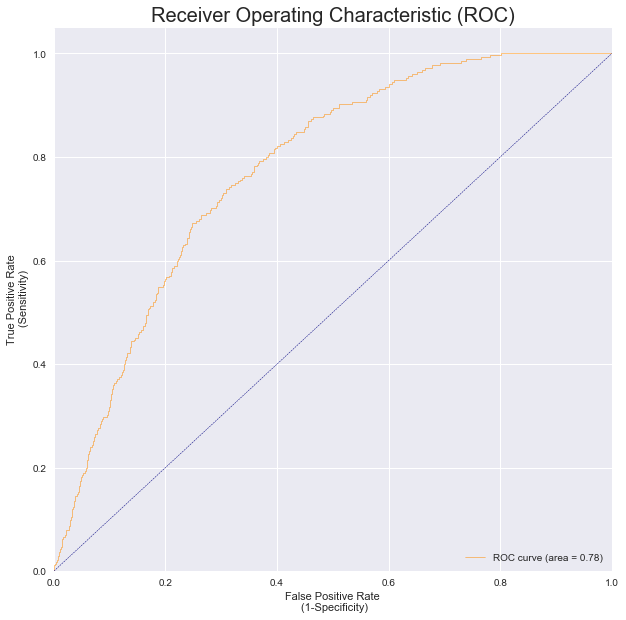


  Test AUC 


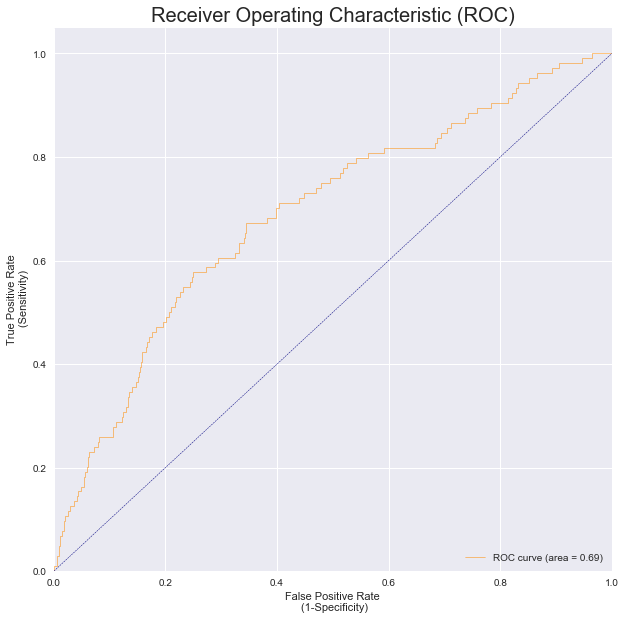


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


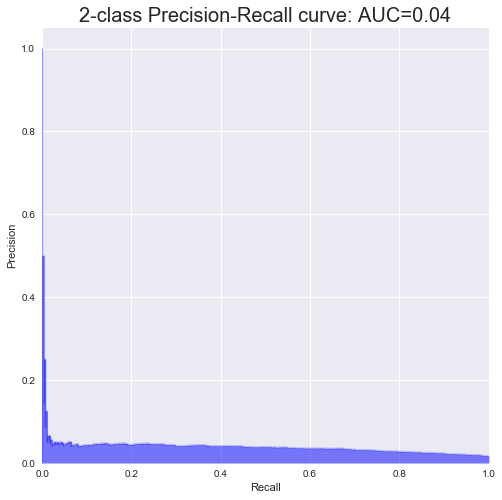


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


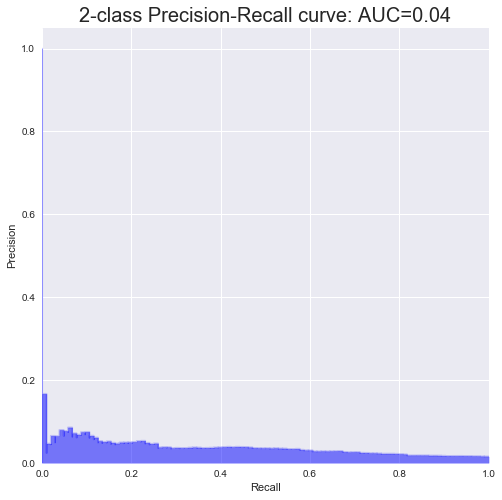

 
Iteration : 58 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.01, 0.001]
__________________________________________________________________

Accuracy - Training:  70.53%
Accuracy - test    :  70.00%

AUC Performance
AUC - Training     : 0.7766
AUC - Test         : 0.6903


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.61      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14538    79]
 [ 6076   196]]


  Confusion Matrix - Test 
[[4812   41]
 [2048  

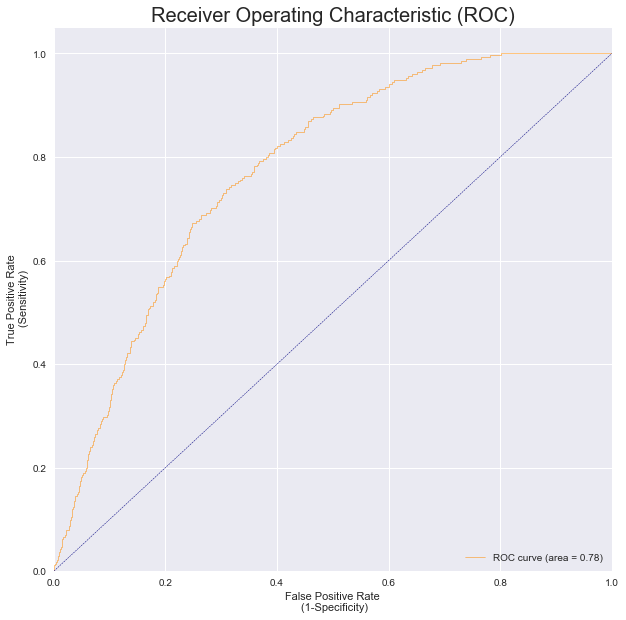


  Test AUC 


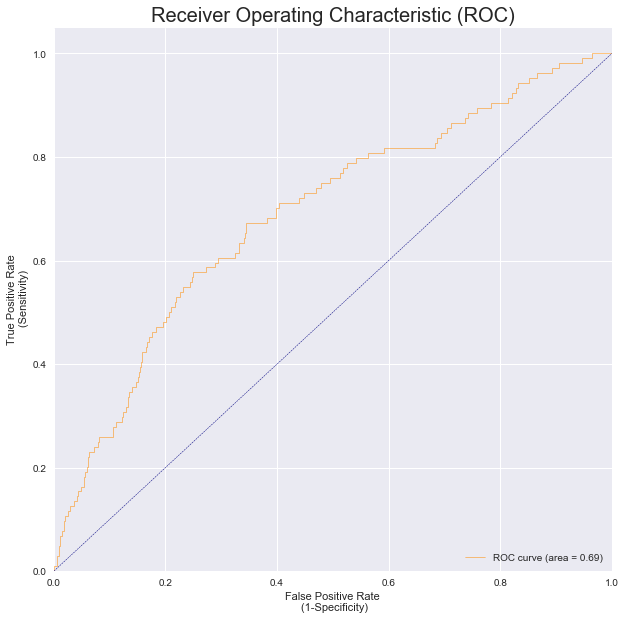


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


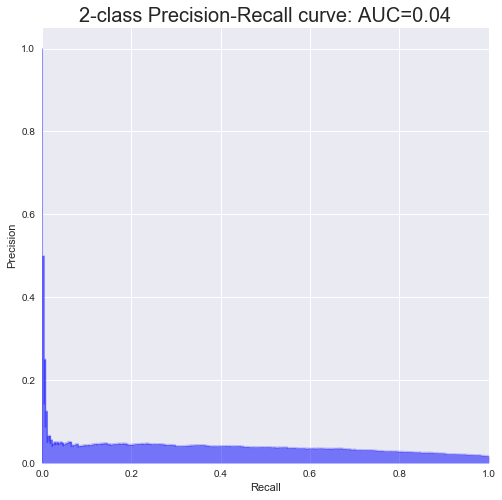


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


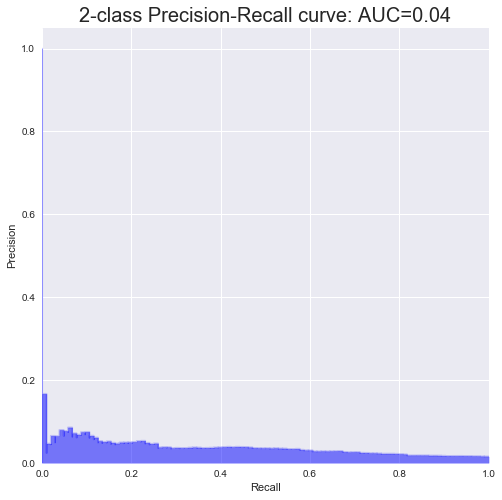

 
Iteration : 59 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.01, 0.01]
__________________________________________________________________

Accuracy - Training:  70.53%
Accuracy - test    :  70.00%

AUC Performance
AUC - Training     : 0.7766
AUC - Test         : 0.6903


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.61      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14538    79]
 [ 6076   196]]


  Confusion Matrix - Test 
[[4812   41]
 [2048   

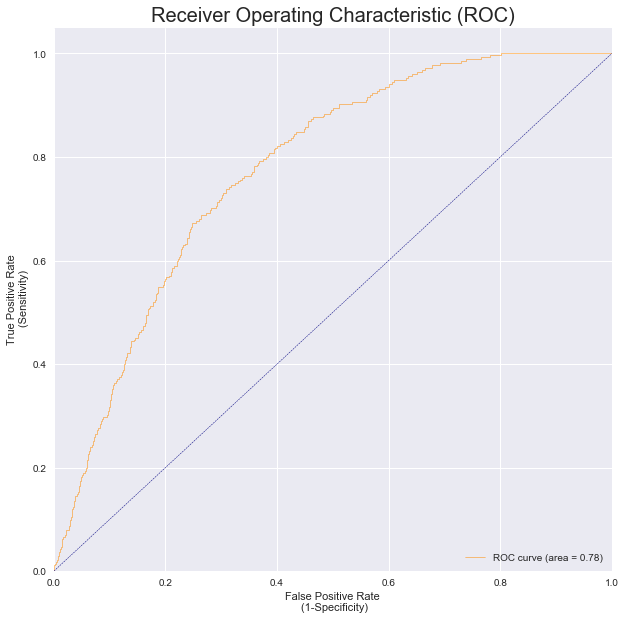


  Test AUC 


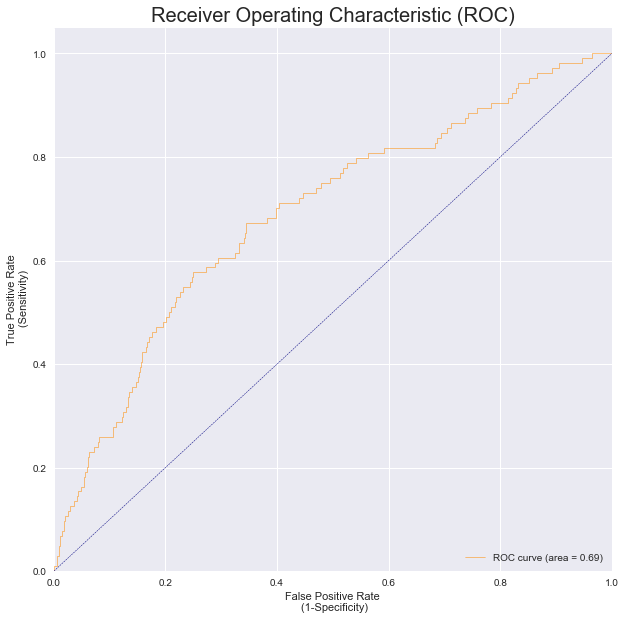


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


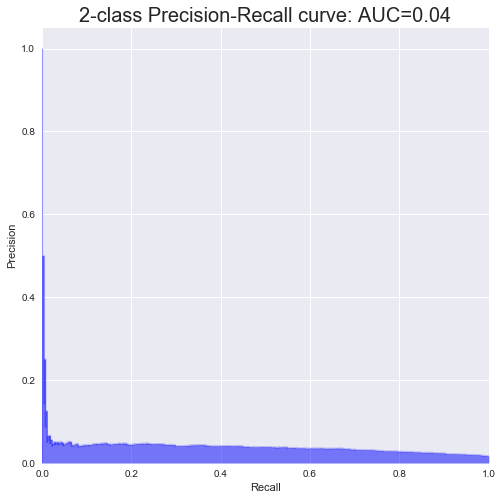


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


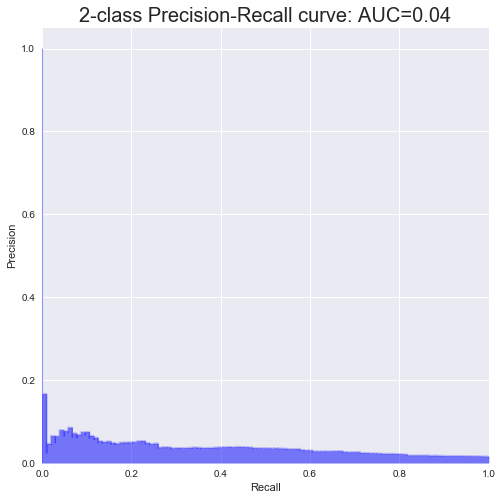

 
Iteration : 60 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.01, 0.1]
__________________________________________________________________

Accuracy - Training:  70.52%
Accuracy - test    :  70.00%

AUC Performance
AUC - Training     : 0.7766
AUC - Test         : 0.6903


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.71      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.61      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14535    79]
 [ 6079   196]]


  Confusion Matrix - Test 
[[4812   41]
 [2048   6

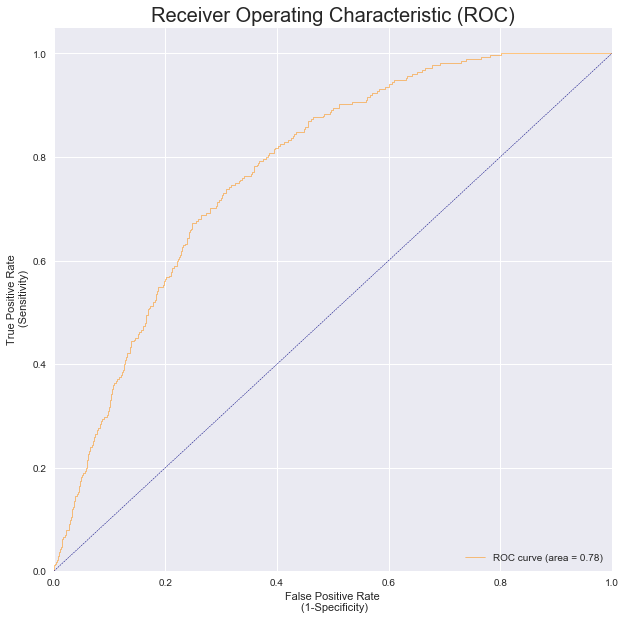


  Test AUC 


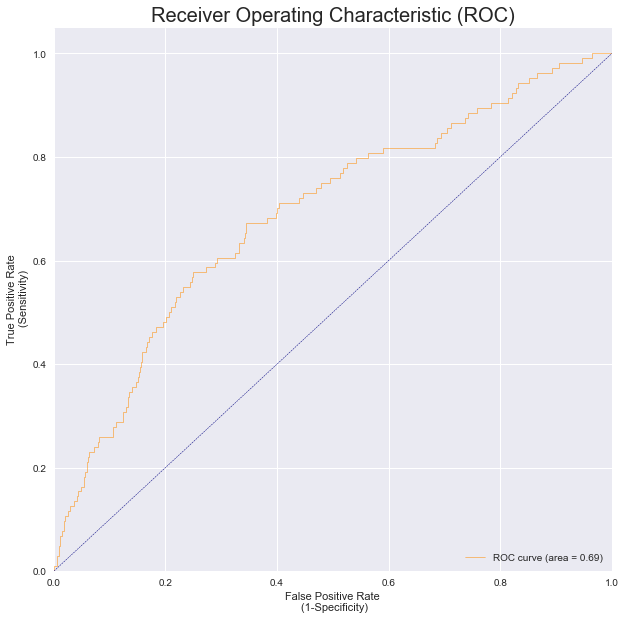


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


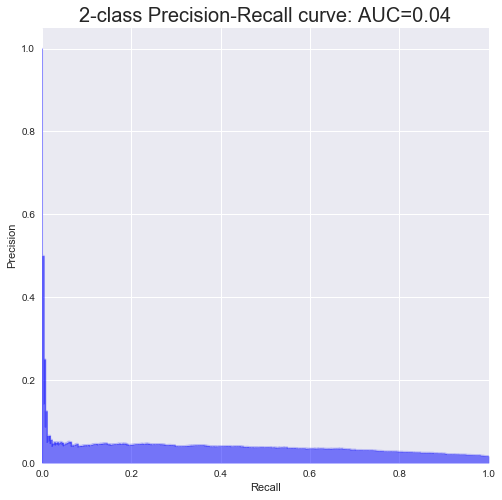


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


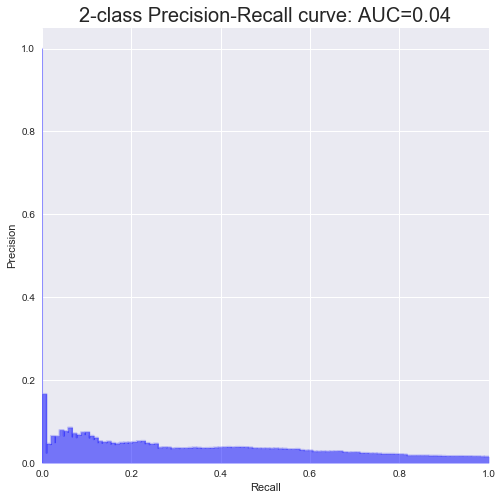

 
Iteration : 61 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.1, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.61%
Accuracy - test    :  70.20%

AUC Performance
AUC - Training     : 0.7775
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14550    75]
 [ 6064   200]]


  Confusion Matrix - Test 
[[4827   42]
 [2033  

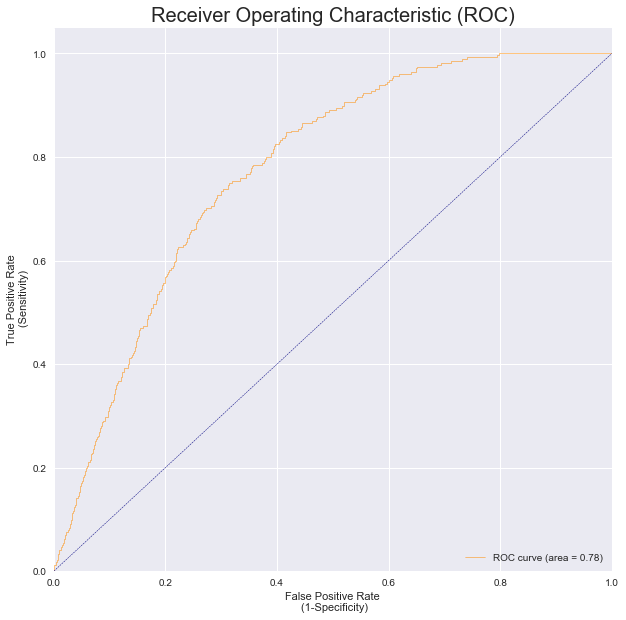


  Test AUC 


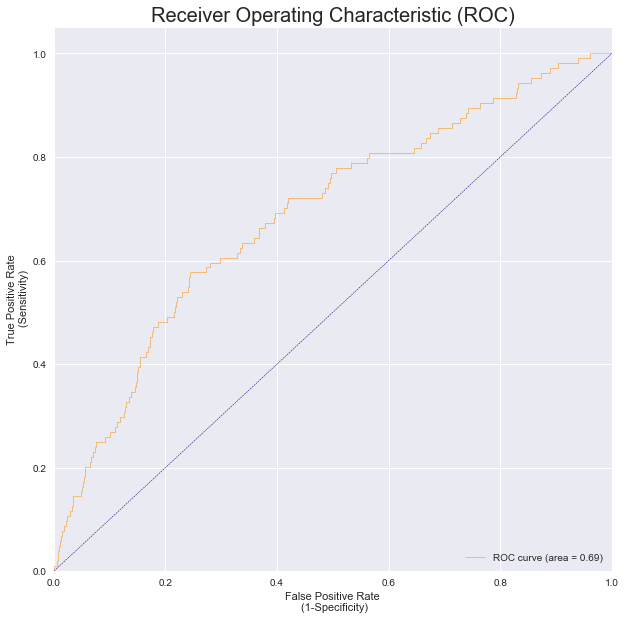


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


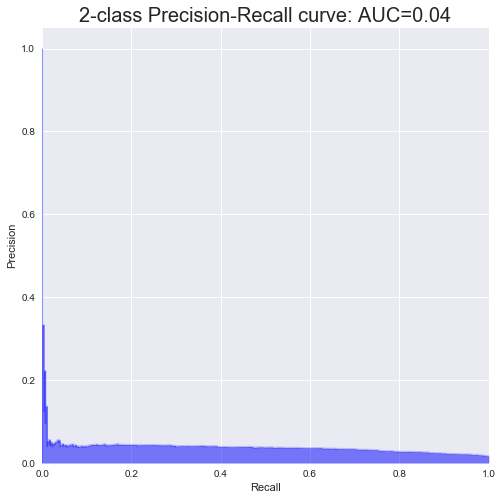


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


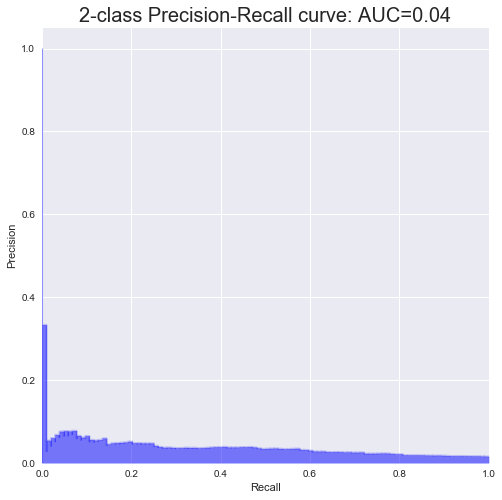

 
Iteration : 62 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.1, 0.001]
__________________________________________________________________

Accuracy - Training:  70.61%
Accuracy - test    :  70.20%

AUC Performance
AUC - Training     : 0.7775
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14550    75]
 [ 6064   200]]


  Confusion Matrix - Test 
[[4827   42]
 [2033   

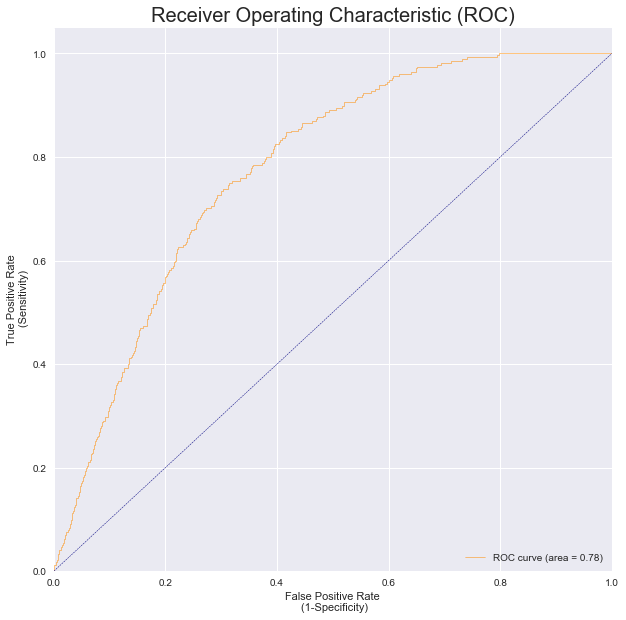


  Test AUC 


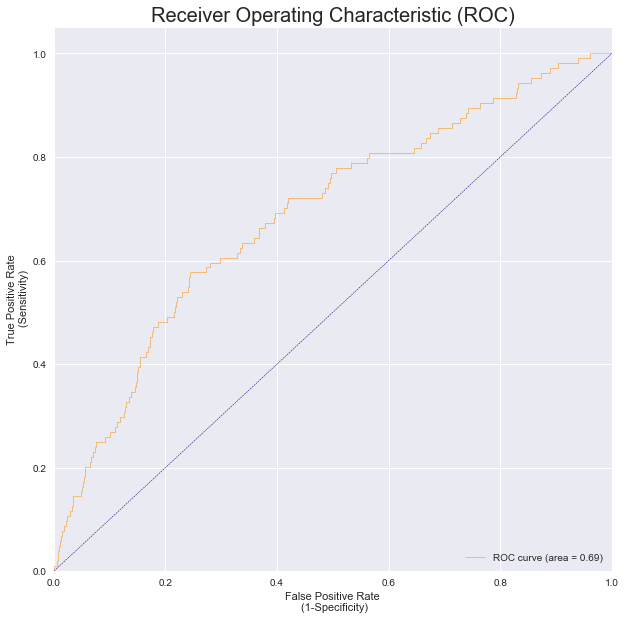


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


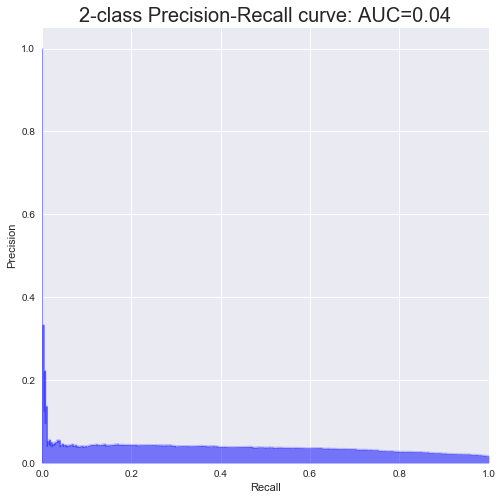


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


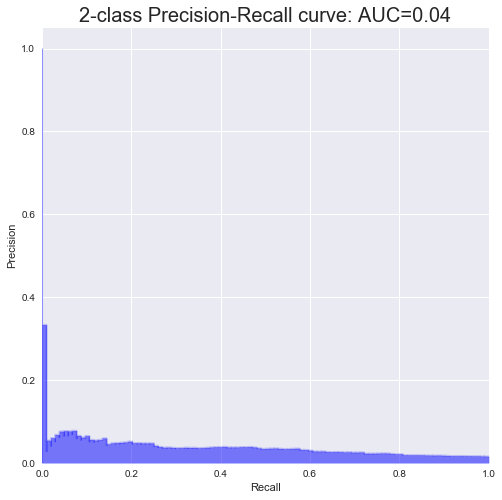

 
Iteration : 63 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.1, 0.01]
__________________________________________________________________

Accuracy - Training:  70.61%
Accuracy - test    :  70.20%

AUC Performance
AUC - Training     : 0.7775
AUC - Test         : 0.6889


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14550    75]
 [ 6064   200]]


  Confusion Matrix - Test 
[[4827   42]
 [2033   6

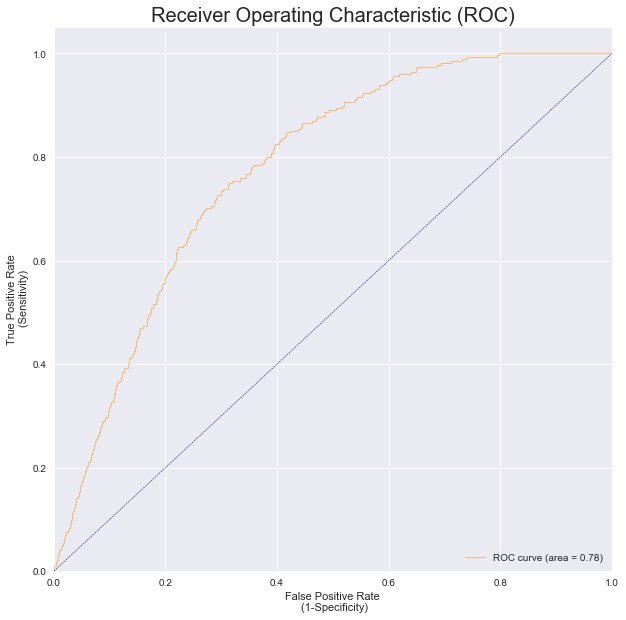


  Test AUC 


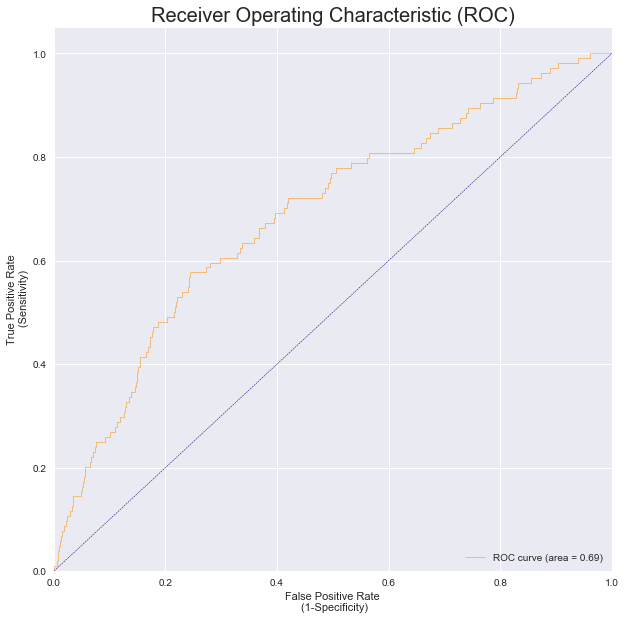


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


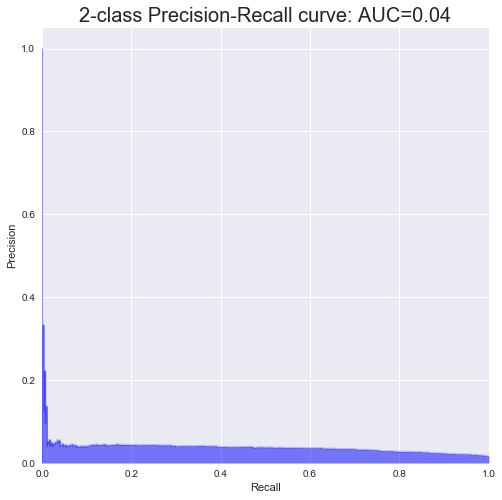


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


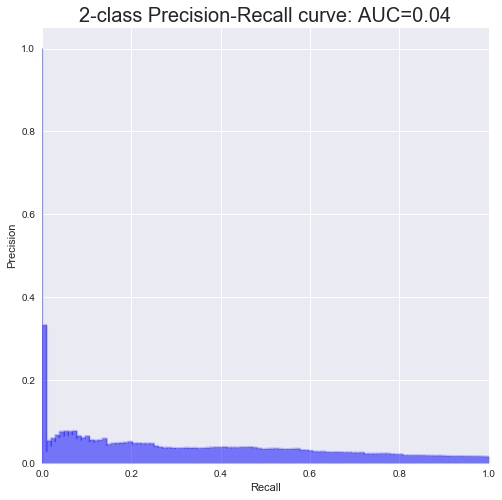

 
Iteration : 64 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 0.1, 0.1]
__________________________________________________________________

Accuracy - Training:  70.61%
Accuracy - test    :  70.23%

AUC Performance
AUC - Training     : 0.7775
AUC - Test         : 0.6888


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14549    75]
 [ 6065   200]]


  Confusion Matrix - Test 
[[4829   42]
 [2031   62

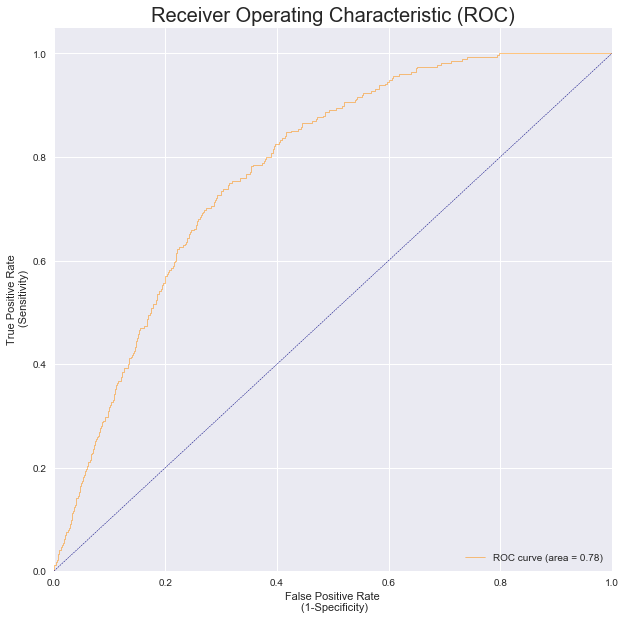


  Test AUC 


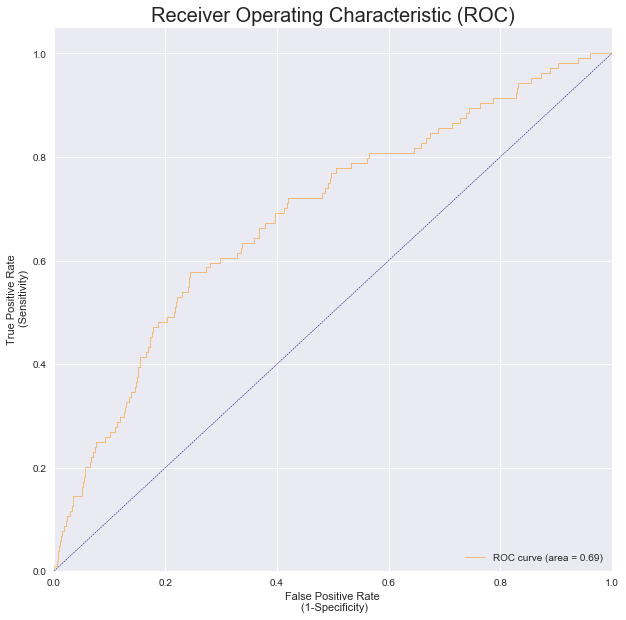


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


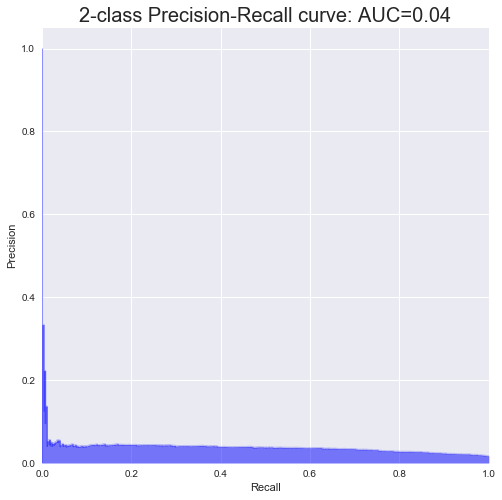


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


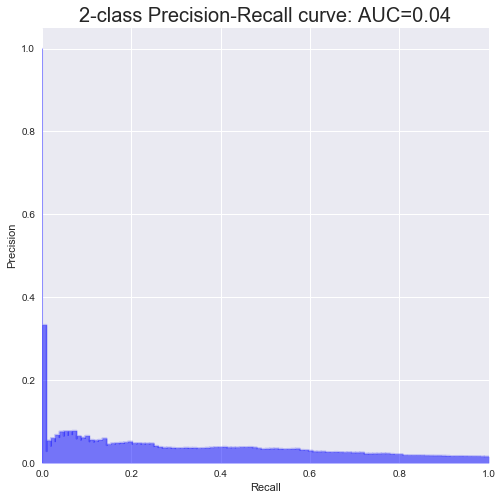

 
Iteration : 65 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 1, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.26%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6888


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14546    76]
 [ 6068   199]]


  Confusion Matrix - Test 
[[4831   42]
 [2029   6

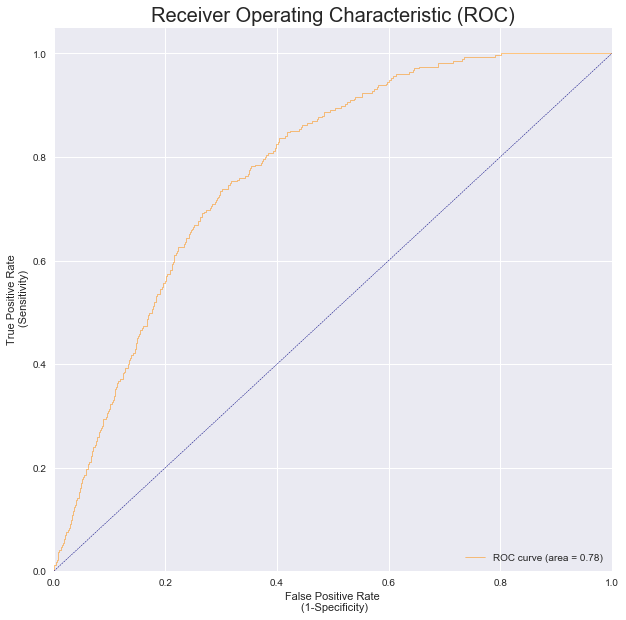


  Test AUC 


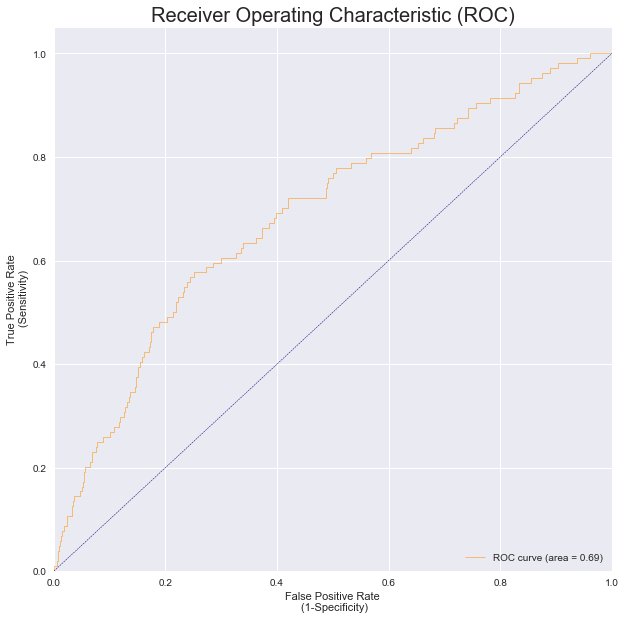


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


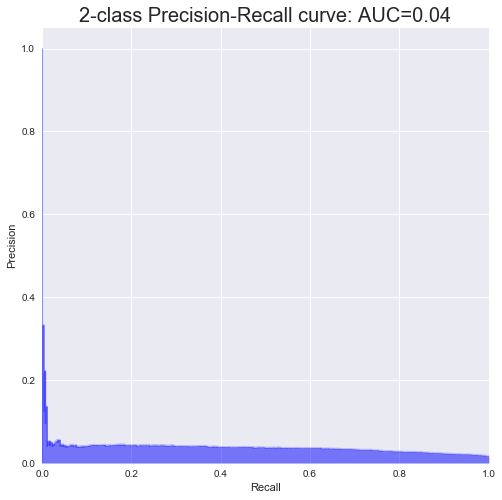


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


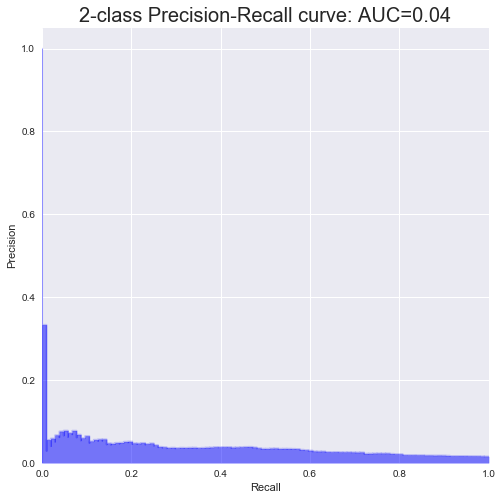

 
Iteration : 66 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 1, 0.001]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.26%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6888


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14546    76]
 [ 6068   199]]


  Confusion Matrix - Test 
[[4831   42]
 [2029   62

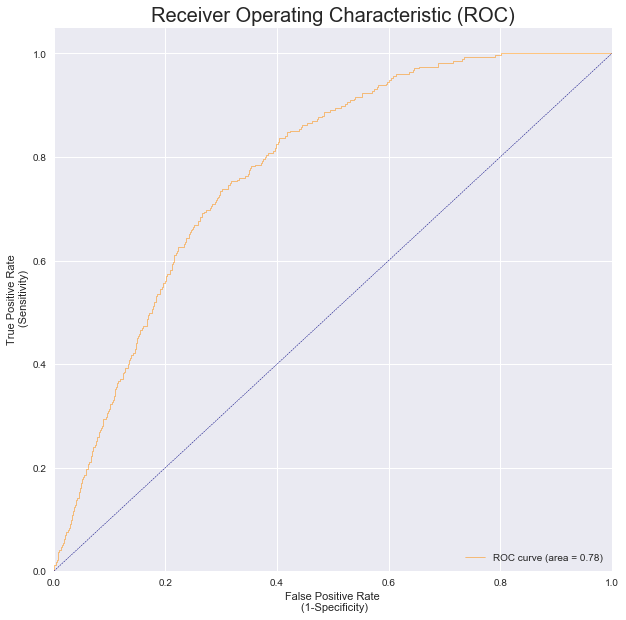


  Test AUC 


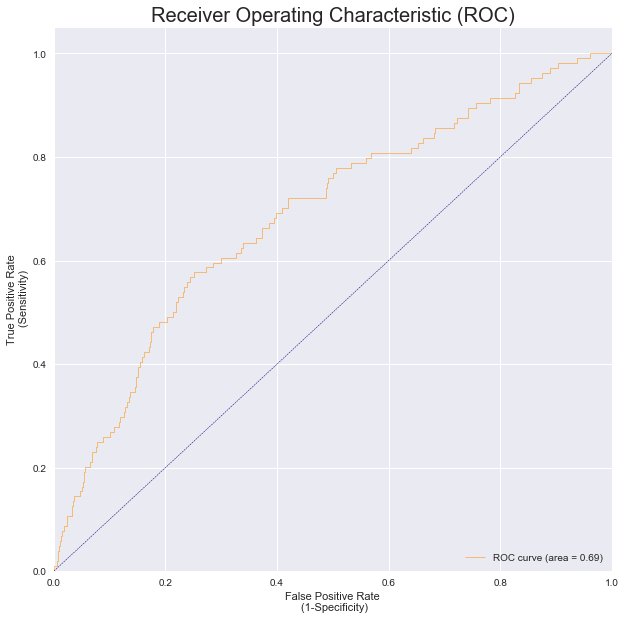


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


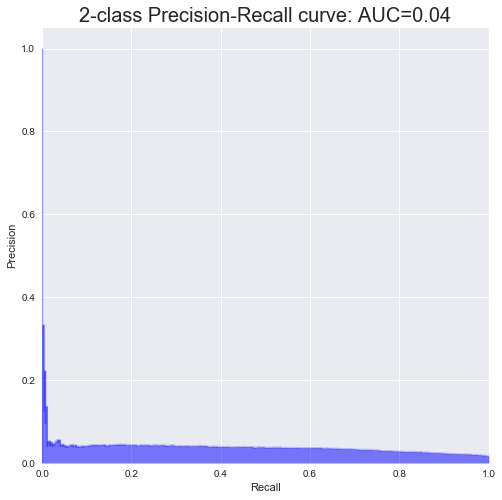


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


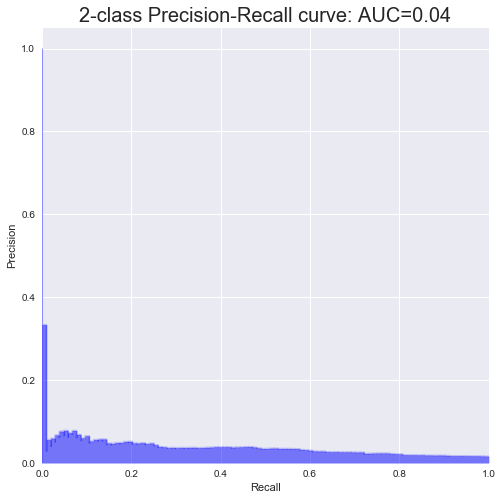

 
Iteration : 67 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 1, 0.01]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.26%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6888


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14546    76]
 [ 6068   199]]


  Confusion Matrix - Test 
[[4831   42]
 [2029   62]

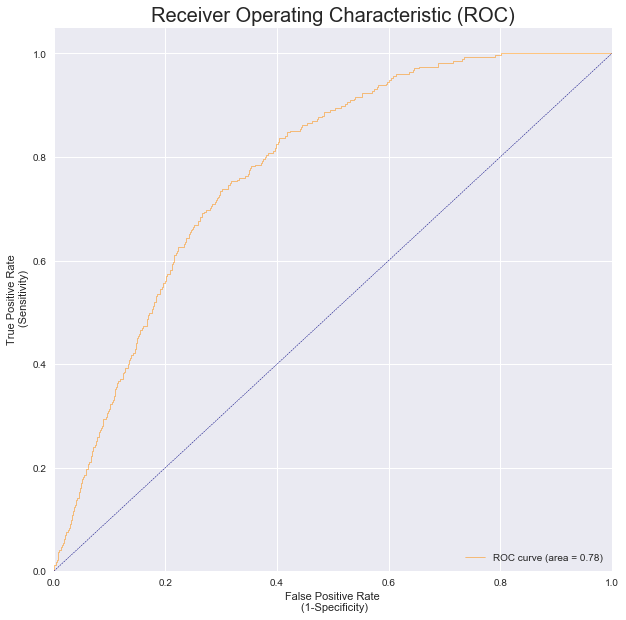


  Test AUC 


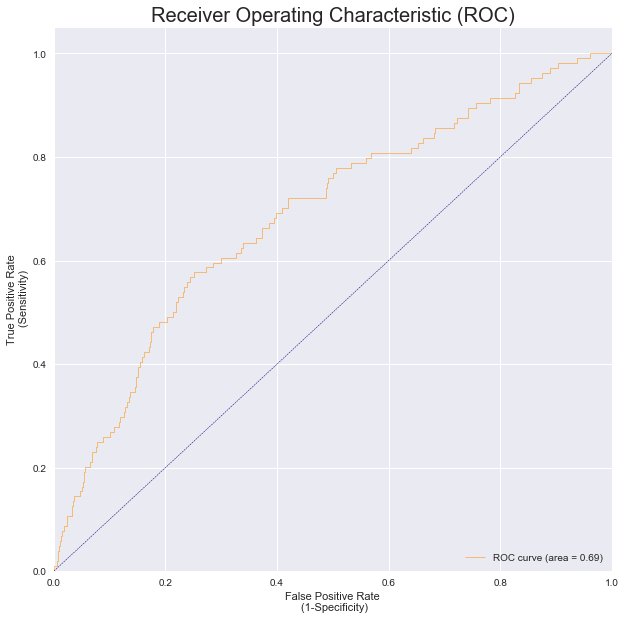


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


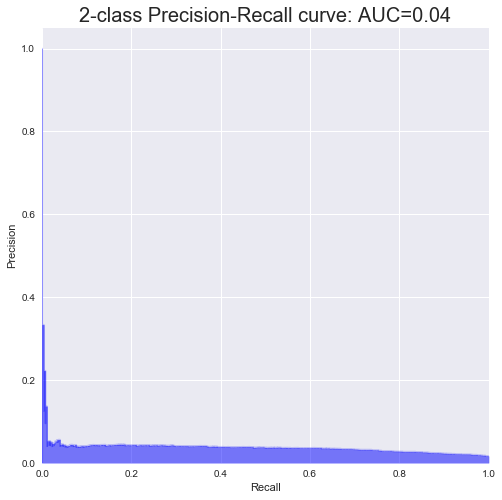


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


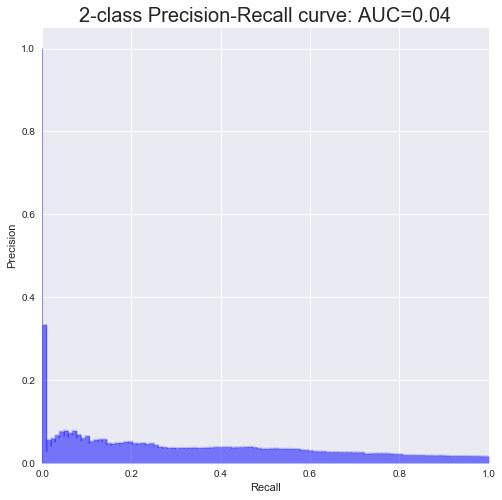

 
Iteration : 68 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 1, 0.1]
__________________________________________________________________

Accuracy - Training:  70.59%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14546    76]
 [ 6068   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   62]]

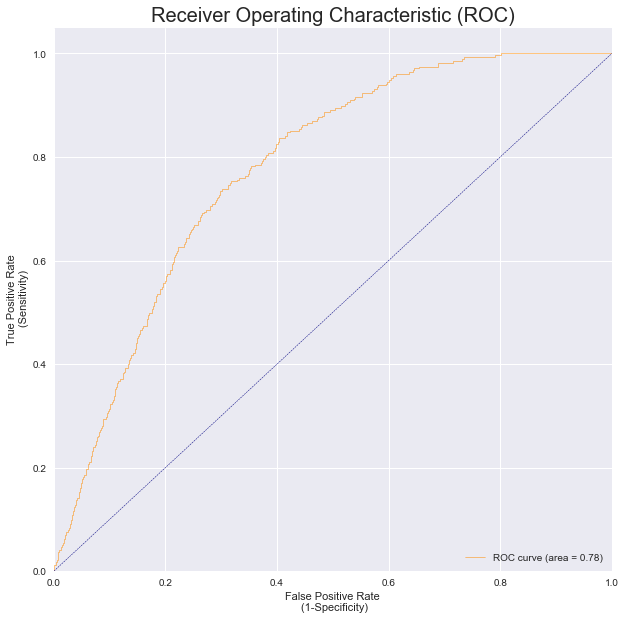


  Test AUC 


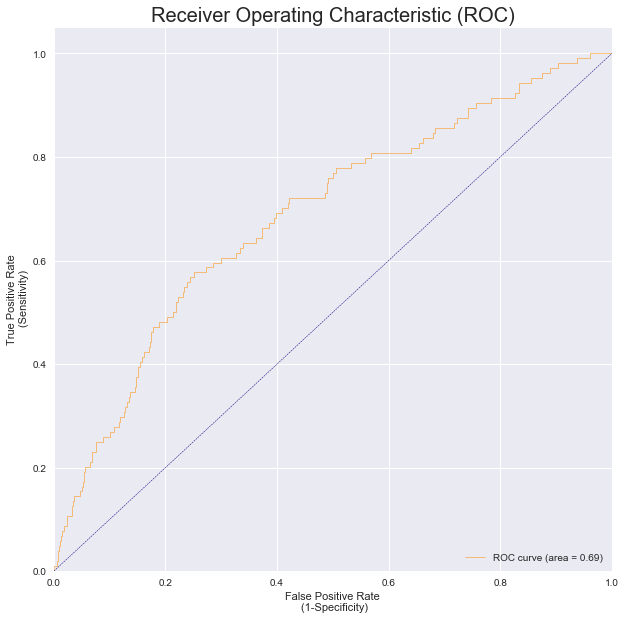


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


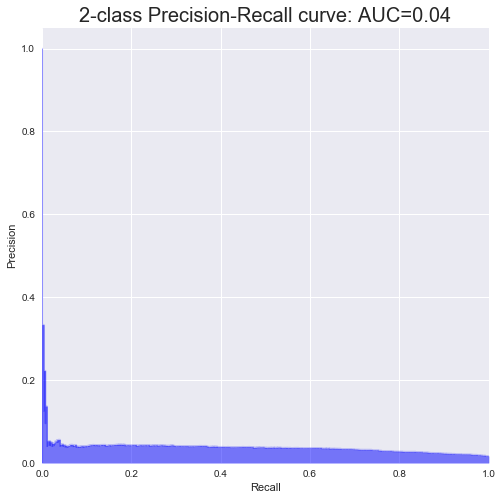


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


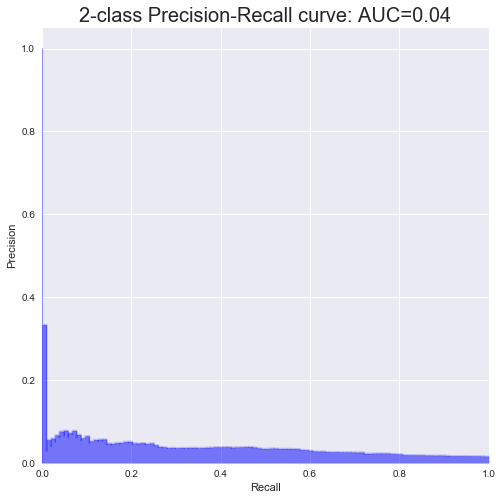

 
Iteration : 69 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 10, 0.0001]
__________________________________________________________________

Accuracy - Training:  70.57%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14542    76]
 [ 6072   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   

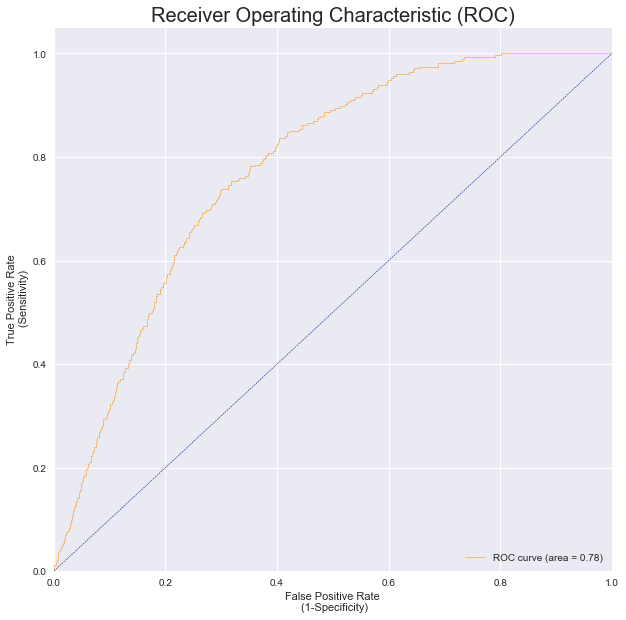


  Test AUC 


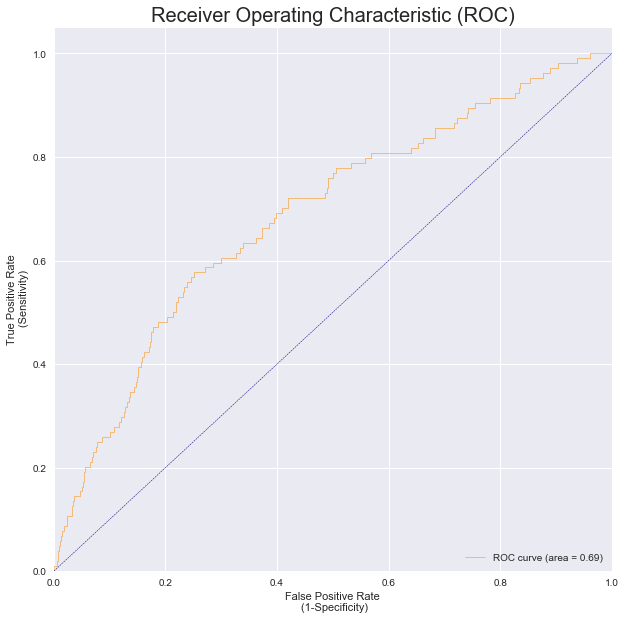


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


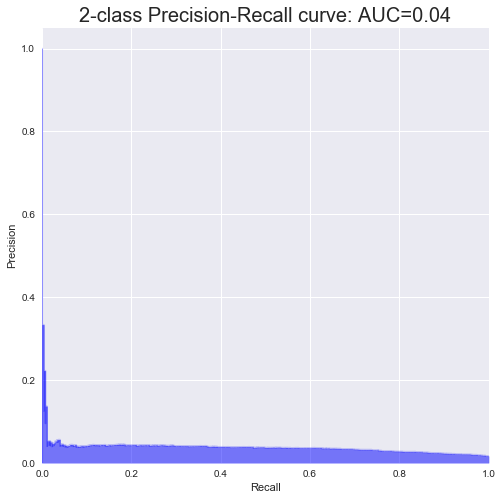


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


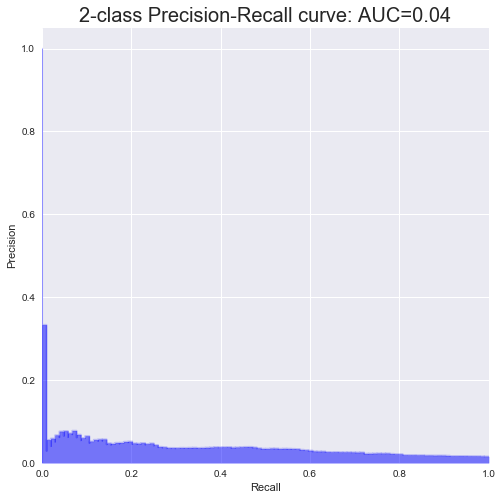

 
Iteration : 70 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 10, 0.001]
__________________________________________________________________

Accuracy - Training:  70.57%
Accuracy - test    :  70.28%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14542    76]
 [ 6072   199]]


  Confusion Matrix - Test 
[[4832   42]
 [2028   6

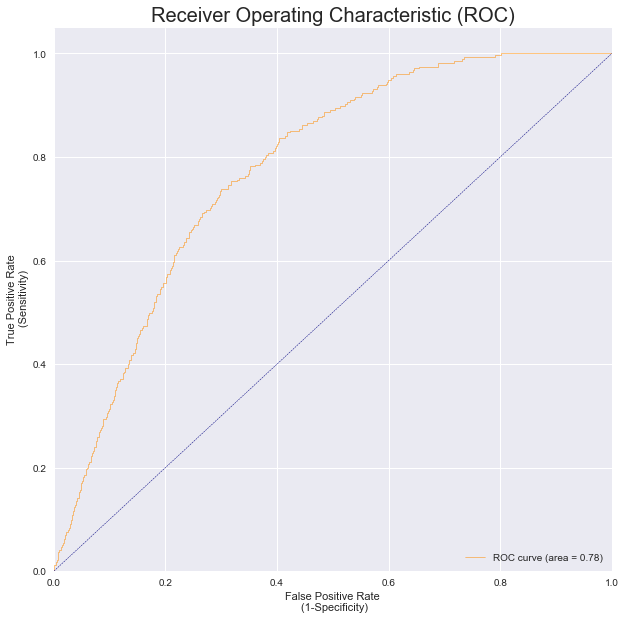


  Test AUC 


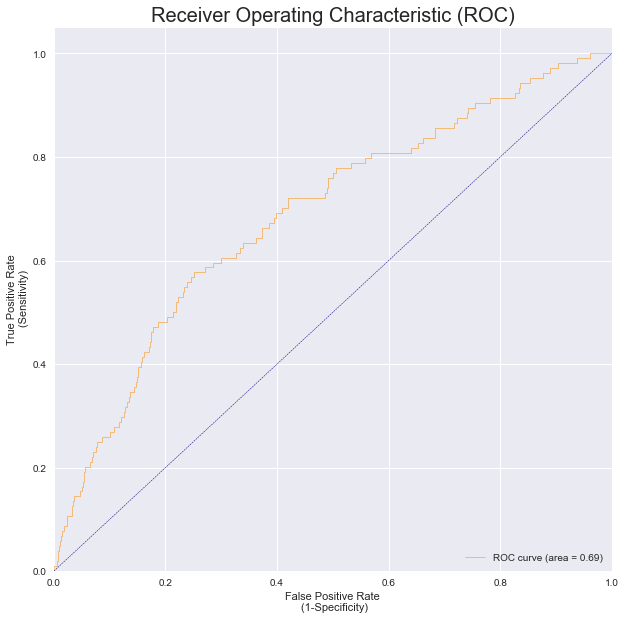


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


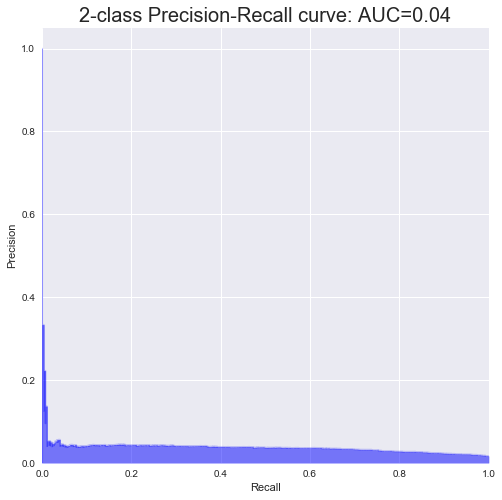


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


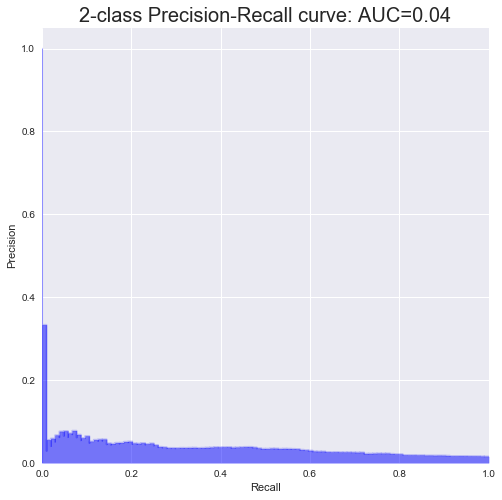

 
Iteration : 71 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 10, 0.01]
__________________________________________________________________

Accuracy - Training:  70.57%
Accuracy - test    :  70.29%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14542    76]
 [ 6072   199]]


  Confusion Matrix - Test 
[[4833   42]
 [2027   62

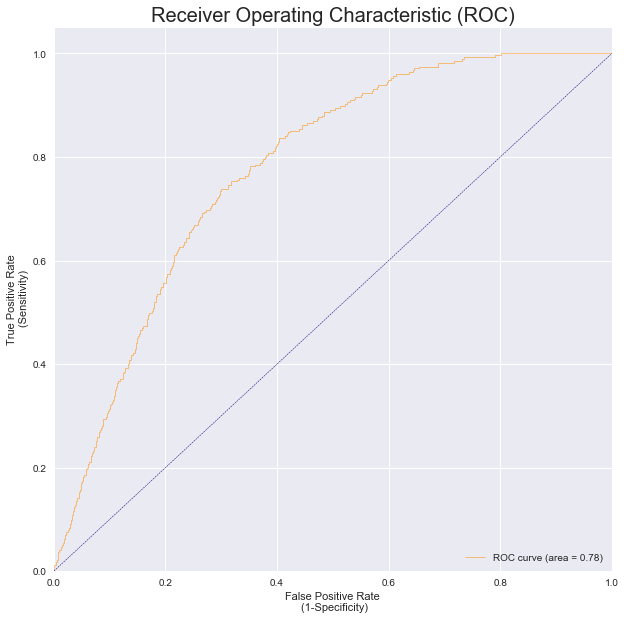


  Test AUC 


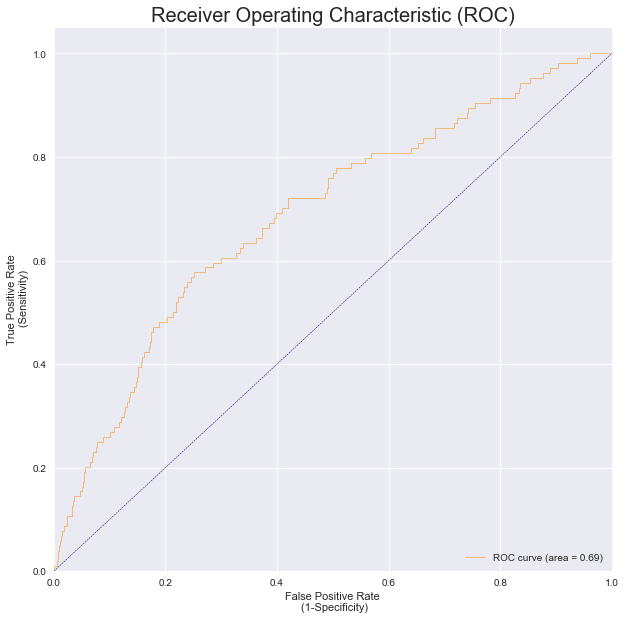


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


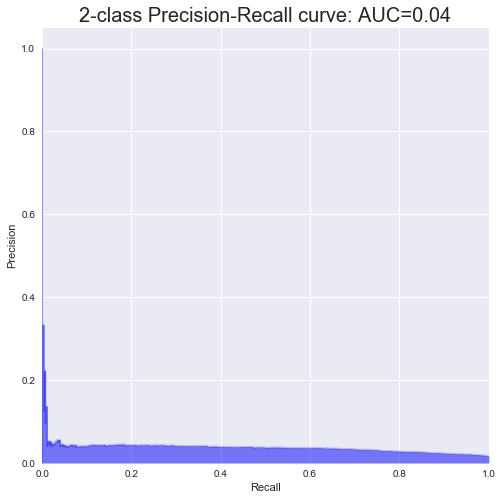


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


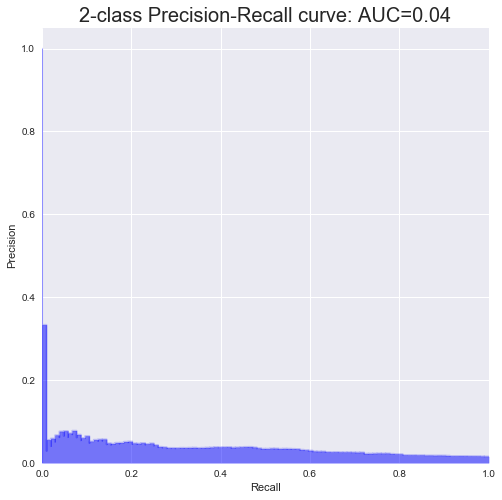

 
Iteration : 72 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['liblinear', 10, 0.1]
__________________________________________________________________

Accuracy - Training:  70.57%
Accuracy - test    :  70.30%

AUC Performance
AUC - Training     : 0.7774
AUC - Test         : 0.6887


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.72      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.70      0.81      6964


  Confusion Matrix - Train 
[[14542    76]
 [ 6072   199]]


  Confusion Matrix - Test 
[[4834   42]
 [2026   62]

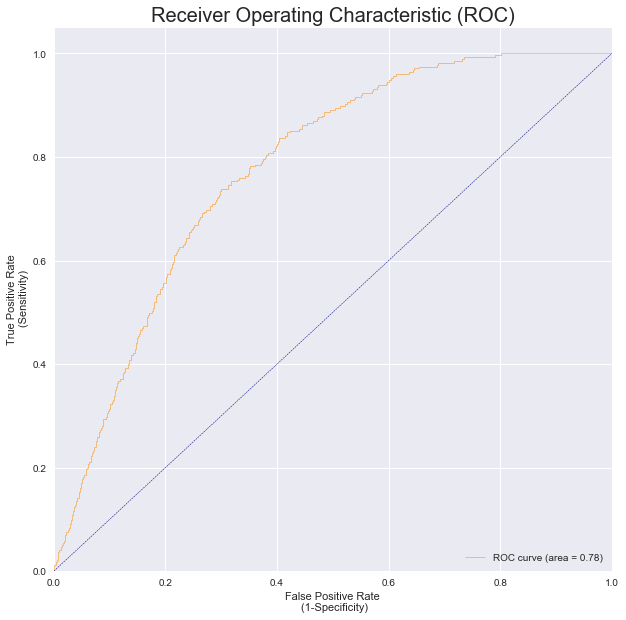


  Test AUC 


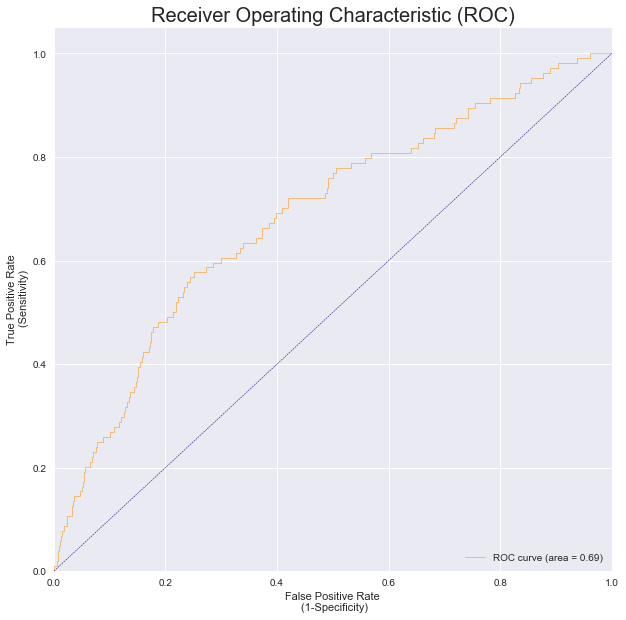


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


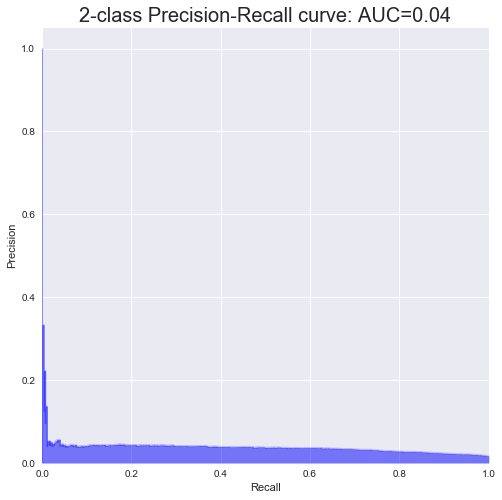


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


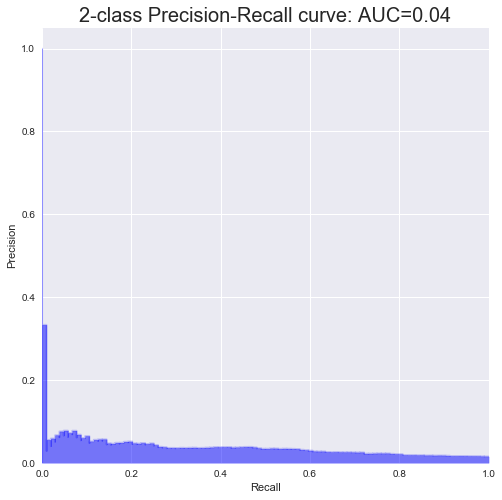

 
Iteration : 73 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.0001, 0.0001]
__________________________________________________________________

Accuracy - Training:  72.78%
Accuracy - test    :  72.06%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6762


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15040   112]
 [ 5574   163]]


  Confusion Matrix - Test 
[[4963   49]
 [1897   55

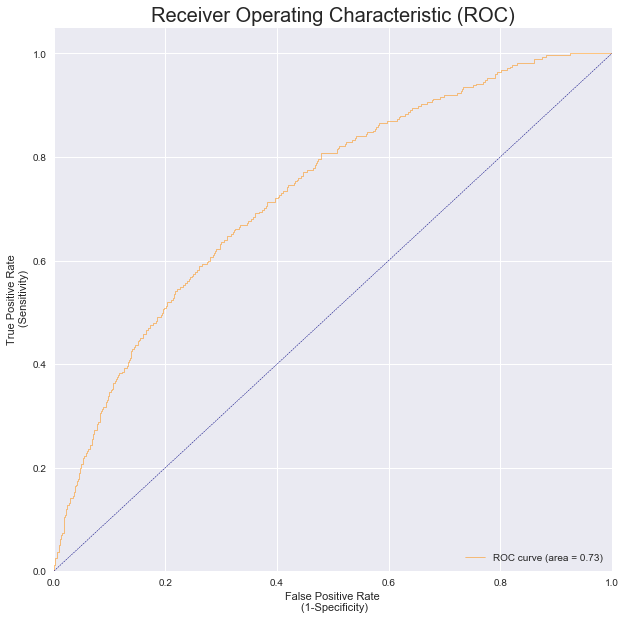


  Test AUC 


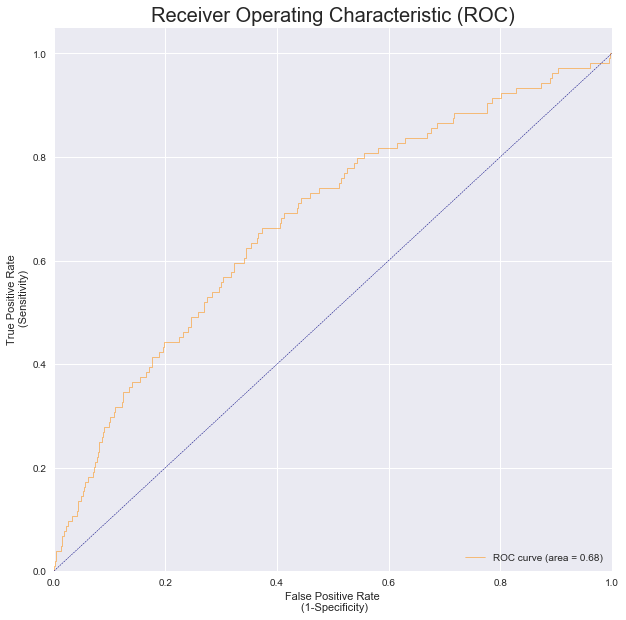


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


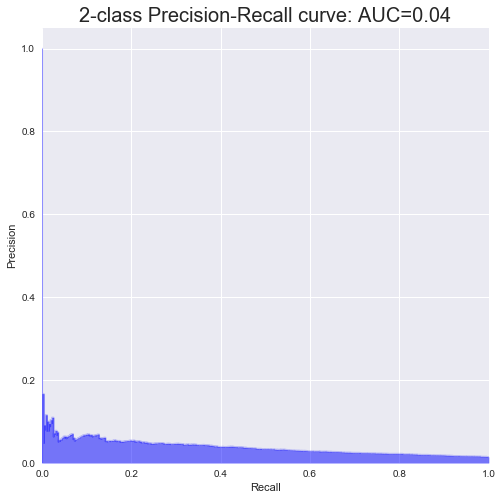


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


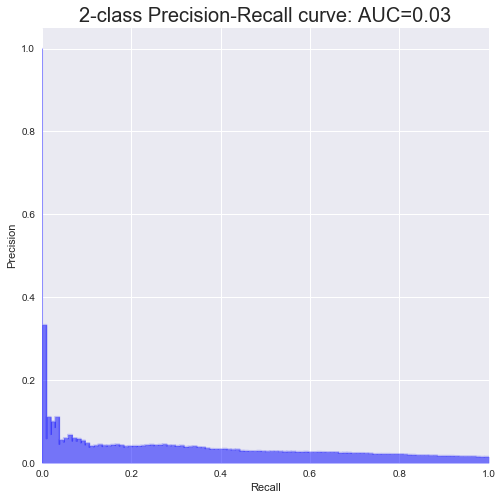

 
Iteration : 74 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.0001, 0.001]
__________________________________________________________________

Accuracy - Training:  72.79%
Accuracy - test    :  72.07%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6763


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.72      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.82      6964


  Confusion Matrix - Train 
[[15042   112]
 [ 5572   163]]


  Confusion Matrix - Test 
[[4964   49]
 [1896   55]

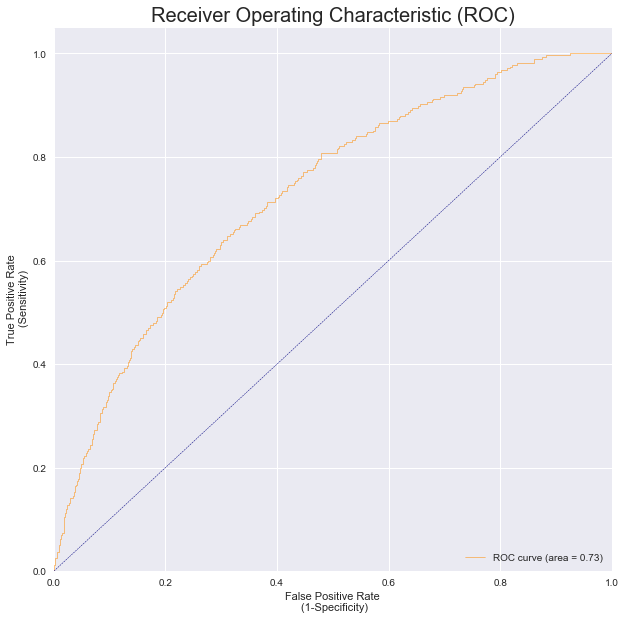


  Test AUC 


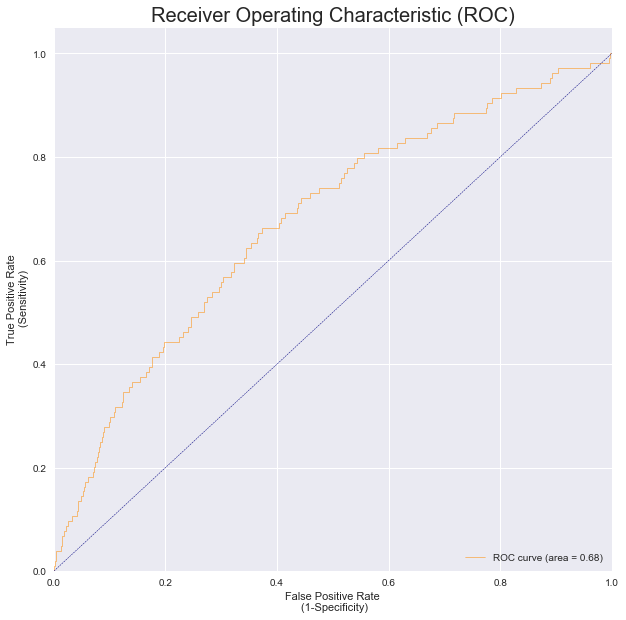


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


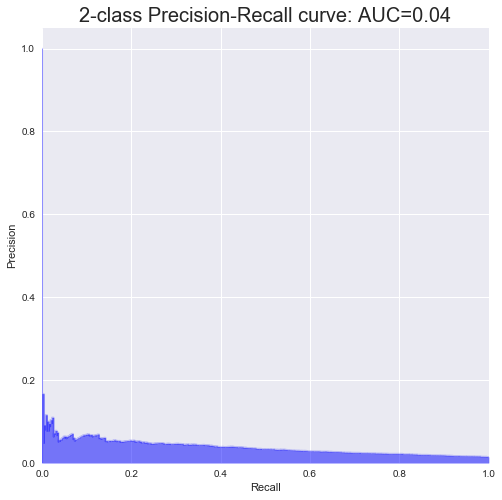


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


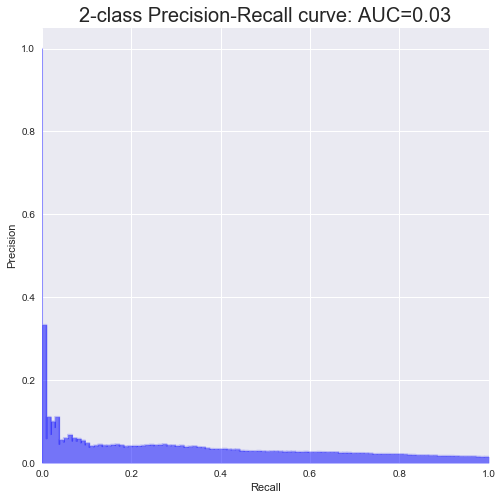

 
Iteration : 75 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.0001, 0.01]
__________________________________________________________________

Accuracy - Training:  73.14%
Accuracy - test    :  72.42%

AUC Performance
AUC - Training     : 0.7298
AUC - Test         : 0.6765


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84     20614
          1       0.03      0.59      0.05       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.73      0.84      6860
          1       0.03      0.53      0.05       104

avg / total       0.98      0.72      0.83      6964


  Confusion Matrix - Train 
[[15115   112]
 [ 5499   163]]


  Confusion Matrix - Test 
[[4988   49]
 [1872   55]]

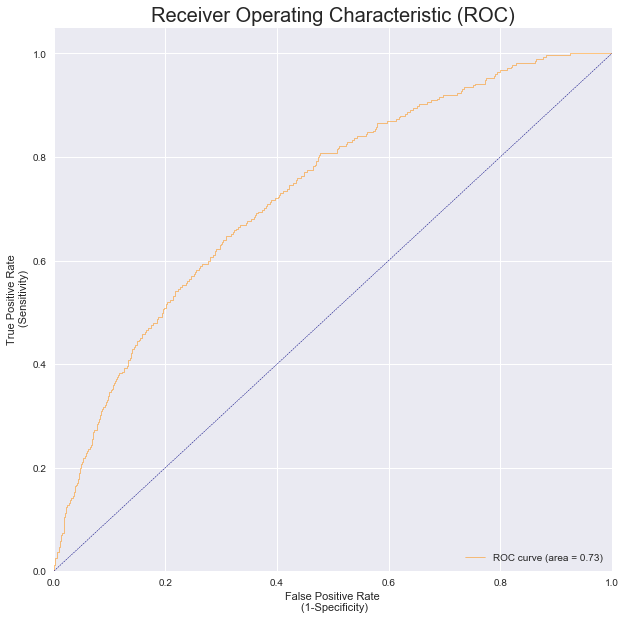


  Test AUC 


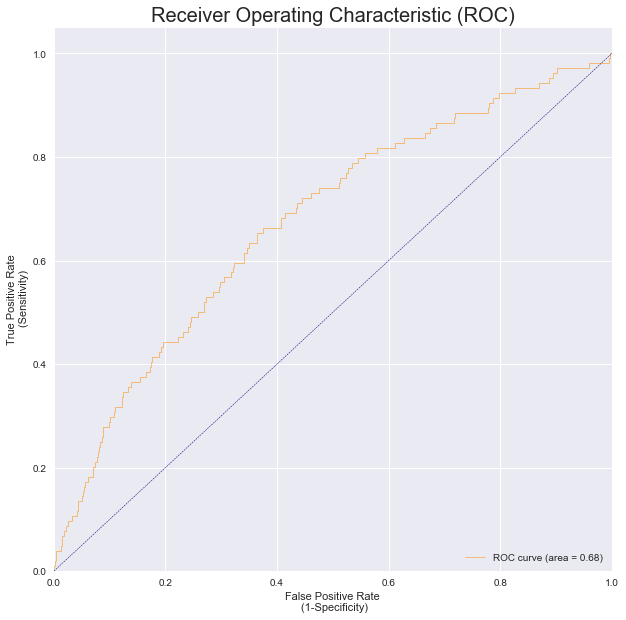


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


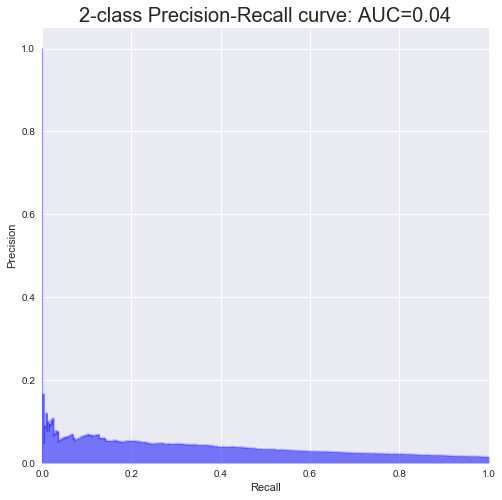


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


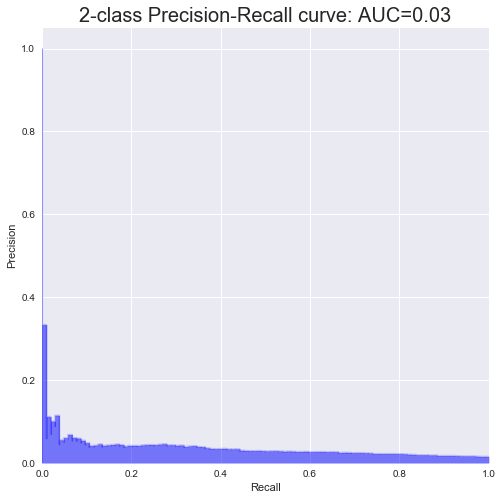

 
Iteration : 76 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.0001, 0.1]
__________________________________________________________________

Accuracy - Training:  73.92%
Accuracy - test    :  73.26%

AUC Performance
AUC - Training     : 0.7296
AUC - Test         : 0.6784


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.74      0.85     20614
          1       0.03      0.58      0.06       275

avg / total       0.98      0.74      0.84     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.74      0.84      6860
          1       0.03      0.51      0.05       104

avg / total       0.98      0.73      0.83      6964


  Confusion Matrix - Train 
[[15282   115]
 [ 5332   160]]


  Confusion Matrix - Test 
[[5049   51]
 [1811   53]]


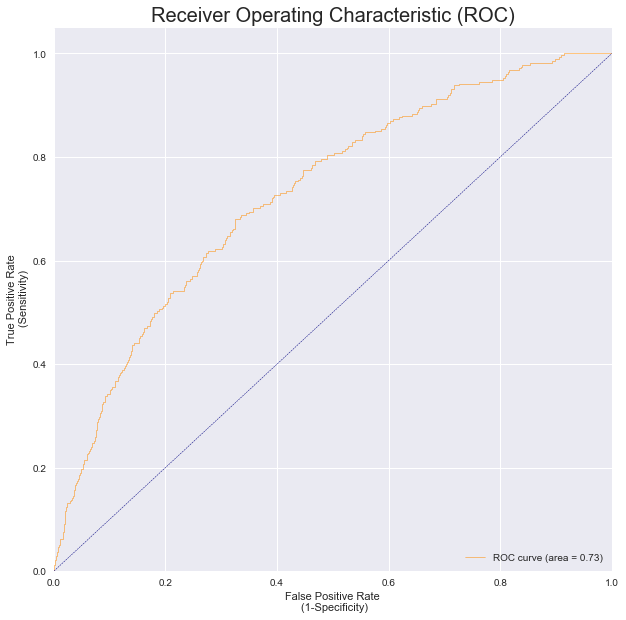


  Test AUC 


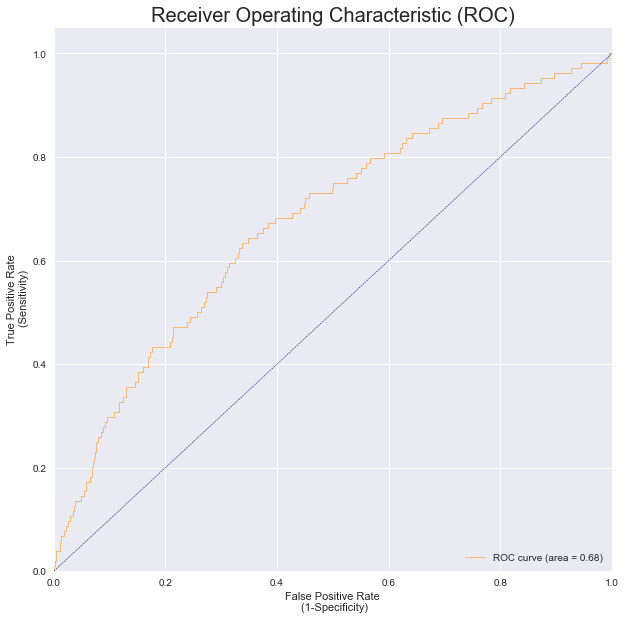


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


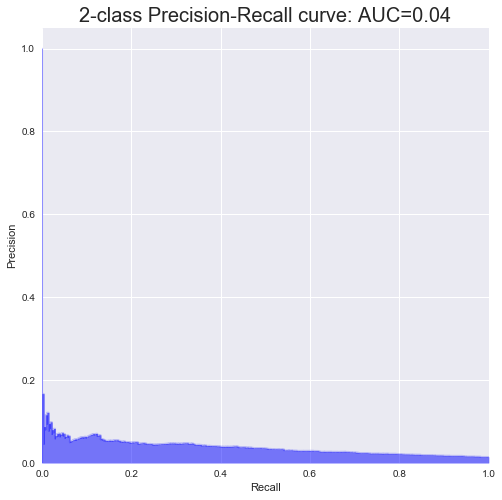


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


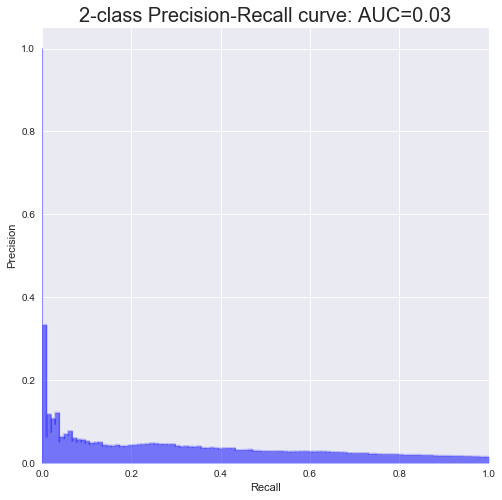

 
Iteration : 77 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.001, 0.0001]
__________________________________________________________________

Accuracy - Training:  69.85%
Accuracy - test    :  68.87%

AUC Performance
AUC - Training     : 0.7381
AUC - Test         : 0.6815


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.67      0.05       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.57      0.05       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14407    92]
 [ 6207   183]]


  Confusion Matrix - Test 
[[4737   45]
 [2123   59]

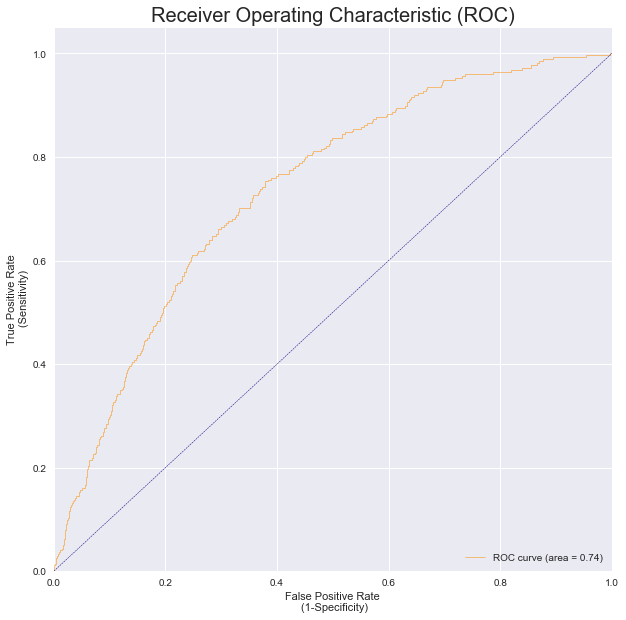


  Test AUC 


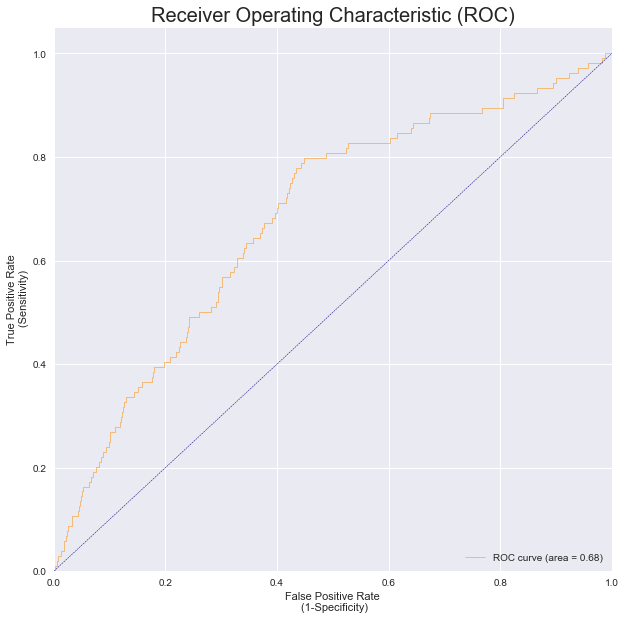


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


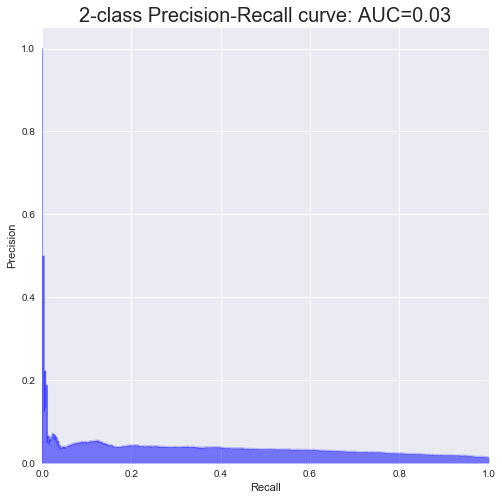


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


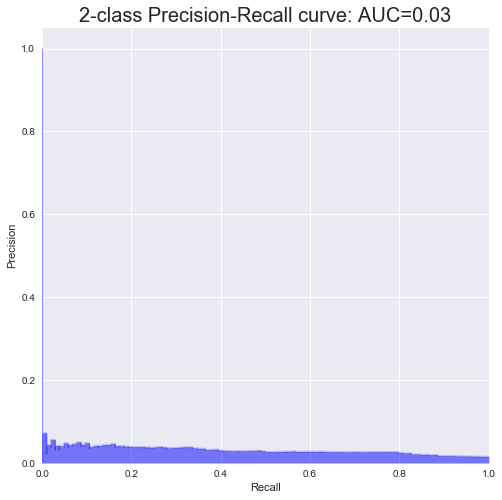

 
Iteration : 78 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.001, 0.001]
__________________________________________________________________

Accuracy - Training:  69.85%
Accuracy - test    :  68.87%

AUC Performance
AUC - Training     : 0.7381
AUC - Test         : 0.6815


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.67      0.05       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.57      0.05       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14407    92]
 [ 6207   183]]


  Confusion Matrix - Test 
[[4737   45]
 [2123   59]]

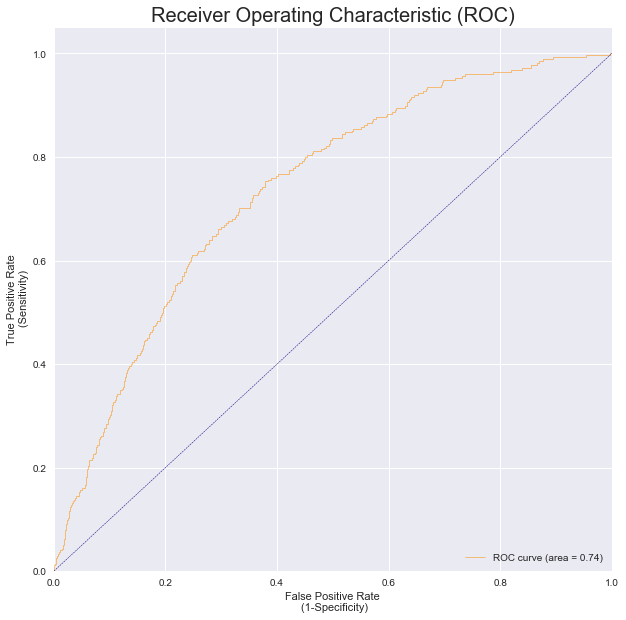


  Test AUC 


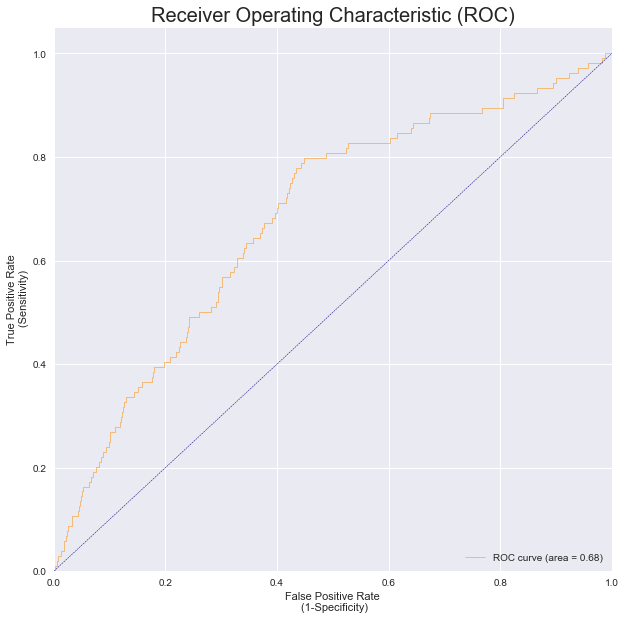


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


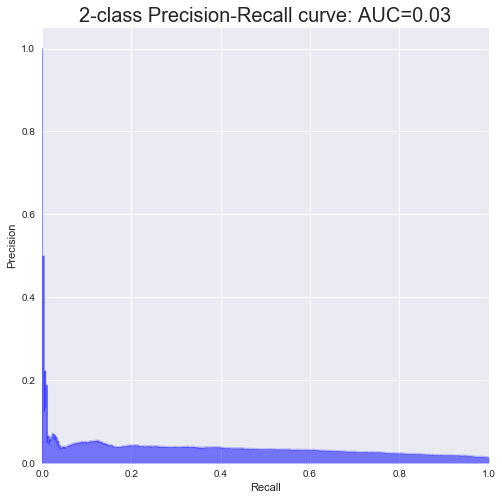


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


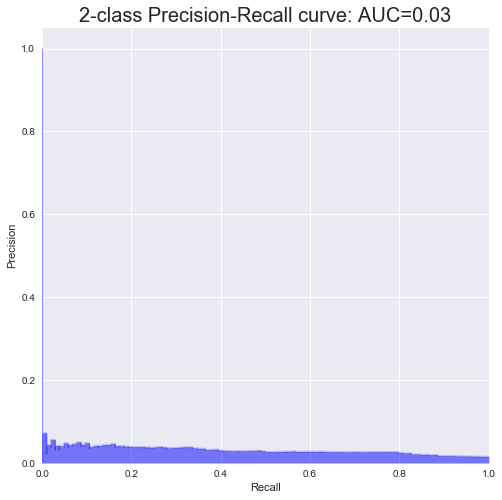

 
Iteration : 79 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.001, 0.01]
__________________________________________________________________

Accuracy - Training:  69.85%
Accuracy - test    :  68.87%

AUC Performance
AUC - Training     : 0.7381
AUC - Test         : 0.6815


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.67      0.05       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.57      0.05       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14407    92]
 [ 6207   183]]


  Confusion Matrix - Test 
[[4737   45]
 [2123   59]]


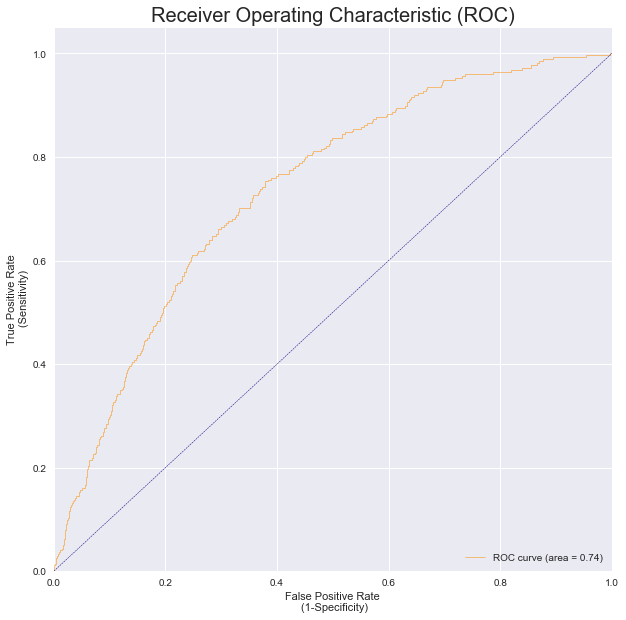


  Test AUC 


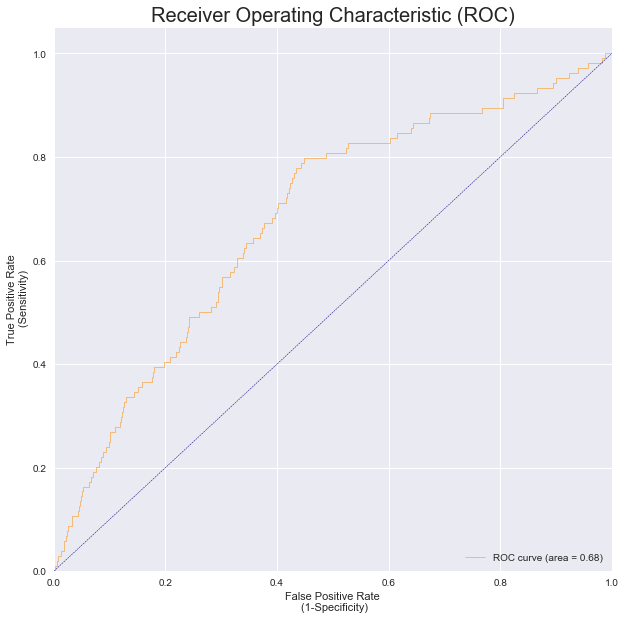


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


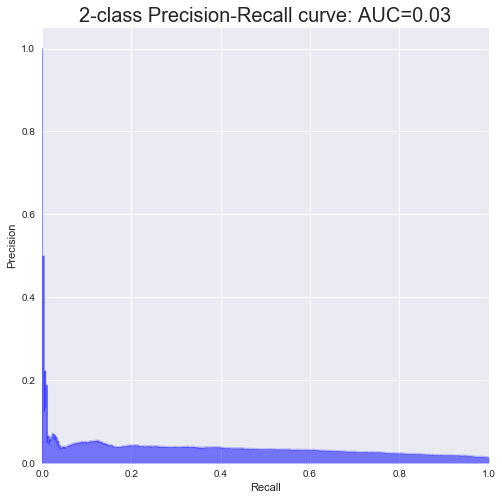


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


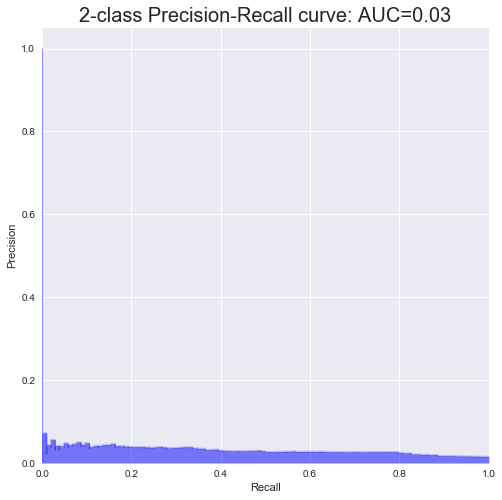

 
Iteration : 80 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.001, 0.1]
__________________________________________________________________

Accuracy - Training:  69.85%
Accuracy - test    :  68.87%

AUC Performance
AUC - Training     : 0.7381
AUC - Test         : 0.6815


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.67      0.05       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.57      0.05       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14407    92]
 [ 6207   183]]


  Confusion Matrix - Test 
[[4737   45]
 [2123   59]]



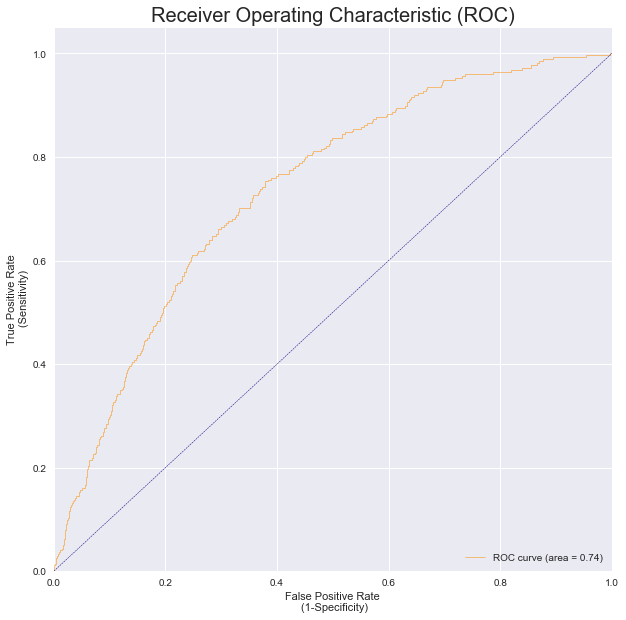


  Test AUC 


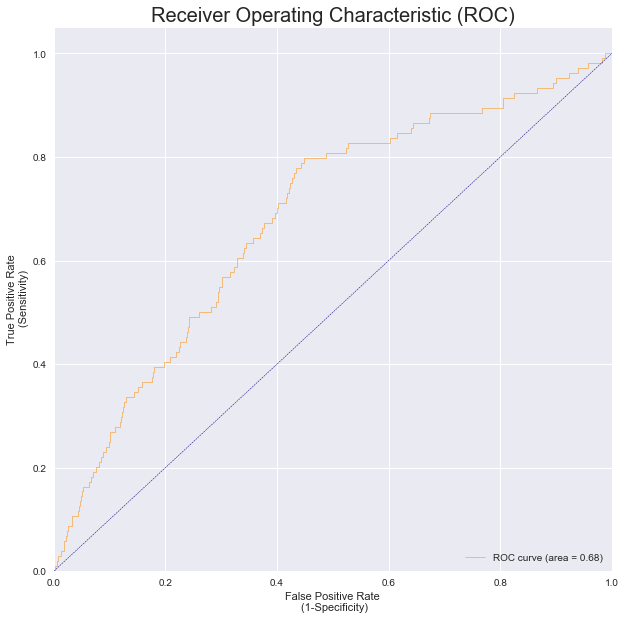


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


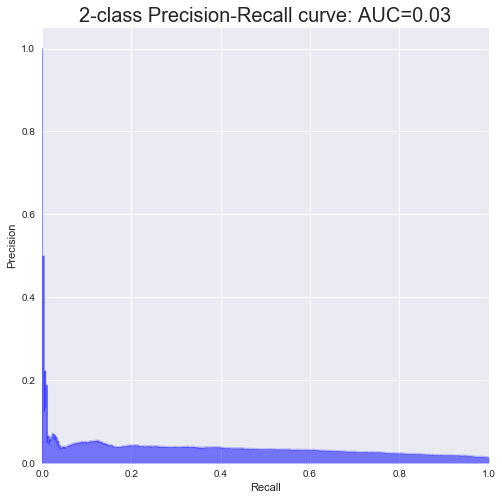


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


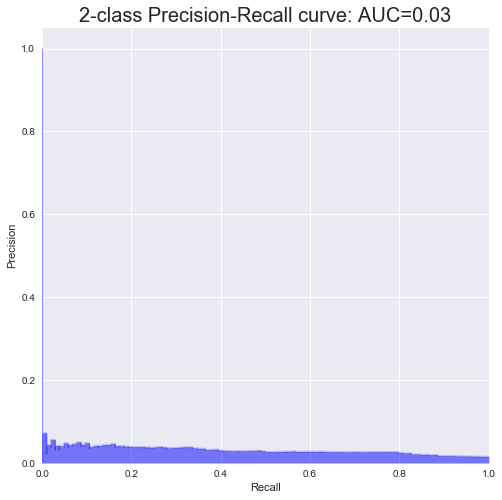

 
Iteration : 81 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.01, 0.0001]
__________________________________________________________________

Accuracy - Training:  64.37%
Accuracy - test    :  65.13%

AUC Performance
AUC - Training     : 0.6620
AUC - Test         : 0.6589


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.64      0.78     20614
          1       0.02      0.61      0.04       275

avg / total       0.98      0.64      0.77     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.65      0.79      6860
          1       0.02      0.58      0.05       104

avg / total       0.98      0.65      0.78      6964


  Confusion Matrix - Train 
[[13280   108]
 [ 7334   167]]


  Confusion Matrix - Test 
[[4476   44]
 [2384   60]]

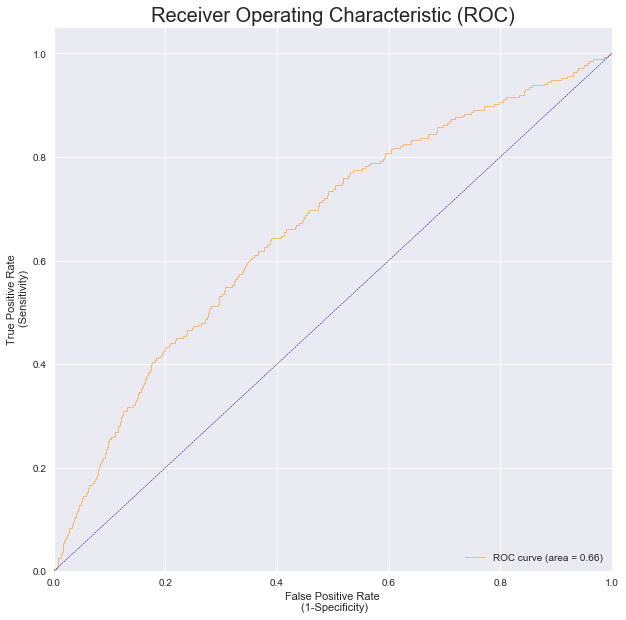


  Test AUC 


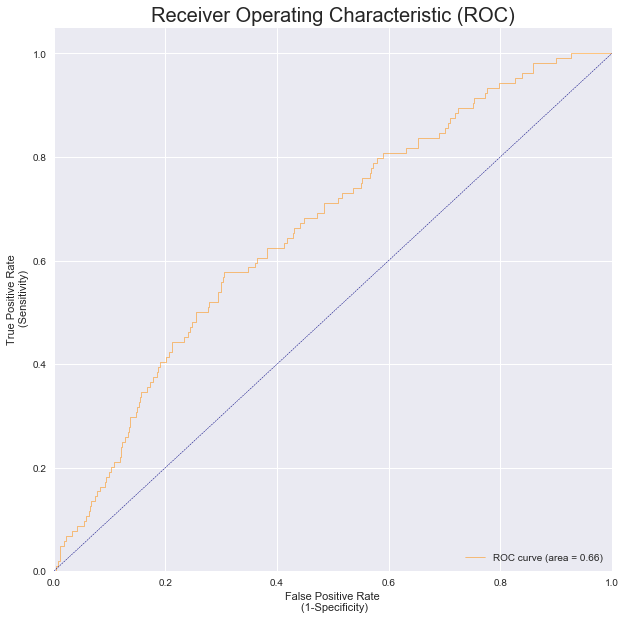


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


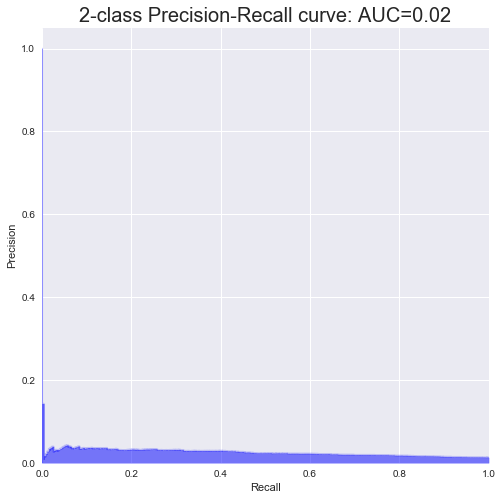


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


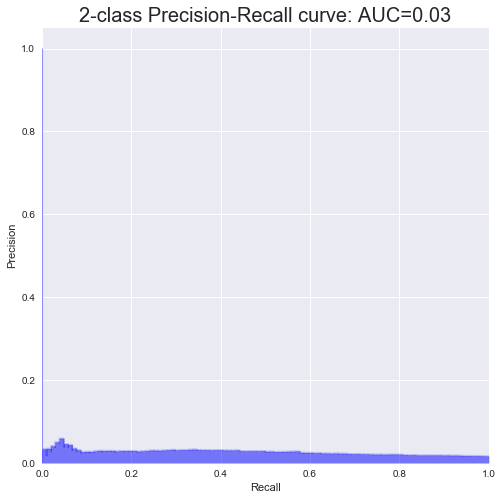

 
Iteration : 82 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.01, 0.001]
__________________________________________________________________

Accuracy - Training:  64.37%
Accuracy - test    :  65.13%

AUC Performance
AUC - Training     : 0.6620
AUC - Test         : 0.6589


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.64      0.78     20614
          1       0.02      0.61      0.04       275

avg / total       0.98      0.64      0.77     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.65      0.79      6860
          1       0.02      0.58      0.05       104

avg / total       0.98      0.65      0.78      6964


  Confusion Matrix - Train 
[[13280   108]
 [ 7334   167]]


  Confusion Matrix - Test 
[[4476   44]
 [2384   60]]


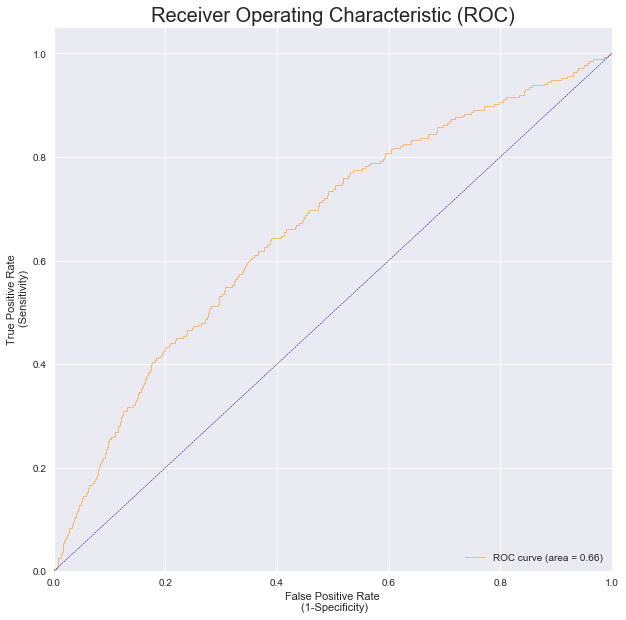


  Test AUC 


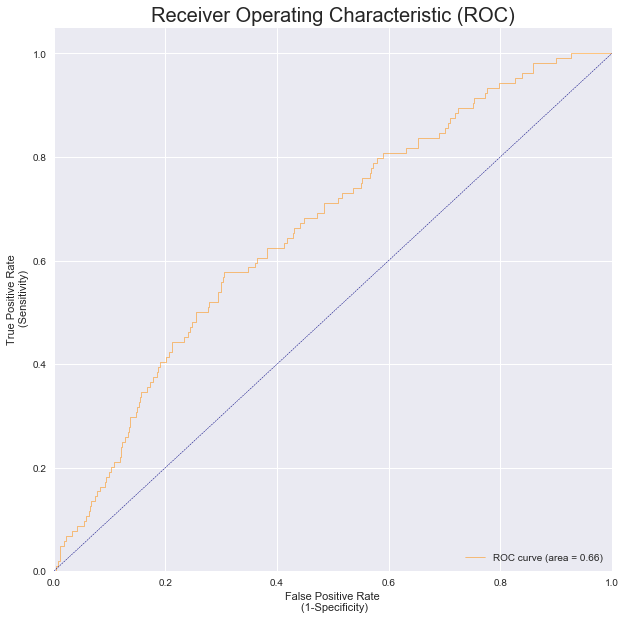


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


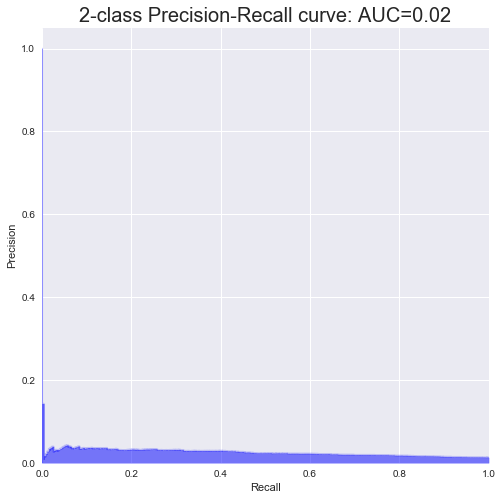


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


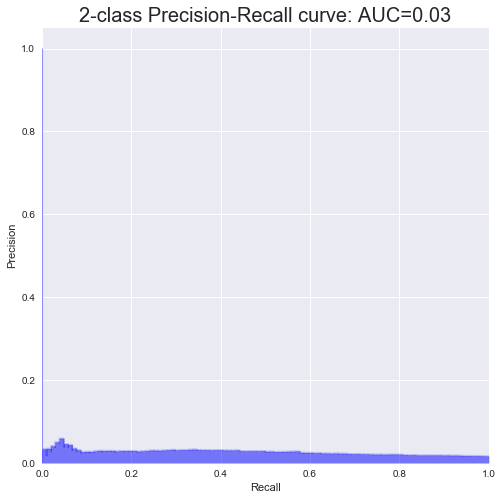

 
Iteration : 83 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.01, 0.01]
__________________________________________________________________

Accuracy - Training:  64.37%
Accuracy - test    :  65.13%

AUC Performance
AUC - Training     : 0.6620
AUC - Test         : 0.6589


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.64      0.78     20614
          1       0.02      0.61      0.04       275

avg / total       0.98      0.64      0.77     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.65      0.79      6860
          1       0.02      0.58      0.05       104

avg / total       0.98      0.65      0.78      6964


  Confusion Matrix - Train 
[[13280   108]
 [ 7334   167]]


  Confusion Matrix - Test 
[[4476   44]
 [2384   60]]



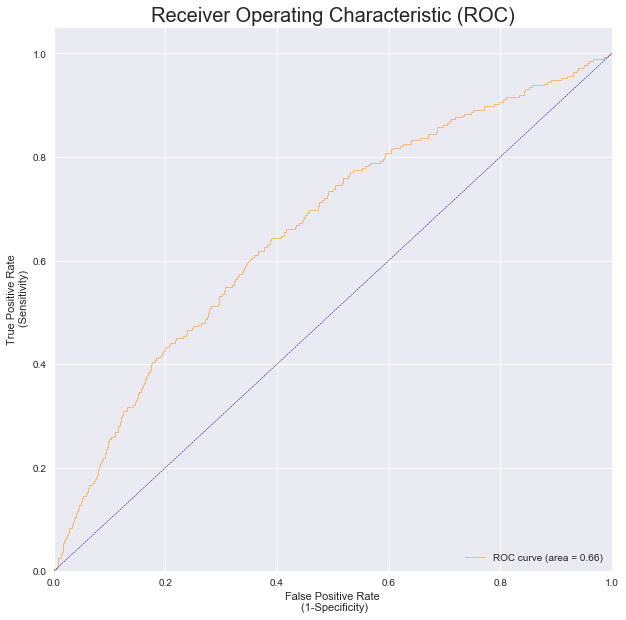


  Test AUC 


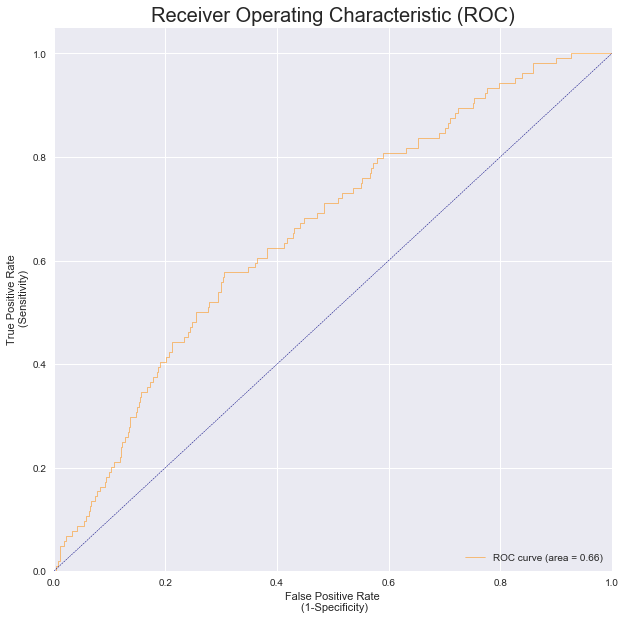


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


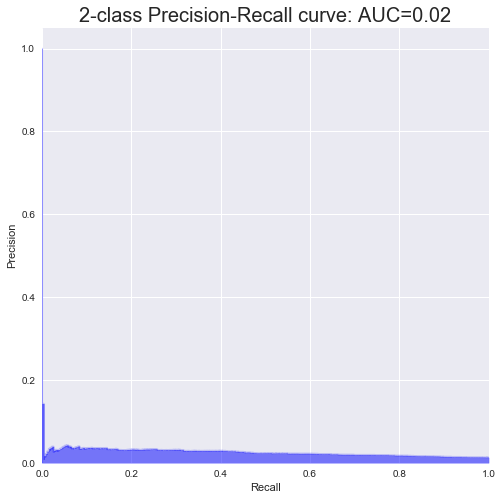


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


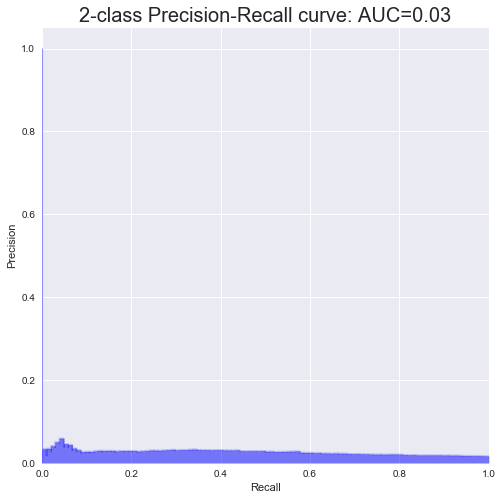

 
Iteration : 84 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.01, 0.1]
__________________________________________________________________

Accuracy - Training:  64.37%
Accuracy - test    :  65.13%

AUC Performance
AUC - Training     : 0.6620
AUC - Test         : 0.6589


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.64      0.78     20614
          1       0.02      0.61      0.04       275

avg / total       0.98      0.64      0.77     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.65      0.79      6860
          1       0.02      0.58      0.05       104

avg / total       0.98      0.65      0.78      6964


  Confusion Matrix - Train 
[[13280   108]
 [ 7334   167]]


  Confusion Matrix - Test 
[[4476   44]
 [2384   60]]




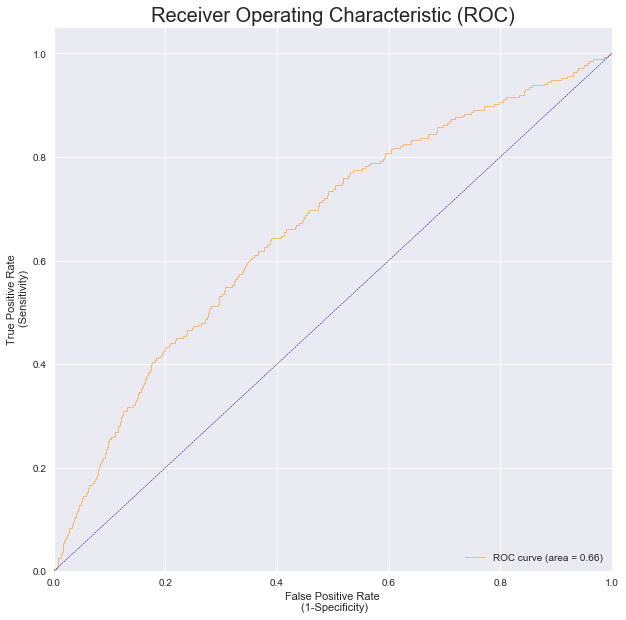


  Test AUC 


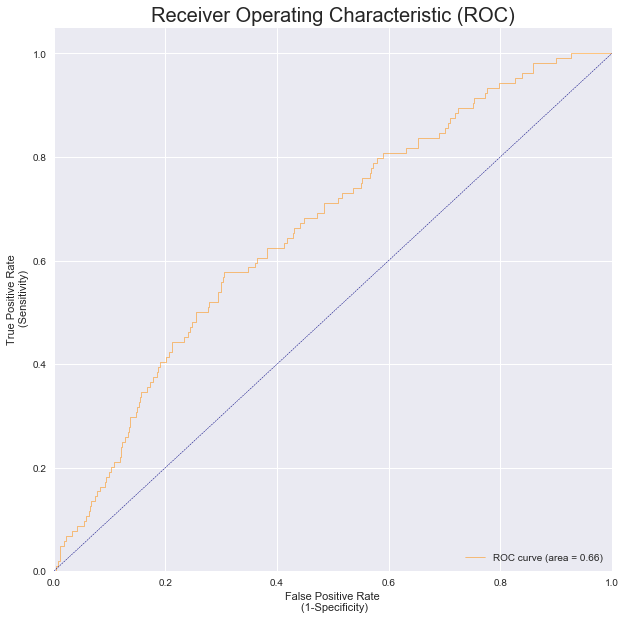


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


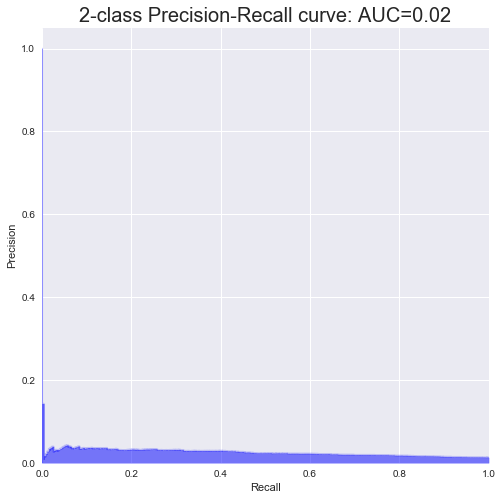


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


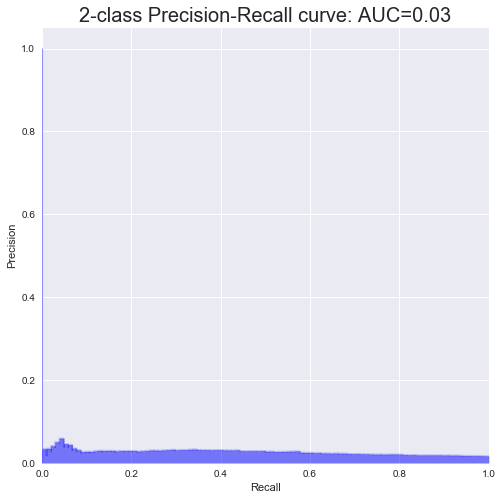

 
Iteration : 85 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.1, 0.0001]
__________________________________________________________________

Accuracy - Training:  62.51%
Accuracy - test    :  62.05%

AUC Performance
AUC - Training     : 0.6418
AUC - Test         : 0.5966


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.63      0.77     20614
          1       0.02      0.59      0.04       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.50      0.04       104

avg / total       0.97      0.62      0.75      6964


  Confusion Matrix - Train 
[[12897   114]
 [ 7717   161]]


  Confusion Matrix - Test 
[[4269   52]
 [2591   52]]


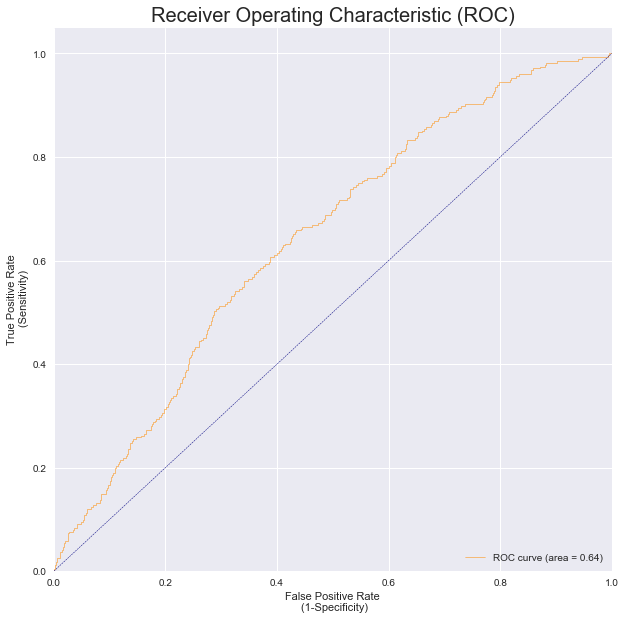


  Test AUC 


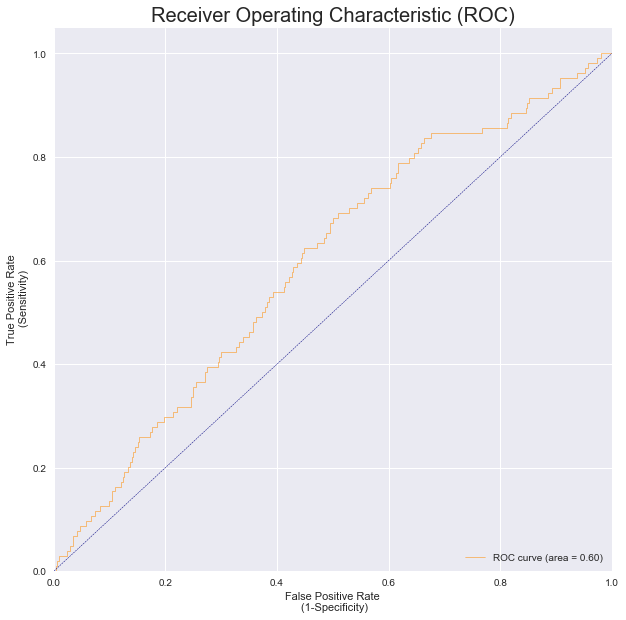


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


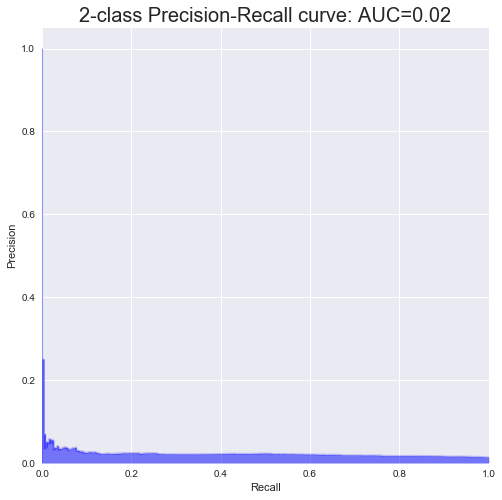


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


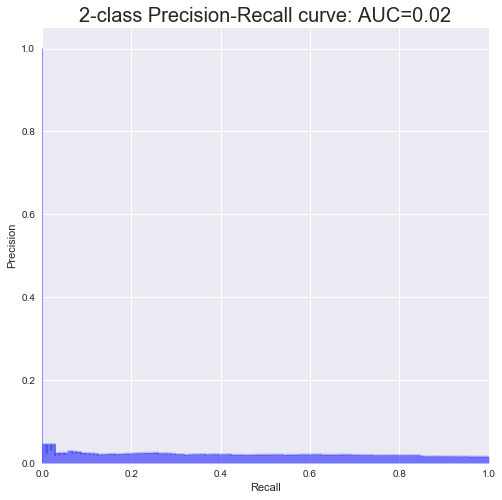

 
Iteration : 86 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.1, 0.001]
__________________________________________________________________

Accuracy - Training:  62.51%
Accuracy - test    :  62.05%

AUC Performance
AUC - Training     : 0.6418
AUC - Test         : 0.5966


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.63      0.77     20614
          1       0.02      0.59      0.04       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.50      0.04       104

avg / total       0.97      0.62      0.75      6964


  Confusion Matrix - Train 
[[12897   114]
 [ 7717   161]]


  Confusion Matrix - Test 
[[4269   52]
 [2591   52]]



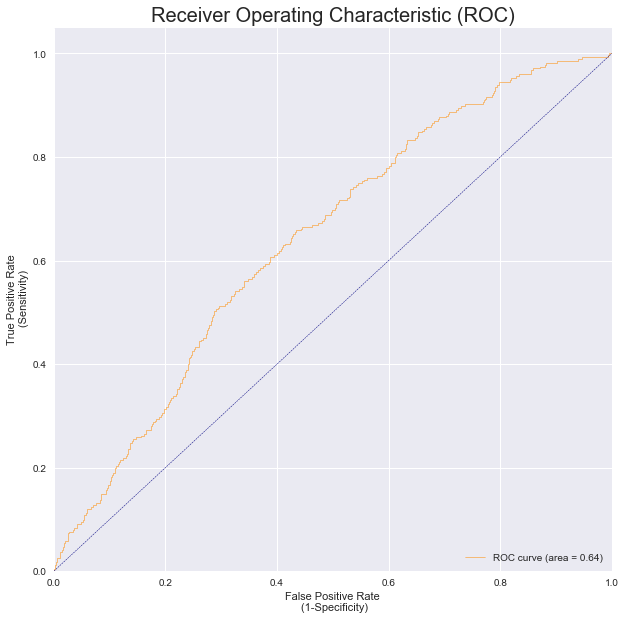


  Test AUC 


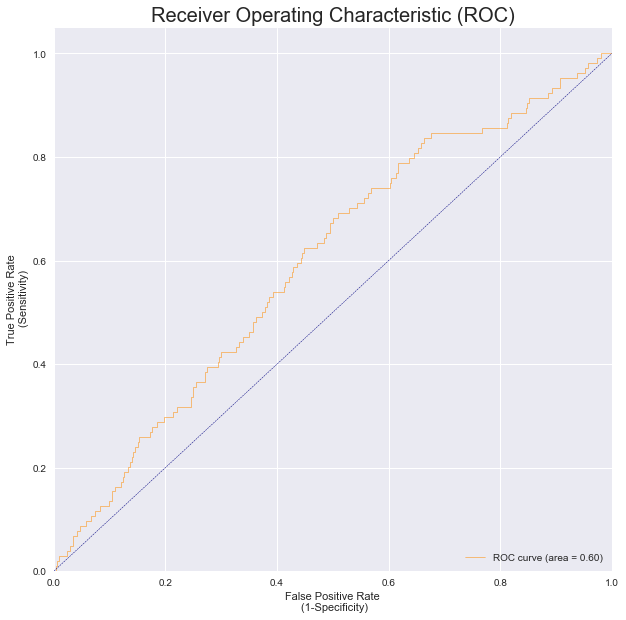


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


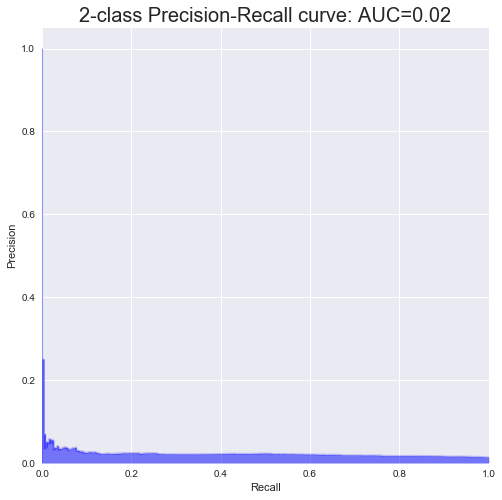


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


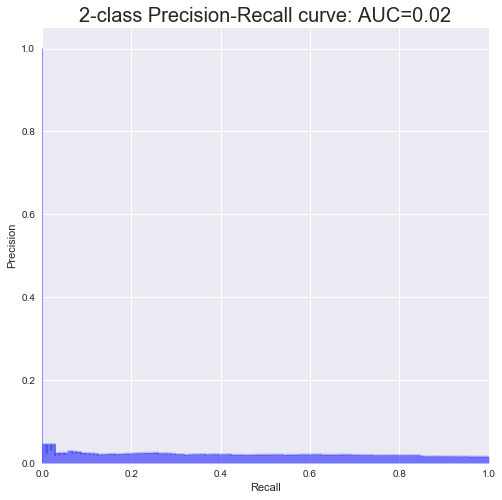

 
Iteration : 87 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.1, 0.01]
__________________________________________________________________

Accuracy - Training:  62.51%
Accuracy - test    :  62.05%

AUC Performance
AUC - Training     : 0.6418
AUC - Test         : 0.5966


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.63      0.77     20614
          1       0.02      0.59      0.04       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.50      0.04       104

avg / total       0.97      0.62      0.75      6964


  Confusion Matrix - Train 
[[12897   114]
 [ 7717   161]]


  Confusion Matrix - Test 
[[4269   52]
 [2591   52]]




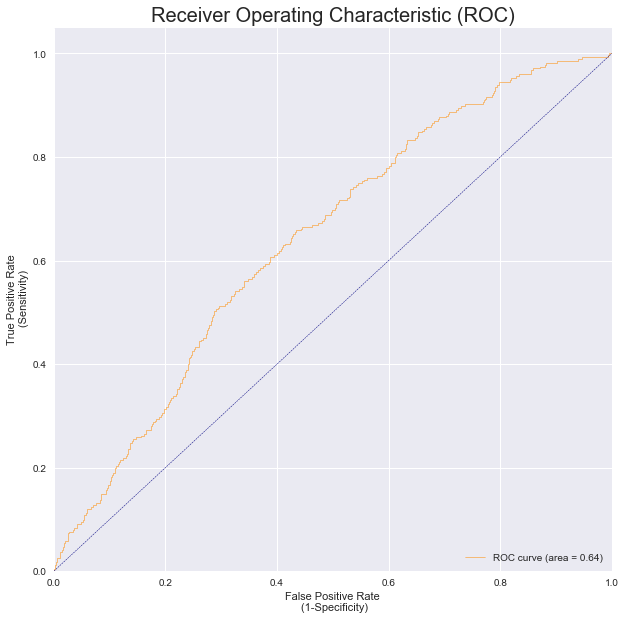


  Test AUC 


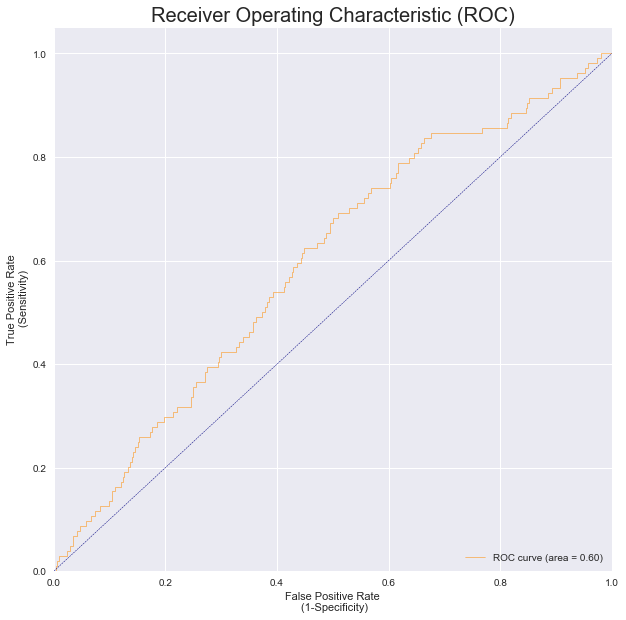


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


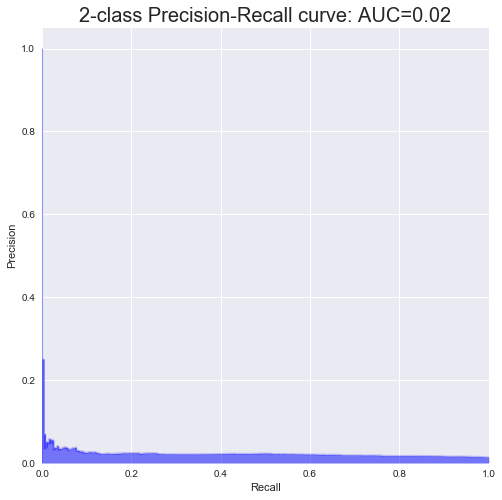


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


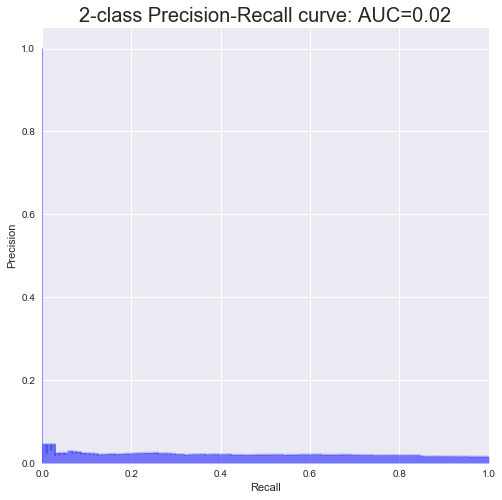

 
Iteration : 88 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 0.1, 0.1]
__________________________________________________________________

Accuracy - Training:  62.51%
Accuracy - test    :  62.05%

AUC Performance
AUC - Training     : 0.6418
AUC - Test         : 0.5966


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.63      0.77     20614
          1       0.02      0.59      0.04       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.50      0.04       104

avg / total       0.97      0.62      0.75      6964


  Confusion Matrix - Train 
[[12897   114]
 [ 7717   161]]


  Confusion Matrix - Test 
[[4269   52]
 [2591   52]]


 

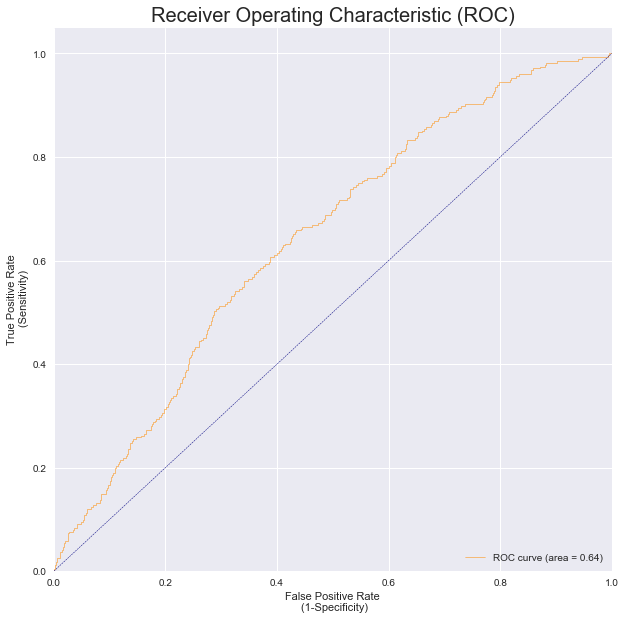


  Test AUC 


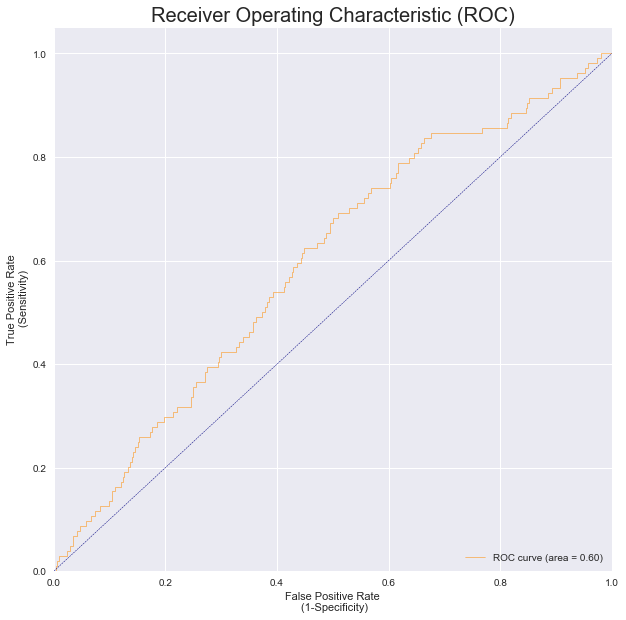


  Train Precission - Recall Curve 
Average precision-recall score: 0.02


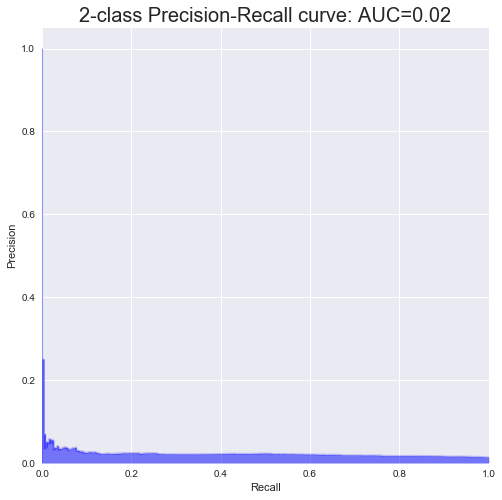


  Test Precission - Recall Curve 
Average precision-recall score: 0.02


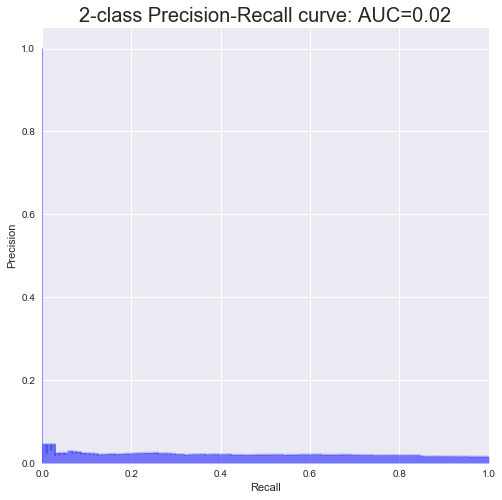

 
Iteration : 89 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 1, 0.0001]
__________________________________________________________________

Accuracy - Training:  62.83%
Accuracy - test    :  62.22%

AUC Performance
AUC - Training     : 0.6511
AUC - Test         : 0.6204


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.63      0.77     20614
          1       0.02      0.56      0.04       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.60      0.05       104

avg / total       0.98      0.62      0.75      6964


  Confusion Matrix - Train 
[[12972   122]
 [ 7642   153]]


  Confusion Matrix - Test 
[[4271   42]
 [2589   62]]




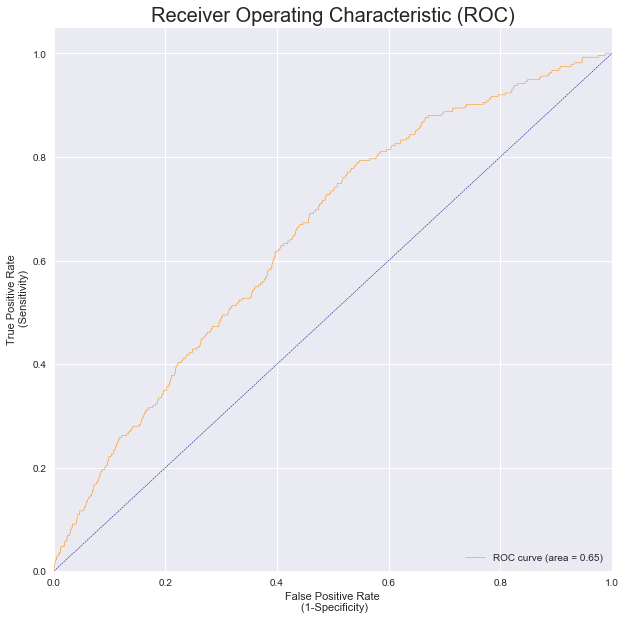


  Test AUC 


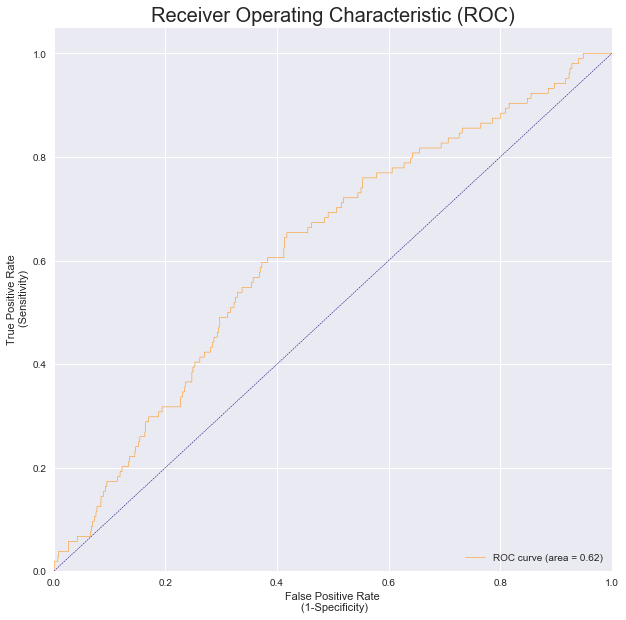


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


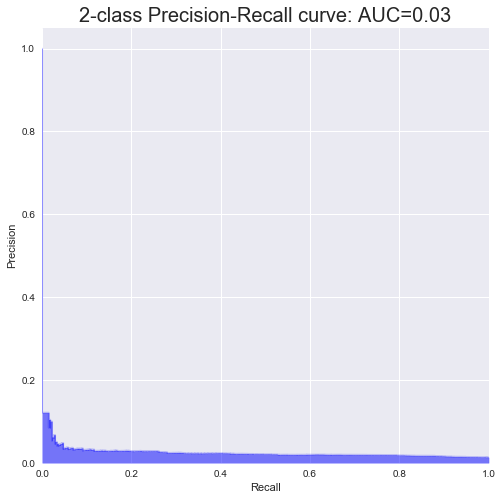


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


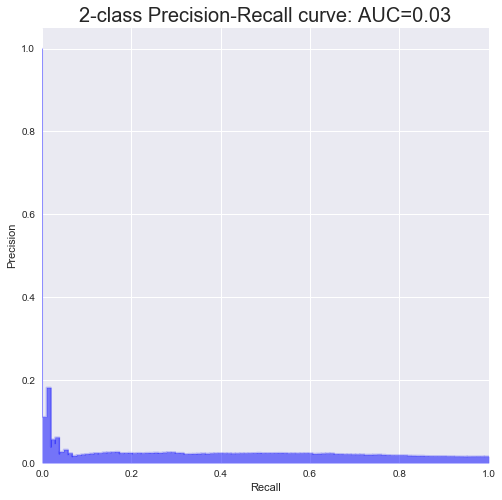

 
Iteration : 90 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 1, 0.001]
__________________________________________________________________

Accuracy - Training:  62.83%
Accuracy - test    :  62.22%

AUC Performance
AUC - Training     : 0.6511
AUC - Test         : 0.6204


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.63      0.77     20614
          1       0.02      0.56      0.04       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.60      0.05       104

avg / total       0.98      0.62      0.75      6964


  Confusion Matrix - Train 
[[12972   122]
 [ 7642   153]]


  Confusion Matrix - Test 
[[4271   42]
 [2589   62]]


 

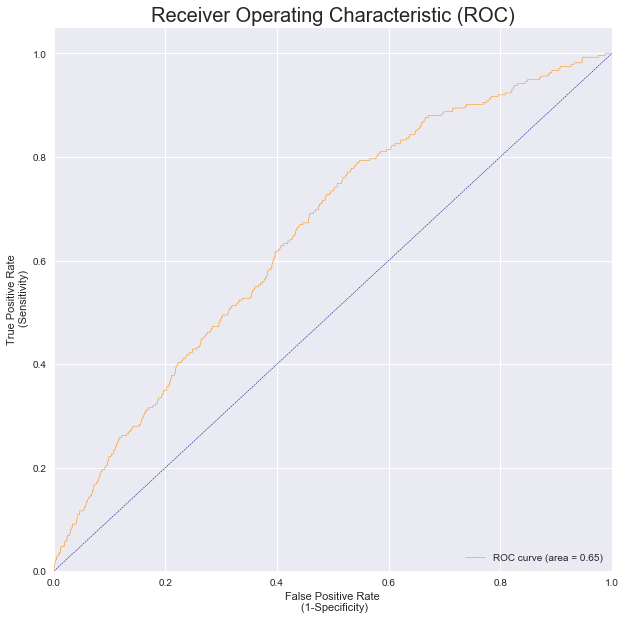


  Test AUC 


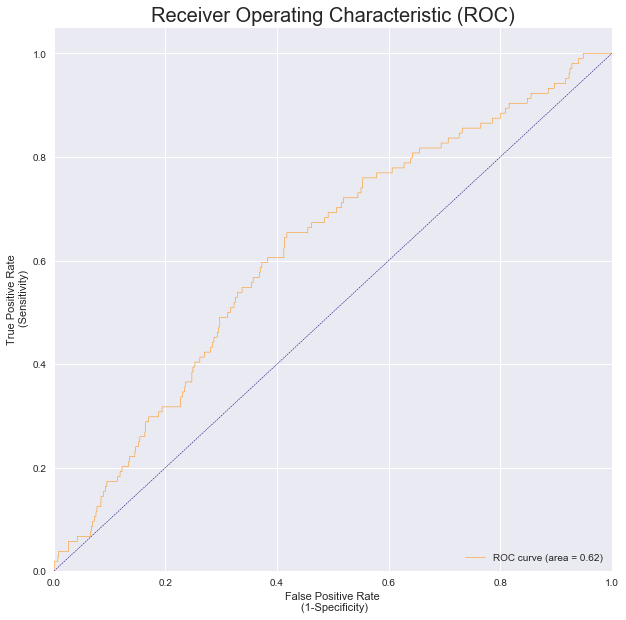


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


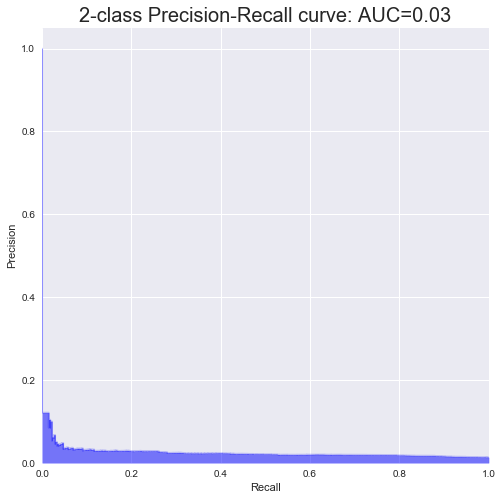


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


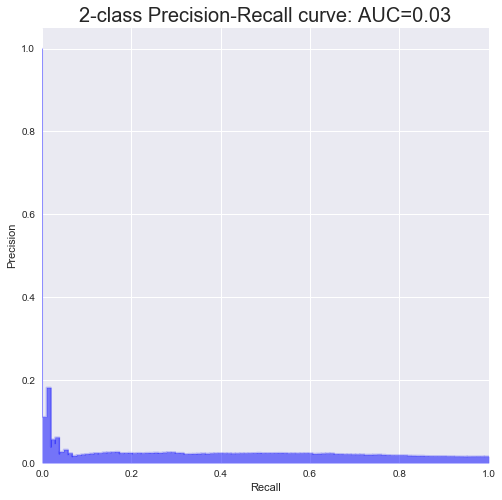

 
Iteration : 91 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 1, 0.01]
__________________________________________________________________

Accuracy - Training:  62.83%
Accuracy - test    :  62.22%

AUC Performance
AUC - Training     : 0.6511
AUC - Test         : 0.6204


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.63      0.77     20614
          1       0.02      0.56      0.04       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.60      0.05       104

avg / total       0.98      0.62      0.75      6964


  Confusion Matrix - Train 
[[12972   122]
 [ 7642   153]]


  Confusion Matrix - Test 
[[4271   42]
 [2589   62]]


  

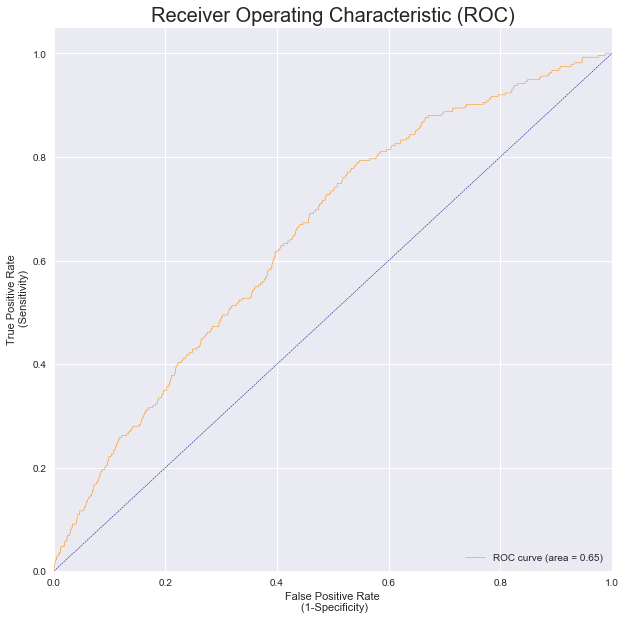


  Test AUC 


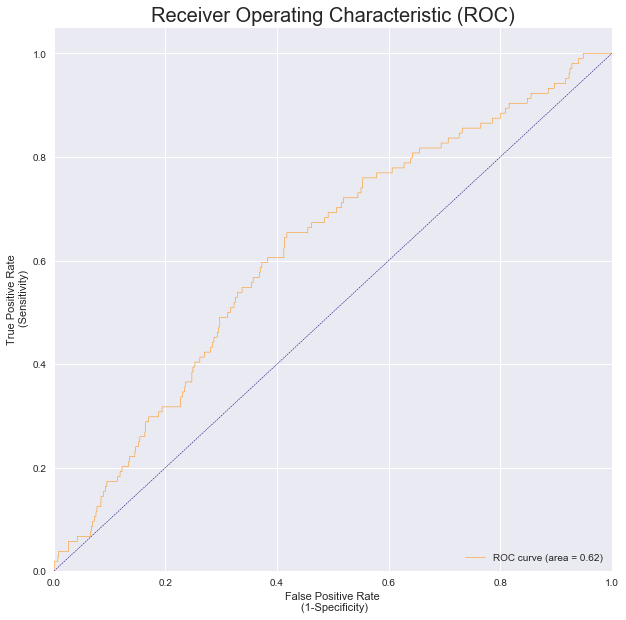


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


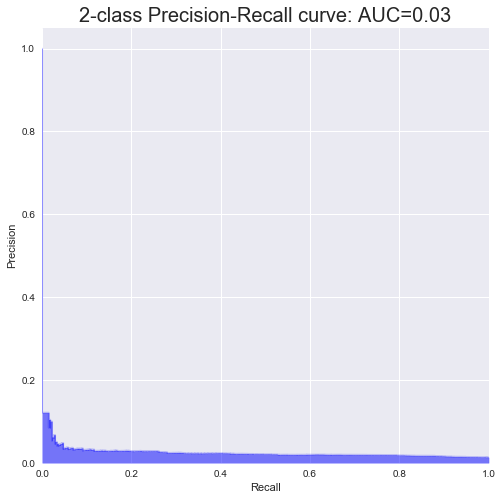


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


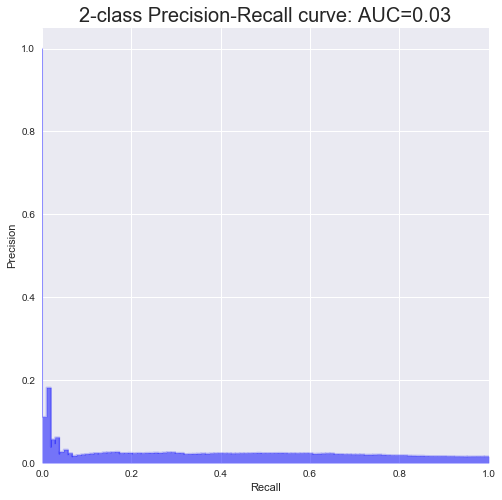

 
Iteration : 92 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 1, 0.1]
__________________________________________________________________

Accuracy - Training:  62.83%
Accuracy - test    :  62.22%

AUC Performance
AUC - Training     : 0.6511
AUC - Test         : 0.6204


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.63      0.77     20614
          1       0.02      0.56      0.04       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.60      0.05       104

avg / total       0.98      0.62      0.75      6964


  Confusion Matrix - Train 
[[12972   122]
 [ 7642   153]]


  Confusion Matrix - Test 
[[4271   42]
 [2589   62]]


  T

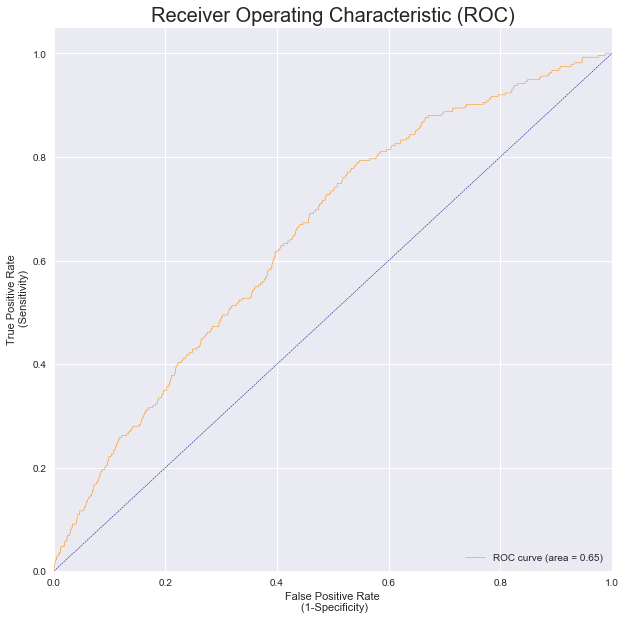


  Test AUC 


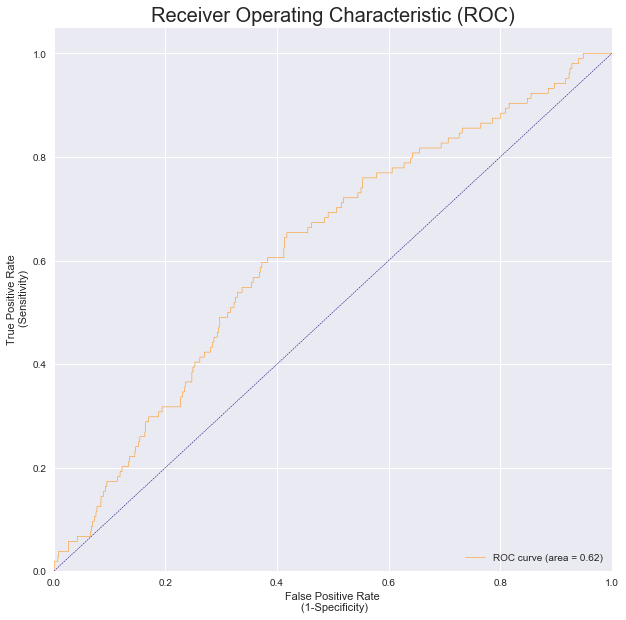


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


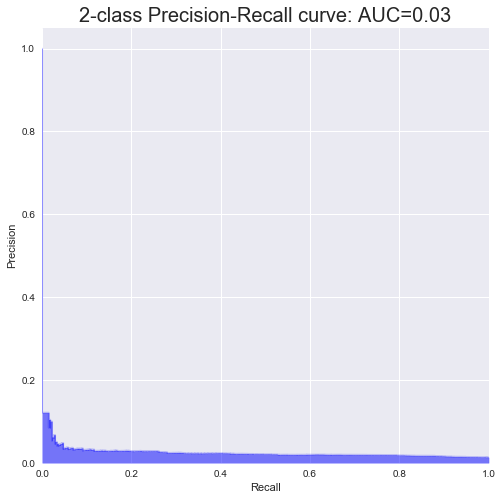


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


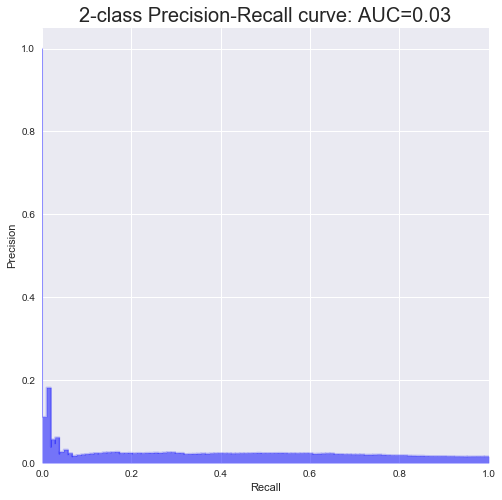

 
Iteration : 93 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 10, 0.0001]
__________________________________________________________________

Accuracy - Training:  56.93%
Accuracy - test    :  56.96%

AUC Performance
AUC - Training     : 0.6606
AUC - Test         : 0.6423


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.57      0.72     20614
          1       0.02      0.67      0.04       275

avg / total       0.98      0.57      0.71     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.57      0.72      6860
          1       0.02      0.62      0.04       104

avg / total       0.98      0.57      0.71      6964


  Confusion Matrix - Train 
[[11707    90]
 [ 8907   185]]


  Confusion Matrix - Test 
[[3903   40]
 [2957   64]]



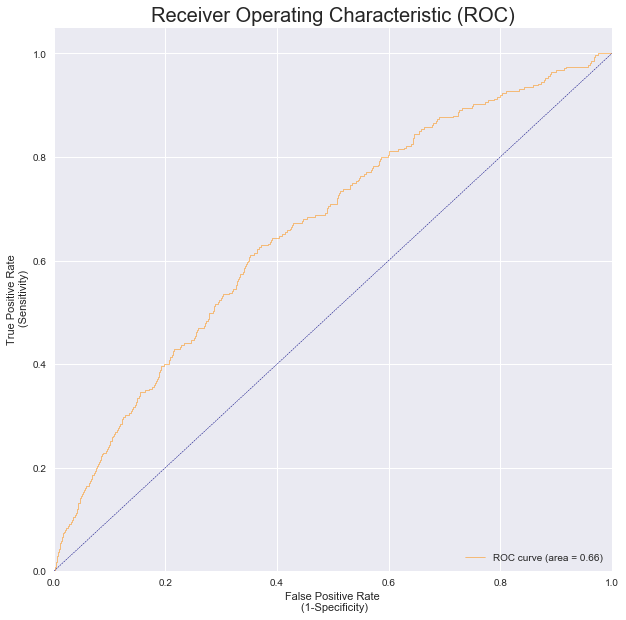


  Test AUC 


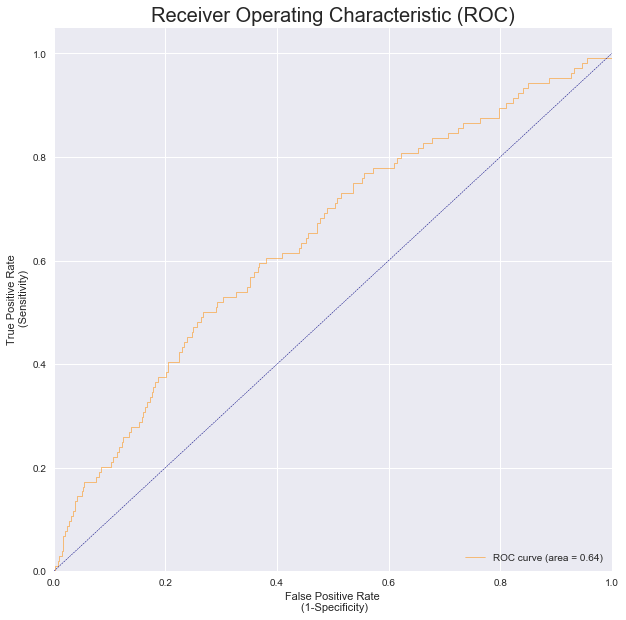


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


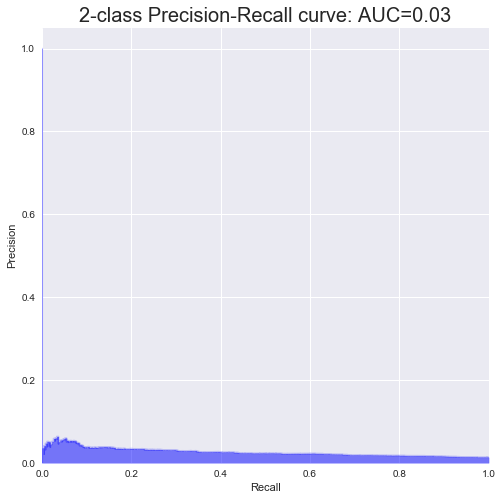


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


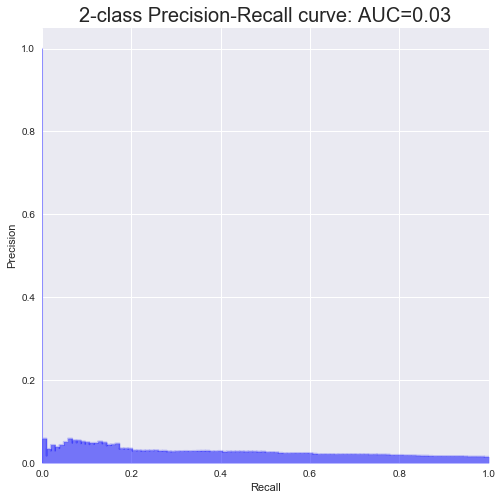

 
Iteration : 94 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 10, 0.001]
__________________________________________________________________

Accuracy - Training:  56.93%
Accuracy - test    :  56.96%

AUC Performance
AUC - Training     : 0.6606
AUC - Test         : 0.6423


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.57      0.72     20614
          1       0.02      0.67      0.04       275

avg / total       0.98      0.57      0.71     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.57      0.72      6860
          1       0.02      0.62      0.04       104

avg / total       0.98      0.57      0.71      6964


  Confusion Matrix - Train 
[[11707    90]
 [ 8907   185]]


  Confusion Matrix - Test 
[[3903   40]
 [2957   64]]




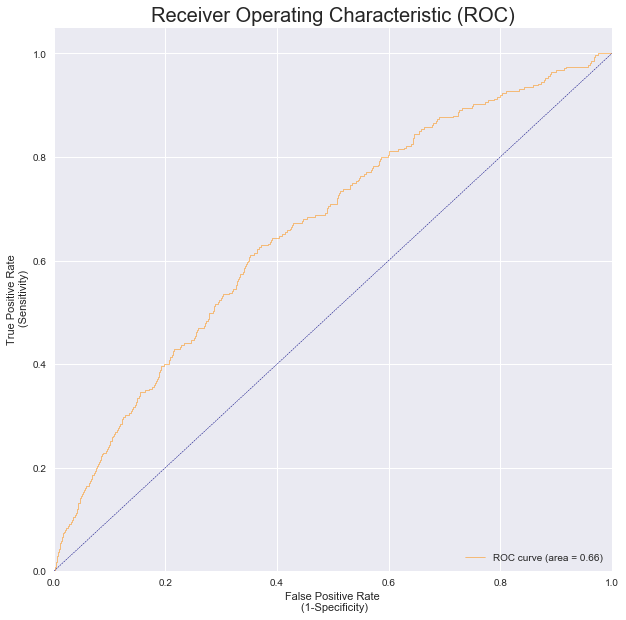


  Test AUC 


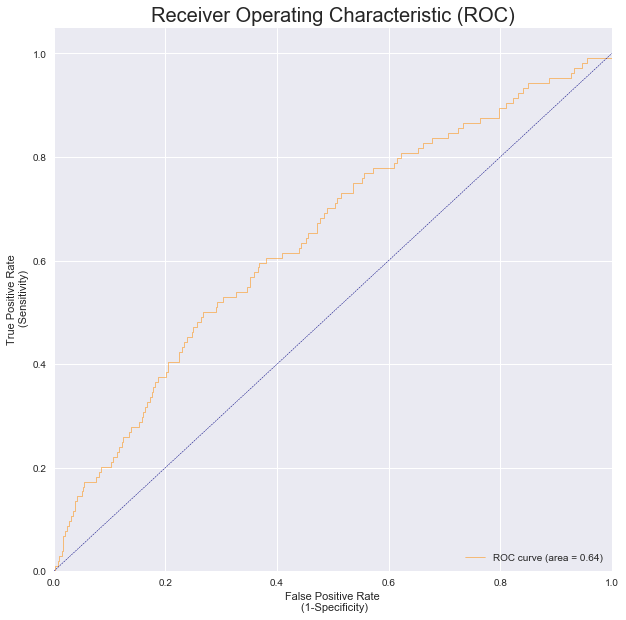


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


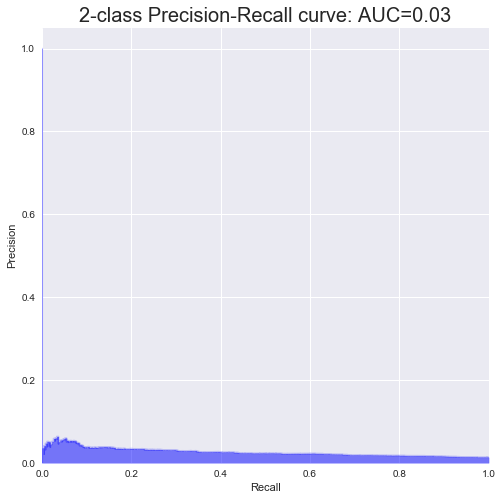


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


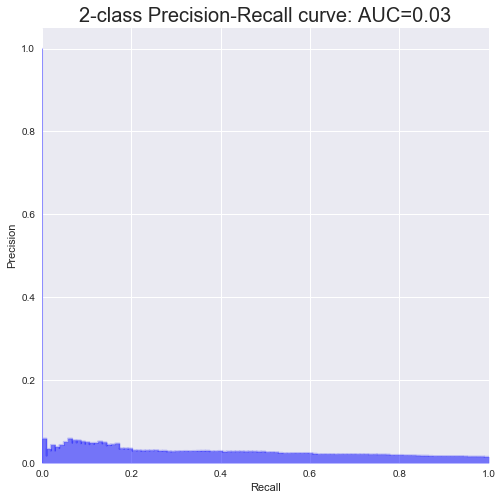

 
Iteration : 95 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 10, 0.01]
__________________________________________________________________

Accuracy - Training:  56.93%
Accuracy - test    :  56.96%

AUC Performance
AUC - Training     : 0.6606
AUC - Test         : 0.6423


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.57      0.72     20614
          1       0.02      0.67      0.04       275

avg / total       0.98      0.57      0.71     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.57      0.72      6860
          1       0.02      0.62      0.04       104

avg / total       0.98      0.57      0.71      6964


  Confusion Matrix - Train 
[[11707    90]
 [ 8907   185]]


  Confusion Matrix - Test 
[[3903   40]
 [2957   64]]


 

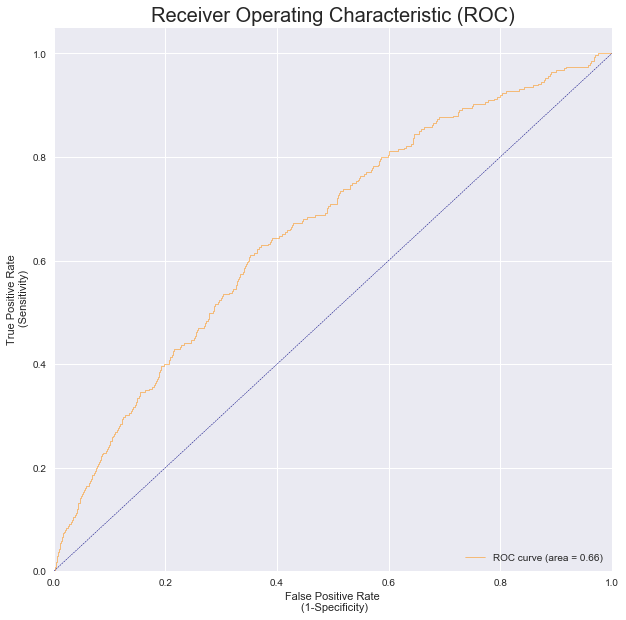


  Test AUC 


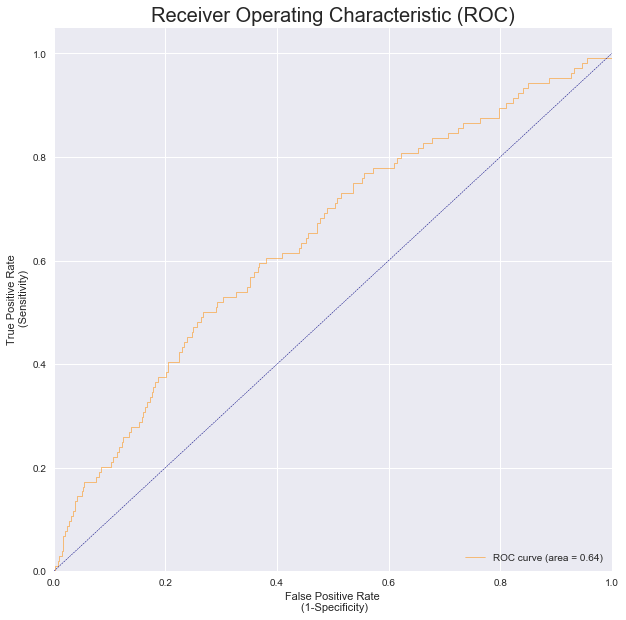


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


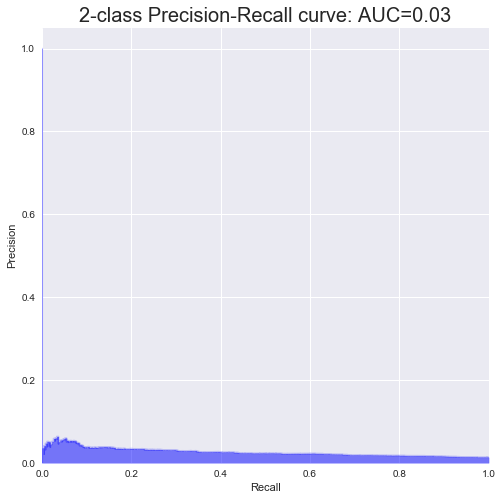


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


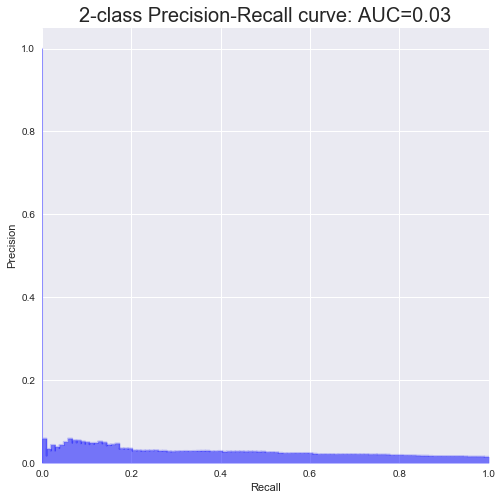

 
Iteration : 96 
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  solver - C - tol 
 ['sag', 10, 0.1]
__________________________________________________________________

Accuracy - Training:  56.93%
Accuracy - test    :  56.96%

AUC Performance
AUC - Training     : 0.6606
AUC - Test         : 0.6423


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.57      0.72     20614
          1       0.02      0.67      0.04       275

avg / total       0.98      0.57      0.71     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.57      0.72      6860
          1       0.02      0.62      0.04       104

avg / total       0.98      0.57      0.71      6964


  Confusion Matrix - Train 
[[11707    90]
 [ 8907   185]]


  Confusion Matrix - Test 
[[3903   40]
 [2957   64]]


  

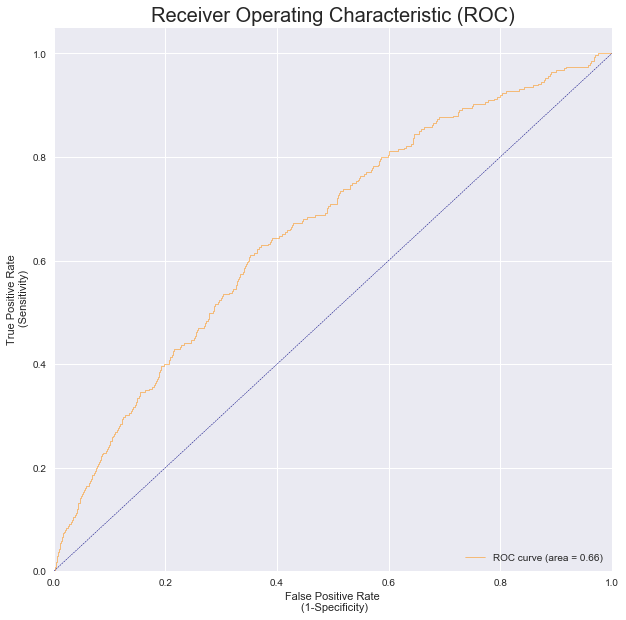


  Test AUC 


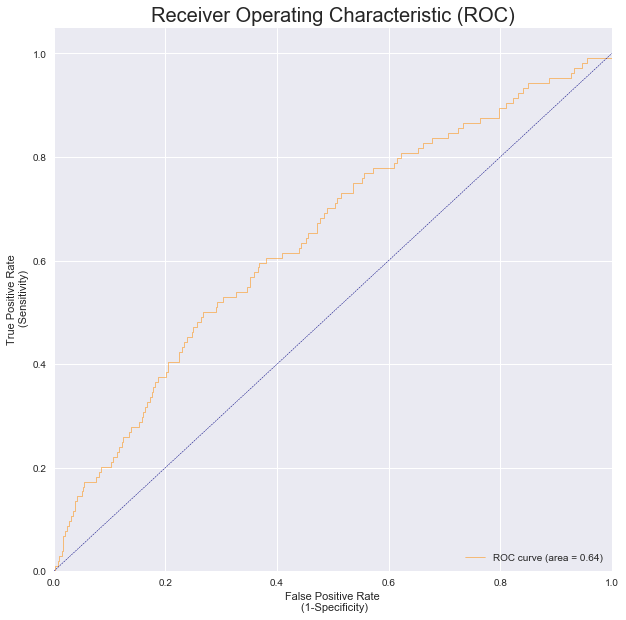


  Train Precission - Recall Curve 
Average precision-recall score: 0.03


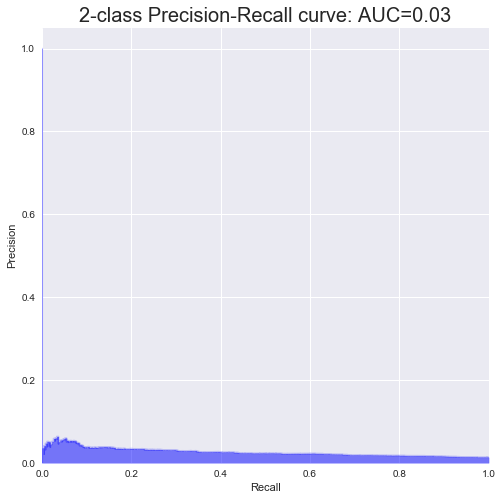


  Test Precission - Recall Curve 
Average precision-recall score: 0.03


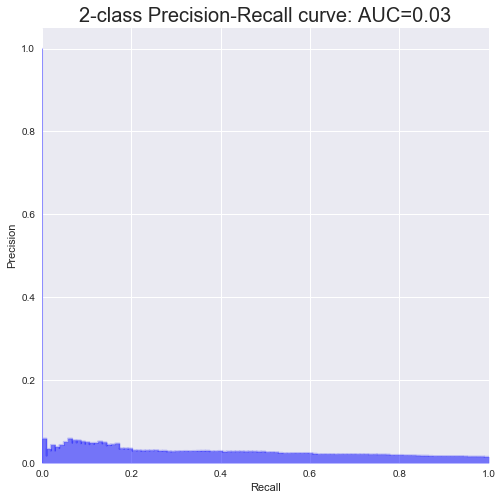

In [123]:
warnings.filterwarnings("ignore")

Model_Parameter_list = []
NPV_test_list =[]
NPV_train_list =[]
Specivity_test_list =[]
Specivity_train_list =[]
target_size_test_pct_list =[]
target_size_train_pct_list =[]
target_size_test_list =[]
target_size_train_list =[]
lift_test_list =[]
lift_train_list =[]
Prevalance_Test_Pct_list =[]
Prevalance_Train_Pct_list =[]
Prevalance_Test_list =[]
Prevalance_Train_list =[]
AUC_Test_list =[]
AUC_Train_list =[]
f1_score_test_list =[]
f1_score_train_list =[]
Recall_test_list =[]
Recall_train_list =[]
Precision_test_list =[]
Precision_train_list =[]
mat_test_list =[]
mat_train_list =[]
y_accuracy_test_list =[]
y_accuracy_train_list =[]

C = [0.0001, 0.001, 0.01, 0.1,1,10]
solver = ['newton-cg', 'lbfgs', 'liblinear', 'sag']
tol = [0.0001,0.001,0.01,0.1]
algo = 'Logistic Regression'
hyperparameter = ' solver - C - tol'
iteration = 0
for i in solver:
    for j in C:
        for k in tol:
            iteration += 1
            Bold = "\033[1m"
            Underline = "\033[4m"
            end = "\033[0;0m"
            print(Bold,"\nIteration : {}" .format(iteration), end )
            m = [i,j,k]
            model = LogisticRegression(C=j,tol=k,solver=i,random_state=12345, class_weight='balanced',n_jobs=-1)
            header(algo, hyperparameter,m)
            clf = train_model(model)
            var_dict = metric_calculation(clf)
            metric_display(var_dict)
            append_metrics(var_dict)

            print()
            print(Bold,Underline,"Train AUC", end )
            auc_curve_plot(y_train,var_dict['y_train_score_classifier'][:,1])  

            print()
            print(Bold,Underline,"Test AUC", end )
            auc_curve_plot(y_test,var_dict['y_test_score_classifier'][:,1])

            print()
            print(Bold,Underline,"Train Precission - Recall Curve", end )
            precission_recall_curve_plot(y_train, var_dict['y_train_score_classifier'][:,1])

            print()
            print(Bold,Underline,"Test Precission - Recall Curve", end )
            precission_recall_curve_plot(y_test, var_dict['y_test_score_classifier'][:,1])

In [124]:
df_log = tabulate_grid_search()
df_log.T.to_csv('Model Performance/Random Forest Controlled.csv')

In [125]:
df_log.T

,0,1,2,3,4,5,6,7,8,9,...,86,87,88,89,90,91,92,93,94,95
0_Model Hyperparameters,"[newton-cg, 0.0001, 0.0001]","[newton-cg, 0.0001, 0.001]","[newton-cg, 0.0001, 0.01]","[newton-cg, 0.0001, 0.1]","[newton-cg, 0.001, 0.0001]","[newton-cg, 0.001, 0.001]","[newton-cg, 0.001, 0.01]","[newton-cg, 0.001, 0.1]","[newton-cg, 0.01, 0.0001]","[newton-cg, 0.01, 0.001]",...,"[sag, 0.1, 0.01]","[sag, 0.1, 0.1]","[sag, 1, 0.0001]","[sag, 1, 0.001]","[sag, 1, 0.01]","[sag, 1, 0.1]","[sag, 10, 0.0001]","[sag, 10, 0.001]","[sag, 10, 0.01]","[sag, 10, 0.1]"
1_1_Accuracy_train,72.7751,72.7751,72.7751,72.7751,71.7698,71.7698,71.7698,71.7746,71.0182,71.0182,...,62.5114,62.5114,62.8321,62.8321,62.8321,62.8321,56.9295,56.9295,56.9295,56.9295
1_2_Accuracy_test,72.0563,72.0563,72.0563,72.0563,71.2234,71.2234,71.2234,71.2234,70.3762,70.3762,...,62.0477,62.0477,62.22,62.22,62.22,62.22,56.9644,56.9644,56.9644,56.9644
2_1_AUC_train,0.729813,0.729812,0.729813,0.729809,0.765404,0.765404,0.765404,0.765404,0.776822,0.776822,...,0.641828,0.641828,0.651135,0.651135,0.651135,0.651135,0.66058,0.66058,0.66058,0.66058
2_2_AUV_test,0.676232,0.676232,0.676231,0.676233,0.693174,0.693174,0.693173,0.693171,0.690619,0.690619,...,0.596629,0.596629,0.620438,0.620438,0.620438,0.620438,0.64231,0.64231,0.64231,0.64231
3_1_Conf_Mat_train,"[[15039, 112], [5575, 163]]","[[15039, 112], [5575, 163]]","[[15039, 112], [5575, 163]]","[[15039, 112], [5575, 163]]","[[14811, 94], [5803, 181]]","[[14811, 94], [5803, 181]]","[[14811, 94], [5803, 181]]","[[14812, 94], [5802, 181]]","[[14641, 81], [5973, 194]]","[[14641, 81], [5973, 194]]",...,"[[12897, 114], [7717, 161]]","[[12897, 114], [7717, 161]]","[[12972, 122], [7642, 153]]","[[12972, 122], [7642, 153]]","[[12972, 122], [7642, 153]]","[[12972, 122], [7642, 153]]","[[11707, 90], [8907, 185]]","[[11707, 90], [8907, 185]]","[[11707, 90], [8907, 185]]","[[11707, 90], [8907, 185]]"
3_2_Conf_Mat_test,"[[4963, 49], [1897, 55]]","[[4963, 49], [1897, 55]]","[[4963, 49], [1897, 55]]","[[4963, 49], [1897, 55]]","[[4898, 42], [1962, 62]]","[[4898, 42], [1962, 62]]","[[4898, 42], [1962, 62]]","[[4898, 42], [1962, 62]]","[[4839, 42], [2021, 62]]","[[4839, 42], [2021, 62]]",...,"[[4269, 52], [2591, 52]]","[[4269, 52], [2591, 52]]","[[4271, 42], [2589, 62]]","[[4271, 42], [2589, 62]]","[[4271, 42], [2589, 62]]","[[4271, 42], [2589, 62]]","[[3903, 40], [2957, 64]]","[[3903, 40], [2957, 64]]","[[3903, 40], [2957, 64]]","[[3903, 40], [2957, 64]]"
4_1_Actual_Prevalance_train,275,275,275,275,275,275,275,275,275,275,...,275,275,275,275,275,275,275,275,275,275
4_2_Actual_Prevalance_test,104,104,104,104,104,104,104,104,104,104,...,104,104,104,104,104,104,104,104,104,104
5_1_Prevalance_PCT_train,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,...,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648,1.31648


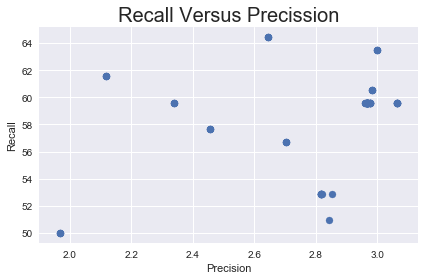

In [126]:
z = df_log['6_2_PPV_test']
y = df_log['8_2_Sensitivty_test']

plt.scatter(z,y)
# plt.ylim(30,60)
# plt.xlim(1.6,3)
plt.ylabel('Recall')
plt.xlabel('Precision')
plt.title('Recall Versus Precission', fontsize=20)
plt.tight_layout()


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  C : tol : solver 
 ['liblinear', 0.001, 0.01]
__________________________________________________________________

Accuracy - Training:  69.59%
Accuracy - test    :  68.80%

AUC Performance
AUC - Training     : 0.7645
AUC - Test         : 0.6922


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.70      0.82     20614
          1       0.03      0.68      0.06       275

avg / total       0.98      0.70      0.81     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.03      0.63      0.06       104

avg / total       0.98      0.69      0.80      6964


  Confusion Matrix - Train 
[[14351    89]
 [ 6263   186]]


  Confusion Matrix - Test 
[[4725   38]
 [2135   66]]


  Train - 

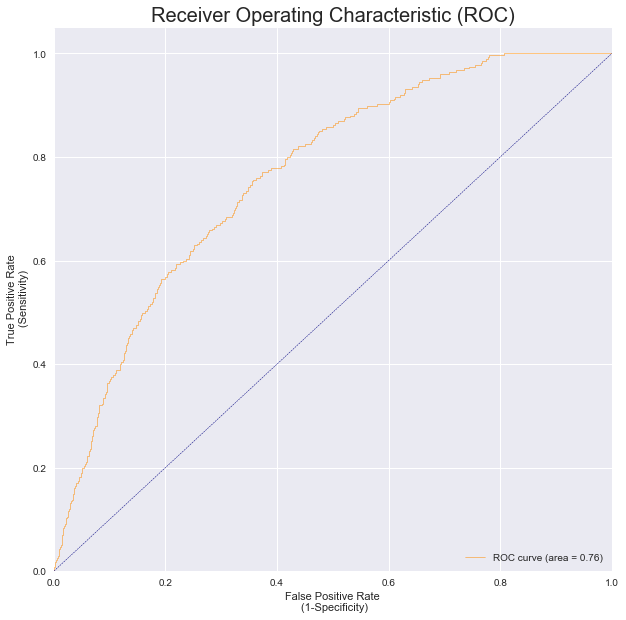


  Test AUC 


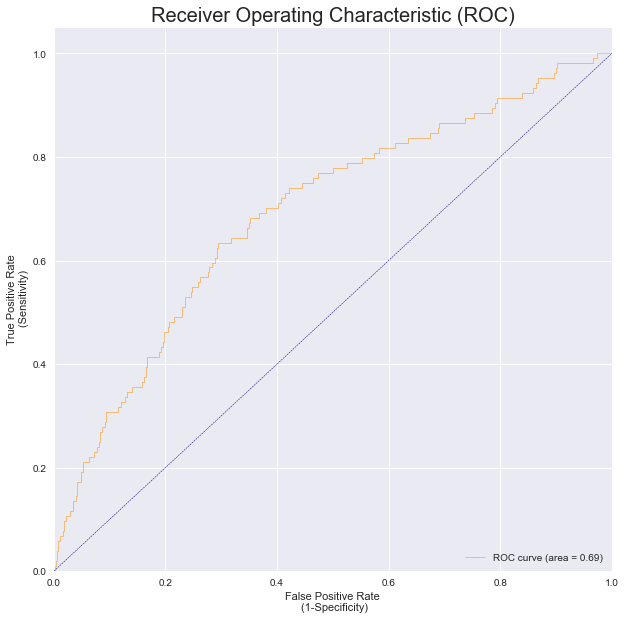


  Train Precission - Recall Curve 
Average precision-recall score: 0.04


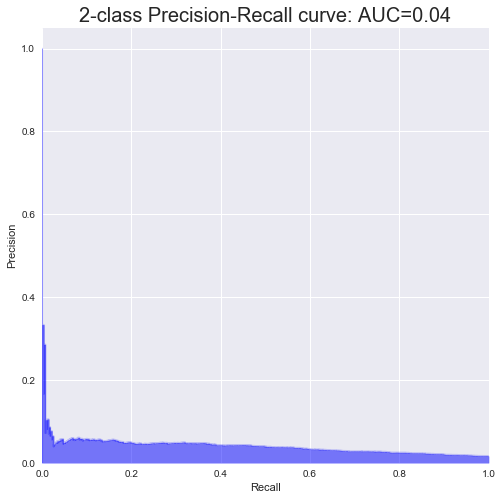


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


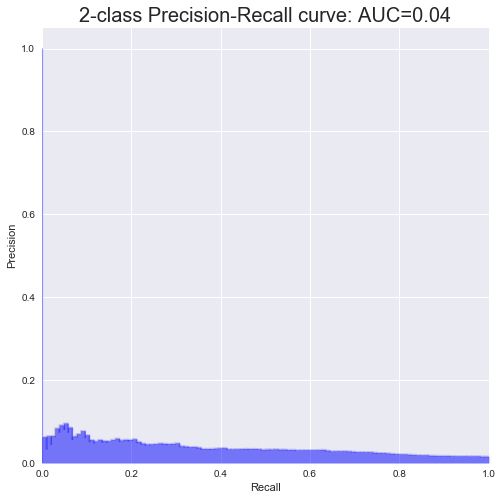

In [127]:
m = ['liblinear', 0.001, 0.01]

string = 'Logistic Regression' 
i = "[ C = 0.001, tol = 0.01, solver = liblinear ]"
hyperparameter = " C : tol : solver"

clf_logistic_regression = LogisticRegression(C=0.001,
                           tol=0.01,
                           solver='liblinear',
                           random_state=12345, 
                           class_weight='balanced',
                           n_jobs=-1)

model  = 'Logistic Regression'
header(model, hyperparameter,m)
clf = train_model(clf_logistic_regression)
var_dict = metric_calculation(clf)
metric_display(var_dict)
append_metrics(var_dict)
print()
print(Bold,Underline,"Train AUC", end )
auc_curve_plot(y_train,var_dict['y_train_score_classifier'][:,1])  

print()
print(Bold,Underline,"Test AUC", end )
auc_curve_plot(y_test,var_dict['y_test_score_classifier'][:,1])

print()
print(Bold,Underline,"Train Precission - Recall Curve", end )
precission_recall_curve_plot(y_train, var_dict['y_train_score_classifier'][:,1])

print()
print(Bold,Underline,"Test Precission - Recall Curve", end )
precission_recall_curve_plot(y_test, var_dict['y_test_score_classifier'][:,1])

## Decision Tree

In [117]:
np.arange(3,11,1)

[3, 4, 5, 6, 7, 8, 9, 10]

In [122]:
warnings.filterwarnings("ignore")

Hyperparams_list = []
Prevalence_Actual_list = []
Accuracy_list = []
Prevalence_list = []
PPV_list = []
NPV_list = []
Sensitivity_list = []
Specivity_list = []
Lift_list = []
Target_PCT_list = []
AUC_train_list = []
AUC_test_list = []
F1_score_list= []
    
leaf_split = [[8000,4000],
              [4000,2000],
              [2000,1000],
              [1000,500],
              [400,200],
              [200,100],
              [100,50],
              [10,5]]

depth = np.arange(3,11,1)

string = 'Decission Tree'
hyperparamter = 'leaf : split : depth'
for ls in leaf_split:
    split, leaf = ls
    for max_depth in depth:
        i = [split,leaf,max_depth]
        model = DecisionTreeClassifier(max_depth=max_depth,class_weight='balanced' ,random_state=12345 ,min_samples_leaf=leaf,min_samples_split=split)
        model_evaluation(model,string,i,hyperparamter)

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [8000, 4000, 3]
Decission Tree Accuracy - Training:  0.548422614773
Decission Tree Accuracy - test    : 0.53489373923

AUC Performance
AUC - Training:  0.670127098089
AUC - Test    :  0.563721546311


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.55      0.70     20614
          1       0.02      0.72      0.04       275

avg / total       0.98      0.55      0.70     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.53      0.69      6860
          1       0.02      0.58      0.04       104

avg / total       0.97      0.53      0.68      6964


  Confusion Matrix - Train 
[[11259    78]
 [ 9355   197]]


  Confusion Matrix - Test 
[[3665   44]
 [3195   60]]

TN - [ 3665 , 44 ] - FN
FP - [ 3195 , 60 ] - TP

Prevalence (Num) : 104
Prevale

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [8000, 4000, 10]
Decission Tree Accuracy - Training:  0.548422614773
Decission Tree Accuracy - test    : 0.53489373923

AUC Performance
AUC - Training:  0.670127098089
AUC - Test    :  0.563721546311


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.55      0.70     20614
          1       0.02      0.72      0.04       275

avg / total       0.98      0.55      0.70     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.53      0.69      6860
          1       0.02      0.58      0.04       104

avg / total       0.97      0.53      0.68      6964


  Confusion Matrix - Train 
[[11259    78]
 [ 9355   197]]


  Confusion Matrix - Test 
[[3665   44]
 [3195   60]]

TN - [ 3665 , 44 ] - FN
FP - [ 3195 , 60 ] - TP

Prevalence (Num) : 104
Preval

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [4000, 2000, 9]
Decission Tree Accuracy - Training:  0.565704437742
Decission Tree Accuracy - test    : 0.56088454911

AUC Performance
AUC - Training:  0.707268052603
AUC - Test    :  0.622238029827


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.56      0.72     20614
          1       0.02      0.76      0.04       275

avg / total       0.98      0.57      0.71     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.56      0.71      6860
          1       0.02      0.68      0.04       104

avg / total       0.98      0.56      0.70      6964


  Confusion Matrix - Train 
[[11607    65]
 [ 9007   210]]


  Confusion Matrix - Test 
[[3835   33]
 [3025   71]]

TN - [ 3835 , 33 ] - FN
FP - [ 3025 , 71 ] - TP

Prevalence (Num) : 104
Prevale

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [2000, 1000, 8]
Decission Tree Accuracy - Training:  0.629613672268
Decission Tree Accuracy - test    : 0.621051120046

AUC Performance
AUC - Training:  0.767827866322
AUC - Test    :  0.633927169769


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.63      0.77     20614
          1       0.03      0.79      0.05       275

avg / total       0.98      0.63      0.76     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.62      0.76      6860
          1       0.02      0.55      0.04       104

avg / total       0.97      0.62      0.75      6964


  Confusion Matrix - Train 
[[12936    59]
 [ 7678   216]]


  Confusion Matrix - Test 
[[4268   47]
 [2592   57]]

TN - [ 4268 , 47 ] - FN
FP - [ 2592 , 57 ] - TP

Prevalence (Num) : 104
Preval

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [1000, 500, 7]
Decission Tree Accuracy - Training:  0.718847240174
Decission Tree Accuracy - test    : 0.706346927053

AUC Performance
AUC - Training:  0.805471127301
AUC - Test    :  0.612268025342


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.72      0.83     20614
          1       0.03      0.75      0.07       275

avg / total       0.98      0.72      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.02      0.46      0.04       104

avg / total       0.97      0.71      0.81      6964


  Confusion Matrix - Train 
[[14811    70]
 [ 5803   205]]


  Confusion Matrix - Test 
[[4871   56]
 [1989   48]]

TN - [ 4871 , 56 ] - FN
FP - [ 1989 , 48 ] - TP

Prevalence (Num) : 104
Prevale

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [400, 200, 6]
Decission Tree Accuracy - Training:  0.689836756187
Decission Tree Accuracy - test    : 0.670160827111

AUC Performance
AUC - Training:  0.810573661325
AUC - Test    :  0.577812429917


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.69      0.81     20614
          1       0.03      0.78      0.06       275

avg / total       0.98      0.69      0.80     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.67      0.80      6860
          1       0.02      0.47      0.04       104

avg / total       0.97      0.67      0.79      6964


  Confusion Matrix - Train 
[[14195    60]
 [ 6419   215]]


  Confusion Matrix - Test 
[[4618   55]
 [2242   49]]

TN - [ 4618 , 55 ] - FN
FP - [ 2242 , 49 ] - TP

Prevalence (Num) : 104
Prevalen

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [200, 100, 5]
Decission Tree Accuracy - Training:  0.707836660443
Decission Tree Accuracy - test    : 0.68480758185

AUC Performance
AUC - Training:  0.786053785159
AUC - Test    :  0.627489347387


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83     20614
          1       0.03      0.73      0.06       275

avg / total       0.98      0.71      0.82     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.69      0.81      6860
          1       0.02      0.45      0.04       104

avg / total       0.97      0.68      0.80      6964


  Confusion Matrix - Train 
[[14586    75]
 [ 6028   200]]


  Confusion Matrix - Test 
[[4722   57]
 [2138   47]]

TN - [ 4722 , 57 ] - FN
FP - [ 2138 , 47 ] - TP

Prevalence (Num) : 104
Prevalenc

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [100, 50, 4]
Decission Tree Accuracy - Training:  0.570443774235
Decission Tree Accuracy - test    : 0.554709936818

AUC Performance
AUC - Training:  0.755470068885
AUC - Test    :  0.629158023099


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.57      0.72     20614
          1       0.02      0.81      0.05       275

avg / total       0.98      0.57      0.71     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.55      0.71      6860
          1       0.02      0.65      0.04       104

avg / total       0.98      0.55      0.70      6964


  Confusion Matrix - Train 
[[11692    51]
 [ 8922   224]]


  Confusion Matrix - Test 
[[3795   36]
 [3065   68]]

TN - [ 3795 , 36 ] - FN
FP - [ 3065 , 68 ] - TP

Prevalence (Num) : 104
Prevalenc

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [10, 5, 3]
Decission Tree Accuracy - Training:  0.538273732587
Decission Tree Accuracy - test    : 0.523118897186

AUC Performance
AUC - Training:  0.713315134463
AUC - Test    :  0.645057047544


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.53      0.70     20614
          1       0.02      0.80      0.04       275

avg / total       0.98      0.54      0.69     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.52      0.68      6860
          1       0.02      0.70      0.04       104

avg / total       0.98      0.52      0.67      6964


  Confusion Matrix - Train 
[[11025    56]
 [ 9589   219]]


  Confusion Matrix - Test 
[[3570   31]
 [3290   73]]

TN - [ 3570 , 31 ] - FN
FP - [ 3290 , 73 ] - TP

Prevalence (Num) : 104
Prevalence 

__________________________________________________________________

  Hyperparameters- leaf : split : depth :  [10, 5, 10]
Decission Tree Accuracy - Training:  0.832782804347
Decission Tree Accuracy - test    : 0.807725445146

AUC Performance
AUC - Training:  0.945137814548
AUC - Test    :  0.517283864095


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.83      0.91     20614
          1       0.07      0.97      0.13       275

avg / total       0.99      0.83      0.90     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.82      0.89      6860
          1       0.02      0.24      0.04       104

avg / total       0.97      0.81      0.88      6964


  Confusion Matrix - Train 
[[17128     7]
 [ 3486   268]]


  Confusion Matrix - Test 
[[5600   79]
 [1260   25]]

TN - [ 5600 , 79 ] - FN
FP - [ 1260 , 25 ] - TP

Prevalence (Num) : 104
Prevalence

In [124]:
Summary_Performance_DTree.to_csv('Model Performance/Decision_Tree_controlled.csv')

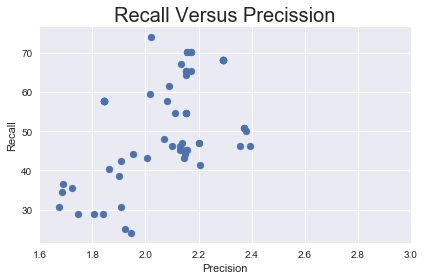

In [125]:
z = Summary_Performance_DTree['6_Sensitivity']
y = Summary_Performance_DTree['4_PPV']

plt.scatter(y,z)
# plt.ylim(30,60)
plt.xlim(1.6,3)
plt.ylabel('Recall')
plt.xlabel('Precision')
plt.title('Recall Versus Precission', fontsize=20)
plt.tight_layout()

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

   Logistic Regression 
 
 Hyperparamter :  
  C : tol : solver 
 ['liblinear', 0.001, 0.01]
__________________________________________________________________

Accuracy - Training:  56.57%
Accuracy - test    :  56.09%

AUC Performance
AUC - Training     : 0.6991
AUC - Test         : 0.6169


  Classification Report Train 
             precision    recall  f1-score   support

          0       0.99      0.56      0.72     20614
          1       0.02      0.76      0.04       275

avg / total       0.98      0.57      0.71     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.56      0.71      6860
          1       0.02      0.68      0.04       104

avg / total       0.98      0.56      0.70      6964


  Confusion Matrix - Train 
[[11607    65]
 [ 9007   210]]


  Confusion Matrix - Test 
[[3835   33]
 [3025   71]]


  Train - 

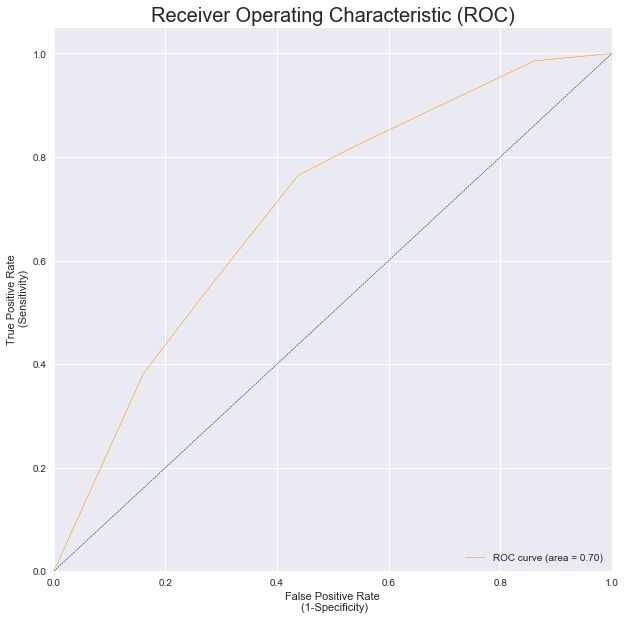


  Test AUC 


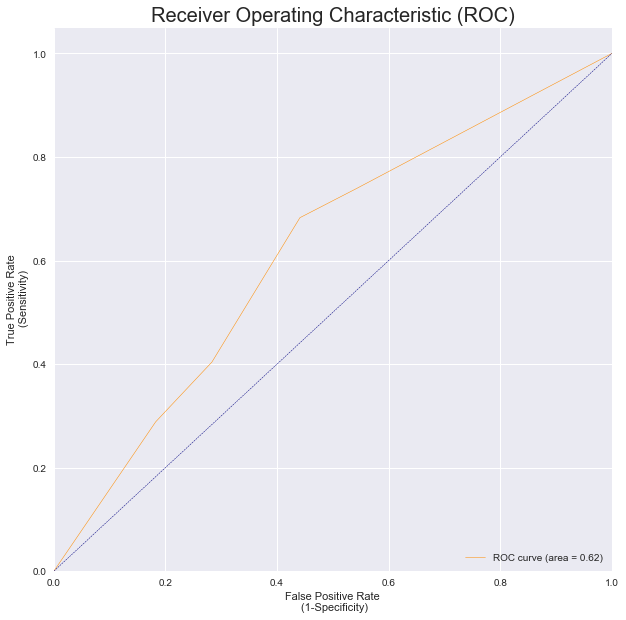


  Train Precission - Recall Curve 
Average precision-recall score: 0.21


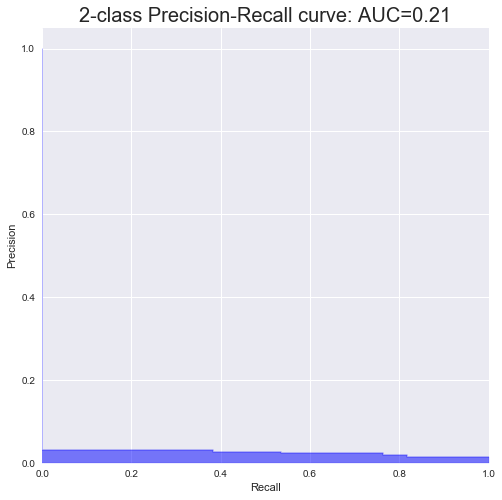


  Test Precission - Recall Curve 
Average precision-recall score: 0.16


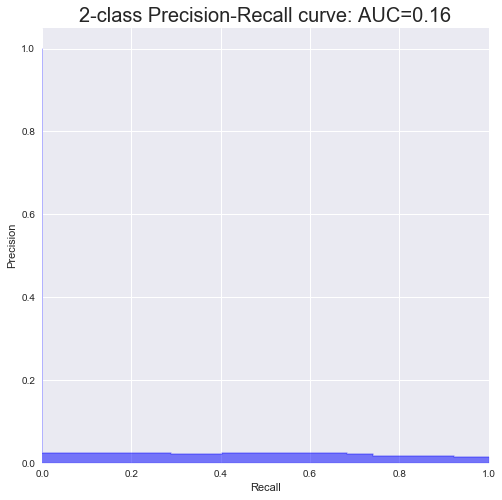

In [129]:
DT_Classifier =  DecisionTreeClassifier(class_weight='balanced',
                                        random_state=12345,
                                        max_depth=4,
                                        min_samples_split=4000,
                                        min_samples_leaf=2000)

string = 'Decission Tree'
hyperparamter = 'split : leaf : depth'
i = "split = 4000, lead = 2000, depth =4"
DT_Classifier =  DecisionTreeClassifier(class_weight='balanced',
                                        random_state=12345,
                                        max_depth=4,
                                        min_samples_split=4000,
                                        min_samples_leaf=2000)
header(model, hyperparameter,m)
clf = train_model(DT_Classifier)
var_dict = metric_calculation(clf)
metric_display(var_dict)
append_metrics(var_dict)
print()
print(Bold,Underline,"Train AUC", end )
auc_curve_plot(y_train,var_dict['y_train_score_classifier'][:,1])  

print()
print(Bold,Underline,"Test AUC", end )
auc_curve_plot(y_test,var_dict['y_test_score_classifier'][:,1])

print()
print(Bold,Underline,"Train Precission - Recall Curve", end )
precission_recall_curve_plot(y_train, var_dict['y_train_score_classifier'][:,1])

print()
print(Bold,Underline,"Test Precission - Recall Curve", end )
precission_recall_curve_plot(y_test, var_dict['y_test_score_classifier'][:,1])


In [31]:
features = X.columns.tolist()
outfile = export_graphviz(DT_Classifier, out_file='Dtree.dot', feature_names=features)

In [21]:
features = X.columns.tolist()
tree = DT_Classifier
path = "classifier/tree.png"

In [ ]:
show_tree(tree, features, path)

In [ ]:
### SVM

In [ ]:
clf = SVC(C=10 ,class_weight='balanced',probability=True)
clf.fit(X_train,y_train)

### Support Vector Machine

In [ ]:
Hyperparams_list = []
Prevalence_Actual_list = []
Accuracy_list = []
Prevalence_list = []
PPV_list = []
NPV_list = []
Sensitivity_list = []
Specivity_list = []
Lift_list = []
Target_PCT_list = []
AUC_train_list = []
AUC_test_list = []
F1_score_list= []


Cs = [0.01,1,10,100]
kernel = ['linear', 'poly', 'rbf', 'sigmoid',]
string = 'Support Vector Machine'
hyperparamter = 'Penalty'
for i in kernel:
    model = SVC(C=1,kernel=i ,class_weight='balanced',probability=True,verbose=True)
    model_evaluation(model,string,i,hyperparamter)

[LibSVM]

### Final Model

In [21]:
clf_random_forest = RandomForestClassifier(max_depth=3,
                               n_estimators=200,
                               min_samples_split=10,
                               min_samples_leaf=5,
                               class_weight='balanced',
                               random_state=12345,
                               n_jobs=-1)
 
clf_logistic_regression = LogisticRegression(C=0.001,
                           tol=0.01,
                           solver='liblinear',
                           random_state=12345, 
                           class_weight='balanced',
                           n_jobs=-1)
 
clf_Decision_Tree =  DecisionTreeClassifier(class_weight='balanced',
                                        random_state=12345,
                                        max_depth=4,
                                        min_samples_split=4000,
                                        min_samples_leaf=2000)

__________________________________________________________________

Accuracy - Training:  73.24%
Accuracy - test    :  71.27%

AUC Performance
AUC - Training     : 0.8164
AUC - Test         : 0.7162


  Classification Report Train 
             precision    recall  f1-score   support

          0       1.00      0.73      0.84     20614
          1       0.04      0.76      0.07       275

avg / total       0.98      0.73      0.83     20889


  Classification Report Test 
             precision    recall  f1-score   support

          0       0.99      0.71      0.83      6860
          1       0.03      0.60      0.06       104

avg / total       0.98      0.71      0.82      6964


  Confusion Matrix - Train 
[[15092    67]
 [ 5522   208]]


  Confusion Matrix - Test 
[[4901   42]
 [1959   62]]


  Train - Metrics 
Prevalence (Num) :    275
Prevalence       :   1.32 %
PPV              :   3.63 %
NPV              :  99.56 %
Sensitivity      :  75.64 %
Specivity        :  73.21 %
Lift

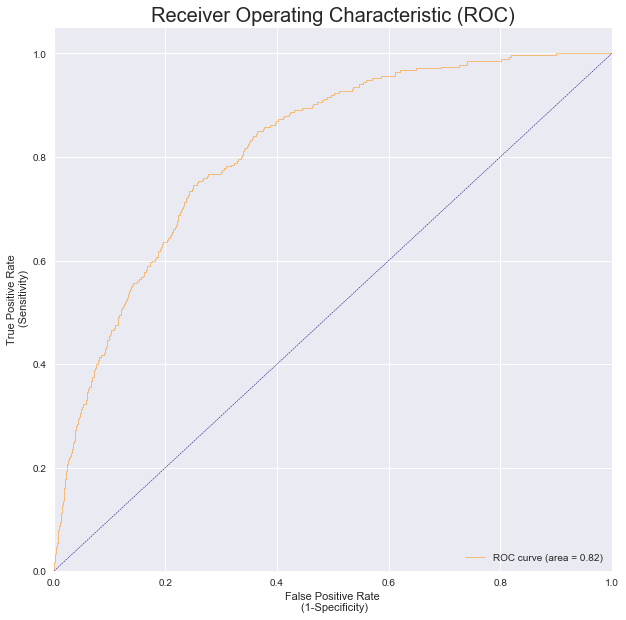


  Test AUC 


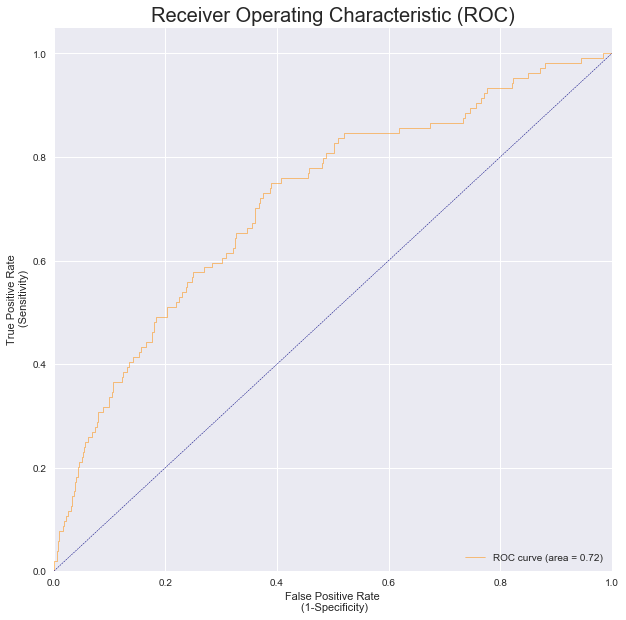


  Train Precission - Recall Curve 
Average precision-recall score: 0.06


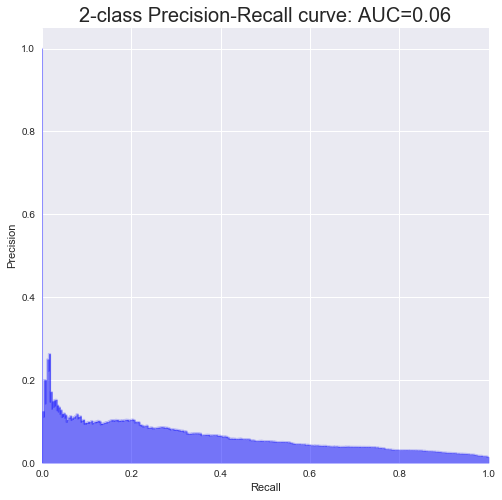


  Test Precission - Recall Curve 
Average precision-recall score: 0.04


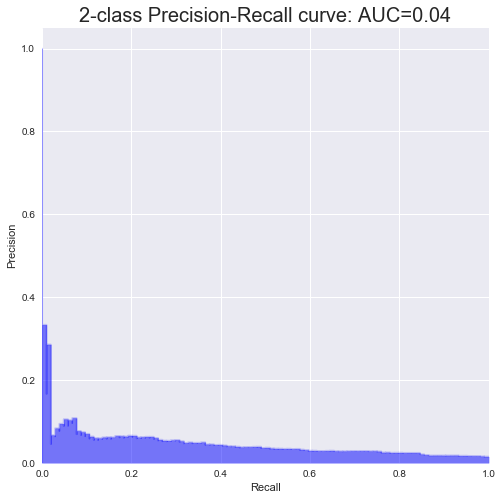

In [24]:
Model_Parameter_list = []
NPV_test_list =[]
NPV_train_list =[]
Specivity_test_list =[]
Specivity_train_list =[]
target_size_test_pct_list =[]
target_size_train_pct_list =[]
target_size_test_list =[]
target_size_train_list =[]
lift_test_list =[]
lift_train_list =[]
Prevalance_Test_Pct_list =[]
Prevalance_Train_Pct_list =[]
Prevalance_Test_list =[]
Prevalance_Train_list =[]
AUC_Test_list =[]
AUC_Train_list =[]
f1_score_test_list =[]
f1_score_train_list =[]
Recall_test_list =[]
Recall_train_list =[]
Precision_test_list =[]
Precision_train_list =[]
mat_test_list =[]
mat_train_list =[]
y_accuracy_test_list =[]
y_accuracy_train_list =[]

Bold = "\033[1m"
Underline = "\033[4m"
end = "\033[0;0m"

eclf1 = VotingClassifier(estimators=[('lr', clf_random_forest), 
                                     ('rf', clf_logistic_regression), 
                                     ('dt', clf_Decision_Tree)], voting='soft')

clf = train_model(eclf1)
var_dict = metric_calculation(clf)
metric_display(var_dict)
append_metrics(var_dict)
print()
print(Bold,Underline,"Train AUC", end )
auc_curve_plot(y_train,var_dict['y_train_score_classifier'][:,1])  

print()
print(Bold,Underline,"Test AUC", end )
auc_curve_plot(y_test,var_dict['y_test_score_classifier'][:,1])

print()
print(Bold,Underline,"Train Precission - Recall Curve", end )
precission_recall_curve_plot(y_train, var_dict['y_train_score_classifier'][:,1])

print()
print(Bold,Underline,"Test Precission - Recall Curve", end )
precission_recall_curve_plot(y_test, var_dict['y_test_score_classifier'][:,1])

In [13]:
string = 'Random Forest'
clf = RandomForestClassifier(n_estimators=50,class_weight='balanced',random_state=12345,max_depth=6,n_jobs=-1)
clf.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=6, max_features='auto',
            max_leaf_nodes=None, min_impurity_split=1e-07,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=50, n_jobs=-1,
            oob_score=False, random_state=12345, verbose=0,
            warm_start=False)

### Save Model

In [131]:
print('Saving algorithm and feature list in classifier directory...')
filename = 'classifier/finalized_model.pkl'
pkl.dump(clf, open(filename, 'wb'))
print('Model Saved')

Saving algorithm and feature list in classifier directory...
Model Saved


### Load Model

In [132]:
# some time later...
filename = 'classifier/finalized_model.pkl'
# load the model from disk
clf = pkl.load(open(filename, 'rb'))
result = clf.score(X_test, y_test)
print(result)

0.693423319931


In [146]:
clf_random_forest.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=3, max_features='auto',
            max_leaf_nodes=None, min_impurity_split=1e-07,
            min_samples_leaf=5, min_samples_split=10,
            min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=-1,
            oob_score=False, random_state=12345, verbose=0,
            warm_start=False)

In [25]:
classifier = clf

yfit_test = classifier.predict(X_test)
yfit_train = classifier.predict(X_train)

y_train_score = classifier.predict_proba(X_train)
y_test_score = classifier.predict_proba(X_test)

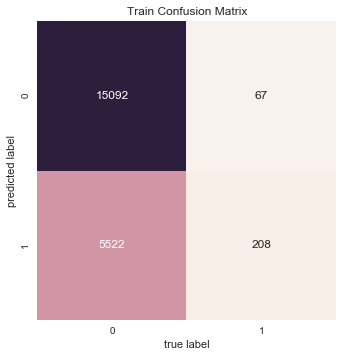

In [26]:
mat_train = confusion_matrix(y_train, yfit_train)
sns.heatmap(mat_train.T, square=True, annot=True, fmt='d', cbar=False)
plt.title("Train Confusion Matrix")
plt.xlabel('true label')
plt.ylabel('predicted label');

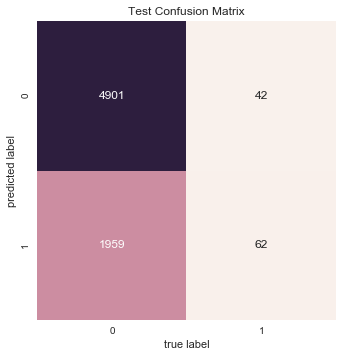

In [27]:
mat_test = confusion_matrix(y_test, yfit_test)
sns.heatmap(mat_test.T, square=True, annot=True, fmt='d', cbar=False)
plt.title("Test Confusion Matrix")
plt.xlabel('true label')
plt.ylabel('predicted label');

NameError: name 'string' is not defined

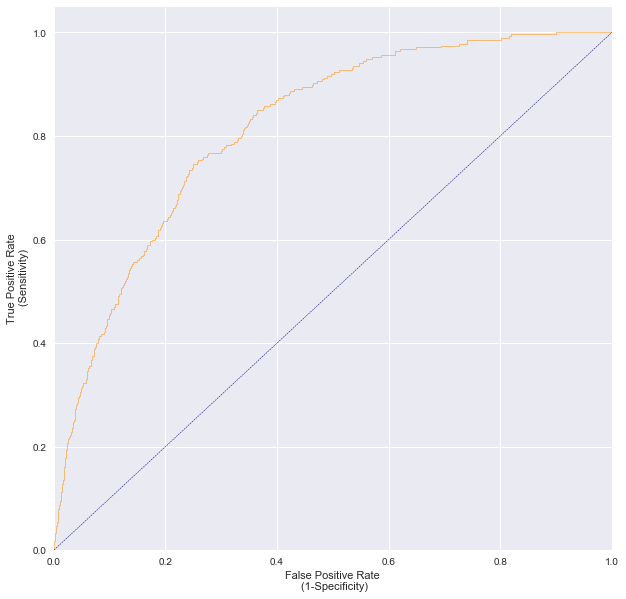

In [28]:
fpr, tpr, thresholds = roc_curve(y_train, y_train_score[:,1])
roc_auc = roc_auc_score(y_train, y_train_score[:,1])

plt.figure(figsize=(10,10))
lw = 0.5
plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate\n (1-Specificity)')

# X_labels = np.arange(0.0,1.0)
# X_labels_place_holders = np.arange(1,11)
# plt.xticks( X_labels_place_holders , X_labels)
plt.ylabel('True Positive Rate\n (Sensitivity)')
plt.title(' {}- Train Set - Receiver Operating Characteristic (ROC)' .format(string) , fontsize=20)
plt.legend(loc="lower right")
plt.savefig('Model Performance/train_roc.png')   # save the figure to file
plt.show()



NameError: name 'string' is not defined

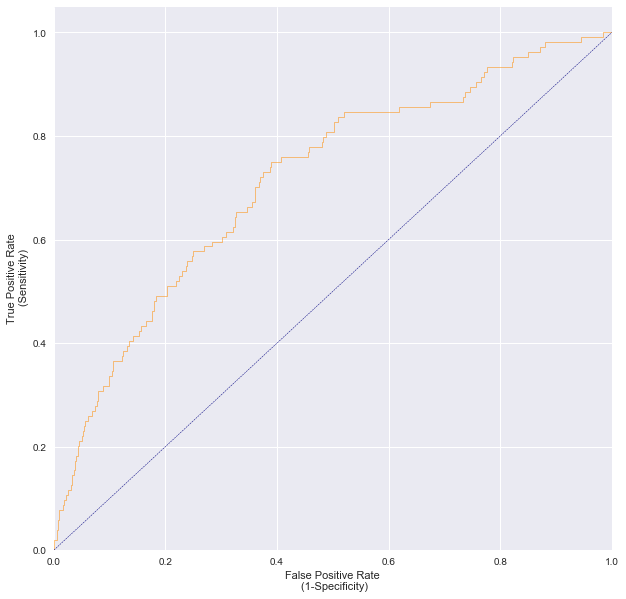

In [29]:
fpr, tpr, thresholds = roc_curve(y_test, y_test_score[:,1])
roc_auc = roc_auc_score(y_test, y_test_score[:,1])

plt.figure(figsize=(10,10))
lw = 0.5
plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
# plt.yticks( np.arange(10) )
plt.xlabel('False Positive Rate\n (1-Specificity)')

# X_labels = np.arange(0.0,1.0)
# X_labels_place_holders = np.arange(1,11)
# plt.xticks( X_labels_place_holders , X_labels)
plt.ylabel('True Positive Rate\n (Sensitivity)')
plt.title(' {}- Test Set - Receiver Operating Characteristic (ROC)' .format(string) , fontsize=20)
plt.legend(loc="lower right")
plt.savefig('Model Performance/test_roc.png')   # save the figure to file
plt.show()


In [30]:
FP = mat_test.T[1][0] 
FN = mat_test.T[0][1]
TP = mat_test.T[1][1]
TN = mat_test.T[0][0]

# Sensitivity, hit rate, recall, or true positive rate
TPR = TP/(TP+FN)
# Specificity or true negative rate
TNR = TN/(TN+FP) 
# Precision or positive predictive value
PPV = TP/(TP+FP)
# Negative predictive value
NPV = TN/(TN+FN)
# Fall out or false positive rate
FPR = FP/(FP+TN)
# False negative rate
FNR = FN/(TP+FN)
# False discovery rate
FDR = FP/(TP+FP)

# Overall accuracy
ACC = (TP+TN)/(TP+FP+FN+TN)

# prev = y.value_counts()
# prev[1]/sum(prev[:])*100
Prevalance = (TP + FN) / (TP+FP+FN+TN)

lift = PPV/Prevalance

Target_PCT = (FP + TP) / (TP+FP+FN+TN)

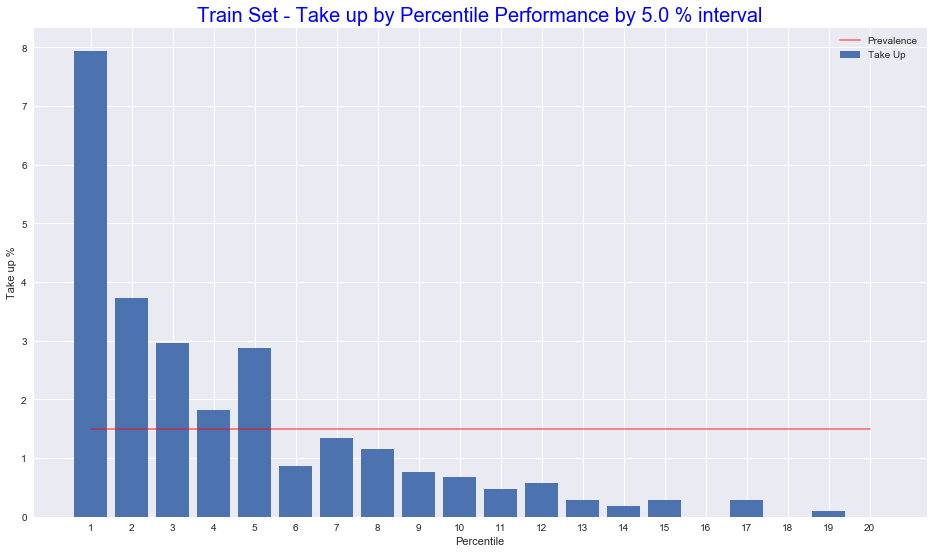

In [31]:
# Probabilties
X_train_proba = pd.DataFrame(classifier.predict_proba(X_train), index=X_train.index.tolist())
# Test Data
y_train_1 = pd.DataFrame(y_train)

# Combine them
Probability = pd.concat([y_train_1,X_train_proba ], axis=1, join_axes=[y_train_1.index])

# Rename Column
Probability.columns = ['Target','Prob_0','Prob_1']

Probability = Probability.sort_values('Prob_1', ascending=False)

from pandas import qcut

num_bins = 20
num_bins_plus_one = num_bins+1

# Assign Percentile
Probability['Percentile'] = pd.qcut(Probability.iloc[:,-1], q=num_bins, labels=np.arange(1,num_bins_plus_one)[::-1].tolist())

# Count Take Up Rate
sum_1 = Probability.groupby(by='Percentile', squeeze=True).sum().iloc[:,0]
count_1 =Probability.groupby(by='Percentile', squeeze=True).count().iloc[:,0]

Take_up = pd.concat([sum_1,count_1], axis=1, join='inner')

Take_up['Pct_Takeup'] = Take_up.iloc[:,0] / Take_up.iloc[:,1] * 100

# Insert Prevalance
Take_up['Prevalence'] = [Prevalance*100]*num_bins

takeup1 = Take_up.iloc[:,2].tolist()
takeup2 = Take_up.iloc[:,3].tolist()

X_labels = np.arange(1,len(takeup1)+1)
X_labels_place_holders = np.arange(len(takeup1))
y_labels_place_holders = np.arange(len(takeup1))

bin_size = 100 / len(takeup1)

plt.figure(figsize=(16,9))
plt.bar( y_labels_place_holders , height=takeup1)
plt.plot(takeup2, color='r', alpha=0.5)
plt.xticks( X_labels_place_holders , X_labels)
plt.xlabel('Percentile')
plt.ylabel('Take up %')
plt.legend(['Prevalence','Take Up'])
plt.title('Train Set - Take up by Percentile Performance by {} % interval' .format(bin_size), fontsize=20, color='b')
plt.savefig('Model Performance/Train Take Up Rate by Percentile.png')   # save the figure to file
plt.show()

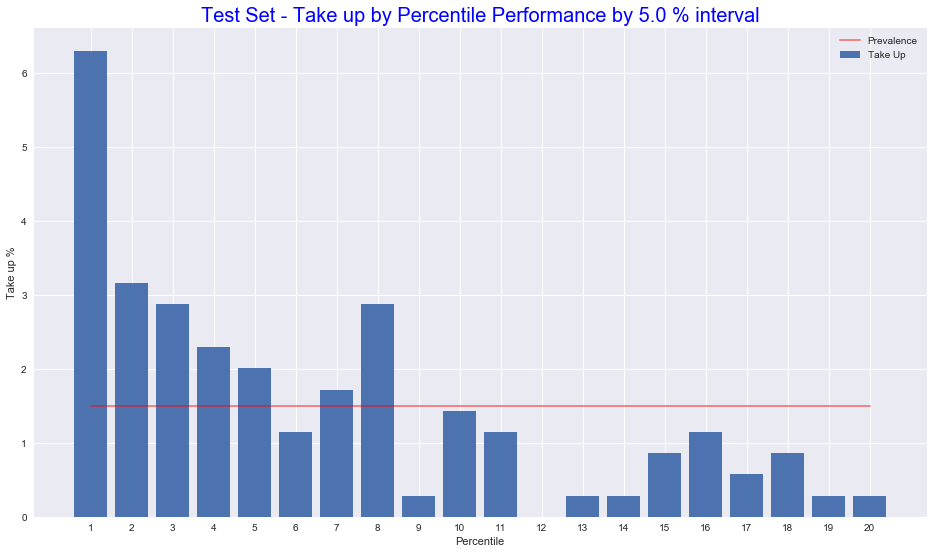

In [33]:
# Probabilties
X_test_proba = pd.DataFrame(classifier.predict_proba(X_test), index=X_test.index.tolist())
# Test Data
y_test_1 = pd.DataFrame(y_test)

# Combine them
Probability = pd.concat([y_test_1,X_test_proba ], axis=1, join_axes=[y_test_1.index])

# Rename Column
Probability.columns = ['Target','Prob_0','Prob_1']

Probability = Probability.sort_values('Prob_1', ascending=False)

from pandas import qcut

num_bins = 20
num_bins_plus_one = num_bins+1

# Assign Percentile
Probability['Percentile'] = pd.qcut(Probability.iloc[:,-1], q=num_bins, labels=np.arange(1,num_bins_plus_one)[::-1].tolist())

# Count Take Up Rate
sum_1 = Probability.groupby(by='Percentile', squeeze=True).sum().iloc[:,0]
count_1 =Probability.groupby(by='Percentile', squeeze=True).count().iloc[:,0]

Take_up = pd.concat([sum_1,count_1], axis=1, join='inner')

Take_up['Pct_Takeup'] = Take_up.iloc[:,0] / Take_up.iloc[:,1] * 100

# Insert Prevalance
Take_up['Prevalence'] = [Prevalance*100]*num_bins

takeup1 = Take_up.iloc[:,2].tolist()
takeup2 = Take_up.iloc[:,3].tolist()

X_labels = np.arange(1,len(takeup1)+1)
X_labels_place_holders = np.arange(len(takeup1))
y_labels_place_holders = np.arange(len(takeup1))

bin_size = 100 / len(takeup1)

plt.figure(figsize=(16,9))
plt.bar( y_labels_place_holders , height=takeup1)
plt.plot(takeup2, color='r', alpha=0.5)
plt.xticks( X_labels_place_holders , X_labels)
plt.xlabel('Percentile')
plt.ylabel('Take up %')
plt.legend(['Prevalence','Take Up'])
plt.title('Test Set - Take up by Percentile Performance by {} % interval' .format(bin_size), fontsize=20, color='b')
plt.savefig('Model Performance/Test Take Up Rate by Percentile.png')   # save the figure to file
plt.show()

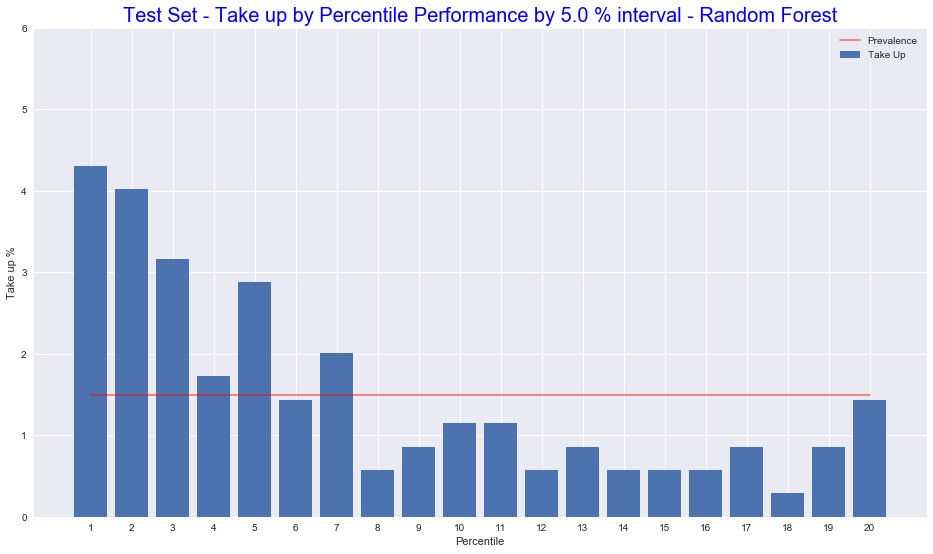

In [150]:
# Probabilties
X_test_proba = pd.DataFrame(classifier.predict_proba(X_test), index=X_test.index.tolist())
# Test Data
y_test_1 = pd.DataFrame(y_test)

# Combine them
Probability = pd.concat([y_test_1,X_test_proba ], axis=1, join_axes=[y_test_1.index])

# Rename Column
Probability.columns = ['Target','Prob_0','Prob_1']

Probability = Probability.sort_values('Prob_1', ascending=False)

from pandas import qcut

num_bins = 20
num_bins_plus_one = num_bins+1

# Assign Percentile
Probability['Percentile'] = pd.qcut(Probability.iloc[:,-1], q=num_bins, labels=np.arange(1,num_bins_plus_one)[::-1].tolist())

# Count Take Up Rate
sum_1 = Probability.groupby(by='Percentile', squeeze=True).sum().iloc[:,0]
count_1 =Probability.groupby(by='Percentile', squeeze=True).count().iloc[:,0]

Take_up = pd.concat([sum_1,count_1], axis=1, join='inner')

Take_up['Pct_Takeup'] = Take_up.iloc[:,0] / Take_up.iloc[:,1] * 100

# Insert Prevalance
Take_up['Prevalence'] = [Prevalance*100]*num_bins

takeup1 = Take_up.iloc[:,2].tolist()
takeup2 = Take_up.iloc[:,3].tolist()

X_labels = np.arange(1,len(takeup1)+1)
X_labels_place_holders = np.arange(len(takeup1))
y_labels_place_holders = np.arange(len(takeup1))

bin_size = 100 / len(takeup1)

plt.figure(figsize=(16,9))
plt.bar( y_labels_place_holders , height=takeup1)
plt.plot(takeup2, color='r', alpha=0.5)
plt.xticks( X_labels_place_holders , X_labels)
plt.xlabel('Percentile')
plt.ylabel('Take up %')
plt.ylim(0,6)
plt.legend(['Prevalence','Take Up'])
plt.title('Test Set - Take up by Percentile Performance by {} % interval - Random Forest' .format(bin_size), fontsize=20, color='b')
plt.savefig('Model Performance/Test Take Up Rate by Percentile.png')   # save the figure to file
plt.show()